In [1]:
import math
from typing import Any



from torch import Tensor
from torch.nn.parameter import Parameter, UninitializedParameter

from torch.nn import Module
from scipy.stats import pareto 
from torch.distributions.pareto import Pareto
from torch.nn import init
seed=0
import torch
import torchvision
#torch.cuda.is_available()
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import confusion_matrix
#from torch.autograd.functional import jacobian
#import torch.autograd.functional
import time
import copy
import matplotlib.pyplot as plt
import pandas as pd
torch.set_default_dtype(torch.float64)
torch.set_default_dtype(torch.float64)
batch_size=100
input_size=784
output_size=784
hidden_state_size=10
N=28
no_of_layer=2

#torch.cuda.manual_seed_all(seed)
with torch.cuda.device('cuda:0'):
    torch.cuda.empty_cache()



In [2]:
weight_tuning=1
## initial =1
class Linear(Module):
    r"""Applies a linear transformation to the incoming data: :math:`y = xA^T + b`

    This module supports :ref:`TensorFloat32<tf32_on_ampere>`.

    On certain ROCm devices, when using float16 inputs this module will use :ref:`different precision<fp16_on_mi200>` for backward.

    Args:
        in_features: size of each input sample
        out_features: size of each output sample
        bias: If set to ``False``, the layer will not learn an additive bias.
            Default: ``True``

    Shape:
        - Input: :math:`(*, H_{in})` where :math:`*` means any number of
          dimensions including none and :math:`H_{in} = \text{in\_features}`.
        - Output: :math:`(*, H_{out})` where all but the last dimension
          are the same shape as the input and :math:`H_{out} = \text{out\_features}`.

    Attributes:
        weight: the learnable weights of the module of shape
            :math:`(\text{out\_features}, \text{in\_features})`. The values are
            initialized from :math:`\mathcal{U}(-\sqrt{k}, \sqrt{k})`, where
            :math:`k = \frac{1}{\text{in\_features}}`
        bias:   the learnable bias of the module of shape :math:`(\text{out\_features})`.
                If :attr:`bias` is ``True``, the values are initialized from
                :math:`\mathcal{U}(-\sqrt{k}, \sqrt{k})` where
                :math:`k = \frac{1}{\text{in\_features}}`

    Examples::

        >>> m = nn.Linear(20, 30)
        >>> input = torch.randn(128, 20)
        >>> output = m(input)
        >>> print(output.size())
        torch.Size([128, 30])
    """
    __constants__ = ['in_features', 'out_features']
    in_features: int
    out_features: int
    weight: Tensor

    def __init__(self, in_features: int, out_features: int, bias: bool = True,
                 device=None, dtype=None) -> None:
        factory_kwargs = {'device': device, 'dtype': dtype}
        super().__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.weight = Parameter(torch.empty((out_features, in_features), **factory_kwargs))
        if bias:
            self.bias = Parameter(torch.empty(out_features, **factory_kwargs))
        else:
            self.register_parameter('bias', None)
        self.reset_parameters()

    def reset_parameters(self) -> None:
        #if reset=True:
            
        # Setting a=sqrt(5) in kaiming_uniform is the same as initializing with
        # uniform(-1/sqrt(in_features), 1/sqrt(in_features)). For details, see
        # https://github.com/pytorch/pytorch/issues/57109
        #init.kaiming_uniform_(self.weight, a=math.sqrt(5))
        fan_in, _ = init._calculate_fan_in_and_fan_out(self.weight)
        print("fan_in")
        print(fan_in)
        bound =weight_tuning/ math.sqrt(fan_in) 
        init.uniform_(self.weight, -bound,bound)
        if self.bias is not None:
            fan_in, _ = init._calculate_fan_in_and_fan_out(self.bias)
            bound =weight_tuning/ math.sqrt(fan_in) 
            init.uniform_(self.bias, -bound, bound)
            #init.uniform_(self.weight, -bound,bound)
        #fan = _calculate_correct_fan(tensor, mode)
        #gain = calculate_gain(nonlinearity, a)
        #std = gain / math.sqrt(fan)
        #bound = math.sqrt(3.0) * std  # Calculate uniform bounds from standard deviation
        #with torch.no_grad():
            #return tensor.uniform_(-bound, bound)

    def forward(self, input: Tensor) -> Tensor:
        return F.linear(input, self.weight, self.bias)

    def extra_repr(self) -> str:
        return 'in_features={}, out_features={}, bias={}'.format(
            self.in_features, self.out_features, self.bias is not None
        )


In [3]:
import torch
import torchvision
#torch.cuda.is_available()
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import confusion_matrix
#from torch.autograd.functional import jacobian
#import torch.autograd.functional
import time
import copy
import matplotlib.pyplot as plt
import pandas as pd
torch.set_default_dtype(torch.float64)
torch.set_default_dtype(torch.float64)
batch_size=100
input_size=784
output_size=784
hidden_state_size=10
N=28
no_of_layer=2



font = {
        'size'   : 14}
plt.rc('font', **font)

class AE(nn.Module):
    def __init__(self, input_shape,hidden_layer_shape,encoder_output_shape,n,xinit=torch.eye(batch_size,input_size),xfinal=torch.eye(batch_size,input_size),hidden=torch.eye(10,input_size)):
        super().__init__()
        self.encoder_input_layer = Linear(
            in_features=input_shape, out_features=hidden_layer_shape
        ,bias=False)
        self.hidden_layer=Linear(
            in_features=hidden_layer_shape, out_features=hidden_layer_shape
        ,bias=False)
        self.encoder_output_layer = Linear(
            in_features=hidden_layer_shape, out_features=encoder_output_shape
        ,bias=False)
        self.decoder_input_layer = Linear(
            in_features=encoder_output_shape, out_features=hidden_layer_shape
        ,bias=False)
        self.decoder_output_layer = Linear(
            in_features=hidden_layer_shape, out_features=input_shape
        ,bias=False)
        #self.encoder_input_layer.weight=torch.nn.Parameter(torch.rand(self.encoder_input_layer.weight.size))
        
        self.number_of_layers=n
        self.xinit=xinit
        self.xfinal=xfinal
        self.hidden=hidden

    def forward(self, features):
        reconstructed=self.internals(features)
        return reconstructed
    
    def internals(self,features):
        code=self.encoder(features)
        self.hidden=code
        #print(code)
       # print("hidden state maximum:"+str(torch.max(code)))
        reconstructed=self.decoder(code)
        return reconstructed
    
    def encoder(self,features):
        activation = self.encoder_input_layer(features)
        x = torch.relu(activation)
        self.xinit=x
        for i in range(self.number_of_layers):
            x=torch.relu(self.hidden_layer(x))
        code = self.encoder_output_layer(x)
        result = torch.relu(code)
        return code
    
    def decoder(self,code):
        activation = self.decoder_input_layer(code)
        x = torch.relu(activation)
        for i in range(self.number_of_layers):
             x=torch.relu(self.hidden_layer(x))
        self.xfinal=x
        activation = self.decoder_output_layer(x)
        reconstructed = torch.relu(activation)
        return reconstructed
    
    def xfinals(self):
        return self.xfinal
    
    def xinits(self):
        return self.xinit
    
    def hiddens(self):
        return self.hidden

In [4]:
import torch
import torchvision
#torch.cuda.is_available()
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import confusion_matrix
#from torch.autograd.functional import jacobian
#import torch.autograd.functional
import time
import copy
import matplotlib.pyplot as plt
import pandas as pd
torch.set_default_dtype(torch.float64)
torch.set_default_dtype(torch.float64)
batch_size=100
input_size=784
output_size=784
hidden_state_size=10
N=28
no_of_layer=2



font = {
        'size'   : 14}
plt.rc('font', **font)

class AE_1(nn.Module):
    def __init__(self, input_shape,hidden_layer_shape,encoder_output_shape,n,xinit=torch.eye(batch_size,input_size),xfinal=torch.eye(batch_size,input_size),hidden=torch.eye(10,input_size)):
        super().__init__()

        self.encoder_output_layer = Linear(
            in_features=input_shape, out_features=encoder_output_shape
        ,bias=False)
        self.decoder_input_layer = Linear(
            in_features=encoder_output_shape, out_features=input_shape
        ,bias=False)

        #self.encoder_input_layer.weight=torch.nn.Parameter(torch.rand(self.encoder_input_layer.weight.size))
        
        self.number_of_layers=n
        self.xinit=xinit
        self.xfinal=xfinal
        self.hidden=hidden

    def forward(self, features):
        reconstructed=self.internals(features)
        return reconstructed
    
    def internals(self,features):
        code=self.encoder(features)
        self.hidden=code
        #print("hidden state:"+str(code))
        reconstructed=self.decoder(code)
        return reconstructed
    
    def encoder(self,features):
        activation = self.encoder_output_layer(features)
        code = torch.tanh(activation)
     
        return code
    
    def decoder(self,code):
        activation = self.decoder_input_layer(code)
        reconstructed = torch.tanh(activation)

        return reconstructed
    
    def xfinals(self):
        return self.xfinal
    
    def xinits(self):
        return self.xinit
    
    def hiddens(self):
        return self.hidden

In [5]:
def add_gaussian_noise(inputs,strength):
    #print(inputs.size())
    noise = torch.randn_like(inputs)*strength*torch.max(inputs)
    result=inputs + noise
    return result
def add_powerlaw_noise(input_size,batch_size,strength,images):
    ##input size here is the side of the image 28 
    m = Pareto(torch.tensor([1.0]), torch.tensor([1.0]))
    res=m.sample(images.size())

    temp=res/np.sqrt(res.var())/N/batch_size*strength
    noise=temp-temp.mean()
    #if print_bool:
     #   plt.title(powerlaw_noise print)
      #  plt.hist(noise.flatten(),density=True, bins='auto', histtype='stepfilled')
        
      #  plt.show()
    #print(noise[:,:,:,:,0].size())
    return noise[:,:,0]+images

def validation(test_loader):
    
    with torch.no_grad():

     #valid_loss = criterion(outputs, batch_features.view(batch_size,-1).to(device))
        loss=0
        for batch_features, _ in test_loader:
            #input=add_noise(batch_features,).view(100, -1).to(device)
            input_image=add_gaussian_noise(batch_features,noise_strength).view(batch_size, -1).to(device)
            #batch_feature = batch_features.view(batch_size, -1)
            #input_image =add_powerlaw_noise(input_size,batch_size,noise_strength,batch_feature).view(batch_size, -1).to(device)
            batch_feature = batch_features.view(batch_size, -1).to(device)
            outputs = model(input_image)
            valid_loss = criterion(outputs, input_image.to(device)) 
            #accuracy+=kl_div(outputs,batch_features)/batch_size
            loss += valid_loss.item()
    return loss/len(test_loader)
            
def kl_div(output_image,input_image):
    accuracy=0
    kl_loss = nn.KLDivLoss(reduction="batchmean")
    for i in range(len(input_image)):
        input_spectrum=torch.histogram(input_image[i].cpu(), bins=256, density=True)
        output_spectrum=torch.histogram(output_image[i].cpu(), bins=256, density=True)
        accuracy+=kl_loss(input_spectrum[i],output_spectrum[i])
    return accuracy/len(input_image)

def iteration(model,initial_inputs,no_of_repetition,epoch):
    y_pred=initial_inputs.to(device)
    for i in range(no_of_repetition):
        x_train=y_pred
        #if i==0:
           # name="progress asymptotic iteration:"+str(i)+" "
           # visualisation(x_train[0].cpu().detach(),epoch,name,False)
        #if i%5==1:
            #name="progress asymptotic iteration:"+str(i)+" "
            #visualisation(x_train[0].cpu().detach(),epoch,name,False)
        y_pred=model.internals(x_train)
    return x_train,y_pred,model 

def asymptotic_jacobian(model,initial_input,no_of_images,no_of_repetition):
    ave_jac=0
    overall_distribution=np.asarray([])

    jacobian=[]
    sorteds=np.asarray([])
    for j in range(no_of_repetition):
        #print("here")
        x_train=initial_input.to(device)
        y_pred=x_train
        mean_jacobian=0
        for i in range(no_of_images):
            x=x_train[i]
            res=torch.autograd.functional.jacobian(model.internals,x)
            distribution=np.asarray([])
            jacobian.append(res)
            sorted=np.asarray([])
            #if j==no_of_repetition-1:
             #   distribution,sorted=spectral_distribution(res.cpu())
              #  overall_distribution=np.concatenate((overall_distribution,distribution),axis=0)
              #  spectral=spectral_radius(sorted)
              #  sorteds=np.append(sorteds,spectral)

            norm=torch.norm(res).cpu()
            mean_jacobian+=1/np.sqrt(output_size)*norm
        mean_jacobian=mean_jacobian/no_of_images
        ave_jac+=mean_jacobian
    average_jacobian=ave_jac/no_of_repetition
    return average_jacobian,overall_distribution,jacobian,sorteds

def spectral_radius(jacobian,no_of_repetition,no_of_images):
    #result=[]
   
    #output=initial_input.to(device)
   # product=torch.eye(n=input_size,m=output_size).to(device)
    
    spectral=0

    
        
    #res=torch.autograd.functional.jacobian(model.internals,initial_input)
    #product=torch.matmul(product,res)
    #output=model(initial_input)
   # initial_input=output
    
    s,v=torch.linalg.eig(jacobian)
 #   #print(s)
    abs=torch.abs(s)
    
    spectral=torch.max(abs).item()
    return spectral

def poincare_plot(model,initial_input,dimension_vector,no_of_repetition,colour,epoch):
    xt=[]
    xtminus=[]
    
    output=initial_input
    
    for i in range(no_of_repetition):
        
        initial_input=output
        output=model(initial_input)
        
        xt.append(1/output_size*torch.dot(output,dimension_vector).item())
        xtminus.append(1/output_size*torch.dot(initial_input,dimension_vector).item())
    
    return xt,xtminus
  
    


def asymptotic_distance(xinfinity_unperturbed,xinfinity_perturbed,perturbation):
    result=[]
    for i in range(len(xinfinity_unperturbed)):
    
        sum=0
        
        for j in range(len(xinfinity_unperturbed[i])):
            
            temp=np.linalg.norm(xinfinity_unperturbed[i][j]-xinfinity_perturbed[i][j])
            sum+=temp
        
        result.append(1/output_size*1/len(xinfinity_unperturbed[i])*sum) 
    
    return result


def calculation(model,no_of_images,no_of_repetition,ave_jacobian,spectral_radiuses,image,epoch):
    spectral=0
    
    model_clone=AE(input_size,input_size,hidden_state_size,no_of_layer).to(device)
    model_clone.load_state_dict(copy.deepcopy(model.state_dict()))
    distributions=np.asarray([])
    x_train,y_pred,model_clone=iteration(model_clone,image,asymptotic_repetition,epoch)   
    #ave_jac,distributions,jacobian,sorteds= asymptotic_jacobian(model_clone,x_train,no_of_images,no_of_repetition)
    
    #np.savetxt("jacobian epoch"+str(epoch)+".txt",sorteds)
    #print("distribution size")
    #print(distributions.size)
    #print("sorted size")
    #print(sorteds.size)
    #average_jacobian.append(ave_jac)
    #x = [ele.real for ele in distributions]
    ## extract imaginary part
    #y = [ele.imag for ele in distributions]
    #plt.title("real and imaginary part of eigenvalue")
    #plt.scatter(x, y)
    #plt.ylabel('Imaginary')
    #plt.xlabel('Real')
    #plt.xscale("log")
    #plt.yscale("log")
    #plt.xlim(-1,1)
    #plt.ylim(-1,1)
    #plt.savefig("epoch:"+str(epoch+1)+"number of iteration:"+str(no_of_repetition)+"eigenvalue scatter plot.jpg",bbox_inches = 'tight')
    #plt.show()
    #plt.title("modulus of eigenvalue in log log plot ")
    #plt.hist(sorteds, density=True, bins='auto', histtype='stepfilled')
    #plt.yscale("log")
    #plt.xscale("log")

    #plt.savefig("epoch:"+str(epoch+1)+"number of iteration:"+str(no_of_repetition)+"eigenvalue distribution.jpg",bbox_inches = 'tight')
    #plt.show()

   # for i in range(no_of_images):
    
        #spectral+=spectral_radius(sorteds,no_of_repetition,no_of_images)
    #spectral=sorteds.mean()
    
    #spectral_radiuses.append(spectral)
    #print(spectral/no_of_images)
    
    return x_train,y_pred,average_jacobian,spectral_radiuses,model_clone


def asymptotic_iteration(model_new,initial_inputs,perturbed_inputs,no_of_repetition,no_of_image,cutoff):
    
    y_pred_unperturbed=initial_inputs.to(device)
    y_pred_perturbed=perturbed_inputs.to(device)
    #cutoff=[]
   
    #for j in range(no_of_image):
     
    #cutoff.append(torch.norm(y_pred_unperturbed[j]-y_pred_perturbed[j]))
        #print(cutoff[j])
    distance=[]
    hidden_layer=[]
    hiddens=[]
    chaos=0
 
    for i in range(no_of_repetition):
        x_train_unperturbed=y_pred_unperturbed
        y_pred_unperturbed=model_new.internals(x_train_unperturbed)
        
       
        x_train_perturbed=y_pred_perturbed
        y_pred_perturbed=model_new.internals(x_train_perturbed)
        
       # print(y_pred_perturbed,y_pred_unperturbed)
        
        hidden = model.hiddens()
        #print(hidden)
        #print(torch.sum(hidden,dim=1).cpu().detach().numpy()/1000)
        hidden_layer.append(torch.sum(hidden,dim=1)[0].cpu().detach().numpy()/10)
        hiddens.append(torch.sum(hidden,dim=1).cpu().detach().numpy()/10)
        
        #visualisation(y_pred.view(batch_size,-1)[0].cpu().detach(),epoch)


        #diff=0
        diff=torch.zeros(1,device=device)
        temp=0
        #print(len(cutoff))
        for j in range(no_of_image):
            result=torch.norm(y_pred_unperturbed[j]-y_pred_perturbed[j])
            #print(np.isnan(result.cpu().detach().numpy()))
            #print(result)
            if np.isinf(result.cpu().detach().numpy()) or np.isnan(result.cpu().detach().numpy())  :
                result=torch.Tensor([1*10**38]).to(device)
                print("infinity")
            temp=result
            diff*=result**(1/no_of_image)
            
            #print(j)
            if result>cutoff[j] and i==no_of_repetition-1:
                chaos+=1
            if np.isinf(diff.cpu().detach().numpy()) or np.isnan(diff.cpu().detach().numpy()):
                diff=torch.Tensor([1*10**38]).to(device)
                print("infinity")
            #print("asymptotic calculation")
            #print(result.cpu())
            #print(diff.cpu())
            
        if diff.cpu().detach().numpy()<2**-52:
            diff=2**-52
            distance.append(diff)
            continue
        distance.append(diff.cpu().detach().numpy())

    return distance,hidden_layer,chaos/no_of_image

def visualisation(xfinals,epoch,name,bool):
    plt.imshow(xfinals.reshape(N,N), cmap="gray")
    if bool:
        plt.savefig(str(name)+" epoch:"+str(epoch+1)+".jpg")
    plt.show()
    print(str(name)+" epoch:"+str(epoch+1)+".jpg")
    
def divergence(values):
    result=np.abs(values[-1]-values[-2])
    if result>np.abs(values[2]-values[1]):
        return 1
    return 0

def spectral_radius(sorted):
    if len(sorted)==0:
        return 0
    return sorted[0]

def spectral_distribution(input_matrix):
    result=[]
    count=0
    s,v=torch.linalg.eig(input_matrix)
    #return s
    for i in range(len(s)):
        if np.abs(s[i].cpu())<2**-52:
            count+=1
        
    sorted, indices=torch.sort(torch.abs(s),dim=-1,descending=True)
    #for index in indices.cpu():
     #   if index<=len(s)-count:
     #       result.append(s[index])
    #print(sorted)
    return s,sorted[:-count]


In [6]:
def stats(tensor):
    # Calculate the mean
    mean = torch.mean(tensor)
    # Calculate the variance
    second = torch.mean(torch.pow(tensor,2))
    third = torch.mean(torch.pow(tensor,3))
    fourth=torch.mean(torch.pow(tensor,4))
    # Calculate the standard deviation
    var=torch.var(tensor)
    std = torch.sqrt(var)
    # Calculate the z-scores
    zscores = (tensor - mean) / std
    # Calculate the skewness
    skew = torch.mean(zscores ** 3)
    # Calculate the kurtosis
    kurt = torch.mean(zscores ** 4) - 3
    print(fourth)
    #Return the results as a tuple
    return mean, second, skew, kurt

running
fan_in
784
fan_in
10
/raid/home/sichen/phd-project/new runs/tanh-1-adam-1-layer/epoch:0.pt
epoch:
0
tensor(3.2769e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


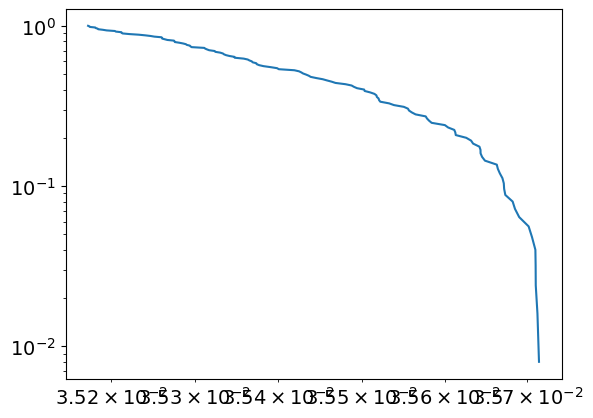

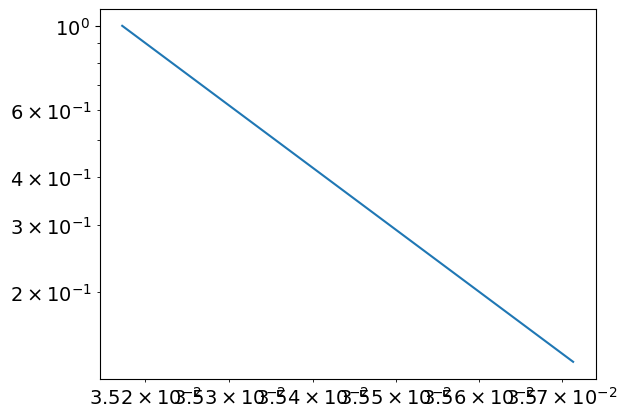

134.04000777945942
0.03517231329813521
powerlaw KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.03571397253260058, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.03571397253260058, statistic_sign=1)
tensor(0.0004, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0004, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0324, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-1.2043, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
0
tensor(0.0020, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


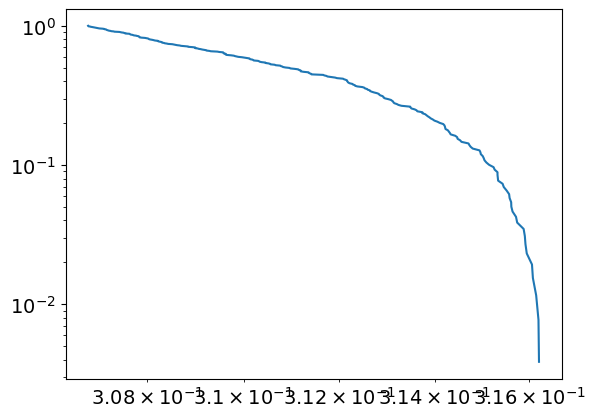

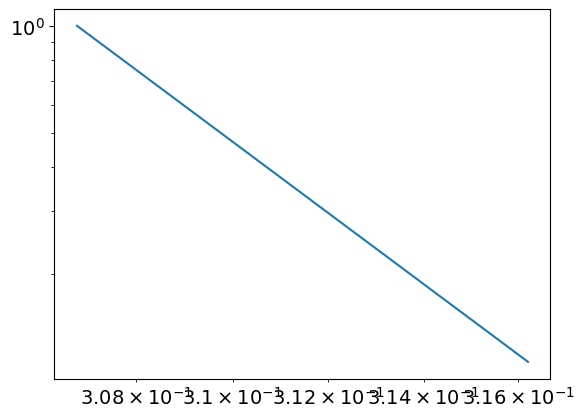

72.99068534821609
0.30677646319635565
powerlaw KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.3162081810617317, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.3162081810617317, statistic_sign=1)
tensor(0.0004, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0337, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0043, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-1.2096, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
1
tensor(3.2452e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


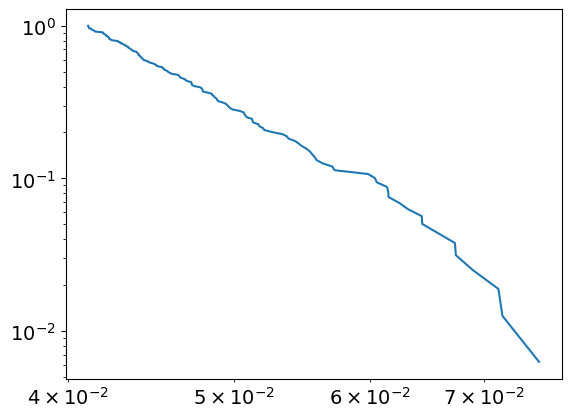

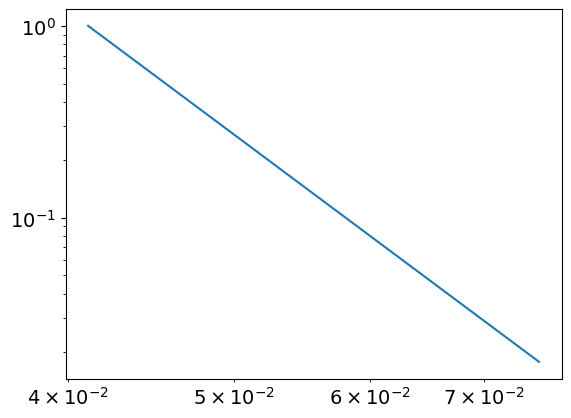

7.653606724443105
0.04109943092779435
powerlaw KstestResult(statistic=0.9999999999939301, pvalue=0.0, statistic_location=0.0753321099069209, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.0753321099069209, statistic_sign=1)
tensor(0.0006, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0003, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0047, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0801, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
1
tensor(0.0043, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


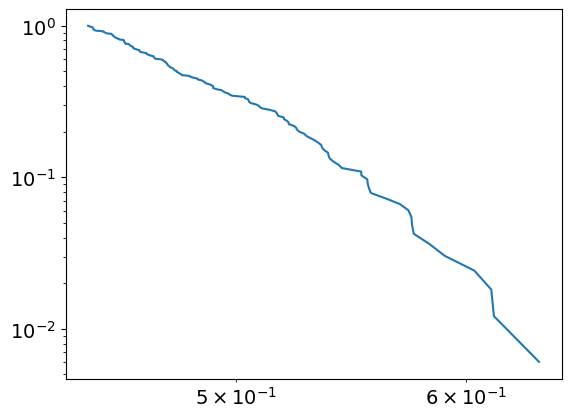

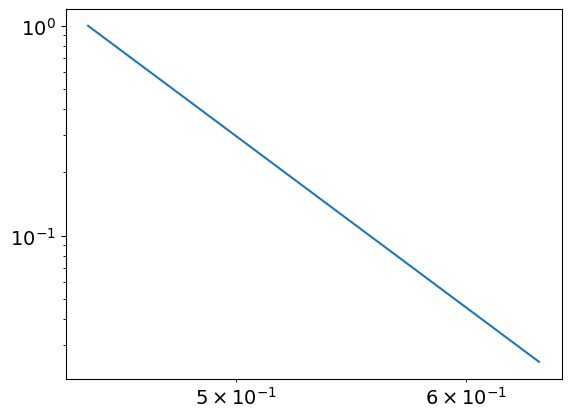

11.288043335970173
0.44439610526291495
powerlaw KstestResult(statistic=0.9999999920531484, pvalue=0.0, statistic_location=0.6360174360104489, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.6360174360104489, statistic_sign=1)
tensor(0.0291, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0393, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0079, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1945, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
2
tensor(3.3750e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


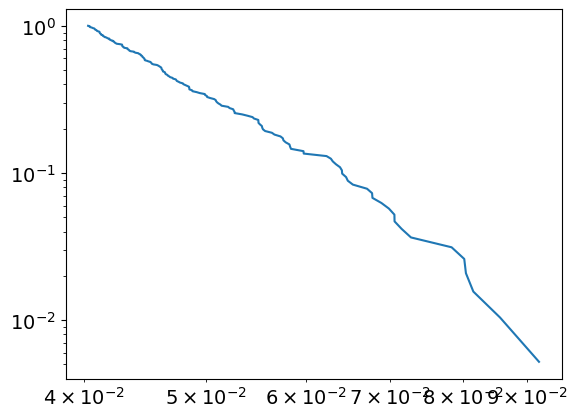

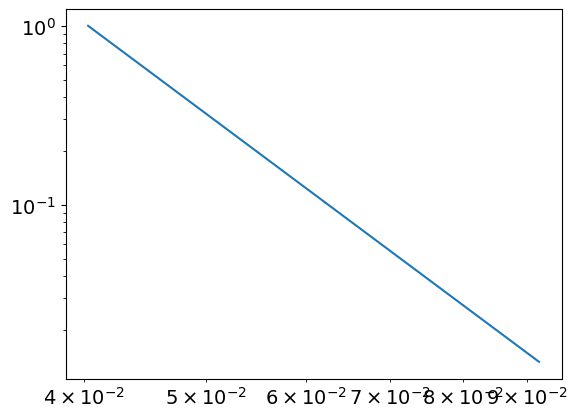

6.237600574357059
0.040271993817746404
powerlaw KstestResult(statistic=0.9999999905591767, pvalue=0.0, statistic_location=0.09196707013599766, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.09196707013599766, statistic_sign=1)
tensor(0.0004, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0003, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0128, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8890, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
2
tensor(0.0075, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


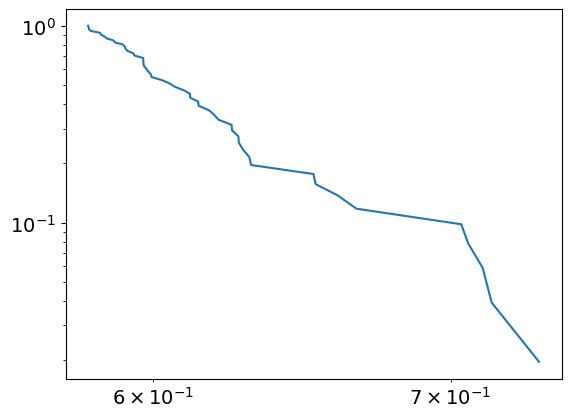

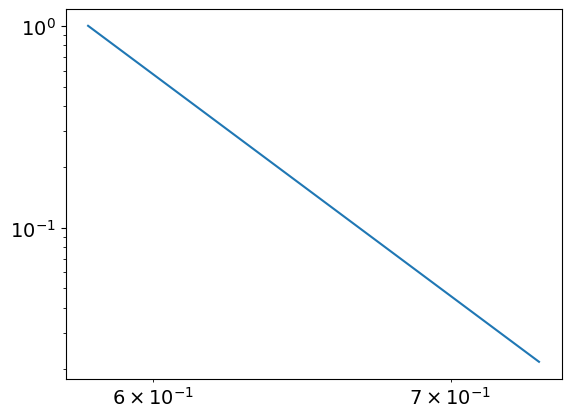

17.396644669406342
0.580116252580663
powerlaw KstestResult(statistic=0.9999999999999937, pvalue=0.0, statistic_location=0.7328549985094479, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.7328549985094479, statistic_sign=1)
tensor(0.0411, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0503, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0296, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0697, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
3
tensor(3.2620e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


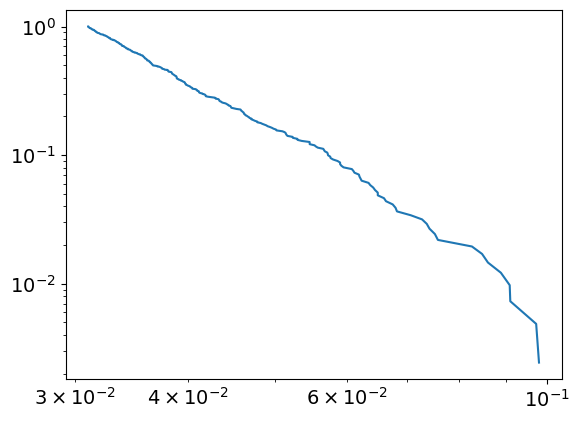

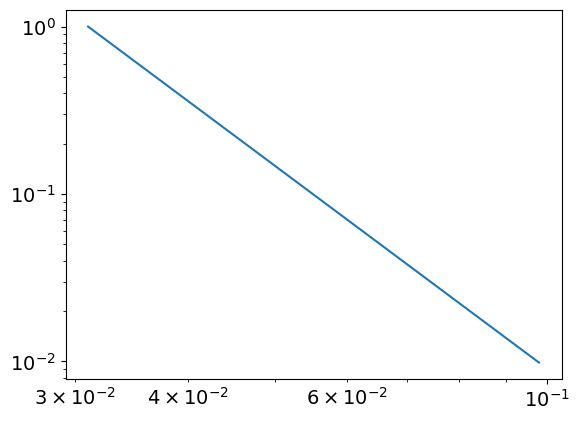

5.014868886806383
0.03100232350371399
powerlaw KstestResult(statistic=0.9999992569294381, pvalue=0.0, statistic_location=0.09095939905600962, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.09095939905600962, statistic_sign=1)
tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0003, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1204, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9538, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
3
tensor(0.0111, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


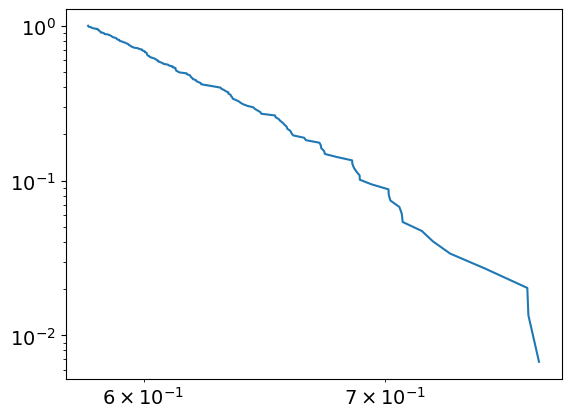

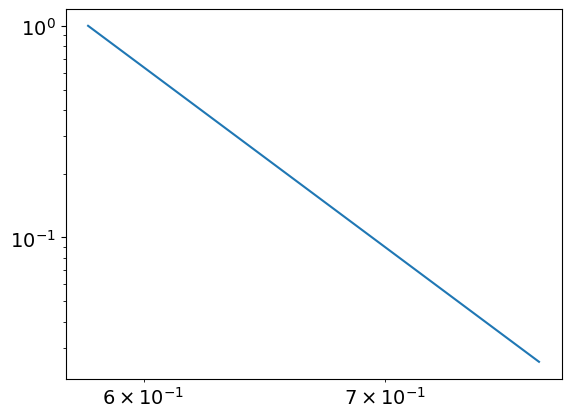

13.718799854866527
0.5791682308544479
powerlaw KstestResult(statistic=0.9999999998438915, pvalue=0.0, statistic_location=0.771997358748907, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.771997358748907, statistic_sign=1)
tensor(0.0480, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0618, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0395, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1205, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
4
tensor(3.5095e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


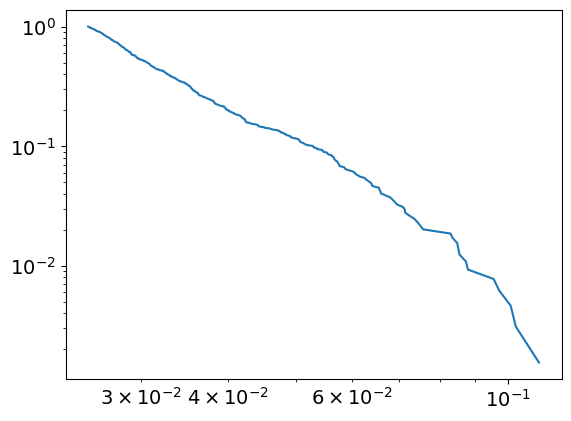

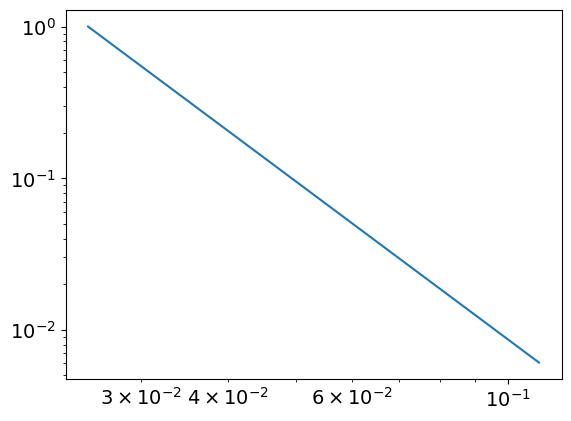

4.449622603254635
0.025258819658868833
powerlaw KstestResult(statistic=0.9999917473044494, pvalue=0.0, statistic_location=0.09729739160001649, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.09729739160001649, statistic_sign=1)
tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1661, device='cuda:0', grad_fn=<MeanBackward0>) tensor(3.4578, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
4
tensor(0.0152, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


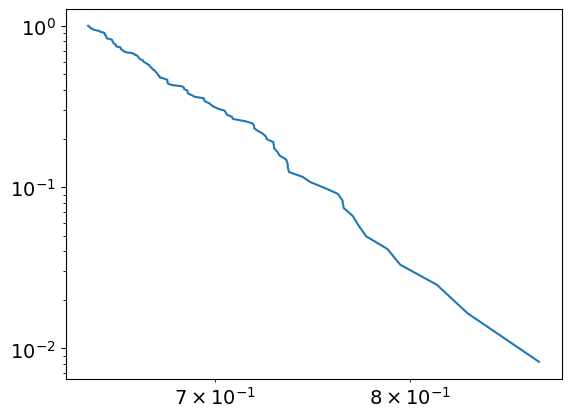

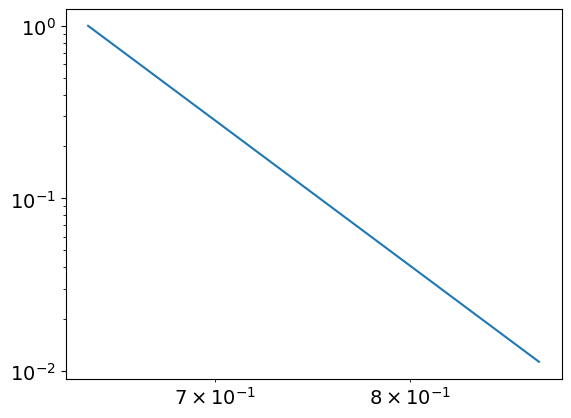

15.454471271970107
0.6412976073849054
powerlaw KstestResult(statistic=0.9999999999981972, pvalue=0.0, statistic_location=0.8151126796975465, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.8151126796975465, statistic_sign=1)
tensor(0.0544, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0721, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0345, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1053, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
5
tensor(3.3969e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


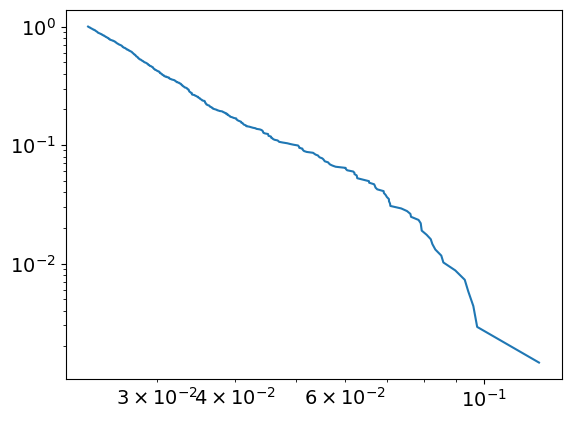

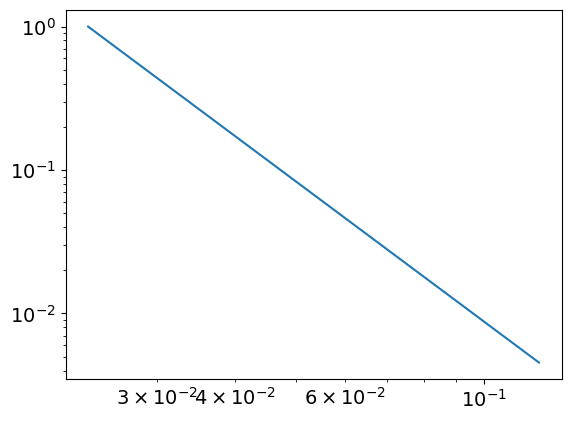

4.253049077505651
0.023296379816193726
powerlaw KstestResult(statistic=0.9999941469062792, pvalue=0.0, statistic_location=0.08213727240025676, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.08213727240025676, statistic_sign=1)
tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2593, device='cuda:0', grad_fn=<MeanBackward0>) tensor(4.4775, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
5
tensor(0.0198, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


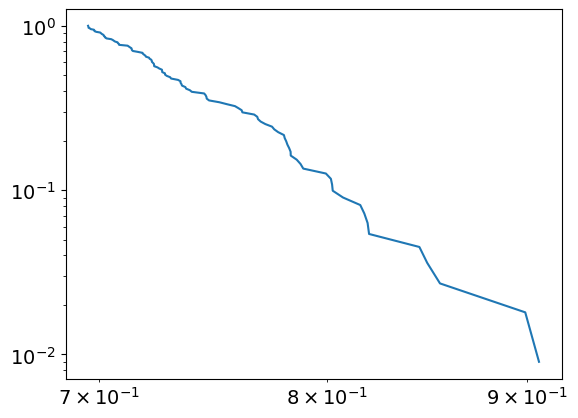

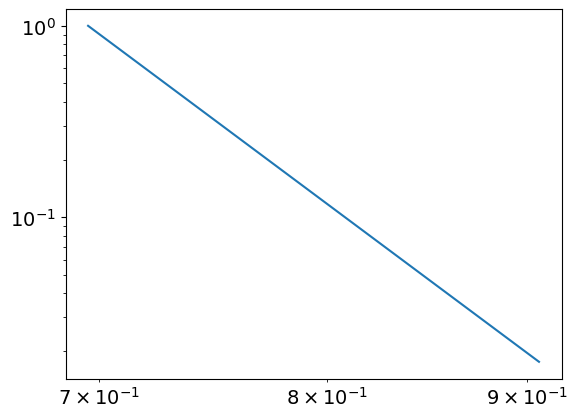

16.279543743349368
0.6954353220518414
powerlaw KstestResult(statistic=0.9999999999998945, pvalue=0.0, statistic_location=0.8549804384947084, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.8549804384947084, statistic_sign=1)
tensor(0.0598, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0815, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0342, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0517, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
6
tensor(4.0317e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


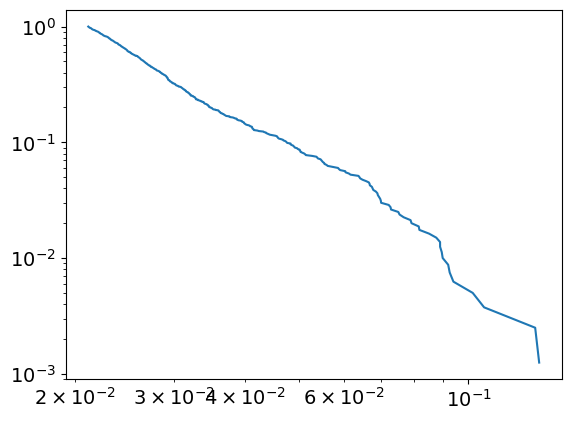

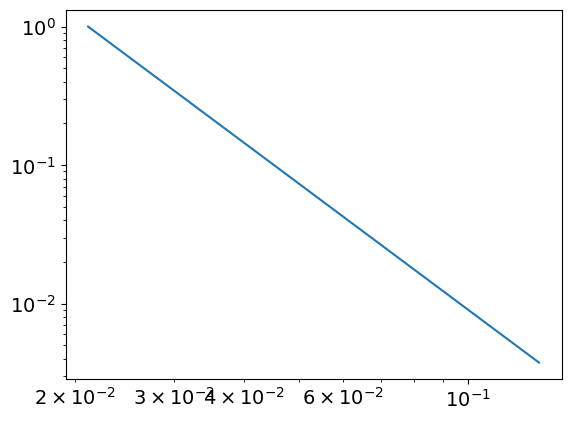

4.025845903033194
0.02110188446686595
powerlaw KstestResult(statistic=0.9999793902518096, pvalue=0.0, statistic_location=0.08965687523501074, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.08965687523501074, statistic_sign=1)
tensor(5.0506e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3926, device='cuda:0', grad_fn=<MeanBackward0>) tensor(6.7757, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
6
tensor(0.0246, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


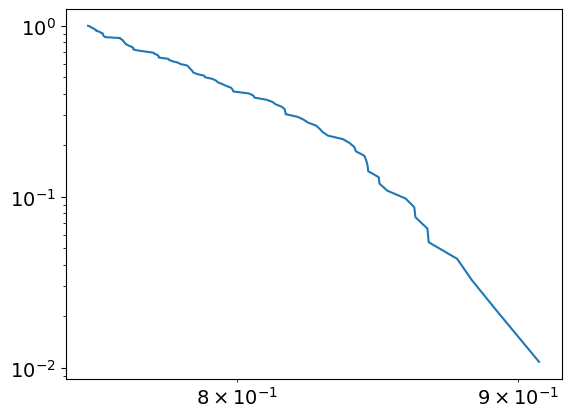

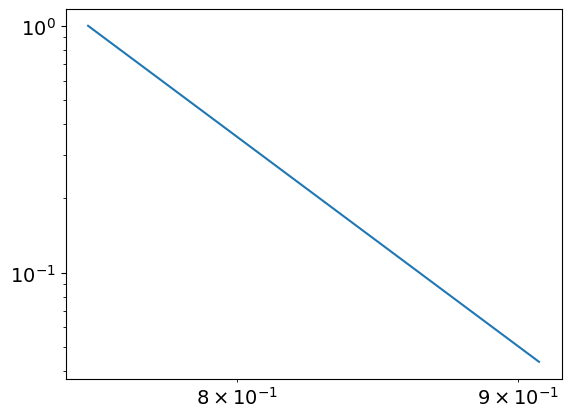

17.55703652624859
0.7514277121684221
powerlaw KstestResult(statistic=0.9999999999999927, pvalue=0.0, statistic_location=0.908063939287983, statistic_sign=1)
lognorm KstestResult(statistic=0.9999999999999948, pvalue=0.0, statistic_location=0.908063939287983, statistic_sign=1)
tensor(0.0630, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0902, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0431, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0110, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
7
tensor(4.0886e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


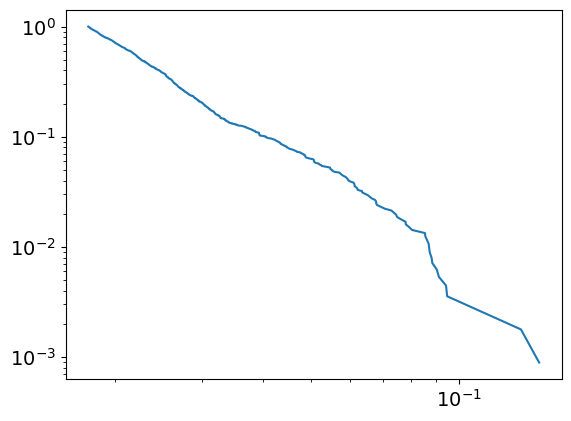

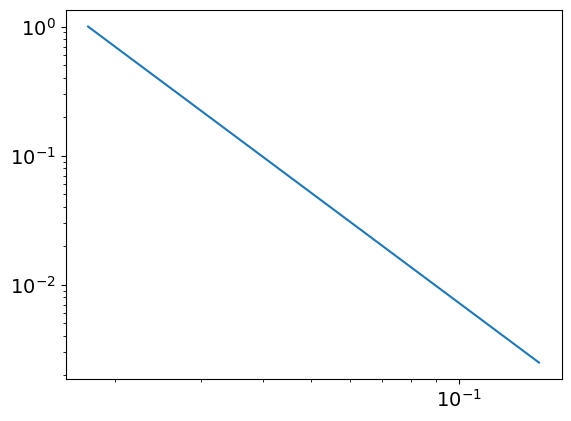

3.842807454605204
0.01765954102319942
powerlaw KstestResult(statistic=0.9999629169631056, pvalue=0.0, statistic_location=0.08796392053958398, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1455617972833024, statistic_sign=-1)
tensor(-8.9687e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4723, device='cuda:0', grad_fn=<MeanBackward0>) tensor(8.3247, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
7
tensor(0.0294, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


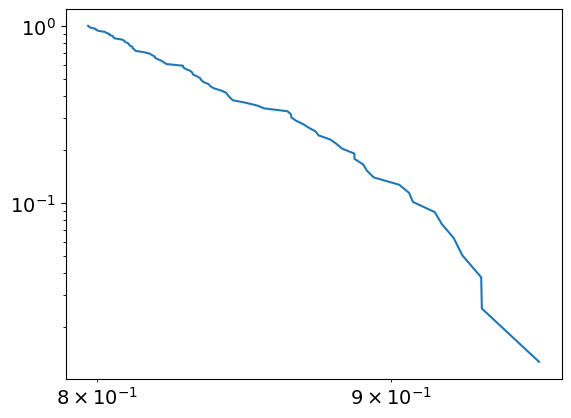

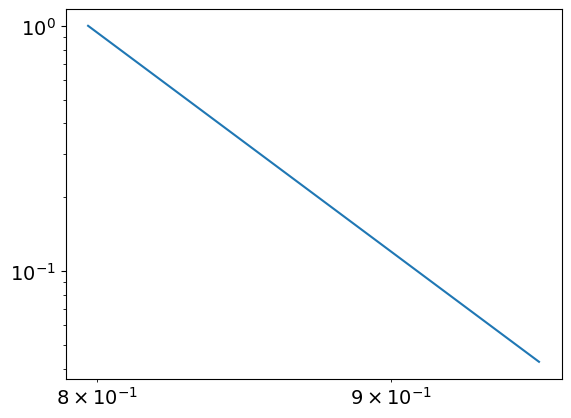

18.488059813417852
0.7972088529217741
powerlaw KstestResult(statistic=0.9999999999999986, pvalue=0.0, statistic_location=0.9548281626939119, statistic_sign=1)
lognorm KstestResult(statistic=0.9999999999869863, pvalue=0.0, statistic_location=0.9548281626939119, statistic_sign=1)
tensor(0.0651, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0985, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0514, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0041, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
8
tensor(4.9889e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


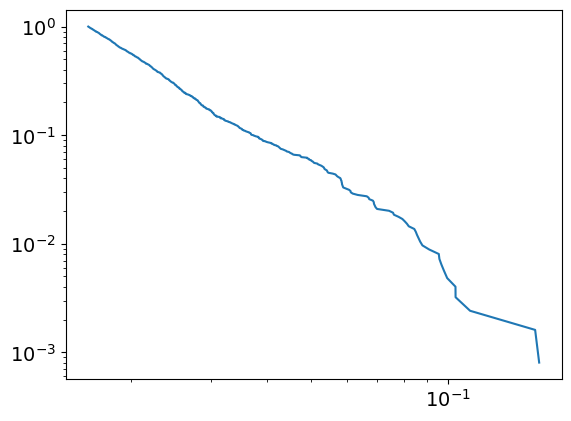

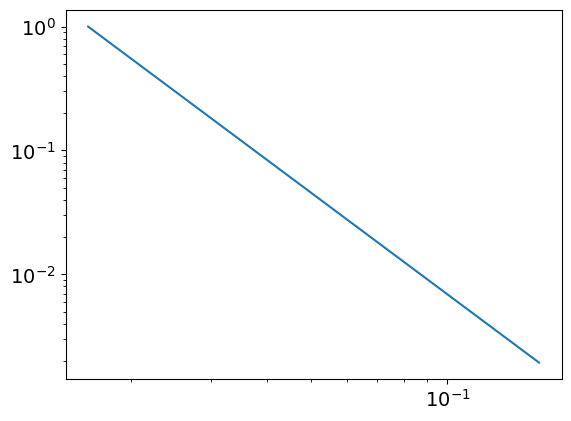

3.7223863131763415
0.01607662348564978
powerlaw KstestResult(statistic=0.9998820065114707, pvalue=0.0, statistic_location=0.10412569906104774, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1592963937924941, statistic_sign=-1)
tensor(-4.0801e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6151, device='cuda:0', grad_fn=<MeanBackward0>) tensor(12.0959, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
8
tensor(0.0346, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


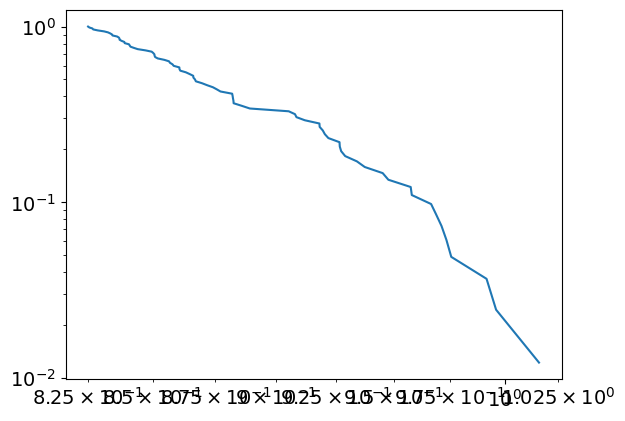

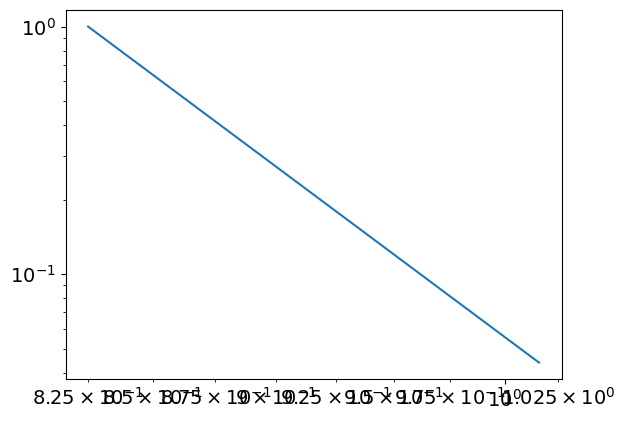

16.015363764875055
0.8250250276849702
powerlaw KstestResult(statistic=0.9999999999994797, pvalue=0.0, statistic_location=0.9960263157532971, statistic_sign=1)
lognorm KstestResult(statistic=0.9999999970527086, pvalue=0.0, statistic_location=0.9960263157532971, statistic_sign=1)
tensor(0.0672, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1066, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0530, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0097, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
9
tensor(4.2790e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


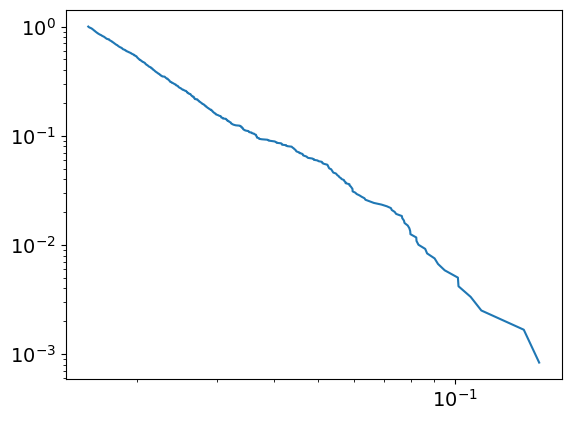

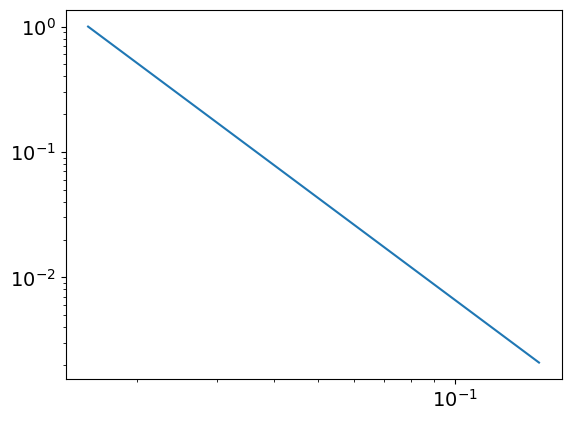

3.7018668768426943
0.015605834208945802
powerlaw KstestResult(statistic=0.9998850997793375, pvalue=0.0, statistic_location=0.10185577978653482, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15327932024890864, statistic_sign=-1)
tensor(-7.3457e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5974, device='cuda:0', grad_fn=<MeanBackward0>) tensor(12.0680, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
9
tensor(0.0400, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


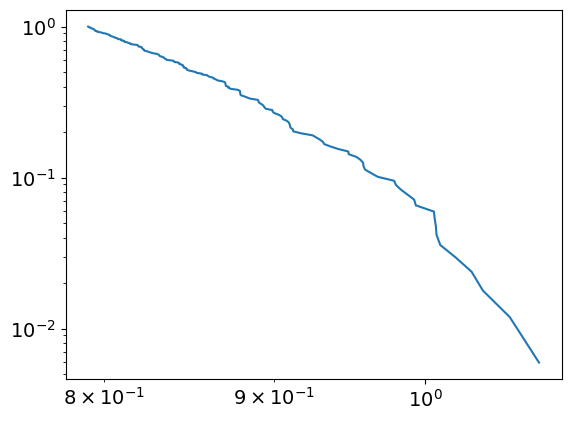

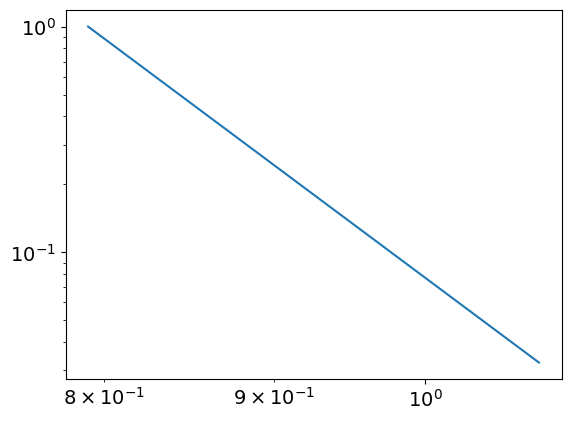

11.929860824434433
0.7909810912555216
powerlaw KstestResult(statistic=0.9999999558411445, pvalue=0.0, statistic_location=1.0327950171476896, statistic_sign=1)
lognorm KstestResult(statistic=0.9999998600898151, pvalue=0.0, statistic_location=1.0327950171476896, statistic_sign=1)
tensor(0.0689, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1143, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0534, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0273, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
10
tensor(4.6086e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


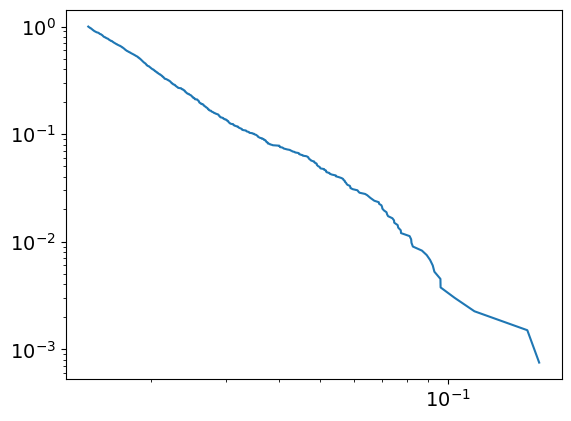

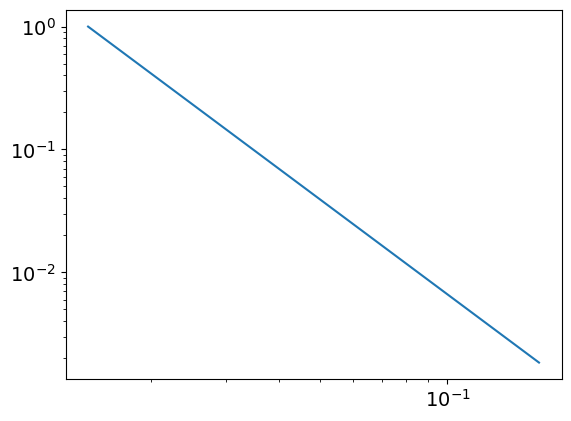

3.5729974714857
0.014225693151214396
powerlaw KstestResult(statistic=0.9998190940130597, pvalue=0.0, statistic_location=0.10387500513003003, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.16431906975113056, statistic_sign=-1)
tensor(-9.6111e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.7698, device='cuda:0', grad_fn=<MeanBackward0>) tensor(14.5861, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
10
tensor(0.0454, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


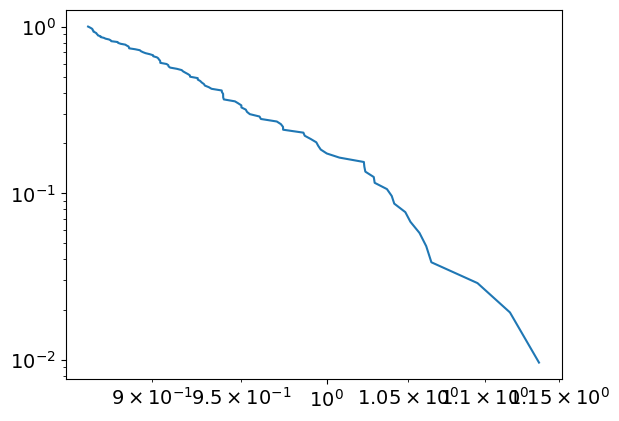

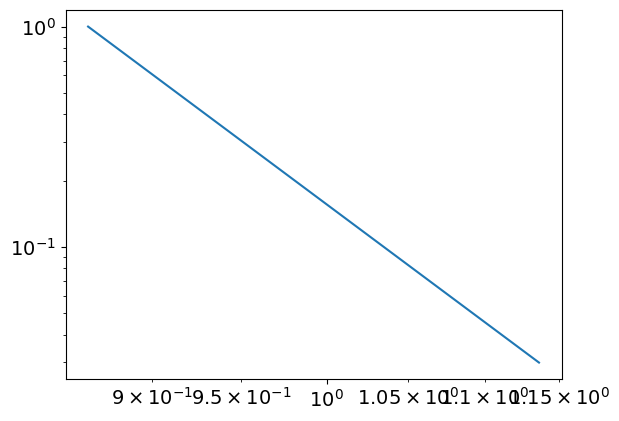

13.936683177615906
0.8662141960728901
powerlaw KstestResult(statistic=0.9999999998328911, pvalue=0.0, statistic_location=1.0650387675485435, statistic_sign=1)
lognorm KstestResult(statistic=0.9999978343589896, pvalue=0.0, statistic_location=1.0650387675485435, statistic_sign=1)
tensor(0.0704, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1214, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0538, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0443, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
11
tensor(4.0883e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


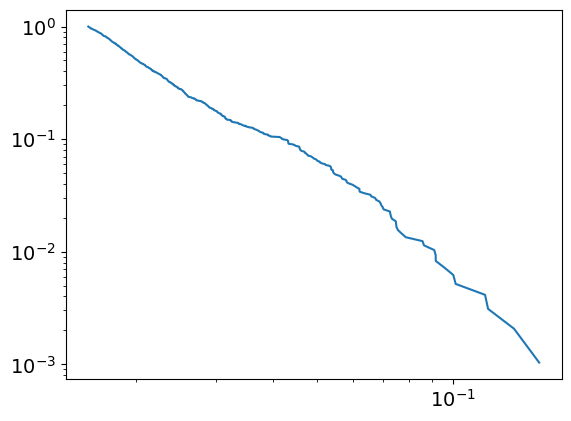

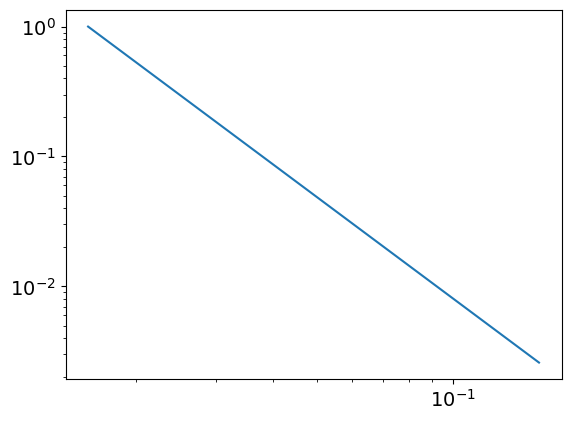

3.6006780785948633
0.015669995824297185
powerlaw KstestResult(statistic=0.999856822455539, pvalue=0.0, statistic_location=0.10125320452333521, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15471846170750778, statistic_sign=-1)
tensor(-0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.7666, device='cuda:0', grad_fn=<MeanBackward0>) tensor(14.5371, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
11
tensor(0.0505, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


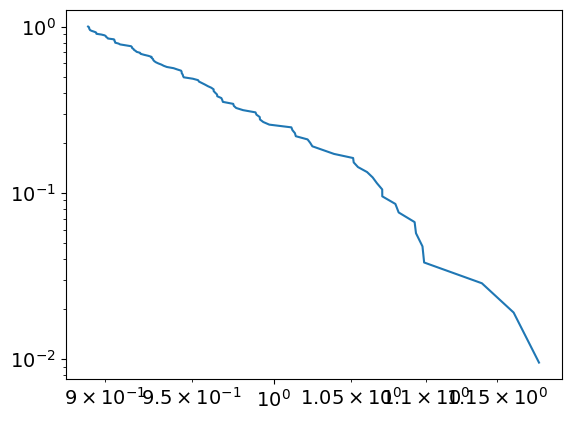

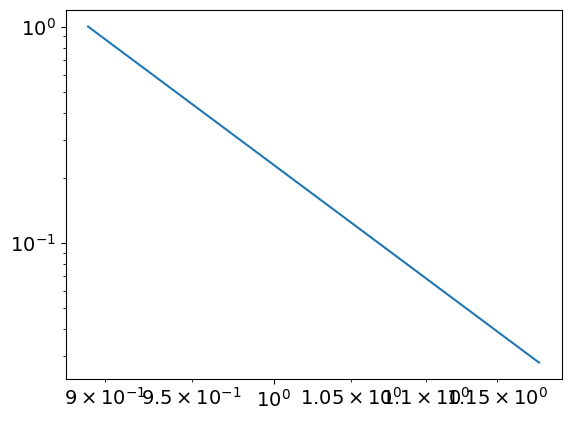

13.660750866545754
0.8902602781454759
powerlaw KstestResult(statistic=0.9999999995324643, pvalue=0.0, statistic_location=1.0977553922605463, statistic_sign=1)
lognorm KstestResult(statistic=0.9999770950803876, pvalue=0.0, statistic_location=1.0977553922605463, statistic_sign=1)
tensor(0.0714, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1277, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0542, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0597, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
12
tensor(4.4188e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


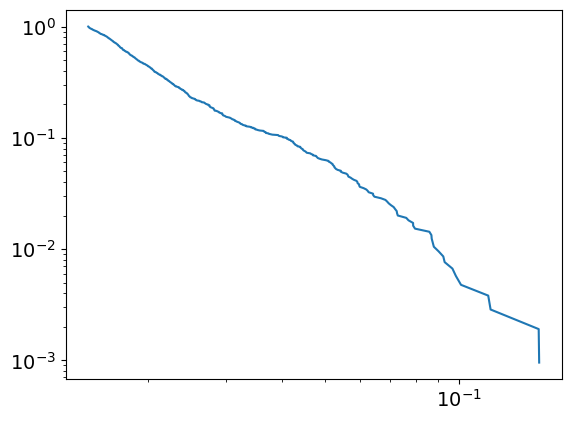

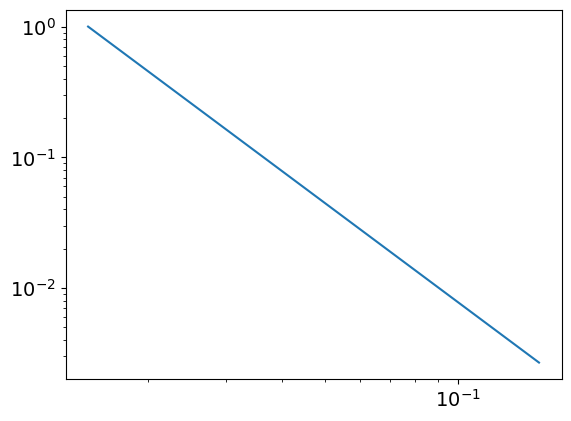

3.531953233718031
0.014666609551415122
powerlaw KstestResult(statistic=0.999841466808611, pvalue=0.0, statistic_location=0.09864007912890604, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15187226060710993, statistic_sign=-1)
tensor(-0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.8055, device='cuda:0', grad_fn=<MeanBackward0>) tensor(16.7638, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
12
tensor(0.0553, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


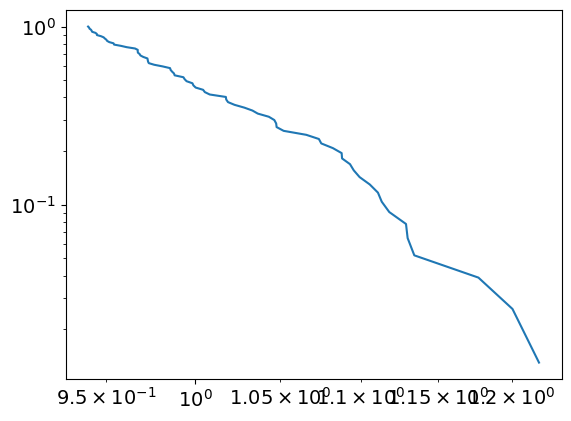

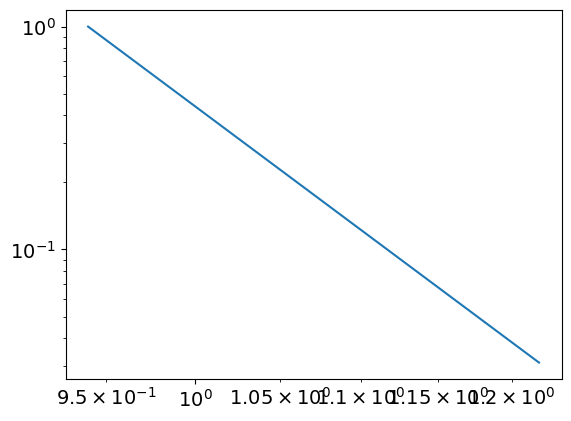

14.372981274832858
0.9403091101733667
powerlaw KstestResult(statistic=0.9999999999573773, pvalue=0.0, statistic_location=1.1301904926710227, statistic_sign=1)
lognorm KstestResult(statistic=0.9998315223766614, pvalue=0.0, statistic_location=1.1301904926710227, statistic_sign=1)
tensor(0.0722, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1335, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0546, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0740, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
13
tensor(4.3937e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


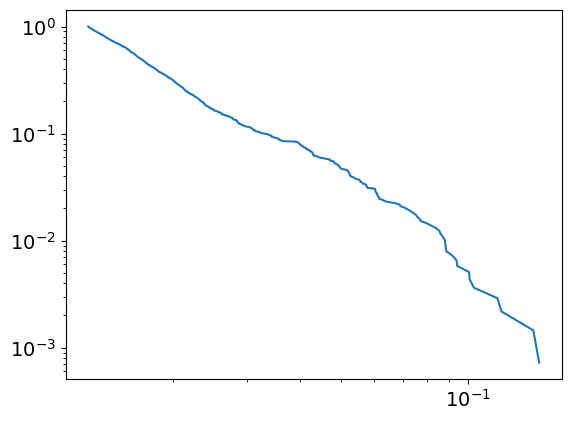

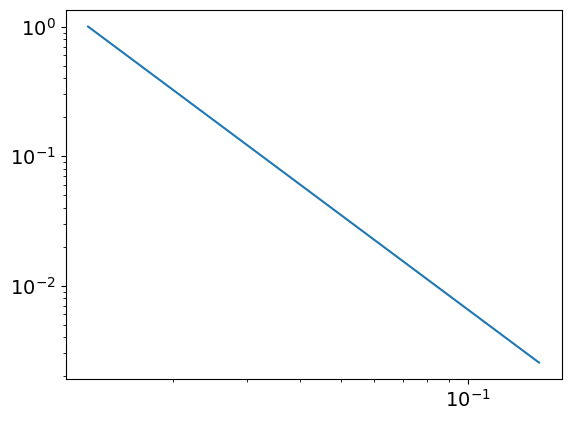

3.4317214003227967
0.01262182374006498
powerlaw KstestResult(statistic=0.9997624579682333, pvalue=0.0, statistic_location=0.10050274296785568, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14718496786221882, statistic_sign=-1)
tensor(-0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.7929, device='cuda:0', grad_fn=<MeanBackward0>) tensor(17.5686, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
13
tensor(0.0600, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


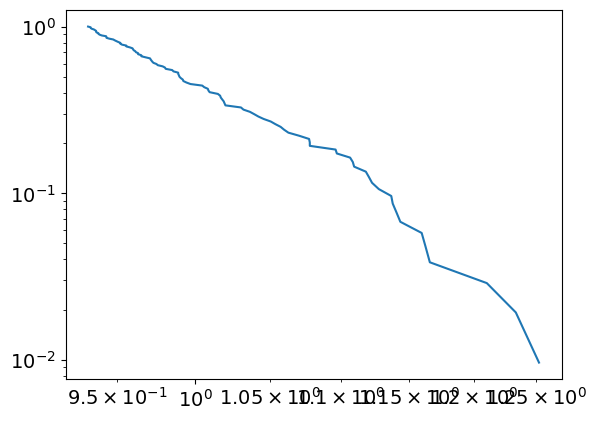

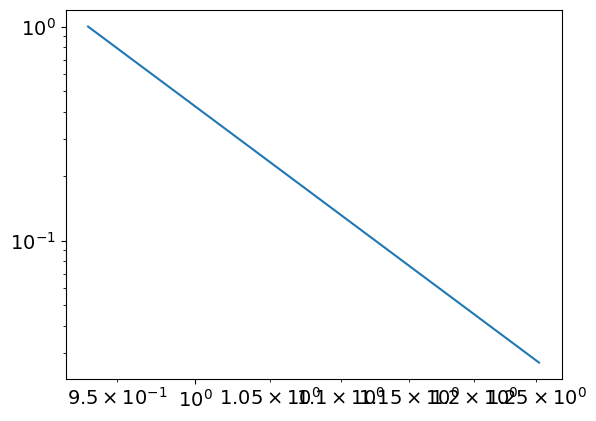

13.249082804860173
0.9322242955901172
powerlaw KstestResult(statistic=0.9999999964586176, pvalue=0.0, statistic_location=1.162451992788608, statistic_sign=1)
lognorm KstestResult(statistic=0.9995089318178371, pvalue=0.0, statistic_location=1.1405635569450936, statistic_sign=1)
tensor(0.0728, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1387, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0551, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0874, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
14
tensor(3.9341e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


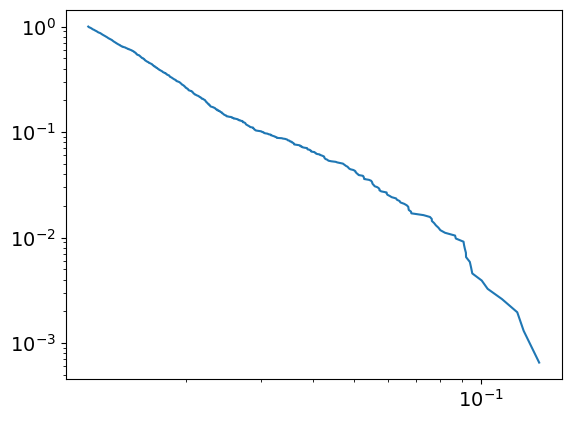

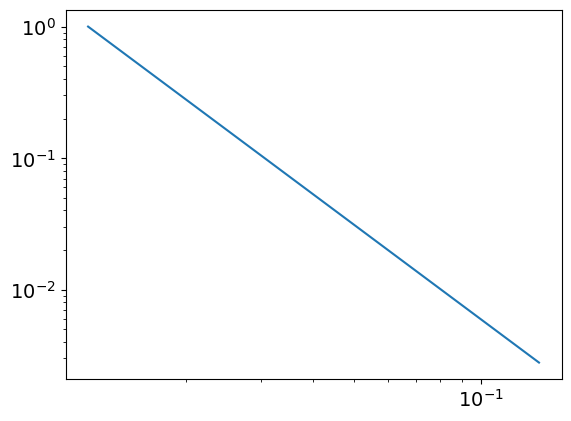

3.390017460364503
0.011703379789898657
powerlaw KstestResult(statistic=0.9997310178312417, pvalue=0.0, statistic_location=0.10017959028446463, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13708460608167558, statistic_sign=-1)
tensor(-9.8357e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6596, device='cuda:0', grad_fn=<MeanBackward0>) tensor(17.0346, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
14
tensor(0.0643, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


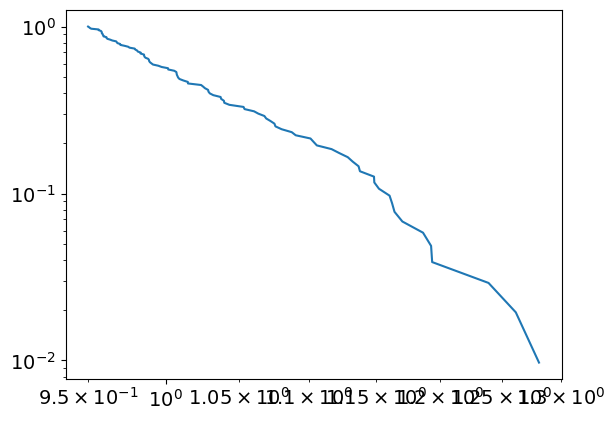

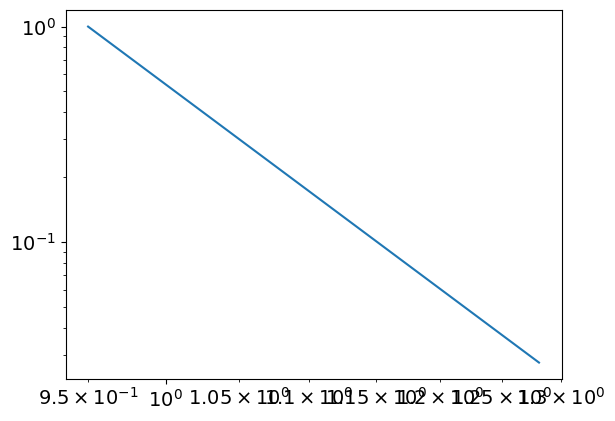

12.999125198412631
0.9497473944931716
powerlaw KstestResult(statistic=0.9999999897712158, pvalue=0.0, statistic_location=1.192592701588701, statistic_sign=1)
lognorm KstestResult(statistic=0.9993525204947724, pvalue=0.0, statistic_location=1.137590596333455, statistic_sign=1)
tensor(0.0732, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1433, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0557, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1002, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
15
tensor(4.1495e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


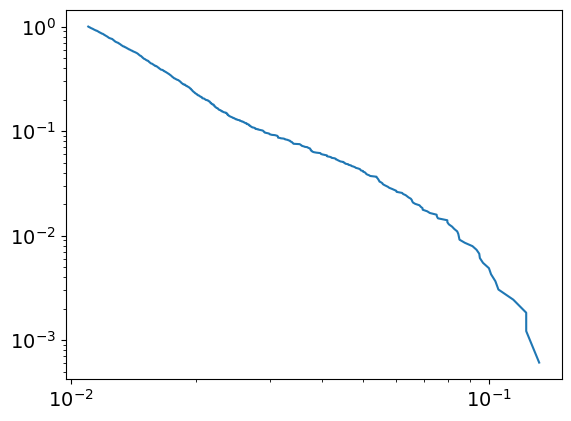

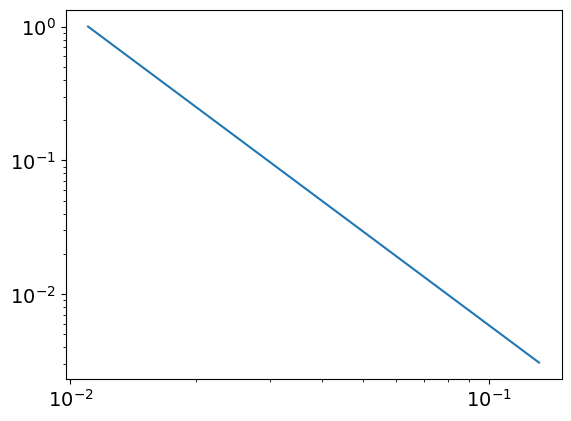

3.3286789053124233
0.011024389794133794
powerlaw KstestResult(statistic=0.9996120454640486, pvalue=0.0, statistic_location=0.10547468017119456, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1320038916875331, statistic_sign=-1)
tensor(-8.6168e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6735, device='cuda:0', grad_fn=<MeanBackward0>) tensor(18.4662, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
15
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


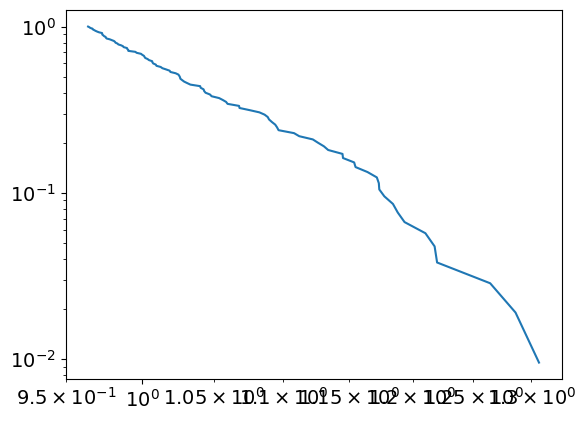

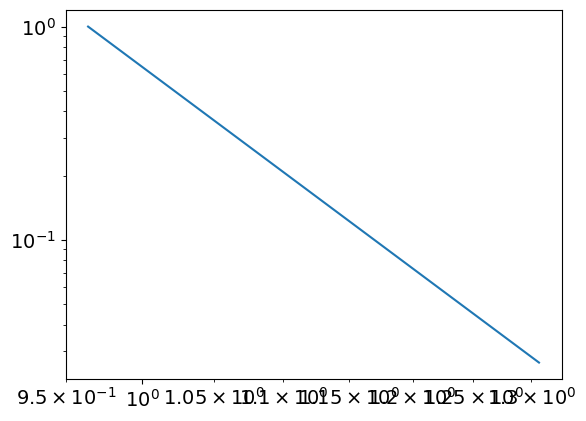

12.946066923685802
0.9643021293753953
powerlaw KstestResult(statistic=0.9999999785073124, pvalue=0.0, statistic_location=1.2199952330464878, statistic_sign=1)
lognorm KstestResult(statistic=0.9990460016407697, pvalue=0.0, statistic_location=1.1547452606223108, statistic_sign=1)
tensor(0.0735, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1475, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0566, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1125, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
16
tensor(3.7776e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


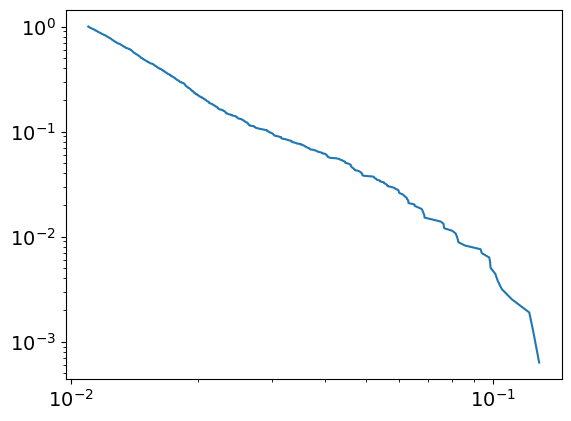

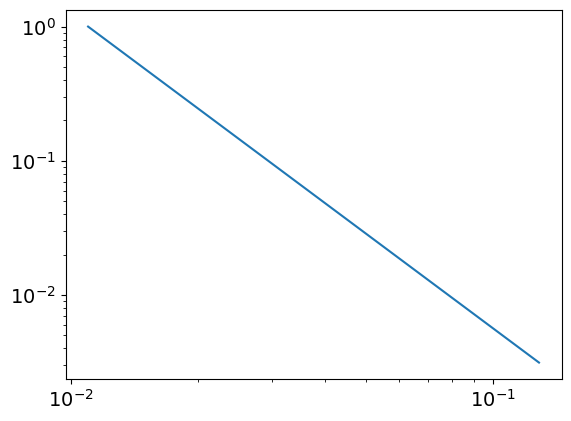

3.341688188553342
0.010977311939809728
powerlaw KstestResult(statistic=0.9996306036379116, pvalue=0.0, statistic_location=0.10491121331805313, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12862093815552605, statistic_sign=-1)
tensor(-6.7506e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5632, device='cuda:0', grad_fn=<MeanBackward0>) tensor(18.6097, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
16
tensor(0.0722, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


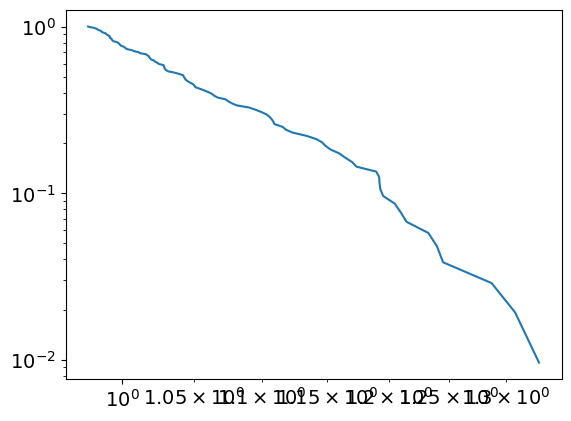

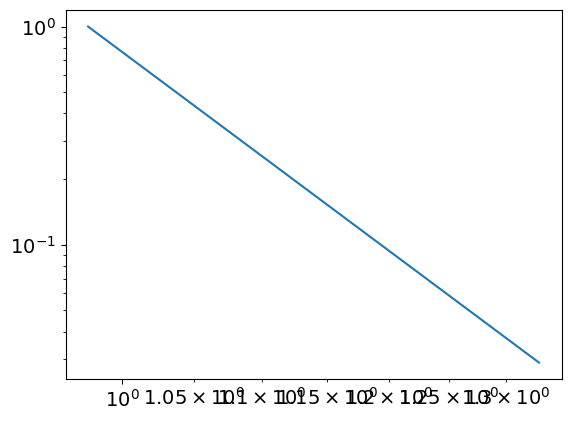

12.514228424492485
0.9769598905850995
powerlaw KstestResult(statistic=0.9999999299464604, pvalue=0.0, statistic_location=1.2450527055449225, statistic_sign=1)
lognorm KstestResult(statistic=0.9987739505739286, pvalue=0.0, statistic_location=1.1599056386453948, statistic_sign=1)
tensor(0.0738, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1513, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0575, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1241, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
17
tensor(3.8998e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


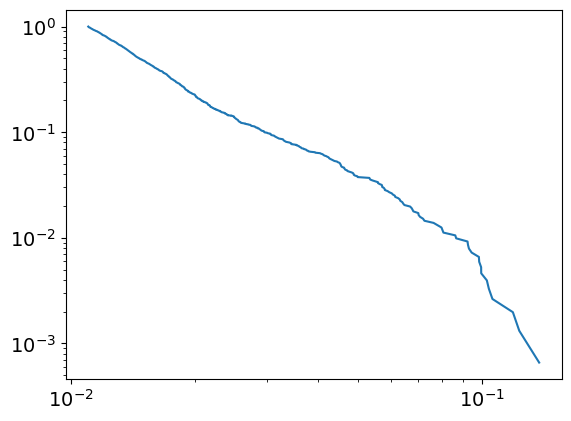

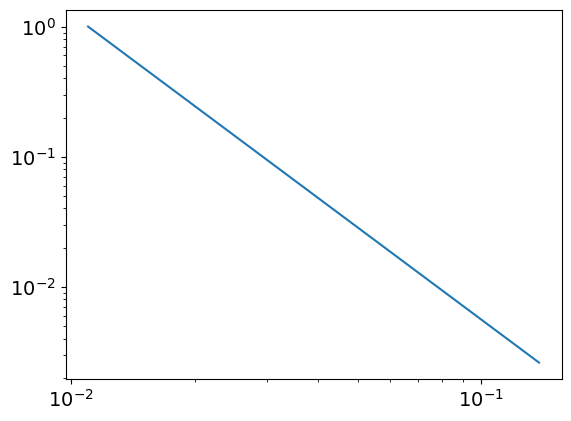

3.3496562834733687
0.011003334878755607
powerlaw KstestResult(statistic=0.9996193353973395, pvalue=0.0, statistic_location=0.10631842794120644, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13818932246319957, statistic_sign=-1)
tensor(-5.8786e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5604, device='cuda:0', grad_fn=<MeanBackward0>) tensor(20.0498, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
17
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


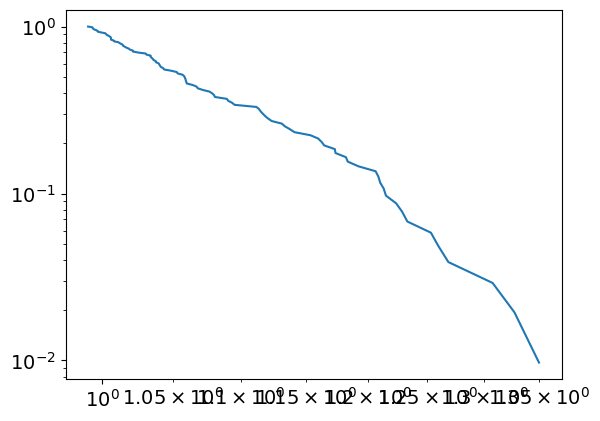

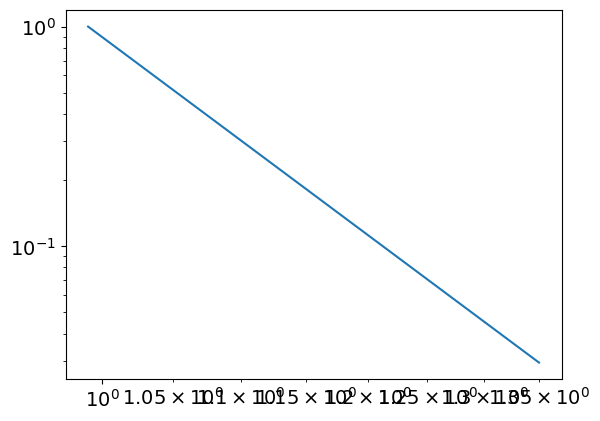

12.386099842480556
0.9904395243774881
powerlaw KstestResult(statistic=0.9999998712946089, pvalue=0.0, statistic_location=1.2682180796190123, statistic_sign=1)
lognorm KstestResult(statistic=0.9985473560430629, pvalue=0.0, statistic_location=1.162535258150859, statistic_sign=1)
tensor(0.0739, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1548, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0585, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1351, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
18
tensor(3.9004e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


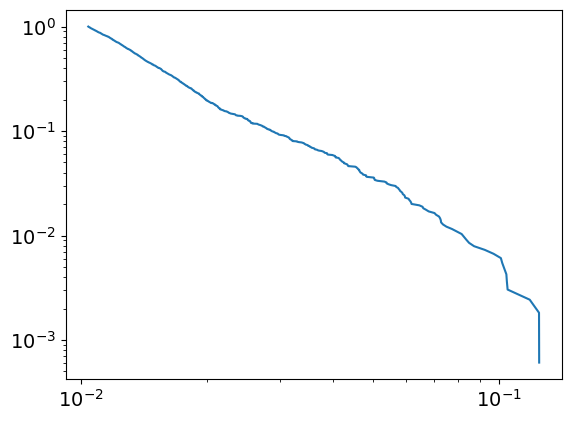

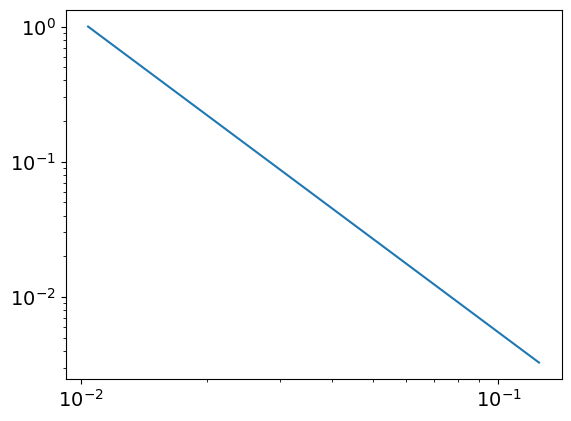

3.3001755972447677
0.010393367761361284
powerlaw KstestResult(statistic=0.9995918960898822, pvalue=0.0, statistic_location=0.10436904892066035, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12507217354353545, statistic_sign=-1)
tensor(-5.7044e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6221, device='cuda:0', grad_fn=<MeanBackward0>) tensor(20.6970, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
18
tensor(0.0792, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


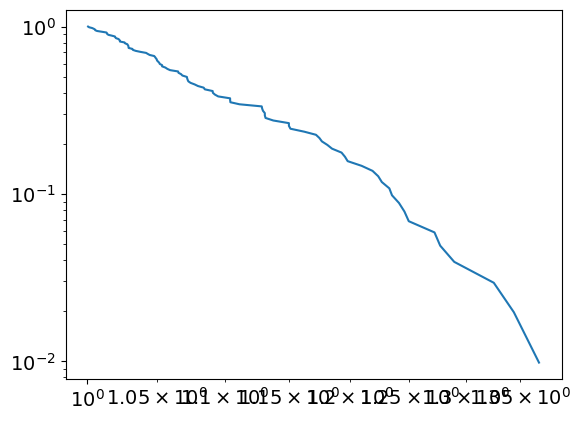

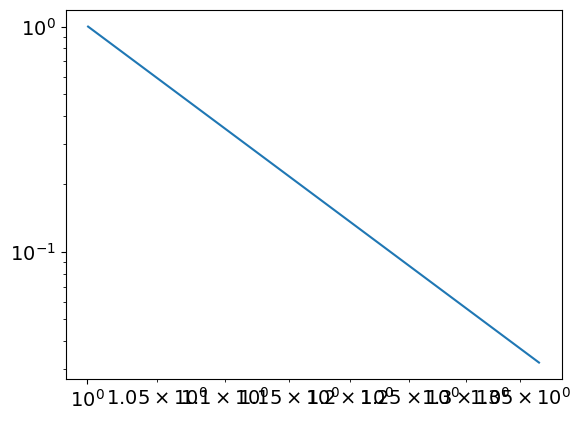

12.000512248541106
1.0007023701479427
powerlaw KstestResult(statistic=0.9999996612722666, pvalue=0.0, statistic_location=1.2896664839749767, statistic_sign=1)
lognorm KstestResult(statistic=0.998360091223817, pvalue=0.0, statistic_location=1.162420519810969, statistic_sign=1)
tensor(0.0740, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1579, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0596, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1455, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
19
tensor(4.0198e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


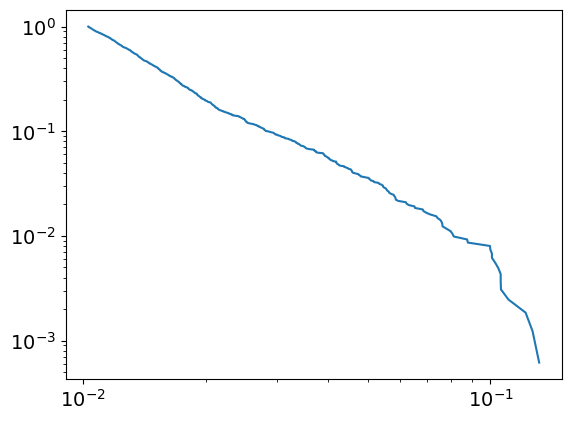

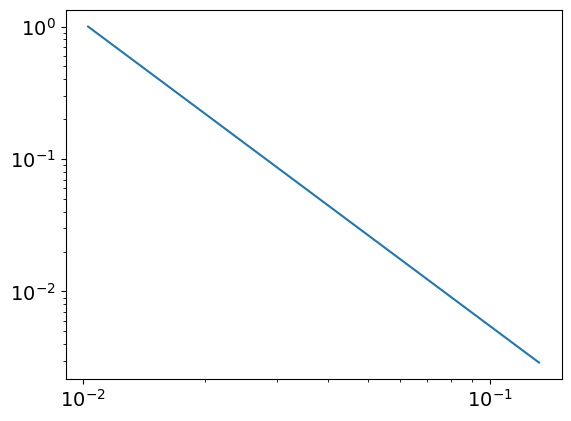

3.293151120227388
0.010310165726897724
powerlaw KstestResult(statistic=0.9995600312566022, pvalue=0.0, statistic_location=0.10597222091239573, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13170762939790823, statistic_sign=-1)
tensor(-3.8109e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5698, device='cuda:0', grad_fn=<MeanBackward0>) tensor(22.2004, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
19
tensor(0.0824, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


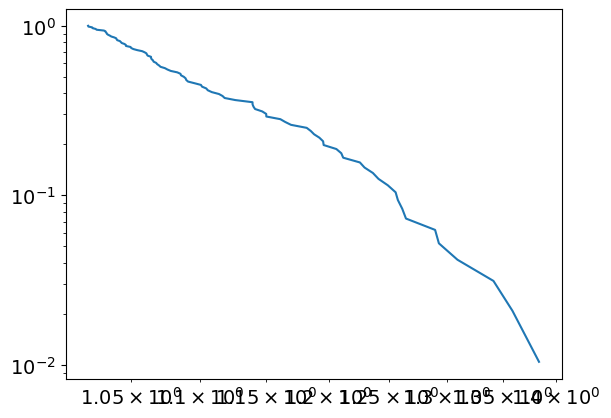

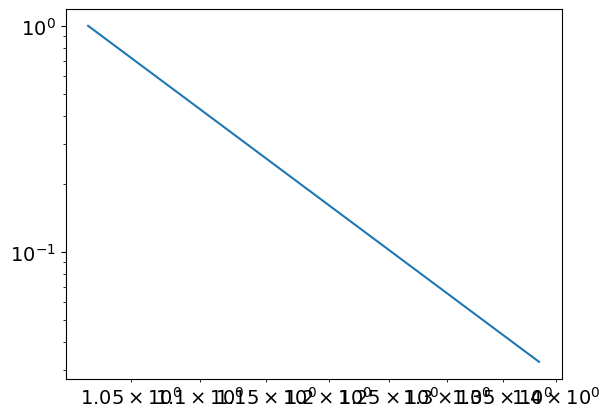

12.20616751442765
1.019580474070264
powerlaw KstestResult(statistic=0.9999997274269281, pvalue=0.0, statistic_location=1.3094460950782394, statistic_sign=1)
lognorm KstestResult(statistic=0.9981659504929, pvalue=0.0, statistic_location=1.169813007482976, statistic_sign=1)
tensor(0.0741, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1609, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0607, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1553, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
20
tensor(4.4322e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


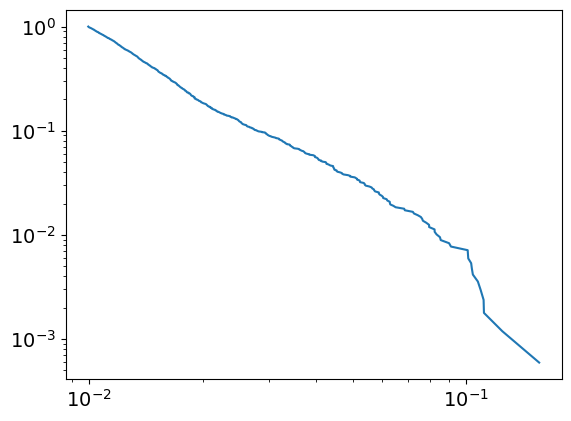

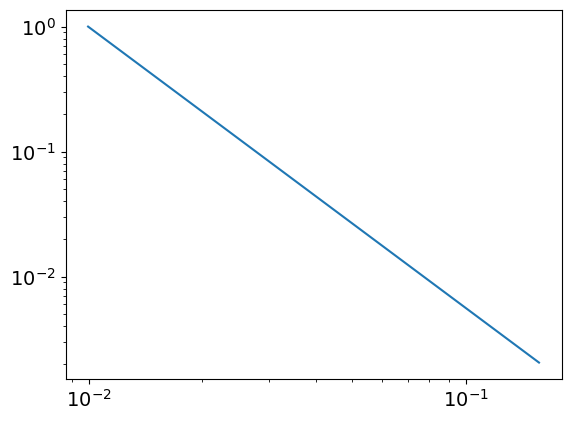

3.246949383801269
0.009951041706895805
powerlaw KstestResult(statistic=0.9995325571322131, pvalue=0.0, statistic_location=0.1042134106670095, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15623295262613265, statistic_sign=-1)
tensor(-5.2410e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6857, device='cuda:0', grad_fn=<MeanBackward0>) tensor(24.3678, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
20
tensor(0.0854, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


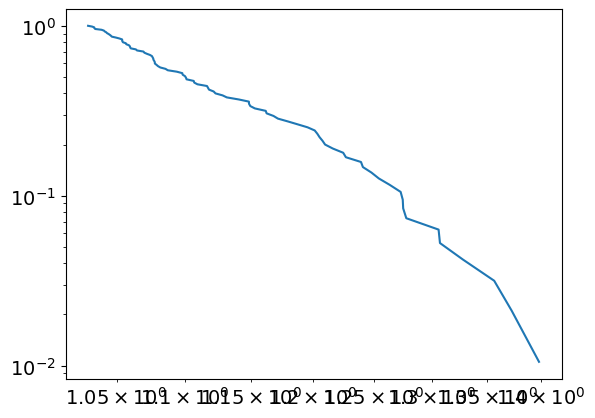

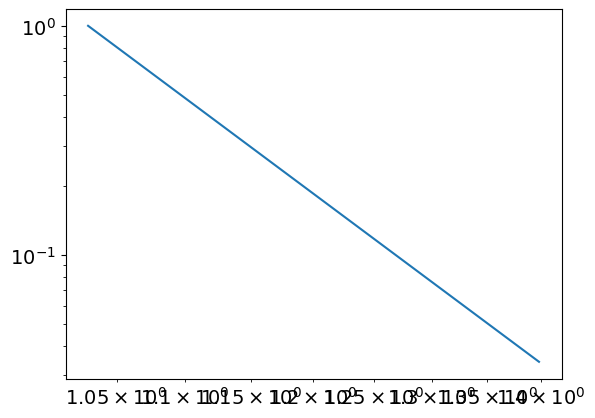

12.044730800556291
1.0299646541292031
powerlaw KstestResult(statistic=0.999999536735198, pvalue=0.0, statistic_location=1.327893615065262, statistic_sign=1)
lognorm KstestResult(statistic=0.9979421232017909, pvalue=0.0, statistic_location=1.1714251496229313, statistic_sign=1)
tensor(0.0741, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1635, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0619, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1646, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
21
tensor(4.6225e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


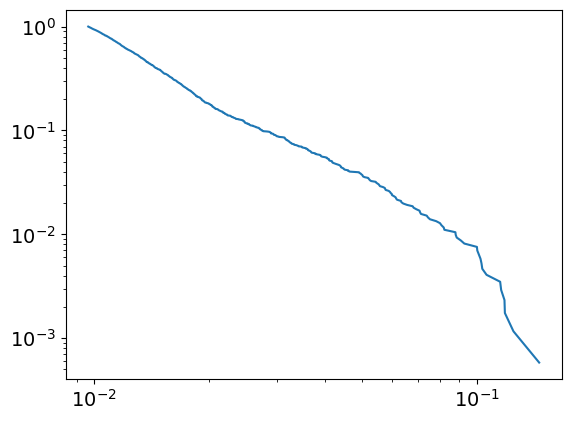

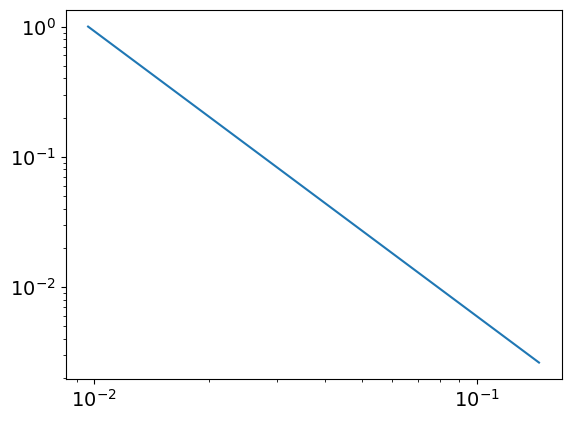

3.189365254833503
0.009645916354334138
powerlaw KstestResult(statistic=0.9992997572471283, pvalue=0.0, statistic_location=0.10591171078078235, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1453515282451089, statistic_sign=-1)
tensor(-3.8710e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5346, device='cuda:0', grad_fn=<MeanBackward0>) tensor(25.2270, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
21
tensor(0.0883, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


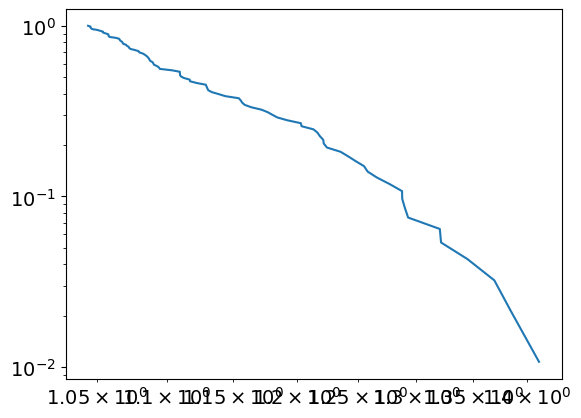

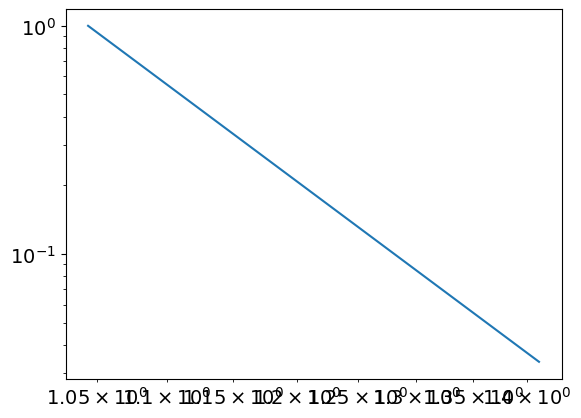

12.231970415390244
1.0434642348563705
powerlaw KstestResult(statistic=0.9999995695923516, pvalue=0.0, statistic_location=1.3451471627802707, statistic_sign=1)
lognorm KstestResult(statistic=0.9977011874964787, pvalue=0.0, statistic_location=1.184508963926773, statistic_sign=1)
tensor(0.0741, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1660, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0633, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1736, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
22
tensor(4.8520e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


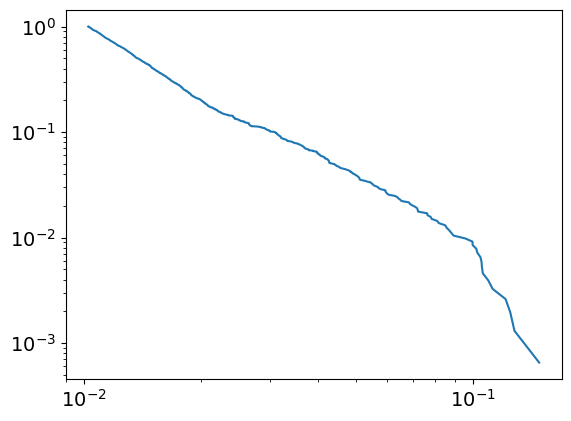

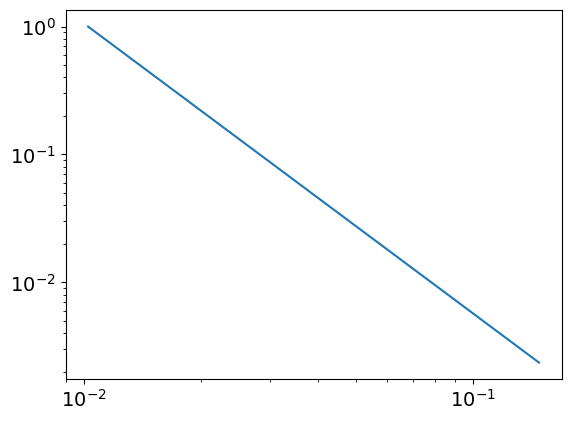

3.2664206561492724
0.010238782913767359
powerlaw KstestResult(statistic=0.9992944682045988, pvalue=0.0, statistic_location=0.11225620424328904, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14792479201774952, statistic_sign=-1)
tensor(-2.8560e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4092, device='cuda:0', grad_fn=<MeanBackward0>) tensor(26.7666, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
22
tensor(0.0910, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


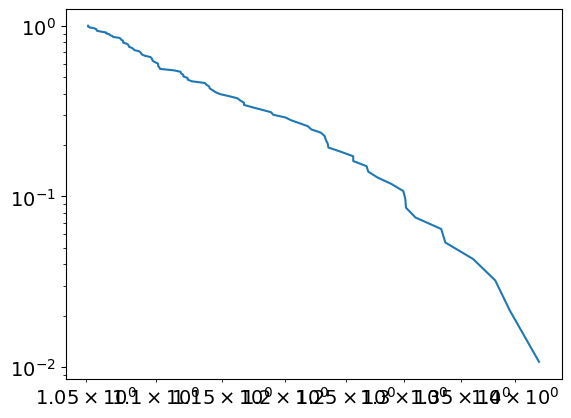

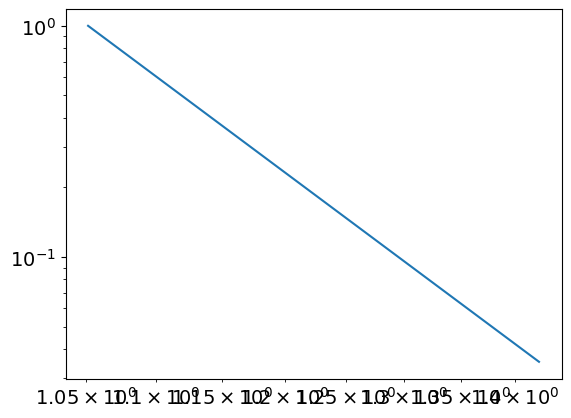

12.051311273872315
1.0512633789563306
powerlaw KstestResult(statistic=0.9999992513174789, pvalue=0.0, statistic_location=1.3615037243629846, statistic_sign=1)
lognorm KstestResult(statistic=0.9976127513579653, pvalue=0.0, statistic_location=1.1737720209722398, statistic_sign=1)
tensor(0.0742, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0649, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1823, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
23
tensor(5.0762e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


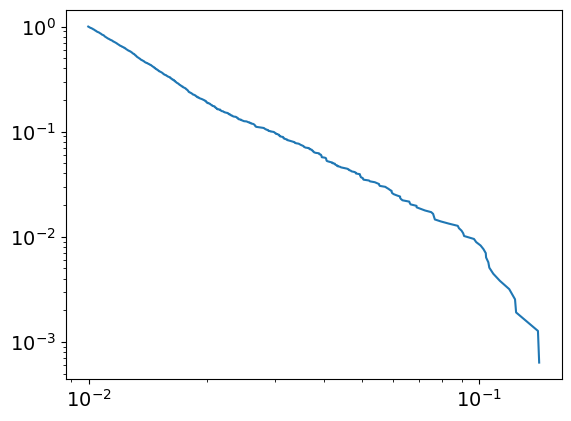

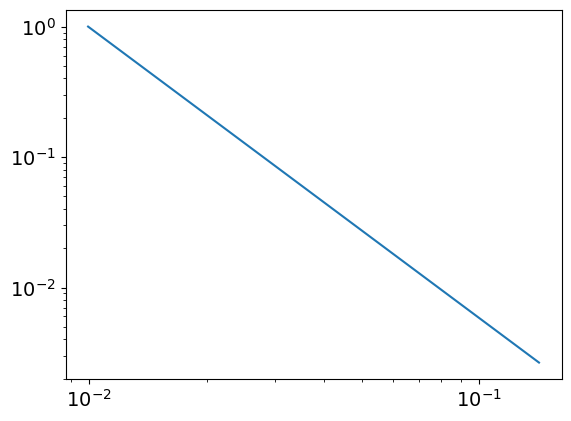

3.227933533494196
0.00993770045220467
powerlaw KstestResult(statistic=0.9993070273897843, pvalue=0.0, statistic_location=0.10854268253947047, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14230413916578244, statistic_sign=-1)
tensor(-3.1664e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3803, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.5558, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
23
tensor(0.0935, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


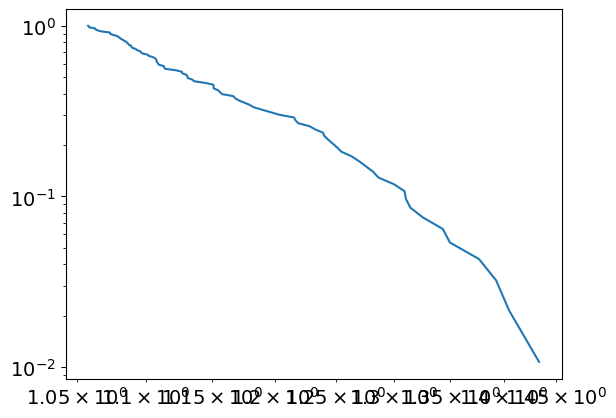

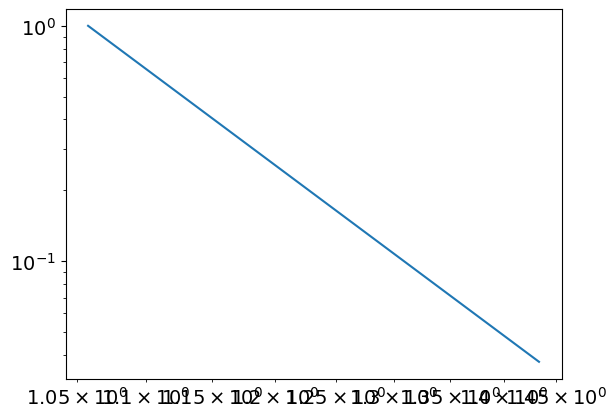

11.805859647264796
1.0576578655830473
powerlaw KstestResult(statistic=0.9999986091946387, pvalue=0.0, statistic_location=1.3767477137712583, statistic_sign=1)
lognorm KstestResult(statistic=0.997498117653127, pvalue=0.0, statistic_location=1.1827367735102075, statistic_sign=1)
tensor(0.0742, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1703, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0666, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1906, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
24
tensor(5.1337e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


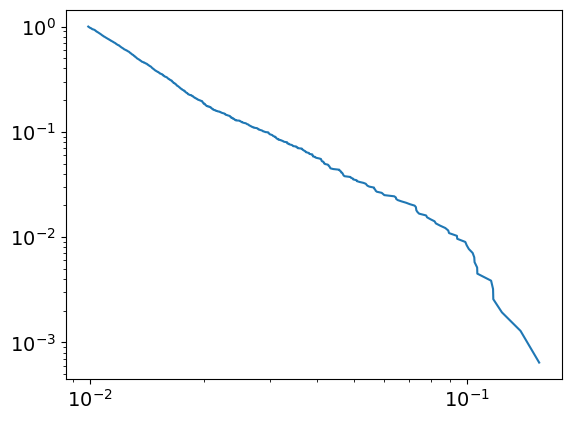

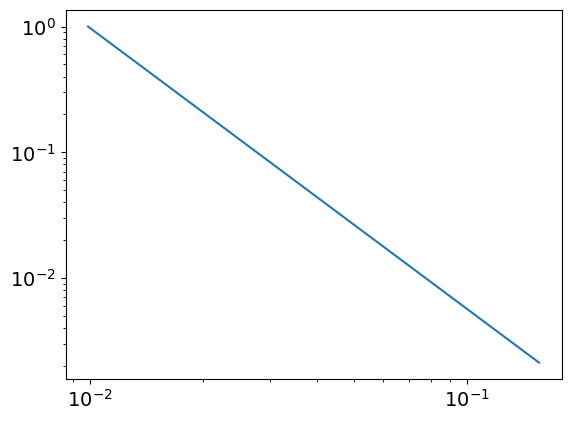

3.237622978228518
0.009897561034345123
powerlaw KstestResult(statistic=0.9992310860397602, pvalue=0.0, statistic_location=0.10629617024806425, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15501344117837734, statistic_sign=-1)
tensor(-3.1234e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.8548, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
24
tensor(0.0958, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


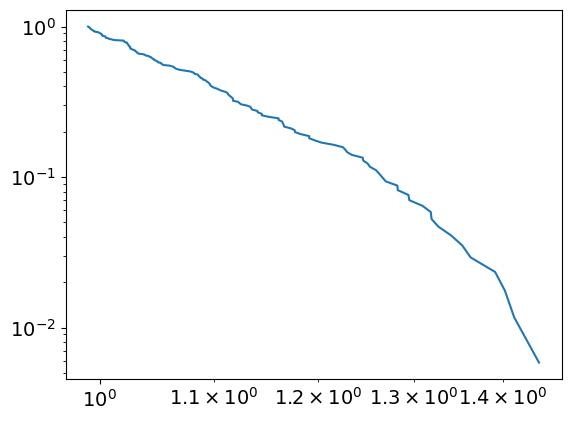

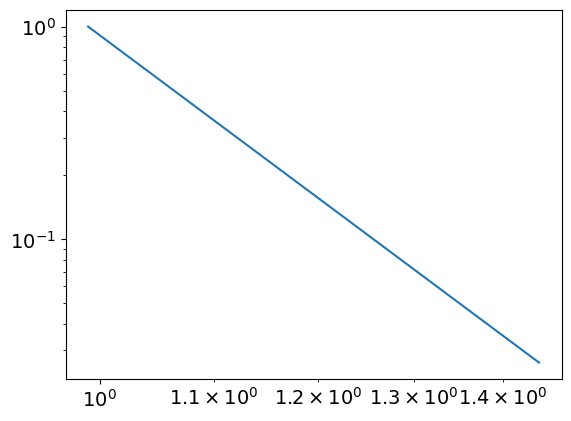

10.659789845363289
0.9902801327321923
powerlaw KstestResult(statistic=0.9999412717832329, pvalue=0.0, statistic_location=1.3912146890957133, statistic_sign=1)
lognorm KstestResult(statistic=0.997342942076983, pvalue=0.0, statistic_location=1.1911121221117966, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1722, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1986, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
25
tensor(5.0754e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


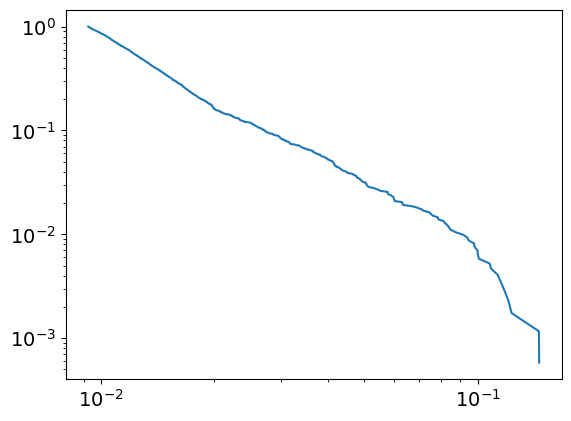

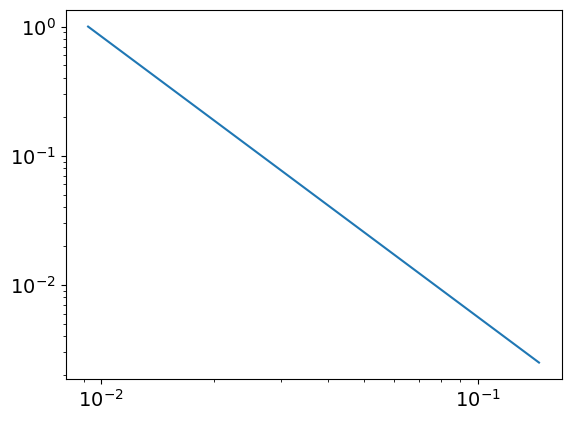

3.173978078524255
0.009255714964295399
powerlaw KstestResult(statistic=0.9991195297464602, pvalue=0.0, statistic_location=0.11300425283445883, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14540012700076574, statistic_sign=-1)
tensor(-3.5412e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4105, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.2392, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
25
tensor(0.0980, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


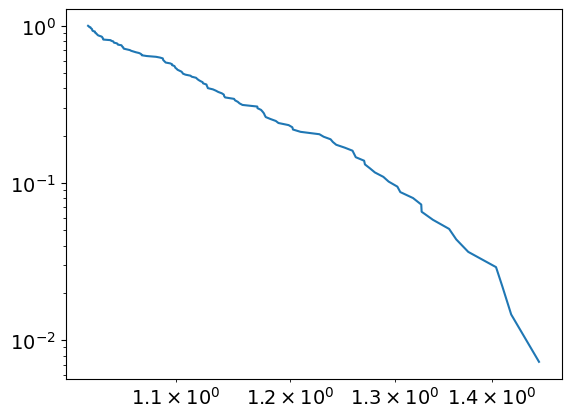

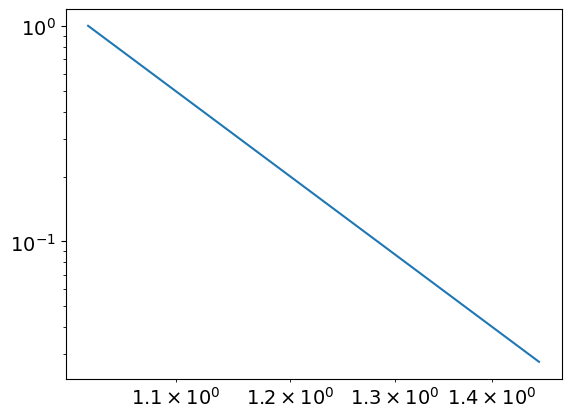

11.40637957293726
1.028275193405443
powerlaw KstestResult(statistic=0.9999855374613265, pvalue=0.0, statistic_location=1.4047166900567596, statistic_sign=1)
lognorm KstestResult(statistic=0.997189414222088, pvalue=0.0, statistic_location=1.1894152439370929, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1739, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0703, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2063, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
26
tensor(5.1172e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


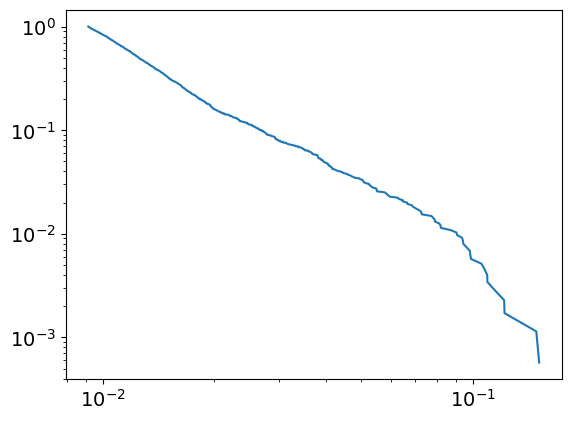

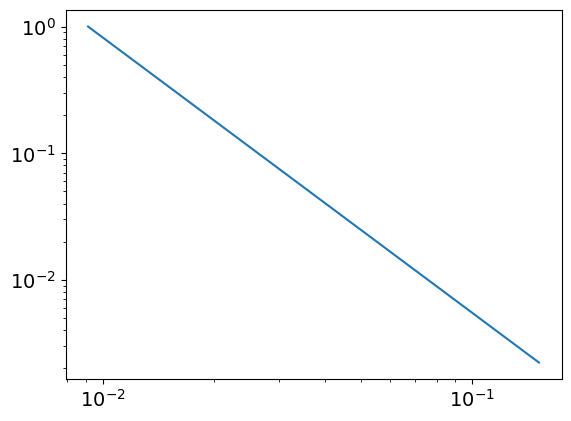

3.1740248509766698
0.00911664972889413
powerlaw KstestResult(statistic=0.9991902744311156, pvalue=0.0, statistic_location=0.10969288354180325, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14877658492502624, statistic_sign=-1)
tensor(-3.8797e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3441, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.8972, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
26
tensor(0.1001, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


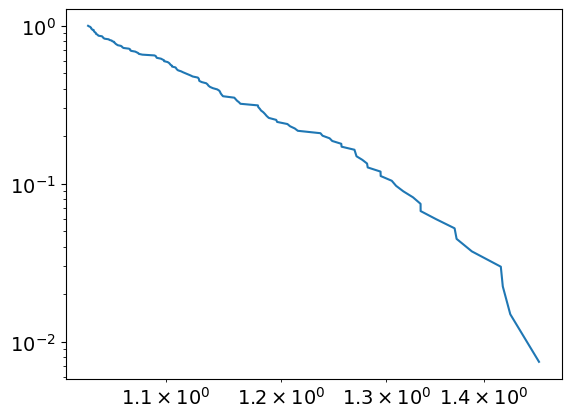

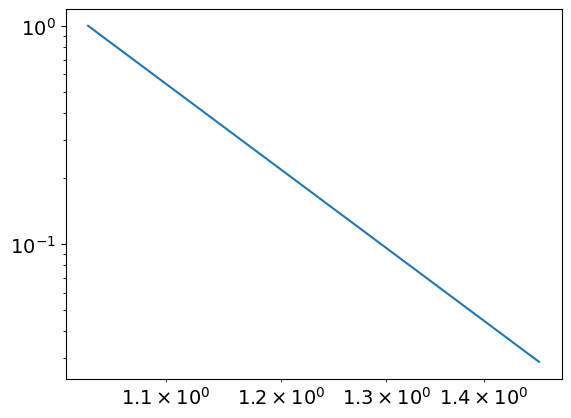

11.368151681175535
1.0368912302915192
powerlaw KstestResult(statistic=0.999982885018101, pvalue=0.0, statistic_location=1.4176971873804802, statistic_sign=1)
lognorm KstestResult(statistic=0.9970403313441282, pvalue=0.0, statistic_location=1.1966324572603846, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0722, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2138, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
27
tensor(5.0835e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


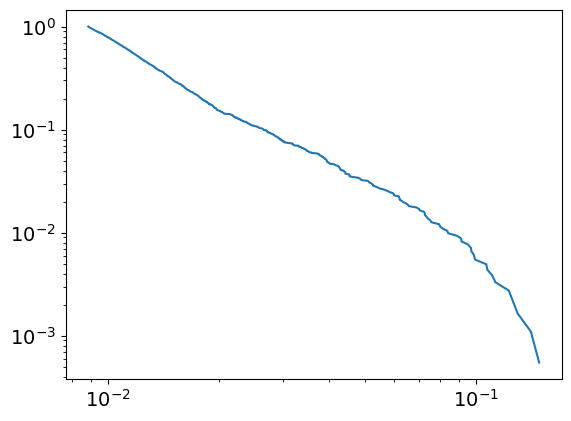

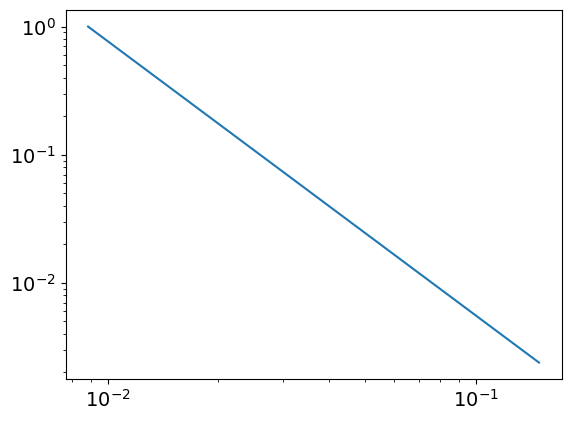

3.1405895199077114
0.00885560977098173
powerlaw KstestResult(statistic=0.9989774567240725, pvalue=0.0, statistic_location=0.1107528375968585, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14107903542859163, statistic_sign=-1)
tensor(-1.5018e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0656, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.8785, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
27
tensor(0.1021, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


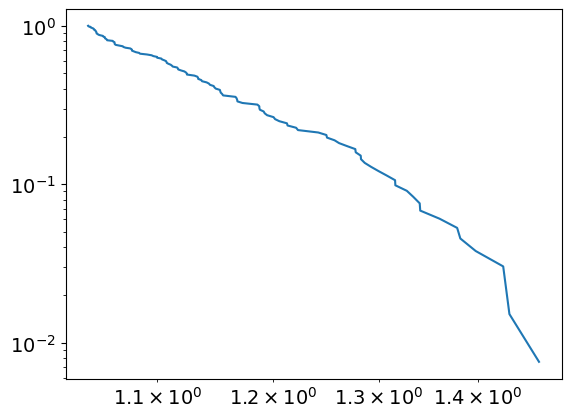

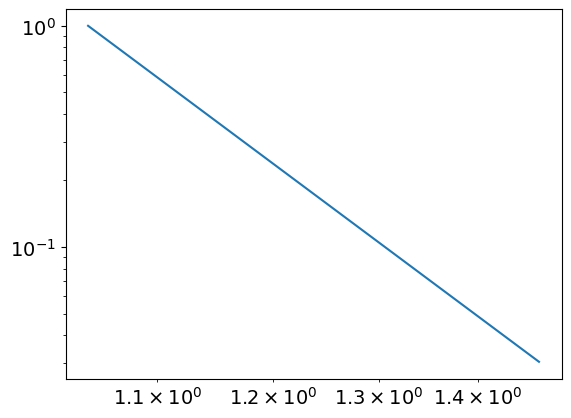

11.297375475489119
1.043996227945652
powerlaw KstestResult(statistic=0.9999787381835281, pvalue=0.0, statistic_location=1.4298451118928712, statistic_sign=1)
lognorm KstestResult(statistic=0.9967904529284536, pvalue=0.0, statistic_location=1.2018578194879241, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1771, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2210, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
28
tensor(5.0672e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


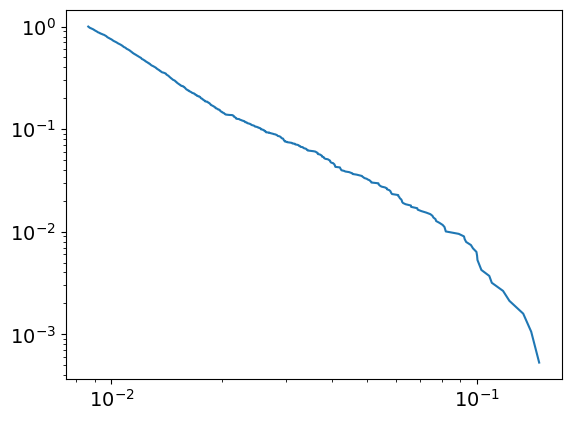

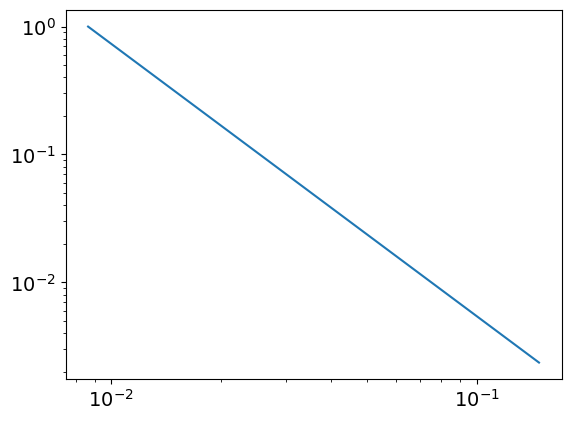

3.1299608714947817
0.008639885372988787
powerlaw KstestResult(statistic=0.9991061000450276, pvalue=0.0, statistic_location=0.10970393125320803, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14783227388879447, statistic_sign=-1)
tensor(-2.6022e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2712, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.6406, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
28
tensor(0.1040, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


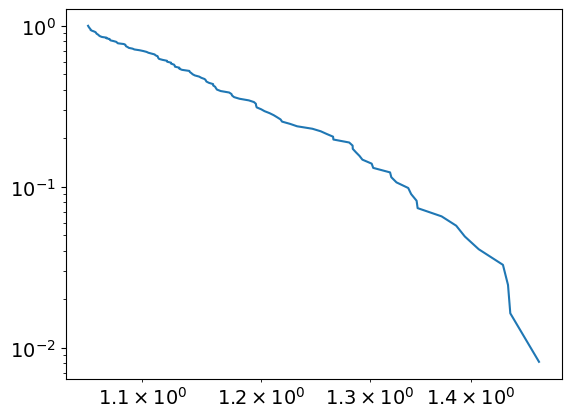

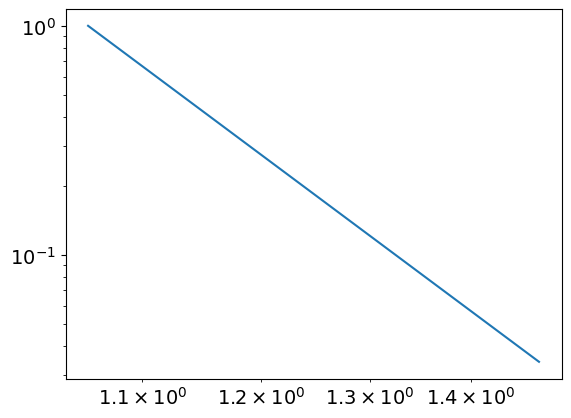

11.190219153718797
1.056905819908322
powerlaw KstestResult(statistic=0.999977361089003, pvalue=0.0, statistic_location=1.4414023713982034, statistic_sign=1)
lognorm KstestResult(statistic=0.9966418056359784, pvalue=0.0, statistic_location=1.1963223841281712, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1785, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2278, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
29
tensor(4.7100e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


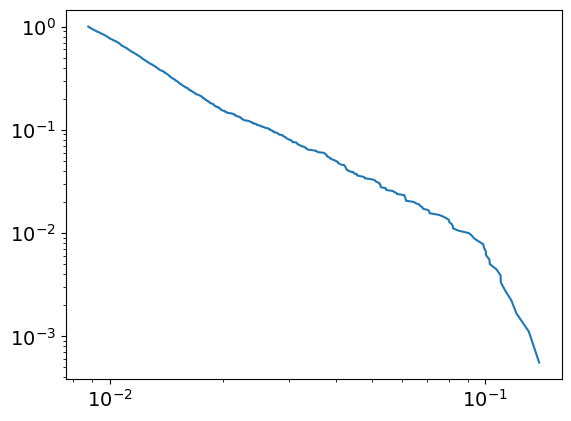

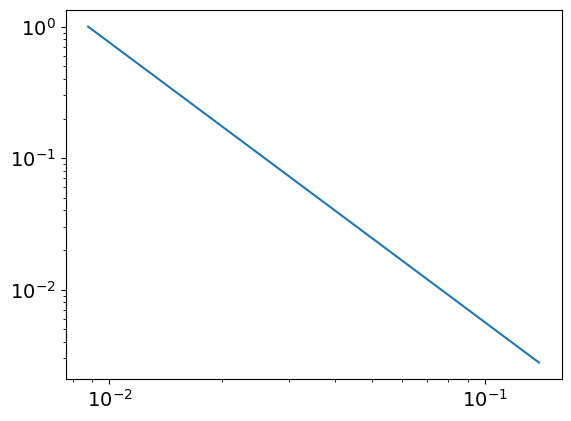

3.12644663950936
0.00877073133615357
powerlaw KstestResult(statistic=0.9991450091274151, pvalue=0.0, statistic_location=0.11316627237932257, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13946124661701198, statistic_sign=-1)
tensor(-2.5501e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3308, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.2846, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
29
tensor(0.1057, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


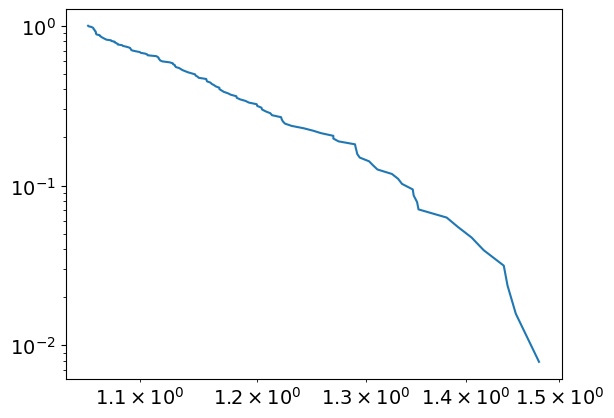

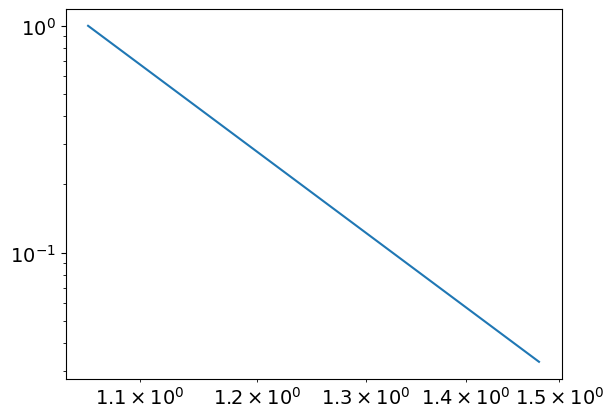

11.242183877338398
1.0589061185209747
powerlaw KstestResult(statistic=0.9999720439935845, pvalue=0.0, statistic_location=1.4524206970328488, statistic_sign=1)
lognorm KstestResult(statistic=0.9964451467939293, pvalue=0.0, statistic_location=1.2041400957603694, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1798, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0784, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2345, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
30
tensor(4.5122e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


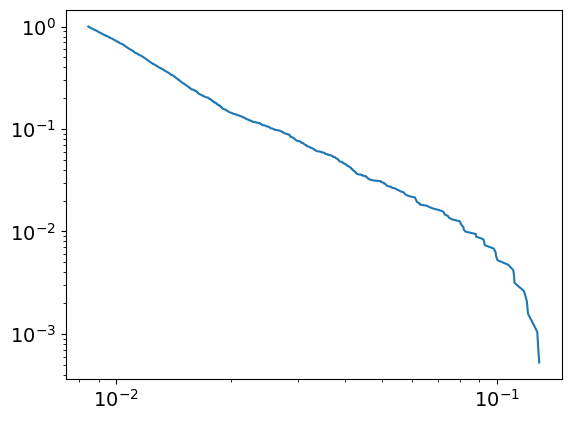

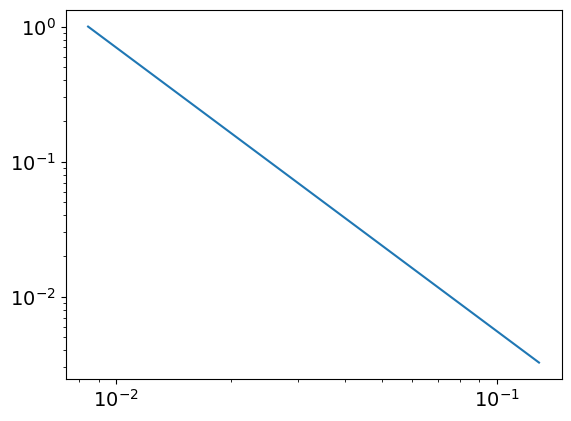

3.100668404739883
0.008449860986718656
powerlaw KstestResult(statistic=0.9991351041880925, pvalue=0.0, statistic_location=0.1112838782613278, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12920945323422534, statistic_sign=-1)
tensor(-1.9803e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2560, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.8063, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
30
tensor(0.1074, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


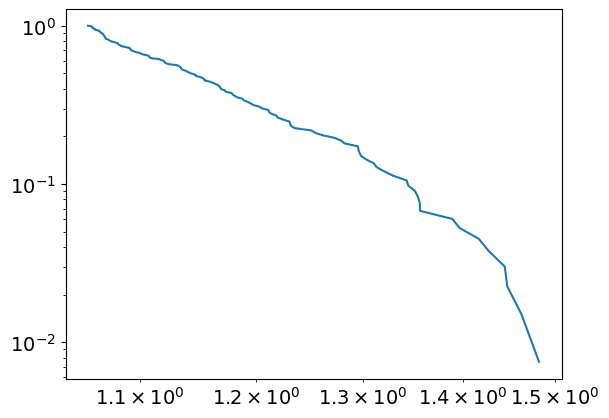

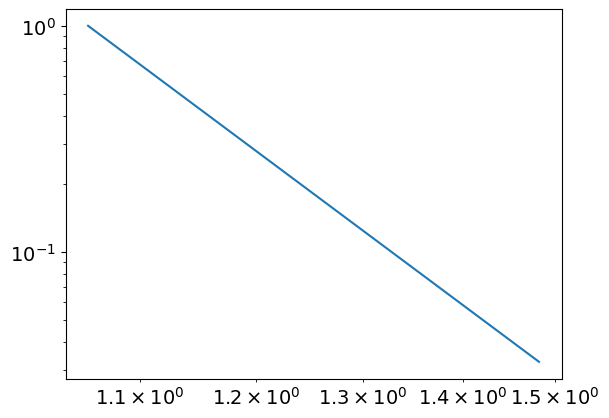

11.15663610787285
1.0585298057439496
powerlaw KstestResult(statistic=0.9999589911077441, pvalue=0.0, statistic_location=1.462891664459281, statistic_sign=1)
lognorm KstestResult(statistic=0.9961983656688834, pvalue=0.0, statistic_location=1.2053740792296184, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1810, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0805, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2408, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
31
tensor(5.3946e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


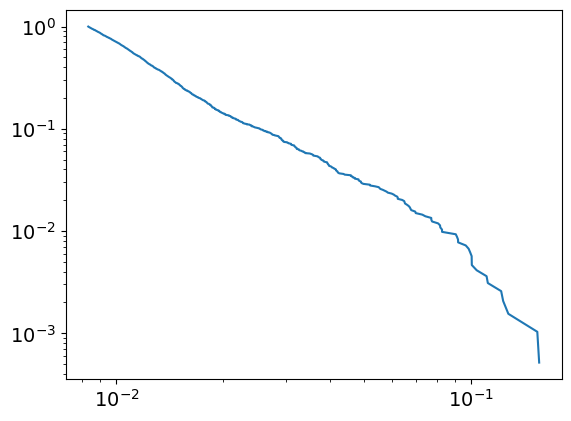

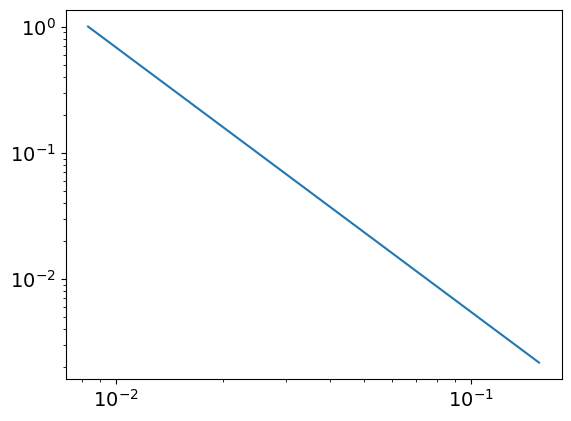

3.094369338444095
0.008325363298021594
powerlaw KstestResult(statistic=0.9989950499726389, pvalue=0.0, statistic_location=0.10035417944166852, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15556875367243045, statistic_sign=-1)
tensor(-3.6109e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3214, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.9011, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
31
tensor(0.1090, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


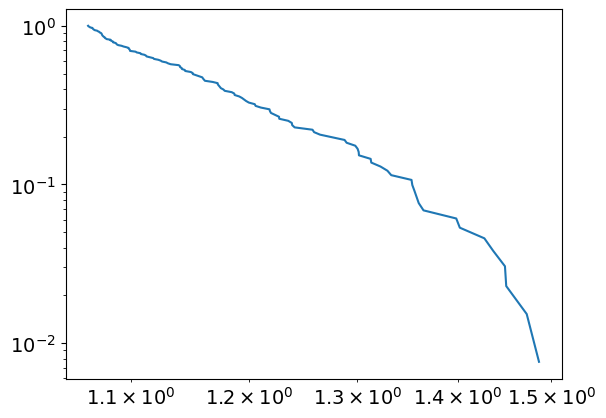

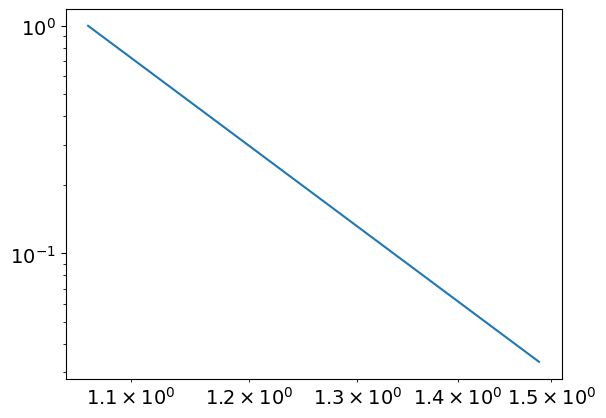

11.219901834451514
1.0657992851057478
powerlaw KstestResult(statistic=0.9999581948881432, pvalue=0.0, statistic_location=1.4729280851694075, statistic_sign=1)
lognorm KstestResult(statistic=0.9961005578531847, pvalue=0.0, statistic_location=1.2059142533776495, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1821, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0827, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2468, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
32
tensor(5.5795e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


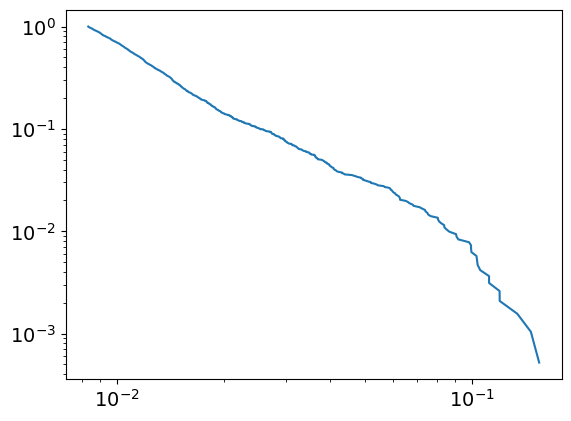

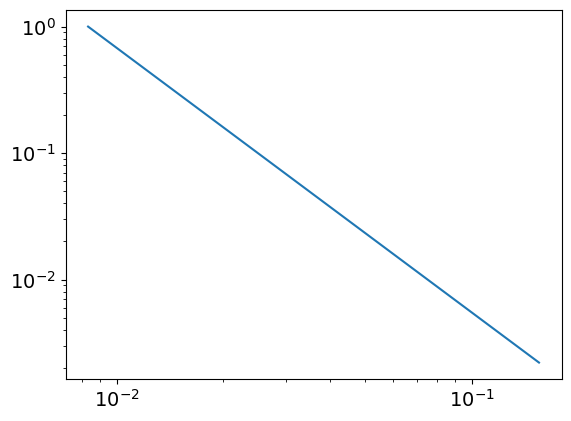

3.0914300986900867
0.008314614763868333
powerlaw KstestResult(statistic=0.9989688970354171, pvalue=0.0, statistic_location=0.11190686878516035, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1548738344453058, statistic_sign=-1)
tensor(-1.0053e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1957, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.1724, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
32
tensor(0.1105, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


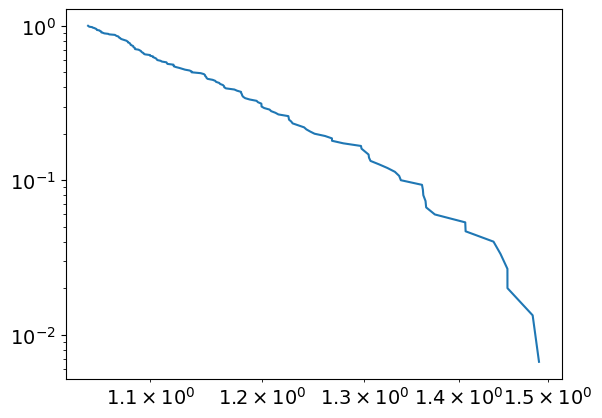

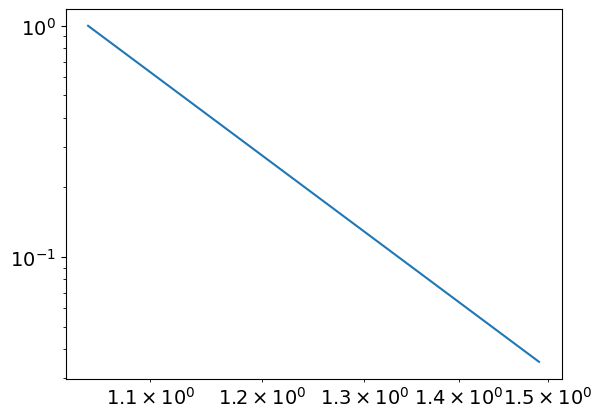

10.500350541370263
1.0477203194091065
powerlaw KstestResult(statistic=0.9998405562462123, pvalue=0.0, statistic_location=1.4825865118637995, statistic_sign=1)
lognorm KstestResult(statistic=0.9959150589275413, pvalue=0.0, statistic_location=1.2087796638823356, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1832, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0849, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2526, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
33
tensor(4.9821e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


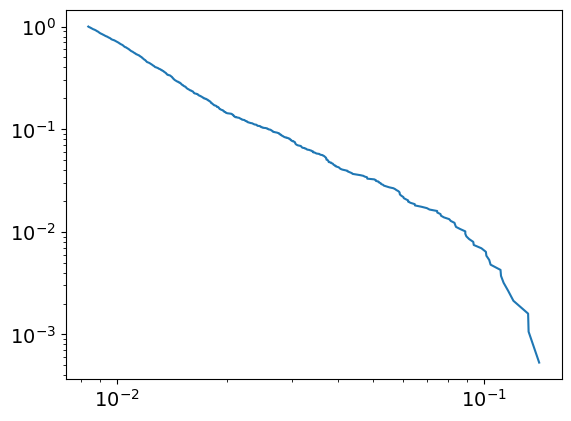

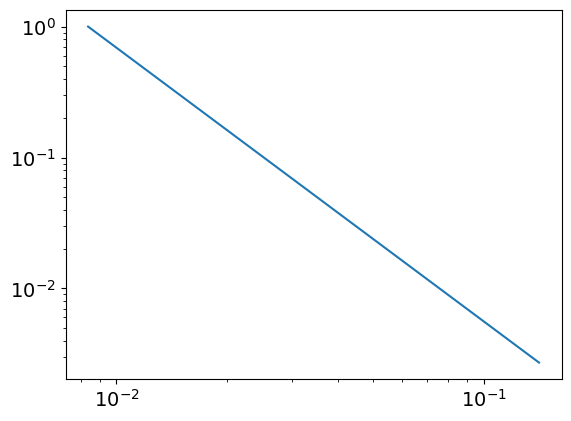

3.0909603182584378
0.008369498328728875
powerlaw KstestResult(statistic=0.9989394371239025, pvalue=0.0, statistic_location=0.11300658112369184, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1321926836347553, statistic_sign=-1)
tensor(-2.4234e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1139, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.8445, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
33
tensor(0.1120, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


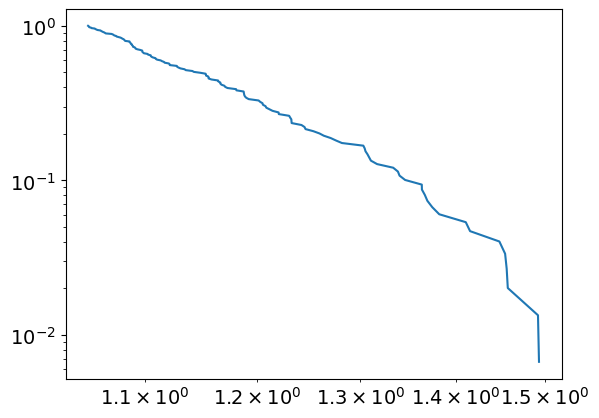

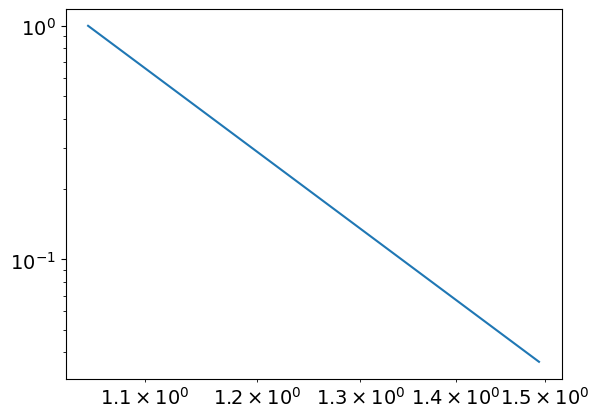

10.46943752808454
1.0524571534392237
powerlaw KstestResult(statistic=0.9998177572399337, pvalue=0.0, statistic_location=1.4918286122741795, statistic_sign=1)
lognorm KstestResult(statistic=0.9957309626915951, pvalue=0.0, statistic_location=1.2114069780457473, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1842, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0871, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2582, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
34
tensor(5.5210e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


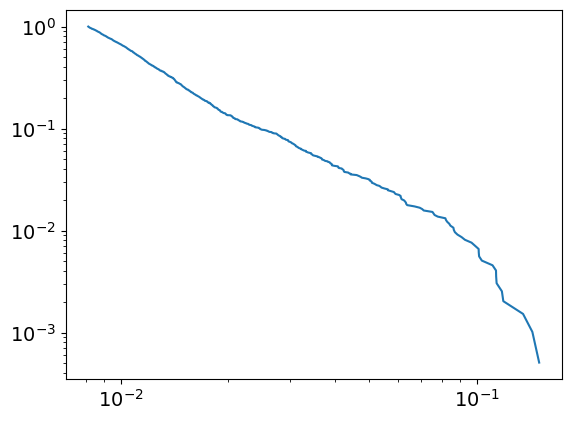

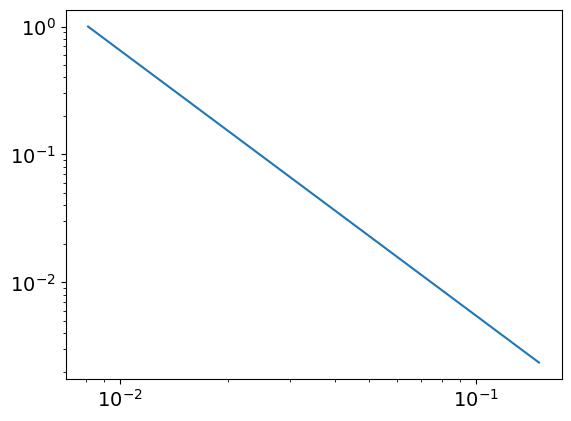

3.074823123653396
0.008117274635167432
powerlaw KstestResult(statistic=0.998804067479407, pvalue=0.0, statistic_location=0.10166801044440016, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14991343871693327, statistic_sign=1)
tensor(7.1398e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0055, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.4857, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
34
tensor(0.1134, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


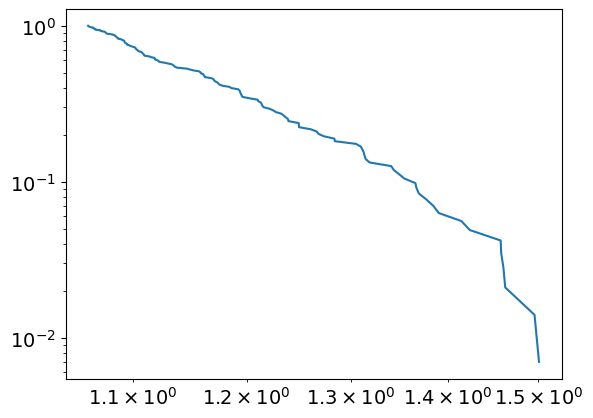

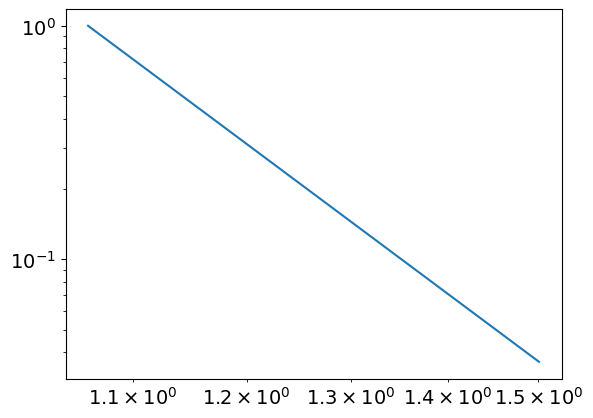

10.606806708841019
1.062937916472035
powerlaw KstestResult(statistic=0.9998433692034814, pvalue=0.0, statistic_location=1.5007185155418463, statistic_sign=1)
lognorm KstestResult(statistic=0.9955971623845861, pvalue=0.0, statistic_location=1.2155156696549478, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1852, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0894, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2636, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
35
tensor(5.5094e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


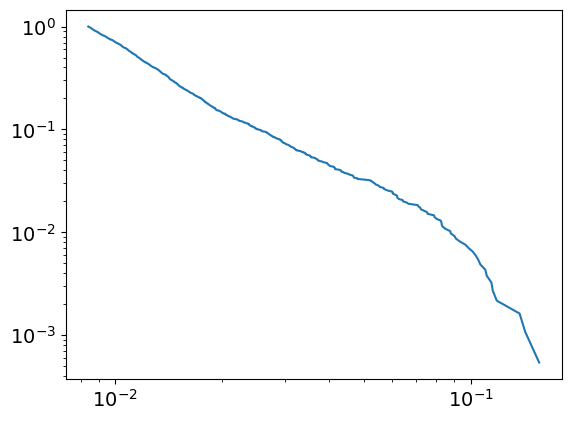

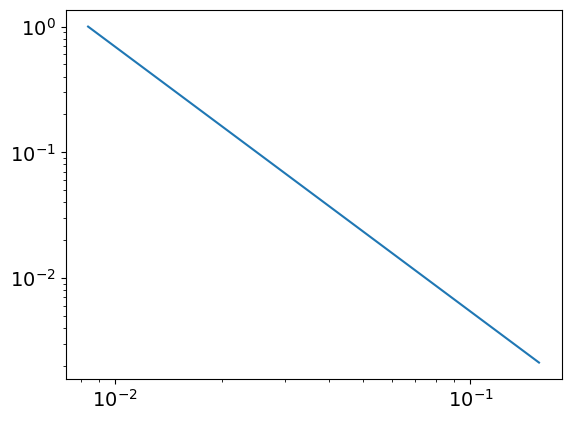

3.1073444588221224
0.008399658830974306
powerlaw KstestResult(statistic=0.9989940243522719, pvalue=0.0, statistic_location=0.10139908395769862, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14235494660150771, statistic_sign=-1)
tensor(-1.8724e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1481, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.0794, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
35
tensor(0.1147, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


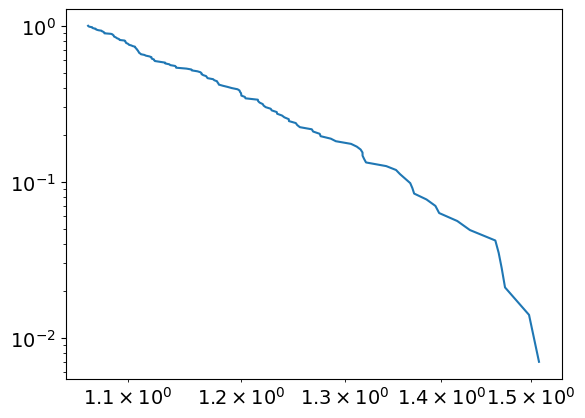

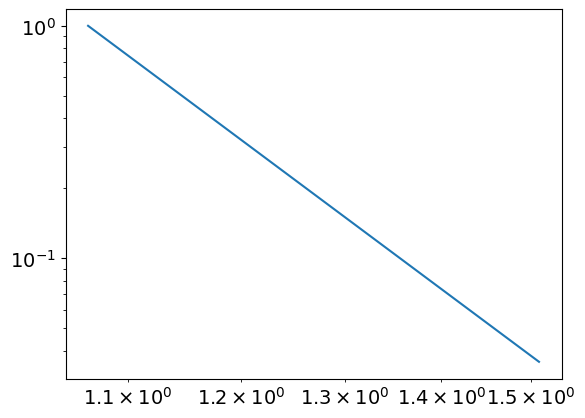

10.599829112238902
1.066831666017414
powerlaw KstestResult(statistic=0.9998241116067973, pvalue=0.0, statistic_location=1.5091871155860586, statistic_sign=1)
lognorm KstestResult(statistic=0.9952694839392722, pvalue=0.0, statistic_location=1.204170441791373, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1861, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0916, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2688, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
36
tensor(5.2124e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


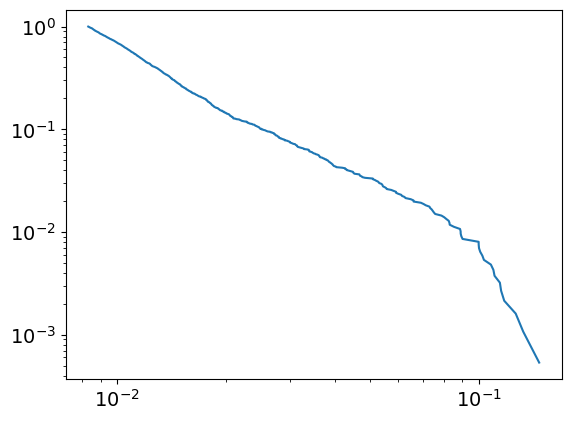

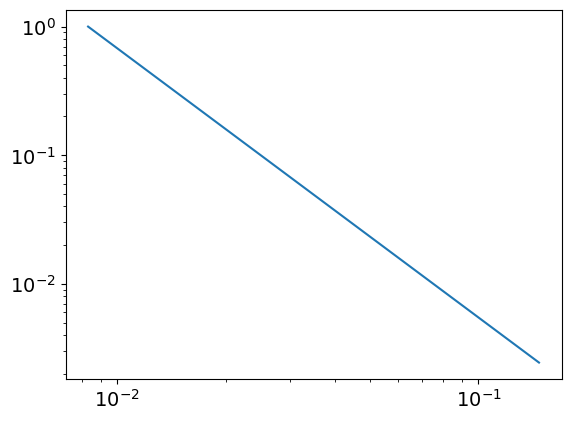

3.09312885577191
0.008310890664589924
powerlaw KstestResult(statistic=0.9988773134626692, pvalue=0.0, statistic_location=0.11067899744453846, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1470815805292067, statistic_sign=1)
tensor(1.6436e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0872, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.1075, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
36
tensor(0.1160, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


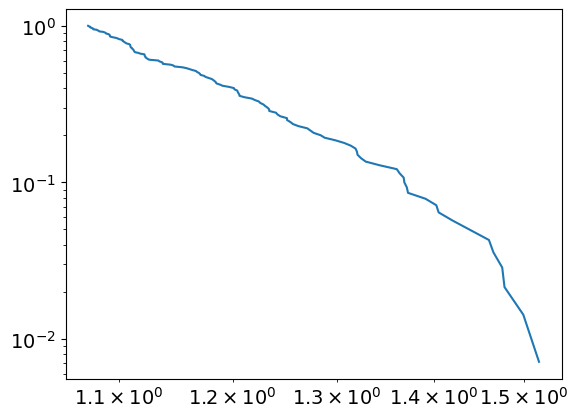

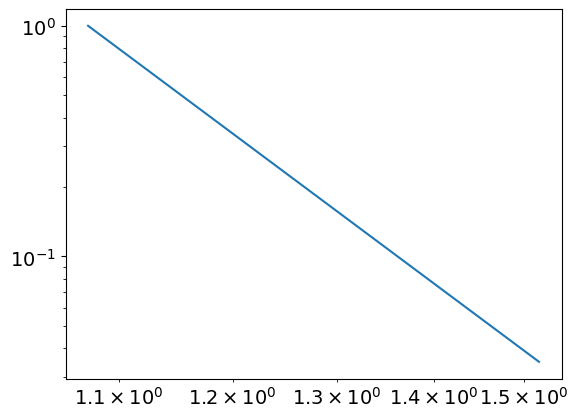

10.711703344972188
1.0742793824338321
powerlaw KstestResult(statistic=0.9998365881466017, pvalue=0.0, statistic_location=1.517365280366165, statistic_sign=1)
lognorm KstestResult(statistic=0.9951108599458434, pvalue=0.0, statistic_location=1.2063660956028985, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1869, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0939, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2739, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
37
tensor(5.9541e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


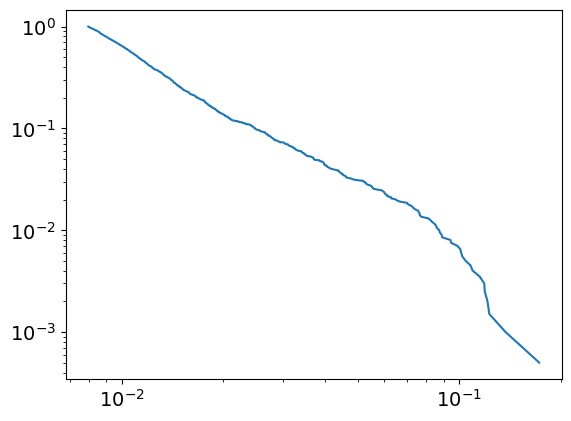

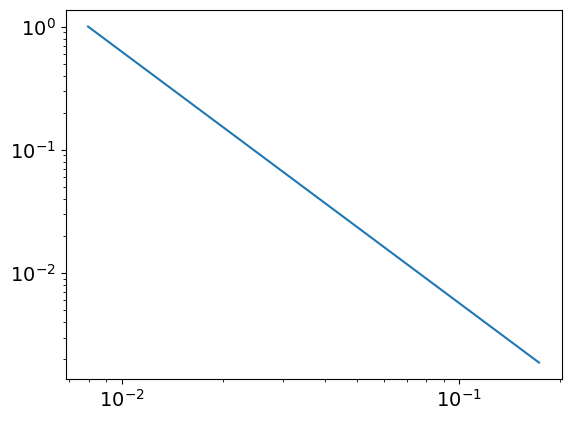

3.0390638704187953
0.00794822388914901
powerlaw KstestResult(statistic=0.9986548915621544, pvalue=0.0, statistic_location=0.10966329912663116, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1727120391717705, statistic_sign=1)
tensor(7.7780e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2921, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.5056, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
37
tensor(0.1171, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


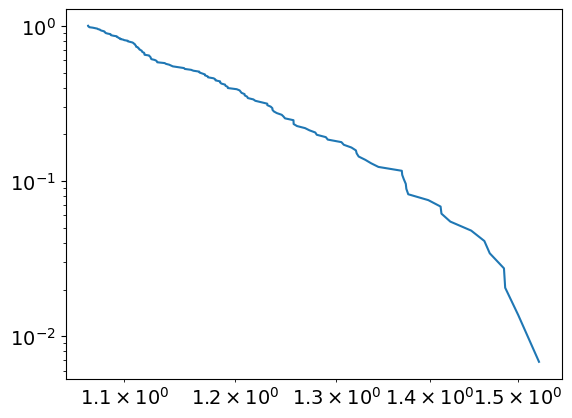

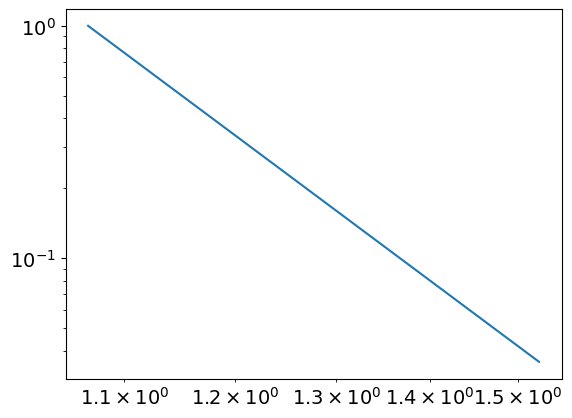

10.361808561259535
1.0688971518521915
powerlaw KstestResult(statistic=0.9997589267319279, pvalue=0.0, statistic_location=1.4850786539405836, statistic_sign=1)
lognorm KstestResult(statistic=0.9949581125860957, pvalue=0.0, statistic_location=1.2123308096086114, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0961, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2787, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
38
tensor(5.2348e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


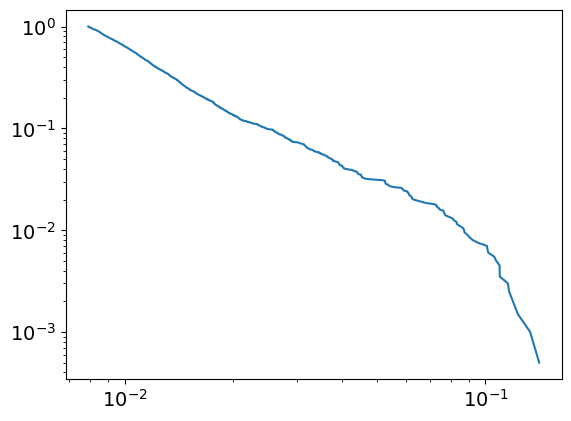

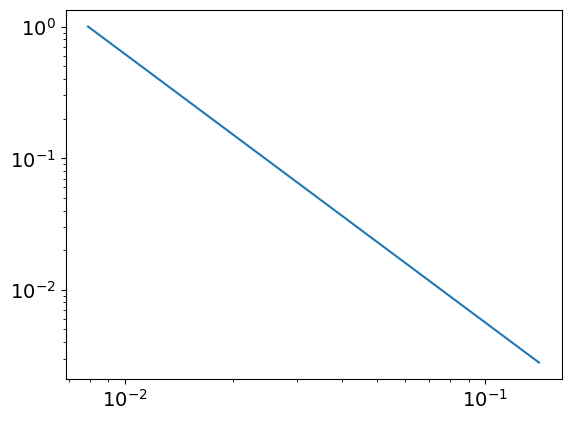

3.04181879578412
0.007911122507706581
powerlaw KstestResult(statistic=0.9987931847894236, pvalue=0.0, statistic_location=0.10946156414201547, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.13297860686091395, statistic_sign=1)
tensor(8.1656e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0063, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.7831, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
38
tensor(0.1183, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


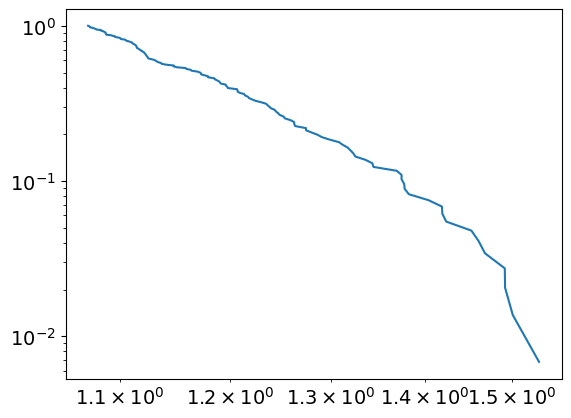

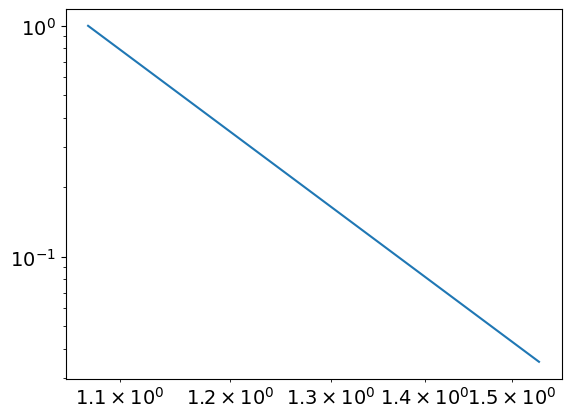

10.37221186960948
1.0724706243721804
powerlaw KstestResult(statistic=0.9997494363854349, pvalue=0.0, statistic_location=1.4922550906687269, statistic_sign=1)
lognorm KstestResult(statistic=0.9947564629079815, pvalue=0.0, statistic_location=1.2182380217174884, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1885, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0984, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2835, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
39
tensor(6.1488e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


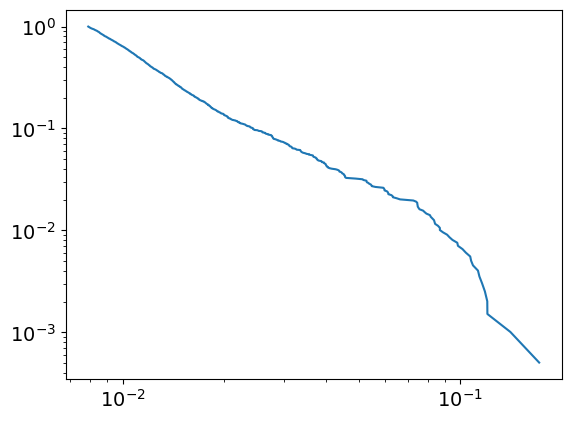

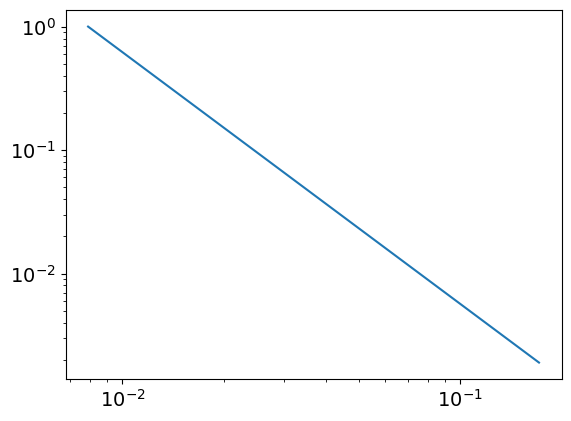

3.038621466758961
0.007912430186788574
powerlaw KstestResult(statistic=0.9986421273334505, pvalue=0.0, statistic_location=0.11815137060076564, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17105979483574588, statistic_sign=1)
tensor(9.3969e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3766, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.1222, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
39
tensor(0.1194, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


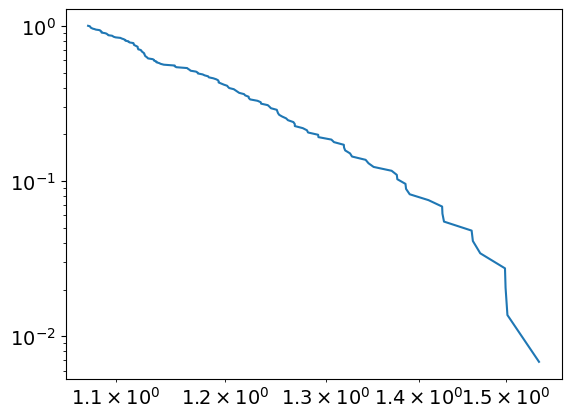

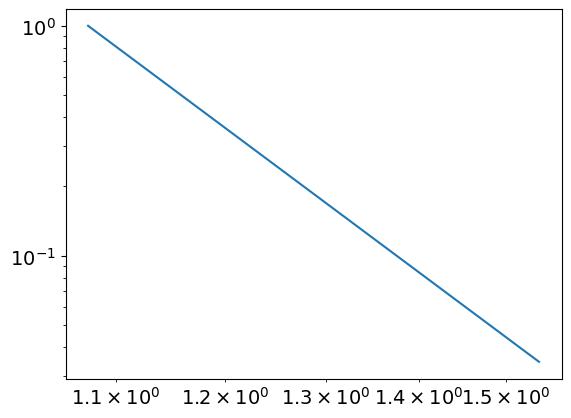

10.382910094133681
1.0758404746998844
powerlaw KstestResult(statistic=0.9997374467139627, pvalue=0.0, statistic_location=1.499781039847115, statistic_sign=1)
lognorm KstestResult(statistic=0.9946316116329694, pvalue=0.0, statistic_location=1.223913609625834, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1892, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1006, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2881, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
40
tensor(6.7930e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


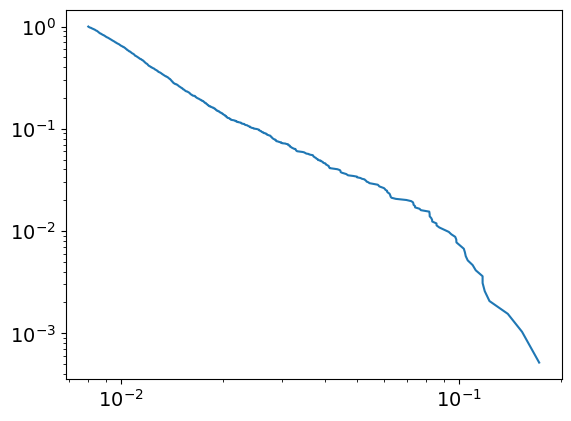

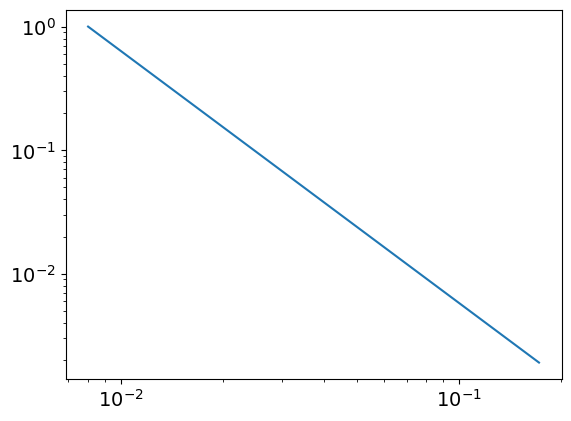

3.038161115932532
0.00799949770660627
powerlaw KstestResult(statistic=0.9985518082142855, pvalue=0.0, statistic_location=0.10405357570301317, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17255523330672332, statistic_sign=1)
tensor(2.4763e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6379, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.7941, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
40
tensor(0.1205, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


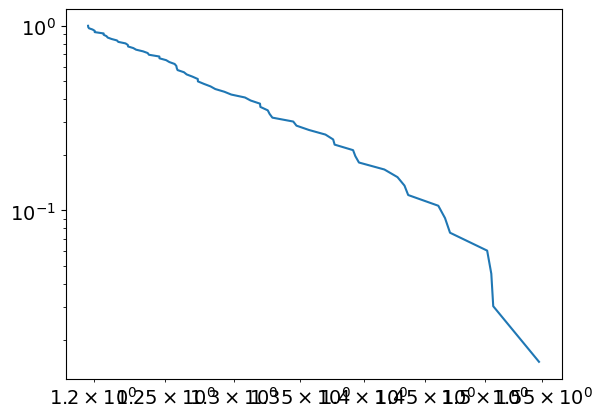

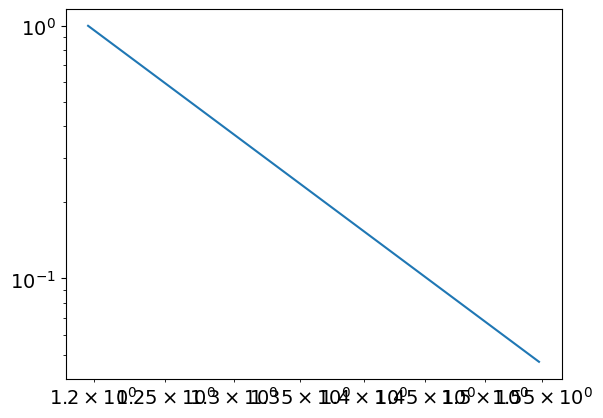

12.897775108153654
1.1962183964070945
powerlaw KstestResult(statistic=0.999998630007877, pvalue=0.0, statistic_location=1.5472963964504396, statistic_sign=1)
lognorm KstestResult(statistic=0.9944229780966299, pvalue=0.0, statistic_location=1.2238708897151123, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1898, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1028, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2926, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
41
tensor(6.3069e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


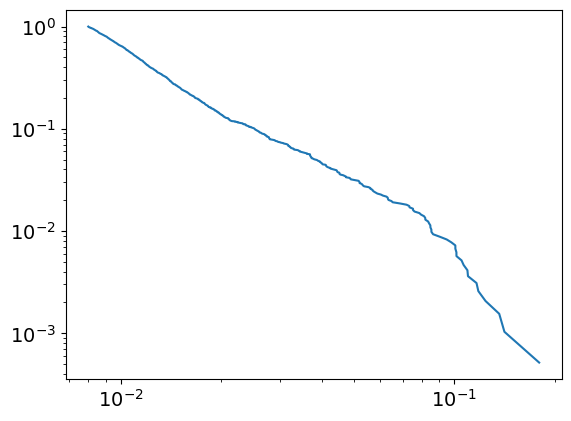

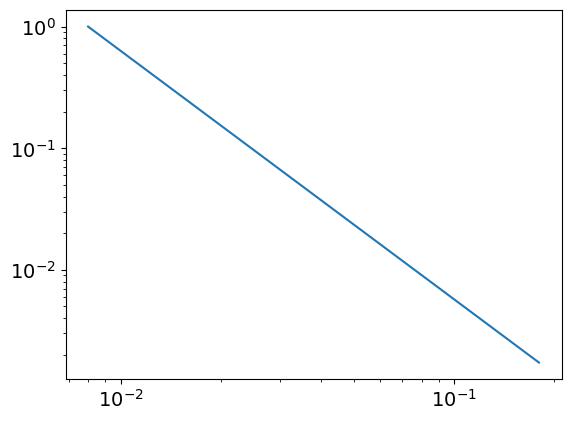

3.0432375170871926
0.007987151897111218
powerlaw KstestResult(statistic=0.9986695608568865, pvalue=0.0, statistic_location=0.10950790015819555, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17971421097598908, statistic_sign=1)
tensor(7.6849e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4408, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.2850, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
41
tensor(0.1215, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


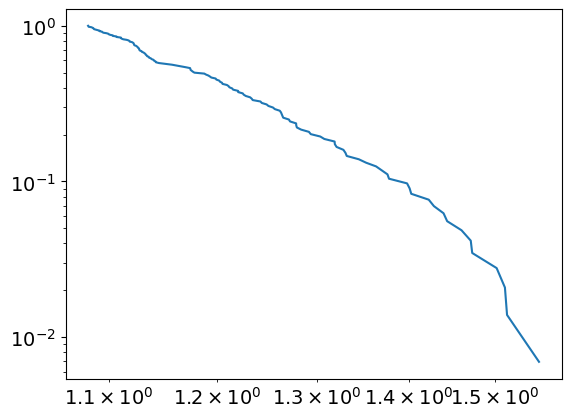

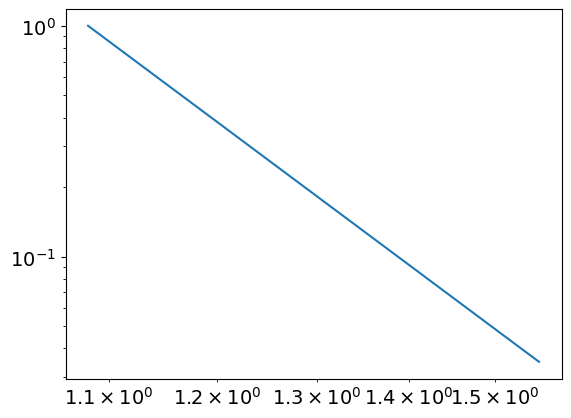

10.257195329148454
1.0818870963563625
powerlaw KstestResult(statistic=0.9996861913470055, pvalue=0.0, statistic_location=1.514763544088578, statistic_sign=1)
lognorm KstestResult(statistic=0.9942468064092127, pvalue=0.0, statistic_location=1.220526746143778, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1905, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1049, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2970, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
42
tensor(5.7727e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


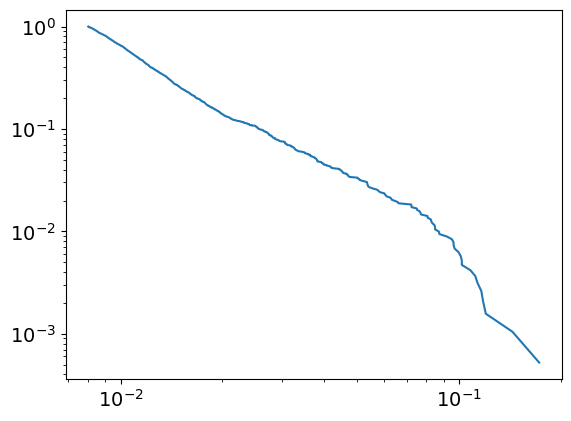

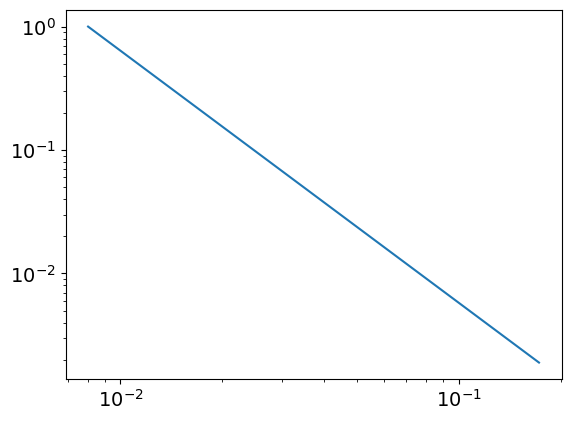

3.0428189883219114
0.008021729528374232
powerlaw KstestResult(statistic=0.9987410299652425, pvalue=0.0, statistic_location=0.10194580177988868, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17258245085116744, statistic_sign=1)
tensor(3.7737e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2961, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.7489, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
42
tensor(0.1224, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


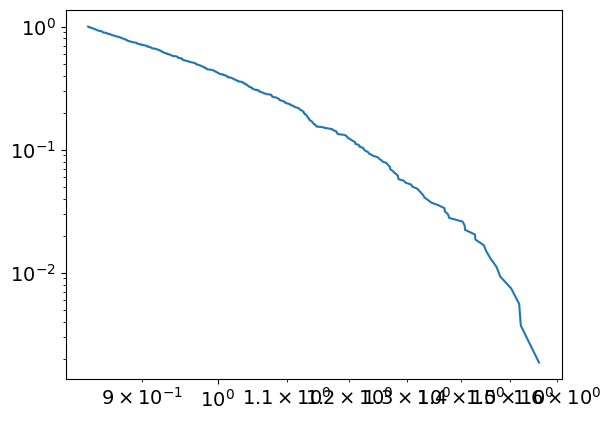

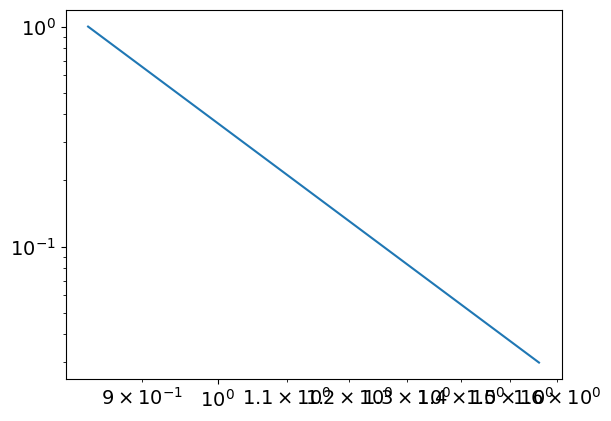

6.628654995501307
0.8355671344423231
powerlaw KstestResult(statistic=0.993228341616893, pvalue=0.0, statistic_location=1.2322776766475458, statistic_sign=1)
lognorm KstestResult(statistic=0.9941222474478635, pvalue=0.0, statistic_location=1.2260722511686883, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1911, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1070, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3013, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
43
tensor(6.4944e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


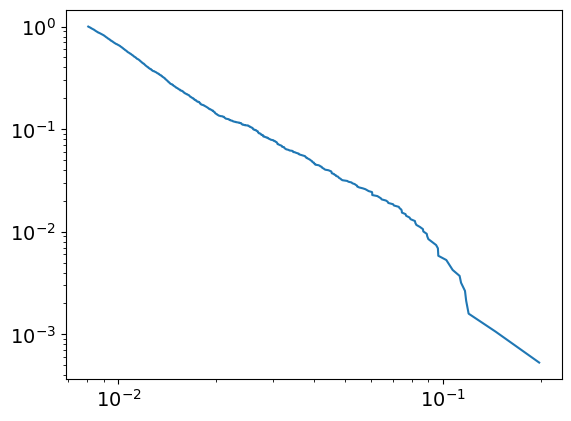

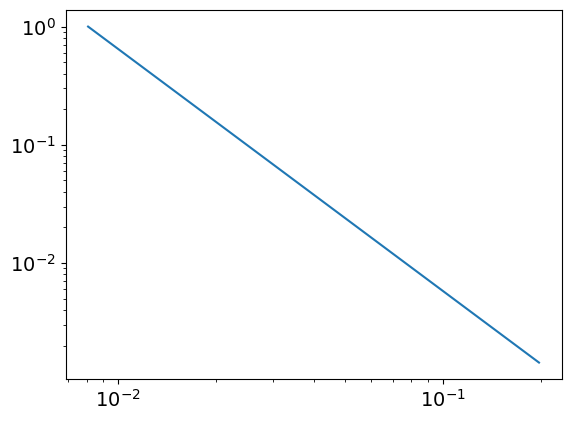

3.0472873496583825
0.008075510468262981
powerlaw KstestResult(statistic=0.9988761856060854, pvalue=0.0, statistic_location=0.1070354346761478, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1452244654877259, statistic_sign=-1)
tensor(-4.0938e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4245, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.4251, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
43
tensor(0.1234, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


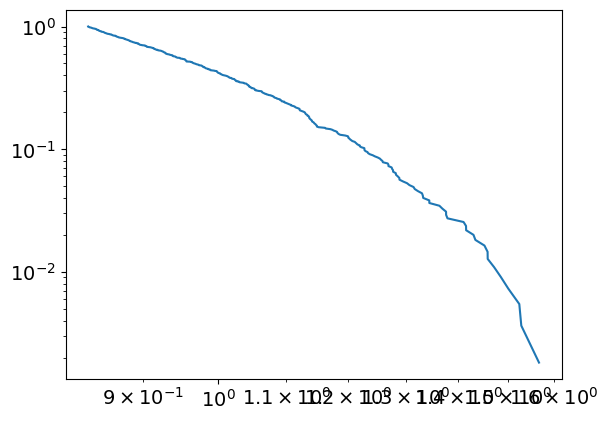

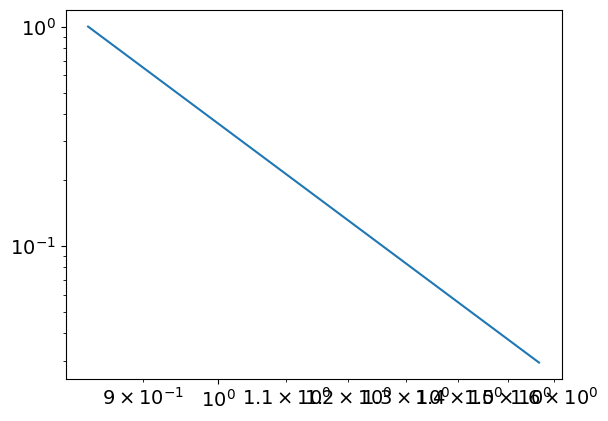

6.57710177387988
0.8331371093395349
powerlaw KstestResult(statistic=0.9929011326312455, pvalue=0.0, statistic_location=1.2289367368407293, statistic_sign=1)
lognorm KstestResult(statistic=0.9939847187953126, pvalue=0.0, statistic_location=1.2289367368407293, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1917, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1091, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3056, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
44
tensor(6.4853e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


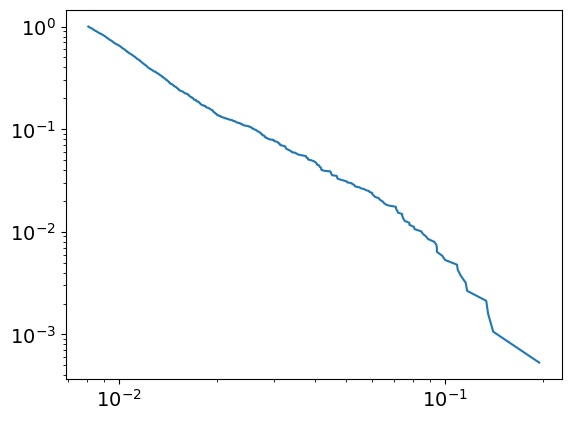

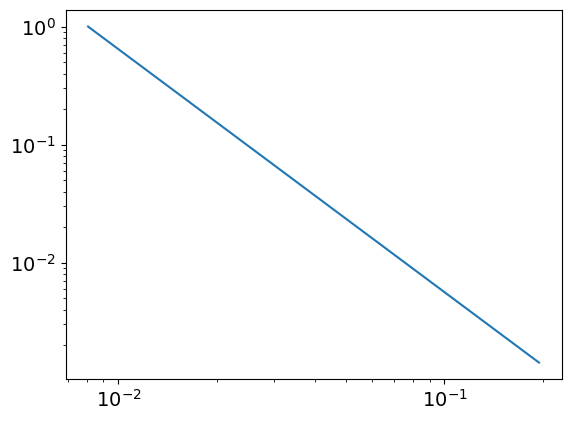

3.058761350752117
0.008073941270862731
powerlaw KstestResult(statistic=0.998807722277317, pvalue=0.0, statistic_location=0.10030672873779214, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14088114712475272, statistic_sign=-1)
tensor(-6.9362e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4542, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.6246, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
44
tensor(0.1242, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


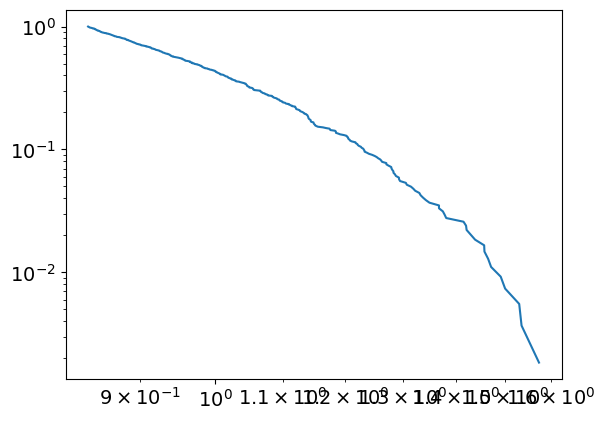

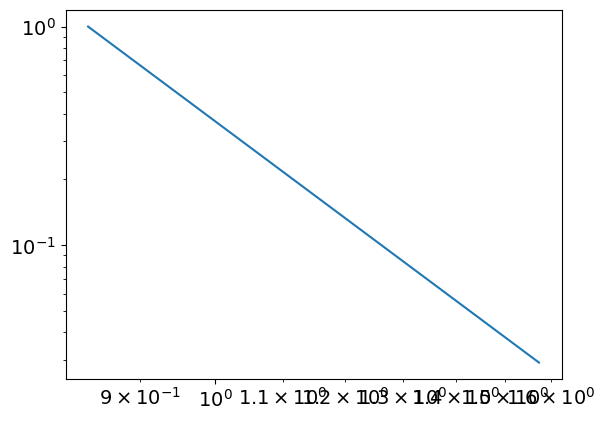

6.607162531053027
0.8373628628859777
powerlaw KstestResult(statistic=0.9929760344810924, pvalue=0.0, statistic_location=1.2328053081493506, statistic_sign=1)
lognorm KstestResult(statistic=0.9937526534881378, pvalue=0.0, statistic_location=1.2328053081493506, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1922, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1113, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3098, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
45
tensor(7.2587e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


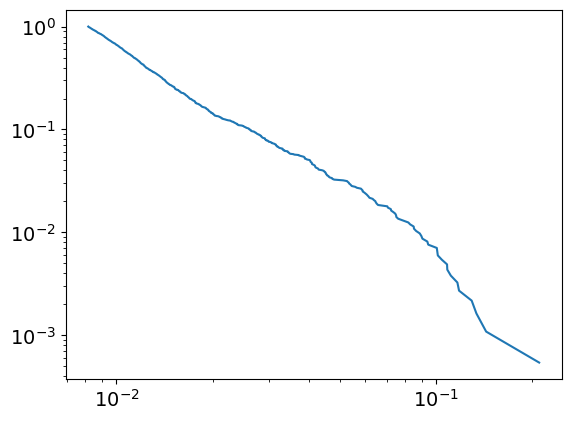

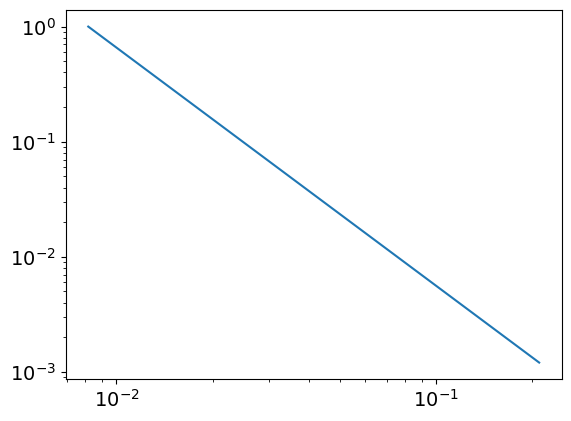

3.070014712389307
0.008166478348466866
powerlaw KstestResult(statistic=0.9987672610984365, pvalue=0.0, statistic_location=0.10812729686813603, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14328425218410298, statistic_sign=-1)
tensor(-1.9899e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(46.6165, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
45
tensor(0.1251, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


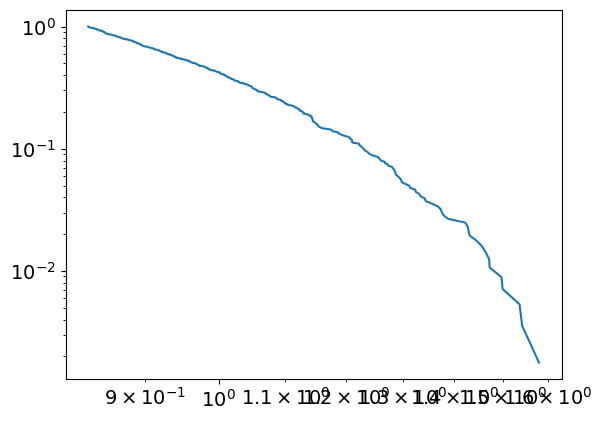

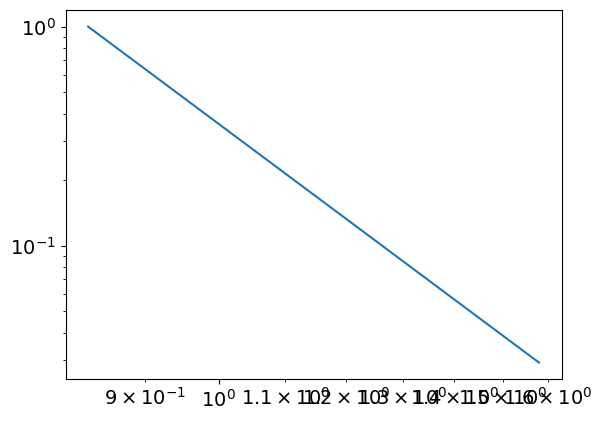

6.49203638520983
0.8300360580654745
powerlaw KstestResult(statistic=0.9922055036282122, pvalue=0.0, statistic_location=1.2402806881745085, statistic_sign=1)
lognorm KstestResult(statistic=0.9936196491125215, pvalue=0.0, statistic_location=1.2114024644599561, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1133, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3138, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
46
tensor(7.5395e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


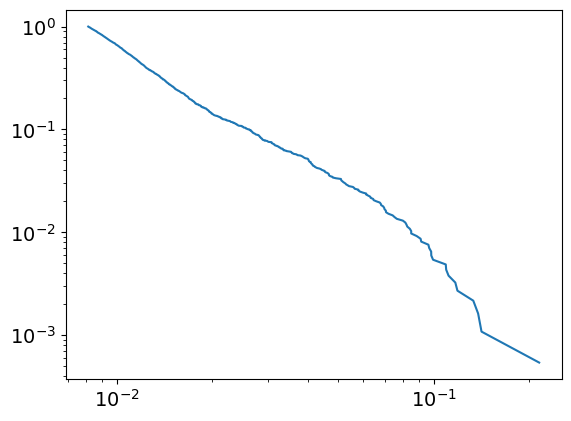

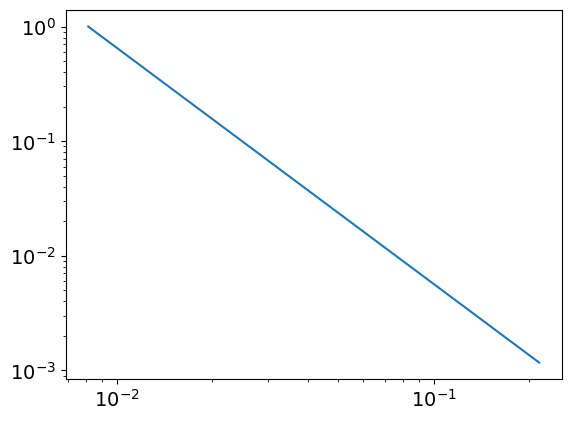

3.060914346895108
0.00812775317469042
powerlaw KstestResult(statistic=0.9988292892053986, pvalue=0.0, statistic_location=0.09955057838343596, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14157496182493365, statistic_sign=-1)
tensor(-2.3210e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6061, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.2447, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
46
tensor(0.1259, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


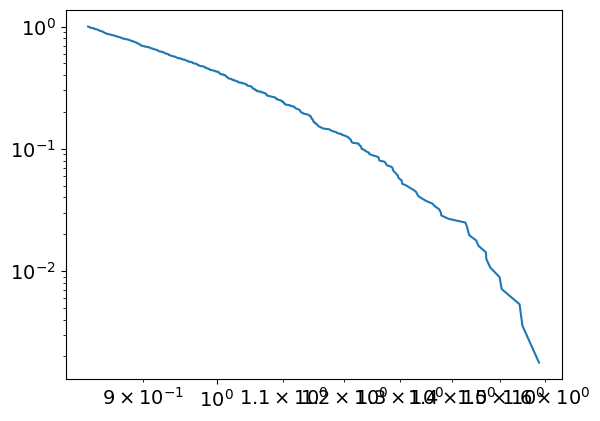

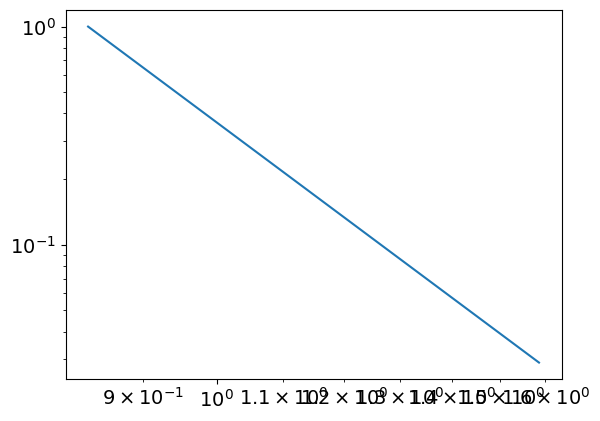

6.500390383751217
0.8319418848684745
powerlaw KstestResult(statistic=0.9921644201849249, pvalue=0.0, statistic_location=1.2434959376751968, statistic_sign=1)
lognorm KstestResult(statistic=0.9935605474331536, pvalue=0.0, statistic_location=1.214244548743968, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1153, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3178, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
47
tensor(6.3438e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


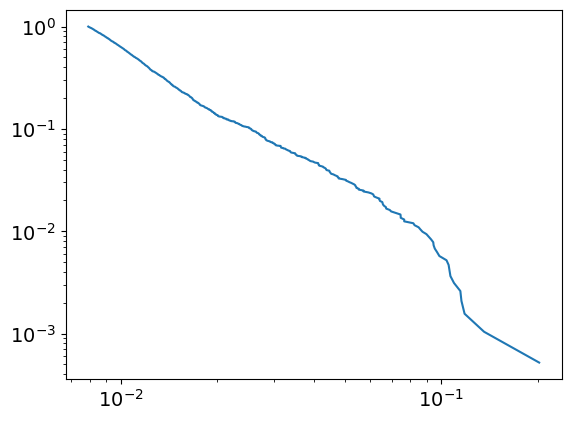

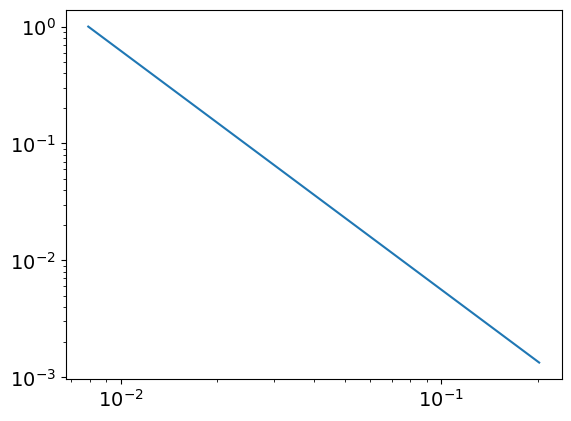

3.0431395438855118
0.0079160478373265
powerlaw KstestResult(statistic=0.9987939992746095, pvalue=0.0, statistic_location=0.1095387497829932, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13599666635644572, statistic_sign=-1)
tensor(-8.3684e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6328, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.3599, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
47
tensor(0.1267, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


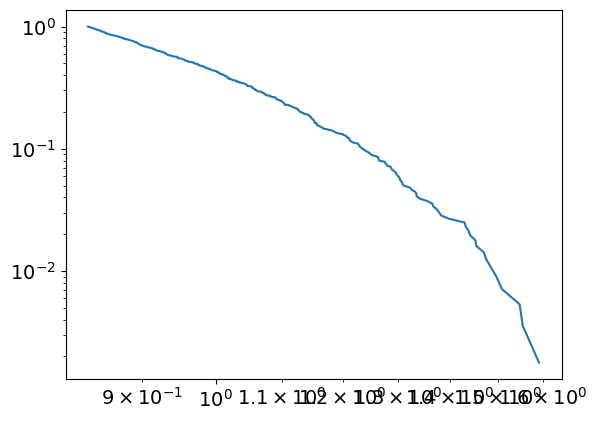

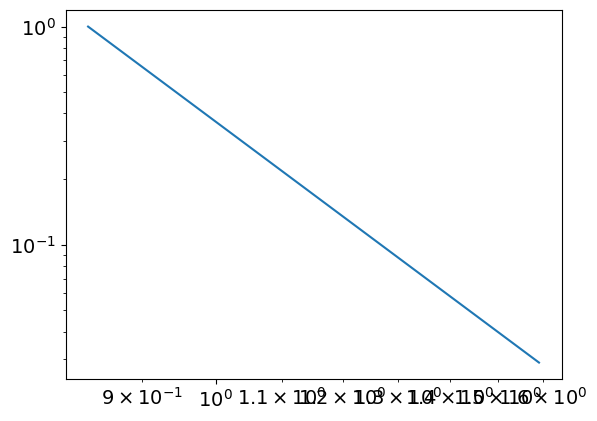

6.478361579613662
0.8327788776913141
powerlaw KstestResult(statistic=0.9919315067578547, pvalue=0.0, statistic_location=1.2399852087504735, statistic_sign=1)
lognorm KstestResult(statistic=0.9934288939553919, pvalue=0.0, statistic_location=1.218990776587258, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1937, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1173, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3217, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
48
tensor(6.2029e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


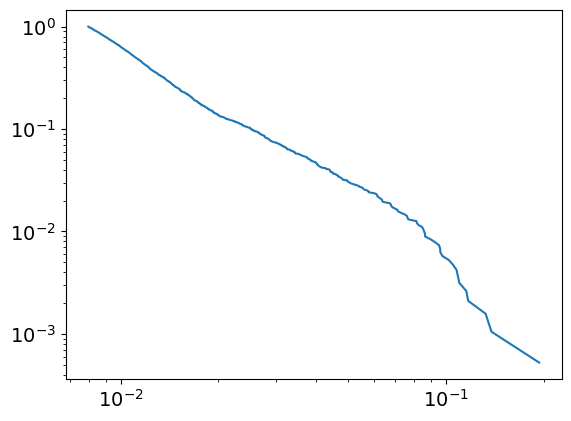

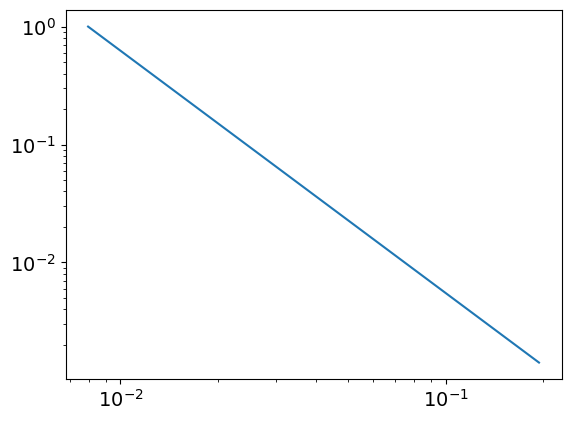

3.054235360214718
0.007955286661298161
powerlaw KstestResult(statistic=0.9988575620200372, pvalue=0.0, statistic_location=0.0976077000928852, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1383434320129665, statistic_sign=-1)
tensor(-2.9611e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3612, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.6020, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
48
tensor(0.1275, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


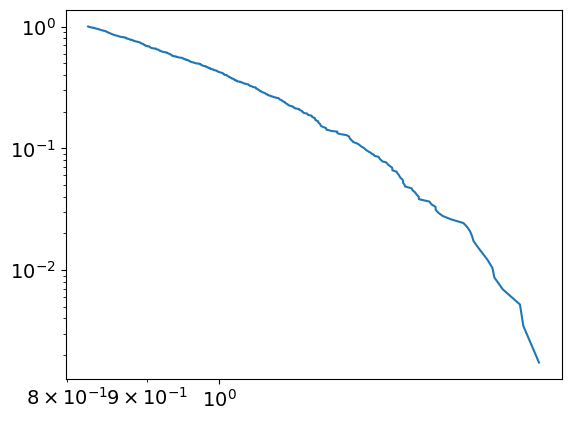

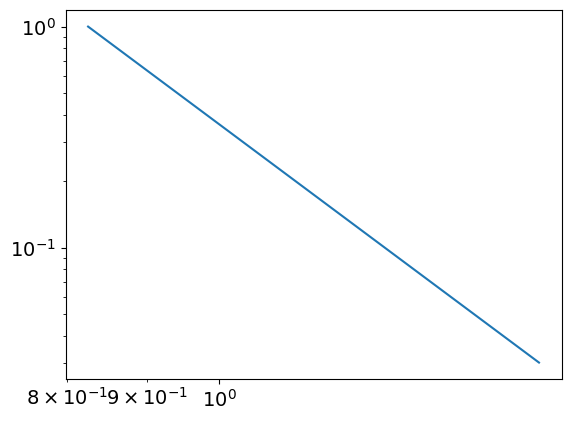

6.299503598062051
0.8251507146660947
powerlaw KstestResult(statistic=0.9910653927322852, pvalue=0.0, statistic_location=1.2158599489066764, statistic_sign=1)
lognorm KstestResult(statistic=0.9932942015391655, pvalue=0.0, statistic_location=1.219681762731601, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1941, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1193, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3255, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


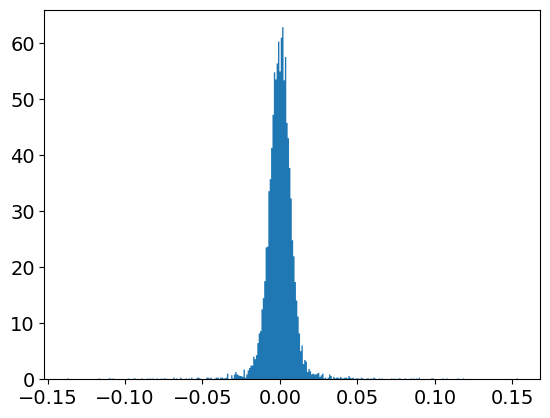

powerlaw
Calculating best minimal value for power law fit
9.152973533575466%
powerlaw KstestResult(statistic=0.9999999999990793, pvalue=0.0, statistic_location=0.1536533092688831, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13744345254927837, statistic_sign=-1)



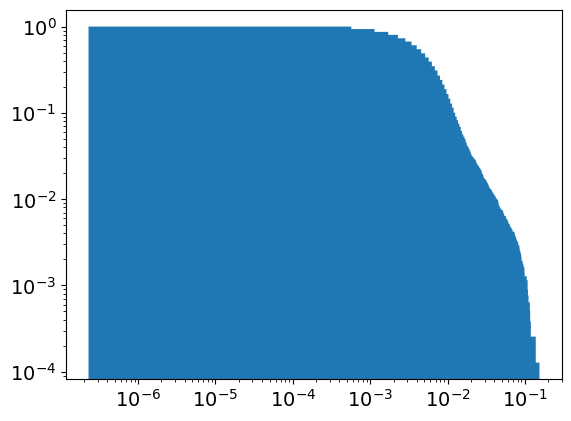

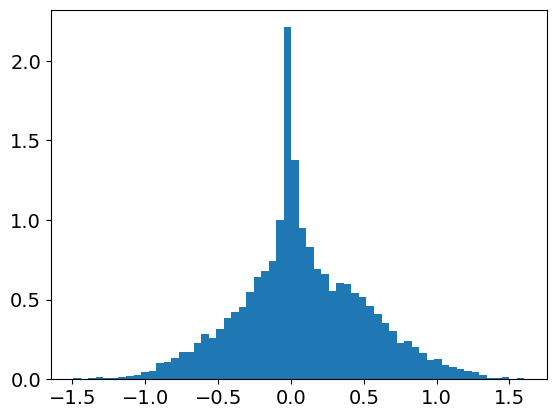

powerlaw
Calculating best minimal value for power law fit
13.284431399292643
powerlaw KstestResult(statistic=0.9999957432176753, pvalue=0.0, statistic_location=1.6018367382012269, statistic_sign=1)
lognorm KstestResult(statistic=0.9932248233588734, pvalue=0.0, statistic_location=1.2183943577584802, statistic_sign=1)



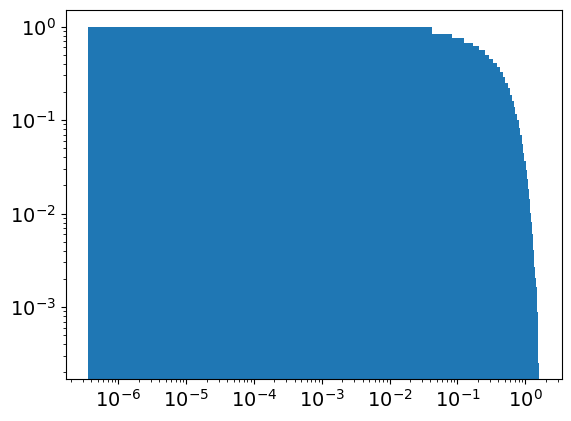

separation
epoch:
49
tensor(5.0922e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


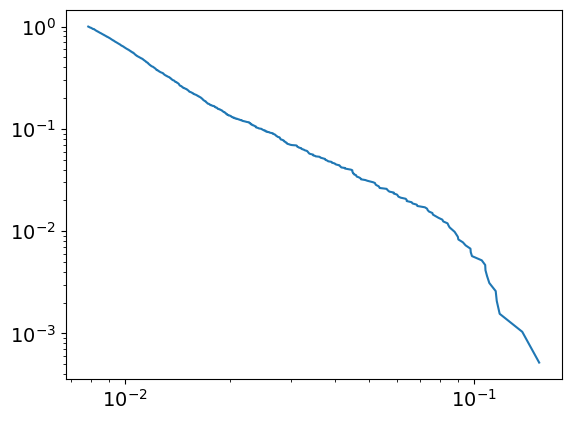

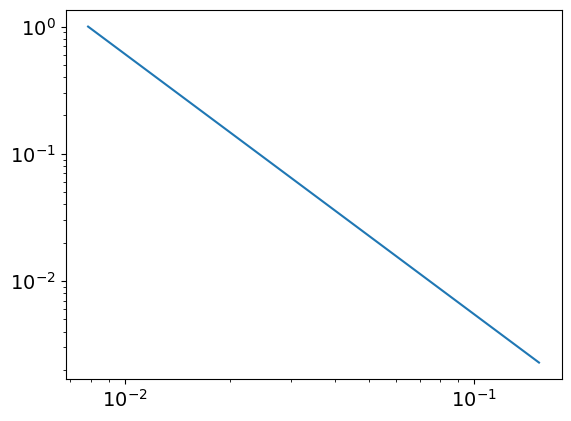

3.0469233673981875
0.007864949549876918
powerlaw KstestResult(statistic=0.9987200793713781, pvalue=0.0, statistic_location=0.10785326225576454, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13744345254927837, statistic_sign=-1)
tensor(-2.2249e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1797, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7892, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
49
tensor(0.1283, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


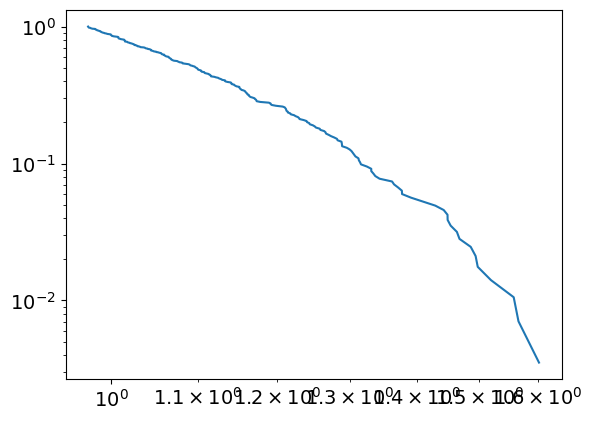

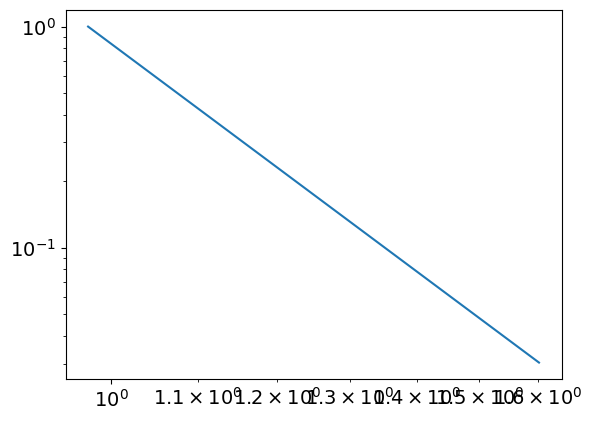

8.035336103521768
0.9745549063544
powerlaw KstestResult(statistic=0.9978809543237556, pvalue=0.0, statistic_location=1.3437627312711953, statistic_sign=1)
lognorm KstestResult(statistic=0.9932248233588734, pvalue=0.0, statistic_location=1.2183943577584802, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1946, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1212, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3292, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
50
tensor(5.1270e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


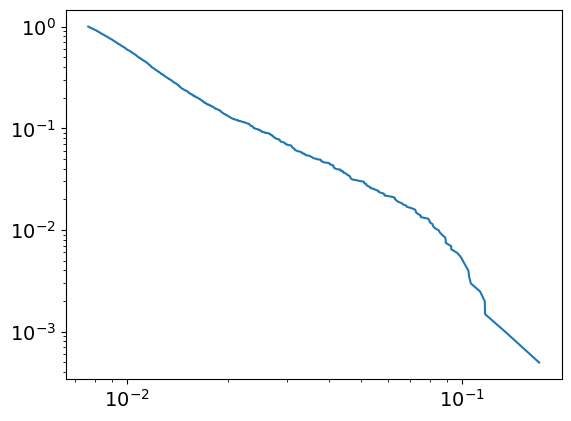

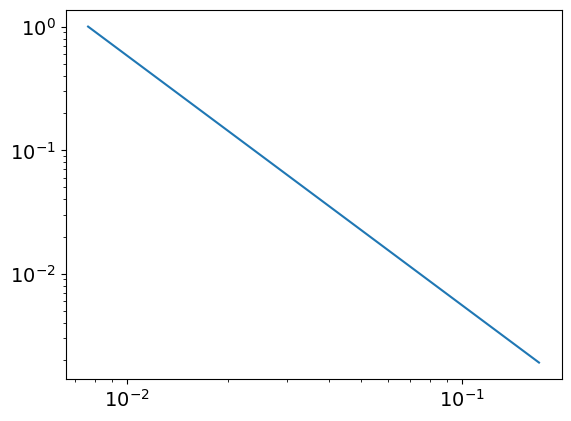

3.019292370102414
0.007651773499932145
powerlaw KstestResult(statistic=0.9987239312923394, pvalue=0.0, statistic_location=0.10055278602472037, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13466905202875215, statistic_sign=-1)
tensor(-8.2825e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3311, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4271, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
50
tensor(0.1290, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


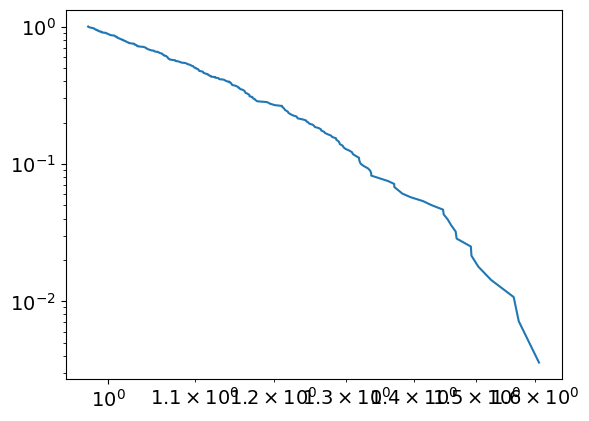

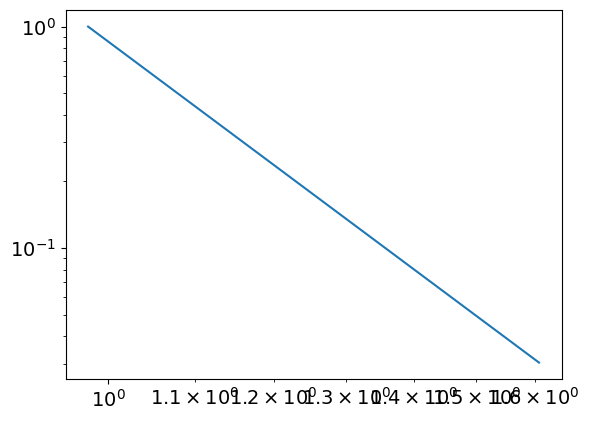

8.036325532524783
0.9782107318298247
powerlaw KstestResult(statistic=0.9978755913969618, pvalue=0.0, statistic_location=1.3481979489606821, statistic_sign=1)
lognorm KstestResult(statistic=0.9931432188820242, pvalue=0.0, statistic_location=1.221218770722205, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1950, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1231, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3328, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
51
tensor(5.3215e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


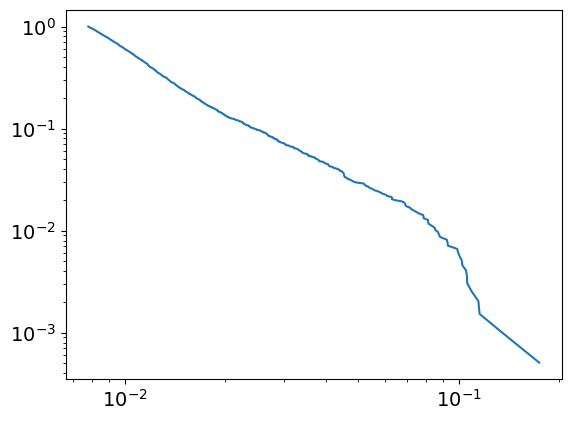

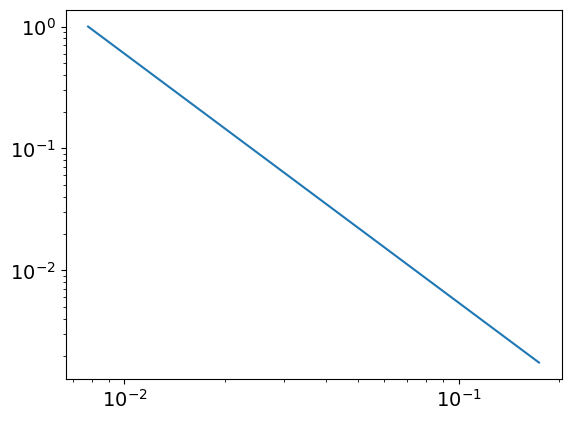

3.0426019777850786
0.007781806655934718
powerlaw KstestResult(statistic=0.9988867523159769, pvalue=0.0, statistic_location=0.10599403852743036, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13405876631409067, statistic_sign=-1)
tensor(-1.6191e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3238, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.3555, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
51
tensor(0.1297, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


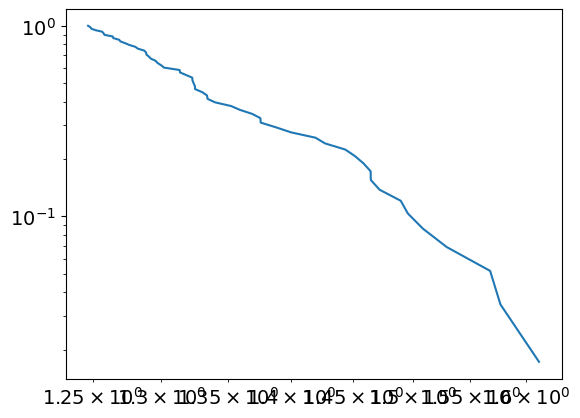

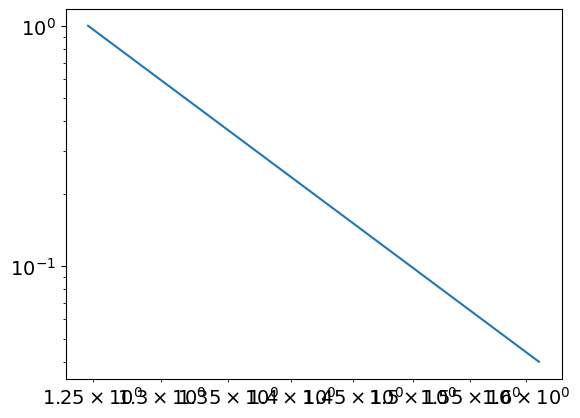

13.524126551293715
1.2467502580691359
powerlaw KstestResult(statistic=0.9999987800824556, pvalue=0.0, statistic_location=1.6121194042549793, statistic_sign=1)
lognorm KstestResult(statistic=0.9930513304947707, pvalue=0.0, statistic_location=1.223987316003562, statistic_sign=1)
tensor(0.0745, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1954, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1250, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3365, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
52
tensor(5.4727e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


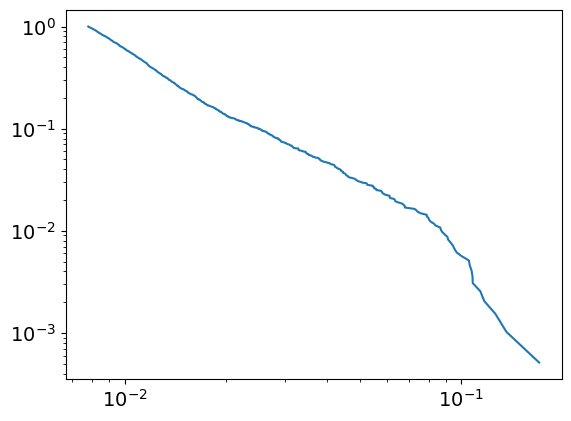

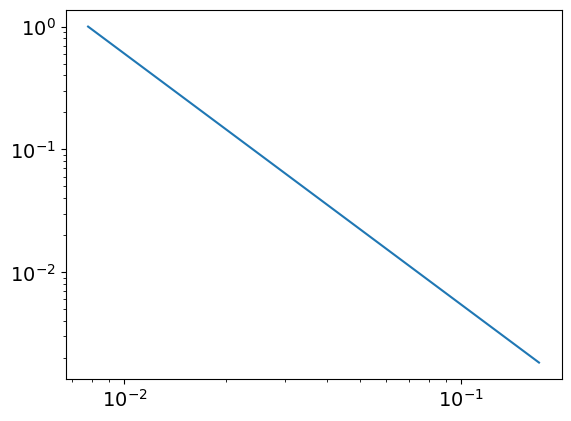

3.0433007832148586
0.00780067268794163
powerlaw KstestResult(statistic=0.9987757910224101, pvalue=0.0, statistic_location=0.1003036726433011, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17022380566507997, statistic_sign=1)
tensor(9.5435e-08, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3968, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.8272, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
52
tensor(0.1304, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


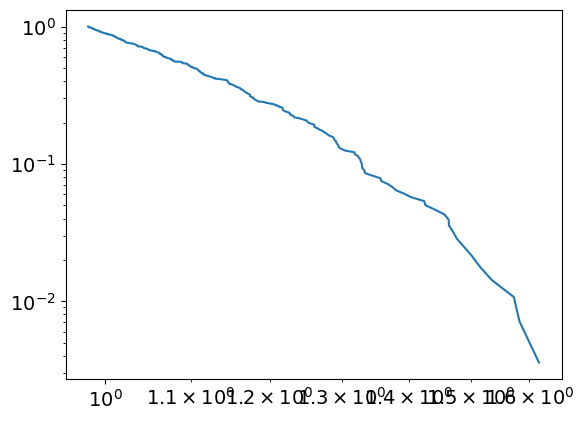

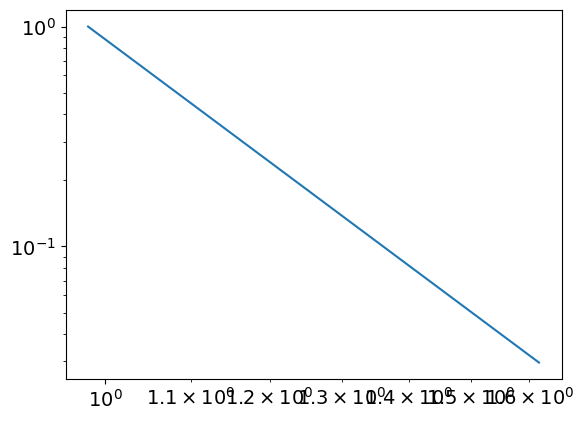

8.0470019487551
0.9815640022071851
powerlaw KstestResult(statistic=0.9978384876461224, pvalue=0.0, statistic_location=1.3568565993947974, statistic_sign=1)
lognorm KstestResult(statistic=0.9929381075103485, pvalue=0.0, statistic_location=1.2336998742583898, statistic_sign=1)
tensor(0.0745, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1958, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1269, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3401, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
53
tensor(6.4086e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


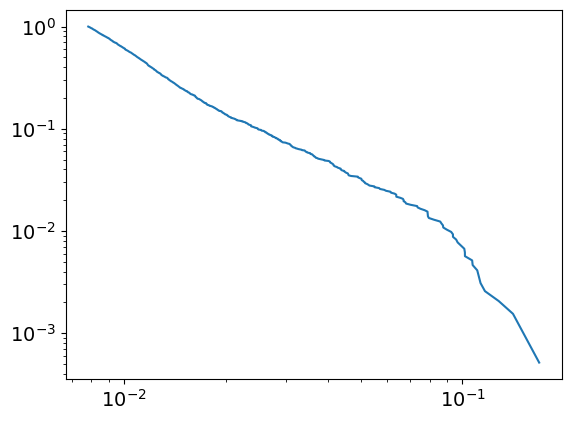

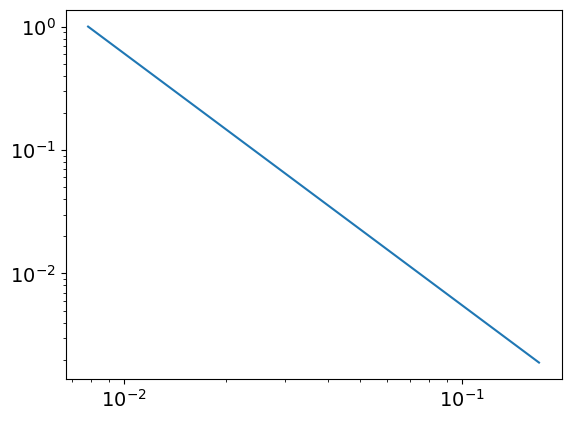

3.0413253589769016
0.00782746240694025
powerlaw KstestResult(statistic=0.9986126331970876, pvalue=0.0, statistic_location=0.10167732374178529, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1685983006052002, statistic_sign=1)
tensor(1.9656e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.1786, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
53
tensor(0.1310, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


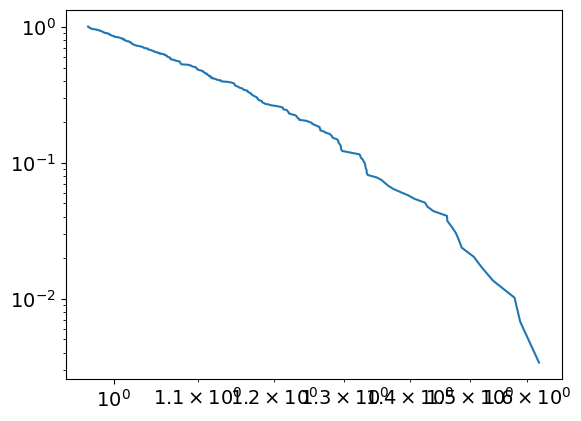

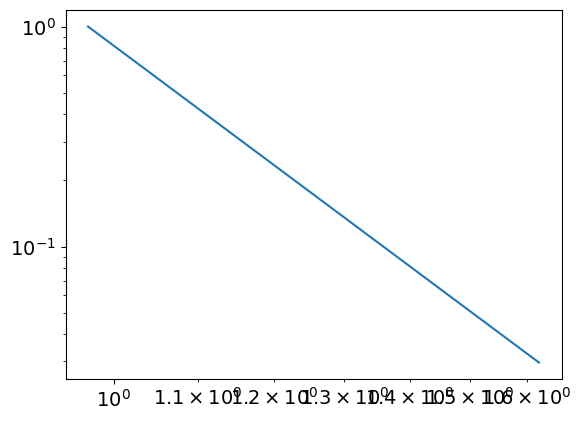

7.861612203278384
0.9712984243617646
powerlaw KstestResult(statistic=0.9976177167827032, pvalue=0.0, statistic_location=1.3485004841112815, statistic_sign=1)
lognorm KstestResult(statistic=0.9928751649085035, pvalue=0.0, statistic_location=1.2349876417438566, statistic_sign=1)
tensor(0.0745, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1961, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1287, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3435, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
54
tensor(6.9707e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


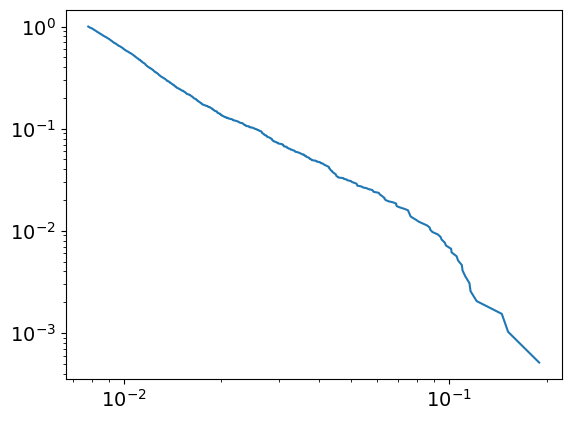

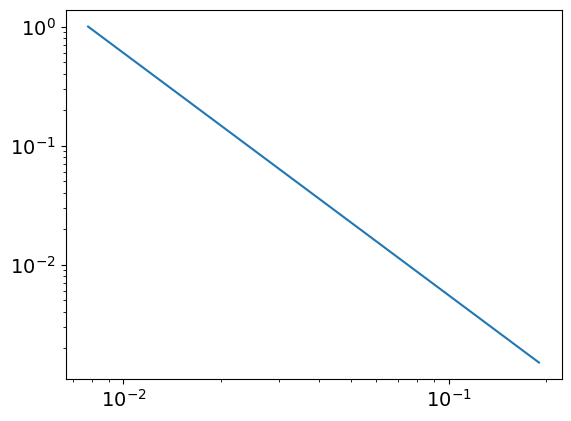

3.035687792212156
0.007782194051646925
powerlaw KstestResult(statistic=0.9986243744816431, pvalue=0.0, statistic_location=0.11028768990536329, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18985467717826623, statistic_sign=1)
tensor(4.0078e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6197, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.3228, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
54
tensor(0.1317, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


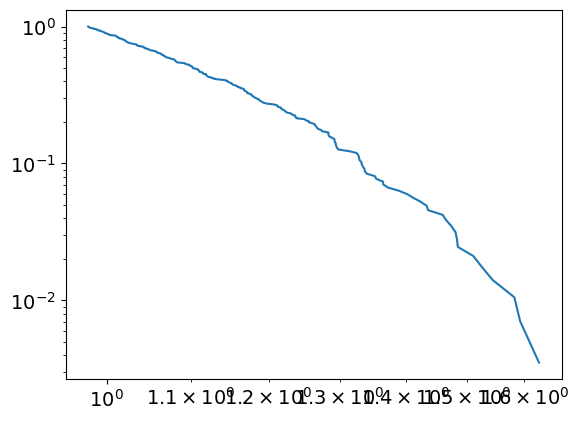

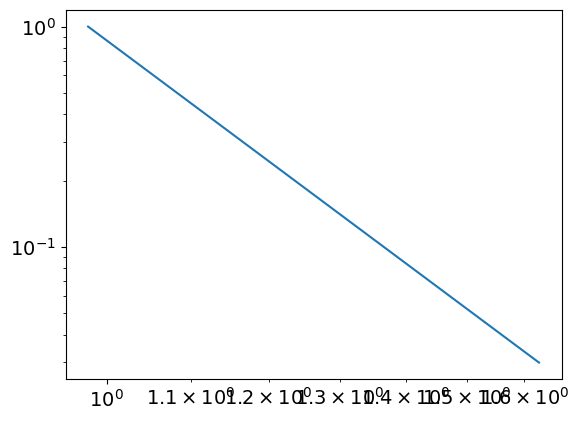

7.9234800971618915
0.9794127504117629
powerlaw KstestResult(statistic=0.9976873512726641, pvalue=0.0, statistic_location=1.365123884875538, statistic_sign=1)
lognorm KstestResult(statistic=0.9926914395639461, pvalue=0.0, statistic_location=1.2377966023879143, statistic_sign=1)
tensor(0.0745, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1965, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1305, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3469, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
55
tensor(6.4250e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


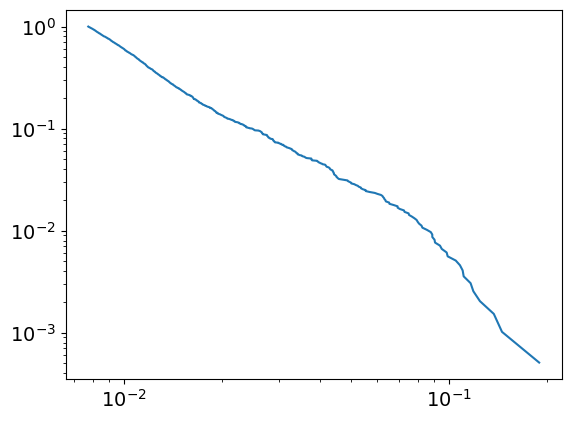

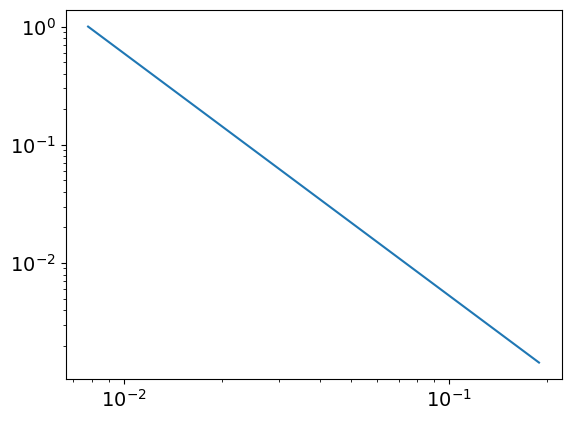

3.0482902773573524
0.007762077459351523
powerlaw KstestResult(statistic=0.9988288321601908, pvalue=0.0, statistic_location=0.09830417289086921, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14549805931951726, statistic_sign=-1)
tensor(-1.4572e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3036, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.8857, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
55
tensor(0.1323, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


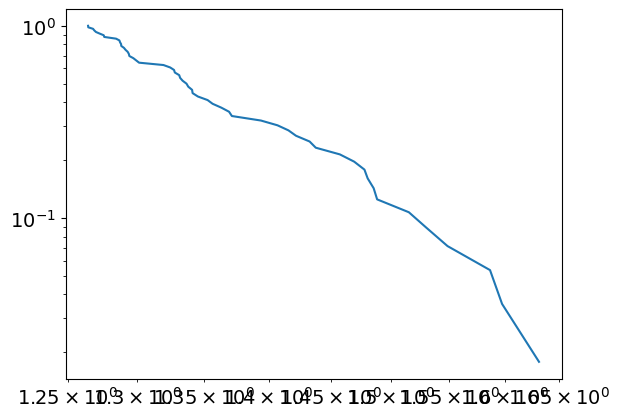

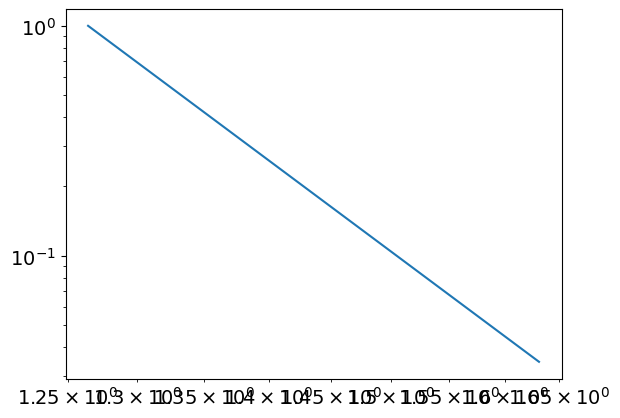

14.214628464155886
1.2643010780272566
powerlaw KstestResult(statistic=0.9999993541023371, pvalue=0.0, statistic_location=1.631198475129545, statistic_sign=1)
lognorm KstestResult(statistic=0.9926065757666358, pvalue=0.0, statistic_location=1.2268246063657697, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1968, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1322, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3504, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
56
tensor(5.6799e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


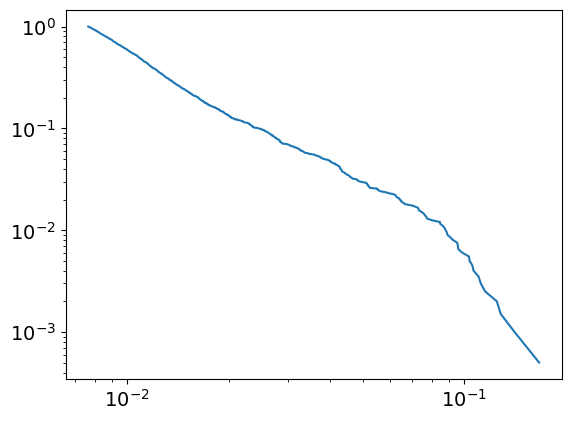

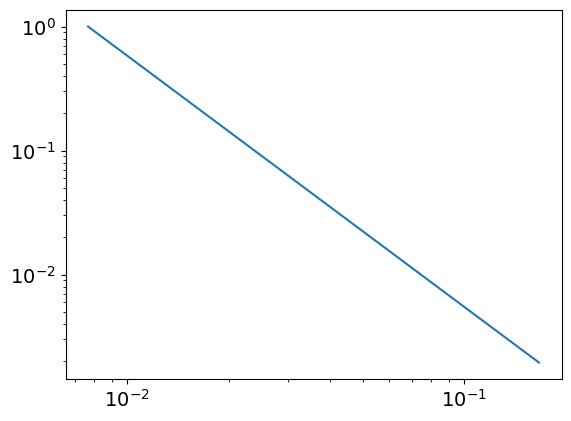

3.025948371498486
0.007664046580724511
powerlaw KstestResult(statistic=0.9987832311281161, pvalue=0.0, statistic_location=0.09859752505102196, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1408772469206652, statistic_sign=-1)
tensor(-3.7798e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2160, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.7953, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
56
tensor(0.1329, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


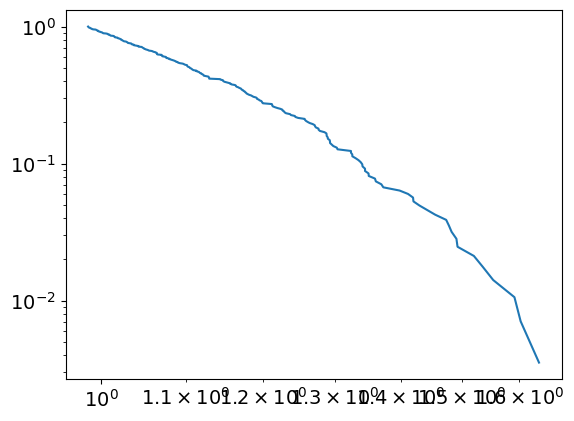

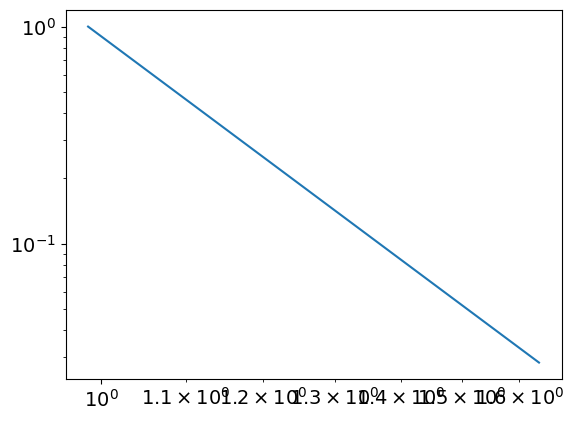

8.025118638290362
0.9852296948465231
powerlaw KstestResult(statistic=0.9977144939494681, pvalue=0.0, statistic_location=1.3730586557321365, statistic_sign=1)
lognorm KstestResult(statistic=0.9925574189480577, pvalue=0.0, statistic_location=1.2307338244518604, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1972, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1340, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3537, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
57
tensor(4.9637e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


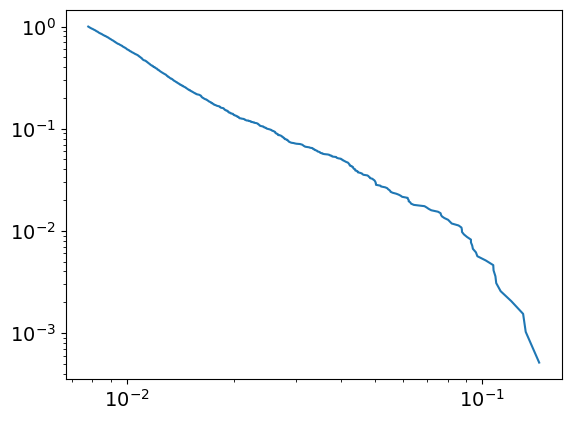

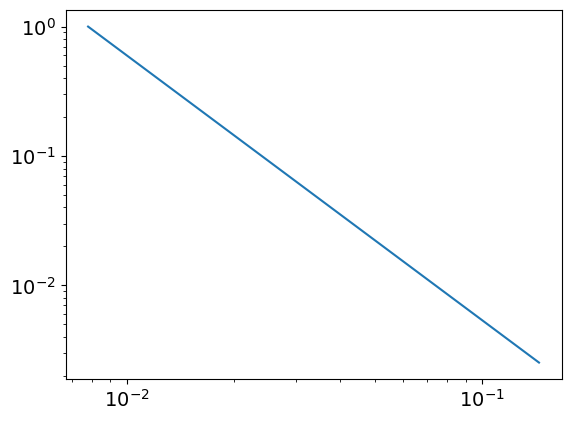

3.0456746911772594
0.0077914638034185055
powerlaw KstestResult(statistic=0.9987934833601558, pvalue=0.0, statistic_location=0.10962589432011756, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14479708577985412, statistic_sign=-1)
tensor(-2.3934e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0923, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.9173, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
57
tensor(0.1335, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


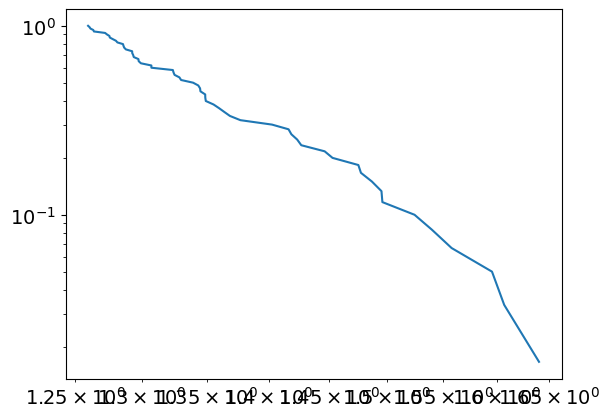

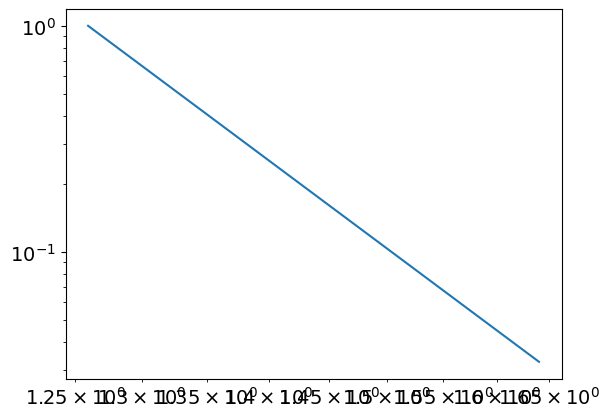

13.954542917079326
1.2594251848070874
powerlaw KstestResult(statistic=0.9999986015718436, pvalue=0.0, statistic_location=1.6400255942104451, statistic_sign=1)
lognorm KstestResult(statistic=0.9925403765414766, pvalue=0.0, statistic_location=1.2313324413985356, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1975, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1358, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3570, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
58
tensor(4.9293e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


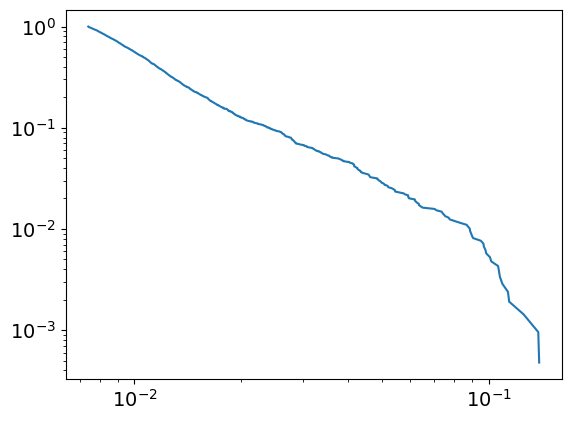

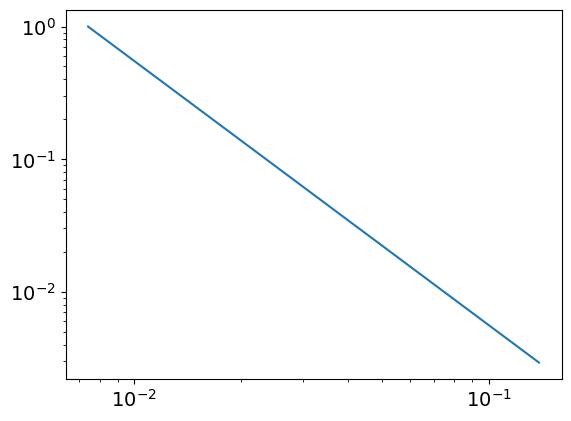

2.9911705258463988
0.00740923163025062
powerlaw KstestResult(statistic=0.9987926153744222, pvalue=0.0, statistic_location=0.10931527078199882, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13882921992773292, statistic_sign=-1)
tensor(-2.5837e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1143, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.6630, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
58
tensor(0.1341, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


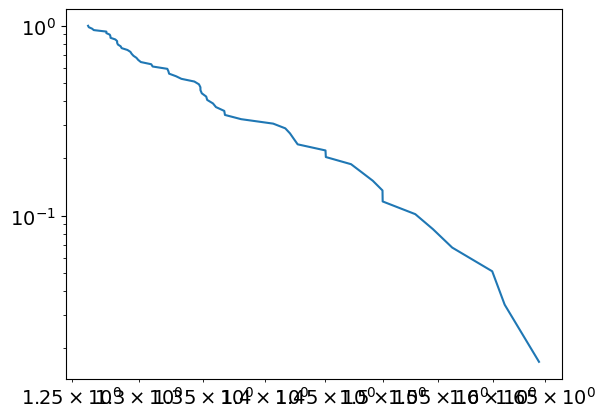

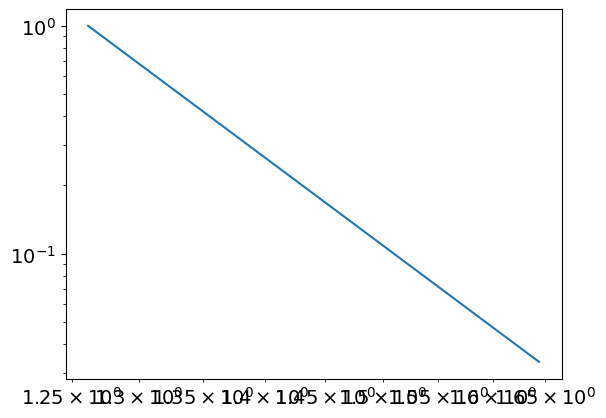

13.845032239841302
1.2620712905363434
powerlaw KstestResult(statistic=0.9999983554830552, pvalue=0.0, statistic_location=1.6442228143215878, statistic_sign=1)
lognorm KstestResult(statistic=0.992358176281486, pvalue=0.0, statistic_location=1.2302151787544744, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1978, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1375, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3602, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
59
tensor(4.8718e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


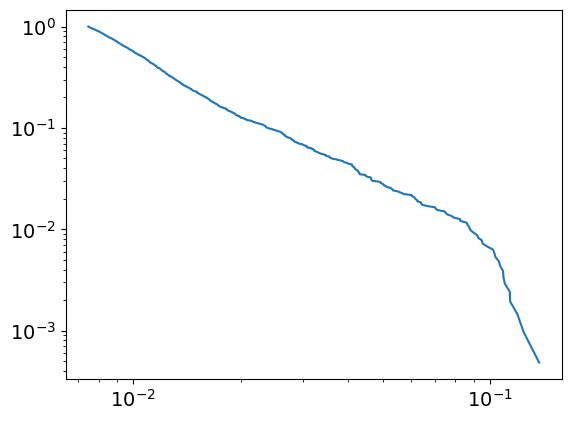

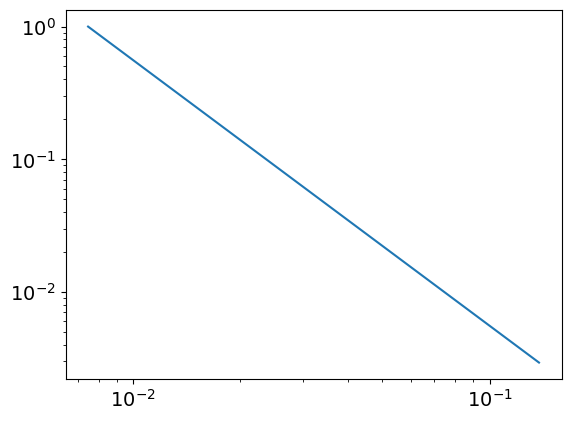

3.003532987195132
0.007474494180763632
powerlaw KstestResult(statistic=0.9987024382200667, pvalue=0.0, statistic_location=0.10914358969220912, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1375000435071027, statistic_sign=-1)
tensor(-3.6581e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1310, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4525, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
59
tensor(0.1346, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


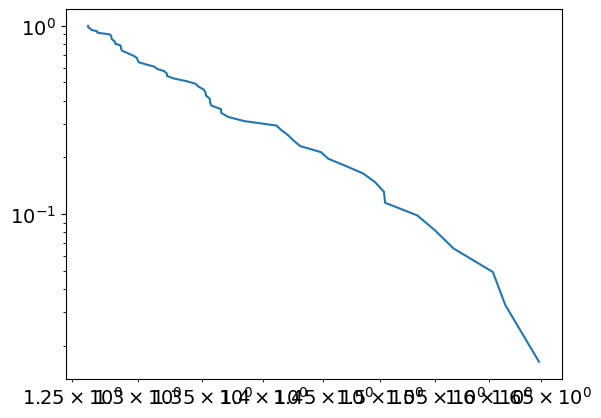

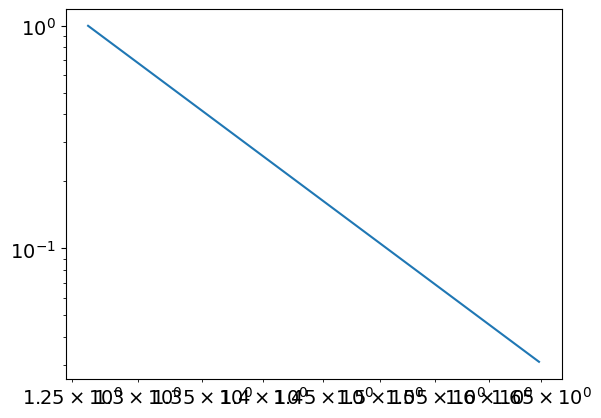

14.00707301117163
1.2618486460534306
powerlaw KstestResult(statistic=0.9999983455855047, pvalue=0.0, statistic_location=1.648442146783161, statistic_sign=1)
lognorm KstestResult(statistic=0.9923205559173034, pvalue=0.0, statistic_location=1.2311774942257534, statistic_sign=1)
tensor(0.0747, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1981, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1392, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3635, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
60
tensor(4.9924e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


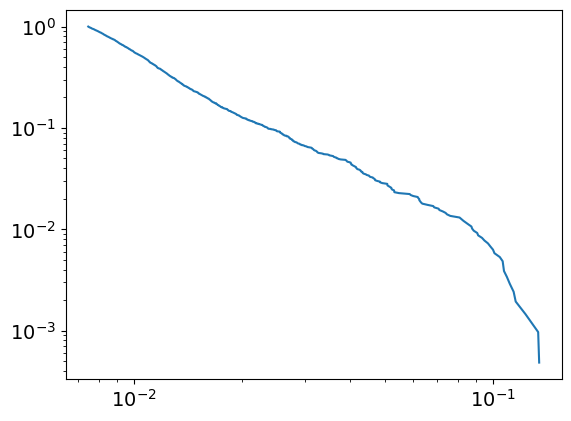

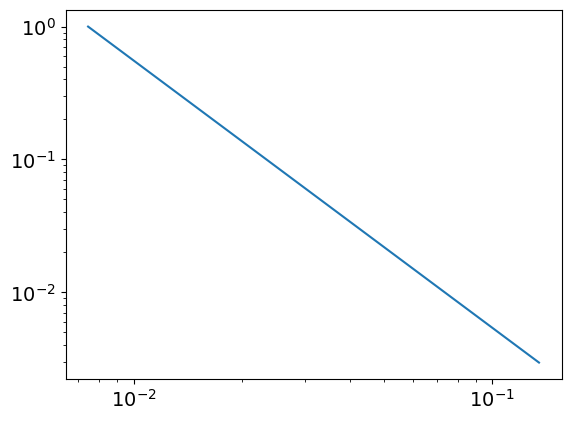

3.0135142657982694
0.007469167585228995
powerlaw KstestResult(statistic=0.9987851822556778, pvalue=0.0, statistic_location=0.10713786473789043, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.134862657069441, statistic_sign=-1)
tensor(-2.1374e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0950, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.3427, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
60
tensor(0.1352, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


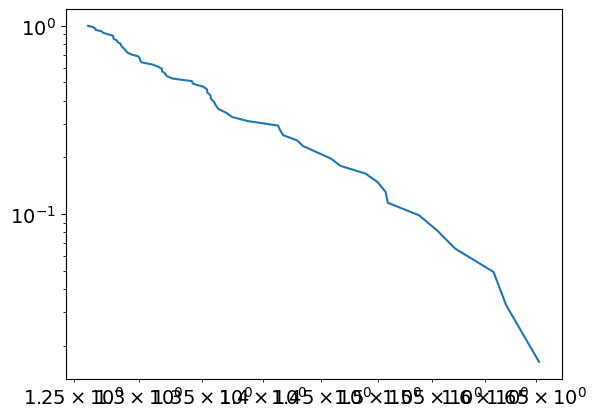

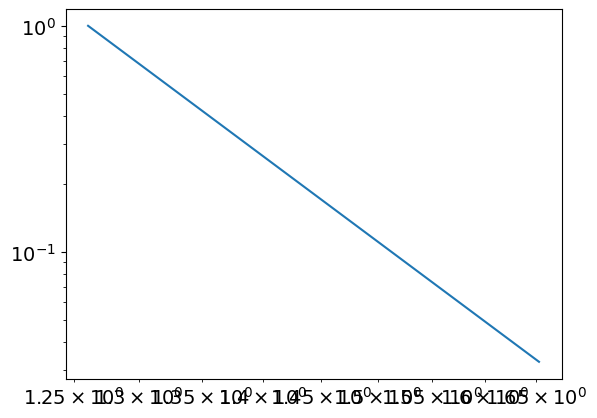

13.665402194983974
1.2609694620484164
powerlaw KstestResult(statistic=0.9999972792333829, pvalue=0.0, statistic_location=1.652481039632337, statistic_sign=1)
lognorm KstestResult(statistic=0.9922776474955814, pvalue=0.0, statistic_location=1.2322201193722804, statistic_sign=1)
tensor(0.0747, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1983, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1408, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3667, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
61
tensor(5.3307e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


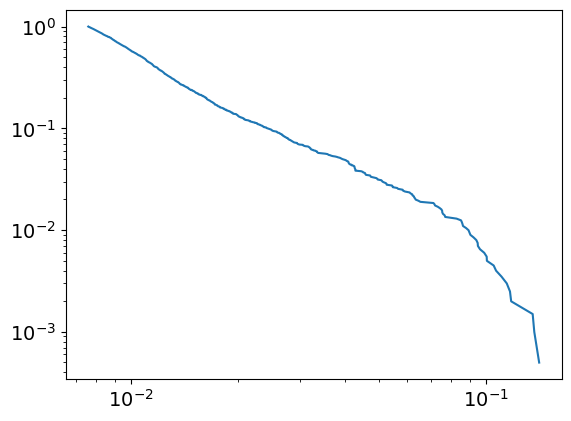

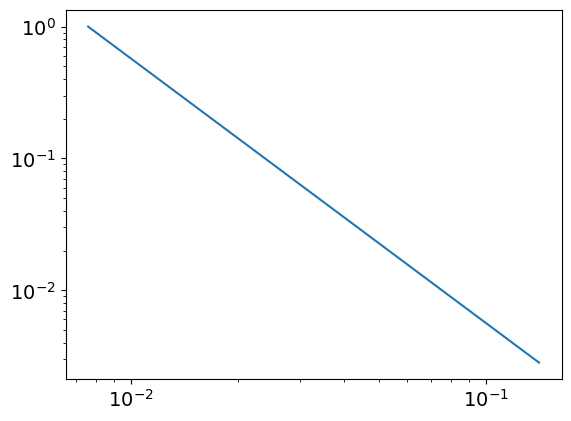

3.005882930866312
0.007584888849537446
powerlaw KstestResult(statistic=0.9985336216571796, pvalue=0.0, statistic_location=0.11075979759556849, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14142621847916606, statistic_sign=1)
tensor(4.8664e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2912, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.0356, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
61
tensor(0.1357, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


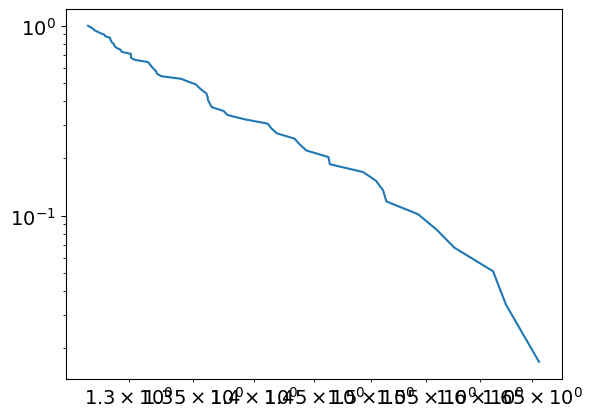

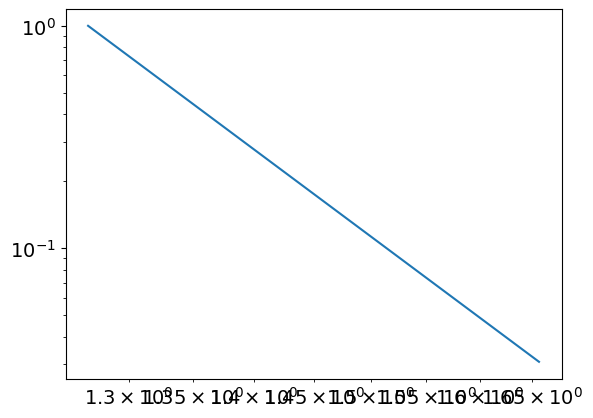

14.058689133760263
1.2691137442788338
powerlaw KstestResult(statistic=0.9999983757162368, pvalue=0.0, statistic_location=1.6565516782843654, statistic_sign=1)
lognorm KstestResult(statistic=0.9922082853983784, pvalue=0.0, statistic_location=1.2336839406204725, statistic_sign=1)
tensor(0.0747, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1986, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1424, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3698, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
62
tensor(5.0799e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


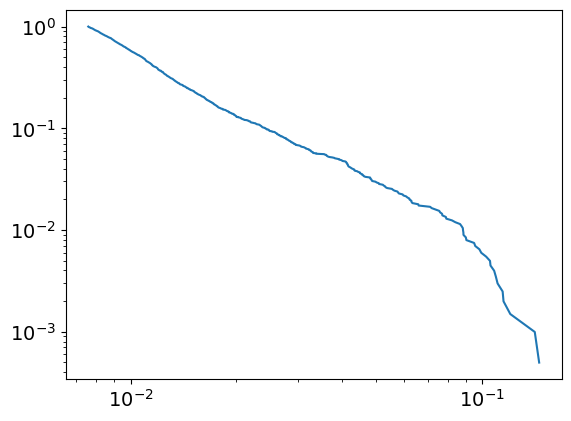

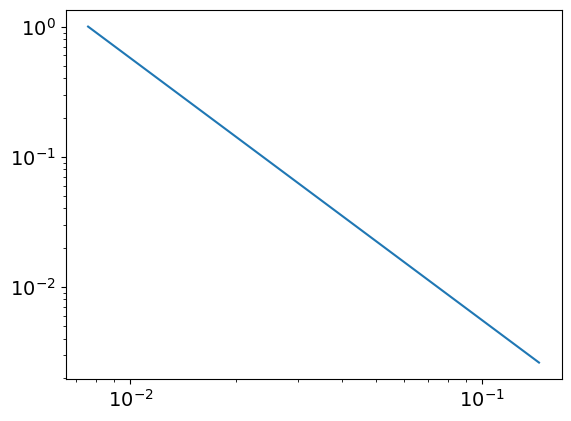

3.014699144043931
0.007581559361298145
powerlaw KstestResult(statistic=0.9985626317155156, pvalue=0.0, statistic_location=0.1105134527712134, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1409702610893119, statistic_sign=-1)
tensor(-5.9660e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7197, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
62
tensor(0.1362, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


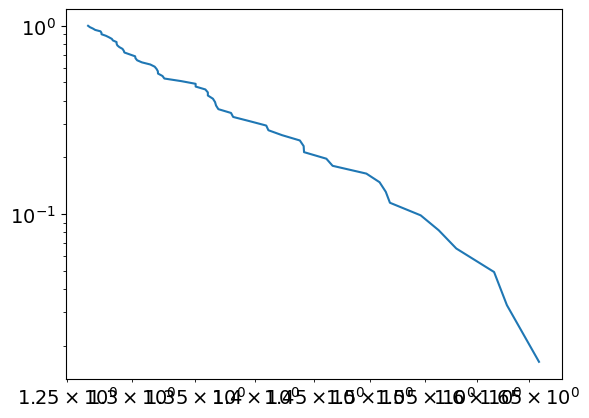

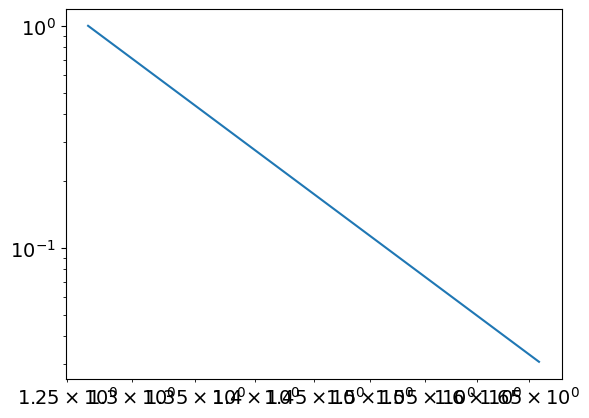

13.851469285358036
1.2659083827859754
powerlaw KstestResult(statistic=0.9999974625981156, pvalue=0.0, statistic_location=1.6603907899389665, statistic_sign=1)
lognorm KstestResult(statistic=0.9922116169094123, pvalue=0.0, statistic_location=1.2288621070518462, statistic_sign=1)
tensor(0.0748, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1989, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1440, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3730, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
63
tensor(4.9529e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


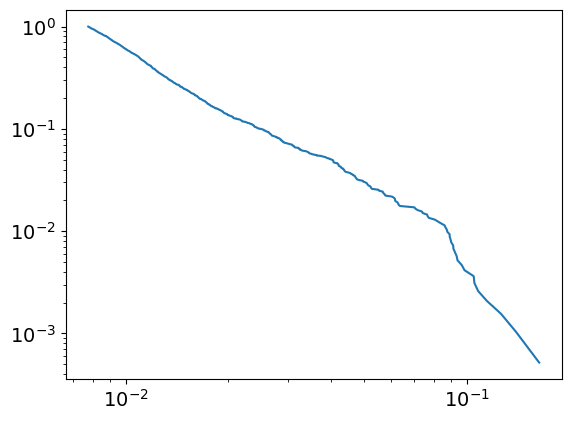

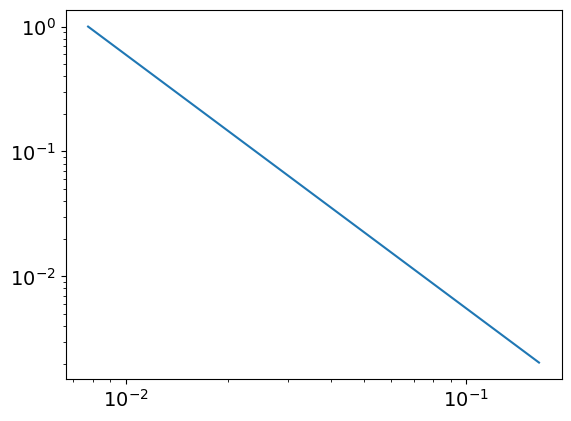

3.0328671614847176
0.007753593191140808
powerlaw KstestResult(statistic=0.9989656562882172, pvalue=0.0, statistic_location=0.09678076300065384, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1396247858097945, statistic_sign=-1)
tensor(-1.2615e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1298, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.2930, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
63
tensor(0.1367, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


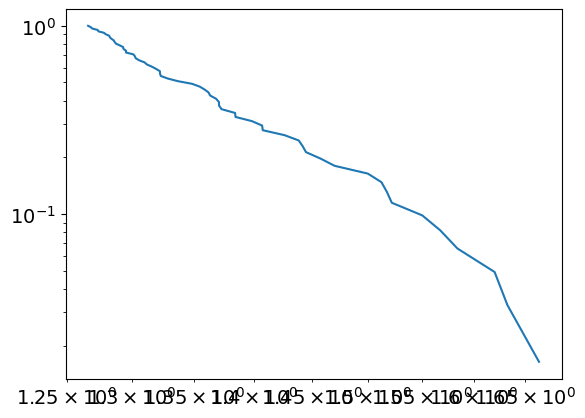

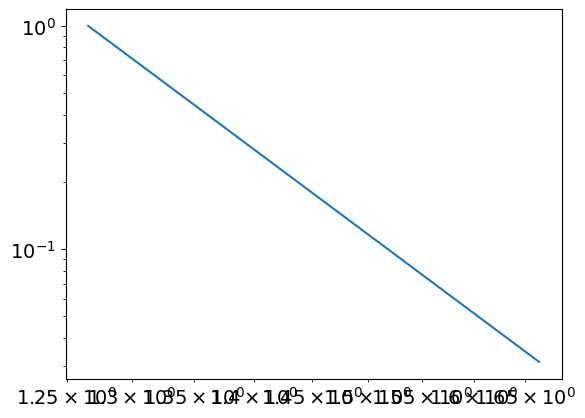

13.672972672562851
1.266182550177079
powerlaw KstestResult(statistic=0.9999966101799169, pvalue=0.0, statistic_location=1.664247198859703, statistic_sign=1)
lognorm KstestResult(statistic=0.9921714179395265, pvalue=0.0, statistic_location=1.2299223634316307, statistic_sign=1)
tensor(0.0748, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1991, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1456, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3762, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
64
tensor(5.4728e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


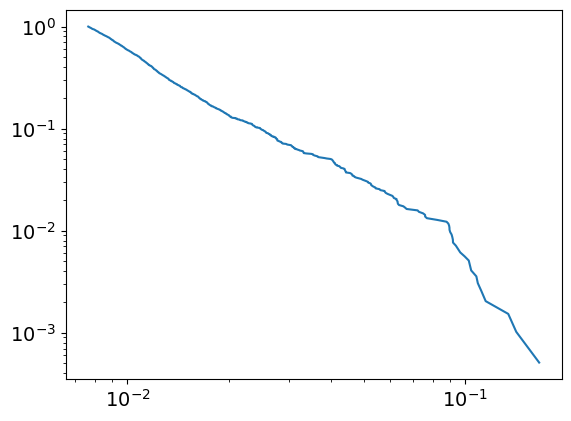

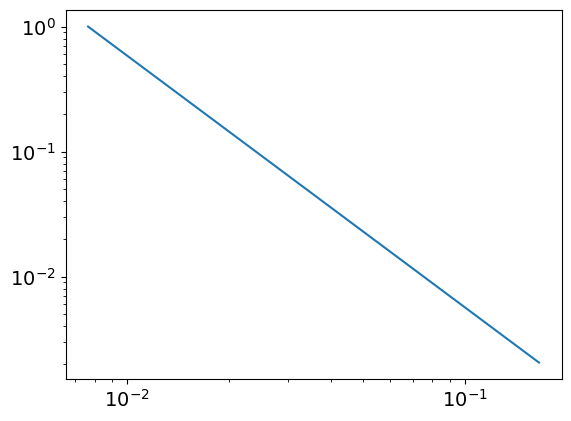

3.014481824537114
0.007657219596048014
powerlaw KstestResult(statistic=0.9987857451546251, pvalue=0.0, statistic_location=0.1115973655587224, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14147077126352864, statistic_sign=-1)
tensor(-2.1380e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0992, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.5406, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
64
tensor(0.1372, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


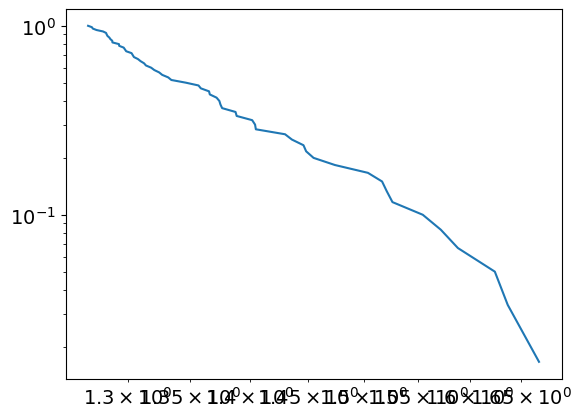

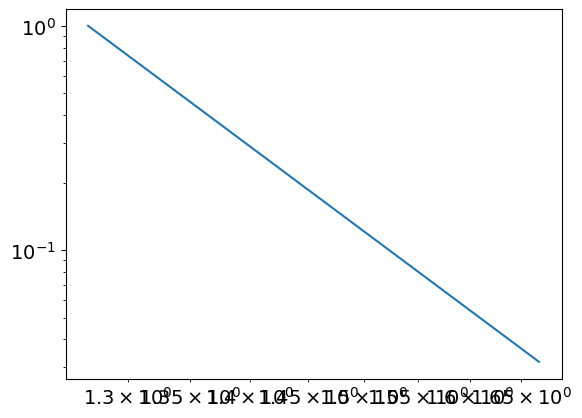

13.621454633762387
1.2691325654740837
powerlaw KstestResult(statistic=0.9999963450333367, pvalue=0.0, statistic_location=1.6680120564987235, statistic_sign=1)
lognorm KstestResult(statistic=0.9920390352222405, pvalue=0.0, statistic_location=1.2349486936658507, statistic_sign=1)
tensor(0.0748, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1471, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3794, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
65
tensor(5.6010e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


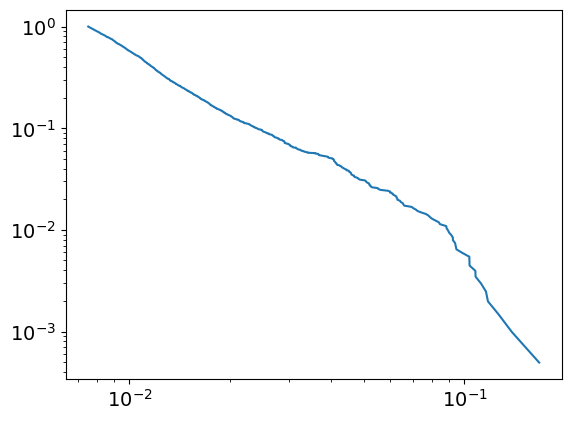

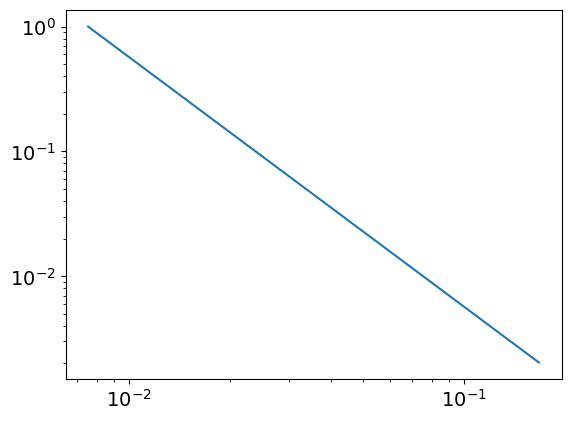

2.9997491701577417
0.007531654061384603
powerlaw KstestResult(statistic=0.9984824057763468, pvalue=0.0, statistic_location=0.10775810938617399, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13849060807605343, statistic_sign=-1)
tensor(-8.7776e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4424, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.1649, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
65
tensor(0.1377, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


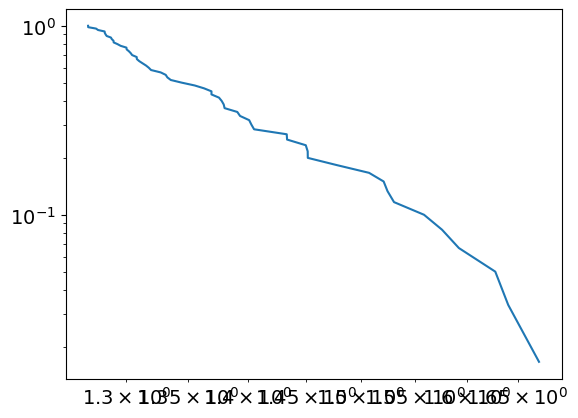

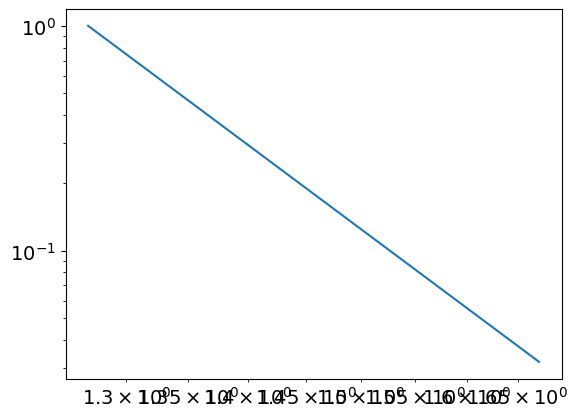

13.515883931959788
1.2699206133837317
powerlaw KstestResult(statistic=0.9999955557062593, pvalue=0.0, statistic_location=1.671717775896307, statistic_sign=1)
lognorm KstestResult(statistic=0.9919282012407634, pvalue=0.0, statistic_location=1.2387458523905952, statistic_sign=1)
tensor(0.0749, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1996, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1486, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3825, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
66
tensor(5.0636e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


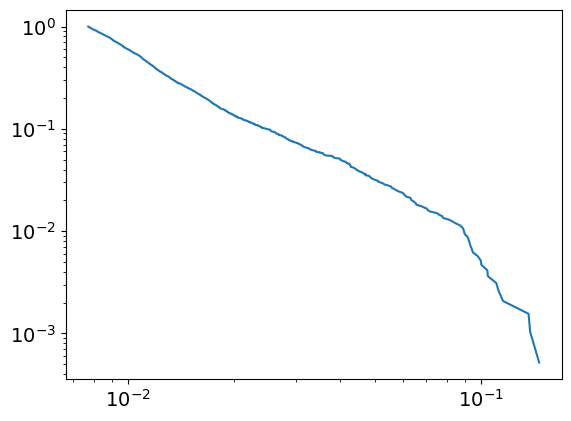

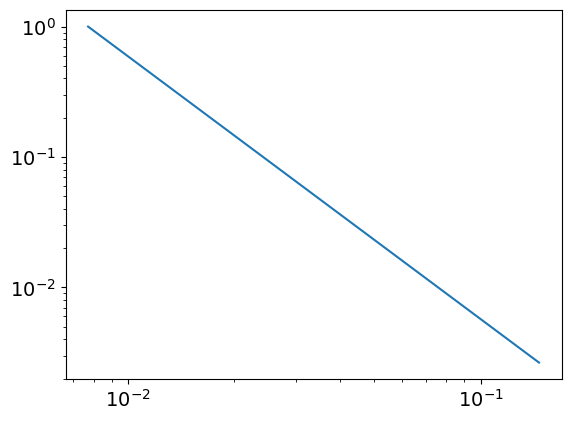

3.01660676126265
0.007722152850736872
powerlaw KstestResult(statistic=0.9986410458503158, pvalue=0.0, statistic_location=0.11236992824174057, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14634014797884615, statistic_sign=1)
tensor(1.1402e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4994, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6489, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
66
tensor(0.1382, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


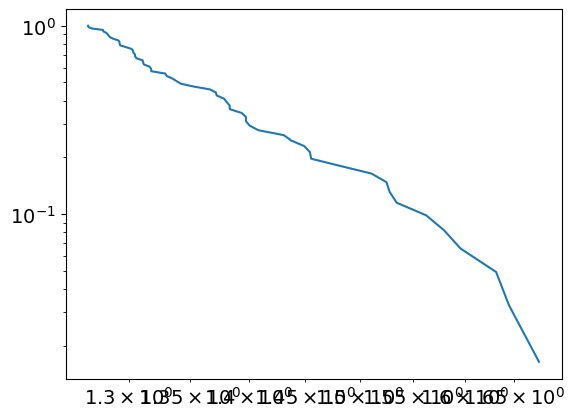

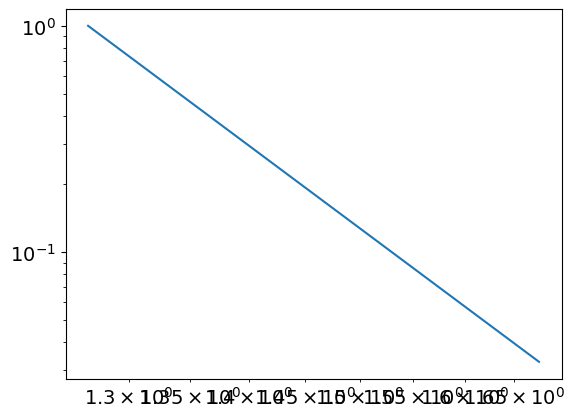

13.259269968594458
1.2676585669814393
powerlaw KstestResult(statistic=0.9999932008944893, pvalue=0.0, statistic_location=1.67529127541153, statistic_sign=1)
lognorm KstestResult(statistic=0.991871891780793, pvalue=0.0, statistic_location=1.2313658120132207, statistic_sign=1)
tensor(0.0749, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1998, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1501, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3856, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
67
tensor(5.3368e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


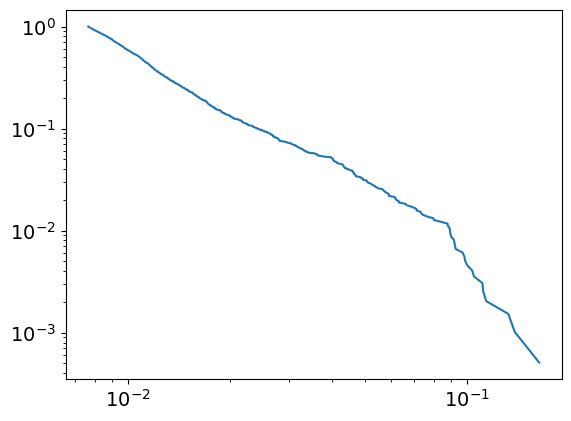

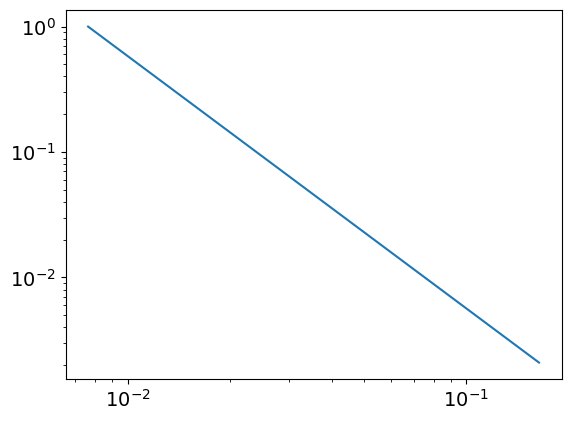

3.0121430779836653
0.007636995687986415
powerlaw KstestResult(statistic=0.9986394769587179, pvalue=0.0, statistic_location=0.111984512788895, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16385112327530973, statistic_sign=1)
tensor(5.8236e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5013, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.5684, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
67
tensor(0.1386, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


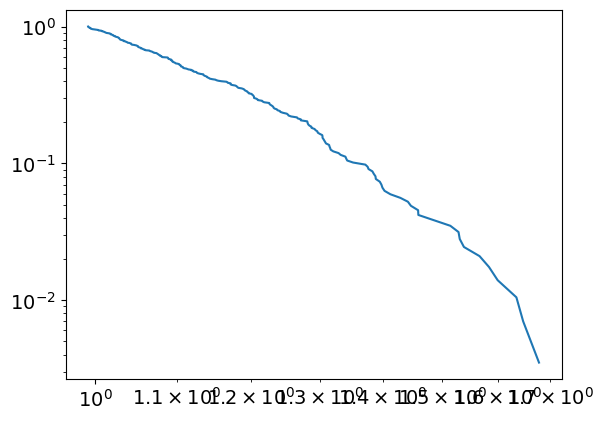

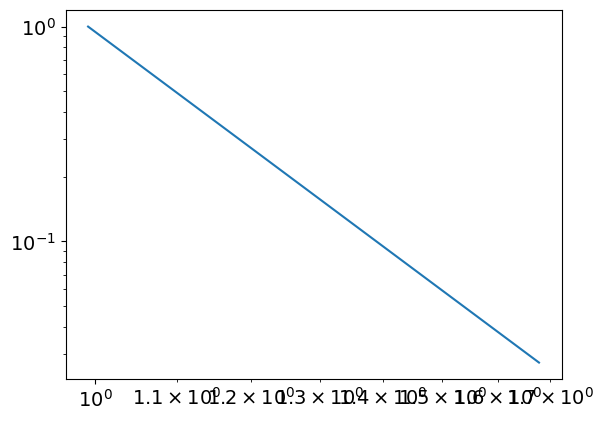

7.8483057227922695
0.991989826248111
powerlaw KstestResult(statistic=0.9971725191806824, pvalue=0.0, statistic_location=1.4019945487680372, statistic_sign=1)
lognorm KstestResult(statistic=0.9917978903957977, pvalue=0.0, statistic_location=1.2329601271916955, statistic_sign=1)
tensor(0.0749, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1516, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3887, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
68
tensor(4.8824e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


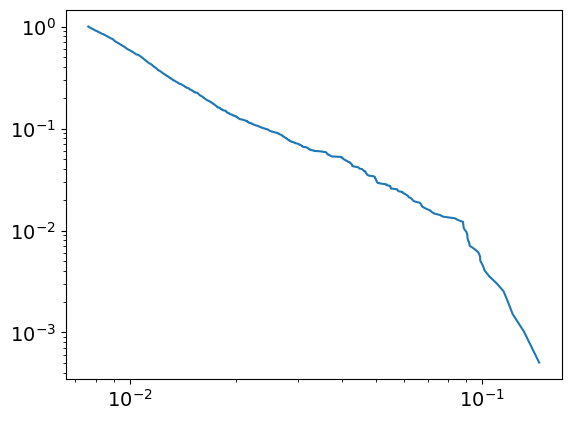

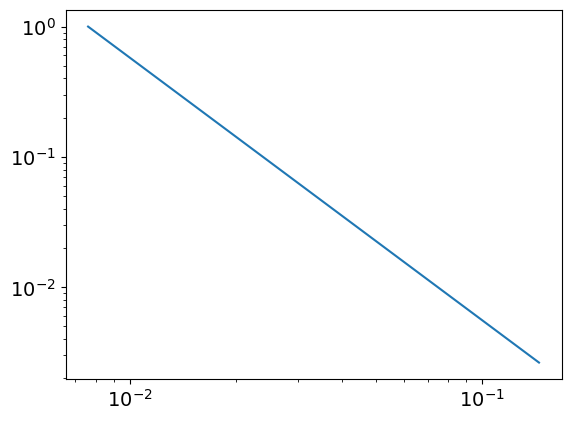

3.0144543505865595
0.0076143116523434175
powerlaw KstestResult(statistic=0.9986054385502456, pvalue=0.0, statistic_location=0.10468533026817853, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1450247893479396, statistic_sign=1)
tensor(3.6338e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5332, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4975, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
68
tensor(0.1391, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


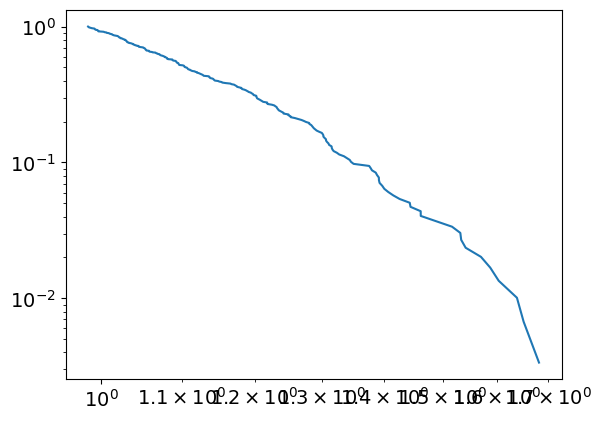

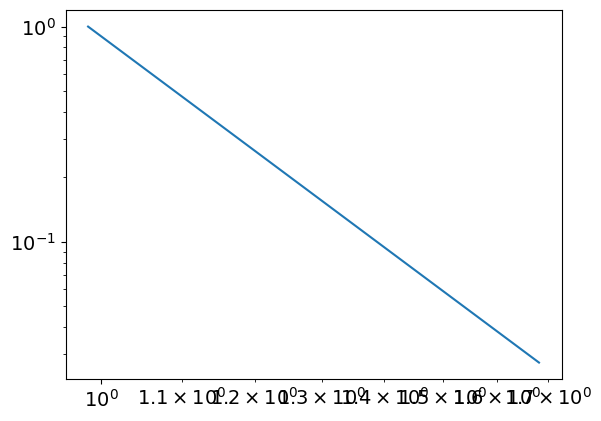

7.711989905950642
0.9843378385743621
powerlaw KstestResult(statistic=0.9968460845284053, pvalue=0.0, statistic_location=1.3918828276617747, statistic_sign=1)
lognorm KstestResult(statistic=0.9917284349460304, pvalue=0.0, statistic_location=1.2418027404951966, statistic_sign=1)
tensor(0.0750, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2003, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1530, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3919, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
69
tensor(5.1673e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


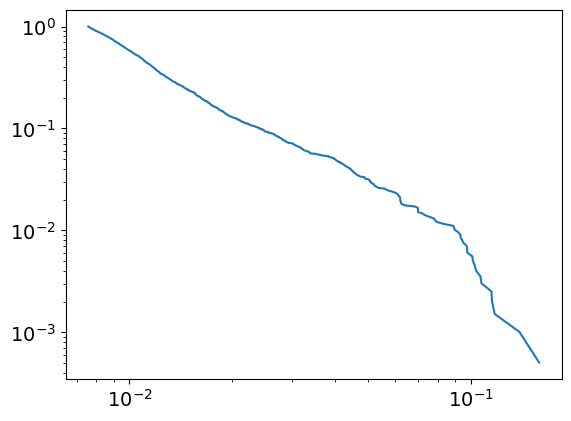

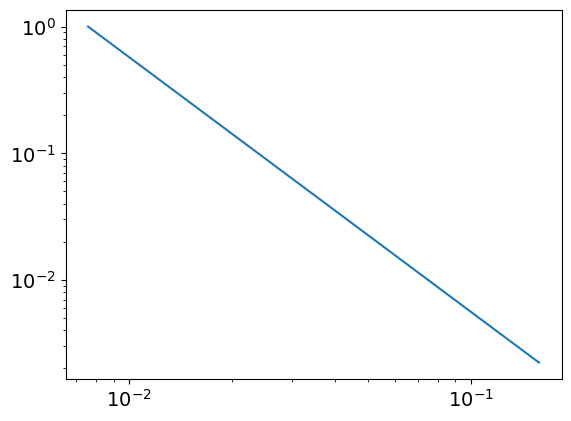

3.0087225865303204
0.007576053820427145
powerlaw KstestResult(statistic=0.9987700355271175, pvalue=0.0, statistic_location=0.10739758544586885, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15849806933875207, statistic_sign=1)
tensor(6.3887e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2272, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.6364, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
69
tensor(0.1395, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


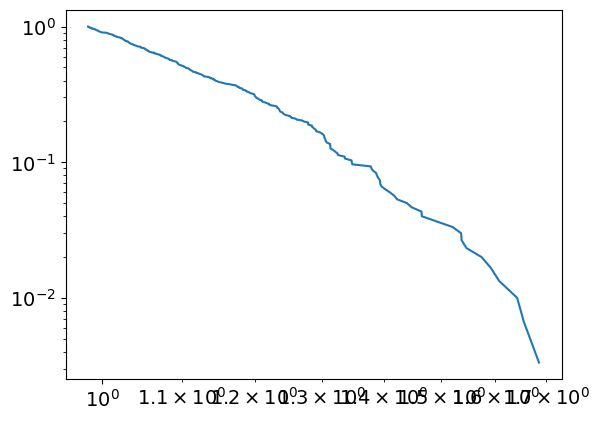

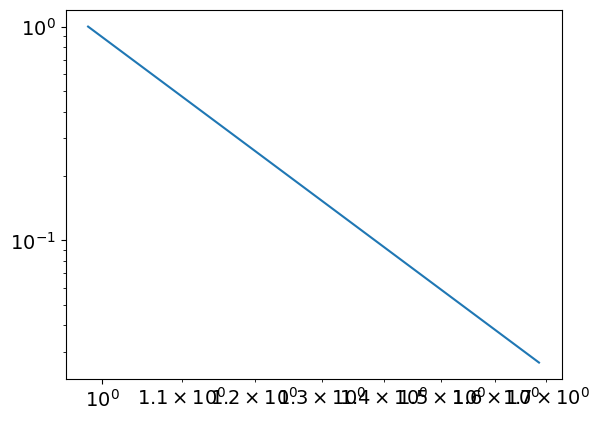

7.716854745433228
0.9833412306701995
powerlaw KstestResult(statistic=0.996752434633591, pvalue=0.0, statistic_location=1.395942003170408, statistic_sign=1)
lognorm KstestResult(statistic=0.9916956985226657, pvalue=0.0, statistic_location=1.2371480377642232, statistic_sign=1)
tensor(0.0750, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2005, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1544, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3950, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
70
tensor(5.2435e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


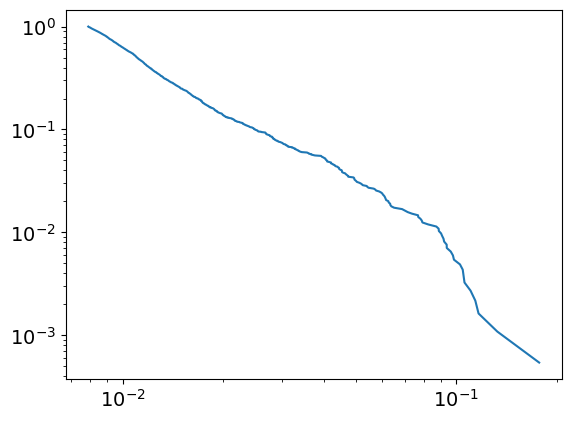

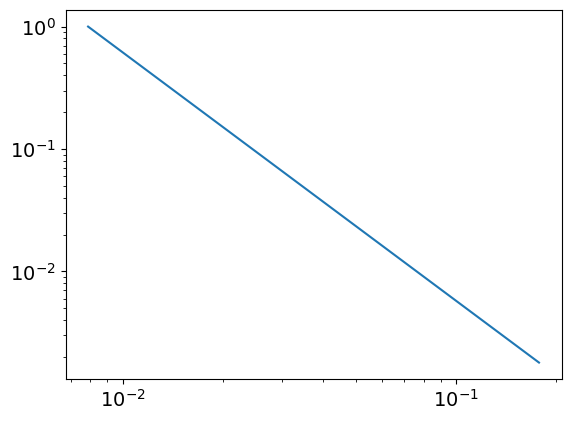

3.030464846776015
0.007881270978541959
powerlaw KstestResult(statistic=0.9988682225931308, pvalue=0.0, statistic_location=0.10587328301037635, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13283268194211995, statistic_sign=-1)
tensor(-1.0029e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3498, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.6632, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
70
tensor(0.1400, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


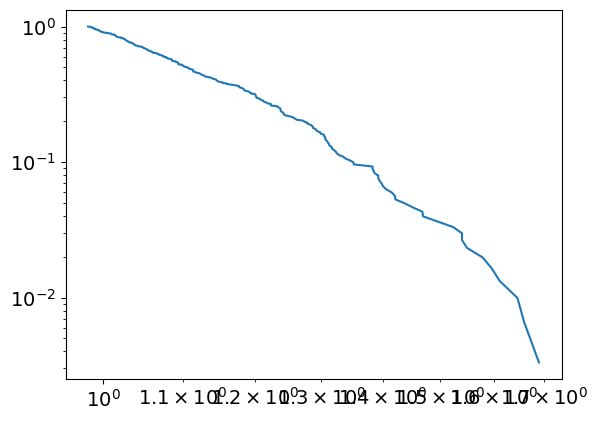

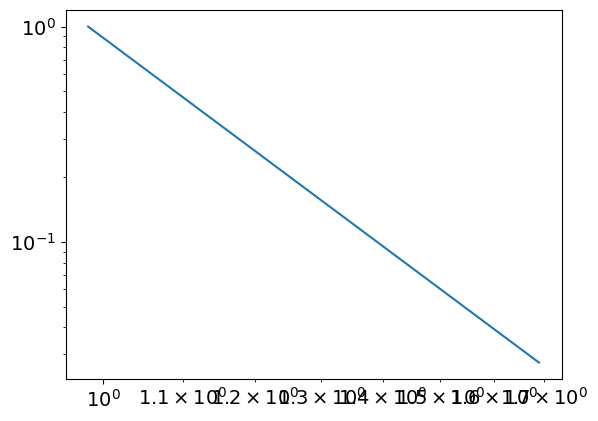

7.627746576902614
0.9817257801870689
powerlaw KstestResult(statistic=0.9965366301580313, pvalue=0.0, statistic_location=1.3999582617004103, statistic_sign=1)
lognorm KstestResult(statistic=0.9915887607945821, pvalue=0.0, statistic_location=1.243709920625774, statistic_sign=1)
tensor(0.0751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2007, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1557, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3981, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
71
tensor(5.3497e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


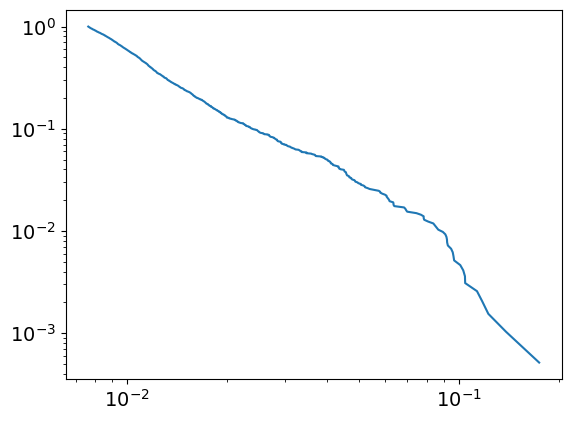

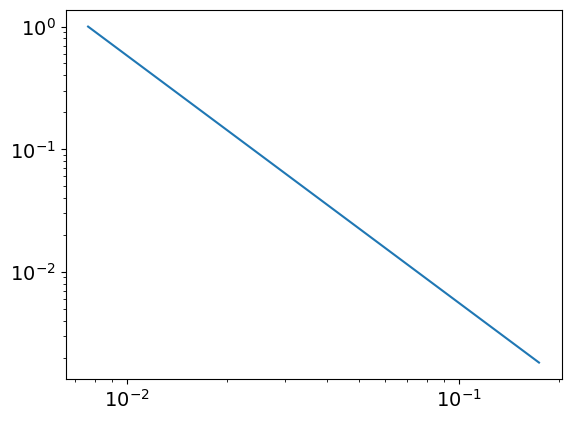

3.0171345502823277
0.007646946519393015
powerlaw KstestResult(statistic=0.9988728810921855, pvalue=0.0, statistic_location=0.1044672925324366, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13874720791678938, statistic_sign=-1)
tensor(-1.1899e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2487, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.0876, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
71
tensor(0.1404, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


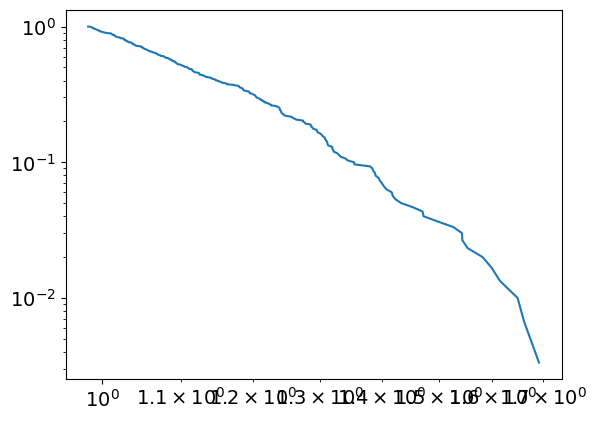

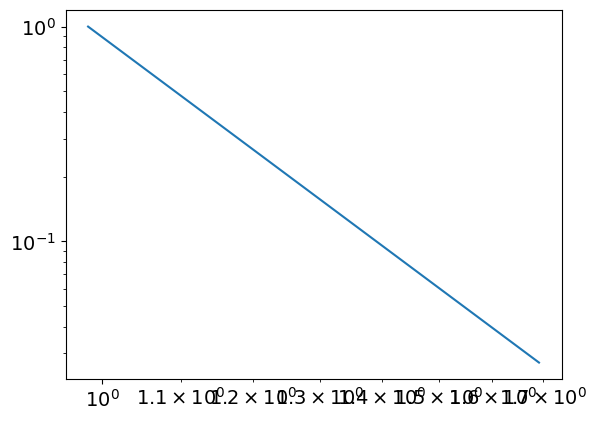

7.643204552634335
0.9833586416236026
powerlaw KstestResult(statistic=0.9965202125138208, pvalue=0.0, statistic_location=1.4081476295768125, statistic_sign=1)
lognorm KstestResult(statistic=0.9915217399342013, pvalue=0.0, statistic_location=1.2445752225013615, statistic_sign=1)
tensor(0.0751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1570, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4013, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
72
tensor(5.1570e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


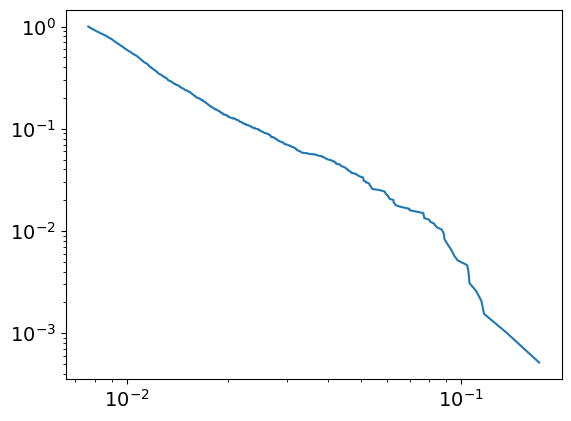

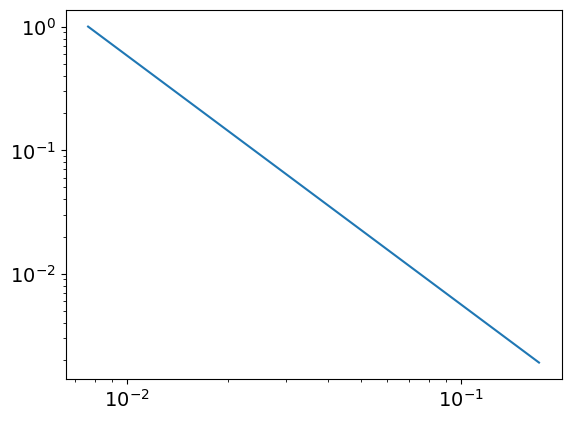

3.0141250342096644
0.0076482113049658376
powerlaw KstestResult(statistic=0.9988557308399417, pvalue=0.0, statistic_location=0.10486929050165535, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1356328691727797, statistic_sign=-1)
tensor(-1.4493e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1915, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.3619, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
72
tensor(0.1408, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


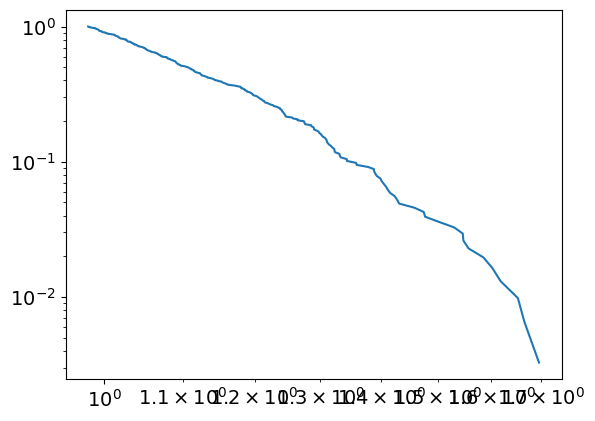

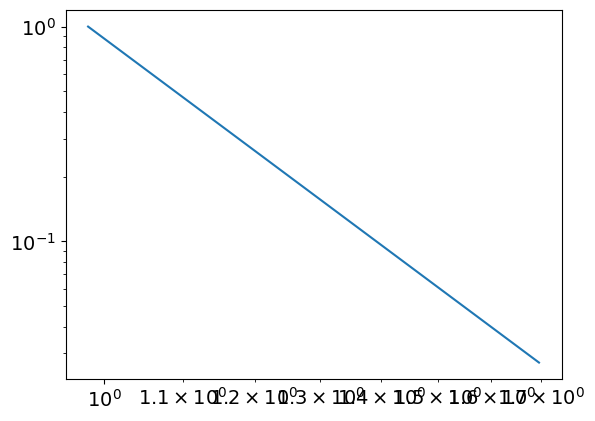

7.582017366481839
0.9803028442535123
powerlaw KstestResult(statistic=0.9963107178245255, pvalue=0.0, statistic_location=1.3584709466416465, statistic_sign=1)
lognorm KstestResult(statistic=0.9914310577555621, pvalue=0.0, statistic_location=1.245660133652627, statistic_sign=1)
tensor(0.0751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2011, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1583, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4043, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
73
tensor(5.8413e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


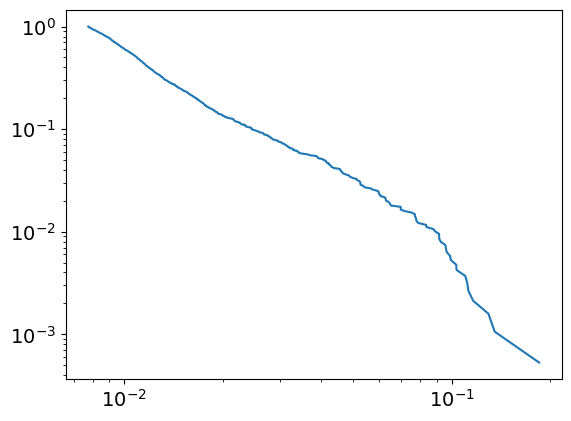

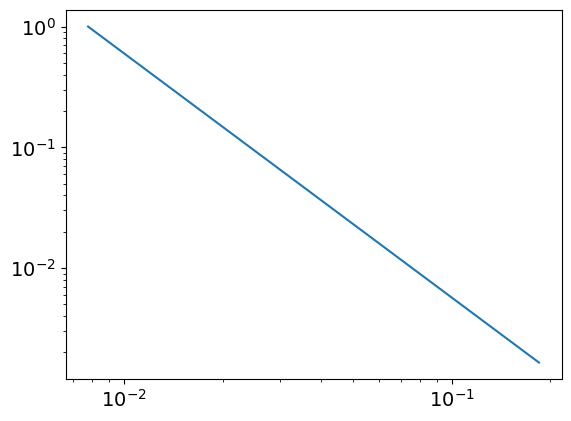

3.021192520448272
0.0077637231540566756
powerlaw KstestResult(statistic=0.9989111624862959, pvalue=0.0, statistic_location=0.10345566473652854, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1353648391525853, statistic_sign=-1)
tensor(-2.1404e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1483, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.3426, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
73
tensor(0.1412, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


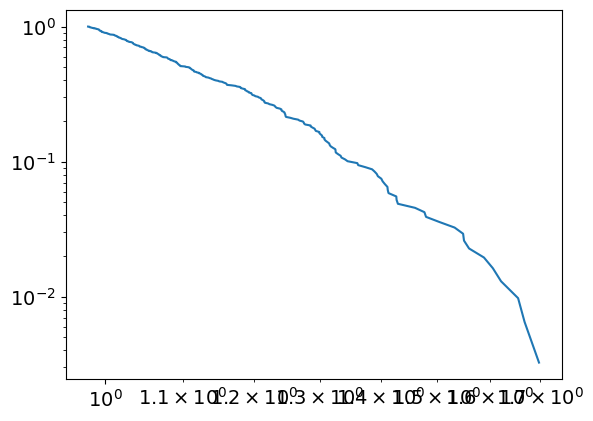

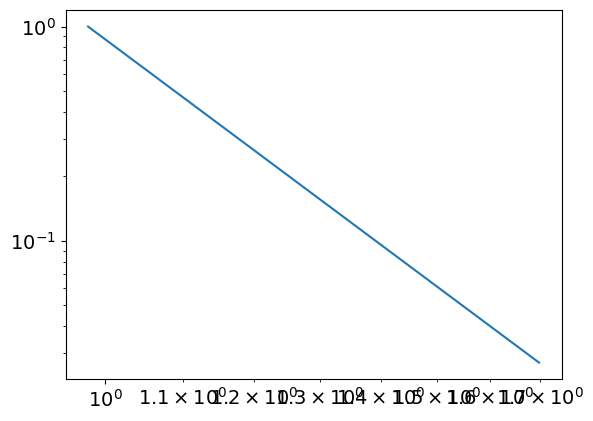

7.564776605084996
0.9796999608597026
powerlaw KstestResult(statistic=0.9962436376070465, pvalue=0.0, statistic_location=1.3621267231430265, statistic_sign=1)
lognorm KstestResult(statistic=0.9912808887105395, pvalue=0.0, statistic_location=1.2472785057311344, statistic_sign=1)
tensor(0.0752, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2012, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1595, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4074, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
74
tensor(6.8103e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


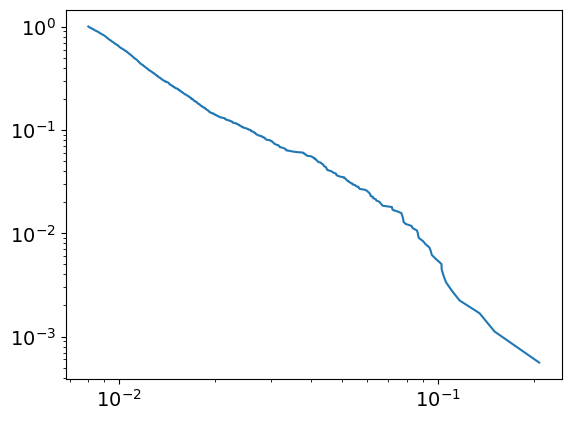

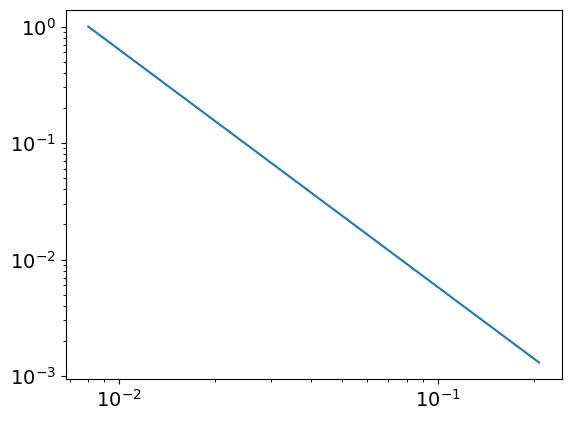

3.0387591225791653
0.008009214370586284
powerlaw KstestResult(statistic=0.9990600319928841, pvalue=0.0, statistic_location=0.10418479938278646, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15071447580198863, statistic_sign=-1)
tensor(-2.0955e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2655, device='cuda:0', grad_fn=<MeanBackward0>) tensor(47.1068, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
74
tensor(0.1416, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


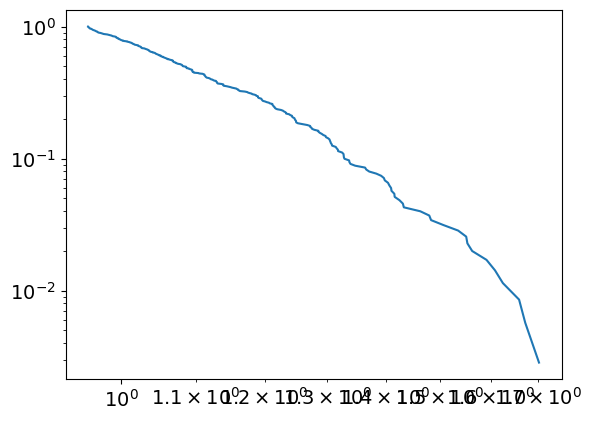

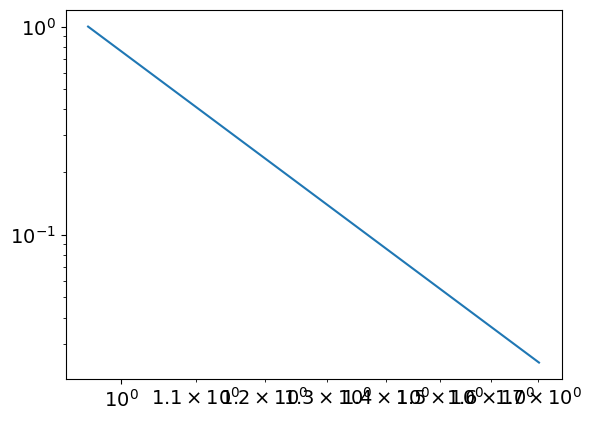

7.479949188122136
0.9587071488056842
powerlaw KstestResult(statistic=0.9958622202062946, pvalue=0.0, statistic_location=1.3368978154145459, statistic_sign=1)
lognorm KstestResult(statistic=0.9910687208360706, pvalue=0.0, statistic_location=1.2493414752349095, statistic_sign=1)
tensor(0.0752, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2014, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1608, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4107, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
75
tensor(5.8871e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


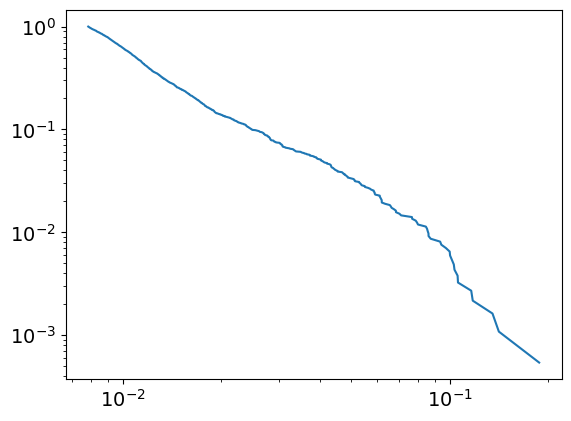

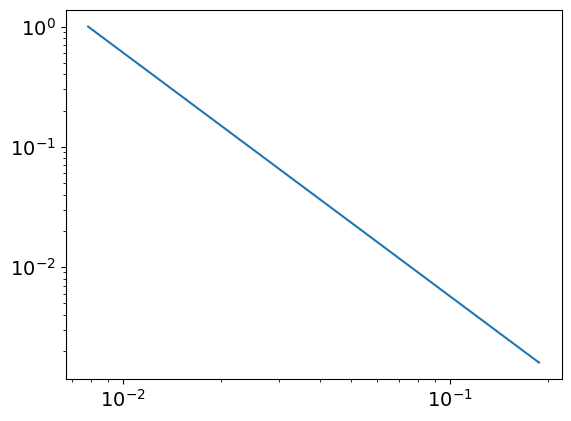

3.027711236021947
0.00784139887145208
powerlaw KstestResult(statistic=0.9989301878769353, pvalue=0.0, statistic_location=0.1032875489598346, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1411518752196385, statistic_sign=-1)
tensor(-1.1941e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2539, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.7710, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
75
tensor(0.1420, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


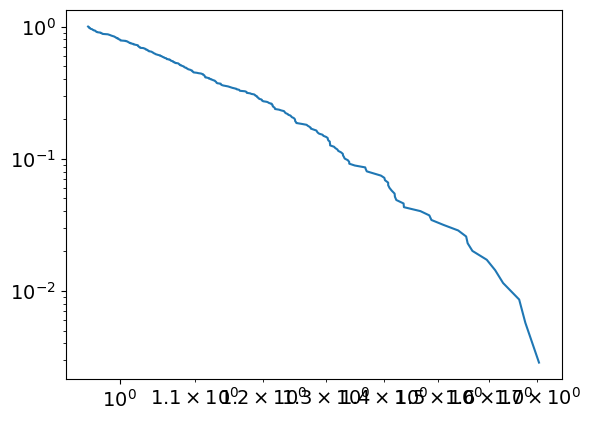

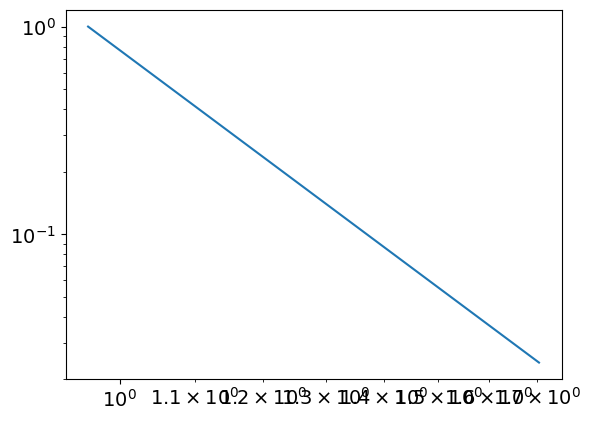

7.499975215588414
0.9607054165488227
powerlaw KstestResult(statistic=0.995872260326683, pvalue=0.0, statistic_location=1.339143132001108, statistic_sign=1)
lognorm KstestResult(statistic=0.9909564622937013, pvalue=0.0, statistic_location=1.2392975105898696, statistic_sign=1)
tensor(0.0753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1620, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4140, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
76
tensor(5.1088e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


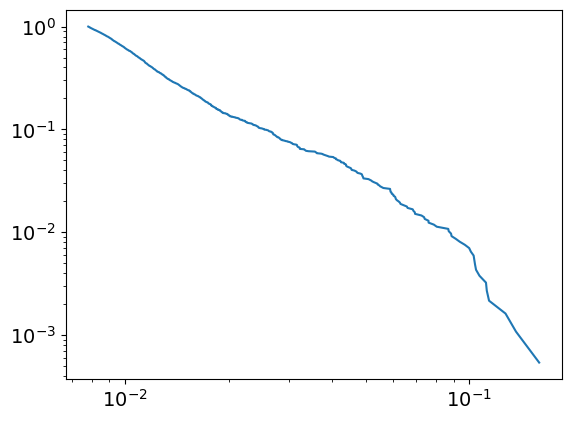

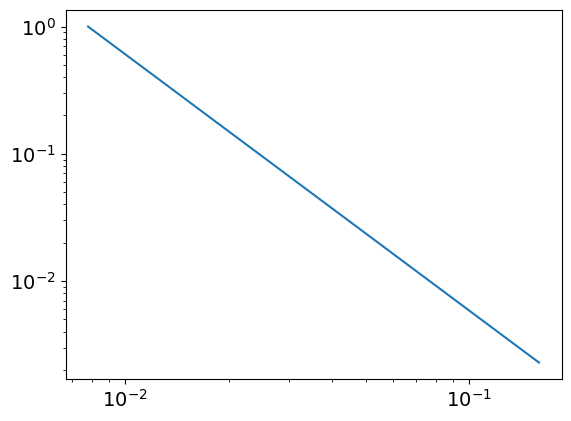

3.015055115053281
0.007807401787147316
powerlaw KstestResult(statistic=0.9987593430364688, pvalue=0.0, statistic_location=0.10395396629671608, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13674942924021116, statistic_sign=-1)
tensor(-9.8015e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1898, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.0409, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
76
tensor(0.1424, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


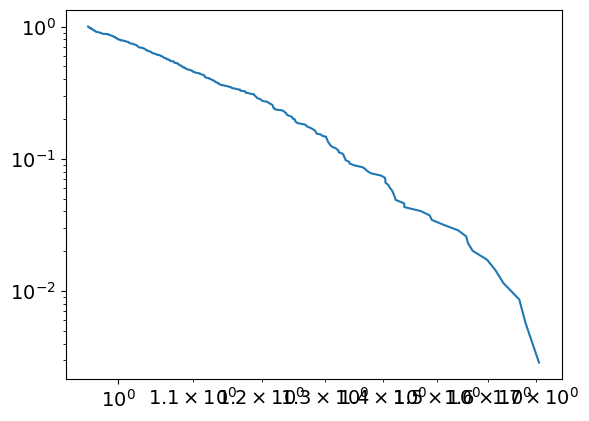

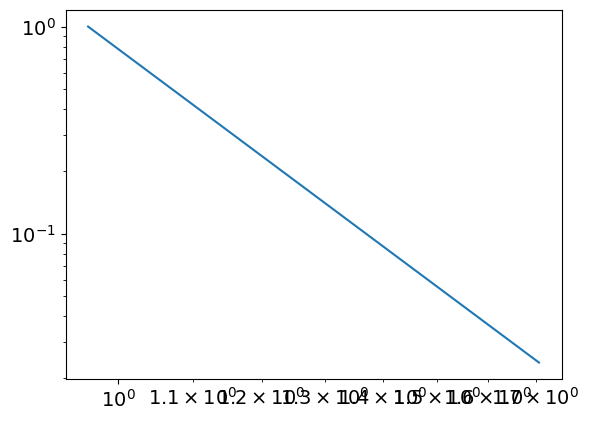

7.5124561186729135
0.9622005264325859
powerlaw KstestResult(statistic=0.9958628017302602, pvalue=0.0, statistic_location=1.3505763766118444, statistic_sign=1)
lognorm KstestResult(statistic=0.990991190658362, pvalue=0.0, statistic_location=1.2388800494432095, statistic_sign=1)
tensor(0.0753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2018, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1632, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4172, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
77
tensor(5.8917e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


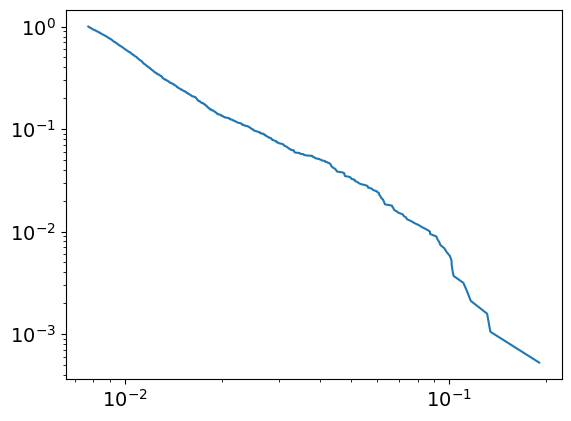

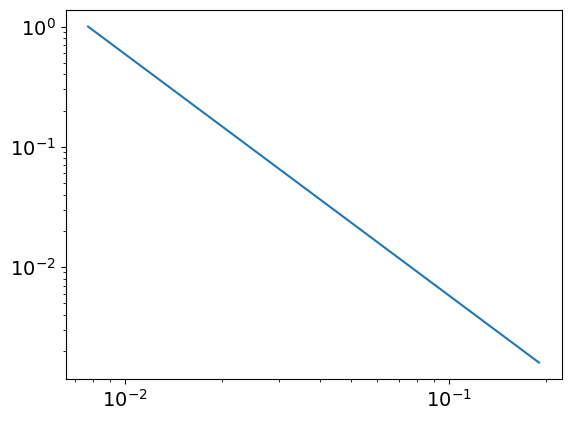

3.0089250173867748
0.007708202860195192
powerlaw KstestResult(statistic=0.9987591557568036, pvalue=0.0, statistic_location=0.10340407347989317, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13423780486913944, statistic_sign=-1)
tensor(-9.1494e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4605, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.3574, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
77
tensor(0.1428, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


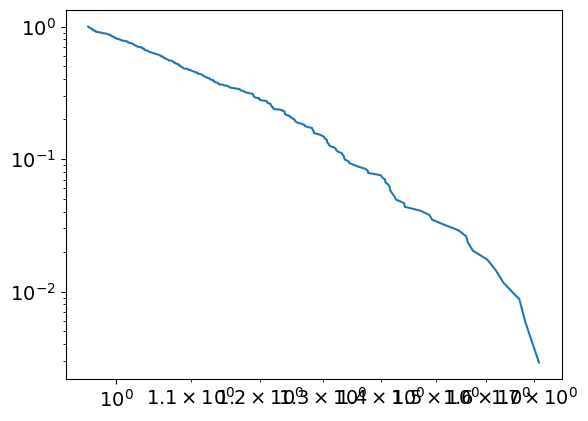

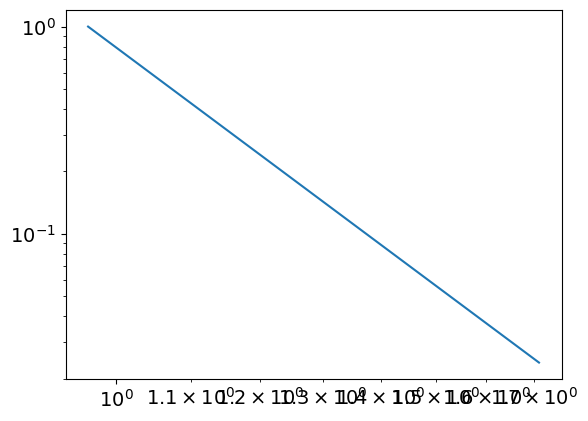

7.522904654263525
0.9648676840070248
powerlaw KstestResult(statistic=0.9958837189971164, pvalue=0.0, statistic_location=1.3524220044446984, statistic_sign=1)
lognorm KstestResult(statistic=0.990901620008469, pvalue=0.0, statistic_location=1.2384021875310327, statistic_sign=1)
tensor(0.0753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2019, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1643, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4204, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
78
tensor(5.2996e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


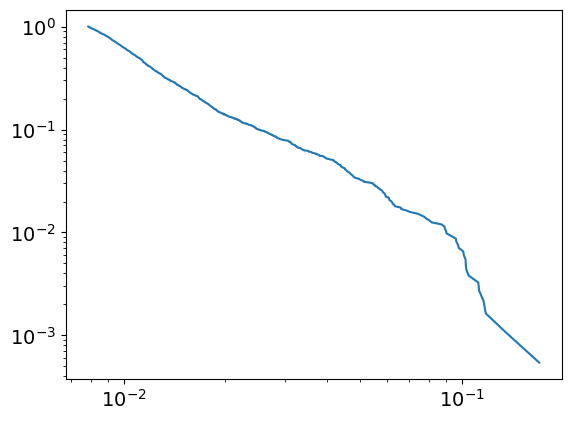

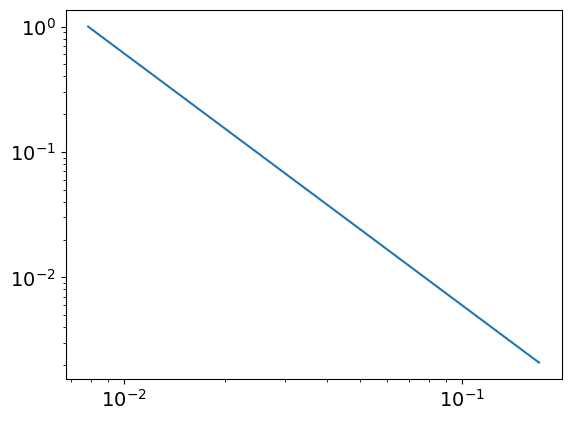

3.009837164116116
0.007854980545005871
powerlaw KstestResult(statistic=0.998784215571041, pvalue=0.0, statistic_location=0.10268064140185222, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1693187979414435, statistic_sign=1)
tensor(2.3295e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4602, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.2102, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
78
tensor(0.1431, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


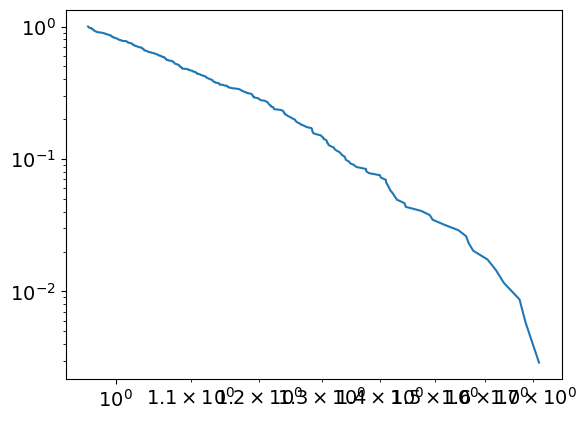

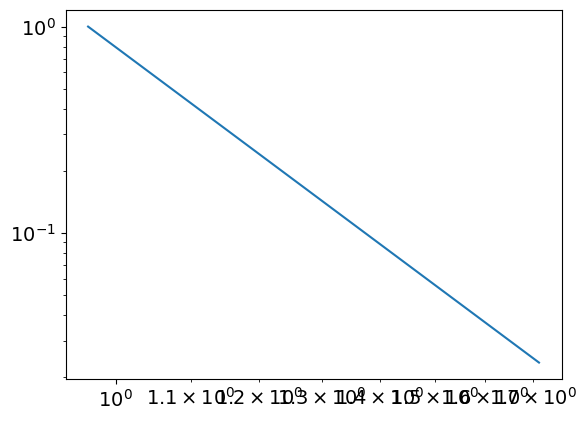

7.538464057506155
0.965473557225672
powerlaw KstestResult(statistic=0.9958760506992839, pvalue=0.0, statistic_location=1.3542785956295238, statistic_sign=1)
lognorm KstestResult(statistic=0.9908298845872066, pvalue=0.0, statistic_location=1.2233851256506252, statistic_sign=1)
tensor(0.0754, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2021, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1654, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4236, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
79
tensor(5.8666e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


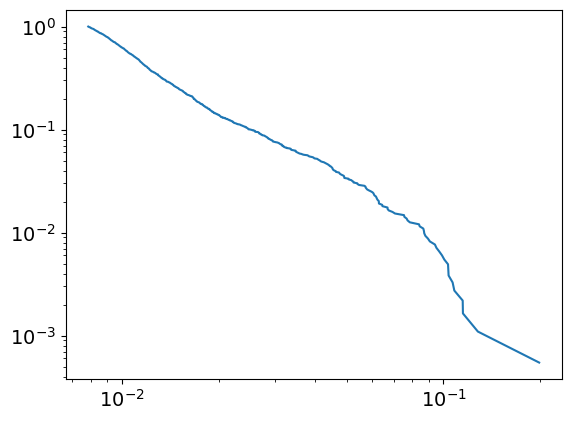

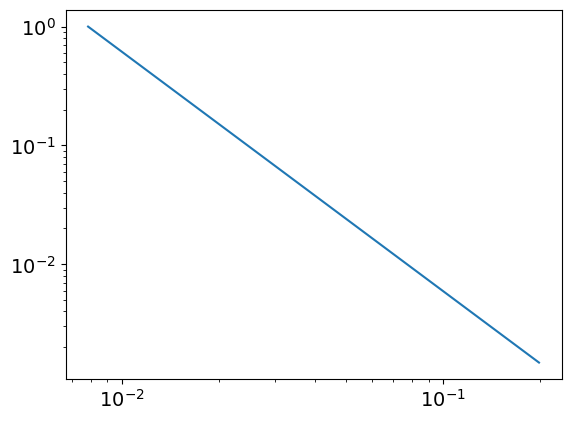

3.0167579811342846
0.007858621136095654
powerlaw KstestResult(statistic=0.9989031473980033, pvalue=0.0, statistic_location=0.10810445765517844, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12795837436159796, statistic_sign=-1)
tensor(-2.8936e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5166, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.0227, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
79
tensor(0.1435, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


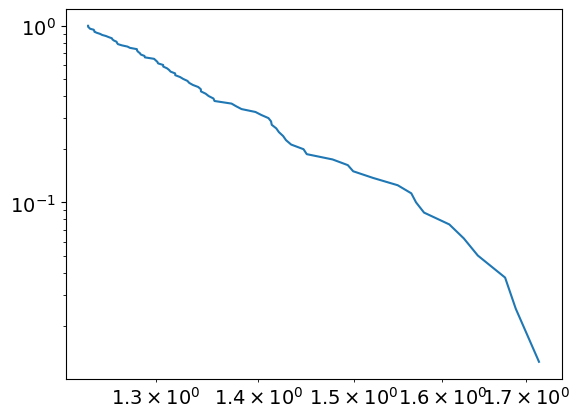

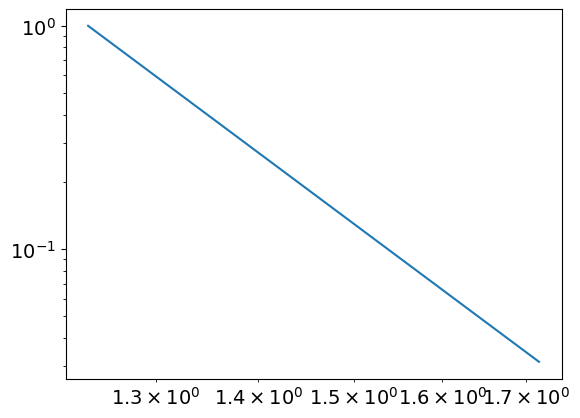

11.595986018929185
1.2373067450910211
powerlaw KstestResult(statistic=0.9998050475182185, pvalue=0.0, statistic_location=1.7159980752804014, statistic_sign=1)
lognorm KstestResult(statistic=0.9907737036892506, pvalue=0.0, statistic_location=1.2252272339957926, statistic_sign=1)
tensor(0.0754, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2022, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1665, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4268, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
80
tensor(6.0375e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


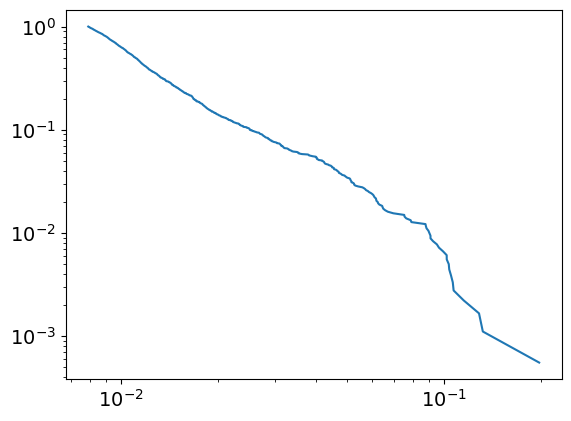

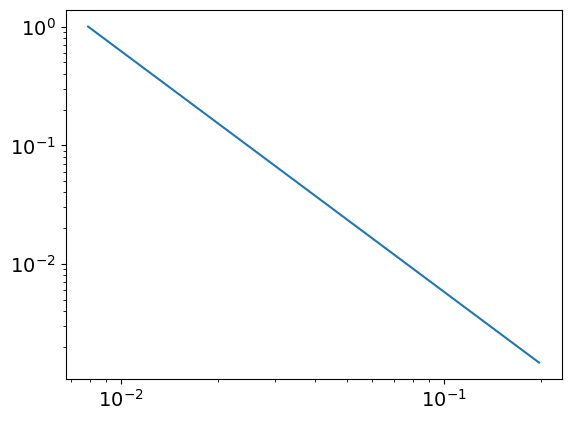

3.028076591041309
0.007912381116935088
powerlaw KstestResult(statistic=0.9989604698750036, pvalue=0.0, statistic_location=0.10700867015005444, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13176963448888432, statistic_sign=-1)
tensor(-2.2844e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4823, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.0401, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
80
tensor(0.1439, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


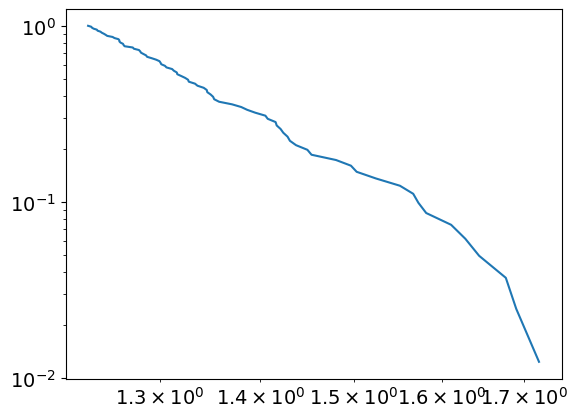

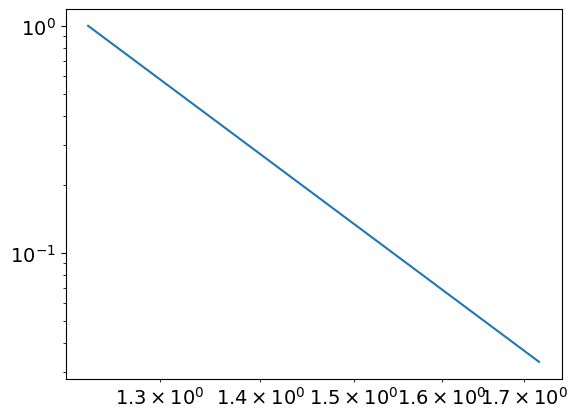

11.255530886904088
1.233085942167372
powerlaw KstestResult(statistic=0.9997235633580537, pvalue=0.0, statistic_location=1.6901491900684613, statistic_sign=1)
lognorm KstestResult(statistic=0.9906943643198032, pvalue=0.0, statistic_location=1.2275330785495489, statistic_sign=1)
tensor(0.0755, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2024, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1676, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4301, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
81
tensor(6.0373e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


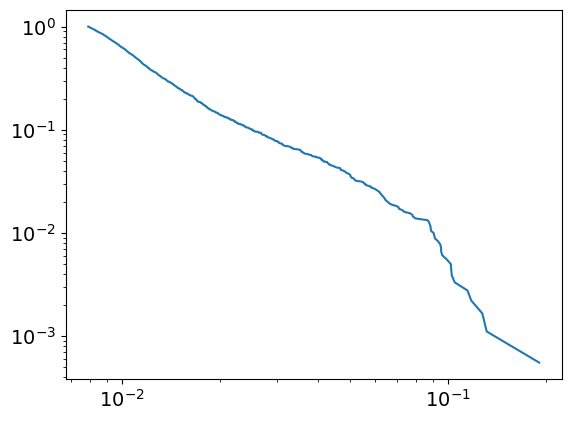

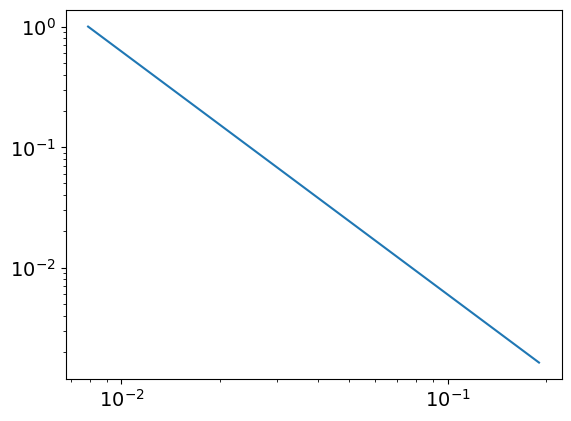

3.0148753442280345
0.007898227124149776
powerlaw KstestResult(statistic=0.9987312052282684, pvalue=0.0, statistic_location=0.10506580618625308, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19079492514144258, statistic_sign=1)
tensor(1.0284e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8479, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.0725, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
81
tensor(0.1442, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


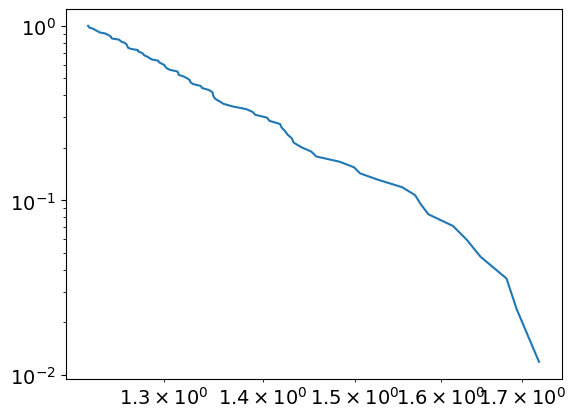

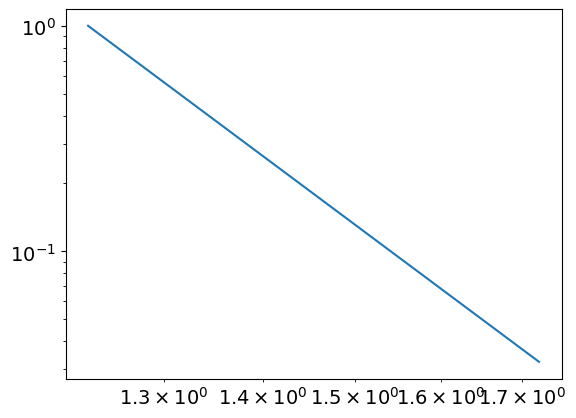

11.171261441564853
1.228716405762261
powerlaw KstestResult(statistic=0.9996833347104762, pvalue=0.0, statistic_location=1.6929210328577031, statistic_sign=1)
lognorm KstestResult(statistic=0.9906006288104285, pvalue=0.0, statistic_location=1.2299552142749373, statistic_sign=1)
tensor(0.0755, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2025, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4334, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
82
tensor(6.2472e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


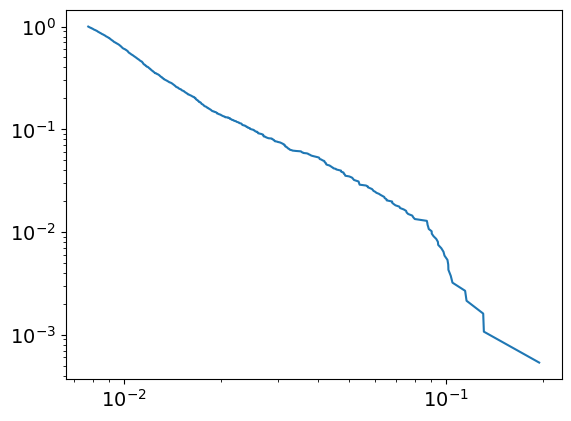

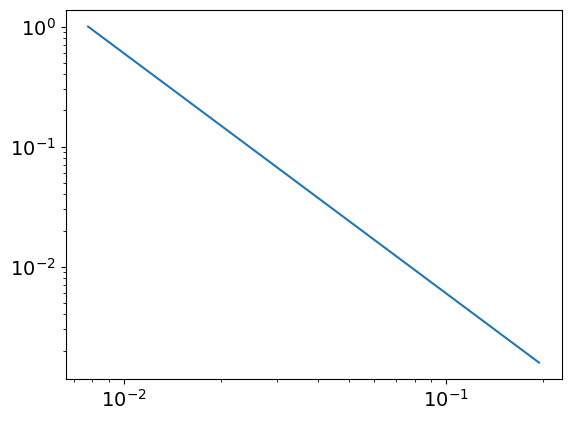

3.0001956817125097
0.0077536222613002
powerlaw KstestResult(statistic=0.9987074848193098, pvalue=0.0, statistic_location=0.10466869134302138, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19446205774513894, statistic_sign=1)
tensor(8.7233e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7803, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.8985, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
82
tensor(0.1446, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


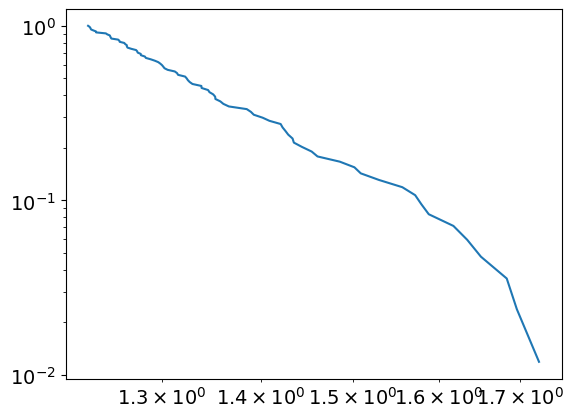

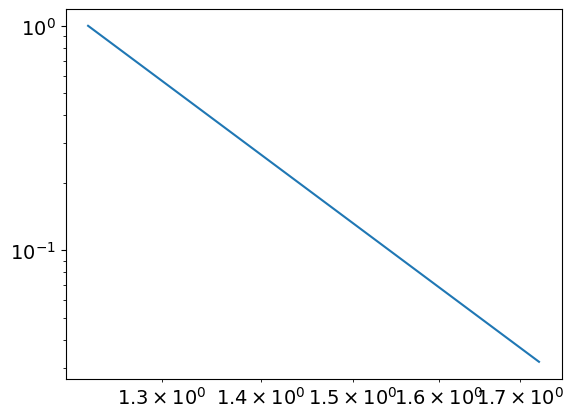

11.220226973483229
1.230495655926983
powerlaw KstestResult(statistic=0.9996854290477681, pvalue=0.0, statistic_location=1.6957955089434507, statistic_sign=1)
lognorm KstestResult(statistic=0.9906011852396887, pvalue=0.0, statistic_location=1.2328067254597959, statistic_sign=1)
tensor(0.0756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2027, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1697, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4366, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
83
tensor(6.3351e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


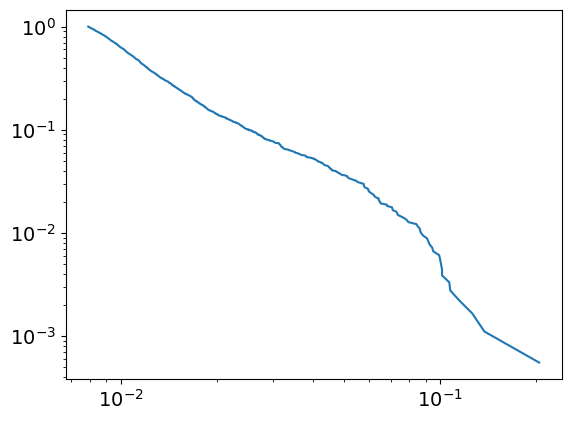

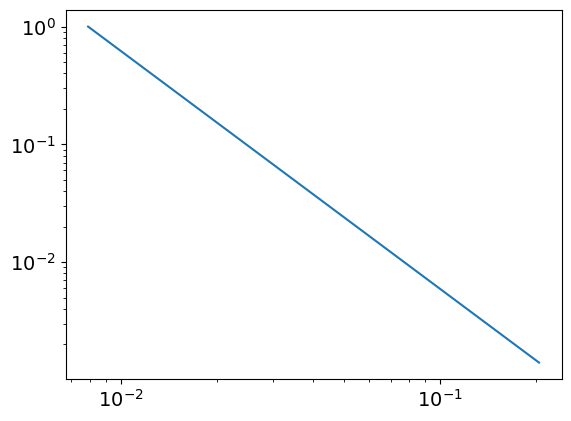

3.0216759974300746
0.007908533978811841
powerlaw KstestResult(statistic=0.9989713924427926, pvalue=0.0, statistic_location=0.10129014080278273, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13744284655657088, statistic_sign=-1)
tensor(-2.9074e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5229, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.2031, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
83
tensor(0.1450, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


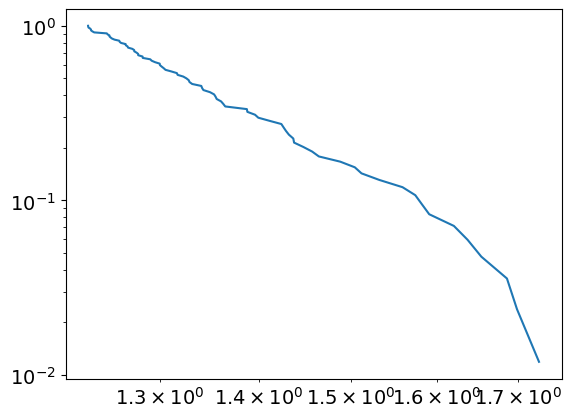

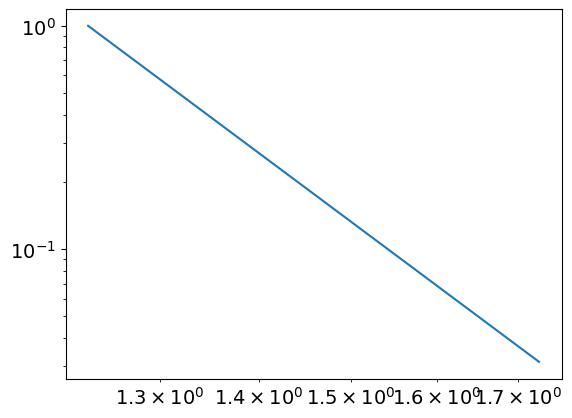

11.261881364652991
1.232039792541998
powerlaw KstestResult(statistic=0.9996863580549316, pvalue=0.0, statistic_location=1.698451922379967, statistic_sign=1)
lognorm KstestResult(statistic=0.9906279924505041, pvalue=0.0, statistic_location=1.2348181201881372, statistic_sign=1)
tensor(0.0756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2028, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1707, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4400, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
84
tensor(5.2646e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


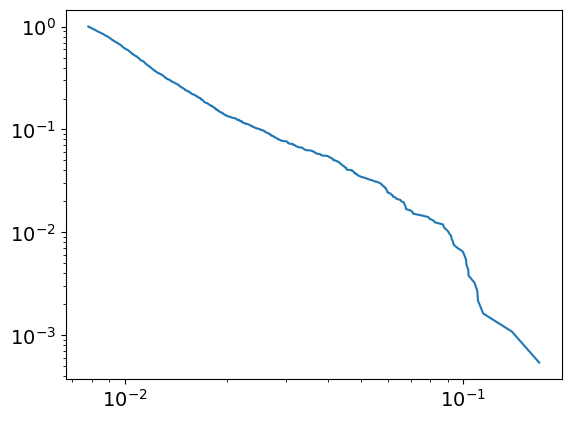

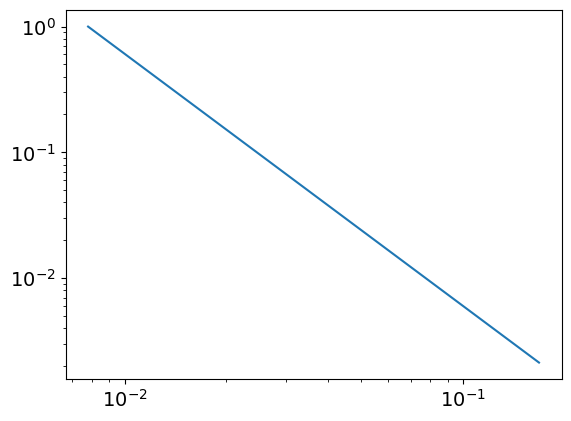

3.0058049504924664
0.007804819765777039
powerlaw KstestResult(statistic=0.9988803780619759, pvalue=0.0, statistic_location=0.10350151612213902, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16770978994228383, statistic_sign=1)
tensor(9.3811e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2938, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.5148, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
84
tensor(0.1453, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


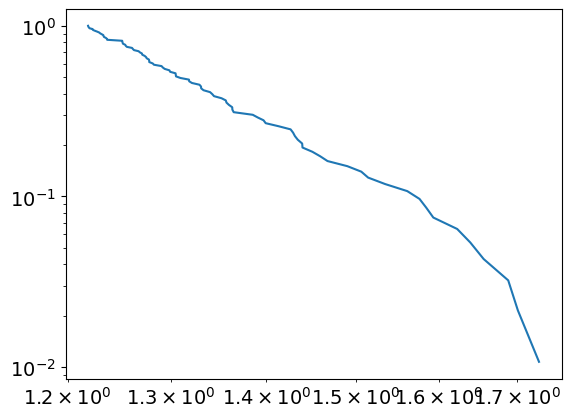

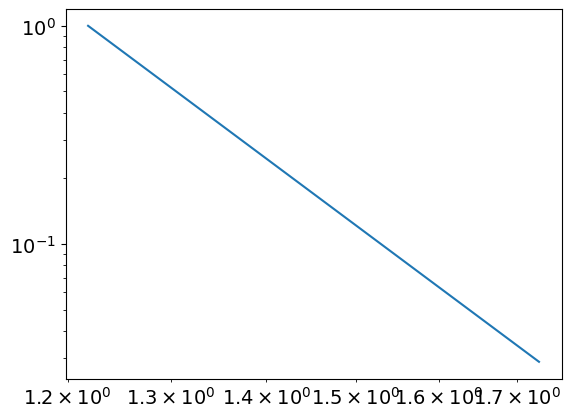

11.149320967411303
1.219261171074794
powerlaw KstestResult(statistic=0.999581065698601, pvalue=0.0, statistic_location=1.7010894817413198, statistic_sign=1)
lognorm KstestResult(statistic=0.9906066953277789, pvalue=0.0, statistic_location=1.2374566153266358, statistic_sign=1)
tensor(0.0756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2029, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1716, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4432, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
85
tensor(5.1784e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


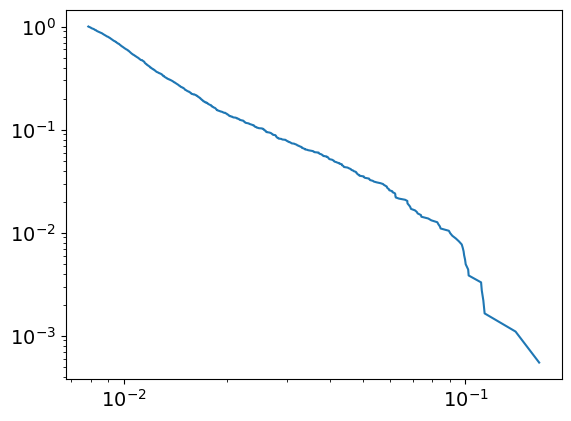

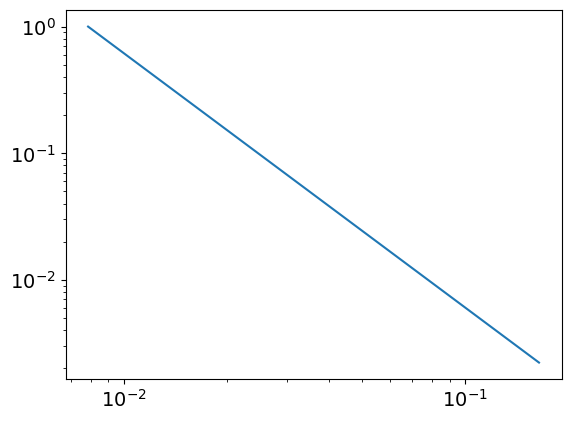

3.009434324967033
0.007860205498173607
powerlaw KstestResult(statistic=0.9987964591358568, pvalue=0.0, statistic_location=0.10219076745673257, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14017161658771007, statistic_sign=-1)
tensor(-1.5103e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2199, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.0621, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
85
tensor(0.1457, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


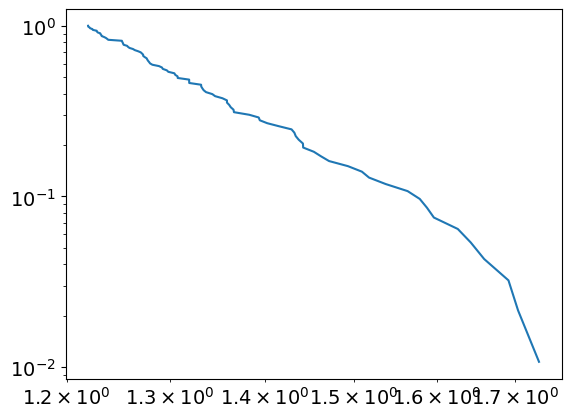

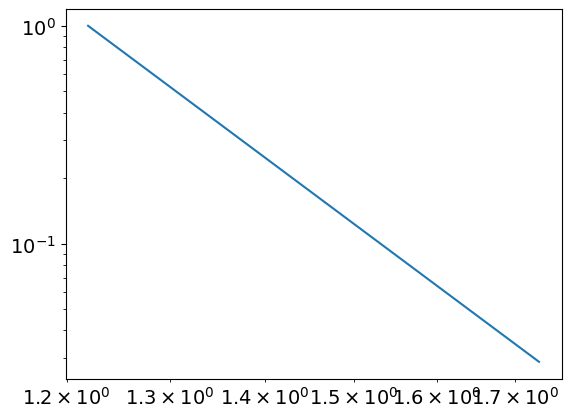

11.142632039026255
1.220270475011242
powerlaw KstestResult(statistic=0.9995683788573926, pvalue=0.0, statistic_location=1.70373327461698, statistic_sign=1)
lognorm KstestResult(statistic=0.990474564943104, pvalue=0.0, statistic_location=1.239535841416449, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2031, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1726, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4466, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
86
tensor(4.8095e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


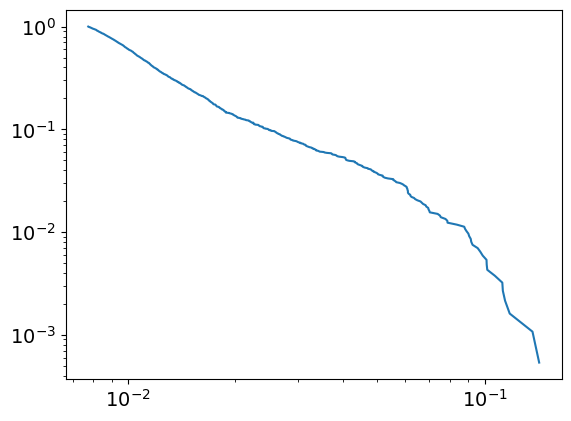

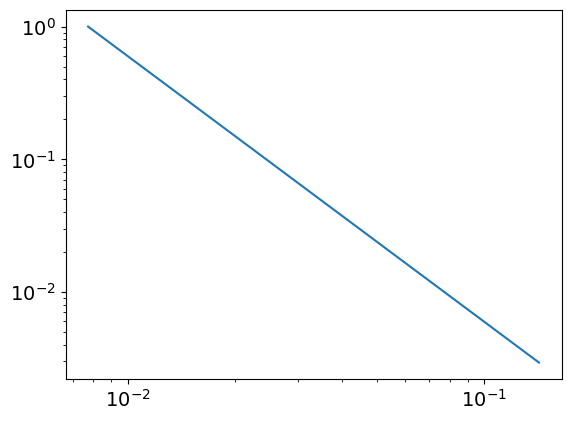

3.002782248552286
0.007738831178991743
powerlaw KstestResult(statistic=0.9986762549239483, pvalue=0.0, statistic_location=0.10129678546104288, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.13630317390889532, statistic_sign=1)
tensor(4.2504e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1044, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4114, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
86
tensor(0.1460, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


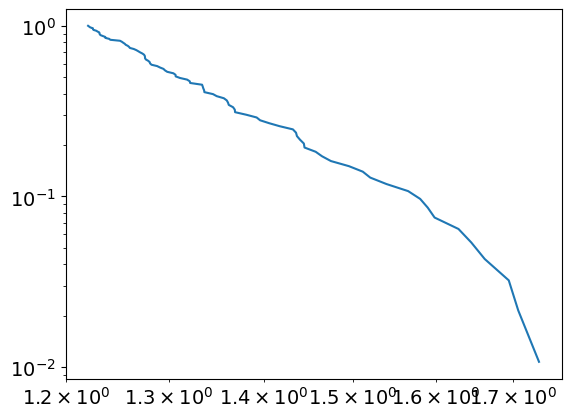

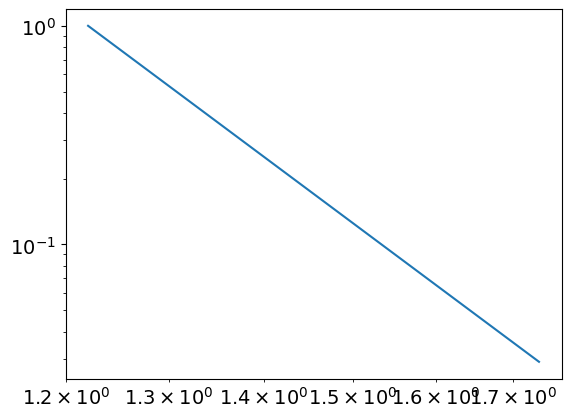

11.07160908305859
1.2204886311464649
powerlaw KstestResult(statistic=0.9995345462818604, pvalue=0.0, statistic_location=1.706310003502606, statistic_sign=1)
lognorm KstestResult(statistic=0.990383017702895, pvalue=0.0, statistic_location=1.2370207125257215, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2032, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1735, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4500, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
87
tensor(4.6719e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


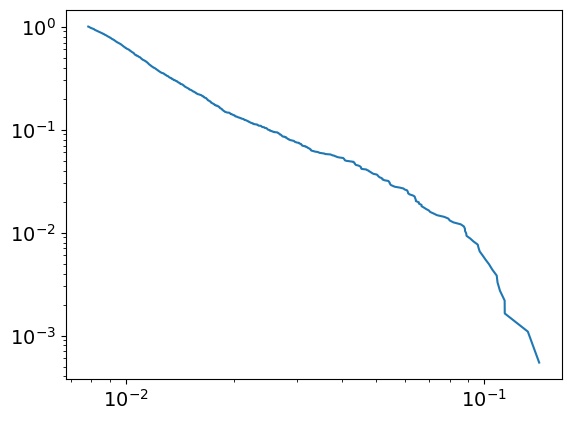

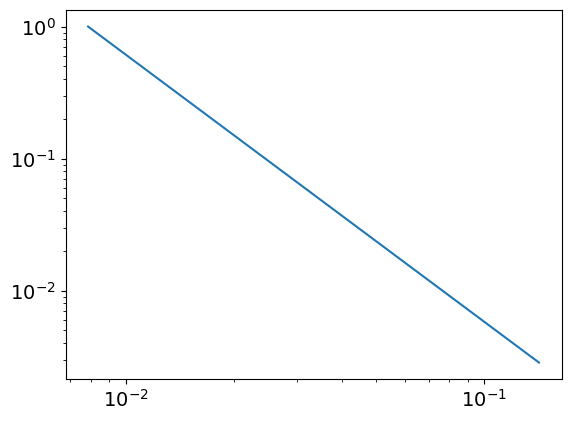

3.0227167499304786
0.007844006532136025
powerlaw KstestResult(statistic=0.9988691861701271, pvalue=0.0, statistic_location=0.10521885596447964, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14222162544141678, statistic_sign=-1)
tensor(-4.6376e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0623, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3528, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
87
tensor(0.1463, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


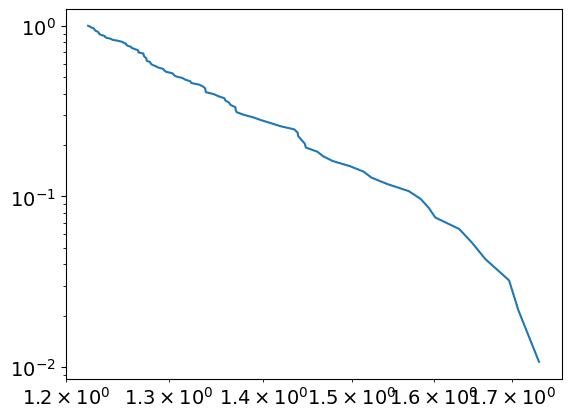

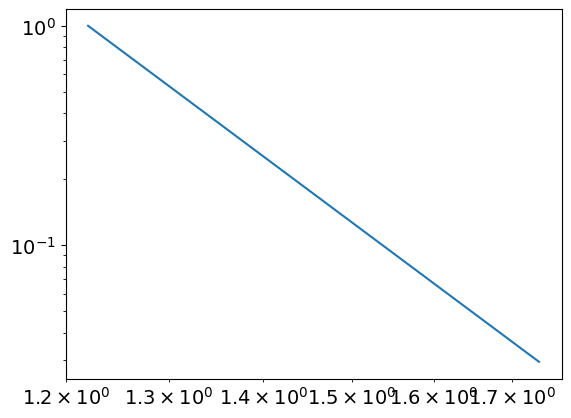

11.000906692778686
1.2206750247097882
powerlaw KstestResult(statistic=0.9994973641236938, pvalue=0.0, statistic_location=1.7088583025106652, statistic_sign=1)
lognorm KstestResult(statistic=0.9902864713644585, pvalue=0.0, statistic_location=1.2386176942659832, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2033, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4534, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
88
tensor(5.2496e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


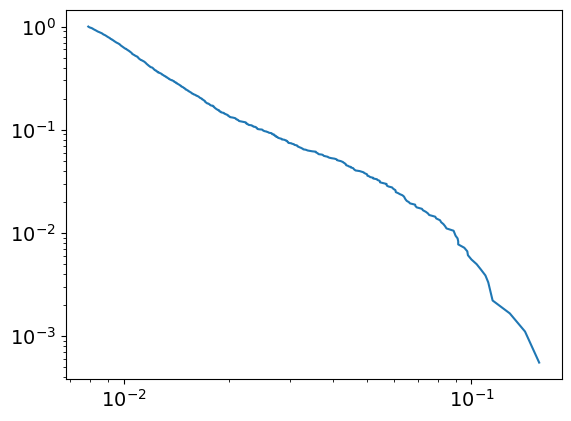

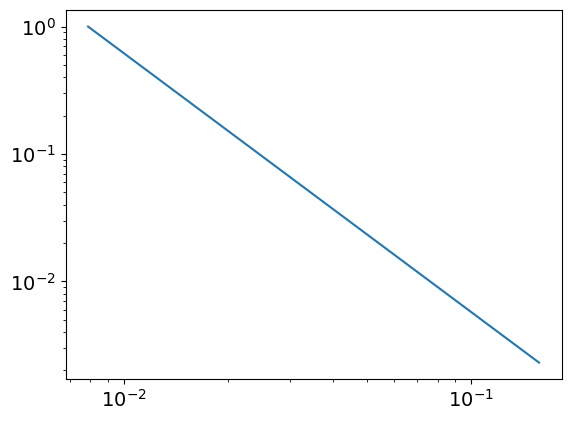

3.031844398166895
0.007885486919870175
powerlaw KstestResult(statistic=0.9989329839251352, pvalue=0.0, statistic_location=0.10352928331869152, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14266284079545458, statistic_sign=-1)
tensor(-9.6457e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0547, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.7778, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
88
tensor(0.1467, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


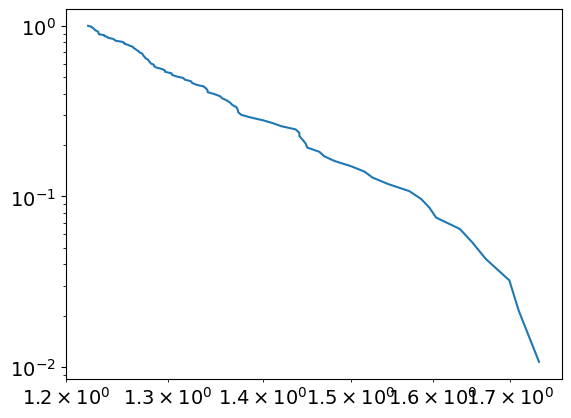

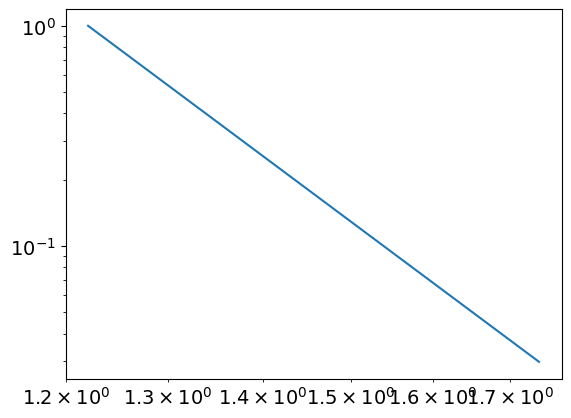

10.928488655274789
1.2208719375752295
powerlaw KstestResult(statistic=0.9994660701821027, pvalue=0.0, statistic_location=1.6680021589916092, statistic_sign=1)
lognorm KstestResult(statistic=0.9901783560069372, pvalue=0.0, statistic_location=1.2402651914682918, statistic_sign=1)
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2035, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4568, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
89
tensor(5.0674e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


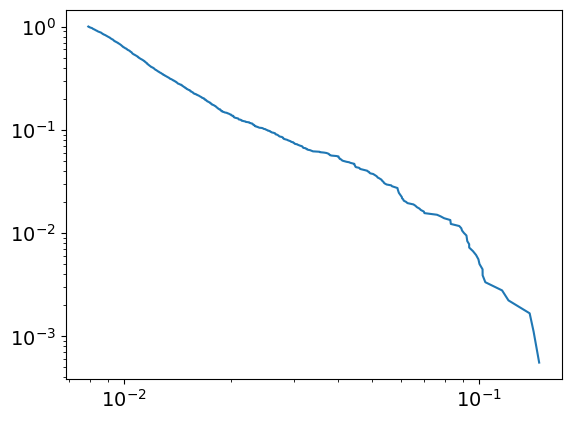

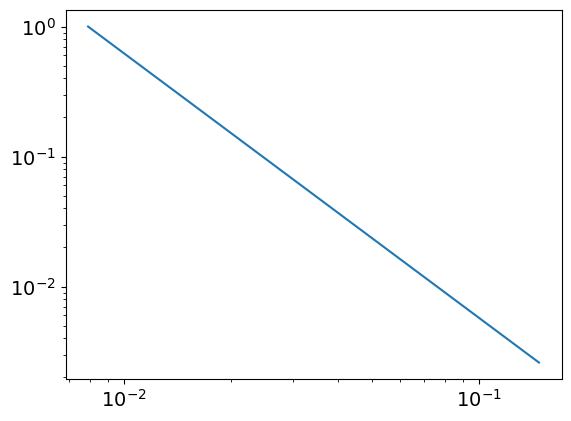

3.035909793079636
0.007925978978375124
powerlaw KstestResult(statistic=0.9990257768558721, pvalue=0.0, statistic_location=0.10011098523620705, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1421538457991431, statistic_sign=-1)
tensor(-1.3463e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2123, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.3529, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
89
tensor(0.1470, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


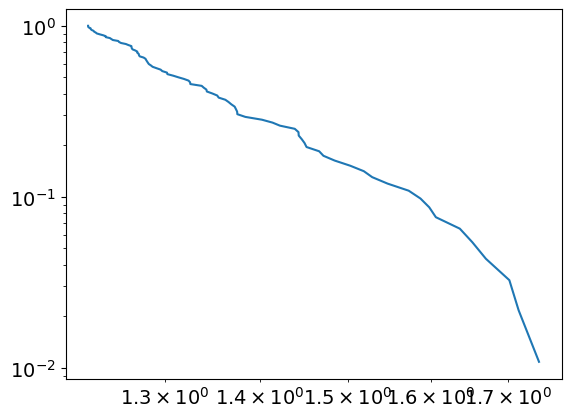

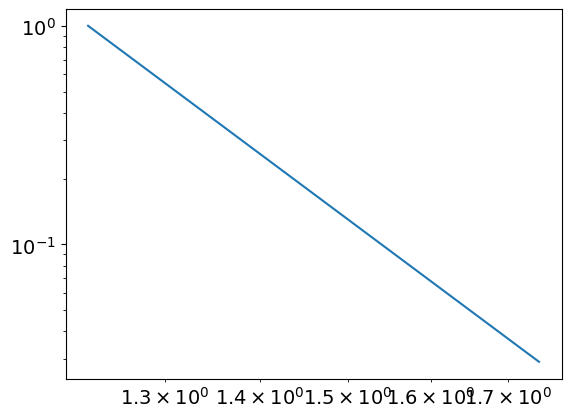

11.057269879856554
1.2247133792259275
powerlaw KstestResult(statistic=0.9995051181705293, pvalue=0.0, statistic_location=1.71375952569312, statistic_sign=1)
lognorm KstestResult(statistic=0.990091717034467, pvalue=0.0, statistic_location=1.2330836069785338, statistic_sign=1)
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2036, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4603, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
90
tensor(4.8361e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


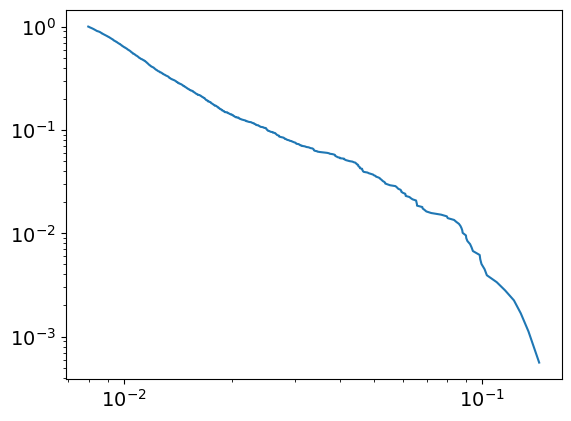

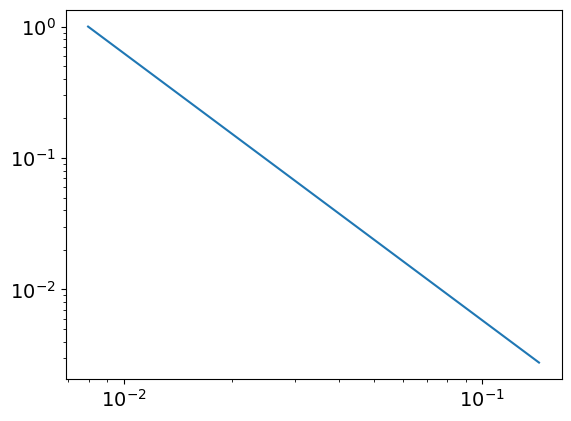

3.0315417097651776
0.007950612321842548
powerlaw KstestResult(statistic=0.9989832269659769, pvalue=0.0, statistic_location=0.10157817131733352, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14425020612028777, statistic_sign=1)
tensor(7.2872e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0799, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7343, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
90
tensor(0.1473, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


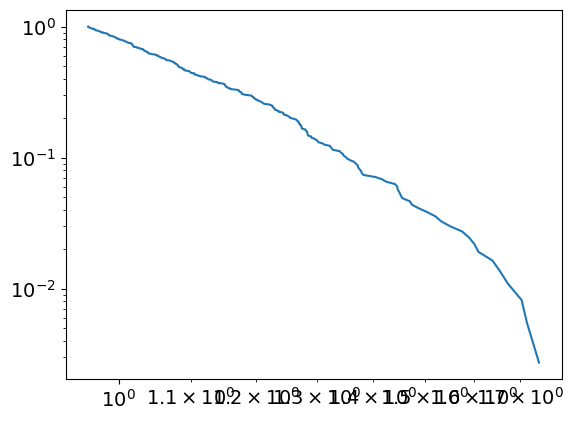

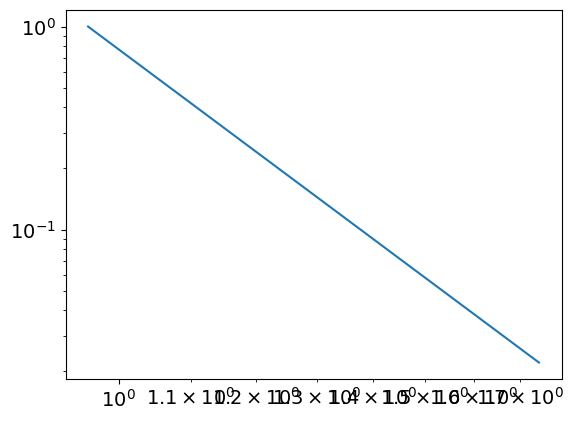

7.393177191624591
0.9605714902442481
powerlaw KstestResult(statistic=0.9950863989824892, pvalue=0.0, statistic_location=1.3791043418427316, statistic_sign=1)
lognorm KstestResult(statistic=0.990081858167548, pvalue=0.0, statistic_location=1.2357633554080953, statistic_sign=1)
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2037, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1770, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4638, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
91
tensor(4.8549e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


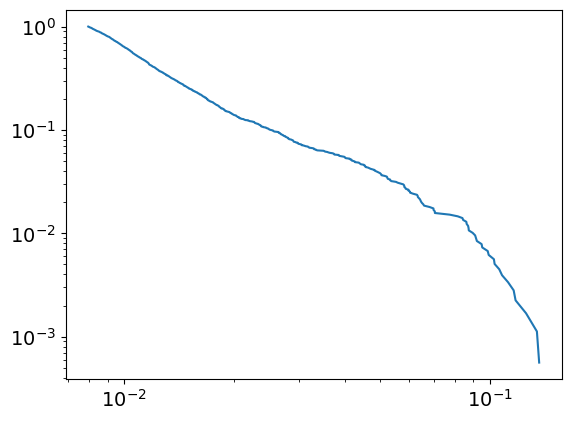

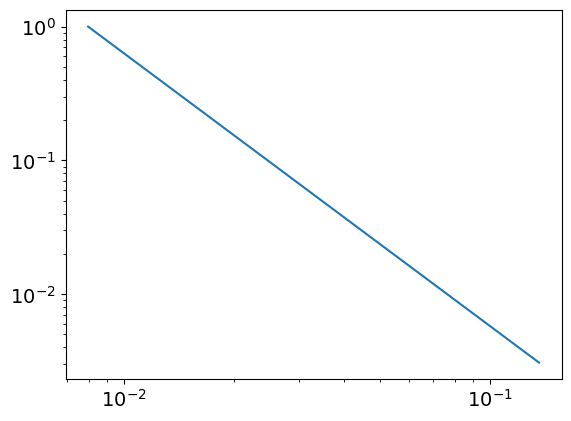

3.037757990381472
0.007969713270343085
powerlaw KstestResult(statistic=0.9988436453106767, pvalue=0.0, statistic_location=0.11183951373545195, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.13414856277859366, statistic_sign=1)
tensor(3.7084e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1771, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.2489, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
91
tensor(0.1477, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


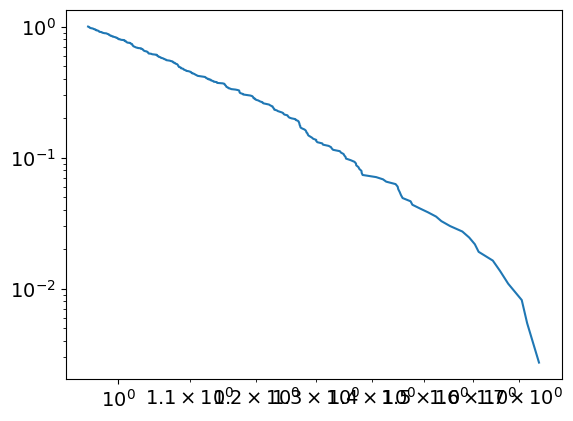

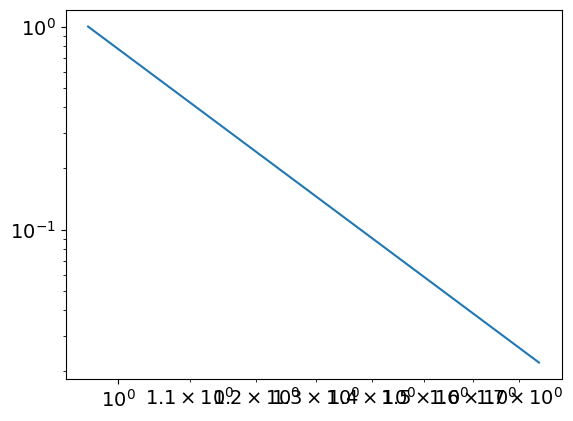

7.384411432604672
0.9609537821818467
powerlaw KstestResult(statistic=0.9949956451321814, pvalue=0.0, statistic_location=1.382194782680096, statistic_sign=1)
lognorm KstestResult(statistic=0.9899889481967518, pvalue=0.0, statistic_location=1.229739236426675, statistic_sign=1)
tensor(0.0759, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2038, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1778, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4673, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
92
tensor(5.5442e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


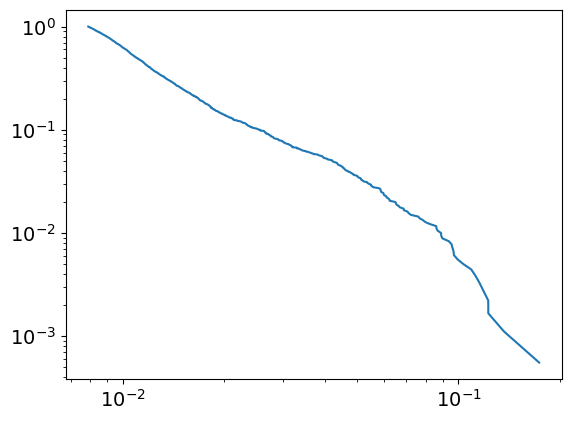

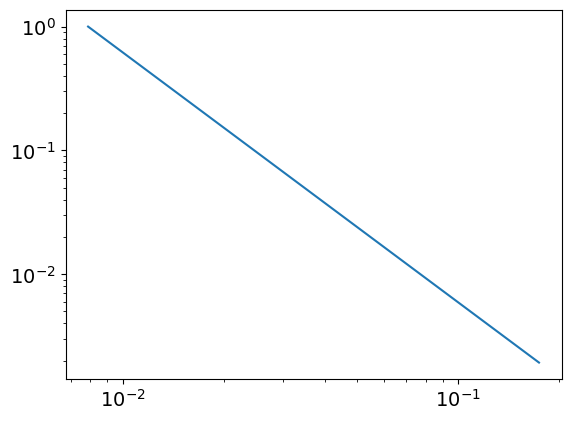

3.0209628697339674
0.007896897715829
powerlaw KstestResult(statistic=0.9988184990814002, pvalue=0.0, statistic_location=0.09694903690993424, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17396003946613092, statistic_sign=1)
tensor(1.3395e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2438, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.1366, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
92
tensor(0.1480, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


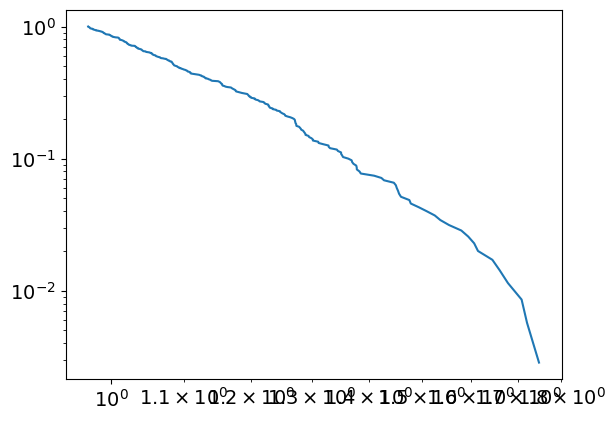

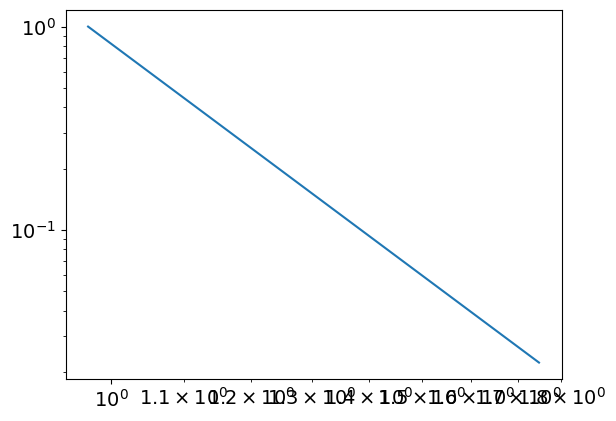

7.466210558406271
0.9701808363384952
powerlaw KstestResult(statistic=0.995275339490705, pvalue=0.0, statistic_location=1.3852370249470591, statistic_sign=1)
lognorm KstestResult(statistic=0.9900118229494694, pvalue=0.0, statistic_location=1.2347667992590425, statistic_sign=1)
tensor(0.0759, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2039, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1786, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4708, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
93
tensor(5.2754e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


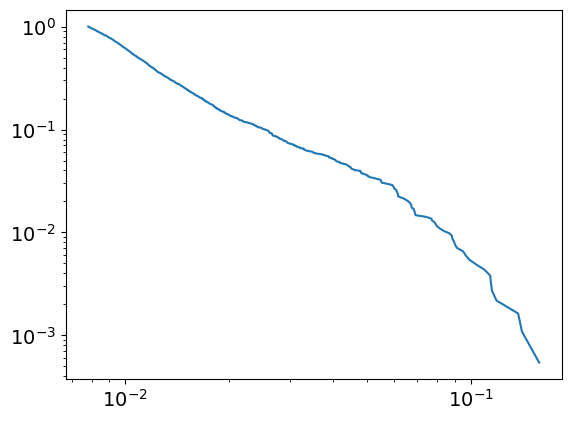

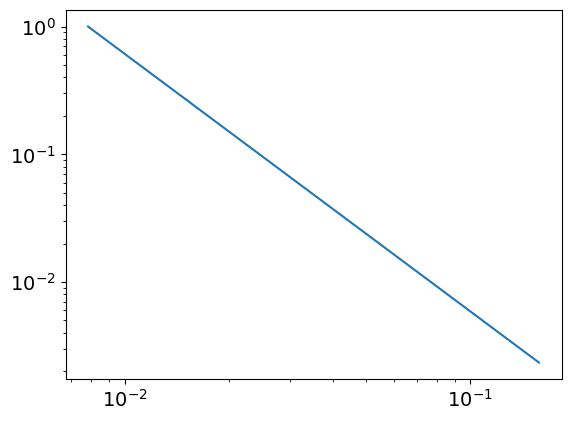

3.015877789515051
0.007823279781320929
powerlaw KstestResult(statistic=0.9988121440948561, pvalue=0.0, statistic_location=0.09679053071118542, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13728755231858666, statistic_sign=-1)
tensor(-2.5464e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2435, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.1897, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
93
tensor(0.1483, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


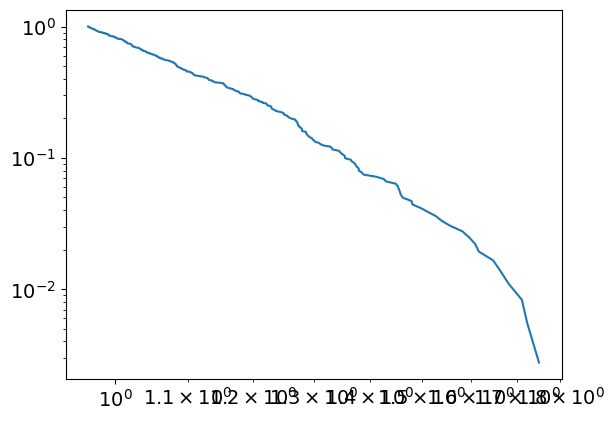

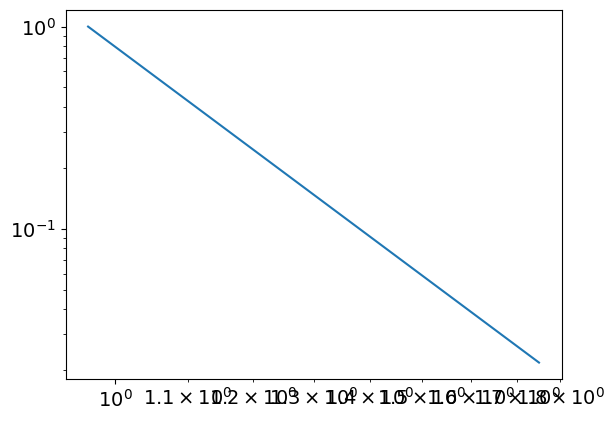

7.422692420141568
0.9645931791953131
powerlaw KstestResult(statistic=0.994980835110915, pvalue=0.0, statistic_location=1.3882148163205925, statistic_sign=1)
lognorm KstestResult(statistic=0.9899947919014822, pvalue=0.0, statistic_location=1.2351272533119657, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2040, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1793, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4743, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
94
tensor(5.0989e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


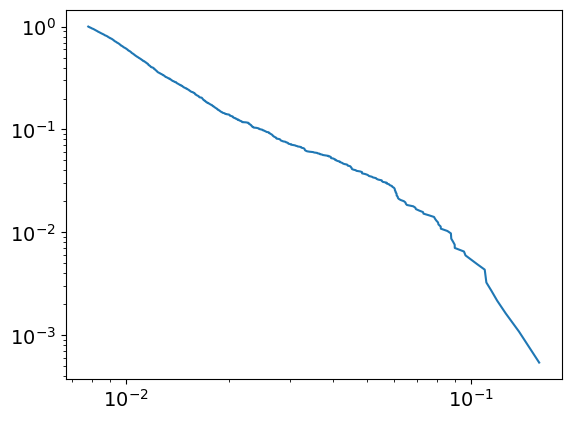

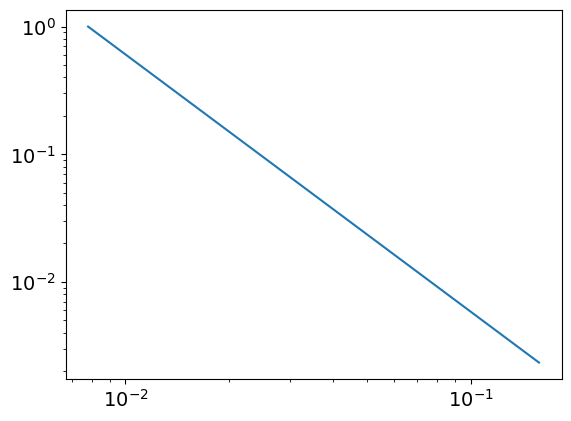

3.0156937729184294
0.00779929185392529
powerlaw KstestResult(statistic=0.9988304236803133, pvalue=0.0, statistic_location=0.08988514108831461, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13794905176434905, statistic_sign=-1)
tensor(-4.2429e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1325, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.2815, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
94
tensor(0.1487, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


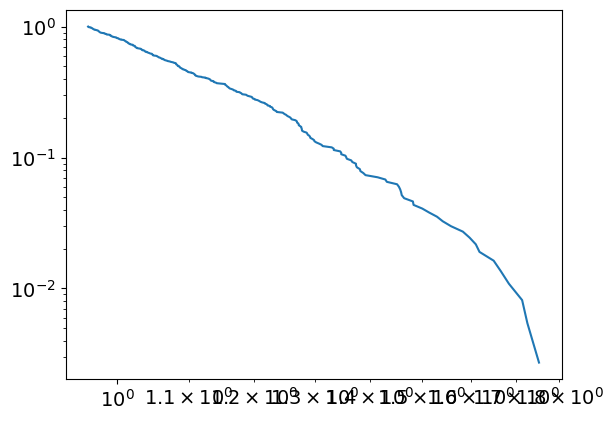

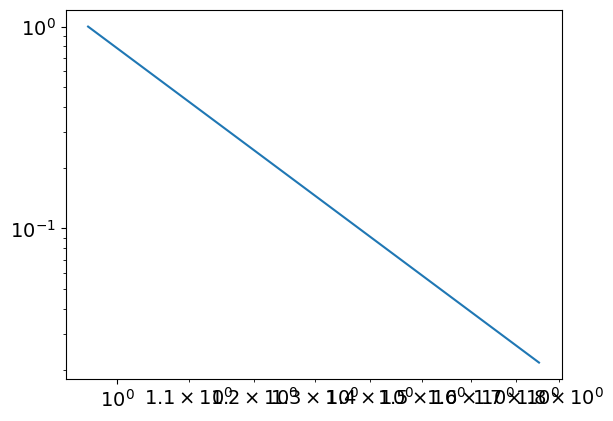

7.389374490263994
0.9618992042001189
powerlaw KstestResult(statistic=0.9947870494294327, pvalue=0.0, statistic_location=1.381794358796216, statistic_sign=1)
lognorm KstestResult(statistic=0.9900580566706114, pvalue=0.0, statistic_location=1.2363323799403185, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2042, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1801, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4779, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
95
tensor(5.4432e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


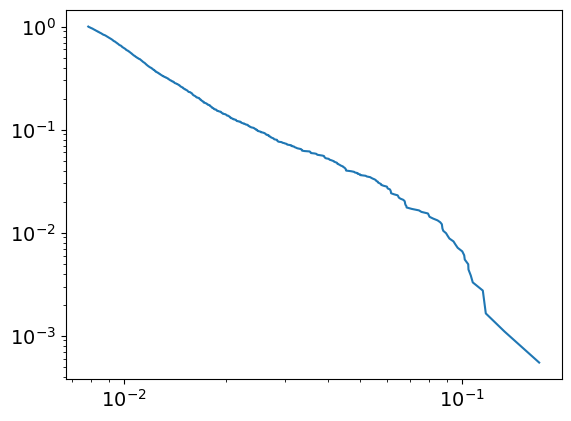

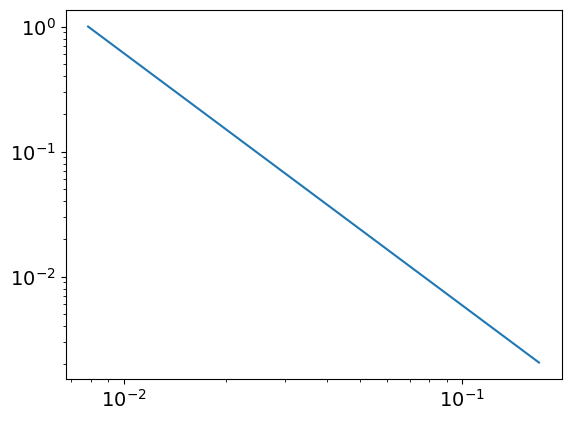

3.0163534632350166
0.007837945129382046
powerlaw KstestResult(statistic=0.9987935775614415, pvalue=0.0, statistic_location=0.10743267801201267, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13338552001639203, statistic_sign=-1)
tensor(-1.4772e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2715, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.4332, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
95
tensor(0.1490, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


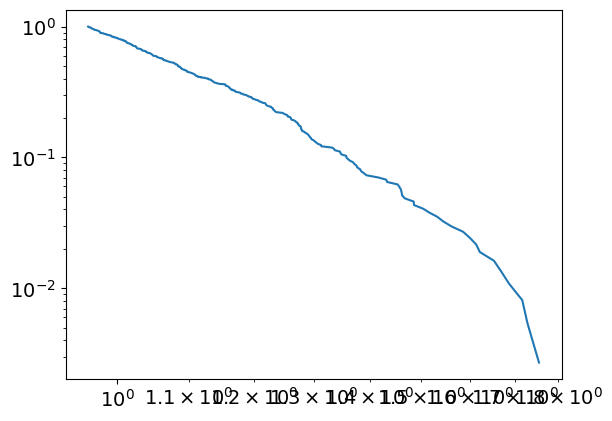

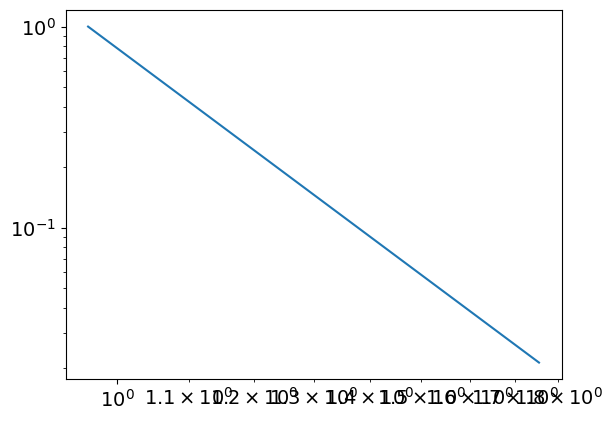

7.399208646379212
0.96185515269995
powerlaw KstestResult(statistic=0.9947304561492881, pvalue=0.0, statistic_location=1.3841649960821527, statistic_sign=1)
lognorm KstestResult(statistic=0.9900445780066901, pvalue=0.0, statistic_location=1.236599987023505, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2043, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1808, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4814, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
96
tensor(5.5514e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


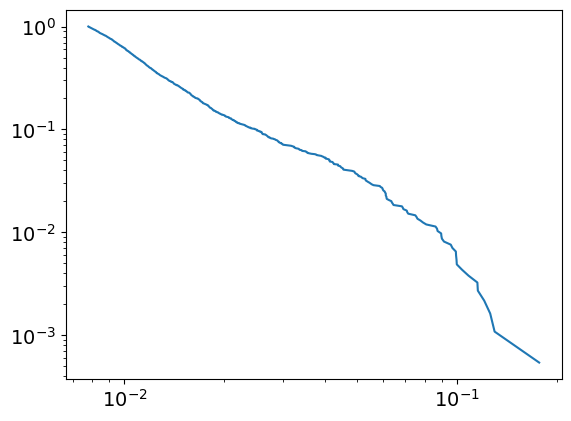

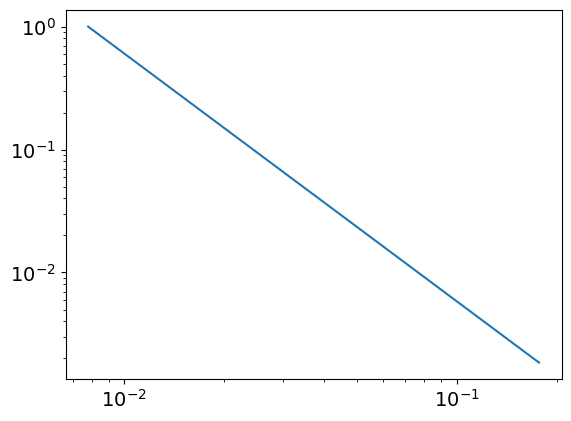

3.0144143121806306
0.0077849352496330805
powerlaw KstestResult(statistic=0.9988038006830837, pvalue=0.0, statistic_location=0.09700921578978795, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12993386721345926, statistic_sign=-1)
tensor(-2.9782e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1932, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.0307, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
96
tensor(0.1493, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


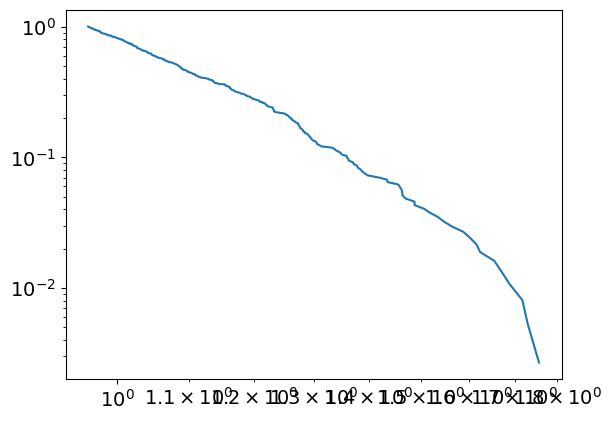

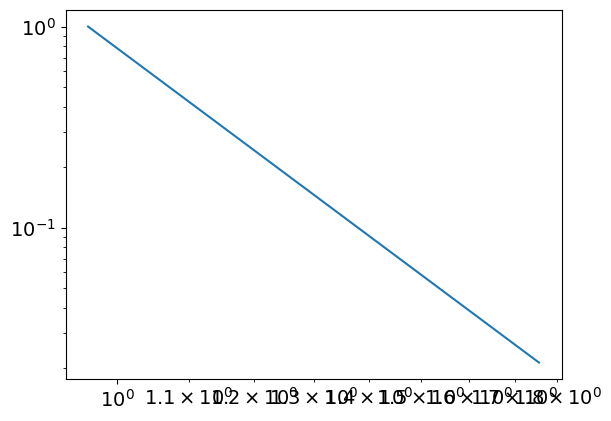

7.381988689455929
0.9615648239001875
powerlaw KstestResult(statistic=0.9946241573287334, pvalue=0.0, statistic_location=1.3865071520862118, statistic_sign=1)
lognorm KstestResult(statistic=0.9901159485070093, pvalue=0.0, statistic_location=1.232832464416346, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1815, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4850, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
97
tensor(4.9077e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


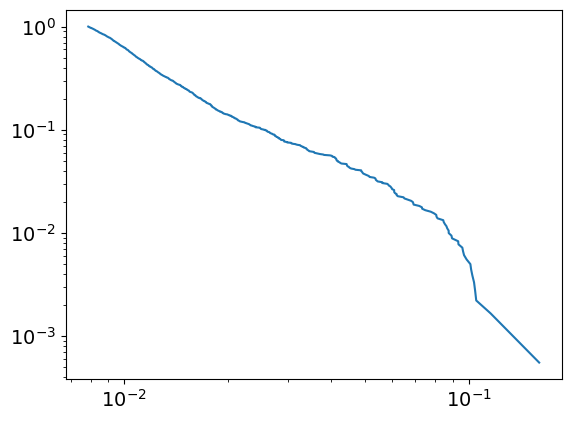

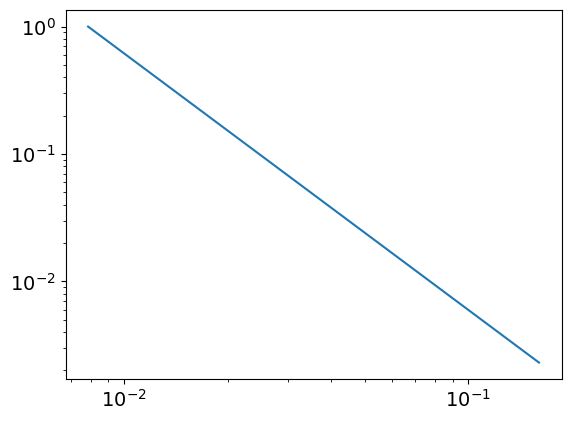

3.0148307502603076
0.00786600939309158
powerlaw KstestResult(statistic=0.9990012185179035, pvalue=0.0, statistic_location=0.10448484121424635, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1306033107378303, statistic_sign=-1)
tensor(-8.0975e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2194, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.4265, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
97
tensor(0.1495, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


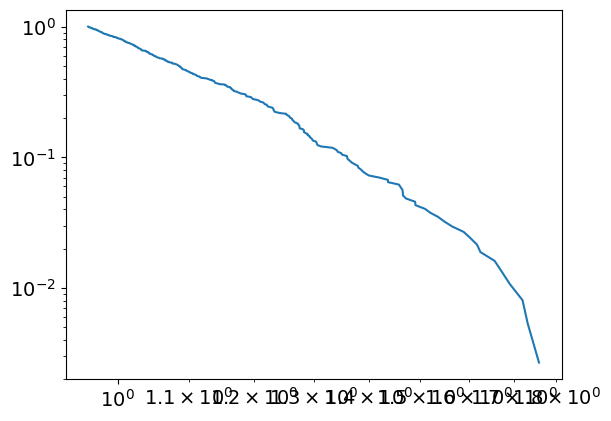

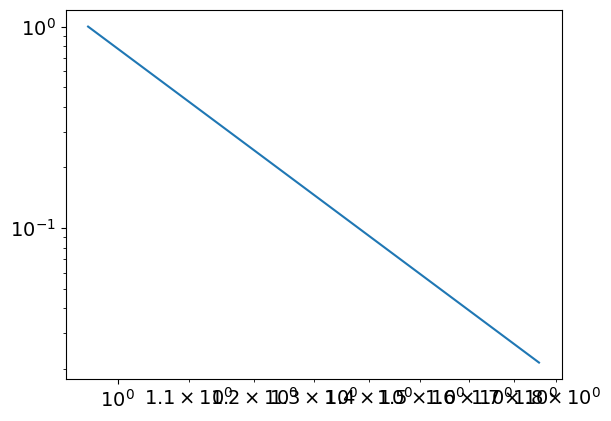

7.356707423625336
0.9609965246838955
powerlaw KstestResult(statistic=0.9945269807634294, pvalue=0.0, statistic_location=1.3646713928484258, statistic_sign=1)
lognorm KstestResult(statistic=0.9900642561074563, pvalue=0.0, statistic_location=1.2339318283832421, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1822, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4887, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
98
tensor(4.6845e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


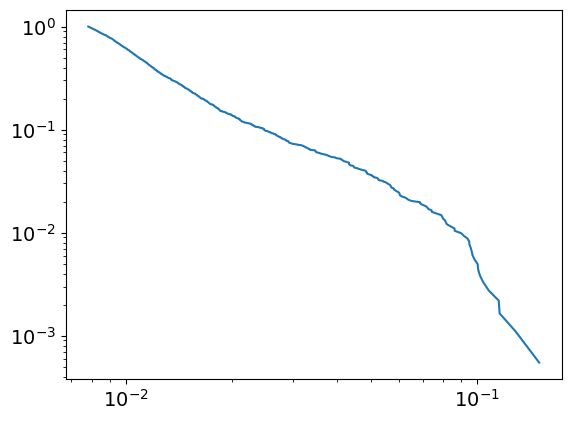

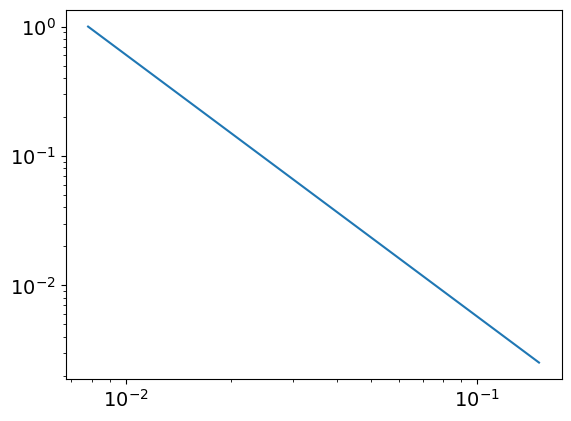

3.024057271175148
0.007820500669419911
powerlaw KstestResult(statistic=0.9989465610271626, pvalue=0.0, statistic_location=0.09707082419805865, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12877370533849303, statistic_sign=-1)
tensor(-3.2676e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1596, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.8571, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
98
tensor(0.1499, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


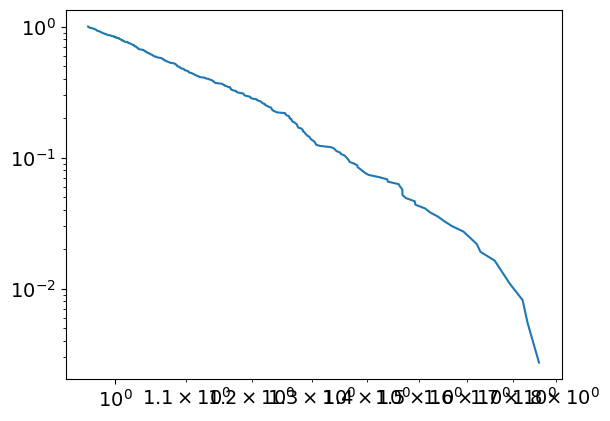

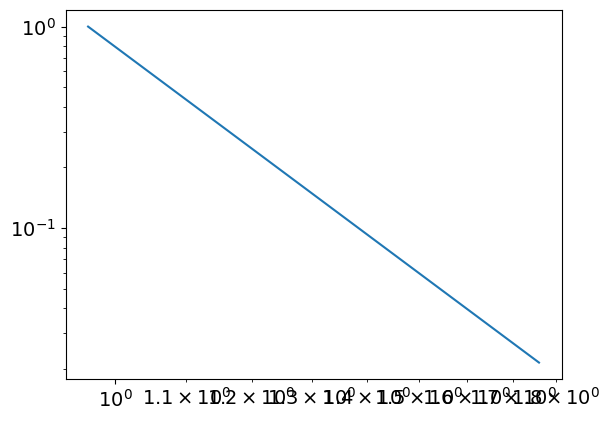

7.384386106759857
0.964676640717839
powerlaw KstestResult(statistic=0.9945976615416628, pvalue=0.0, statistic_location=1.3820103349118393, statistic_sign=1)
lognorm KstestResult(statistic=0.9899584067304723, pvalue=0.0, statistic_location=1.2335268711232108, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2046, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1829, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4922, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


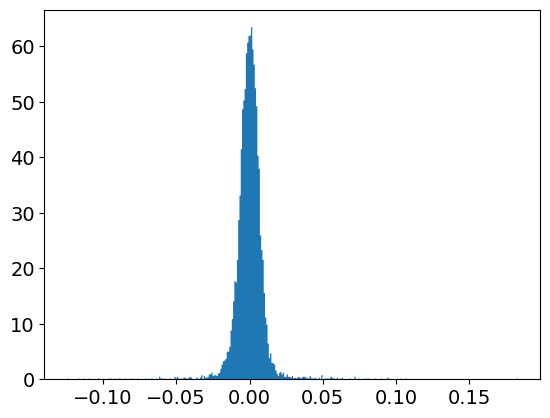

powerlaw
Calculating best minimal value for power law fit
6.7966828330978375
powerlaw KstestResult(statistic=0.9999999564320047, pvalue=0.0, statistic_location=0.18303871748588105, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12444971980218791, statistic_sign=-1)



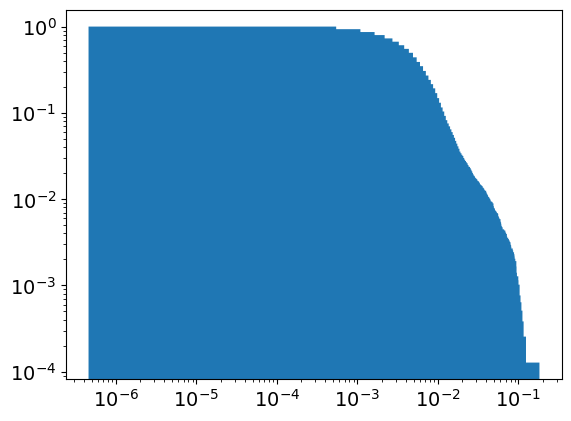

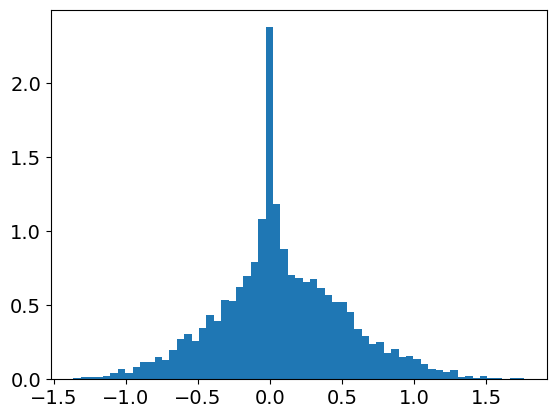

powerlaw
Calculating best minimal value for power law fit
6.6988622012626555
powerlaw KstestResult(statistic=0.9936922431501678, pvalue=0.0, statistic_location=1.3094780098963388, statistic_sign=1)
lognorm KstestResult(statistic=0.9899332604040183, pvalue=0.0, statistic_location=1.2405503686331063, statistic_sign=1)



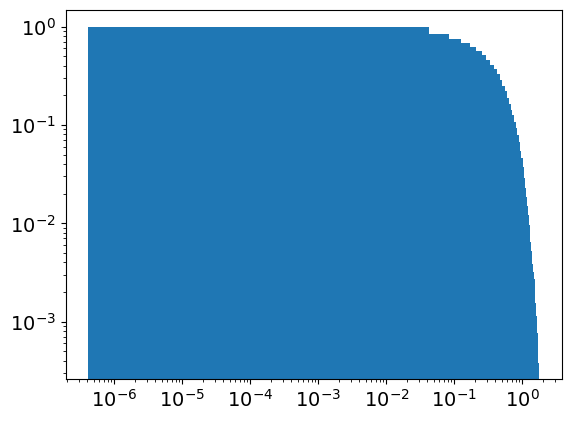

separation
epoch:
99
tensor(5.3361e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


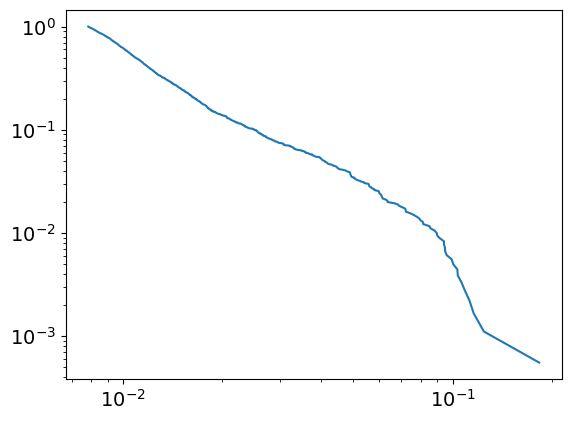

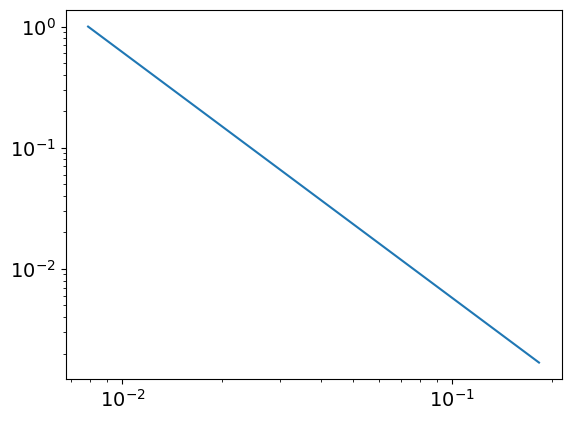

3.029183046336635
0.007866929602425814
powerlaw KstestResult(statistic=0.9989781712476956, pvalue=0.0, statistic_location=0.10640724376410231, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12444971980218791, statistic_sign=-1)
tensor(-4.5236e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2594, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.8243, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
99
tensor(0.1502, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


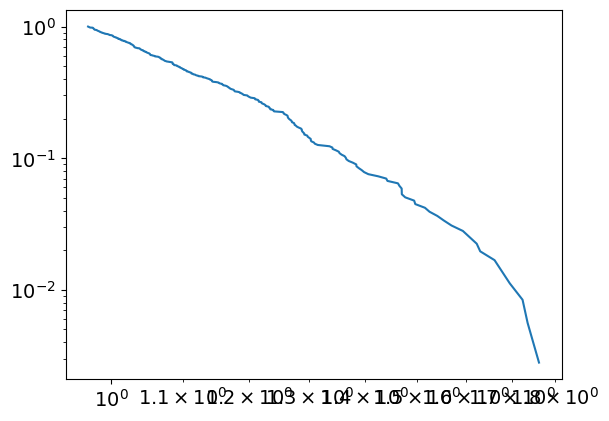

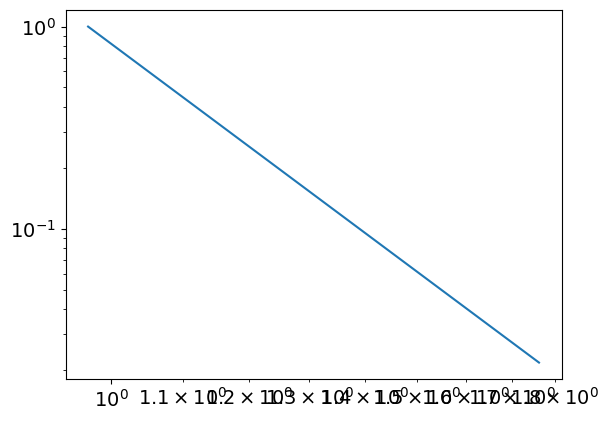

7.404873470215047
0.9695159022830192
powerlaw KstestResult(statistic=0.9947192514324816, pvalue=0.0, statistic_location=1.3880732029825134, statistic_sign=1)
lognorm KstestResult(statistic=0.9899332604040183, pvalue=0.0, statistic_location=1.2405503686331063, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2047, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1835, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4958, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
100
tensor(5.3364e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


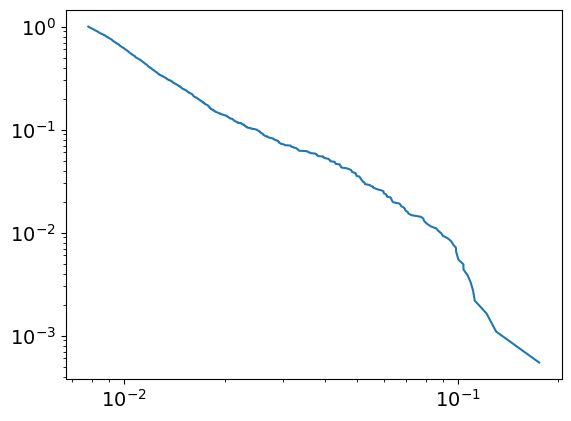

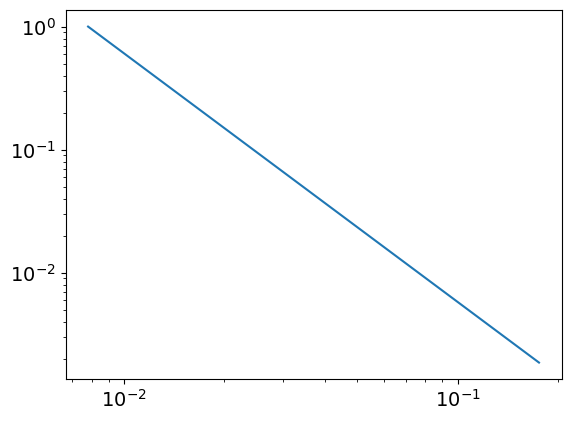

3.0220034870133023
0.007813759333273667
powerlaw KstestResult(statistic=0.9988804746547536, pvalue=0.0, statistic_location=0.10923363253832732, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1301893837251546, statistic_sign=-1)
tensor(-1.0285e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1387, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.3093, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
100
tensor(0.1505, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


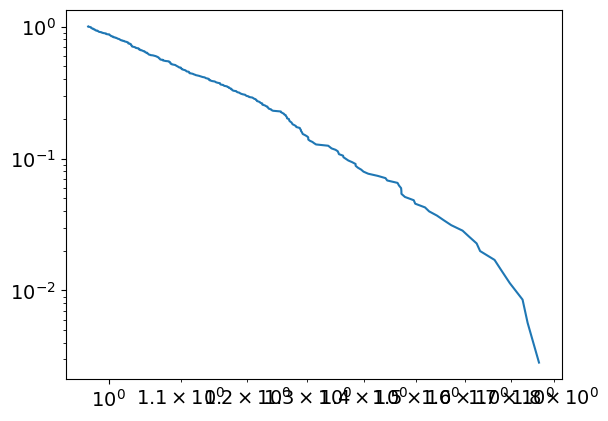

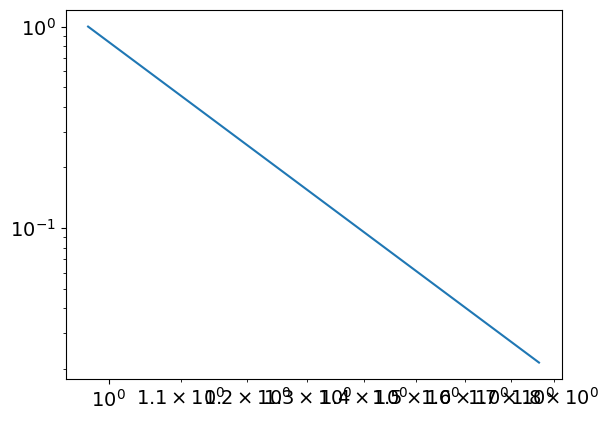

7.455647125107455
0.9733064506484469
powerlaw KstestResult(statistic=0.9948538331703666, pvalue=0.0, statistic_location=1.3893617555451072, statistic_sign=1)
lognorm KstestResult(statistic=0.9898739797484193, pvalue=0.0, statistic_location=1.2352687385796202, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2047, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1842, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4995, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
101
tensor(6.9636e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


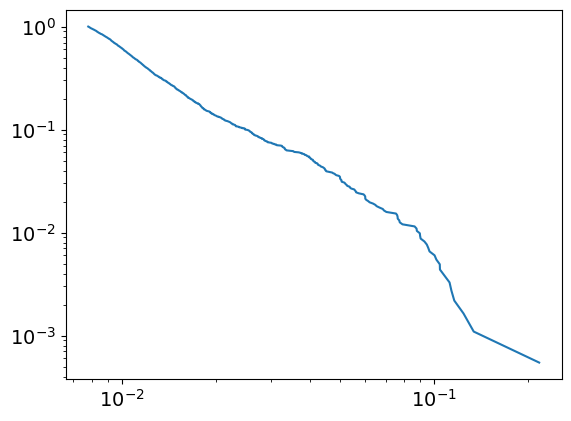

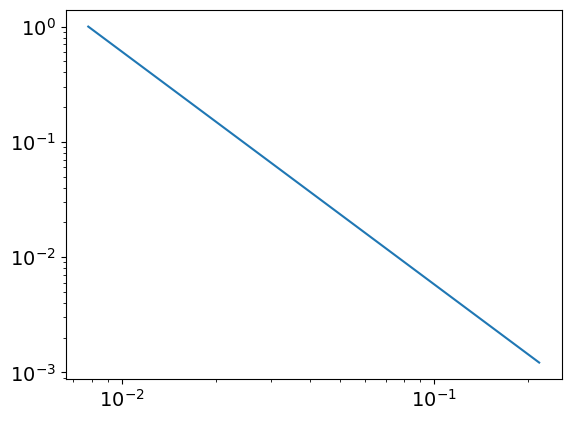

3.02004134492032
0.0078071785787539715
powerlaw KstestResult(statistic=0.9989509361346872, pvalue=0.0, statistic_location=0.09657863571624617, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13374600678608617, statistic_sign=-1)
tensor(-2.2379e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4125, device='cuda:0', grad_fn=<MeanBackward0>) tensor(49.6805, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
101
tensor(0.1508, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


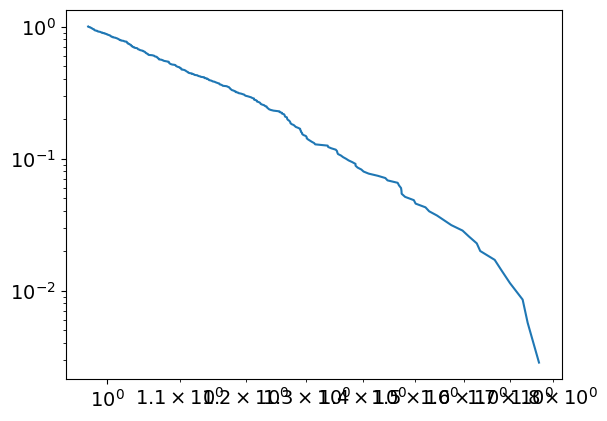

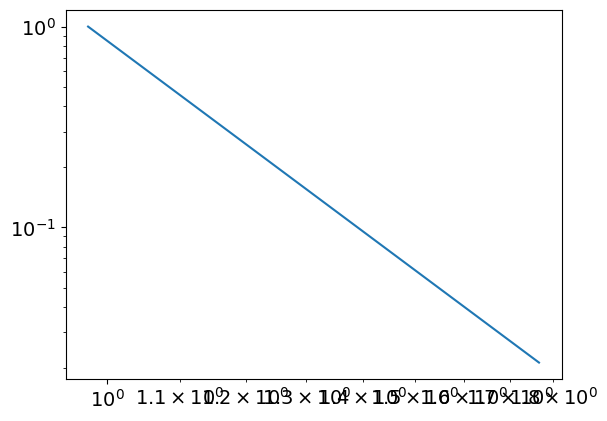

7.4886565859115395
0.9750587860236855
powerlaw KstestResult(statistic=0.994903332494124, pvalue=0.0, statistic_location=1.3907889125186725, statistic_sign=1)
lognorm KstestResult(statistic=0.9898726384282389, pvalue=0.0, statistic_location=1.2375981213750145, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2048, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1848, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5032, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
102
tensor(6.7189e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


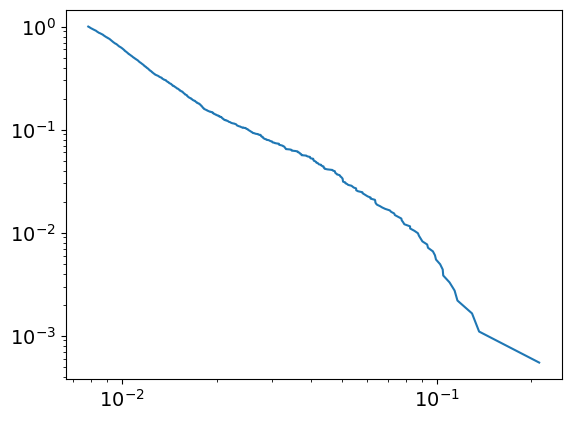

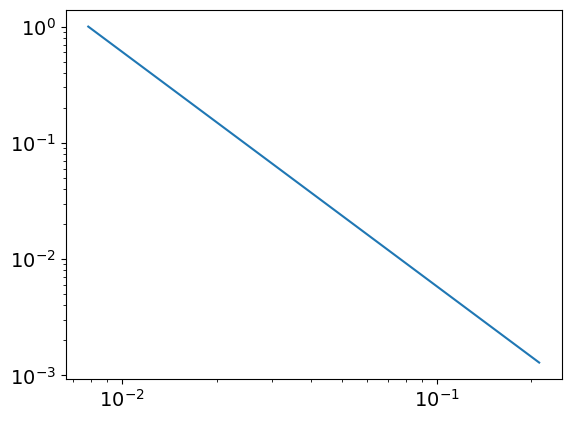

3.018456266726675
0.00782649215355489
powerlaw KstestResult(statistic=0.9988774062100867, pvalue=0.0, statistic_location=0.09961325366156296, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13655083105035318, statistic_sign=-1)
tensor(-1.4960e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4395, device='cuda:0', grad_fn=<MeanBackward0>) tensor(47.9937, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
102
tensor(0.1511, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


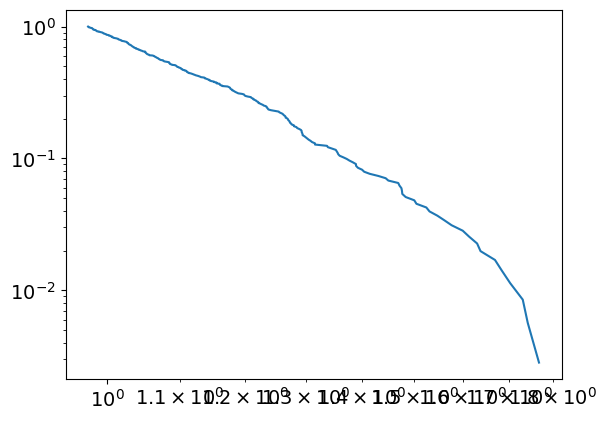

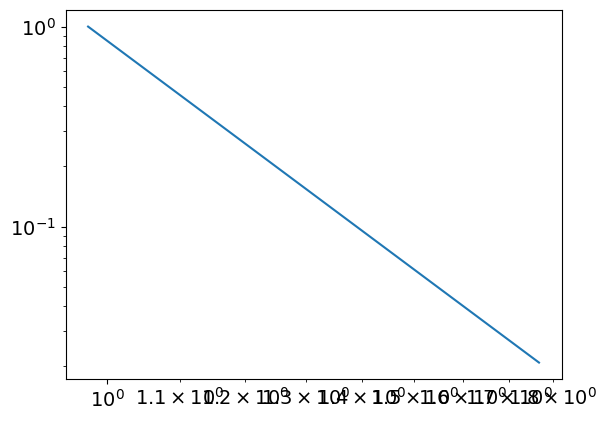

7.497528950766606
0.9749079511719553
powerlaw KstestResult(statistic=0.9948759187279941, pvalue=0.0, statistic_location=1.3921496530728459, statistic_sign=1)
lognorm KstestResult(statistic=0.989909106186867, pvalue=0.0, statistic_location=1.2370249884415971, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2049, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1854, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5068, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
103
tensor(5.3012e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


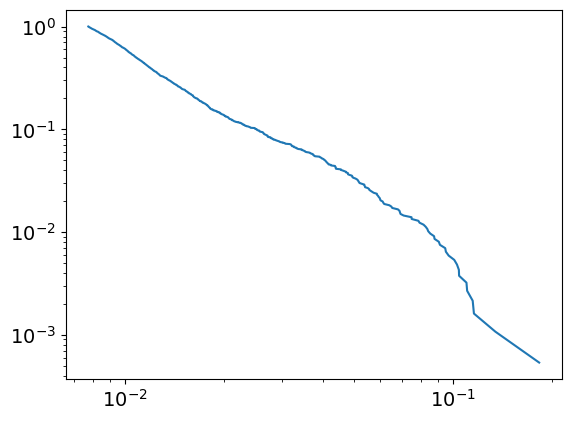

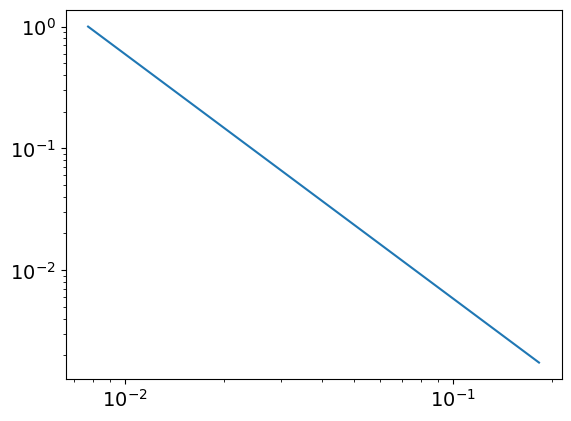

3.007594715345679
0.0077263738383310104
powerlaw KstestResult(statistic=0.9988645888155687, pvalue=0.0, statistic_location=0.10413521264609986, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13451600198298386, statistic_sign=-1)
tensor(-1.0965e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2053, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.0015, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
103
tensor(0.1514, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


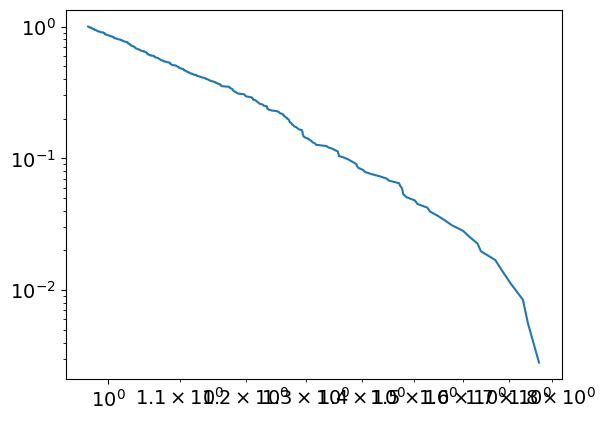

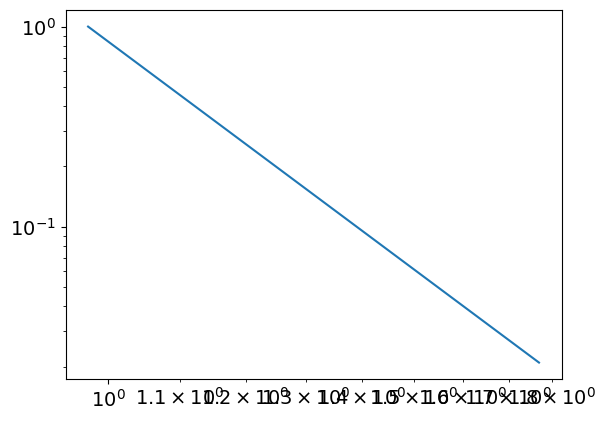

7.4730248574395555
0.974009909432244
powerlaw KstestResult(statistic=0.99478576468513, pvalue=0.0, statistic_location=1.3934865580492075, statistic_sign=1)
lognorm KstestResult(statistic=0.9899090350360643, pvalue=0.0, statistic_location=1.2347062236714246, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2050, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1860, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5105, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
104
tensor(5.4582e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


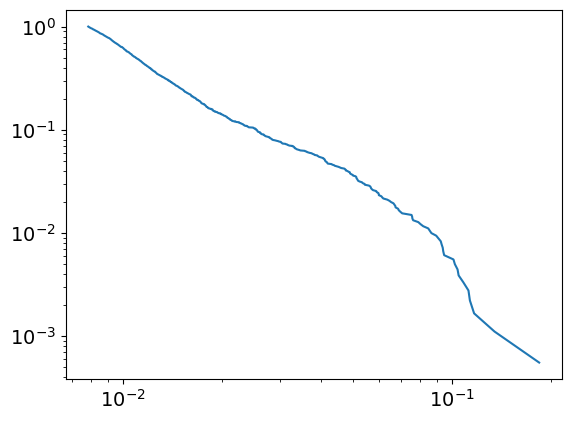

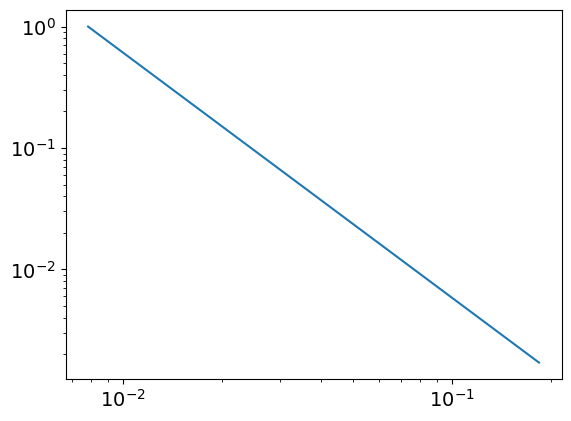

3.0199514866680133
0.007853711071564625
powerlaw KstestResult(statistic=0.9988953736547163, pvalue=0.0, statistic_location=0.10404914606280653, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1347392206709003, statistic_sign=-1)
tensor(-9.2182e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.3702, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
104
tensor(0.1517, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


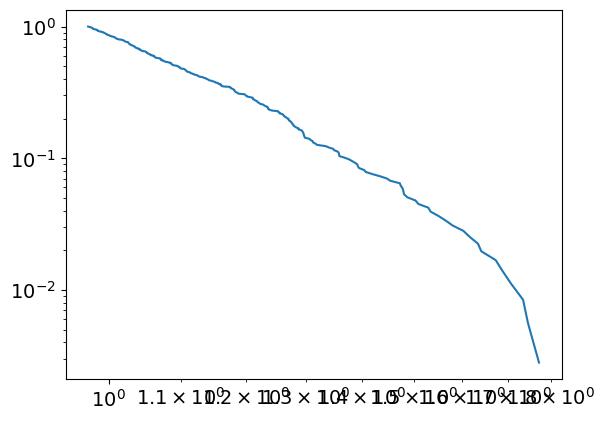

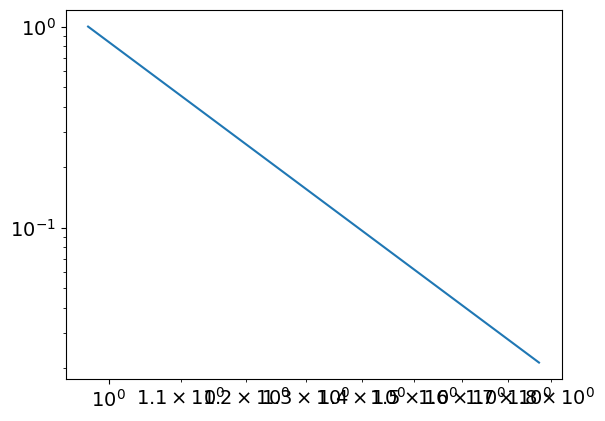

7.418371526561628
0.9728141414127383
powerlaw KstestResult(statistic=0.994639942726681, pvalue=0.0, statistic_location=1.3948090838945981, statistic_sign=1)
lognorm KstestResult(statistic=0.9898293648717472, pvalue=0.0, statistic_location=1.2362441331876142, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2051, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1866, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5142, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
105
tensor(5.4957e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


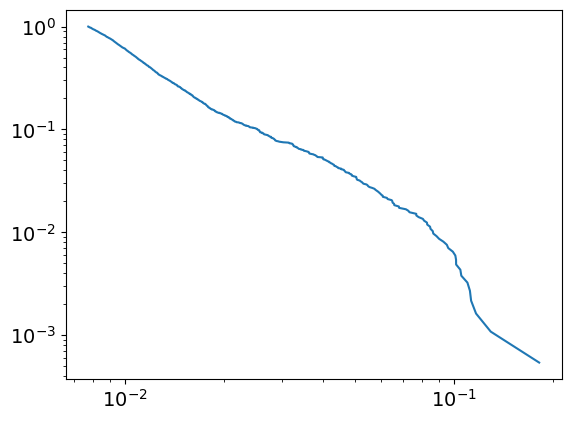

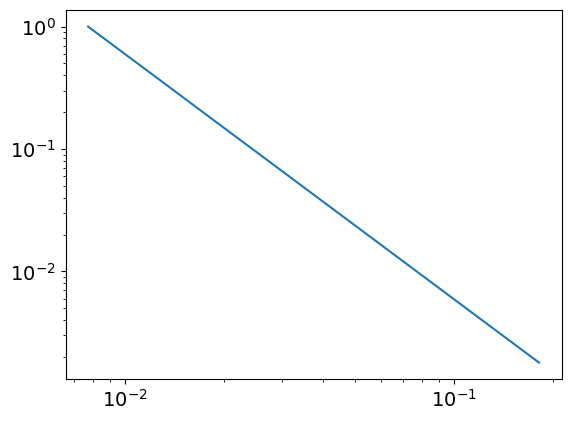

3.001902767533939
0.007734484419209408
powerlaw KstestResult(statistic=0.9987097962941051, pvalue=0.0, statistic_location=0.10469607063413801, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1817828334268757, statistic_sign=1)
tensor(3.6434e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5854, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.8442, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
105
tensor(0.1520, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


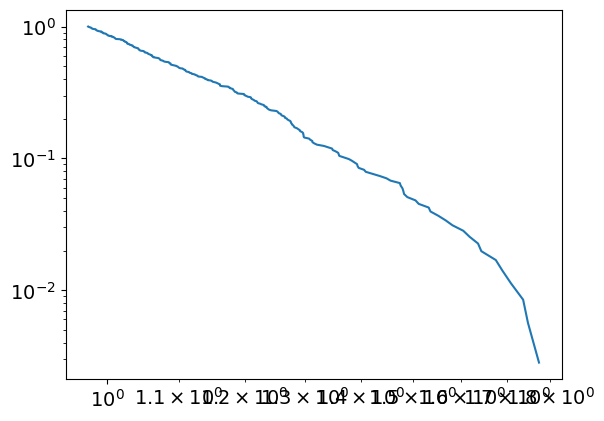

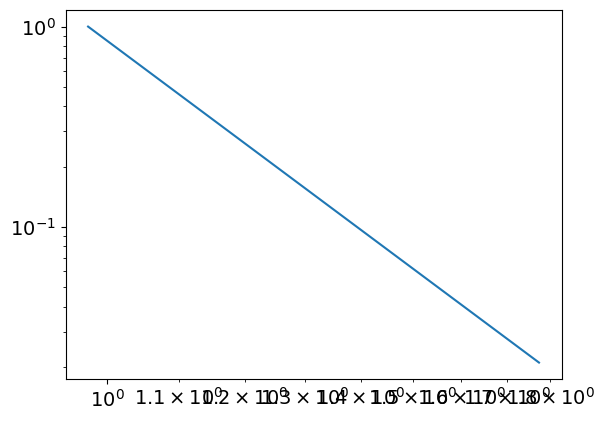

7.455926017929709
0.9750513477219517
powerlaw KstestResult(statistic=0.994719366753508, pvalue=0.0, statistic_location=1.3961080756571824, statistic_sign=1)
lognorm KstestResult(statistic=0.9897849352070159, pvalue=0.0, statistic_location=1.2320516391687546, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2052, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1872, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5179, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
106
tensor(5.1284e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


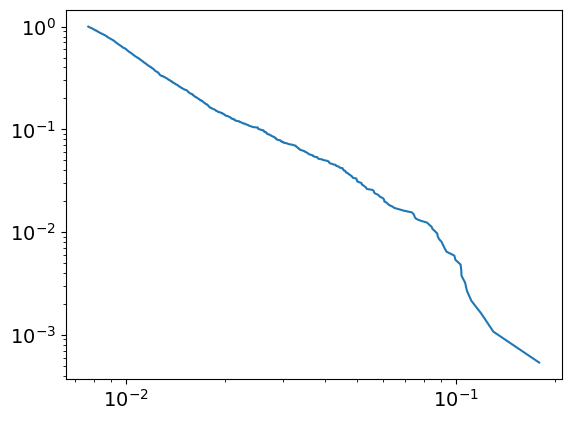

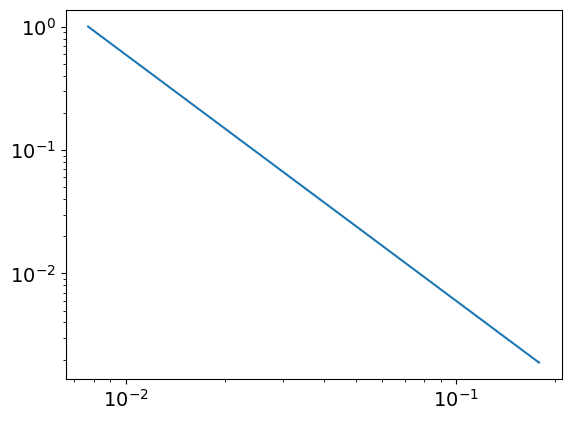

2.993792911314119
0.007700311184360812
powerlaw KstestResult(statistic=0.998967338196627, pvalue=0.0, statistic_location=0.10396433325348048, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12983236289800956, statistic_sign=-1)
tensor(-4.5474e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2518, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.8601, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
106
tensor(0.1522, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


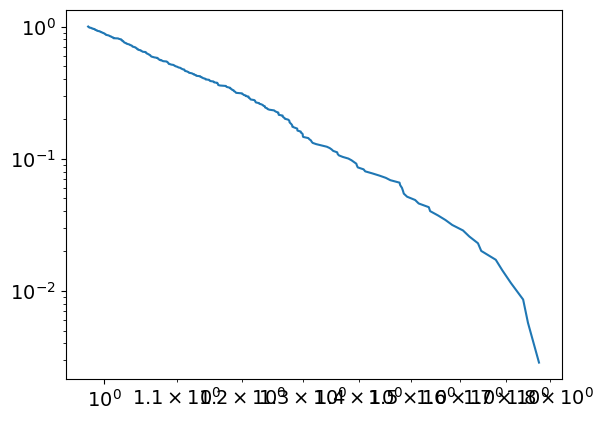

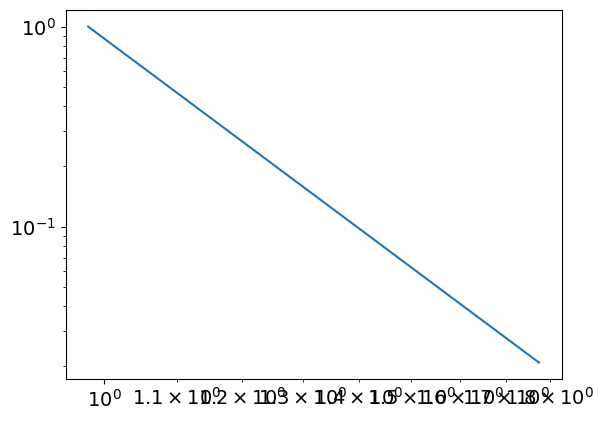

7.497768543825951
0.9786778526102042
powerlaw KstestResult(statistic=0.9948387241870388, pvalue=0.0, statistic_location=1.3973674945372814, statistic_sign=1)
lognorm KstestResult(statistic=0.9897244397619726, pvalue=0.0, statistic_location=1.2334089402316792, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2053, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5215, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
107
tensor(4.9267e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


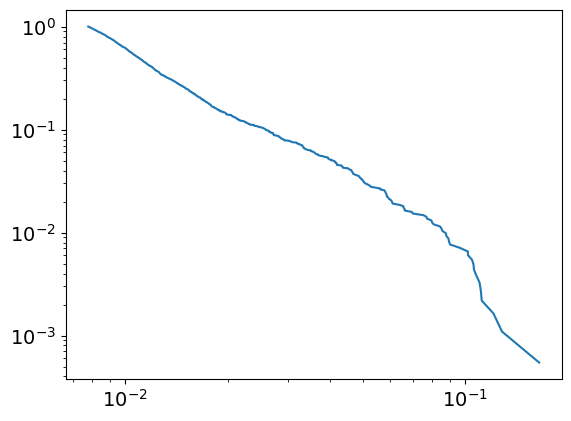

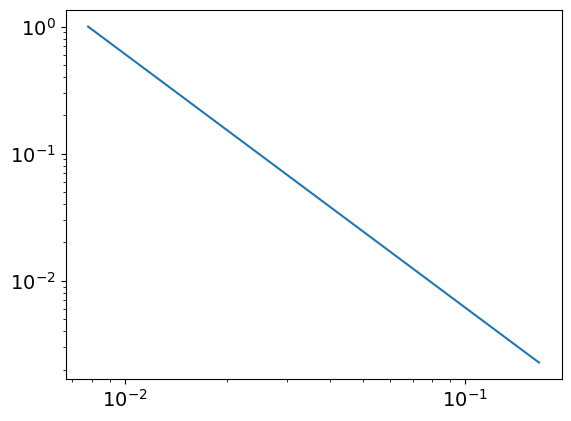

2.9945866282244133
0.007783432778882245
powerlaw KstestResult(statistic=0.9987953615486863, pvalue=0.0, statistic_location=0.10566087330392164, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16478472230018273, statistic_sign=1)
tensor(2.5096e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2509, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.0426, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
107
tensor(0.1525, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


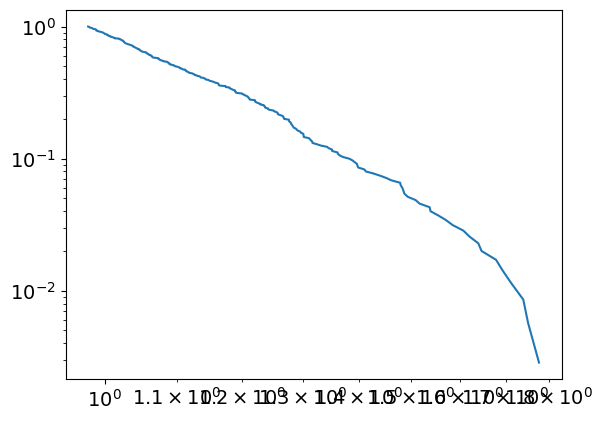

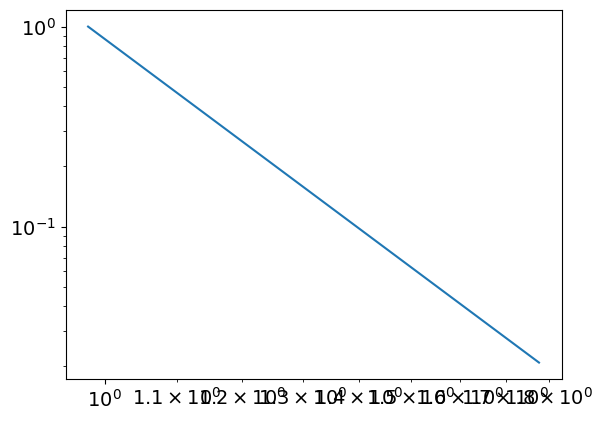

7.481820412060952
0.9783921369419423
powerlaw KstestResult(statistic=0.9947756184211725, pvalue=0.0, statistic_location=1.3986721330608762, statistic_sign=1)
lognorm KstestResult(statistic=0.9897030787117539, pvalue=0.0, statistic_location=1.236351217668888, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1883, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5252, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
108
tensor(5.5511e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


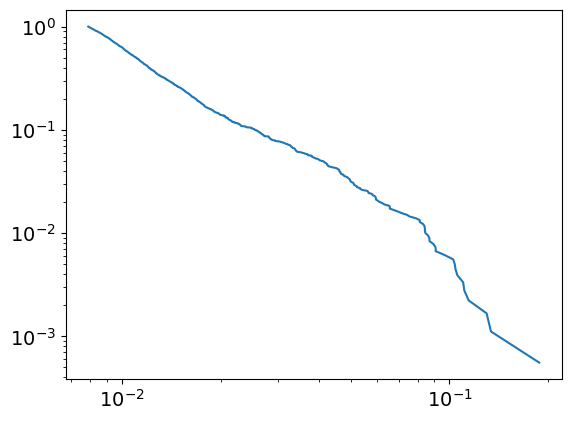

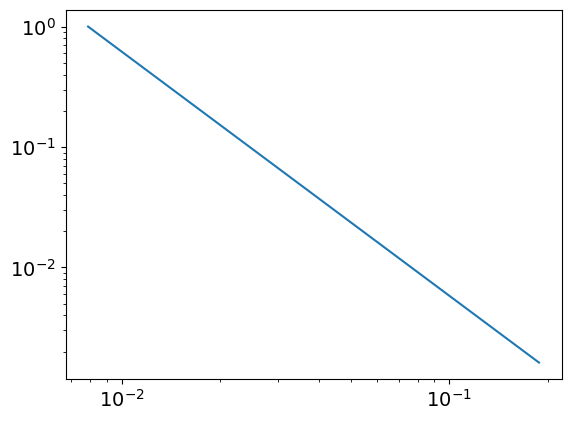

3.025800948377589
0.00788643537257709
powerlaw KstestResult(statistic=0.9988992297075454, pvalue=0.0, statistic_location=0.10437308911662999, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13391055268217766, statistic_sign=-1)
tensor(-1.2708e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2849, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.4516, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
108
tensor(0.1528, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


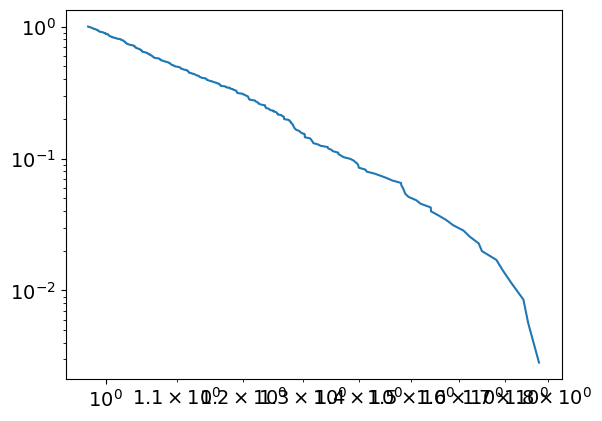

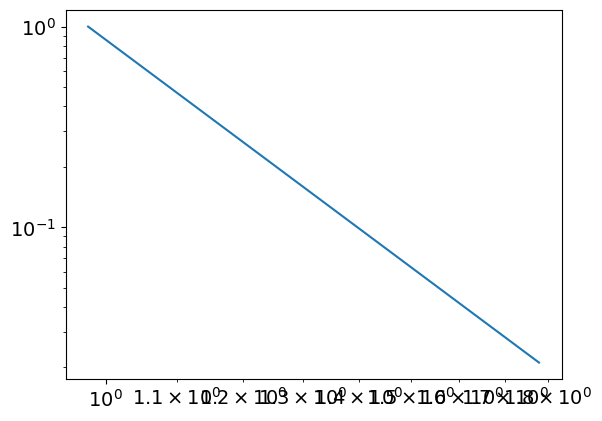

7.438834602913468
0.976996782476591
powerlaw KstestResult(statistic=0.9946425011856111, pvalue=0.0, statistic_location=1.3999068032507762, statistic_sign=1)
lognorm KstestResult(statistic=0.9896854124484405, pvalue=0.0, statistic_location=1.2367156360127365, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1888, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5290, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
109
tensor(5.5849e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


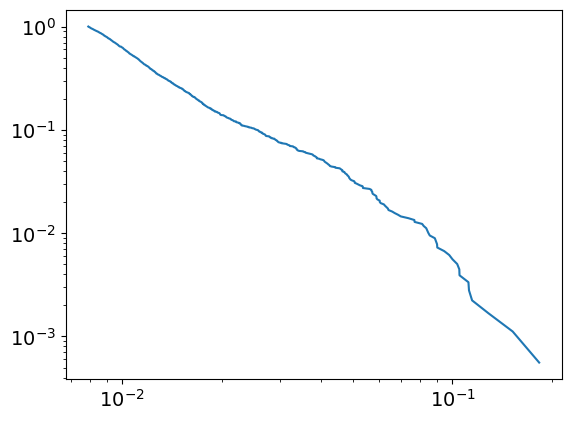

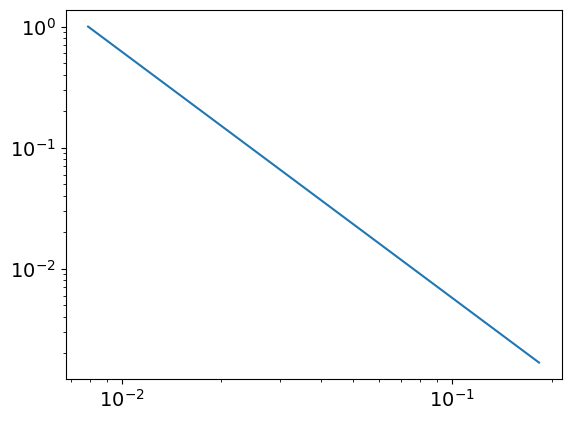

3.0329692422365504
0.007896405061488488
powerlaw KstestResult(statistic=0.9988998746723307, pvalue=0.0, statistic_location=0.10489337423735122, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15215667663477947, statistic_sign=-1)
tensor(-3.7945e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0716, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.0763, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
109
tensor(0.1531, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


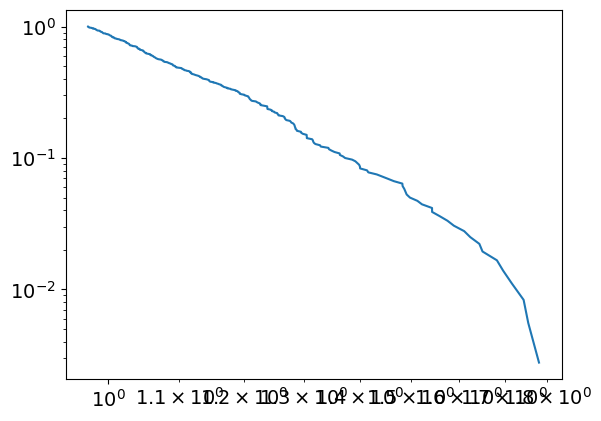

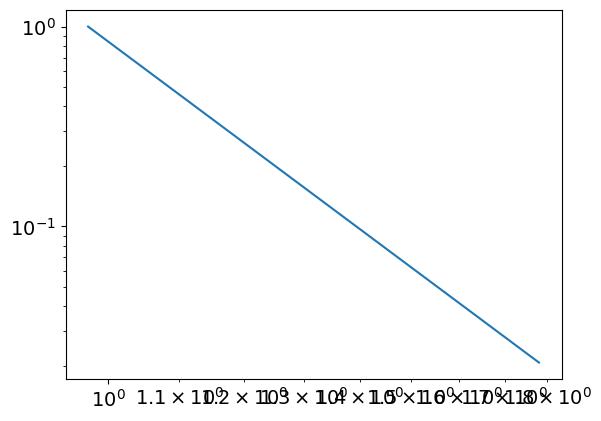

7.411938808771958
0.9734560924337811
powerlaw KstestResult(statistic=0.9944548476309286, pvalue=0.0, statistic_location=1.401188732753056, statistic_sign=1)
lognorm KstestResult(statistic=0.9896322627884312, pvalue=0.0, statistic_location=1.2376932551445856, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2055, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1893, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5327, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
110
tensor(4.5007e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


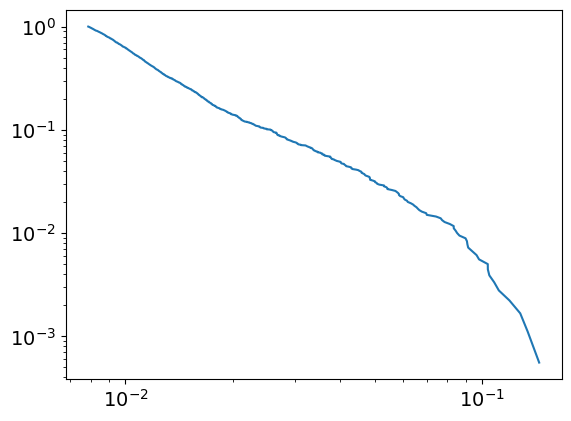

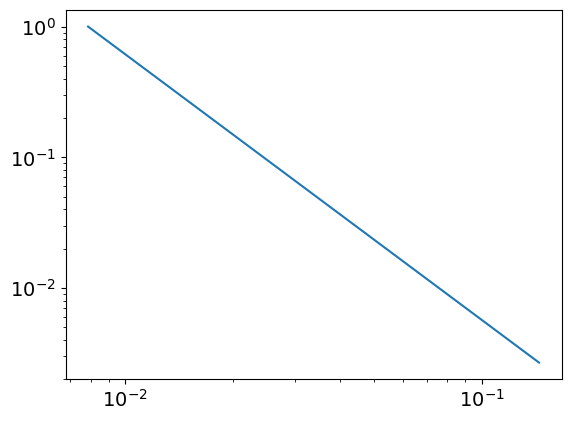

3.0338672716278
0.007869829576496288
powerlaw KstestResult(statistic=0.9989389263583874, pvalue=0.0, statistic_location=0.09815638211146825, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13434864397981502, statistic_sign=-1)
tensor(-5.9875e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3828, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.8026, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
110
tensor(0.1534, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


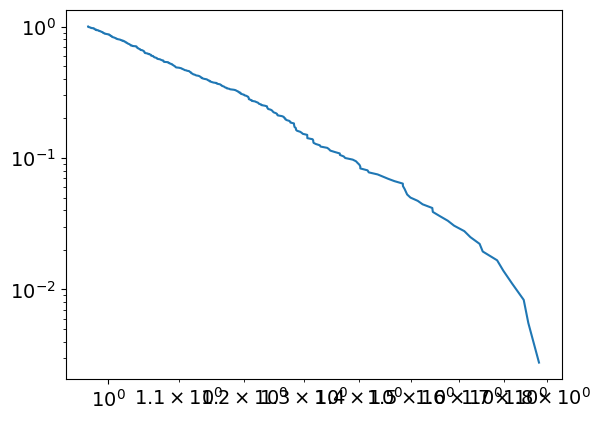

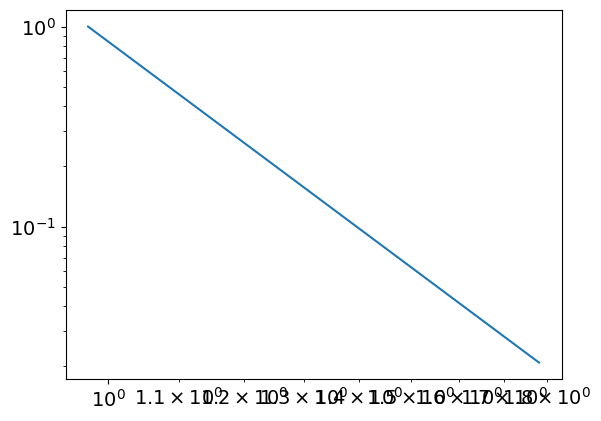

7.401629766077297
0.9736708945720692
powerlaw KstestResult(statistic=0.9944066151582431, pvalue=0.0, statistic_location=1.4023891145350633, statistic_sign=1)
lognorm KstestResult(statistic=0.9895609739892827, pvalue=0.0, statistic_location=1.2283281554302325, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2056, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1899, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5366, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
111
tensor(4.5724e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


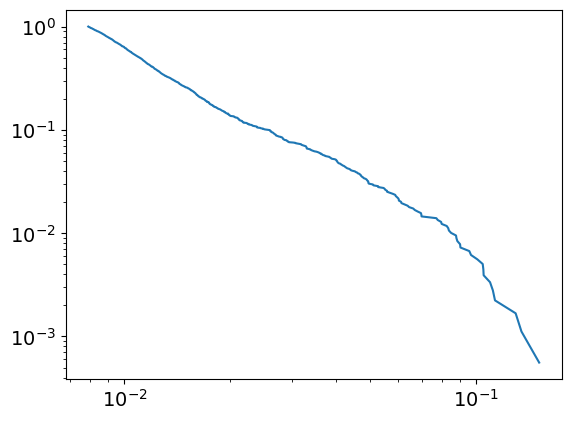

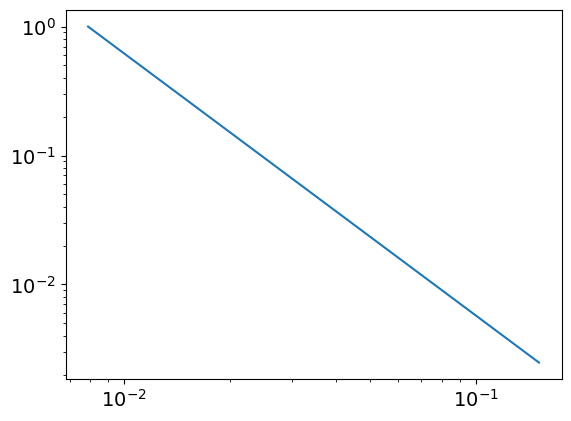

3.032100767590071
0.007892128225763356
powerlaw KstestResult(statistic=0.99889729287413, pvalue=0.0, statistic_location=0.10492187426464178, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15122351170028767, statistic_sign=-1)
tensor(-6.7043e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6212, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4727, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
111
tensor(0.1537, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


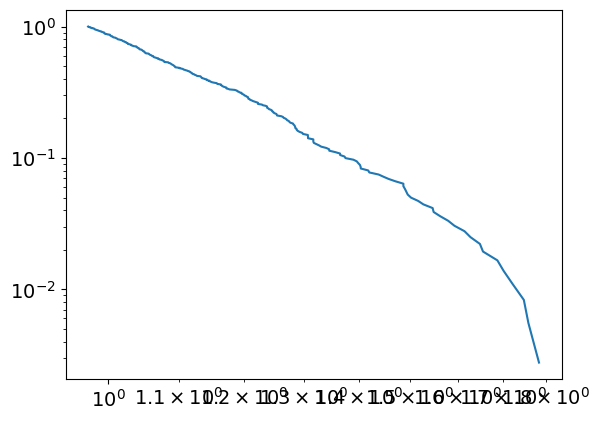

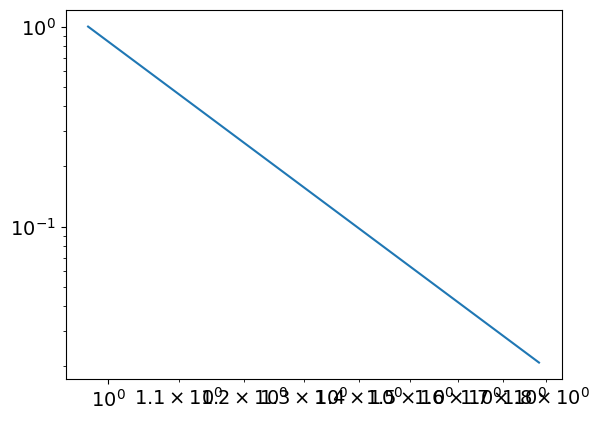

7.389595150589364
0.973432574450189
powerlaw KstestResult(statistic=0.994348614081748, pvalue=0.0, statistic_location=1.3753194305401504, statistic_sign=1)
lognorm KstestResult(statistic=0.9894770053349959, pvalue=0.0, statistic_location=1.2229368952978716, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2057, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1904, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5402, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
112
tensor(4.1512e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


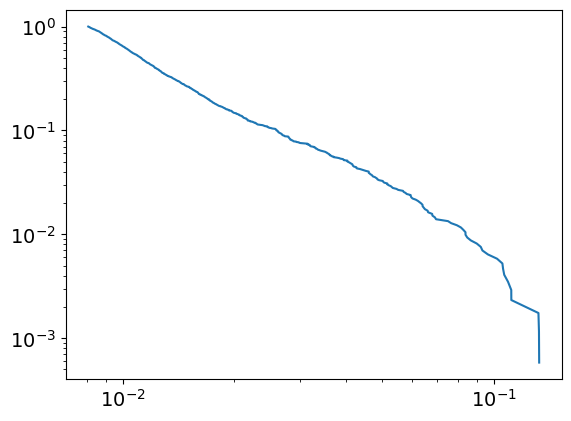

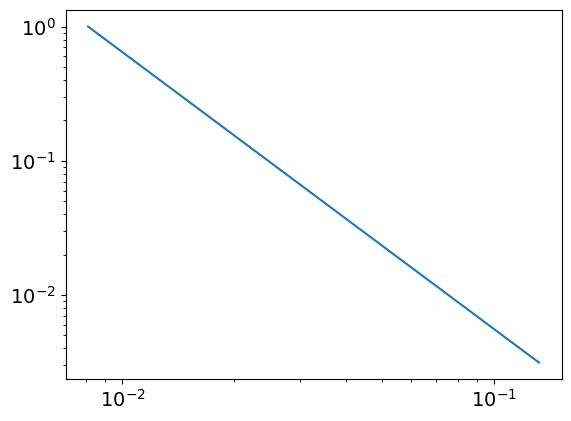

3.0617291828370954
0.00808013369710379
powerlaw KstestResult(statistic=0.9989790365445819, pvalue=0.0, statistic_location=0.10904598137973087, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13228524948499934, statistic_sign=-1)
tensor(-3.5616e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4252, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5546, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
112
tensor(0.1539, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


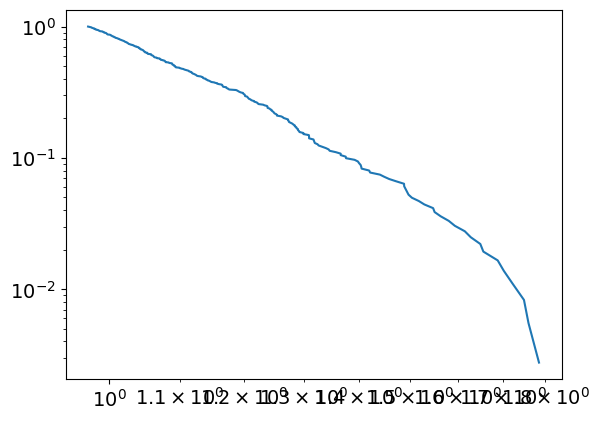

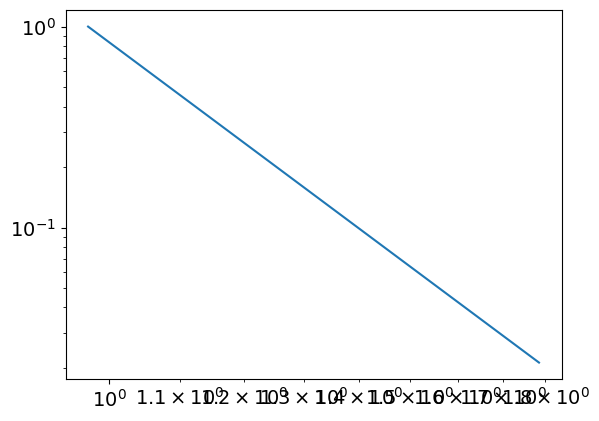

7.336866722046886
0.9721806047084087
powerlaw KstestResult(statistic=0.9942386000794522, pvalue=0.0, statistic_location=1.3762954524890225, statistic_sign=1)
lognorm KstestResult(statistic=0.9894641169925739, pvalue=0.0, statistic_location=1.2234604964745255, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2057, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5440, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
113
tensor(4.1542e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


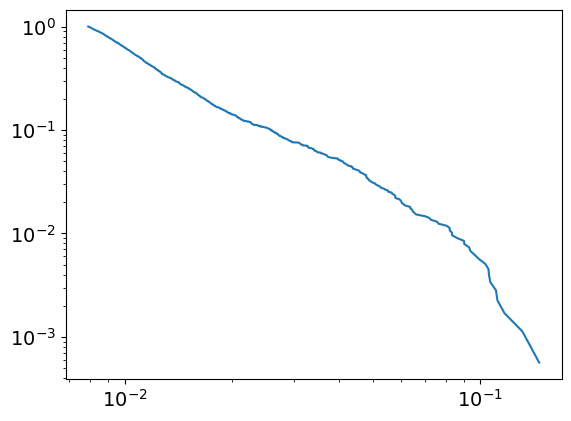

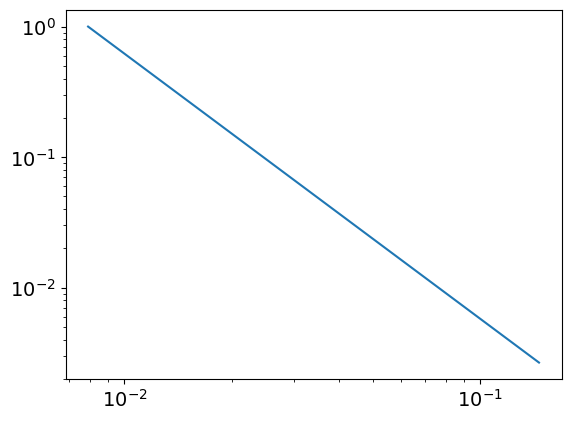

3.0306726373024624
0.007906852651549074
powerlaw KstestResult(statistic=0.9990103132786109, pvalue=0.0, statistic_location=0.10537512910054417, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.131233956442583, statistic_sign=-1)
tensor(-3.7886e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3024, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4056, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
113
tensor(0.1542, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


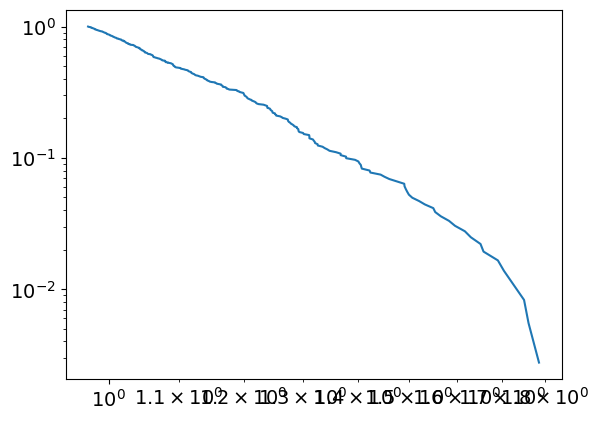

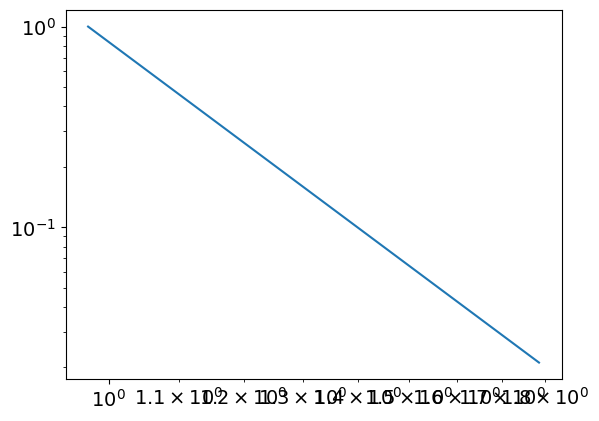

7.34364639541859
0.9728156879712864
powerlaw KstestResult(statistic=0.9942290882356564, pvalue=0.0, statistic_location=1.3776713062604449, statistic_sign=1)
lognorm KstestResult(statistic=0.9894491069877512, pvalue=0.0, statistic_location=1.24725265850621, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1914, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5478, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
114
tensor(4.7970e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


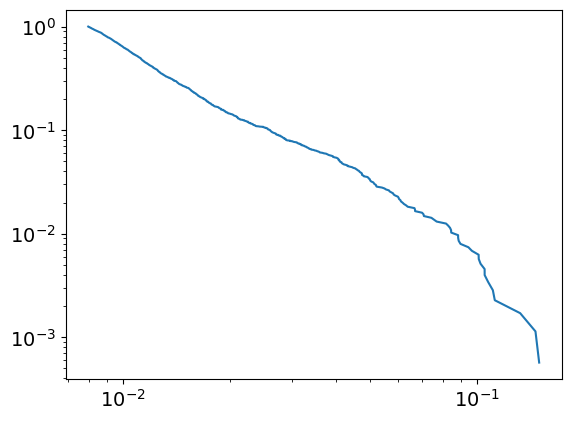

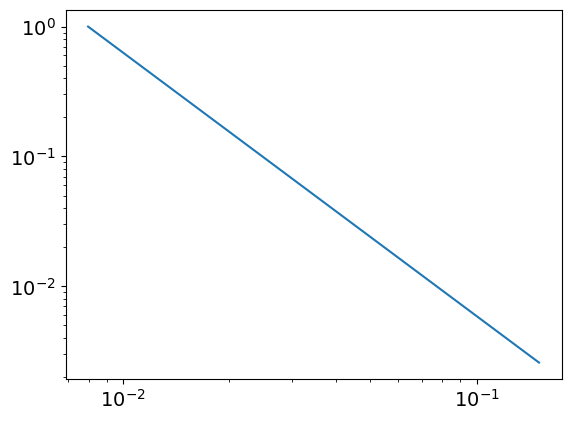

3.0285678890187717
0.007966884207157564
powerlaw KstestResult(statistic=0.9990112439301698, pvalue=0.0, statistic_location=0.10524288391696798, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14655077787576556, statistic_sign=-1)
tensor(-5.9167e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5884, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.3836, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
114
tensor(0.1545, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


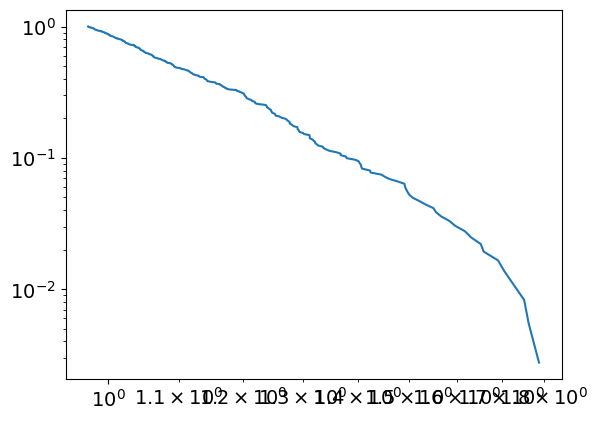

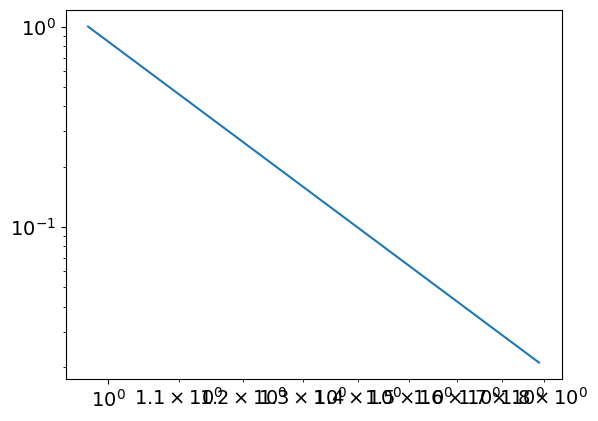

7.351114994688062
0.9734693216745987
powerlaw KstestResult(statistic=0.9942060826284196, pvalue=0.0, statistic_location=1.3796603129197718, statistic_sign=1)
lognorm KstestResult(statistic=0.9894345384365316, pvalue=0.0, statistic_location=1.2245994264535742, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2059, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1919, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5516, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
115
tensor(3.7289e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


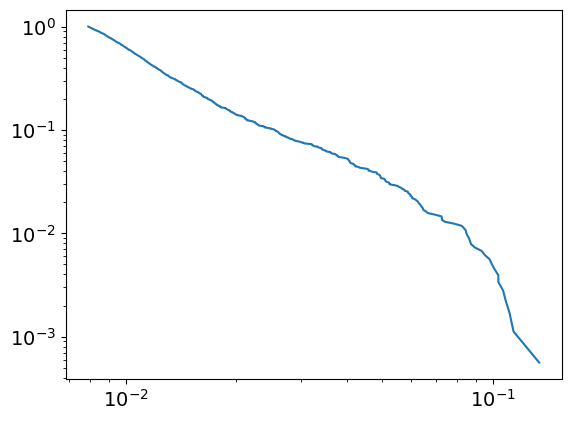

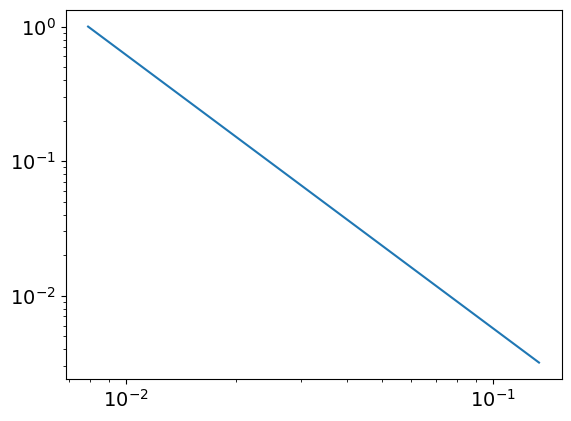

3.032645976717479
0.007903338130835774
powerlaw KstestResult(statistic=0.9991073553246942, pvalue=0.0, statistic_location=0.10664521271001136, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1338008805286608, statistic_sign=-1)
tensor(-3.0565e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4822, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.7804, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
115
tensor(0.1547, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


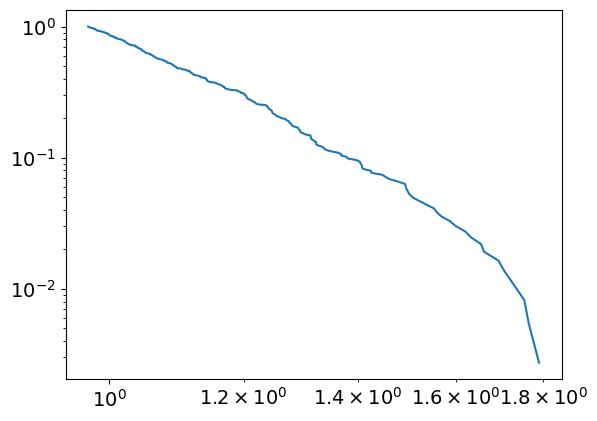

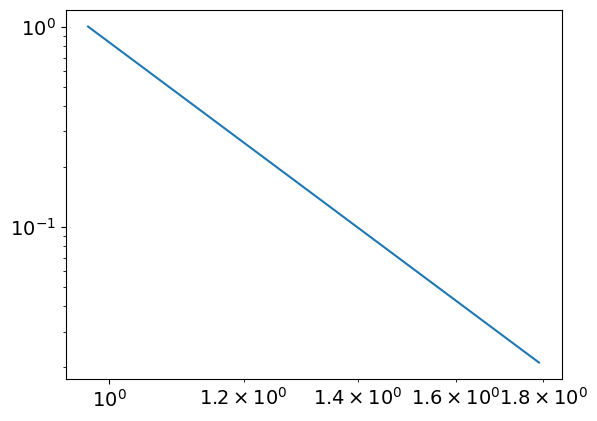

7.332831153626733
0.9722243589172447
powerlaw KstestResult(statistic=0.9941468339237514, pvalue=0.0, statistic_location=1.3377428597295313, statistic_sign=1)
lognorm KstestResult(statistic=0.9894189295328816, pvalue=0.0, statistic_location=1.2251823236213835, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2060, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1924, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5554, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
116
tensor(3.6596e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


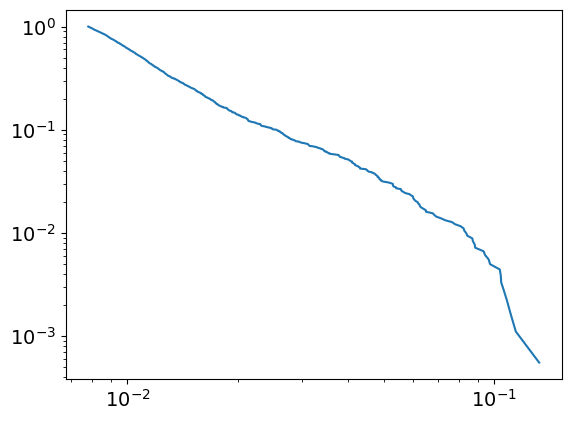

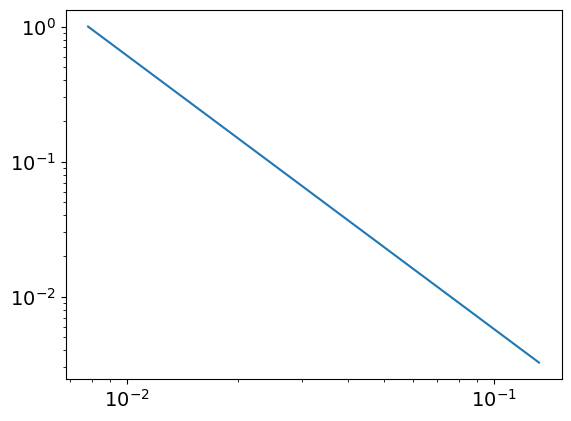

3.0248629297584997
0.007822680358363285
powerlaw KstestResult(statistic=0.9991034170490488, pvalue=0.0, statistic_location=0.10612103369985583, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13245337305221164, statistic_sign=-1)
tensor(-2.8309e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4361, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.6343, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
116
tensor(0.1550, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


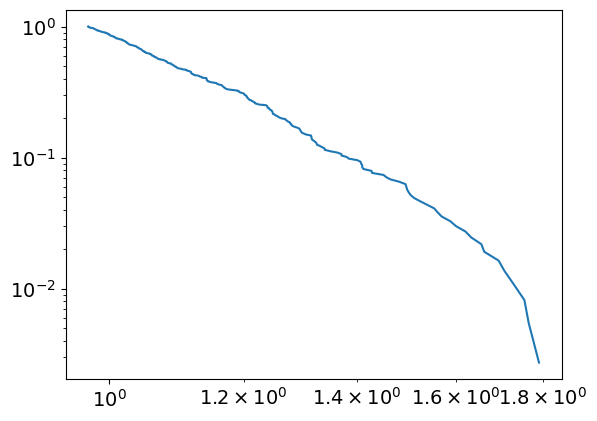

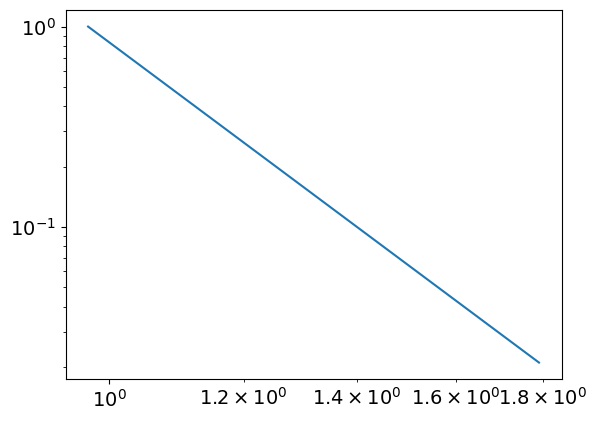

7.3184724814003035
0.9718831101873547
powerlaw KstestResult(statistic=0.9941136456759941, pvalue=0.0, statistic_location=1.3392744972223336, statistic_sign=1)
lognorm KstestResult(statistic=0.9894588118795167, pvalue=0.0, statistic_location=1.2486673438252425, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2060, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1928, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5592, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
117
tensor(3.8722e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


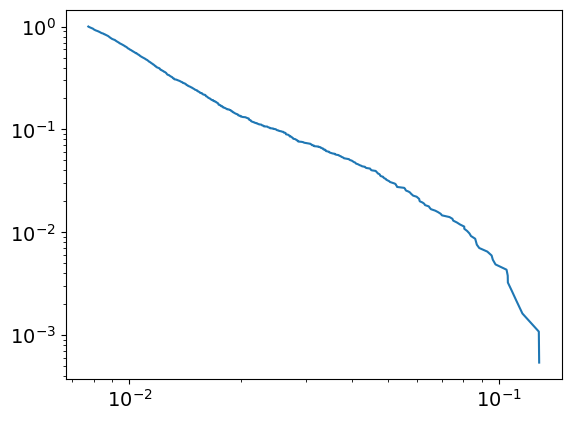

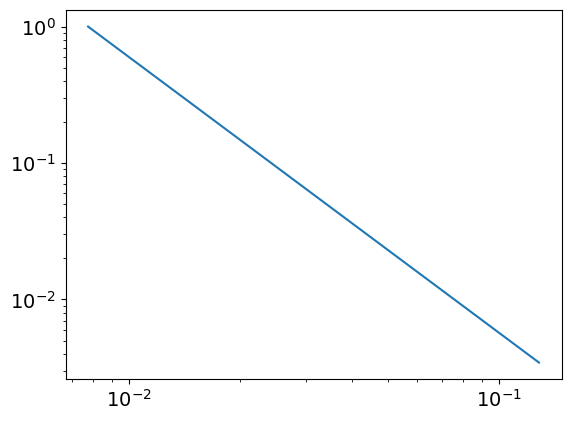

3.018822072577044
0.00774108308178952
powerlaw KstestResult(statistic=0.9990834837044703, pvalue=0.0, statistic_location=0.09620493927611008, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1283974653700809, statistic_sign=-1)
tensor(-2.6477e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5248, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.6862, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
117
tensor(0.1553, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


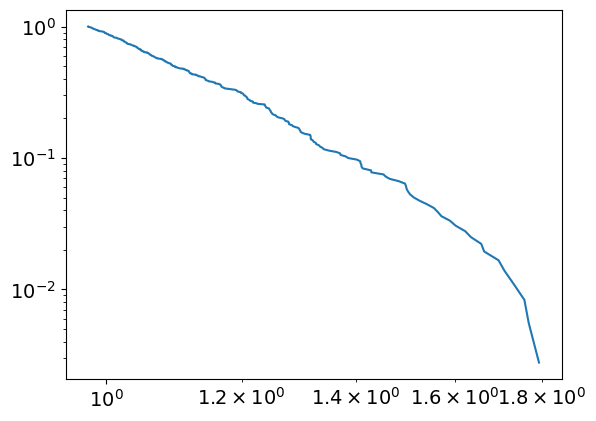

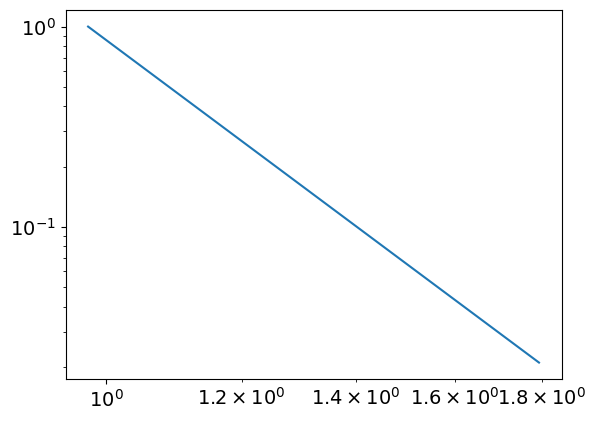

7.345390627820688
0.9755941295093156
powerlaw KstestResult(statistic=0.9941744359131423, pvalue=0.0, statistic_location=1.3714588911841006, statistic_sign=1)
lognorm KstestResult(statistic=0.9893925364593987, pvalue=0.0, statistic_location=1.2261495435274965, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2061, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1933, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5630, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
118
tensor(4.0980e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


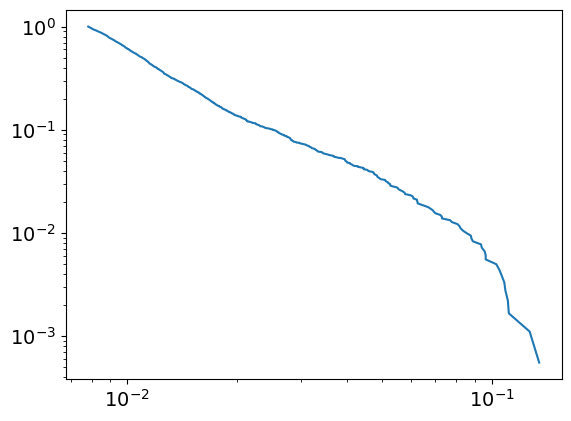

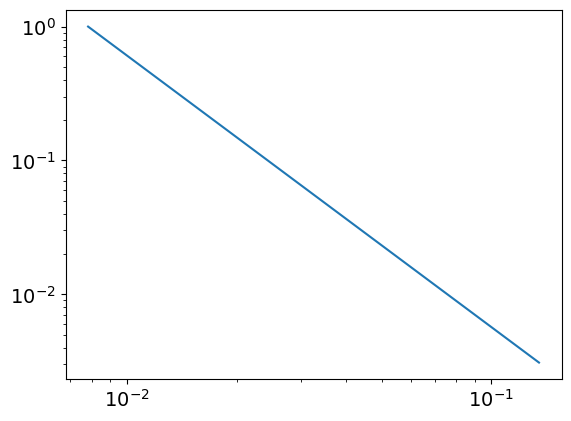

3.028578934649236
0.007824486680818256
powerlaw KstestResult(statistic=0.9989753147136451, pvalue=0.0, statistic_location=0.11084726835066577, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13511248356430794, statistic_sign=-1)
tensor(-1.4172e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3359, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1050, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
118
tensor(0.1555, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


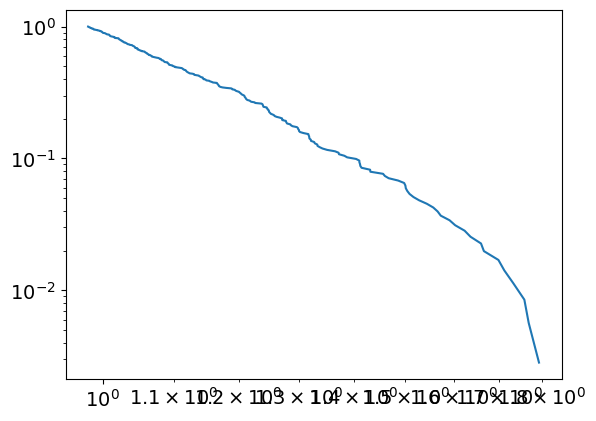

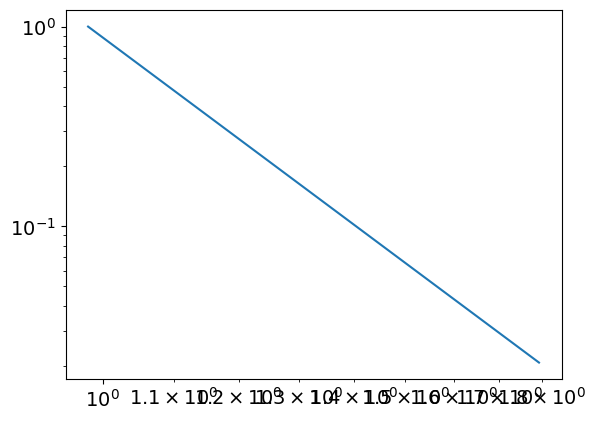

7.413377275203006
0.9807065767497045
powerlaw KstestResult(statistic=0.9943201638521189, pvalue=0.0, statistic_location=1.372414214339852, statistic_sign=1)
lognorm KstestResult(statistic=0.9893784497465771, pvalue=0.0, statistic_location=1.2266578746351227, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2062, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1938, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5668, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
119
tensor(3.8270e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


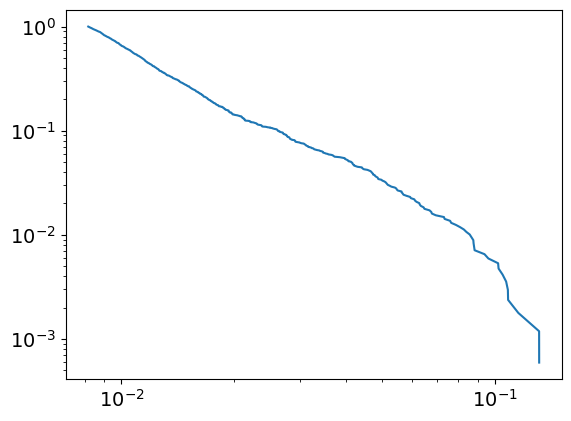

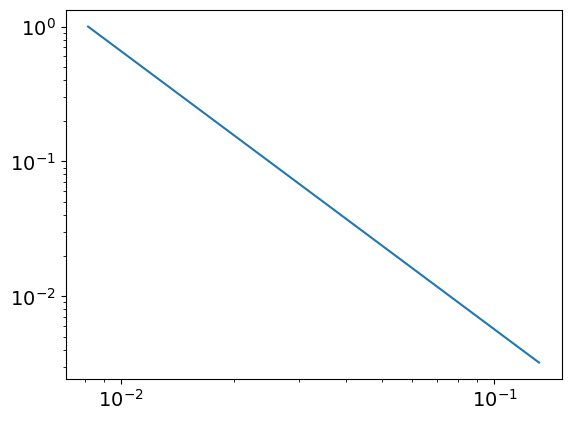

3.0622357723017437
0.008147432979927052
powerlaw KstestResult(statistic=0.999086178765872, pvalue=0.0, statistic_location=0.10502466010423524, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13160127924457748, statistic_sign=-1)
tensor(-1.6045e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4717, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.6020, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
119
tensor(0.1558, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


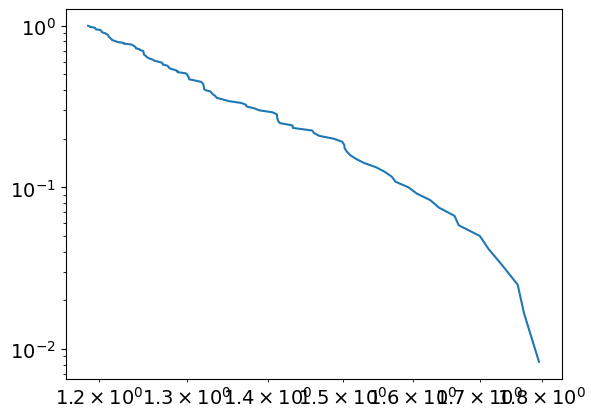

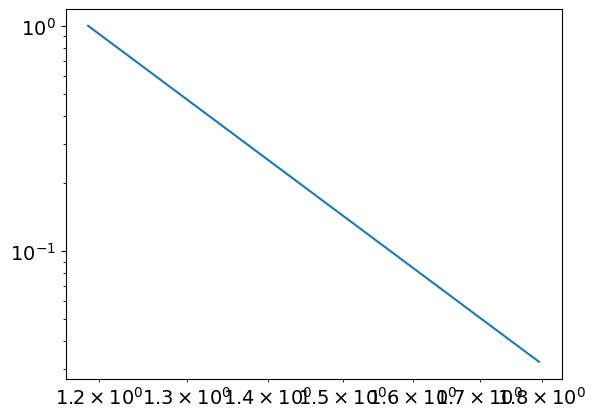

9.304855586829994
1.1876437115933347
powerlaw KstestResult(statistic=0.9984308449552515, pvalue=0.0, statistic_location=1.604891601257517, statistic_sign=1)
lognorm KstestResult(statistic=0.989360588436079, pvalue=0.0, statistic_location=1.2272630442400387, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2062, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5706, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
120
tensor(3.8140e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


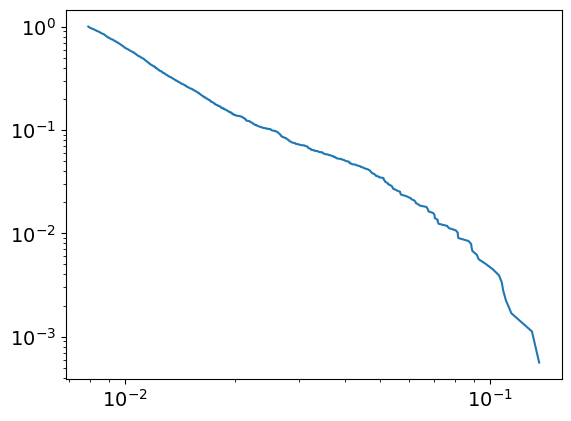

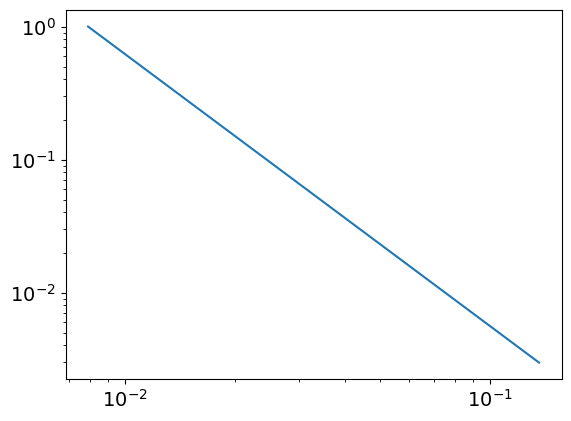

3.0453482906830596
0.007918122164393209
powerlaw KstestResult(statistic=0.9991075299100968, pvalue=0.0, statistic_location=0.09717849726741264, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13611364203071605, statistic_sign=-1)
tensor(-2.4558e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5966, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.1793, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
120
tensor(0.1561, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


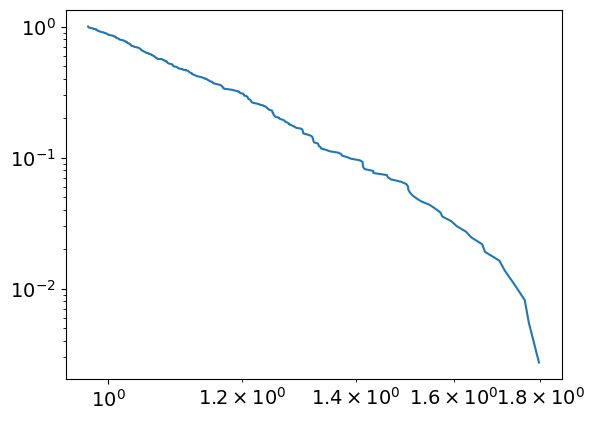

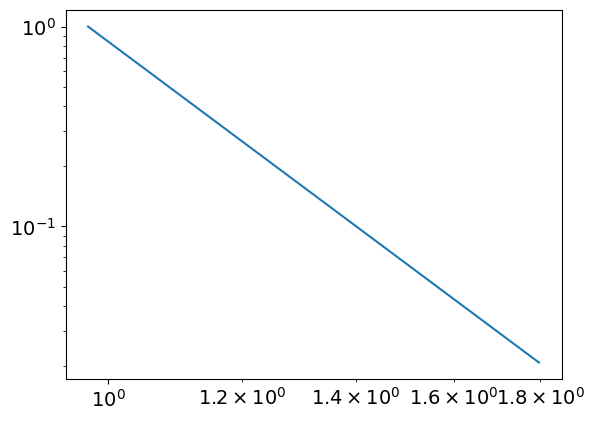

7.312893540586409
0.9731316446526969
powerlaw KstestResult(statistic=0.9940716650163502, pvalue=0.0, statistic_location=1.3519528388108975, statistic_sign=1)
lognorm KstestResult(statistic=0.9893088896061232, pvalue=0.0, statistic_location=1.2288207258774753, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2063, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1947, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5744, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
121
tensor(3.6884e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


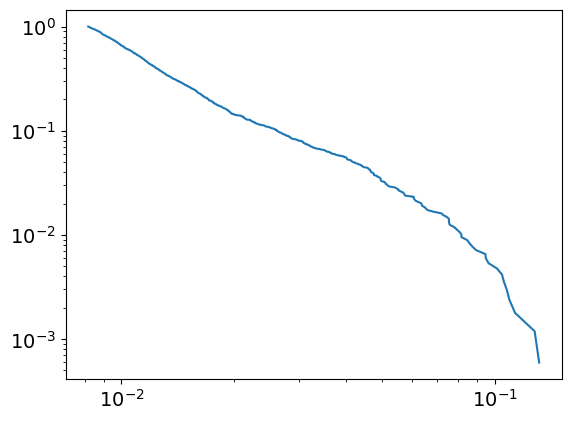

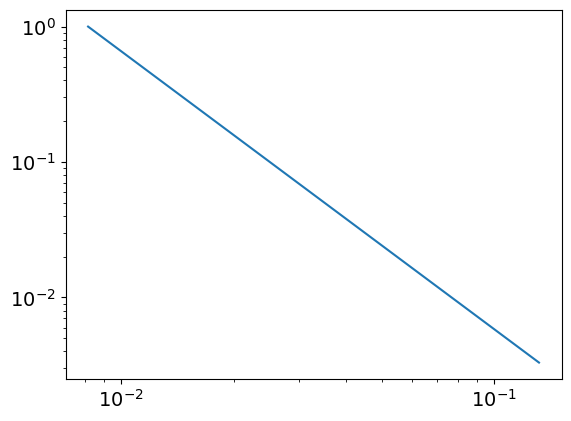

3.0526344122759084
0.008148695206348252
powerlaw KstestResult(statistic=0.9991412440025457, pvalue=0.0, statistic_location=0.09634117361197146, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.11346275307110584, statistic_sign=1)
tensor(3.7157e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4568, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.4890, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
121
tensor(0.1563, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


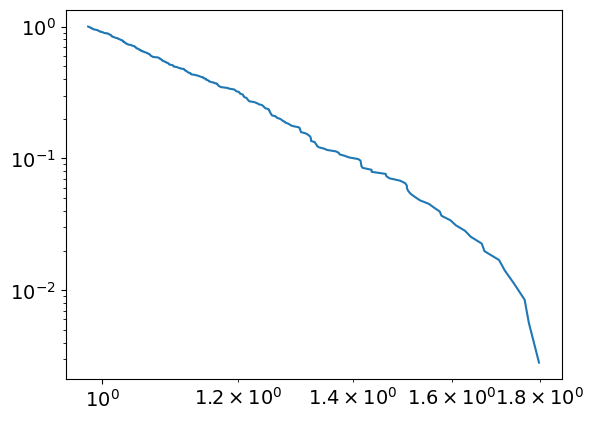

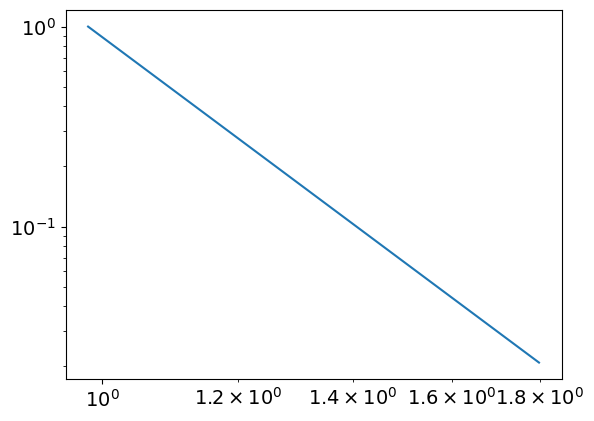

7.382492747083624
0.9809168726774756
powerlaw KstestResult(statistic=0.9942419299904495, pvalue=0.0, statistic_location=1.3752523665505259, statistic_sign=1)
lognorm KstestResult(statistic=0.9893467471594489, pvalue=0.0, statistic_location=1.2341225111803296, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2064, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1951, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5782, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
122
tensor(3.9758e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


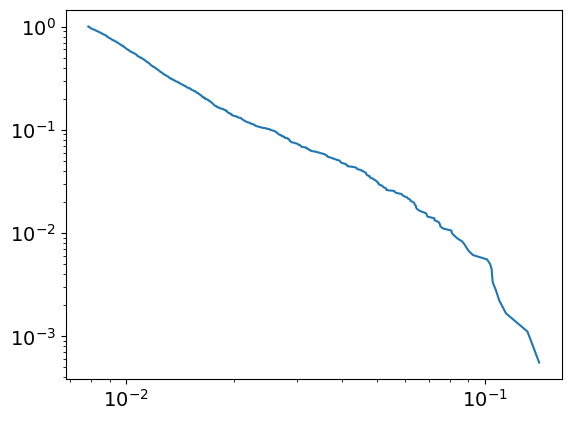

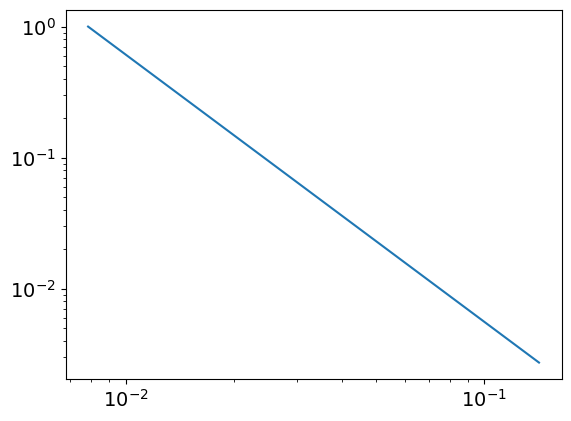

3.0404429441740213
0.007851410864760764
powerlaw KstestResult(statistic=0.9990604072591686, pvalue=0.0, statistic_location=0.09290606967628708, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14199678425938794, statistic_sign=-1)
tensor(-1.7627e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6623, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.4235, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
122
tensor(0.1566, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


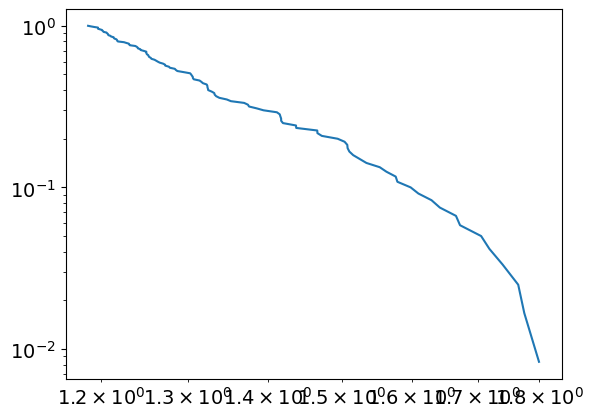

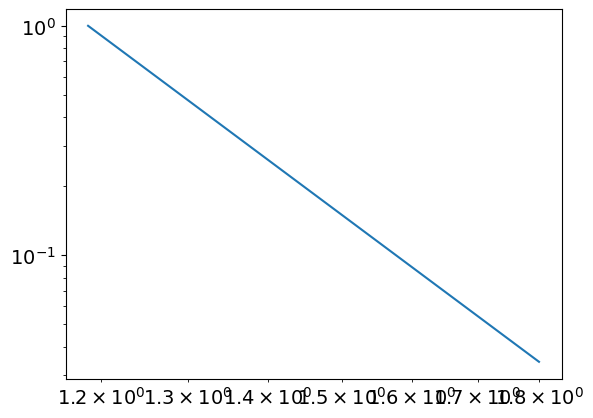

9.084140494368311
1.1857957046833119
powerlaw KstestResult(statistic=0.9983159819938152, pvalue=0.0, statistic_location=1.609394083735626, statistic_sign=1)
lognorm KstestResult(statistic=0.9894280716516461, pvalue=0.0, statistic_location=1.2323905448487928, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2064, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5820, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
123
tensor(3.7165e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


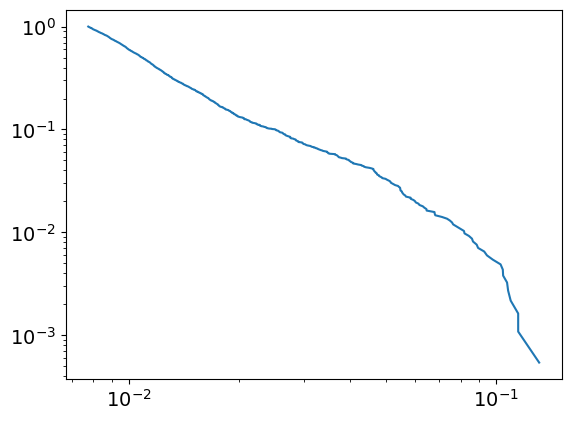

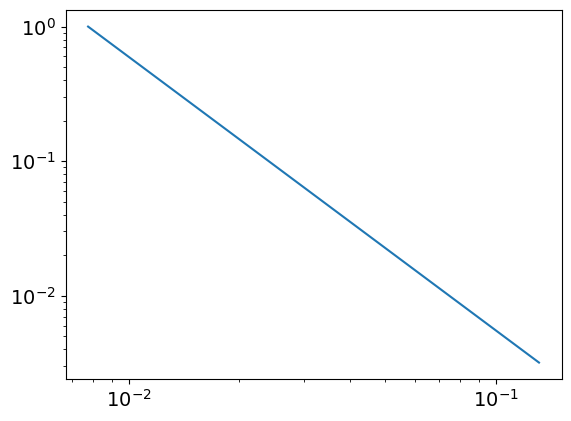

3.0350737325396593
0.007755266307701331
powerlaw KstestResult(statistic=0.9990461266094507, pvalue=0.0, statistic_location=0.10419554405911018, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.11471844637592819, statistic_sign=1)
tensor(2.6585e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3589, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.2324, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
123
tensor(0.1569, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


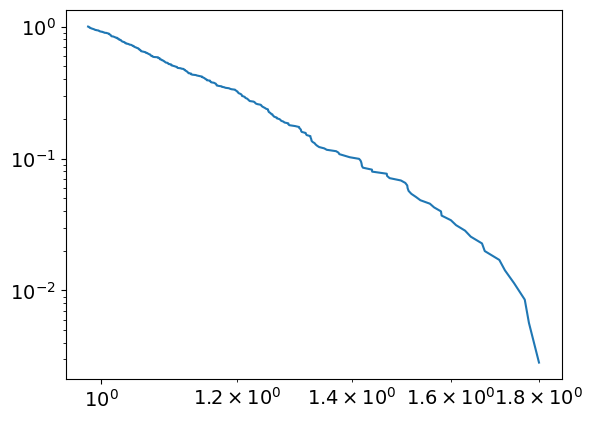

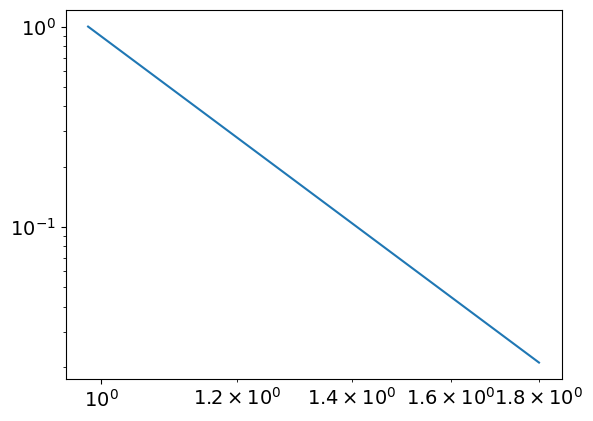

7.378593044314164
0.9826022452736775
powerlaw KstestResult(statistic=0.9942350126161404, pvalue=0.0, statistic_location=1.3770985718137674, statistic_sign=1)
lognorm KstestResult(statistic=0.9893897461354147, pvalue=0.0, statistic_location=1.2333179228757825, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2065, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5859, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
124
tensor(3.7276e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


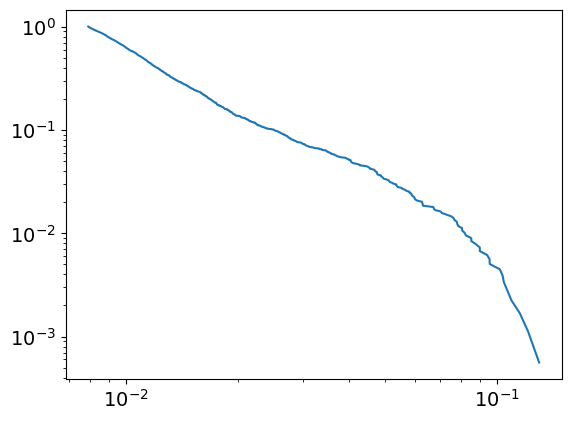

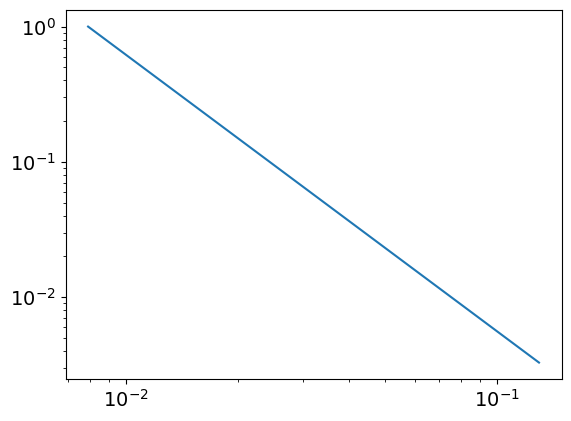

3.043750290218394
0.007907259877359329
powerlaw KstestResult(statistic=0.9990858556340025, pvalue=0.0, statistic_location=0.10343365489035916, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.12121129872036136, statistic_sign=1)
tensor(1.8604e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1129, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.0553, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
124
tensor(0.1571, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


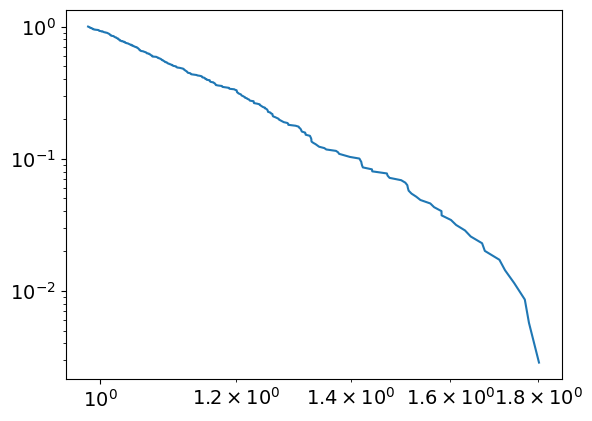

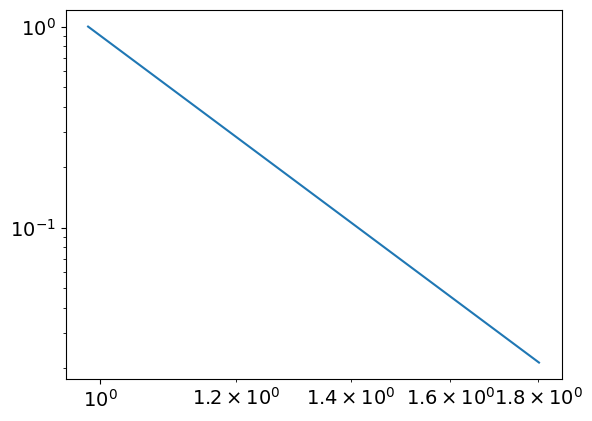

7.359766103266639
0.9839287443356409
powerlaw KstestResult(statistic=0.9942260350512017, pvalue=0.0, statistic_location=1.354537504577038, statistic_sign=1)
lognorm KstestResult(statistic=0.9894282809735891, pvalue=0.0, statistic_location=1.2293010311776722, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2065, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1965, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5897, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
125
tensor(3.7384e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


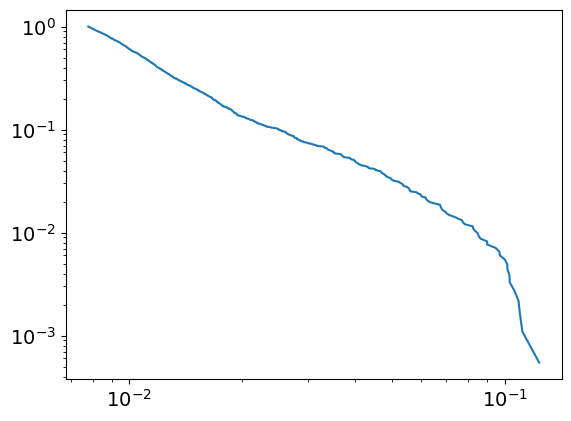

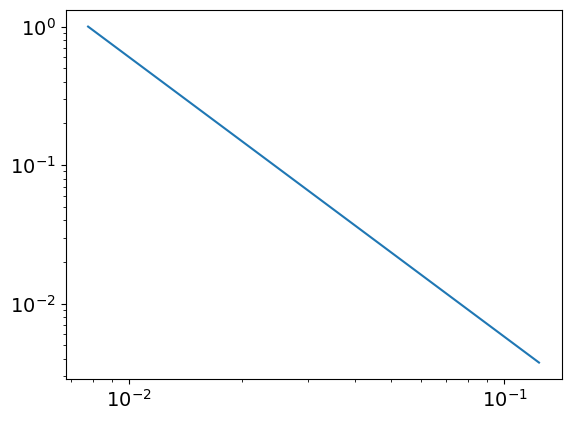

3.0199785229260785
0.00778141210472464
powerlaw KstestResult(statistic=0.999043522071705, pvalue=0.0, statistic_location=0.10320019701073825, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.11150294502478023, statistic_sign=1)
tensor(1.0831e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2241, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.5225, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
125
tensor(0.1573, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


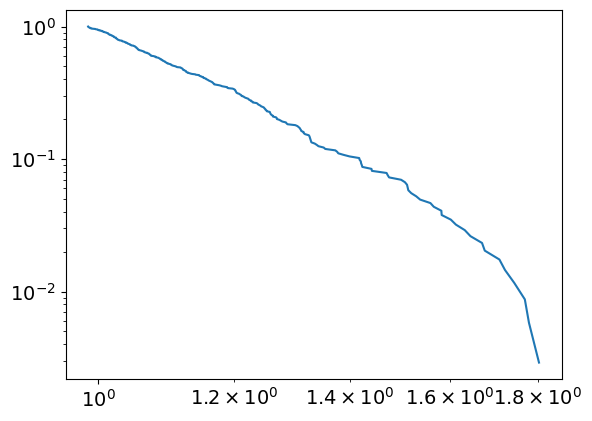

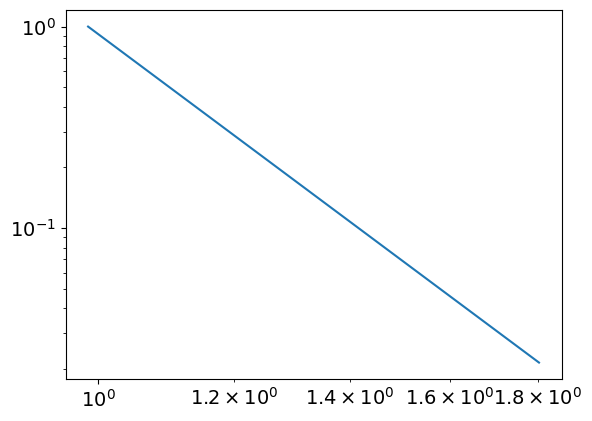

7.37166577830539
0.9868887321553363
powerlaw KstestResult(statistic=0.9942767012652756, pvalue=0.0, statistic_location=1.3788709029808826, statistic_sign=1)
lognorm KstestResult(statistic=0.9894015240609749, pvalue=0.0, statistic_location=1.2300900039297236, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1969, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5936, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
126
tensor(3.8013e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


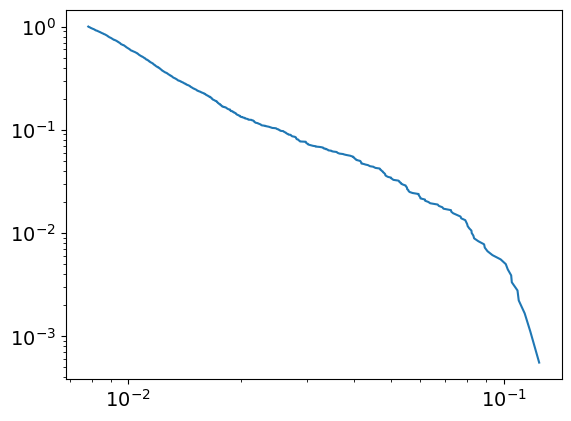

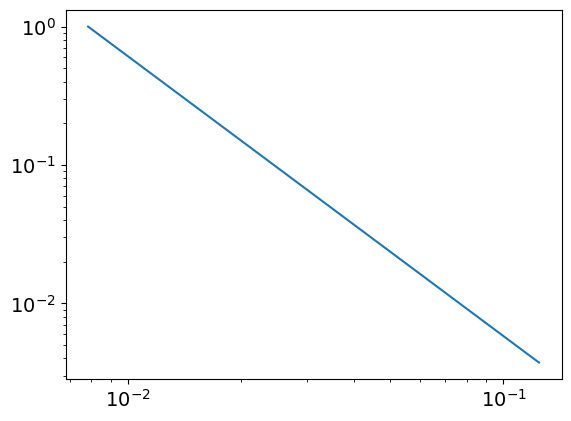

3.0222755843938582
0.007834410512868343
powerlaw KstestResult(statistic=0.9990250669607662, pvalue=0.0, statistic_location=0.0933617597681745, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12432784498189779, statistic_sign=-1)
tensor(-4.2697e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3387, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.7409, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
126
tensor(0.1576, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


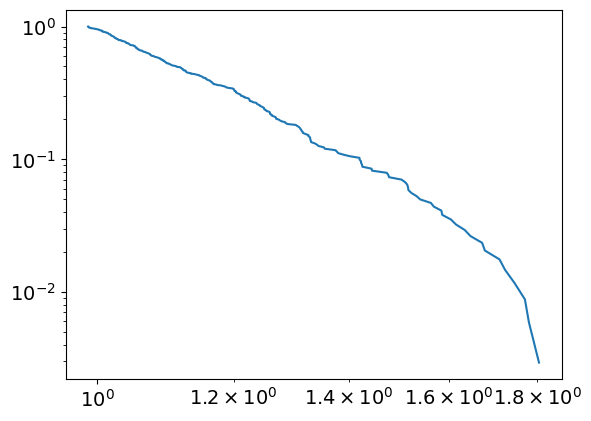

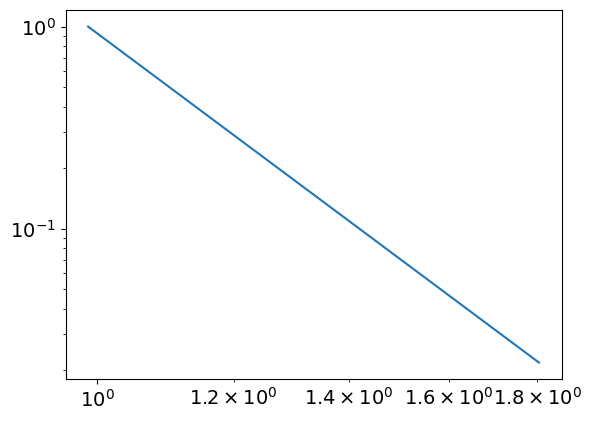

7.360656008966369
0.987973740534582
powerlaw KstestResult(statistic=0.994270483549227, pvalue=0.0, statistic_location=1.3797356794695692, statistic_sign=1)
lognorm KstestResult(statistic=0.9893522101095699, pvalue=0.0, statistic_location=1.2314384748184735, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1973, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5974, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
127
tensor(3.8387e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


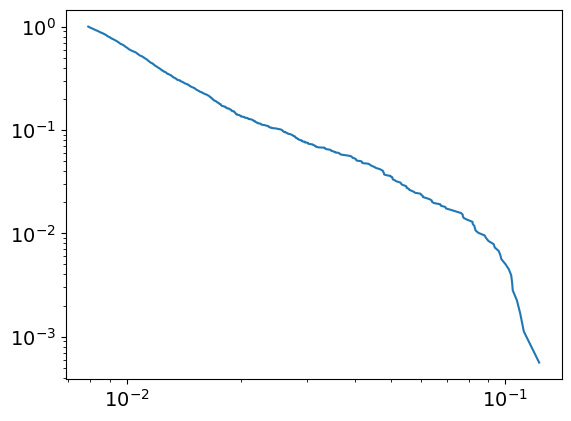

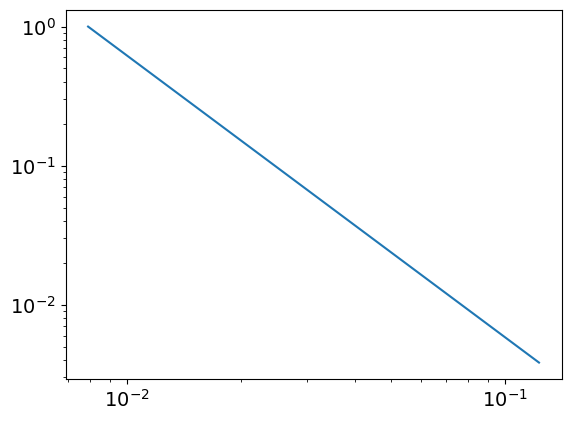

3.0265999812705973
0.007898115097945423
powerlaw KstestResult(statistic=0.9991484265556332, pvalue=0.0, statistic_location=0.1046665811436356, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12293144312790902, statistic_sign=-1)
tensor(-2.5961e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4021, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.6423, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
127
tensor(0.1579, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


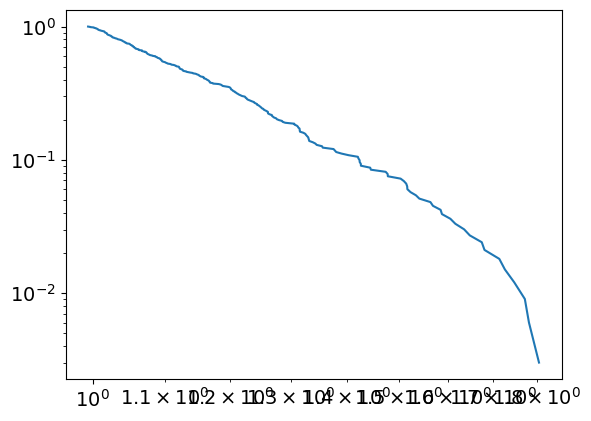

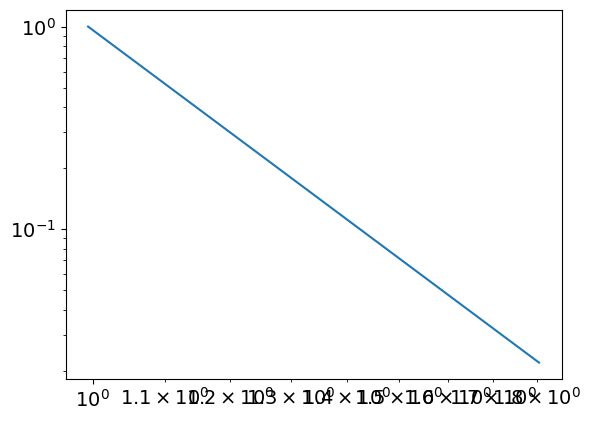

7.400044872790348
0.9941005592556351
powerlaw KstestResult(statistic=0.9943985435642488, pvalue=0.0, statistic_location=1.3806744846498515, statistic_sign=1)
lognorm KstestResult(statistic=0.9892977241702429, pvalue=0.0, statistic_location=1.2355741089472148, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2067, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1977, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6012, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
128
tensor(4.0337e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


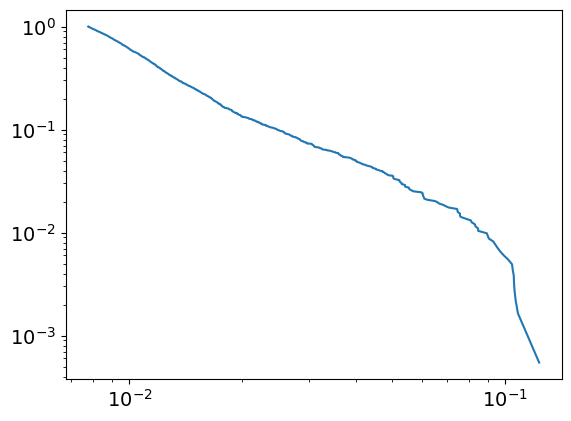

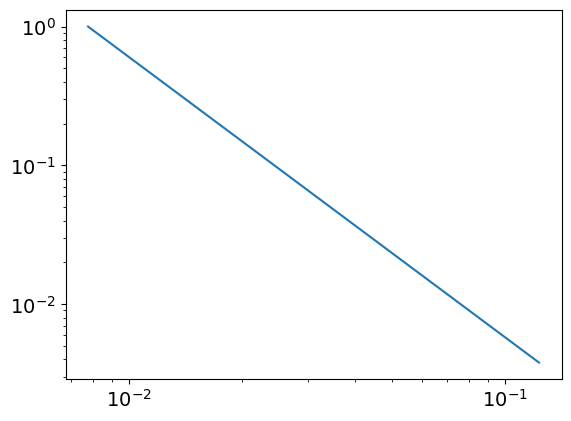

3.0173193782377044
0.007771613350557531
powerlaw KstestResult(statistic=0.9990699780740293, pvalue=0.0, statistic_location=0.10669477778609418, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1232132557410668, statistic_sign=-1)
tensor(-2.7506e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3892, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.6900, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
128
tensor(0.1581, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


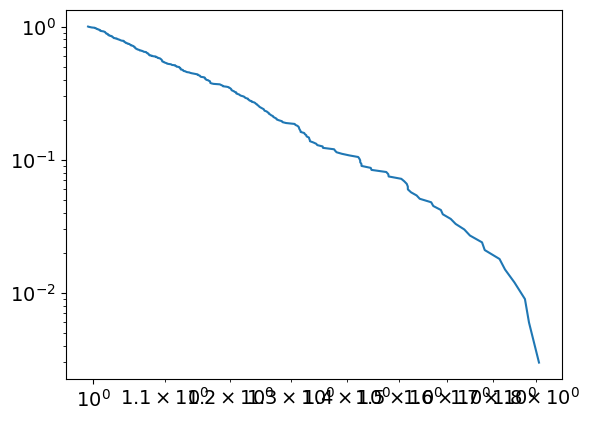

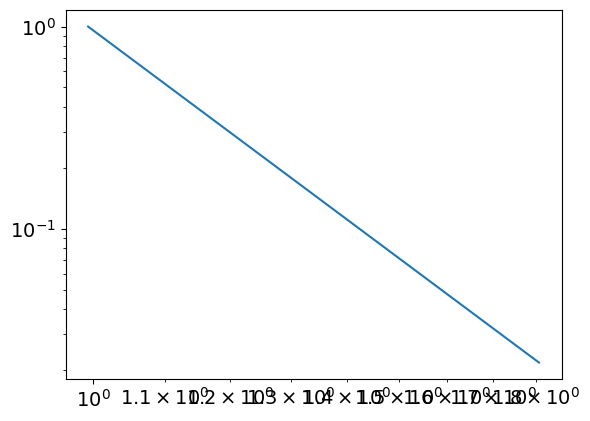

7.3989404983948655
0.9936129521740996
powerlaw KstestResult(statistic=0.9943746447619053, pvalue=0.0, statistic_location=1.3815311190941284, statistic_sign=1)
lognorm KstestResult(statistic=0.9893561439717143, pvalue=0.0, statistic_location=1.2344502229063279, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2068, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1981, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6050, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
129
tensor(4.3700e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


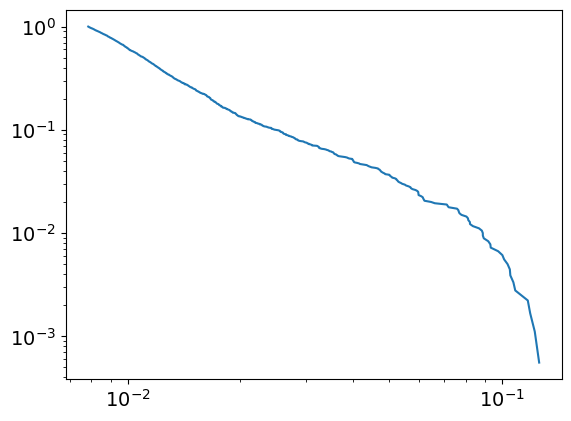

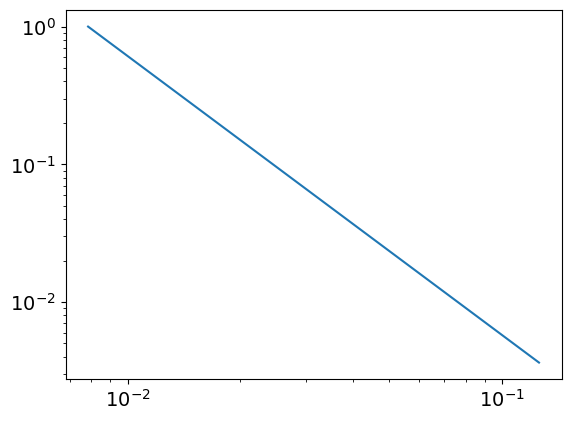

3.025012207802909
0.007845480616787887
powerlaw KstestResult(statistic=0.998944353485077, pvalue=0.0, statistic_location=0.10728415807215042, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12573174950970958, statistic_sign=-1)
tensor(-3.6197e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4970, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.3908, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
129
tensor(0.1584, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


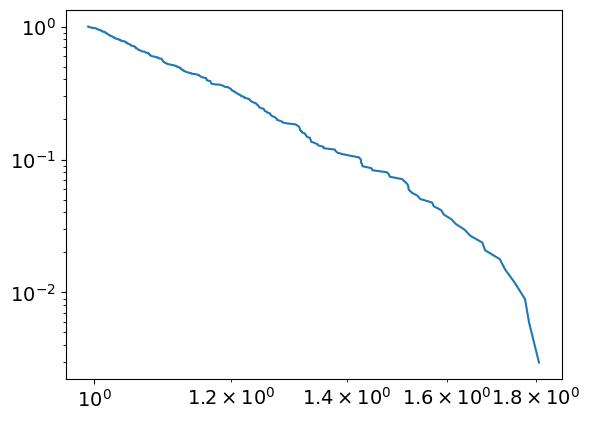

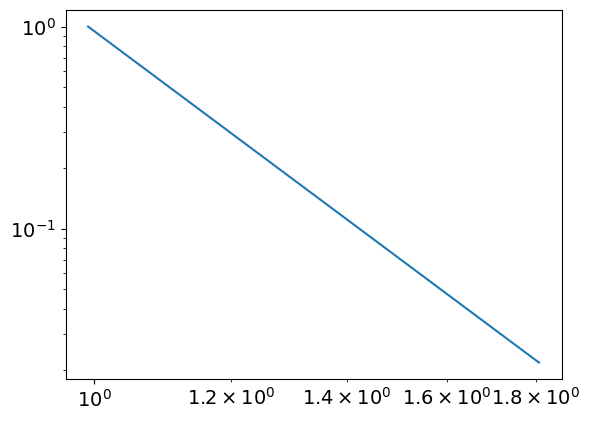

7.383702849922561
0.9923104055194949
powerlaw KstestResult(statistic=0.9943226891136476, pvalue=0.0, statistic_location=1.3824062646733843, statistic_sign=1)
lognorm KstestResult(statistic=0.9893031658418429, pvalue=0.0, statistic_location=1.2356263829036722, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2068, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1985, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6088, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
130
tensor(4.5577e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


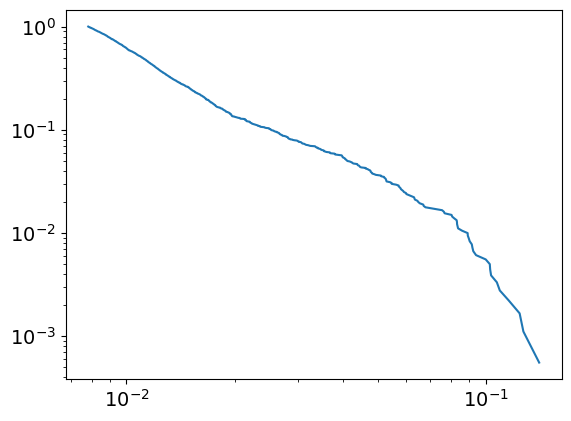

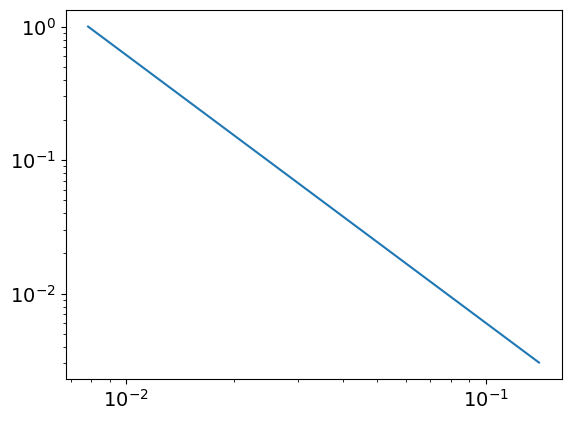

3.0050254500265767
0.007829600697641437
powerlaw KstestResult(statistic=0.9990212988891345, pvalue=0.0, statistic_location=0.09233634588659106, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14082509254313227, statistic_sign=-1)
tensor(-2.9834e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5657, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.9646, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
130
tensor(0.1586, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


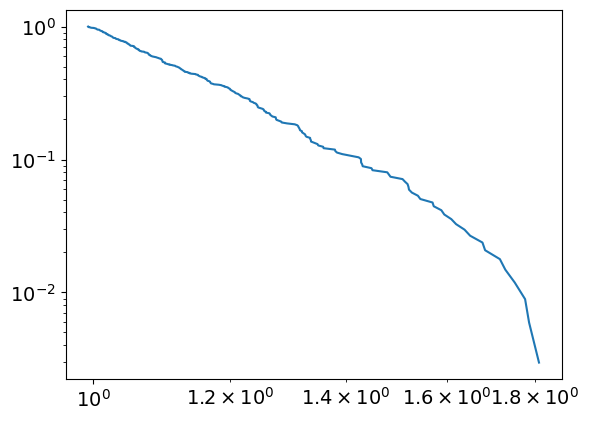

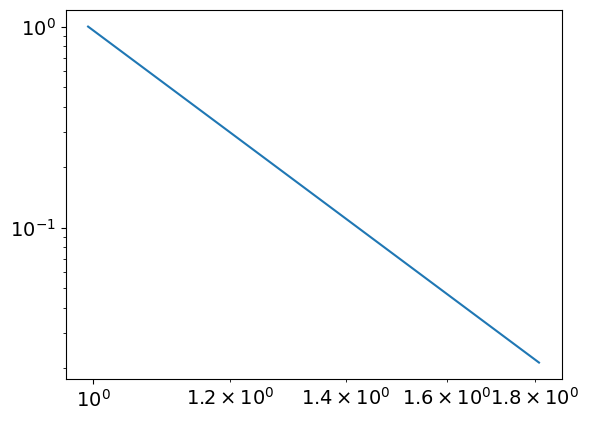

7.412428665934415
0.9934605062421158
powerlaw KstestResult(statistic=0.9943539957459524, pvalue=0.0, statistic_location=1.3832309308789845, statistic_sign=1)
lognorm KstestResult(statistic=0.9892667234052327, pvalue=0.0, statistic_location=1.2337741407220668, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2069, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1990, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6127, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
131
tensor(4.4671e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


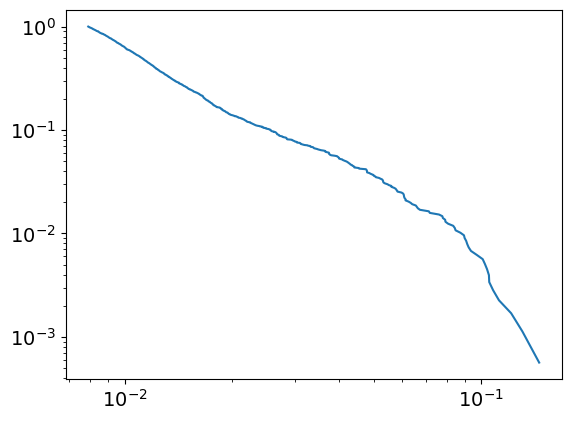

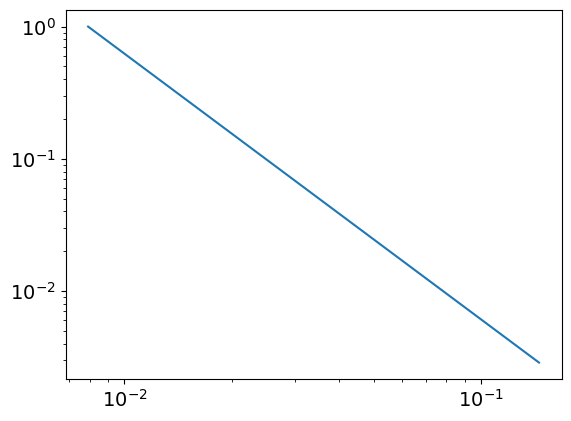

3.0099538533354906
0.007905576208638828
powerlaw KstestResult(statistic=0.9990318806437033, pvalue=0.0, statistic_location=0.09225146135185908, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14546132338280687, statistic_sign=-1)
tensor(-3.5629e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2878, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
131
tensor(0.1589, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


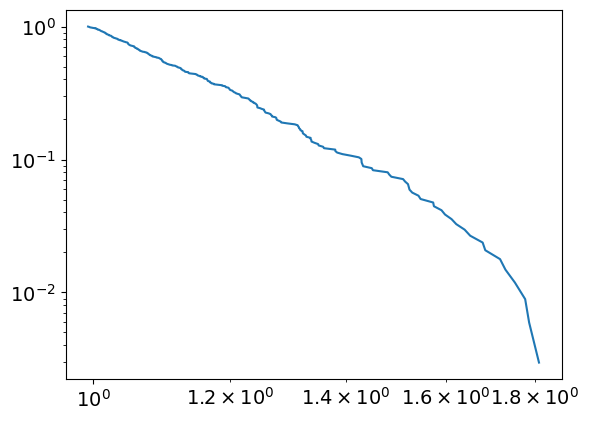

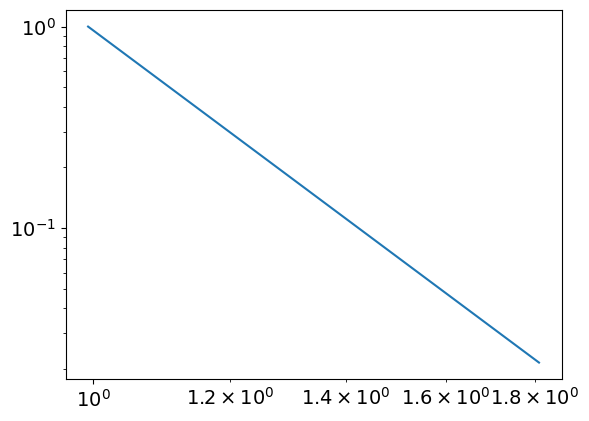

7.398074689071338
0.9936263676817341
powerlaw KstestResult(statistic=0.9943275838233111, pvalue=0.0, statistic_location=1.3841657379753993, statistic_sign=1)
lognorm KstestResult(statistic=0.9892515298339156, pvalue=0.0, statistic_location=1.2447815700217222, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1994, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6164, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
132
tensor(4.2488e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


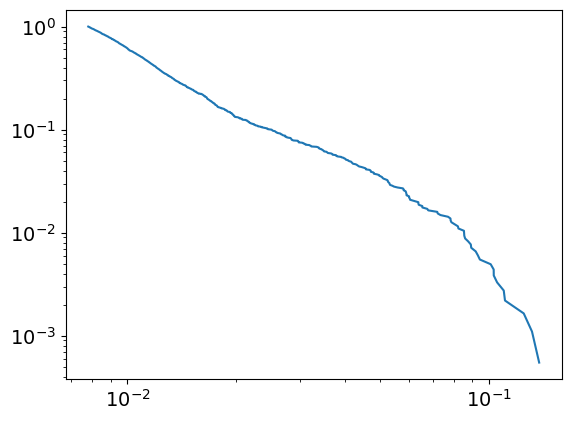

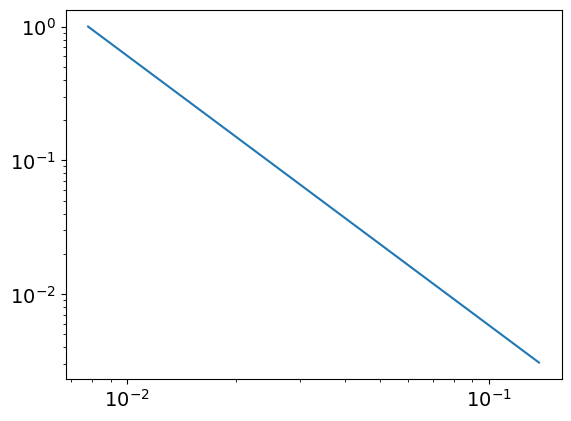

3.012393020305183
0.00779083714897641
powerlaw KstestResult(statistic=0.999011046151465, pvalue=0.0, statistic_location=0.09329253333149509, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13175786571226814, statistic_sign=-1)
tensor(-3.1998e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4525, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.3657, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
132
tensor(0.1591, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


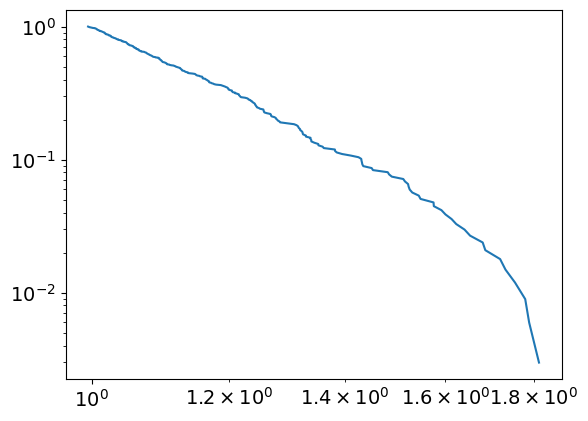

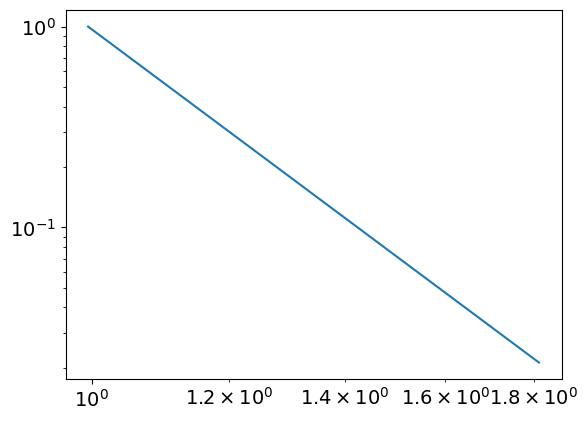

7.428063773256896
0.9952737275183858
powerlaw KstestResult(statistic=0.9943681274266661, pvalue=0.0, statistic_location=1.3850107298549108, statistic_sign=1)
lognorm KstestResult(statistic=0.989195481392827, pvalue=0.0, statistic_location=1.2455749627838975, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1998, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6203, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
133
tensor(4.2855e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


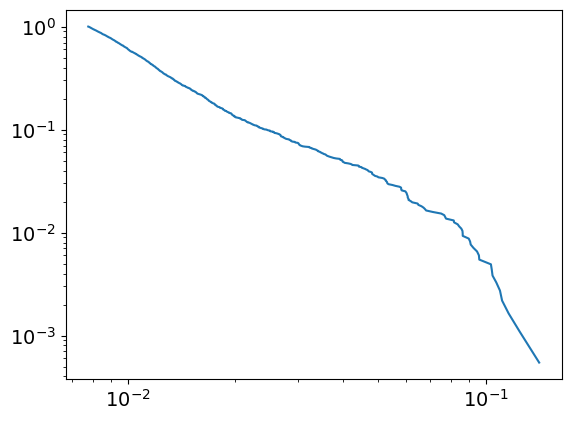

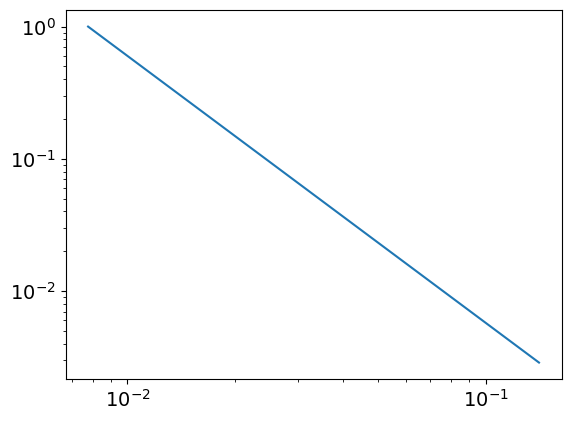

3.01838173460123
0.0077662278316219325
powerlaw KstestResult(statistic=0.9989613669181647, pvalue=0.0, statistic_location=0.0959574123084383, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12438500028971942, statistic_sign=-1)
tensor(-2.5318e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2424, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.6208, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
133
tensor(0.1594, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


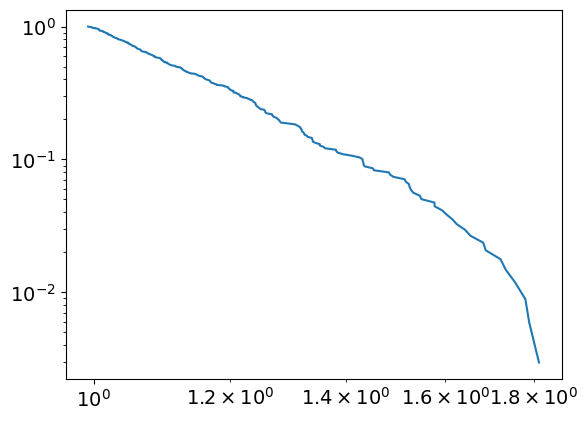

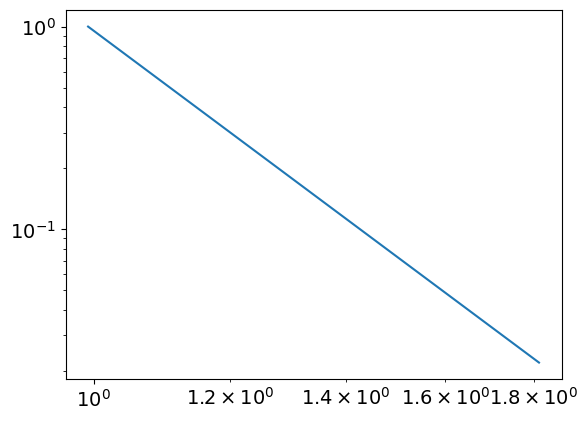

7.339644199534908
0.9925972688411356
powerlaw KstestResult(statistic=0.9942226109503868, pvalue=0.0, statistic_location=1.3624549266332027, statistic_sign=1)
lognorm KstestResult(statistic=0.9891761662749101, pvalue=0.0, statistic_location=1.242486247460959, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2070, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6241, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
134
tensor(4.2107e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


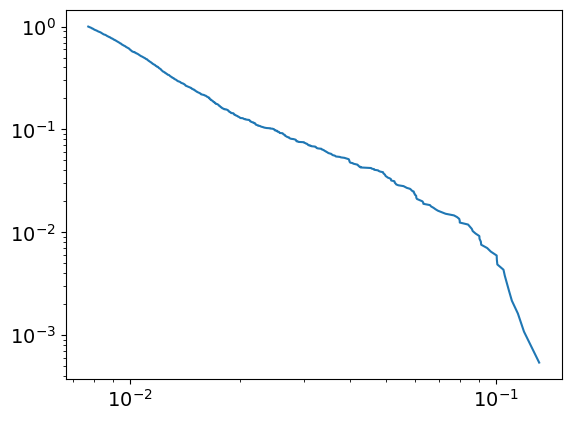

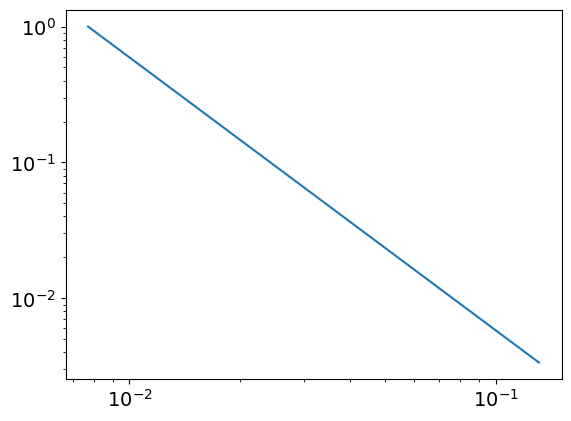

3.0084705813654384
0.00771095905943634
powerlaw KstestResult(statistic=0.9989232442727073, pvalue=0.0, statistic_location=0.0910394793964718, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11940597505083207, statistic_sign=-1)
tensor(-2.7014e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3169, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.7753, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
134
tensor(0.1596, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


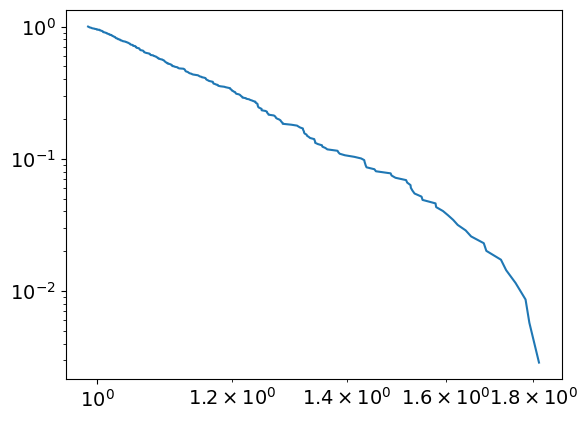

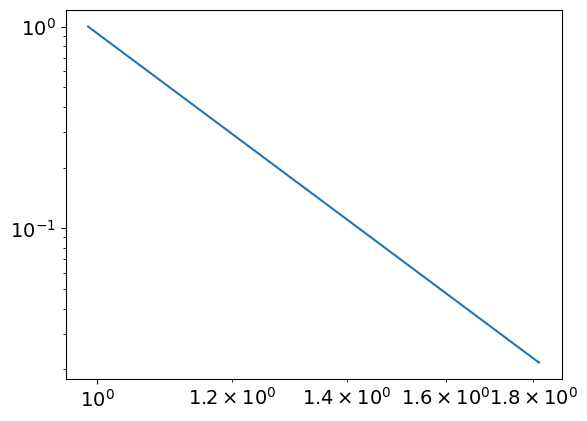

7.311368502546515
0.9877765545394872
powerlaw KstestResult(statistic=0.9941164185537157, pvalue=0.0, statistic_location=1.3636474777508252, statistic_sign=1)
lognorm KstestResult(statistic=0.9892454313260305, pvalue=0.0, statistic_location=1.248185559662222, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2071, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2006, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6279, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
135
tensor(4.2256e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


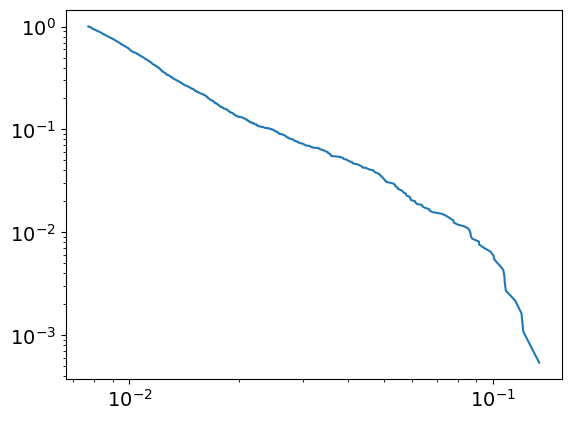

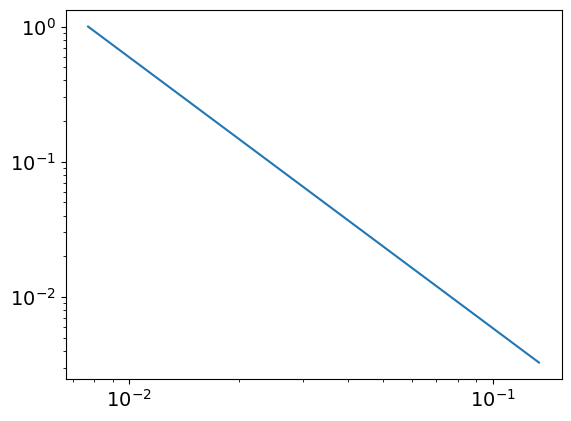

3.0038147706464255
0.0077035843065896845
powerlaw KstestResult(statistic=0.9988570116892043, pvalue=0.0, statistic_location=0.10850923135845147, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12115557143523357, statistic_sign=-1)
tensor(-2.3355e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2500, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.5577, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
135
tensor(0.1599, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


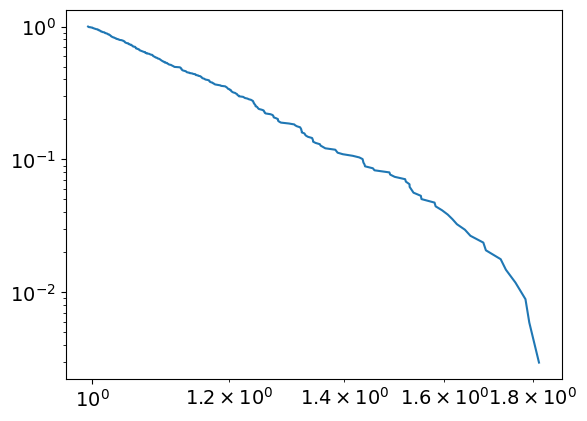

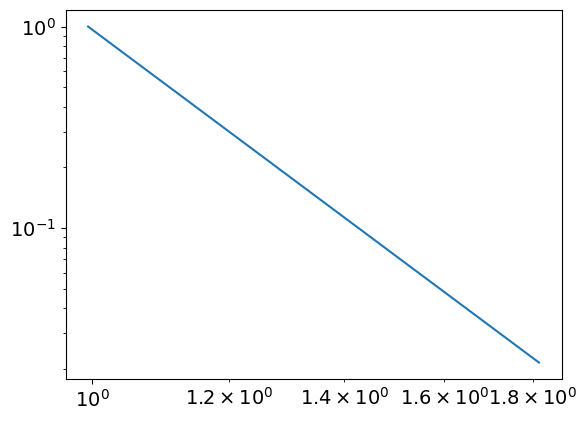

7.382839086778445
0.994533649352007
powerlaw KstestResult(statistic=0.9942699263593997, pvalue=0.0, statistic_location=1.3874295684080127, statistic_sign=1)
lognorm KstestResult(statistic=0.9891598591969938, pvalue=0.0, statistic_location=1.2478040480706338, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2071, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2011, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6318, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
136
tensor(4.4713e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


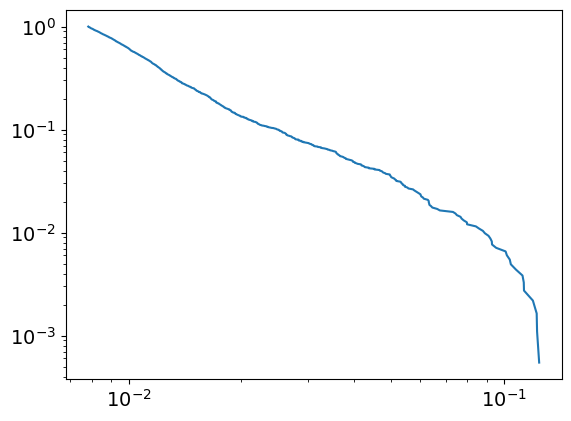

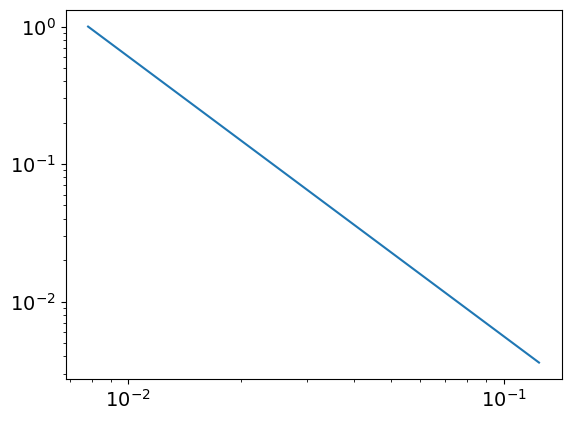

3.0329719913004887
0.007810863323046837
powerlaw KstestResult(statistic=0.9987804939969865, pvalue=0.0, statistic_location=0.10449781387129942, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12245962519399009, statistic_sign=-1)
tensor(-1.5590e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1046, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4746, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
136
tensor(0.1601, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


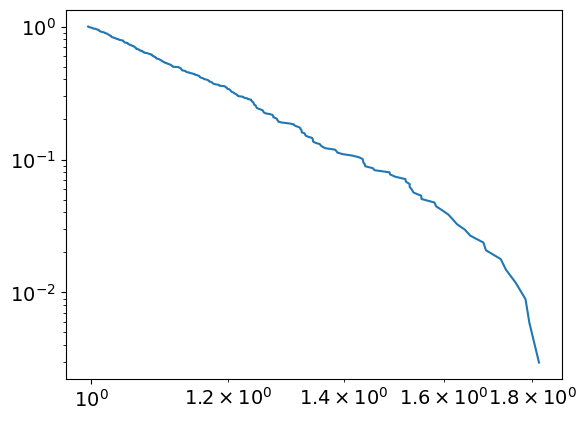

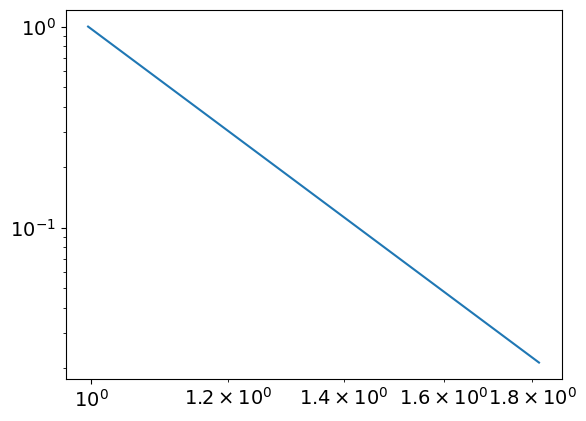

7.399294391637013
0.9958711741706414
powerlaw KstestResult(statistic=0.994294014953518, pvalue=0.0, statistic_location=1.388302760662318, statistic_sign=1)
lognorm KstestResult(statistic=0.9891913202979156, pvalue=0.0, statistic_location=1.2475297404043175, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2072, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2015, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6356, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
137
tensor(4.4208e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


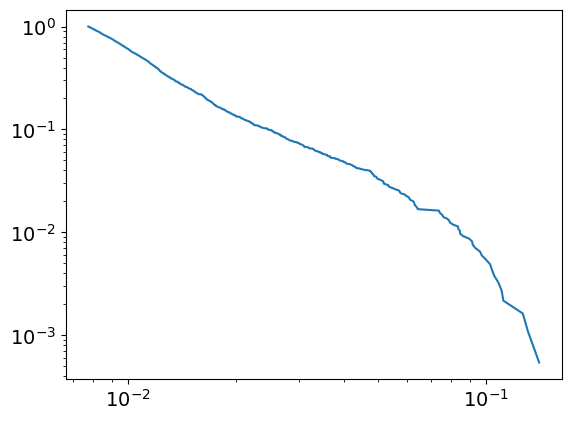

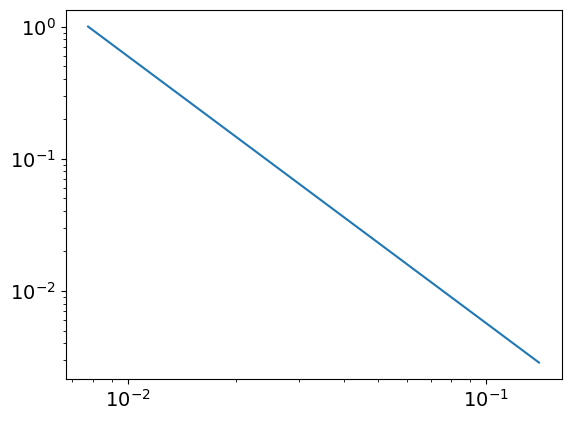

3.0196464520189017
0.0077390578439773434
powerlaw KstestResult(statistic=0.9988697173055153, pvalue=0.0, statistic_location=0.09992732513179858, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14058364028657924, statistic_sign=-1)
tensor(-2.7610e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3233, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.8211, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
137
tensor(0.1604, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


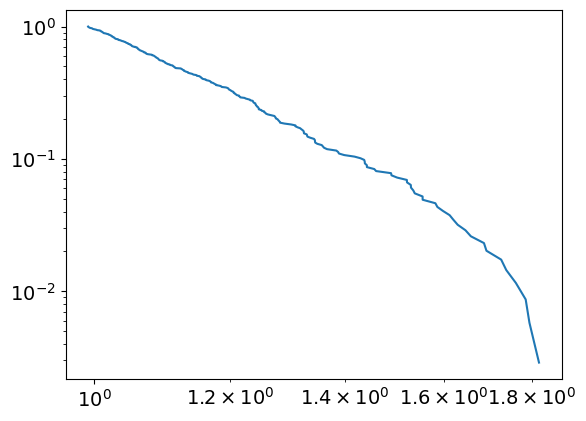

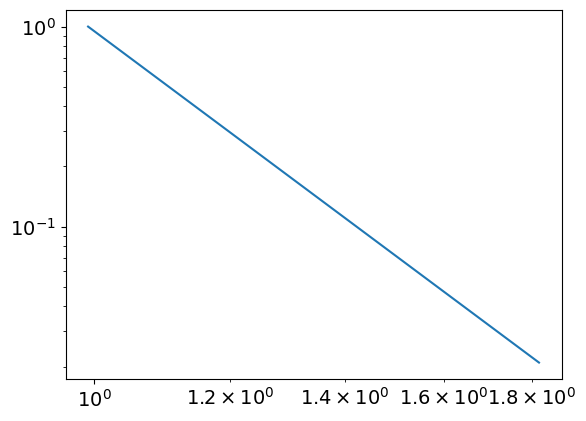

7.381892830340009
0.991763228718943
powerlaw KstestResult(statistic=0.9941808183506233, pvalue=0.0, statistic_location=1.3891345049697748, statistic_sign=1)
lognorm KstestResult(statistic=0.9892123119449003, pvalue=0.0, statistic_location=1.2473854373742395, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2073, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2019, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6394, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
138
tensor(4.1163e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


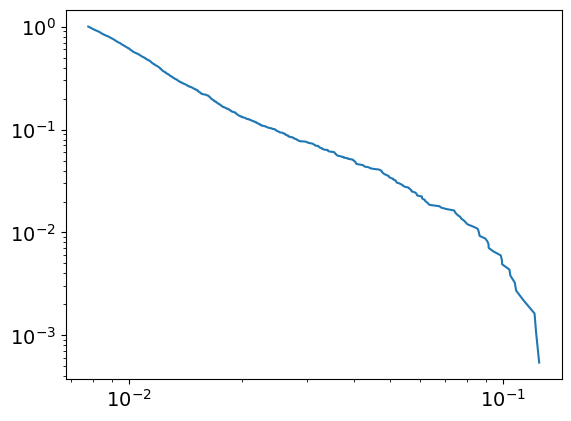

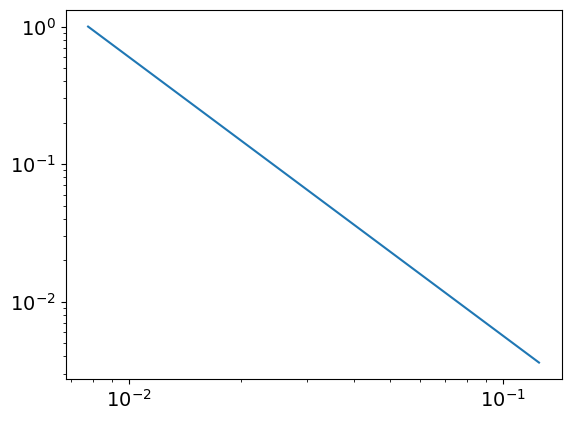

3.0256041042519475
0.007776884802101262
powerlaw KstestResult(statistic=0.998910542858217, pvalue=0.0, statistic_location=0.10844399907391876, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1225666005958381, statistic_sign=-1)
tensor(-1.7234e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2888, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.6424, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
138
tensor(0.1606, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


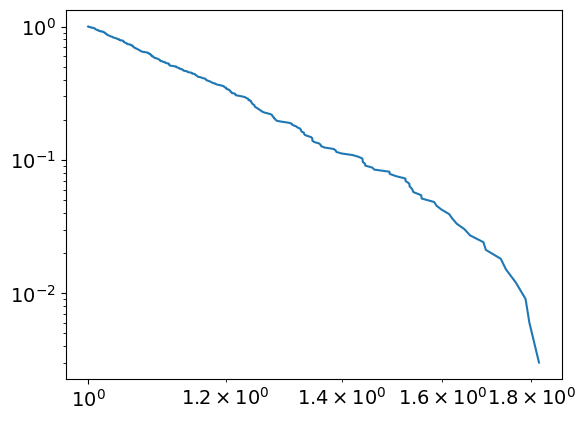

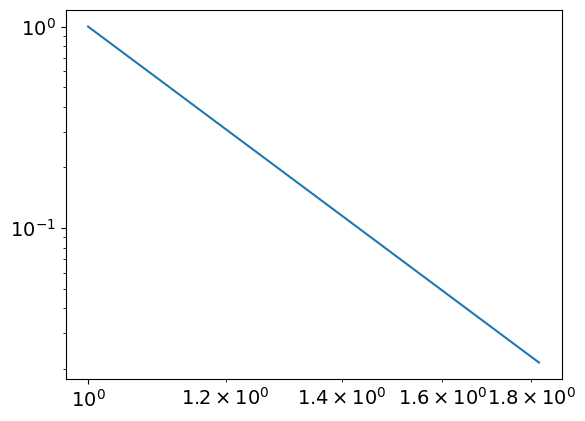

7.4210502850914954
1.0001016586565978
powerlaw KstestResult(statistic=0.9943606588228437, pvalue=0.0, statistic_location=1.3899196991497749, statistic_sign=1)
lognorm KstestResult(statistic=0.9891444825046423, pvalue=0.0, statistic_location=1.2370585760042068, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2073, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2023, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6433, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
139
tensor(4.5832e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


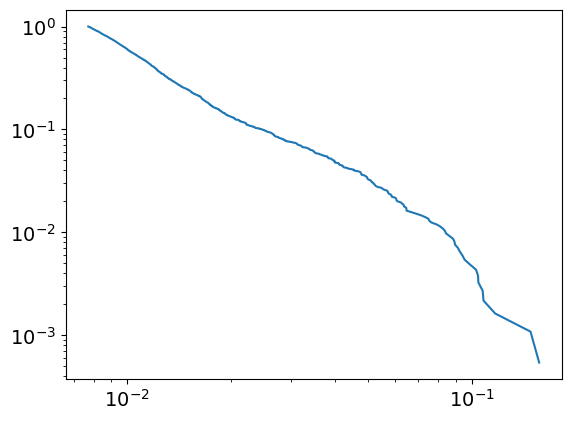

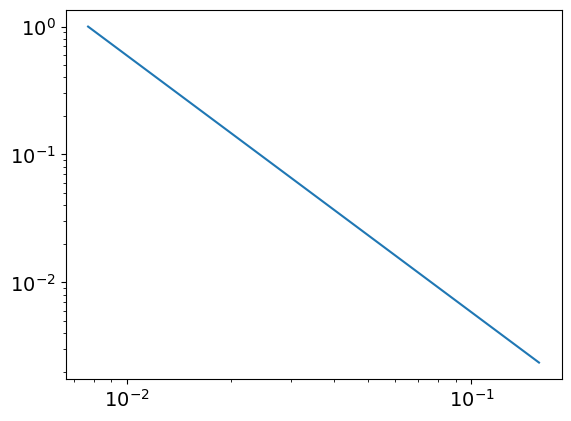

3.008692713130204
0.007715438452991894
powerlaw KstestResult(statistic=0.9989807868212146, pvalue=0.0, statistic_location=0.10461844943526108, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15702876093184184, statistic_sign=-1)
tensor(-1.5882e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2967, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.6127, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
139
tensor(0.1609, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


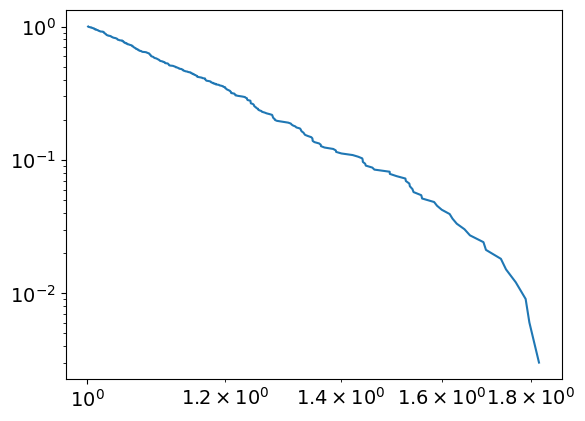

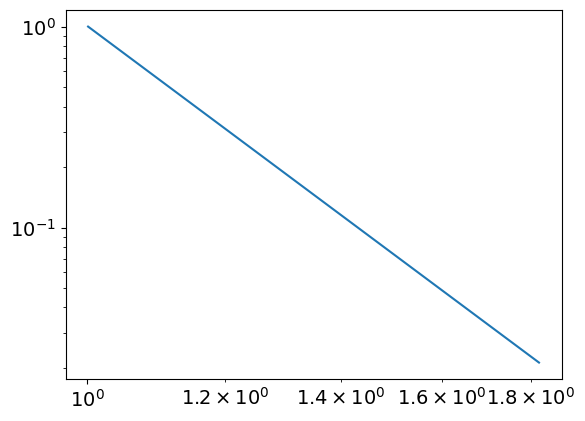

7.4447469030651465
1.0011449473995169
powerlaw KstestResult(statistic=0.9943846196336225, pvalue=0.0, statistic_location=1.3907500982768115, statistic_sign=1)
lognorm KstestResult(statistic=0.9892021535094143, pvalue=0.0, statistic_location=1.2359883911060001, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2074, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2027, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6471, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
140
tensor(4.7208e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


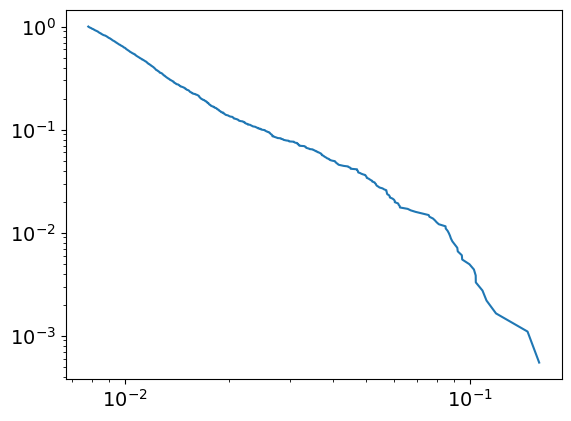

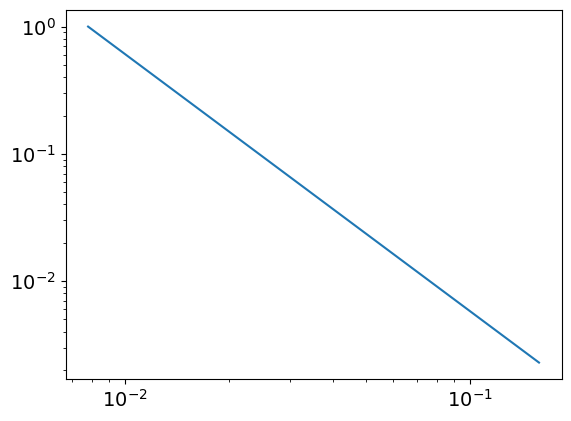

3.02098735604619
0.007816636241737823
powerlaw KstestResult(statistic=0.9990306193244748, pvalue=0.0, statistic_location=0.10379980531077196, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15842507325040747, statistic_sign=-1)
tensor(-7.7521e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3986, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.7518, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
140
tensor(0.1611, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


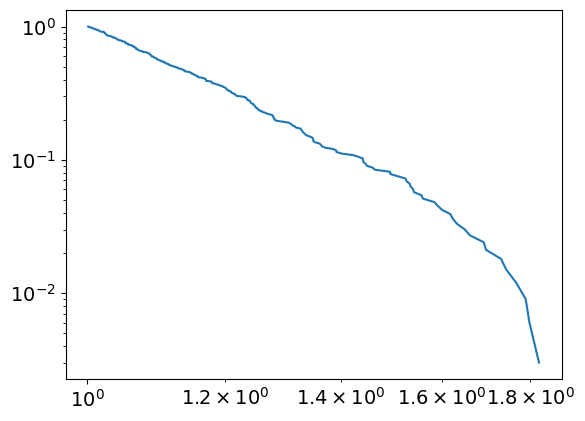

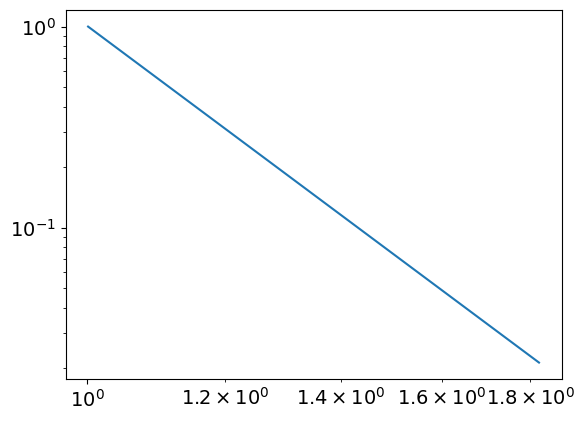

7.432693569797885
1.000819038616531
powerlaw KstestResult(statistic=0.9943546339064799, pvalue=0.0, statistic_location=1.3915557964306389, statistic_sign=1)
lognorm KstestResult(statistic=0.9891565092255803, pvalue=0.0, statistic_location=1.237010460076316, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2074, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2031, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6510, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
141
tensor(4.3786e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


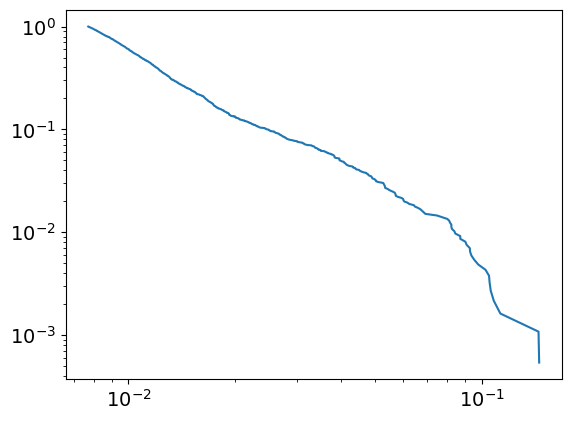

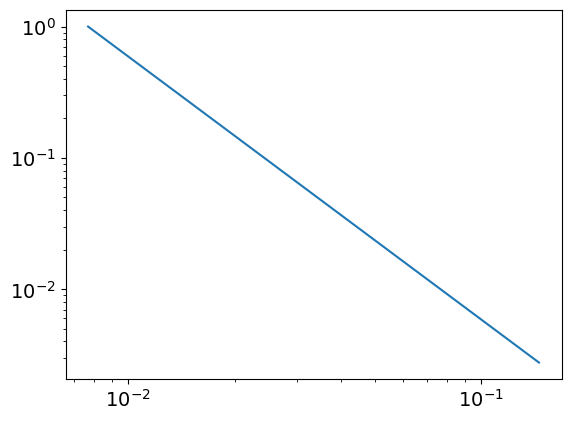

3.0039409457836403
0.0076979007892725125
powerlaw KstestResult(statistic=0.9989485030817906, pvalue=0.0, statistic_location=0.10539367872033194, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14557873684713324, statistic_sign=-1)
tensor(-1.7933e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2164, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5545, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
141
tensor(0.1614, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


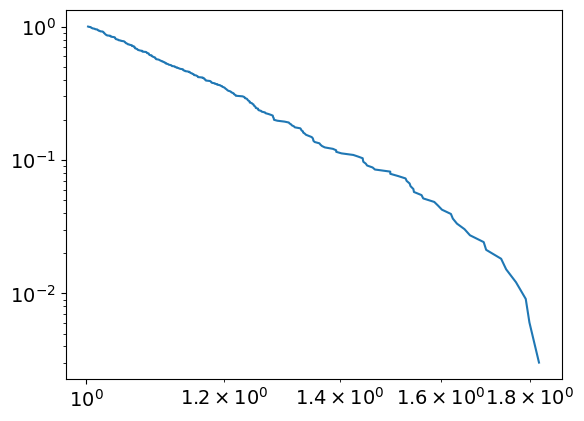

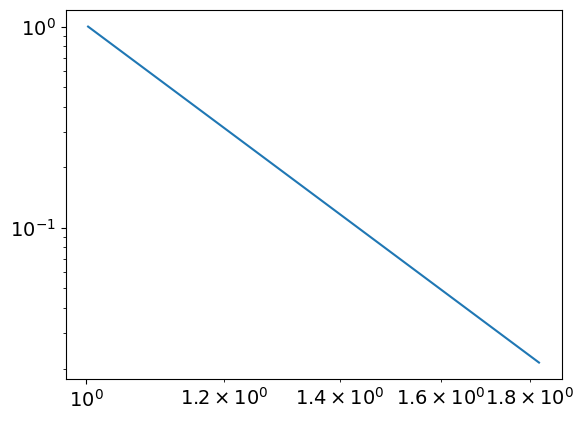

7.434044083718596
1.0023092836419671
powerlaw KstestResult(statistic=0.9943658876297536, pvalue=0.0, statistic_location=1.3924704724371573, statistic_sign=1)
lognorm KstestResult(statistic=0.9891558855713473, pvalue=0.0, statistic_location=1.2394950045297006, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2075, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2035, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6548, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
142
tensor(4.5071e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


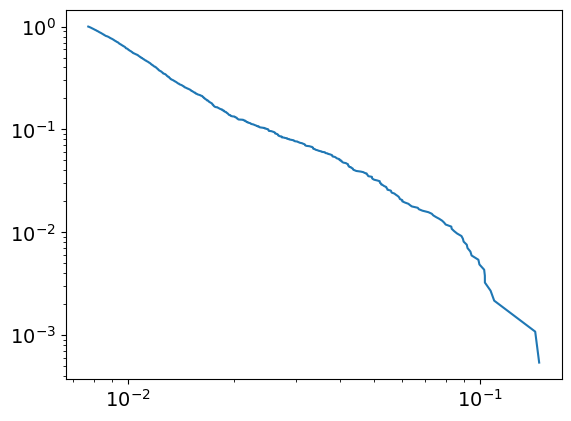

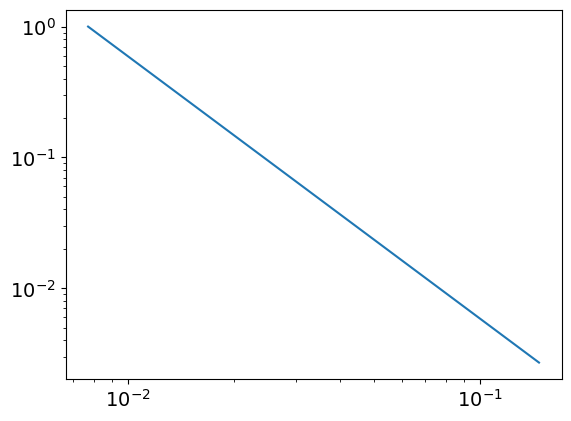

3.0044654648826246
0.007712628940752697
powerlaw KstestResult(statistic=0.9990071955314641, pvalue=0.0, statistic_location=0.10333625239339198, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14361722942929472, statistic_sign=-1)
tensor(-2.0461e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3205, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.3751, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
142
tensor(0.1616, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


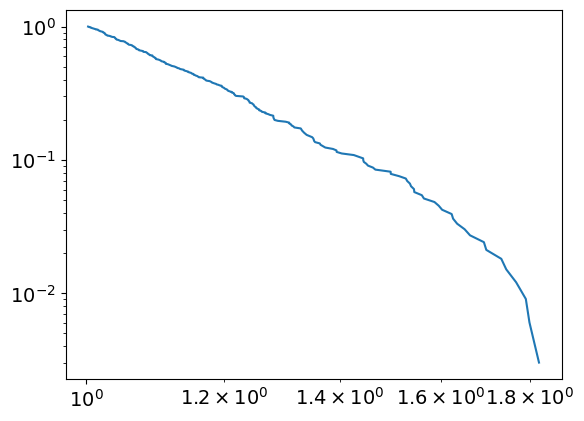

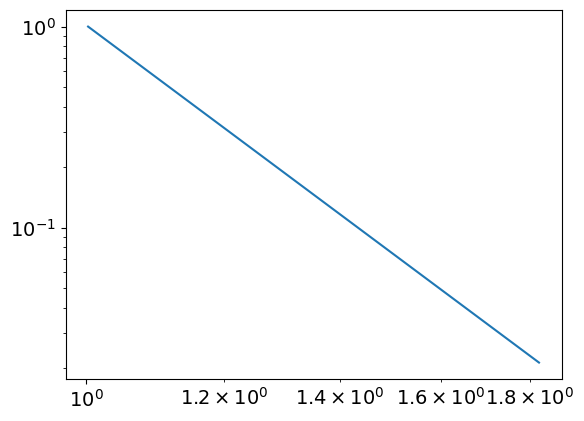

7.428942290912295
1.002127416079464
powerlaw KstestResult(statistic=0.9943376254283373, pvalue=0.0, statistic_location=1.3936368598980255, statistic_sign=1)
lognorm KstestResult(statistic=0.9891394993598539, pvalue=0.0, statistic_location=1.2398879225318387, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2075, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2039, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6587, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
143
tensor(4.1290e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


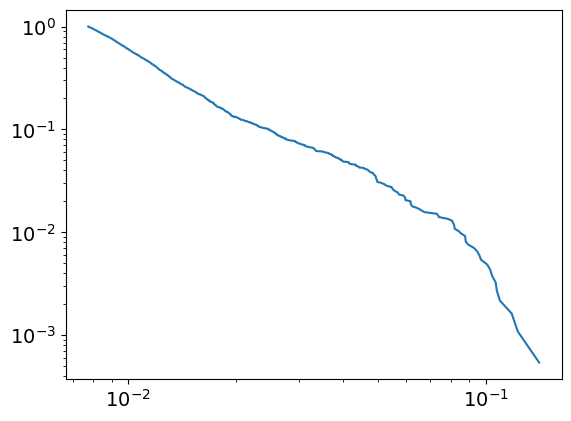

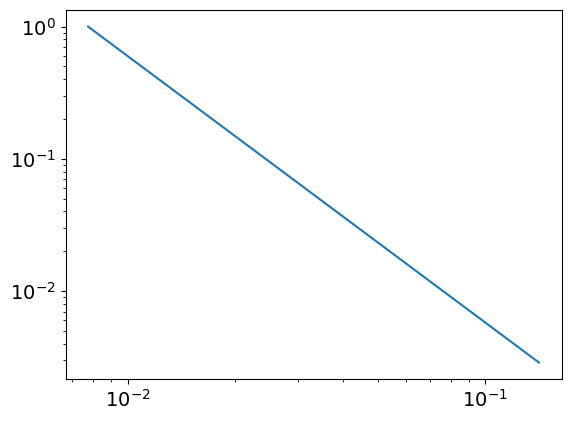

3.0145913255284866
0.007744343606401129
powerlaw KstestResult(statistic=0.9989106923571928, pvalue=0.0, statistic_location=0.10756550489229212, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1412618972969465, statistic_sign=1)
tensor(1.1263e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0239, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.0401, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
143
tensor(0.1618, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


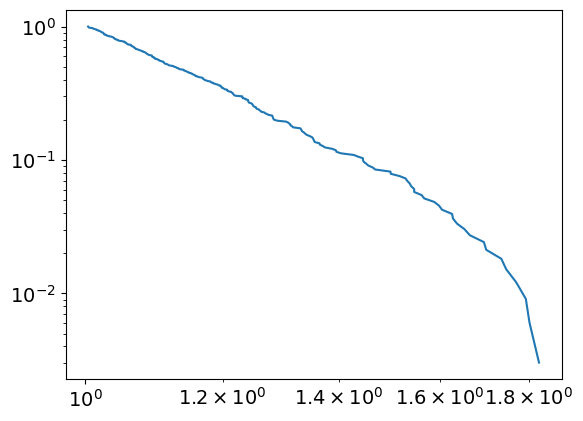

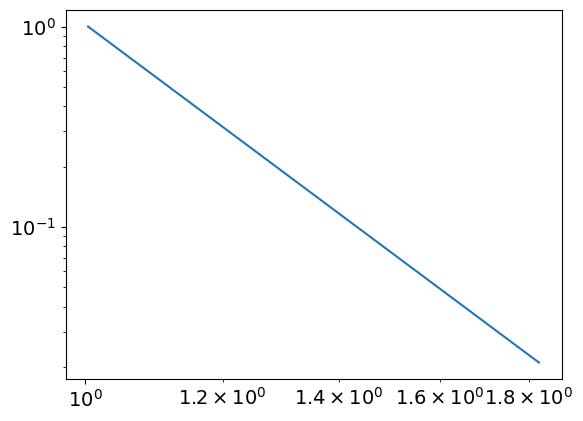

7.472642786277987
1.0041008358944241
powerlaw KstestResult(statistic=0.9943888350862539, pvalue=0.0, statistic_location=1.394832708020904, statistic_sign=1)
lognorm KstestResult(statistic=0.9891311216370614, pvalue=0.0, statistic_location=1.2321605410847987, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2076, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6625, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
144
tensor(4.5235e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


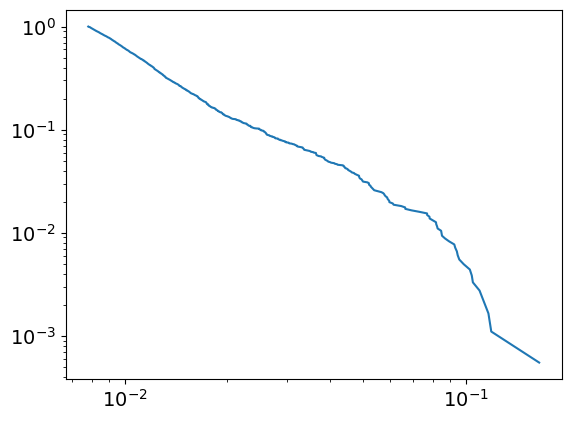

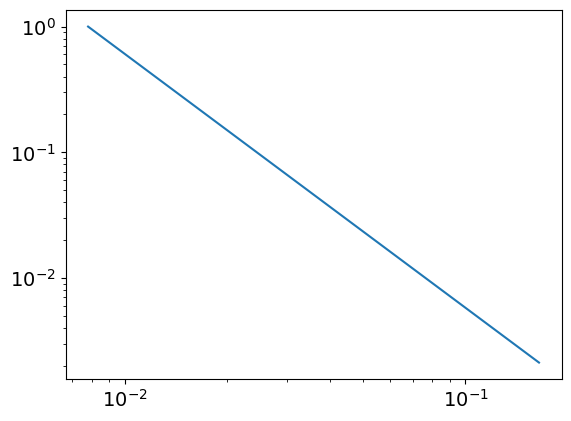

3.021570756659136
0.007815880870101634
powerlaw KstestResult(statistic=0.9989992669001684, pvalue=0.0, statistic_location=0.10501164585834268, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16431053196475653, statistic_sign=1)
tensor(8.6284e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1372, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.0023, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
144
tensor(0.1621, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


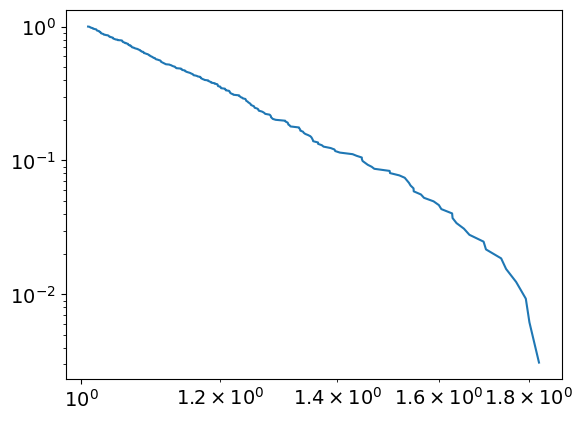

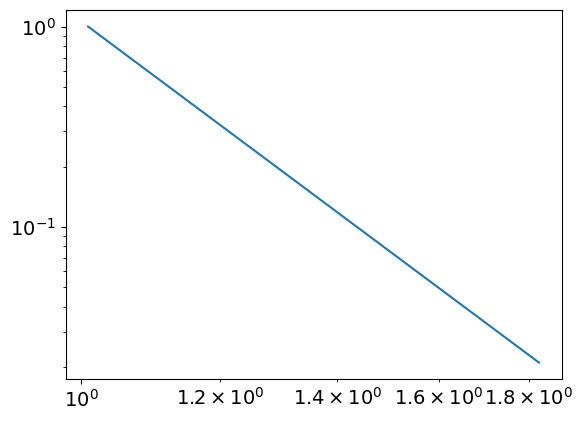

7.514646965968978
1.008919748863798
powerlaw KstestResult(statistic=0.994481270850553, pvalue=0.0, statistic_location=1.3960310953580208, statistic_sign=1)
lognorm KstestResult(statistic=0.9891187615657817, pvalue=0.0, statistic_location=1.2355870250990009, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2076, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2048, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6664, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
145
tensor(4.4585e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


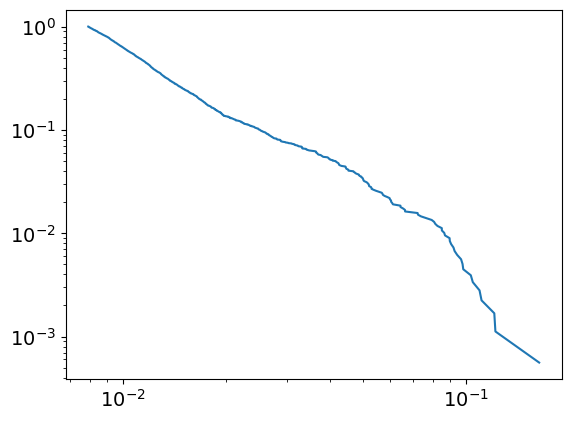

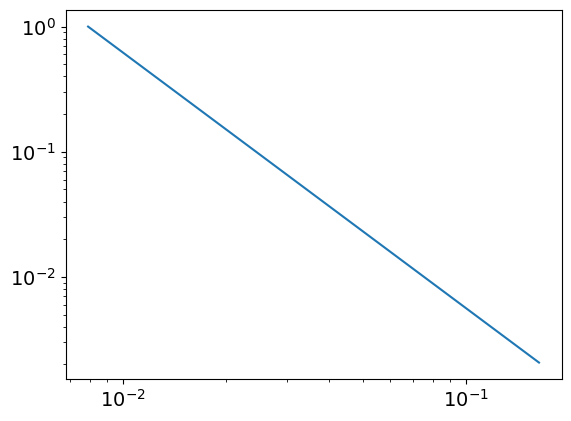

3.0412416075589075
0.007909194869192645
powerlaw KstestResult(statistic=0.9990867629013862, pvalue=0.0, statistic_location=0.10321454923515297, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12174959231796921, statistic_sign=-1)
tensor(-1.3840e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0052, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.9021, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
145
tensor(0.1623, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


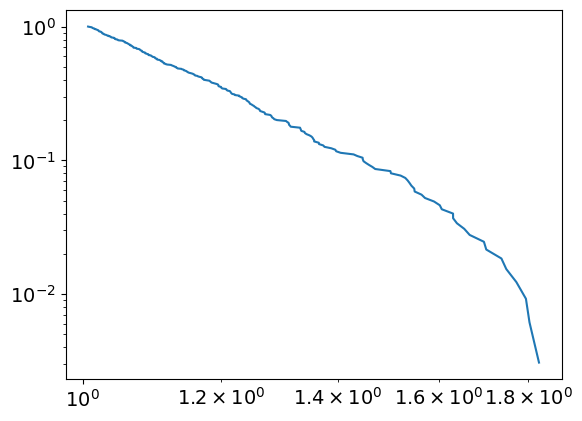

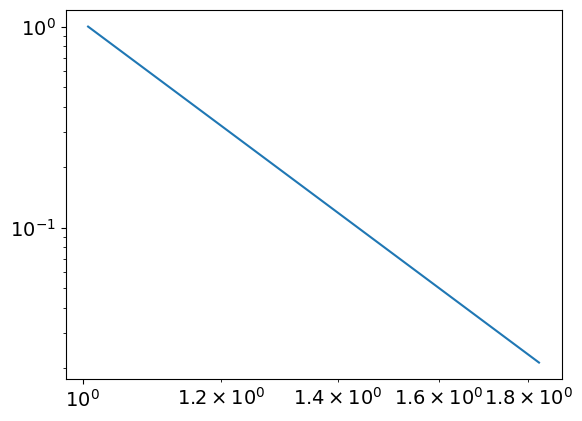

7.46357104628834
1.007165330386246
powerlaw KstestResult(statistic=0.9943931094902749, pvalue=0.0, statistic_location=1.397199991991836, statistic_sign=1)
lognorm KstestResult(statistic=0.9891806518570898, pvalue=0.0, statistic_location=1.2343126898824703, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2052, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6703, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
146
tensor(4.4989e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


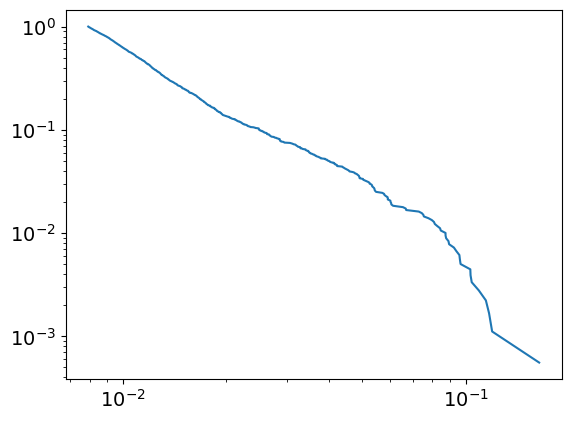

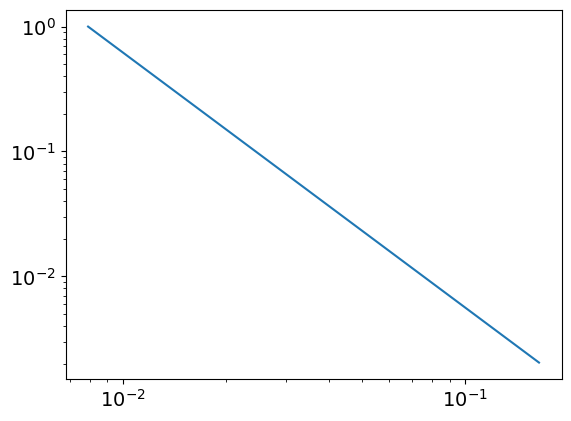

3.0430949900142688
0.007910943936302631
powerlaw KstestResult(statistic=0.9990649317713223, pvalue=0.0, statistic_location=0.10421630264031055, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16400993707228678, statistic_sign=1)
tensor(6.1338e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1262, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.0579, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
146
tensor(0.1626, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


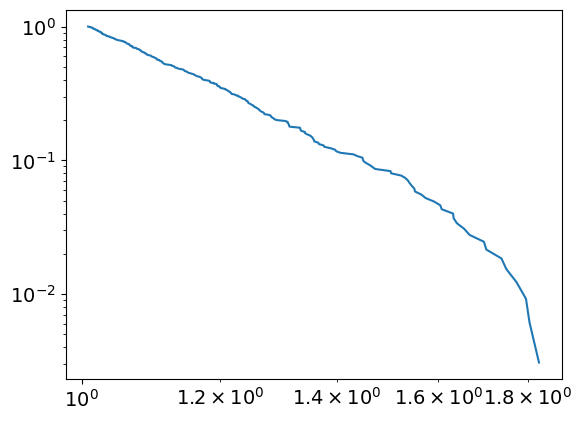

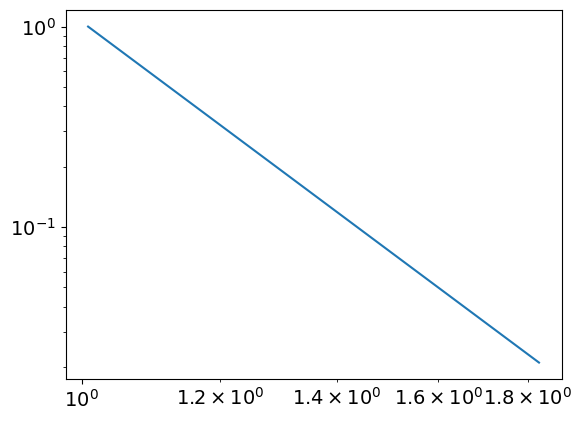

7.494869292767228
1.008388105216941
powerlaw KstestResult(statistic=0.9944184325324026, pvalue=0.0, statistic_location=1.398449829800483, statistic_sign=1)
lognorm KstestResult(statistic=0.9891523178939657, pvalue=0.0, statistic_location=1.2350804709706193, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2056, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6742, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
147
tensor(4.6505e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


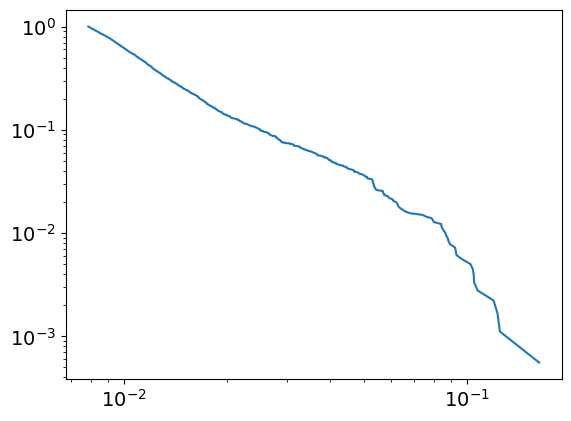

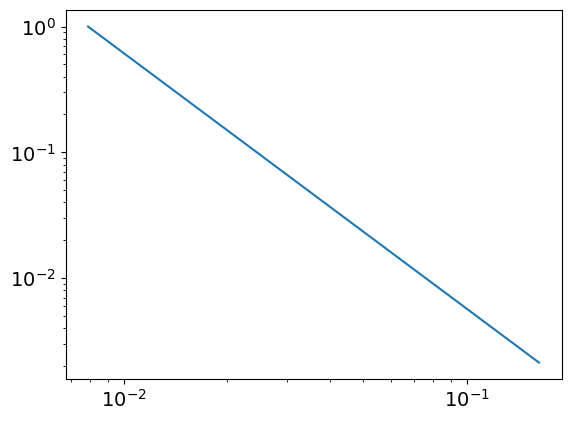

3.032978902789671
0.0078766256307042
powerlaw KstestResult(statistic=0.9990431422809694, pvalue=0.0, statistic_location=0.09327224593373942, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12480988450761962, statistic_sign=-1)
tensor(-2.0090e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1034, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4650, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
147
tensor(0.1628, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


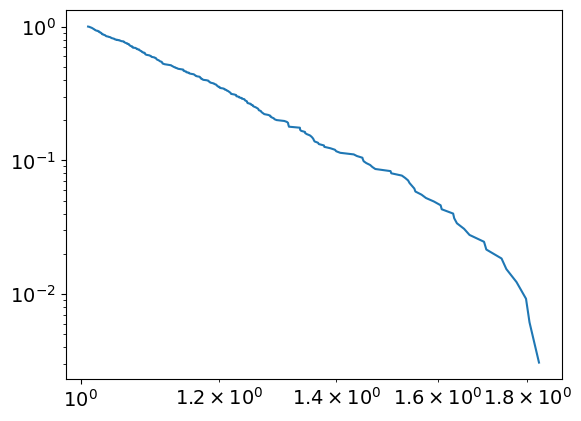

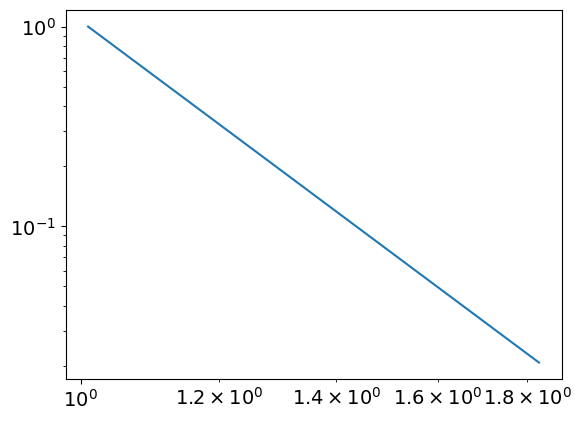

7.527030224977701
1.009579642519741
powerlaw KstestResult(statistic=0.9944456574657186, pvalue=0.0, statistic_location=1.4069829668474847, statistic_sign=1)
lognorm KstestResult(statistic=0.9891648385444832, pvalue=0.0, statistic_location=1.2317462733179765, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2077, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2061, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6781, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
148
tensor(4.3130e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


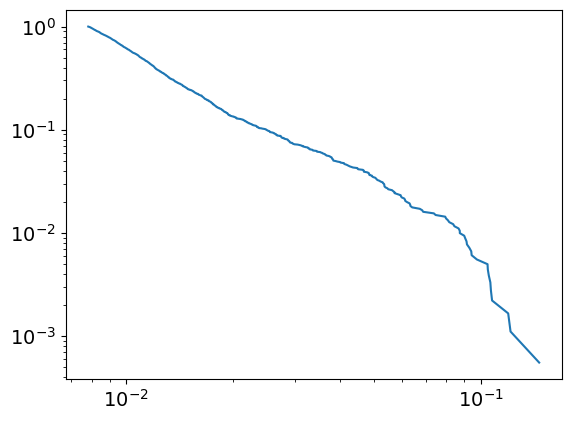

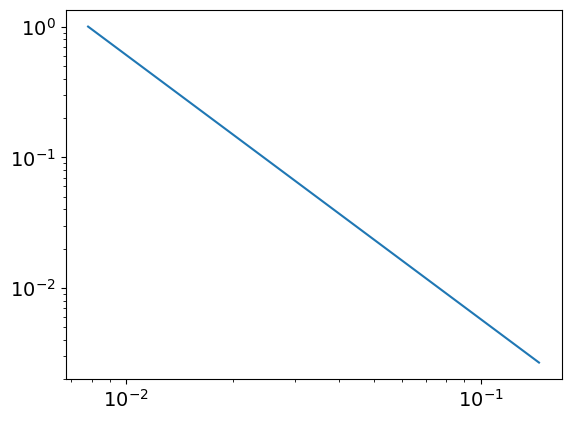

3.0213526229376333
0.007819327707414643
powerlaw KstestResult(statistic=0.998958858598827, pvalue=0.0, statistic_location=0.10646473534933616, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1213831696231732, statistic_sign=-1)
tensor(-1.0637e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0242, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.1701, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
148
tensor(0.1630, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


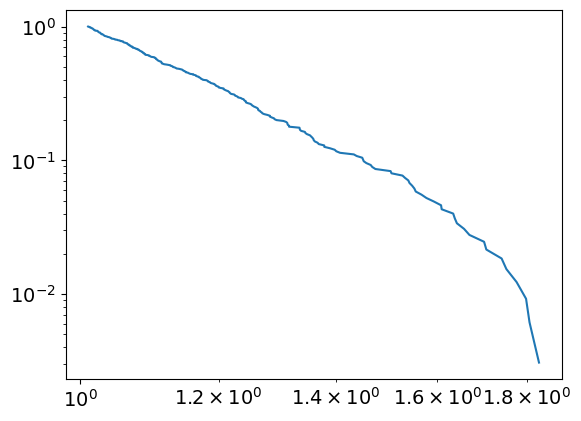

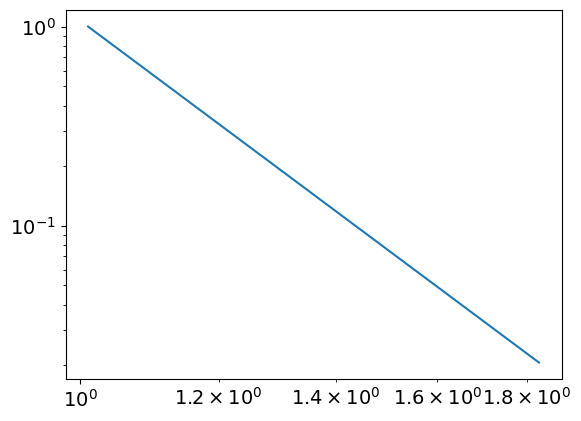

7.558043965974126
1.010767518076376
powerlaw KstestResult(statistic=0.9944796443895995, pvalue=0.0, statistic_location=1.4077856275083365, statistic_sign=1)
lognorm KstestResult(statistic=0.9891924916878061, pvalue=0.0, statistic_location=1.2311138603770495, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2078, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2065, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6819, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


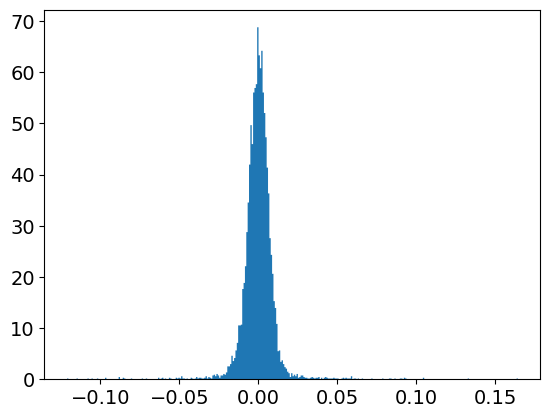

powerlaw
Calculating best minimal value for power law fit
6.662115267777373%
powerlaw KstestResult(statistic=0.9999999925851888, pvalue=0.0, statistic_location=0.16443957167220247, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16443957167220247, statistic_sign=1)



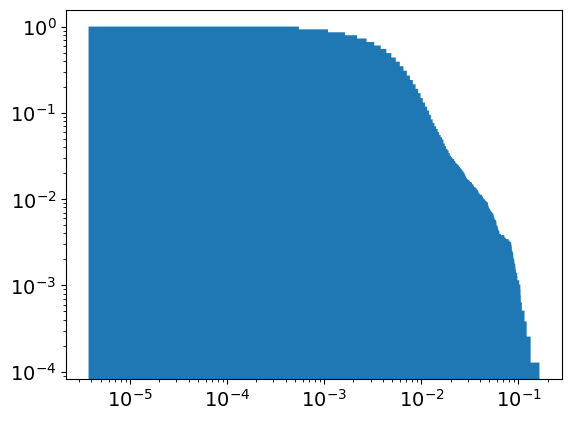

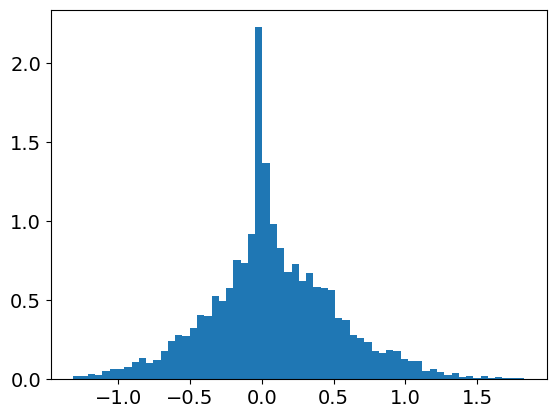

powerlaw
Calculating best minimal value for power law fit
6.7005188441269805
powerlaw KstestResult(statistic=0.9934744129529306, pvalue=0.0, statistic_location=1.3807425345217093, statistic_sign=1)
lognorm KstestResult(statistic=0.9892002988089518, pvalue=0.0, statistic_location=1.2310249020821407, statistic_sign=1)



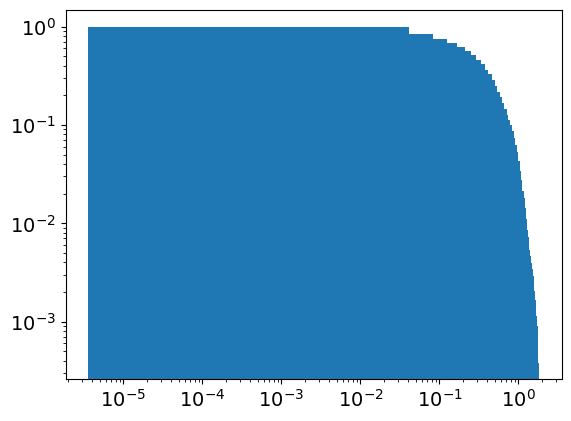

separation
epoch:
149
tensor(4.9111e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


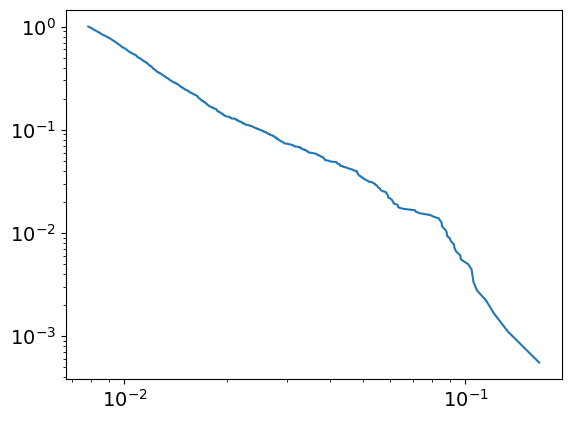

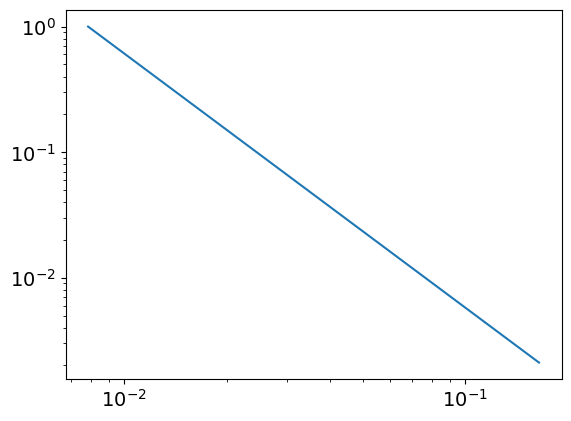

3.0239691211201265
0.00783412787645578
powerlaw KstestResult(statistic=0.9988914380286634, pvalue=0.0, statistic_location=0.09376898289494526, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16443957167220247, statistic_sign=1)
tensor(3.8411e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2922, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.5942, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
149
tensor(0.1633, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


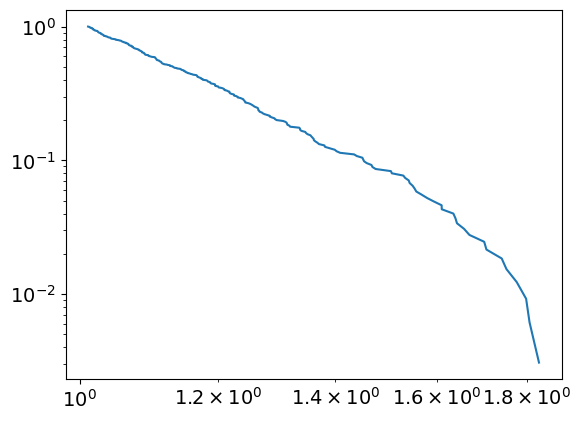

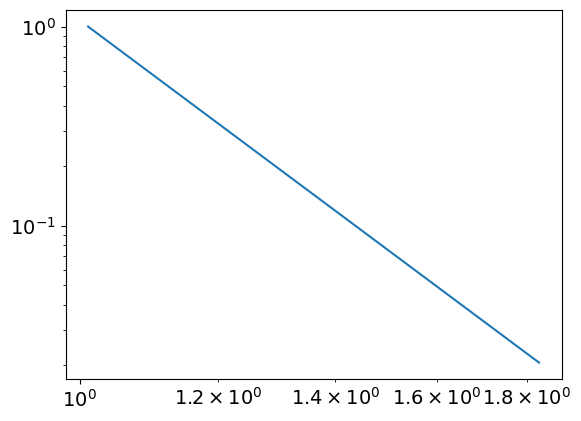

7.555875502348819
1.0111436078924054
powerlaw KstestResult(statistic=0.9944711919561927, pvalue=0.0, statistic_location=1.4085327893649398, statistic_sign=1)
lognorm KstestResult(statistic=0.9892002988089518, pvalue=0.0, statistic_location=1.2310249020821407, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2078, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2069, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6857, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
150
tensor(4.6442e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


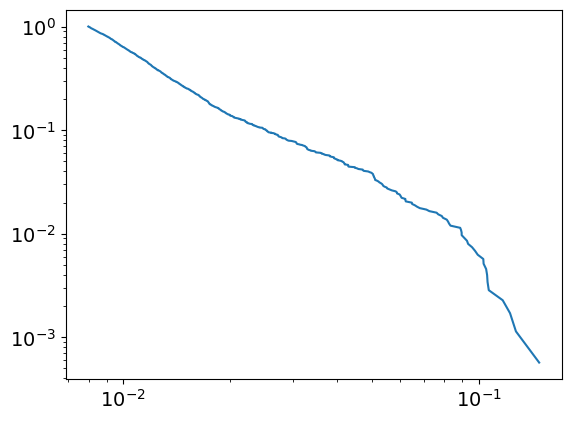

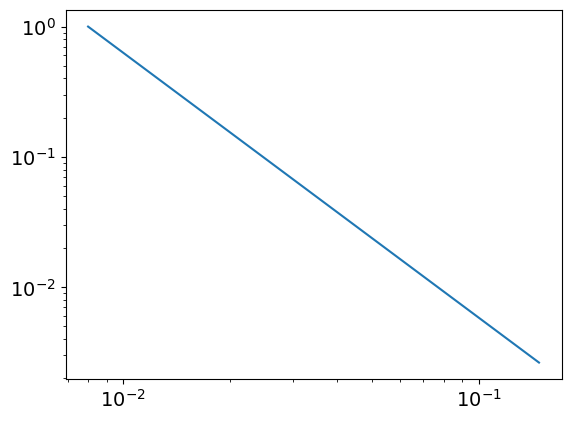

3.0336808430877715
0.00798262942014532
powerlaw KstestResult(statistic=0.9988857932894046, pvalue=0.0, statistic_location=0.10556283814940622, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1478623810688559, statistic_sign=1)
tensor(6.6490e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0587, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.5982, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
150
tensor(0.1635, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


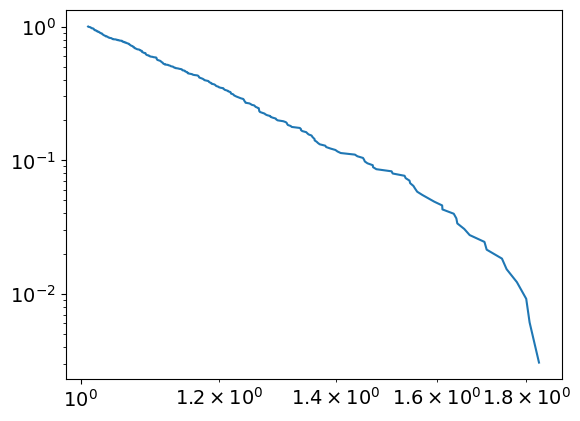

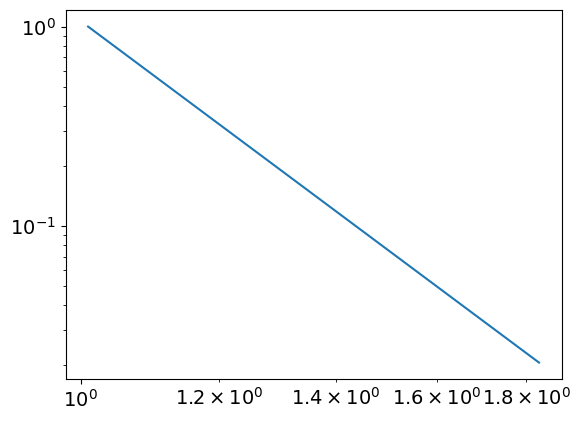

7.523286363309754
1.009880475022505
powerlaw KstestResult(statistic=0.9944035339285718, pvalue=0.0, statistic_location=1.409369373380634, statistic_sign=1)
lognorm KstestResult(statistic=0.9891245242331386, pvalue=0.0, statistic_location=1.2331925905785188, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2079, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2073, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6896, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
151
tensor(3.9897e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


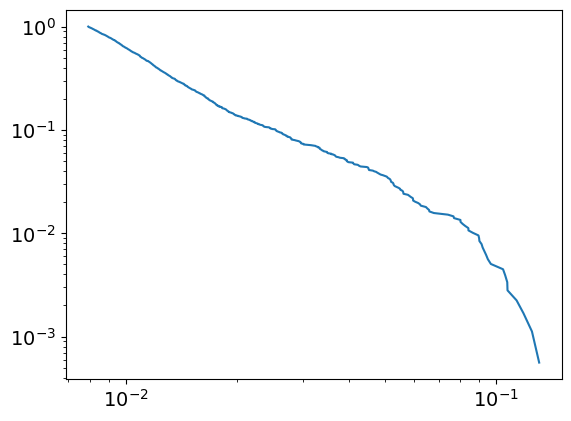

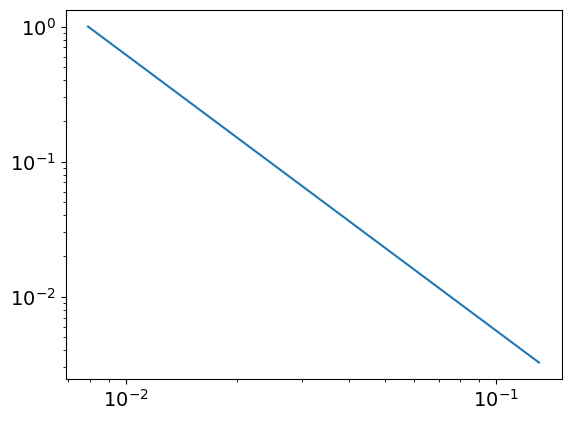

3.045314637116743
0.00791957318045289
powerlaw KstestResult(statistic=0.9990705920014632, pvalue=0.0, statistic_location=0.09279427199945486, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12475071965499139, statistic_sign=-1)
tensor(-4.5566e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3334, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.5603, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
151
tensor(0.1638, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


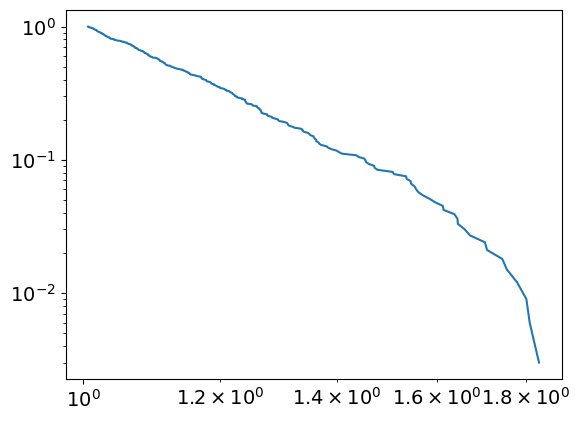

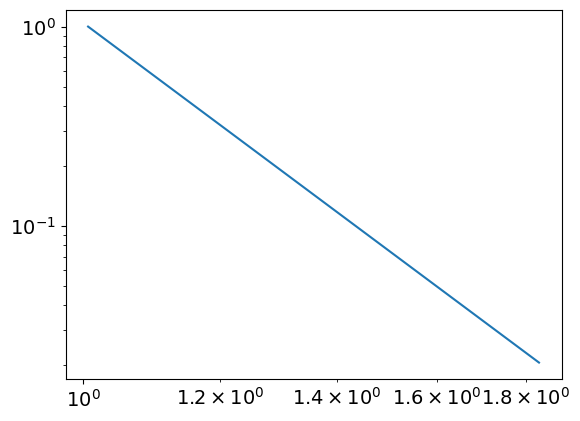

7.489168286331571
1.0066703569922586
powerlaw KstestResult(statistic=0.9942911336826018, pvalue=0.0, statistic_location=1.4101664791965947, statistic_sign=1)
lognorm KstestResult(statistic=0.9891149395880561, pvalue=0.0, statistic_location=1.2300549256131295, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2079, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2078, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6934, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
152
tensor(4.1069e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


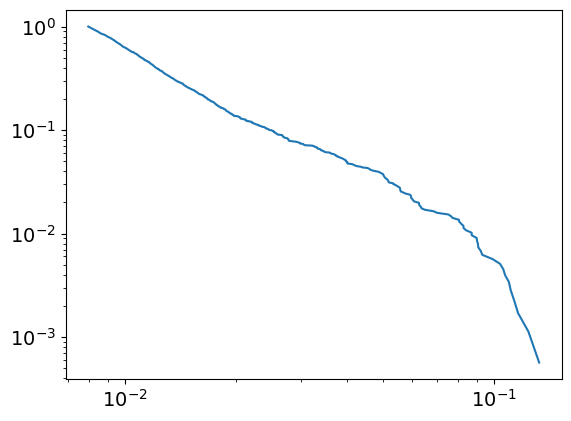

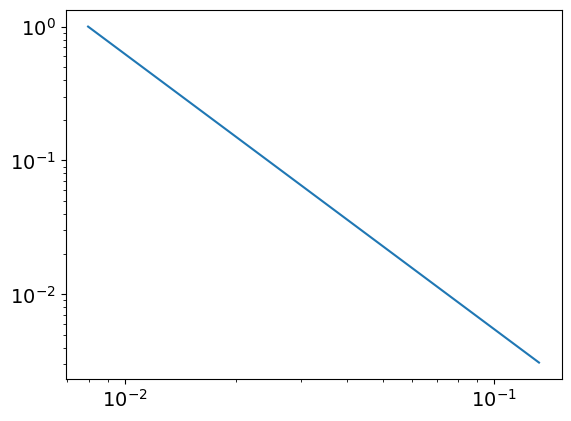

3.055123306118521
0.007964618116416335
powerlaw KstestResult(statistic=0.9990814385765165, pvalue=0.0, statistic_location=0.09295486350936283, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12388617745671099, statistic_sign=-1)
tensor(-2.1109e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3202, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.2923, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
152
tensor(0.1640, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


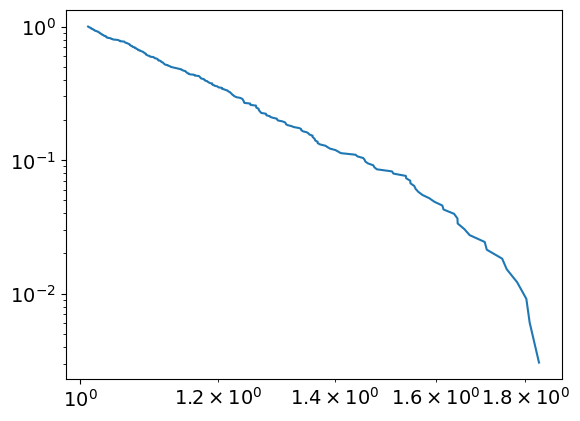

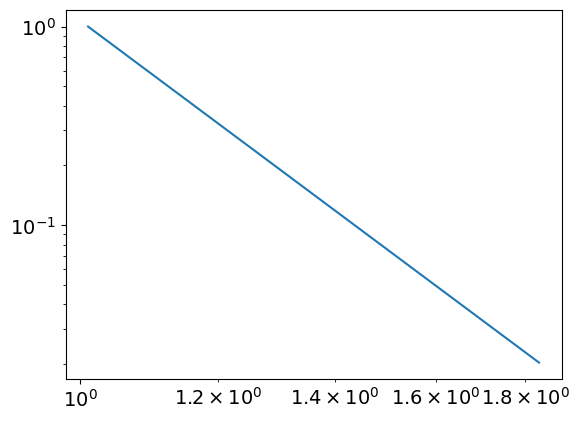

7.543268480596666
1.010739120564924
powerlaw KstestResult(statistic=0.9944085843240534, pvalue=0.0, statistic_location=1.4109327477126075, statistic_sign=1)
lognorm KstestResult(statistic=0.9891351171196004, pvalue=0.0, statistic_location=1.229576379864788, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2080, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2082, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6973, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
153
tensor(3.8949e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


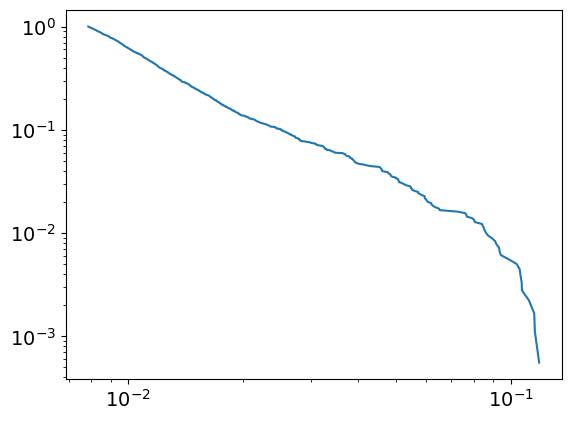

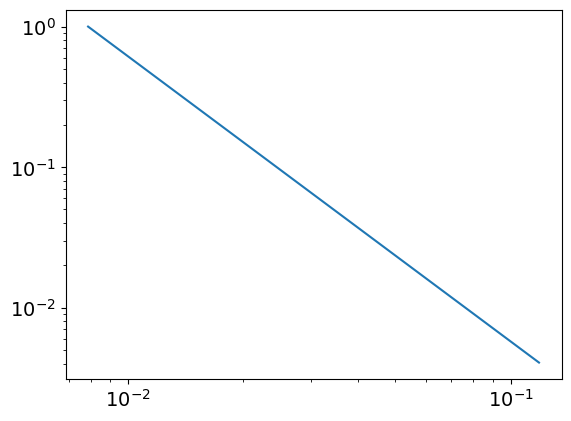

3.0282085882339436
0.007866006085206644
powerlaw KstestResult(statistic=0.9988577051743275, pvalue=0.0, statistic_location=0.10607456727237143, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1152129940569307, statistic_sign=1)
tensor(1.3538e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0592, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.5282, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
153
tensor(0.1642, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


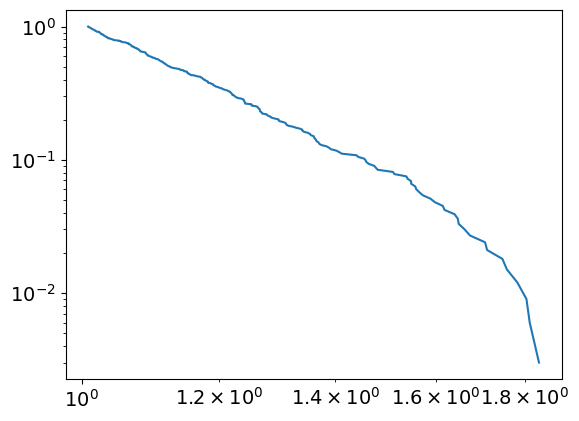

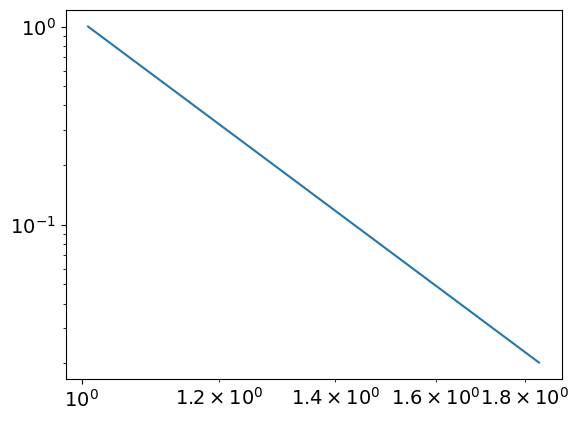

7.534074565142943
1.0086142030042586
powerlaw KstestResult(statistic=0.9943434416365239, pvalue=0.0, statistic_location=1.4117247336868985, statistic_sign=1)
lognorm KstestResult(statistic=0.9891533165626439, pvalue=0.0, statistic_location=1.2291261820292667, statistic_sign=1)
tensor(0.0759, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2080, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2086, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7012, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
154
tensor(3.7706e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


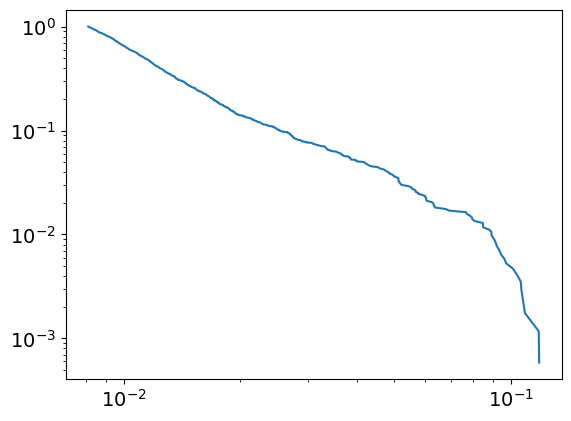

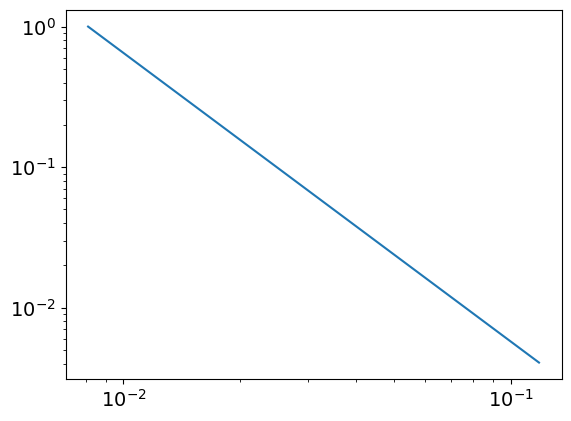

3.0525967205718736
0.008105220640116564
powerlaw KstestResult(statistic=0.9989706997498747, pvalue=0.0, statistic_location=0.10378479676573514, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.11817572163810401, statistic_sign=1)
tensor(1.8668e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0842, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.0396, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
154
tensor(0.1645, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


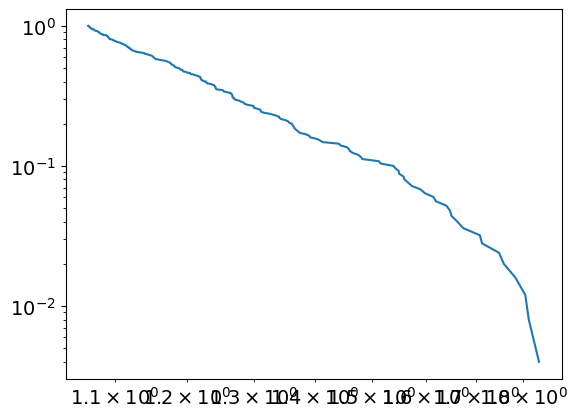

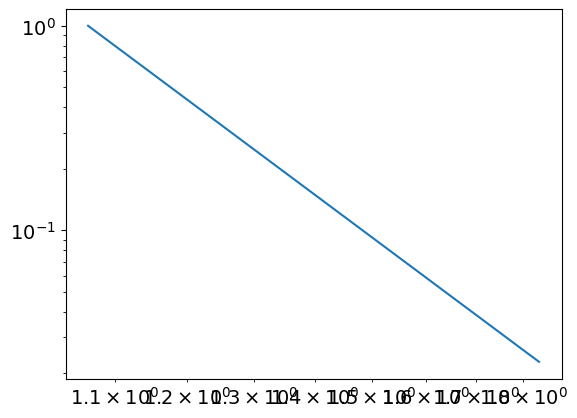

7.949542604876426
1.0644538190438295
powerlaw KstestResult(statistic=0.9955899360141492, pvalue=0.0, statistic_location=1.4820346570977037, statistic_sign=1)
lognorm KstestResult(statistic=0.9891595122808508, pvalue=0.0, statistic_location=1.2290697073494359, statistic_sign=1)
tensor(0.0759, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2081, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2091, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7050, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
155
tensor(4.1898e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


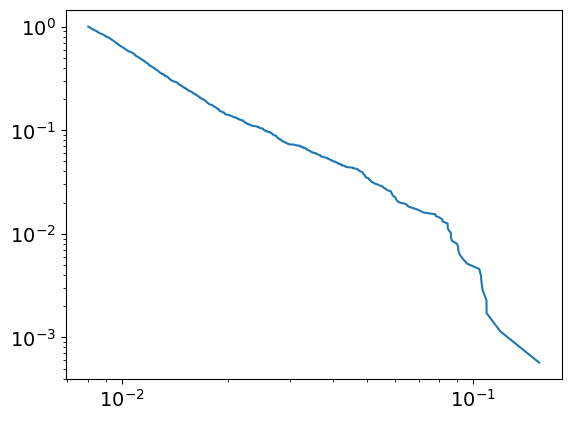

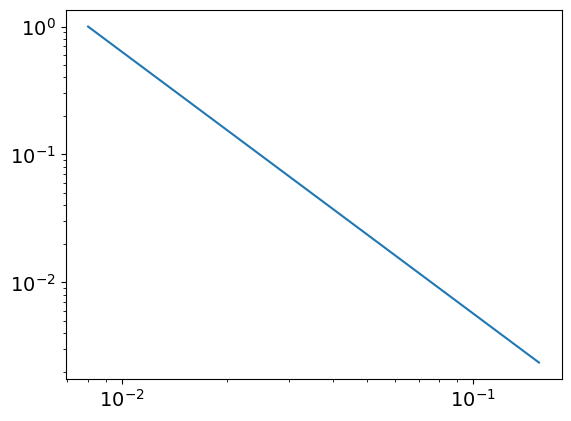

3.0485786991136234
0.008023590143778141
powerlaw KstestResult(statistic=0.9990452725762434, pvalue=0.0, statistic_location=0.10550128890938483, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15397909136443821, statistic_sign=1)
tensor(4.6295e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0110, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8149, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
155
tensor(0.1648, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


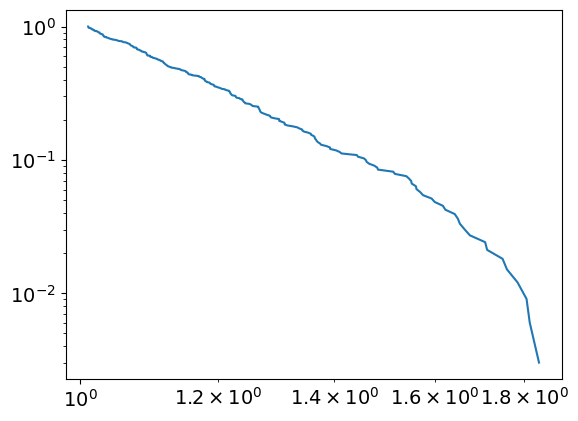

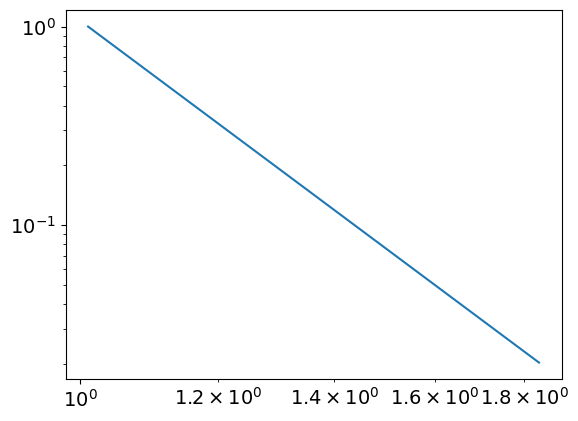

7.5332753196802695
1.0104447339033056
powerlaw KstestResult(statistic=0.9943466135972309, pvalue=0.0, statistic_location=1.4133568027096153, statistic_sign=1)
lognorm KstestResult(statistic=0.9891426960422075, pvalue=0.0, statistic_location=1.2297679687402887, statistic_sign=1)
tensor(0.0759, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2081, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7089, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
156
tensor(4.0917e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


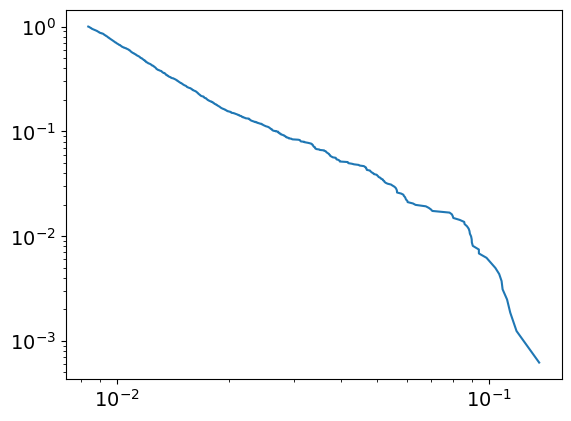

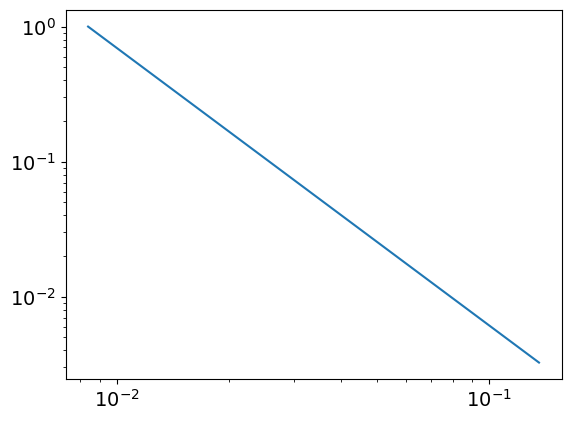

3.0551870917202595
0.008385721222575804
powerlaw KstestResult(statistic=0.9989841707092724, pvalue=0.0, statistic_location=0.10866769676132304, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1184467560743428, statistic_sign=-1)
tensor(-1.9301e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2008, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.7810, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
156
tensor(0.1650, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


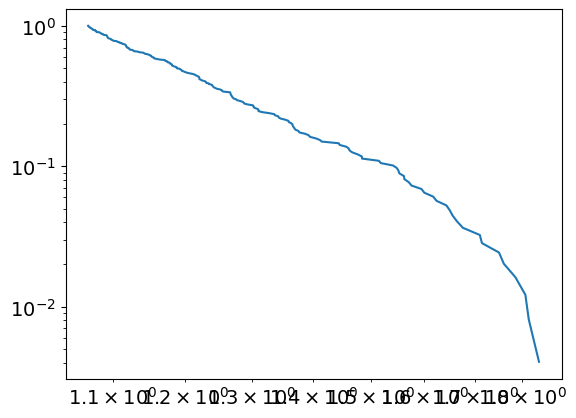

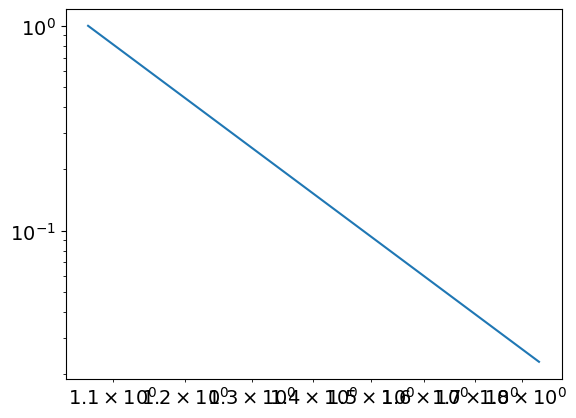

7.9611829537397965
1.067645073589232
powerlaw KstestResult(statistic=0.9956160425423043, pvalue=0.0, statistic_location=1.484323312667839, statistic_sign=1)
lognorm KstestResult(statistic=0.9891179527704478, pvalue=0.0, statistic_location=1.23068657219551, statistic_sign=1)
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2082, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2100, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7129, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
157
tensor(3.9506e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


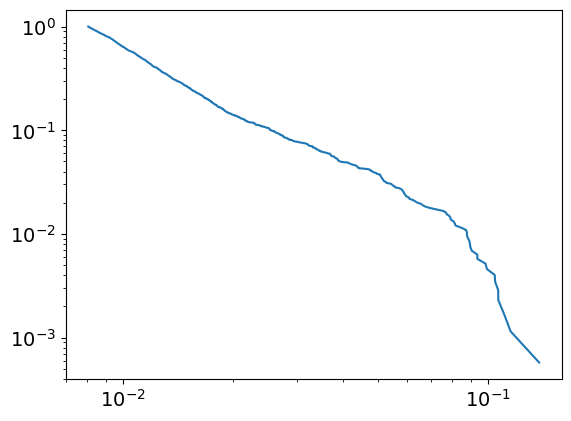

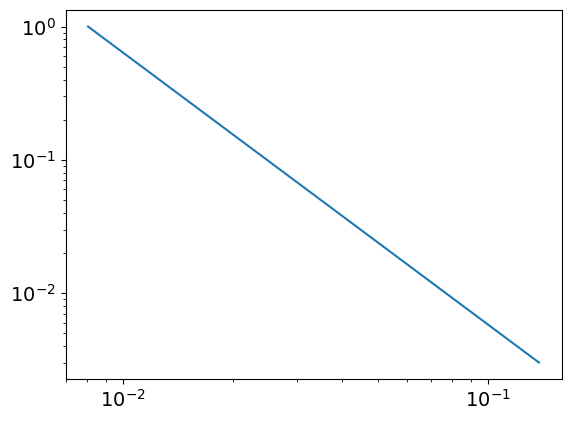

3.040992593795346
0.008040213166965588
powerlaw KstestResult(statistic=0.9990514761261448, pvalue=0.0, statistic_location=0.09357909320691092, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11546310809822394, statistic_sign=-1)
tensor(-3.1277e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2196, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.5873, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
157
tensor(0.1652, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


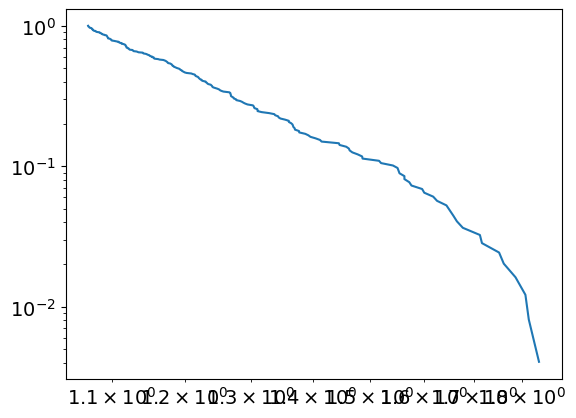

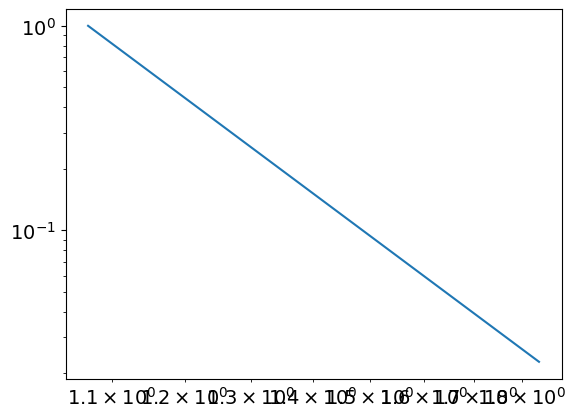

7.980667544557175
1.068639335123036
powerlaw KstestResult(statistic=0.9956149542775646, pvalue=0.0, statistic_location=1.4862696602659327, statistic_sign=1)
lognorm KstestResult(statistic=0.989158936926893, pvalue=0.0, statistic_location=1.2333192944059015, statistic_sign=1)
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2082, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7167, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
158
tensor(4.3044e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


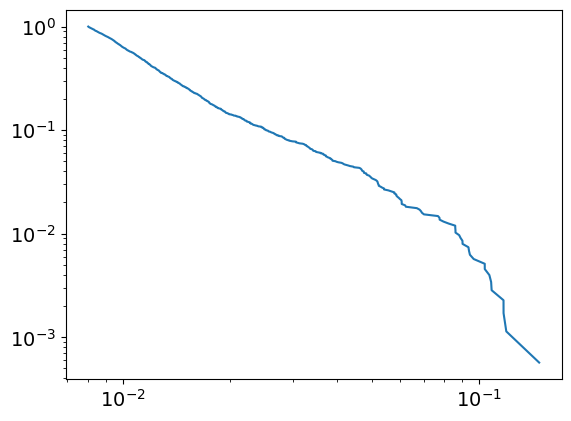

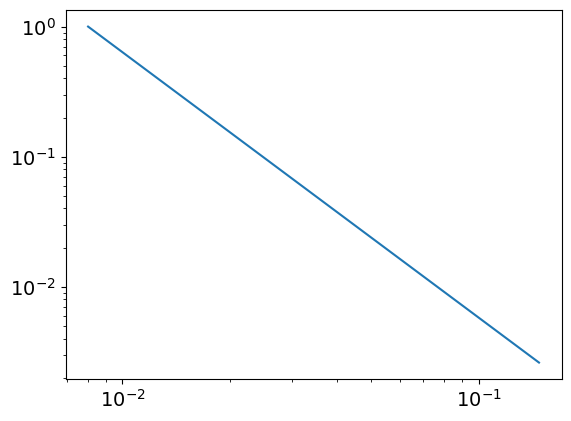

3.0400106899562203
0.008010326475384098
powerlaw KstestResult(statistic=0.9990315045229531, pvalue=0.0, statistic_location=0.09446206728085445, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1195062829134676, statistic_sign=-1)
tensor(-3.1818e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3240, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.1489, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
158
tensor(0.1655, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


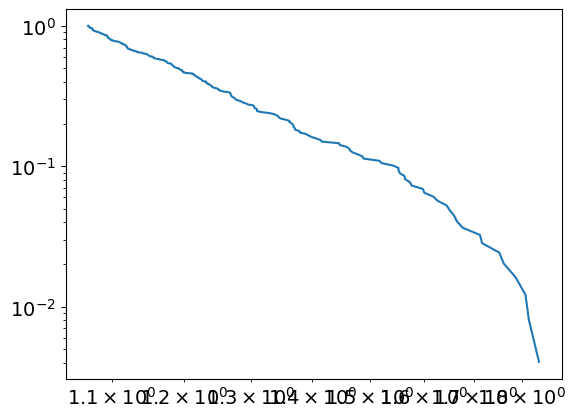

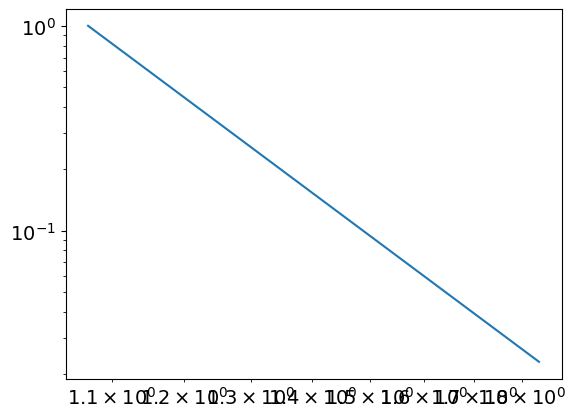

7.971873291506388
1.0689961213006698
powerlaw KstestResult(statistic=0.9955706755684146, pvalue=0.0, statistic_location=1.4886374497590427, statistic_sign=1)
lognorm KstestResult(statistic=0.989115765777588, pvalue=0.0, statistic_location=1.234591787139066, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2083, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2110, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7207, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
159
tensor(4.5470e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


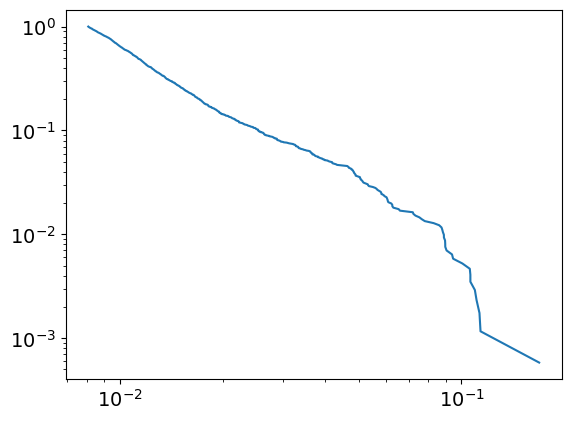

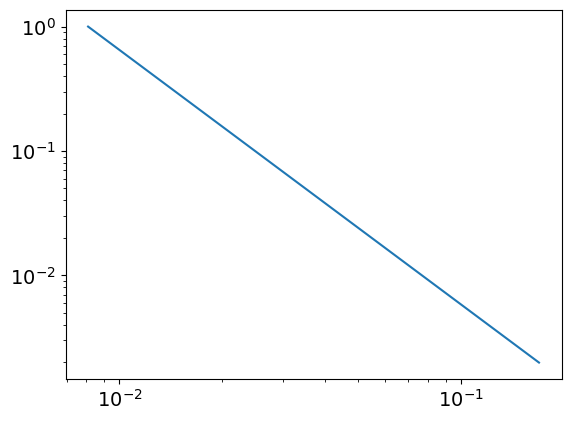

3.047743031830264
0.008093791090824944
powerlaw KstestResult(statistic=0.9990568021243456, pvalue=0.0, statistic_location=0.09383333485959713, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11370576906880314, statistic_sign=-1)
tensor(-2.0764e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0048, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.3073, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
159
tensor(0.1657, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


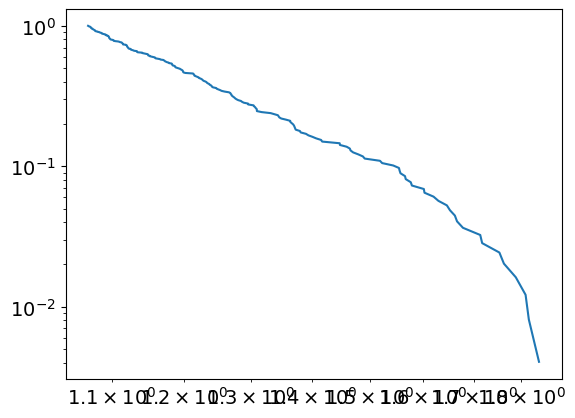

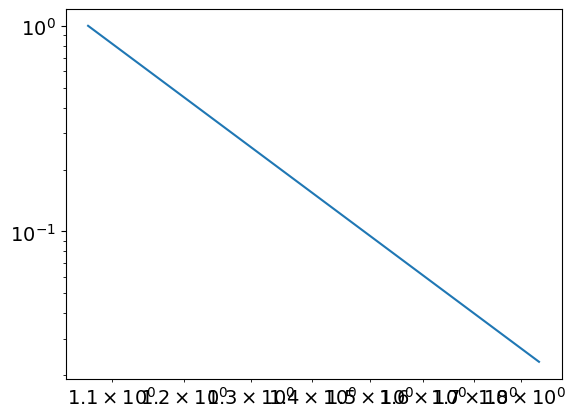

7.929435454162432
1.068626696968198
powerlaw KstestResult(statistic=0.9954794904126535, pvalue=0.0, statistic_location=1.4910101874708293, statistic_sign=1)
lognorm KstestResult(statistic=0.9890507223246997, pvalue=0.0, statistic_location=1.2331107287875107, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2083, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2114, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7246, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
160
tensor(5.0075e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


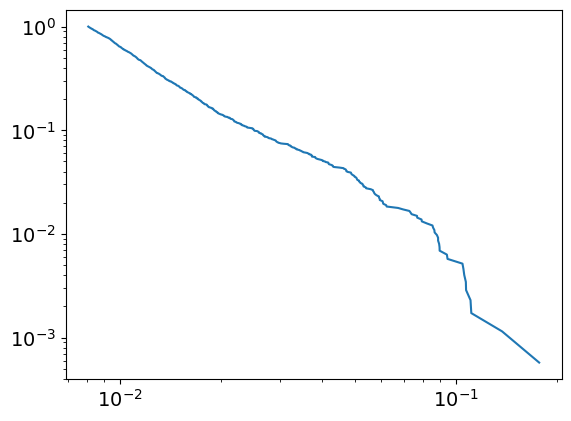

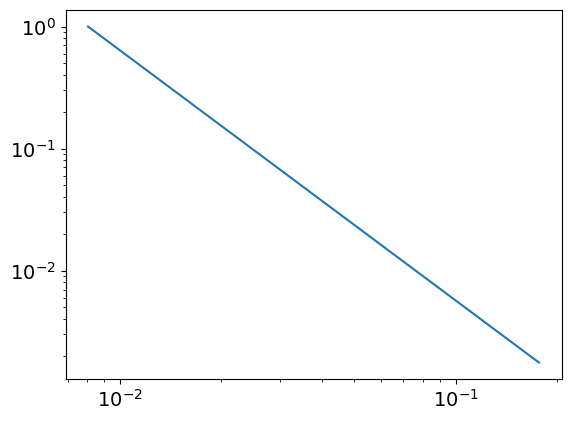

3.0509847249480035
0.008052856059739906
powerlaw KstestResult(statistic=0.9990458189348209, pvalue=0.0, statistic_location=0.09456494277331705, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1374455854529933, statistic_sign=-1)
tensor(-4.5491e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0962, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.4040, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
160
tensor(0.1660, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


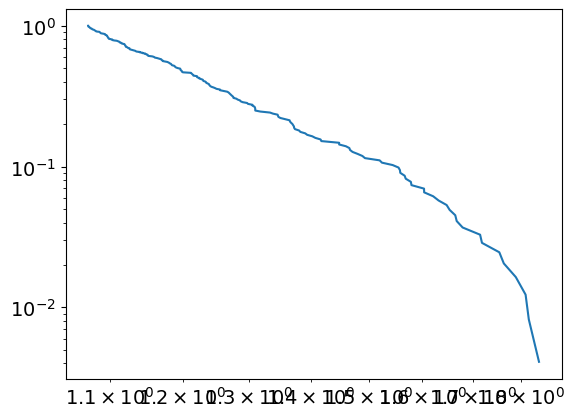

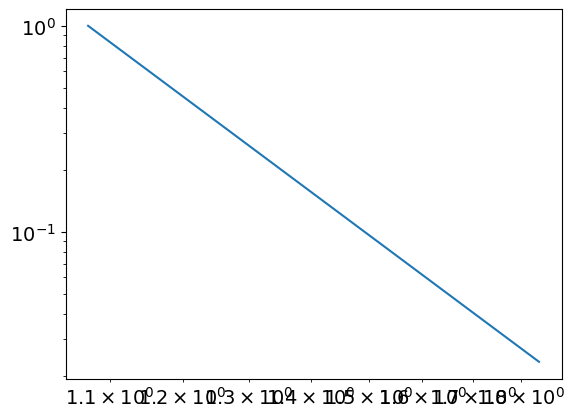

7.9472823892211695
1.0715012302757383
powerlaw KstestResult(statistic=0.9955042852910525, pvalue=0.0, statistic_location=1.4934640955950598, statistic_sign=1)
lognorm KstestResult(statistic=0.9890255105381658, pvalue=0.0, statistic_location=1.2397431334290145, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2084, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2119, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7284, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
161
tensor(4.6017e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


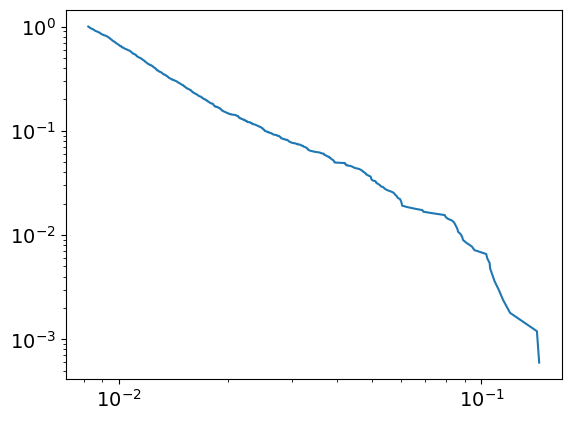

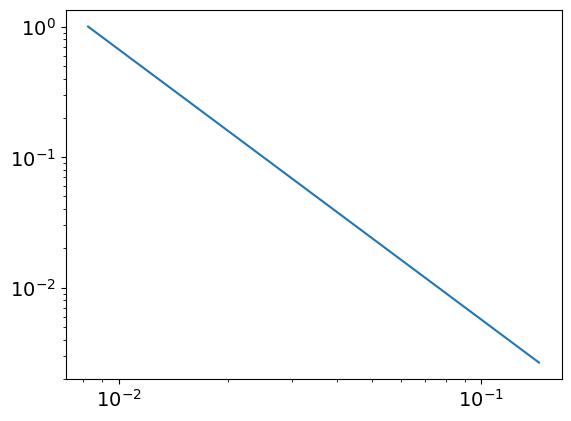

3.0697821268765195
0.008241217629169876
powerlaw KstestResult(statistic=0.9990074712682198, pvalue=0.0, statistic_location=0.10875159887373627, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14425539203753474, statistic_sign=-1)
tensor(-3.3860e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4175, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.8088, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
161
tensor(0.1662, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


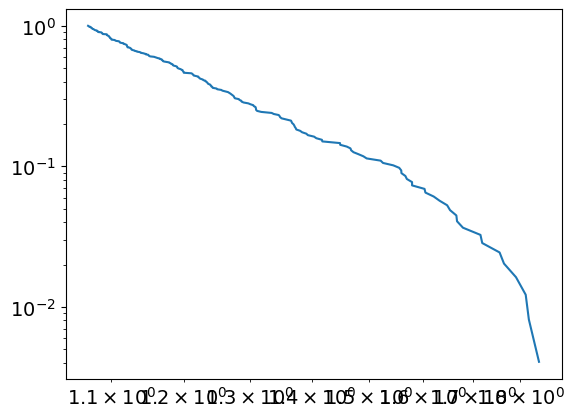

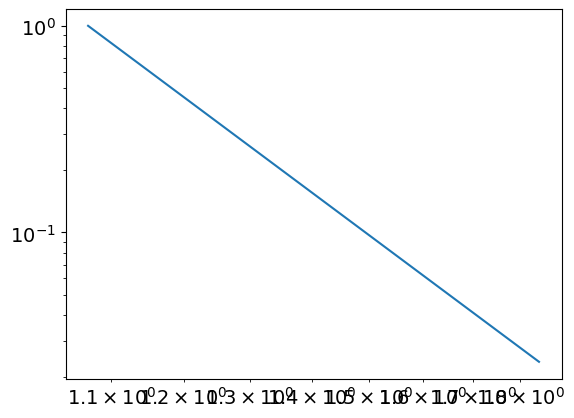

7.893254124496239
1.0695151354356676
powerlaw KstestResult(statistic=0.9954094595092663, pvalue=0.0, statistic_location=1.4723419514314446, statistic_sign=1)
lognorm KstestResult(statistic=0.9889957783581098, pvalue=0.0, statistic_location=1.2427639728005617, statistic_sign=1)
tensor(0.0756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2084, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2125, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7325, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
162
tensor(4.0594e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


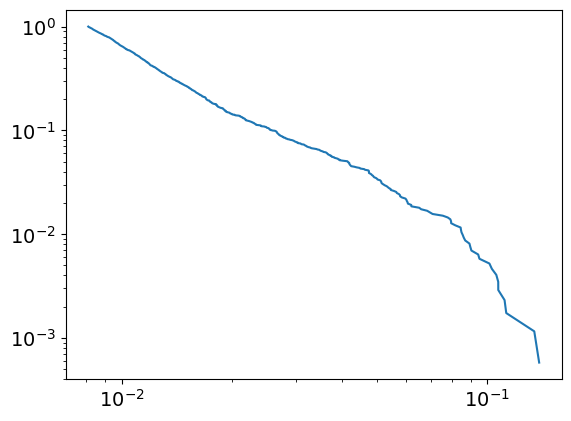

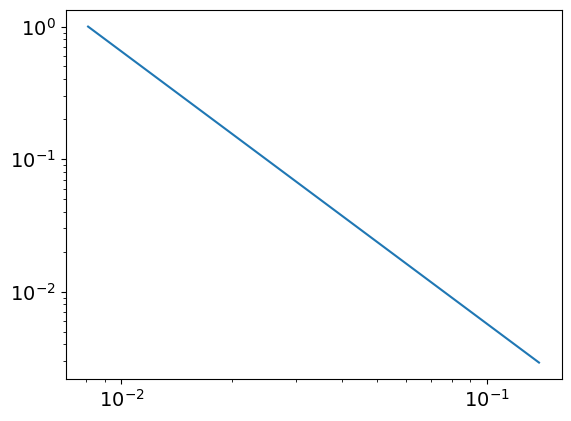

3.056328974863118
0.008105662608336502
powerlaw KstestResult(statistic=0.9990203970024633, pvalue=0.0, statistic_location=0.10711575778503726, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13857339222896867, statistic_sign=-1)
tensor(-2.1708e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3281, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.2152, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
162
tensor(0.1664, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


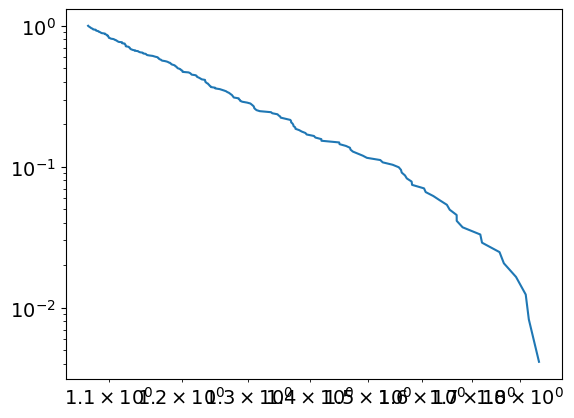

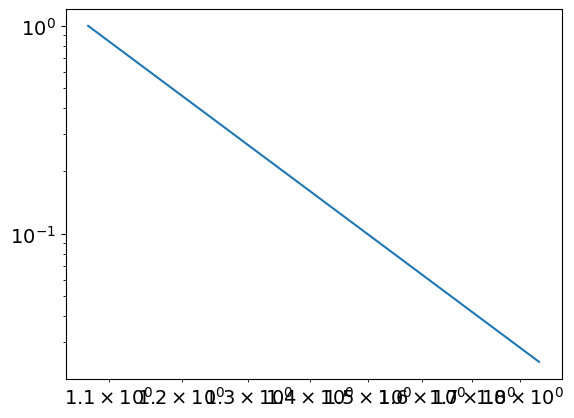

7.889185795173905
1.0725537684208053
powerlaw KstestResult(statistic=0.9954369994524088, pvalue=0.0, statistic_location=1.473322427207054, statistic_sign=1)
lognorm KstestResult(statistic=0.9890198928455107, pvalue=0.0, statistic_location=1.2401922243602865, statistic_sign=1)
tensor(0.0756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2084, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7363, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
163
tensor(3.9557e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


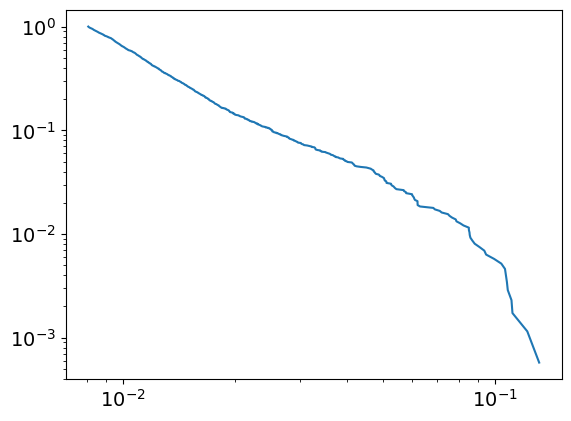

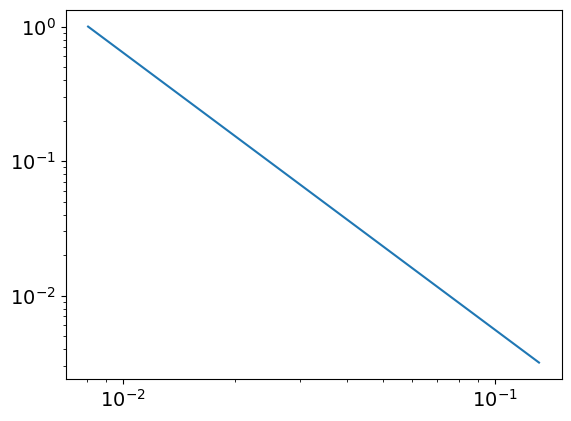

3.0625406872416727
0.008076388928711231
powerlaw KstestResult(statistic=0.9990029278543922, pvalue=0.0, statistic_location=0.10821338223048241, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13140655963695866, statistic_sign=-1)
tensor(-4.2395e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1576, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.3621, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
163
tensor(0.1667, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


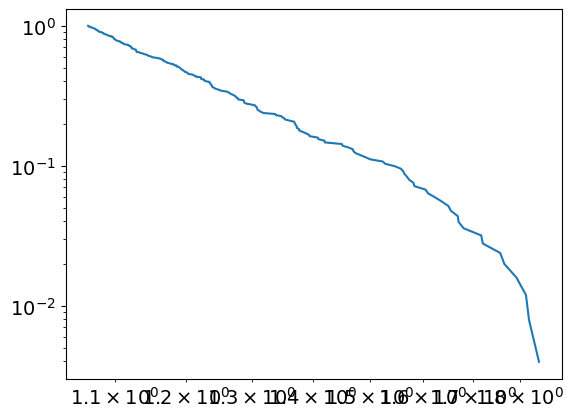

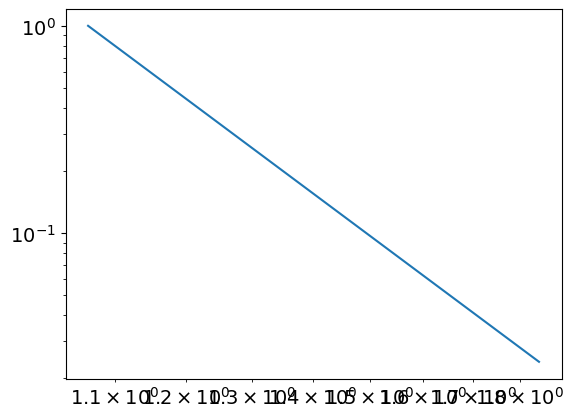

7.809984298355129
1.0649721688713987
powerlaw KstestResult(statistic=0.9952390328294107, pvalue=0.0, statistic_location=1.474332232310745, statistic_sign=1)
lognorm KstestResult(statistic=0.9891022029130182, pvalue=0.0, statistic_location=1.2386895947942178, statistic_sign=1)
tensor(0.0755, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2085, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2134, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7403, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
164
tensor(4.0208e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


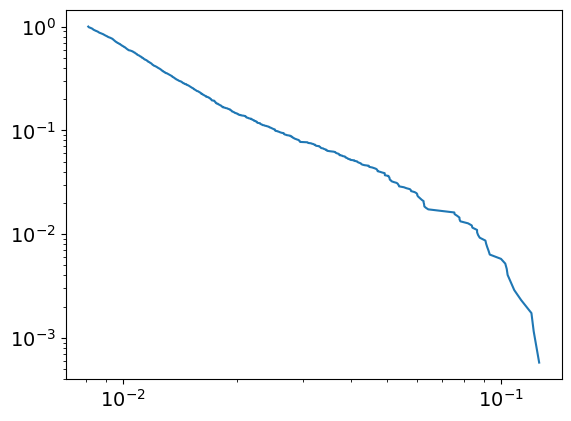

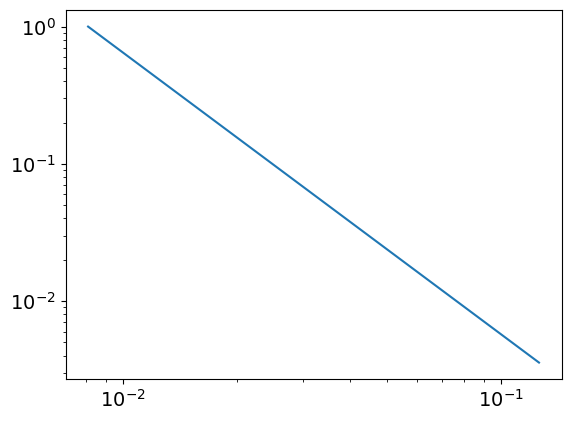

3.0517413728867173
0.008086287487402772
powerlaw KstestResult(statistic=0.9990883454441624, pvalue=0.0, statistic_location=0.10410210800755419, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1261676473704463, statistic_sign=-1)
tensor(-3.5081e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4513, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.9830, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
164
tensor(0.1669, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


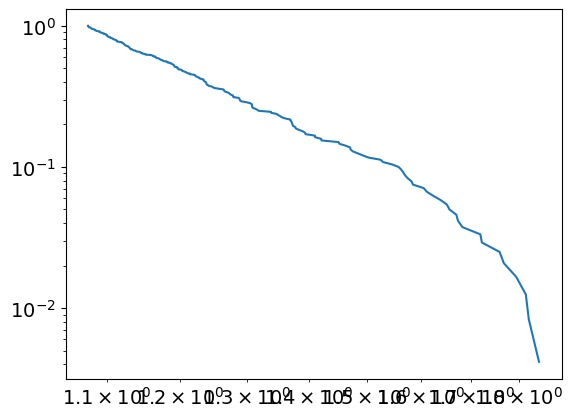

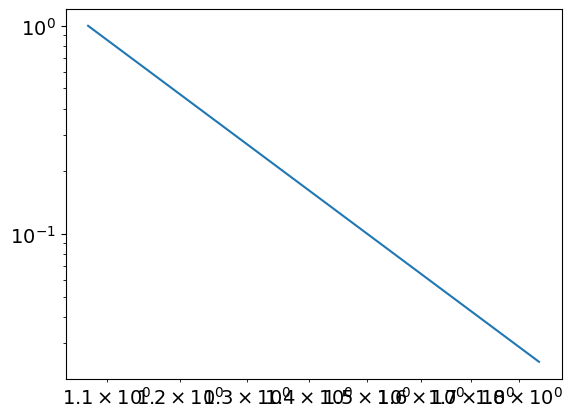

7.893969691711248
1.0751616163545135
powerlaw KstestResult(statistic=0.9954493932657222, pvalue=0.0, statistic_location=1.4752912165625098, statistic_sign=1)
lognorm KstestResult(statistic=0.9890941176105313, pvalue=0.0, statistic_location=1.239038379749234, statistic_sign=1)
tensor(0.0755, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2085, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2139, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7442, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
165
tensor(4.1845e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


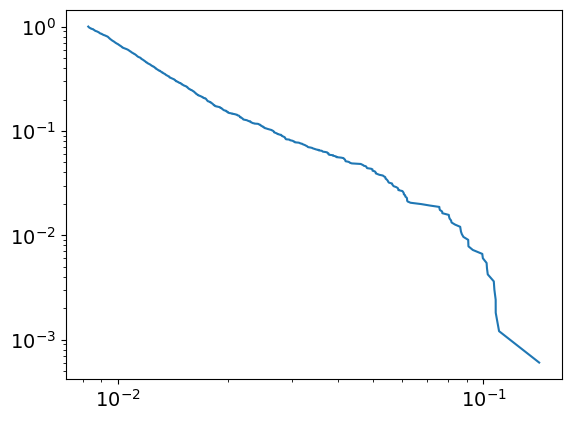

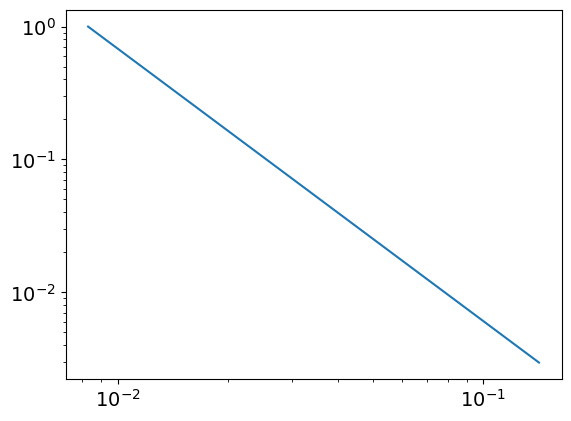

3.050834388590217
0.00829465461463062
powerlaw KstestResult(statistic=0.999136919079335, pvalue=0.0, statistic_location=0.10225331588315104, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11034199529660679, statistic_sign=-1)
tensor(-2.6591e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2575, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.9834, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
165
tensor(0.1671, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


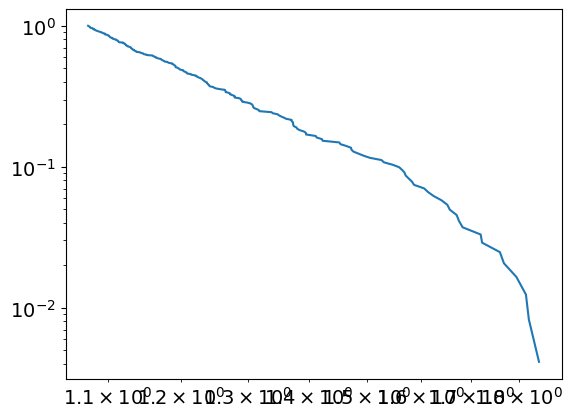

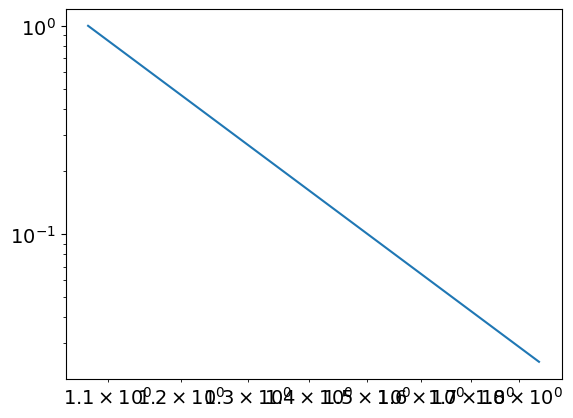

7.860184188044109
1.0736247163862478
powerlaw KstestResult(statistic=0.9953900269090573, pvalue=0.0, statistic_location=1.4761978339023096, statistic_sign=1)
lognorm KstestResult(statistic=0.9889828250624543, pvalue=0.0, statistic_location=1.2414363613162553, statistic_sign=1)
tensor(0.0754, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2085, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2145, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7482, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
166
tensor(4.2624e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


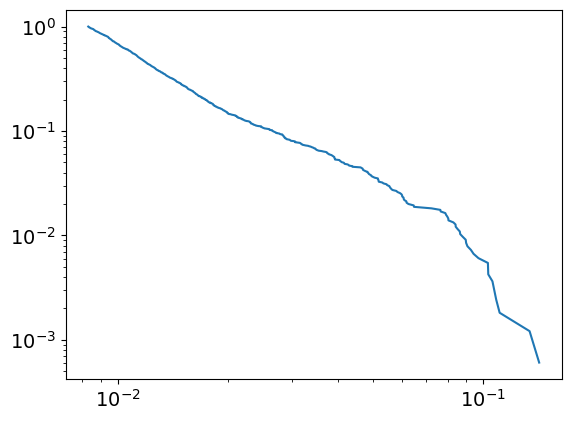

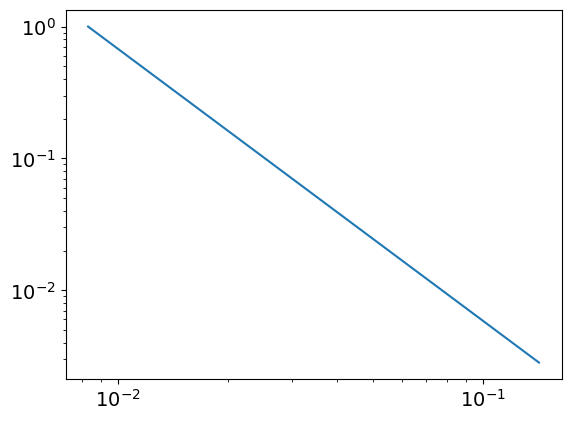

3.0634286003644107
0.008296405949146416
powerlaw KstestResult(statistic=0.9990331175256127, pvalue=0.0, statistic_location=0.10735099244149934, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.134251084206223, statistic_sign=-1)
tensor(-3.2701e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4054, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8366, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
166
tensor(0.1674, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


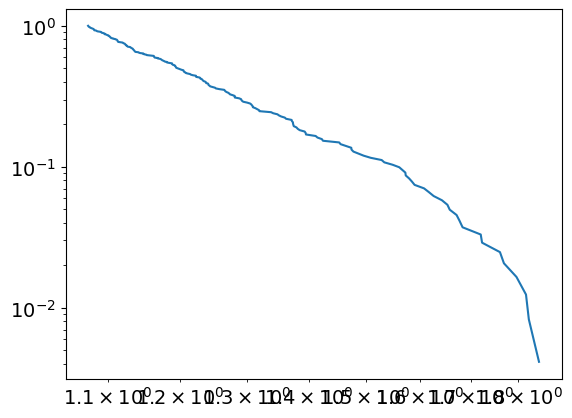

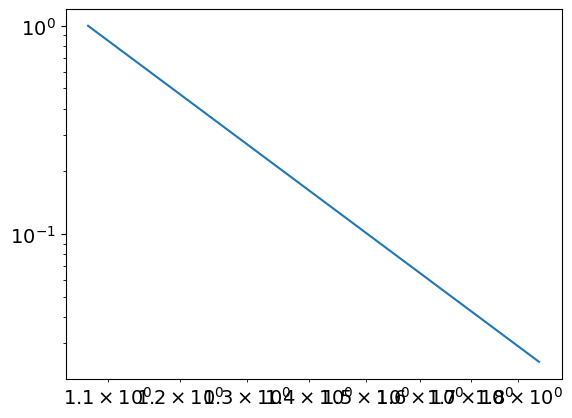

7.870535957424894
1.0744651119446578
powerlaw KstestResult(statistic=0.9953959778643924, pvalue=0.0, statistic_location=1.4771299994248224, statistic_sign=1)
lognorm KstestResult(statistic=0.988914665552279, pvalue=0.0, statistic_location=1.237760021677936, statistic_sign=1)
tensor(0.0754, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2086, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2150, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7522, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
167
tensor(4.4335e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


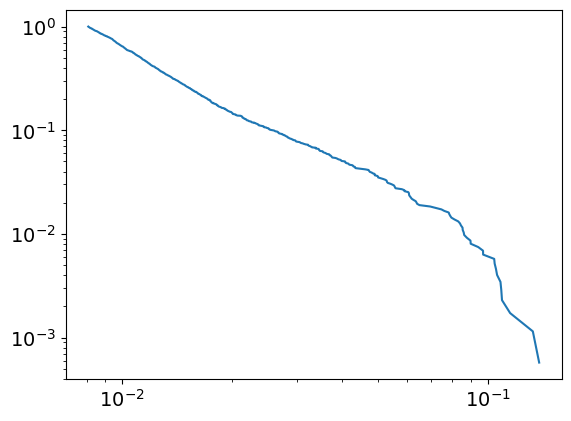

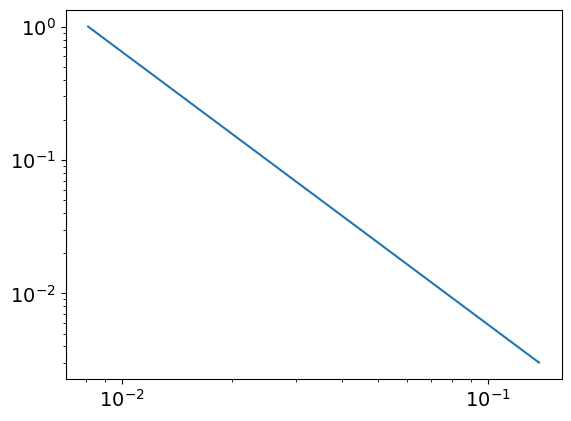

3.043155198076951
0.008080851834680883
powerlaw KstestResult(statistic=0.9989822551532395, pvalue=0.0, statistic_location=0.09708123958095373, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13814025684425615, statistic_sign=-1)
tensor(-5.3190e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6090, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8967, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
167
tensor(0.1677, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


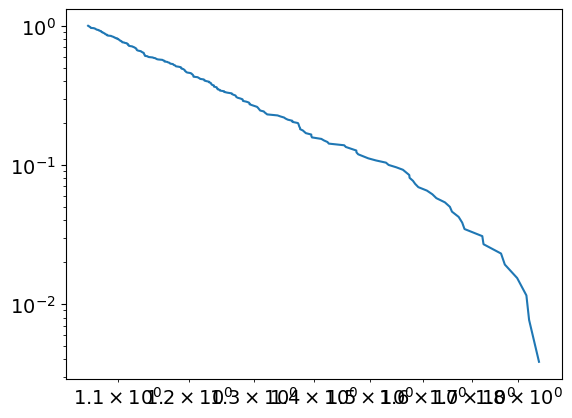

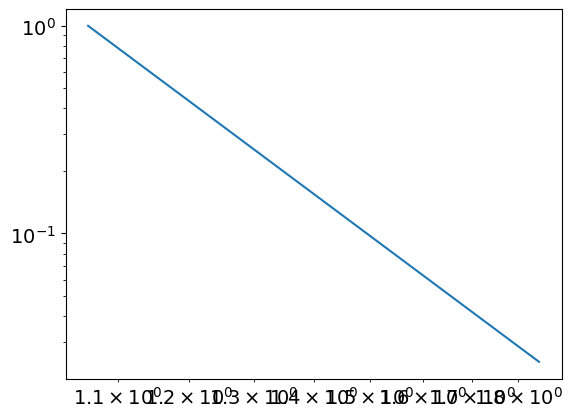

7.713418399689126
1.0599992260071383
powerlaw KstestResult(statistic=0.9949832373740906, pvalue=0.0, statistic_location=1.425493302567206, statistic_sign=1)
lognorm KstestResult(statistic=0.9889376103122862, pvalue=0.0, statistic_location=1.2374186620247012, statistic_sign=1)
tensor(0.0753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2086, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2156, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7562, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
168
tensor(4.6009e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


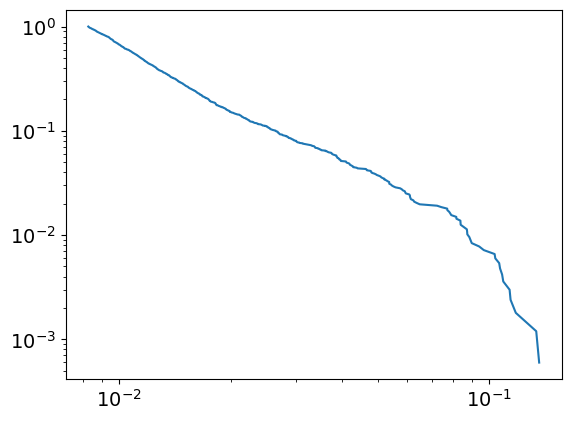

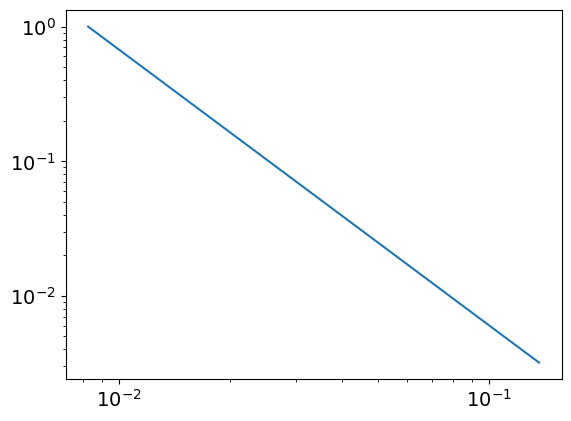

3.048262711640157
0.008247370440000318
powerlaw KstestResult(statistic=0.9989647120731968, pvalue=0.0, statistic_location=0.10384955705551192, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13644036153433559, statistic_sign=-1)
tensor(-5.3620e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5463, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.8462, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
168
tensor(0.1679, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


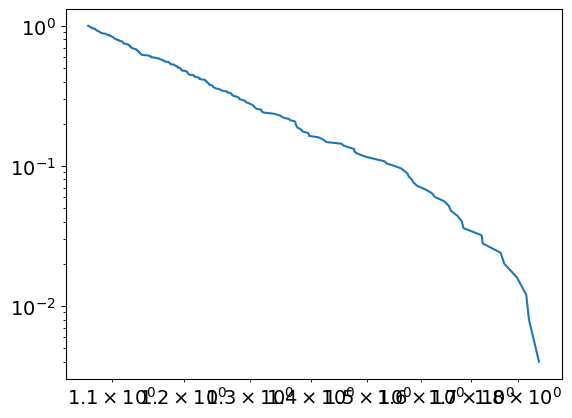

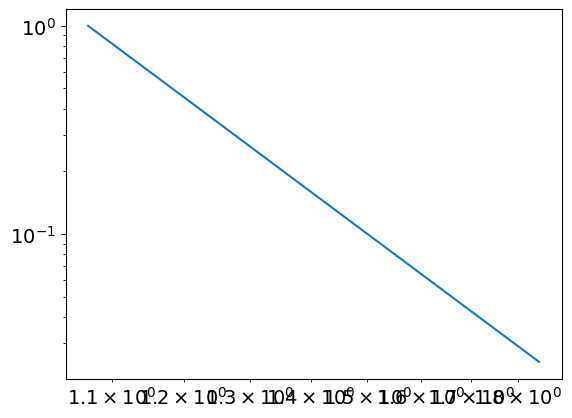

7.787763776740557
1.0685584086196218
powerlaw KstestResult(statistic=0.9952025506682558, pvalue=0.0, statistic_location=1.478889570766108, statistic_sign=1)
lognorm KstestResult(statistic=0.9889256169501257, pvalue=0.0, statistic_location=1.2378932463595238, statistic_sign=1)
tensor(0.0753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2087, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2162, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7603, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
169
tensor(4.5838e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


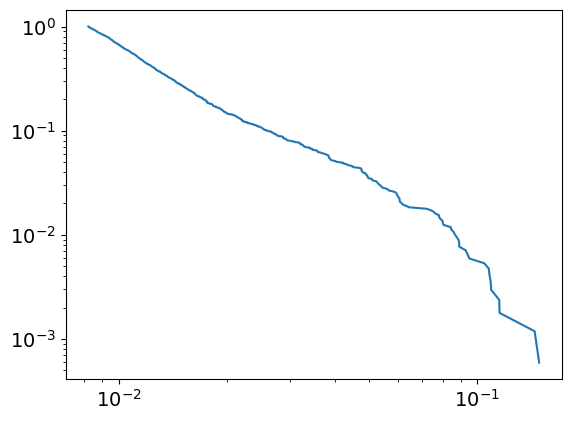

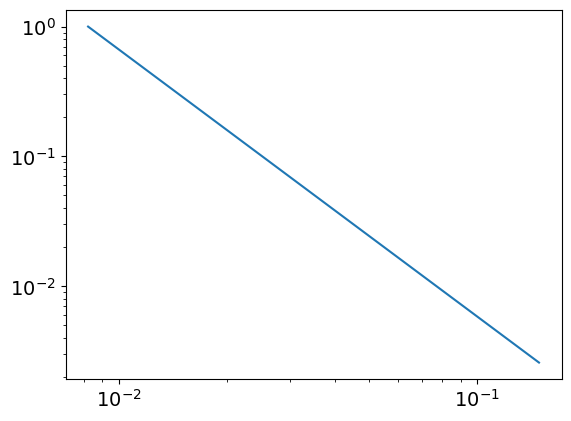

3.0581556386214213
0.008215960542821565
powerlaw KstestResult(statistic=0.9990583902607885, pvalue=0.0, statistic_location=0.08758045569361793, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1486959837856263, statistic_sign=-1)
tensor(-5.1195e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5269, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.8798, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
169
tensor(0.1681, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


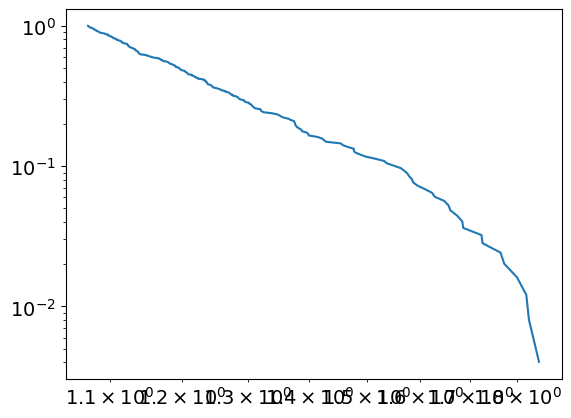

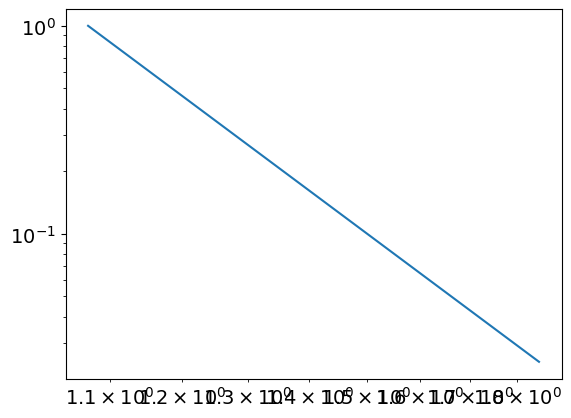

7.8205636162494
1.0711292718323102
powerlaw KstestResult(statistic=0.995261394330983, pvalue=0.0, statistic_location=1.479716816380073, statistic_sign=1)
lognorm KstestResult(statistic=0.9889131085064398, pvalue=0.0, statistic_location=1.2383888765736153, statistic_sign=1)
tensor(0.0752, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2087, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2167, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7644, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
170
tensor(4.2215e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


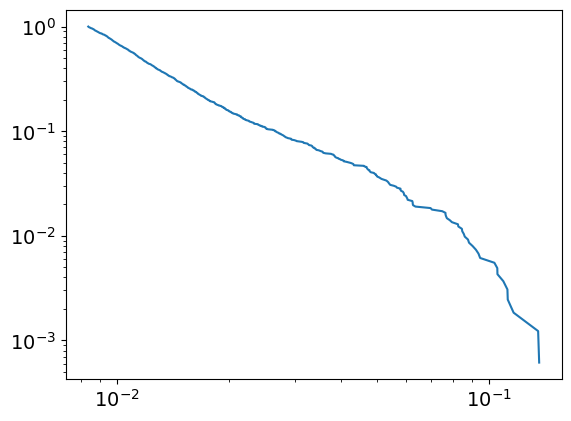

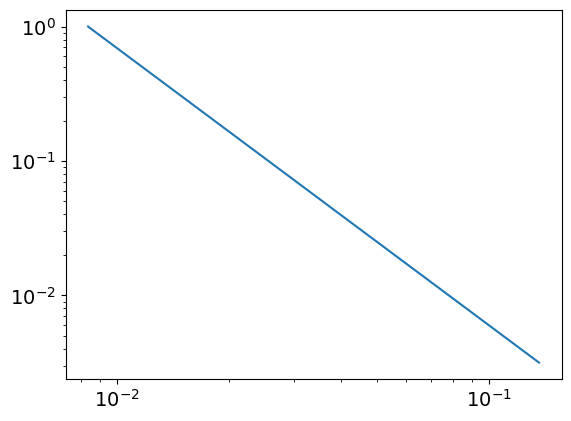

3.060109765468146
0.00835664082657254
powerlaw KstestResult(statistic=0.9990610588781844, pvalue=0.0, statistic_location=0.09473612689342617, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13569332940668405, statistic_sign=-1)
tensor(-4.6150e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4624, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.6862, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
170
tensor(0.1684, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


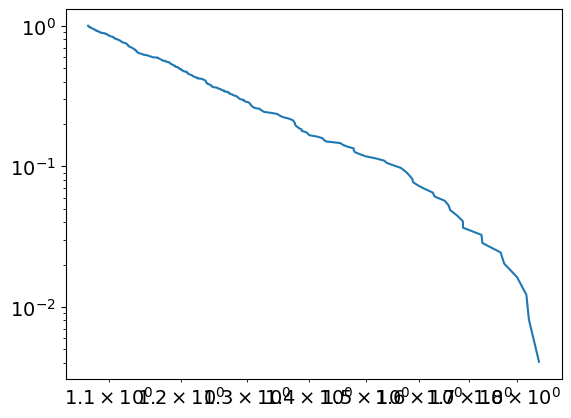

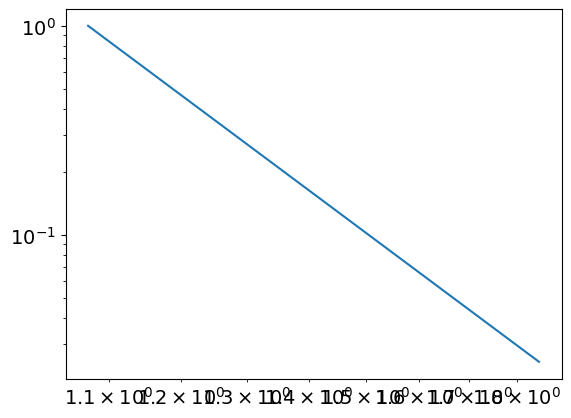

7.804370238410303
1.0726182415416887
powerlaw KstestResult(statistic=0.9952604867256672, pvalue=0.0, statistic_location=1.4804996607726477, statistic_sign=1)
lognorm KstestResult(statistic=0.9888982233159312, pvalue=0.0, statistic_location=1.2389414346708998, statistic_sign=1)
tensor(0.0751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2088, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2173, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7684, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
171
tensor(4.2050e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


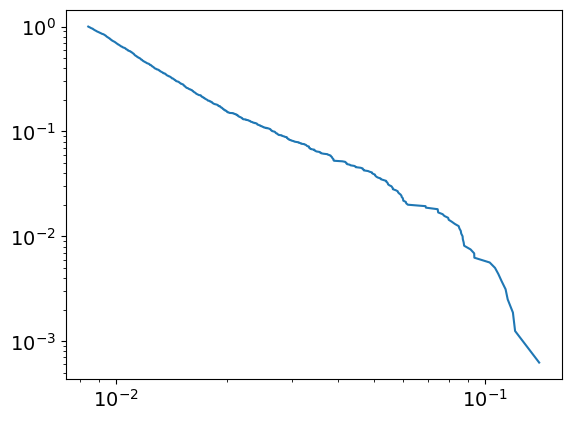

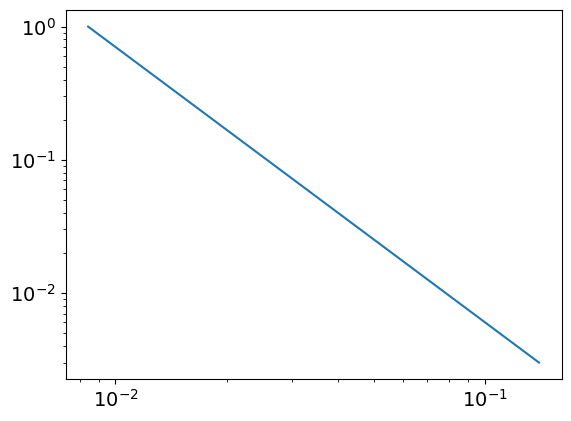

3.0662603340851904
0.008431846282397303
powerlaw KstestResult(statistic=0.9990911584291036, pvalue=0.0, statistic_location=0.09367613251791447, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14033354288517283, statistic_sign=-1)
tensor(-3.7515e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6236, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8037, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
171
tensor(0.1686, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


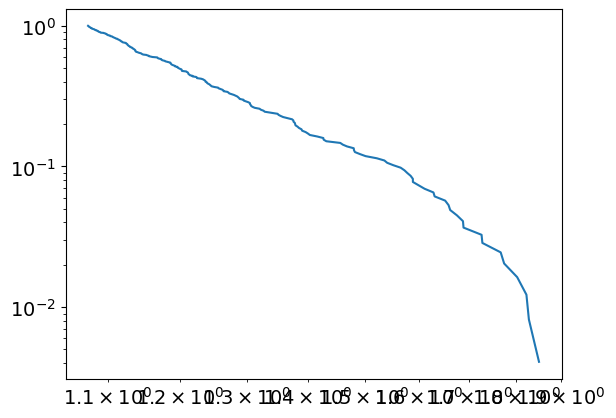

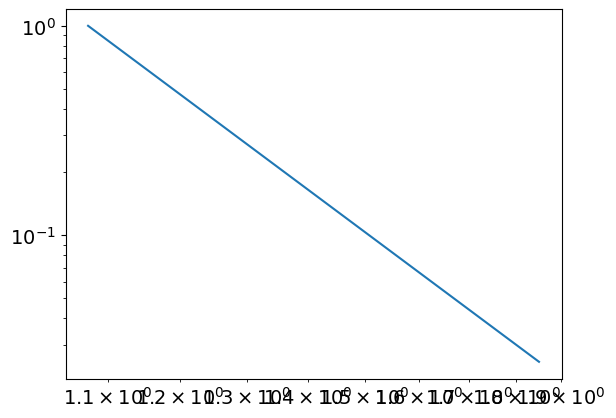

7.7933378110234175
1.0735770786275167
powerlaw KstestResult(statistic=0.9952539251466115, pvalue=0.0, statistic_location=1.4813155178288377, statistic_sign=1)
lognorm KstestResult(statistic=0.9888859321411225, pvalue=0.0, statistic_location=1.2394317757643722, statistic_sign=1)
tensor(0.0751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2088, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2179, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7725, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
172
tensor(4.3536e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


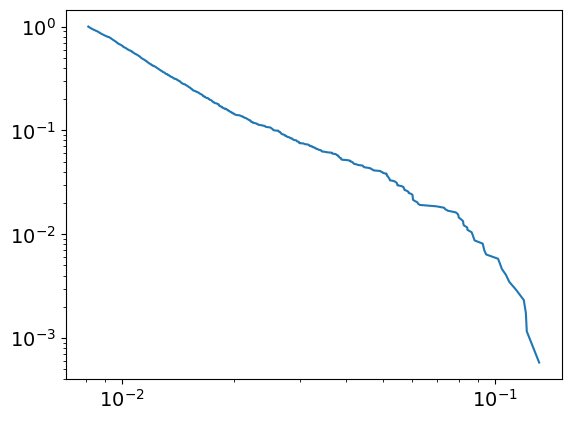

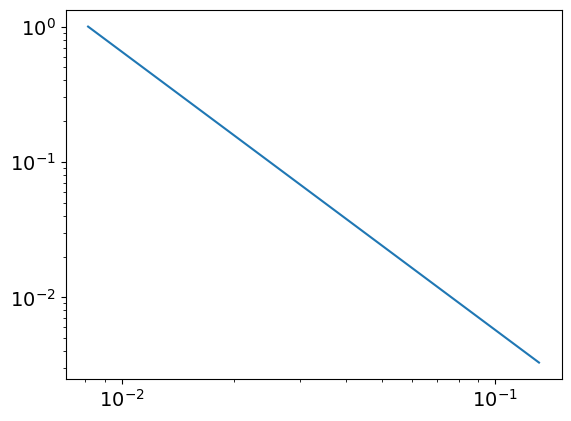

3.053761203325323
0.0081291971077039
powerlaw KstestResult(statistic=0.9989883470758711, pvalue=0.0, statistic_location=0.10317405876952476, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12179426384039323, statistic_sign=-1)
tensor(-9.6529e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2351, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.5324, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
172
tensor(0.1689, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


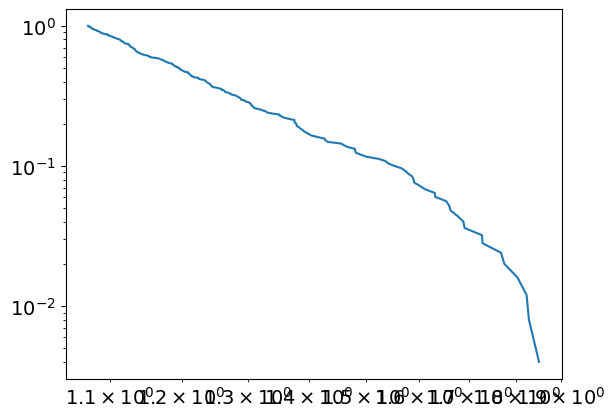

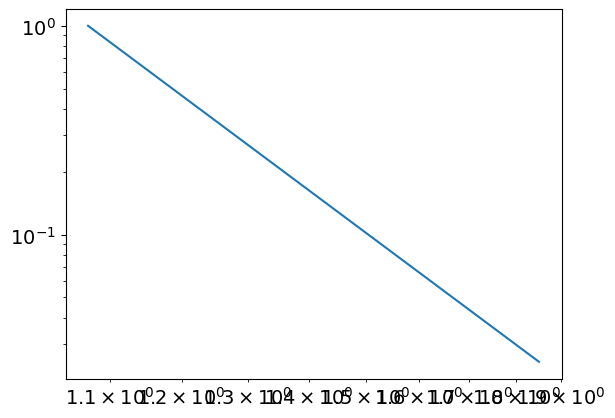

7.780026543666437
1.0712699366562959
powerlaw KstestResult(statistic=0.995186885739549, pvalue=0.0, statistic_location=1.4820820201512506, statistic_sign=1)
lognorm KstestResult(statistic=0.9888049142010972, pvalue=0.0, statistic_location=1.2413552535615915, statistic_sign=1)
tensor(0.0750, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2088, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2185, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7765, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
173
tensor(3.9994e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


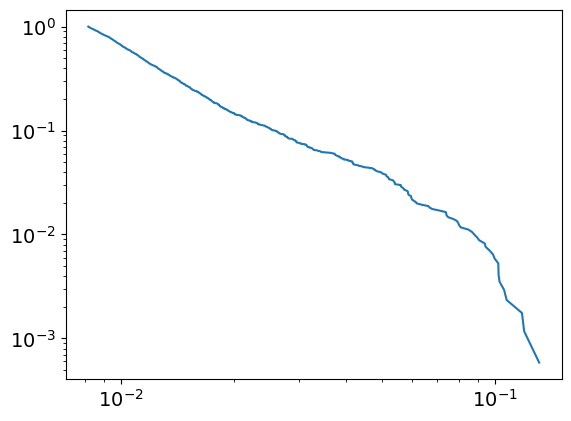

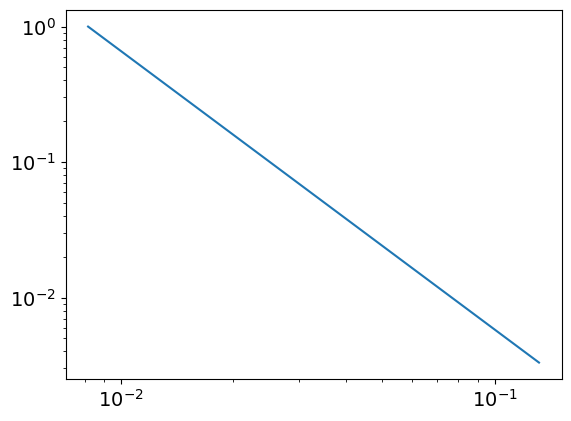

3.055222116355144
0.008168092983788984
powerlaw KstestResult(statistic=0.9991386852105324, pvalue=0.0, statistic_location=0.10237225589347836, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13145571602878048, statistic_sign=-1)
tensor(-1.9009e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4395, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.9541, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
173
tensor(0.1692, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


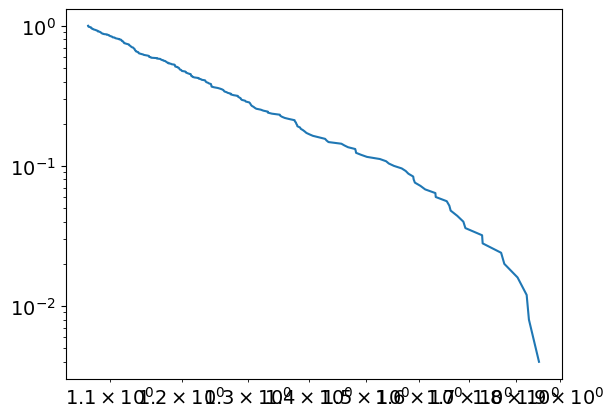

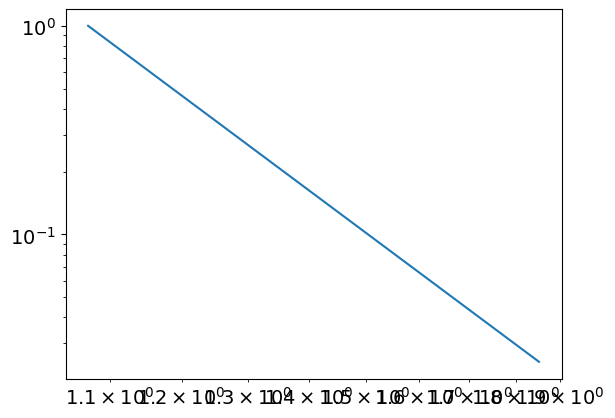

7.778019506511708
1.0712068928205998
powerlaw KstestResult(statistic=0.995168844428321, pvalue=0.0, statistic_location=1.4828827004396203, statistic_sign=1)
lognorm KstestResult(statistic=0.9887309654288482, pvalue=0.0, statistic_location=1.240460360311484, statistic_sign=1)
tensor(0.0749, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2191, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7806, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
174
tensor(4.3865e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


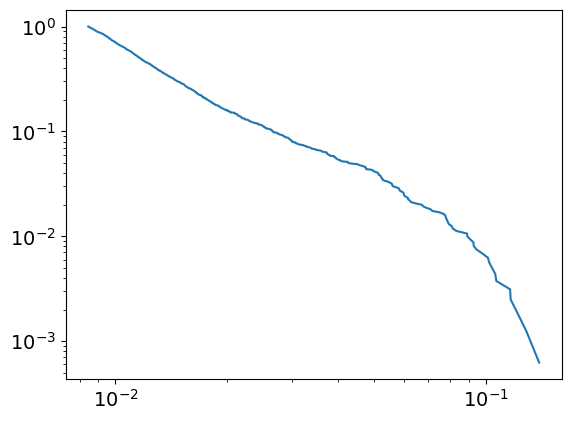

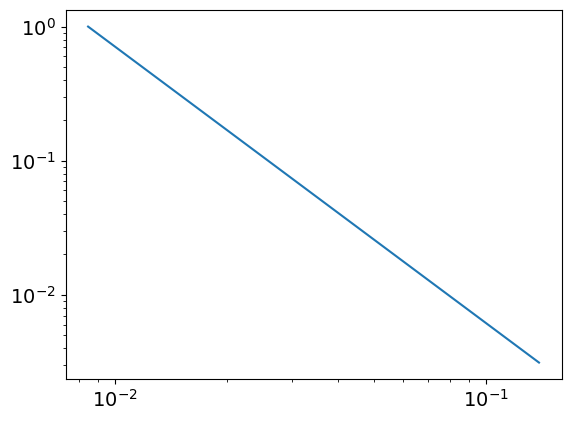

3.0576326754672993
0.008445748800468186
powerlaw KstestResult(statistic=0.9990673956842, pvalue=0.0, statistic_location=0.09433161768880743, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13935881816257906, statistic_sign=-1)
tensor(-4.3521e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5725, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.1270, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
174
tensor(0.1694, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


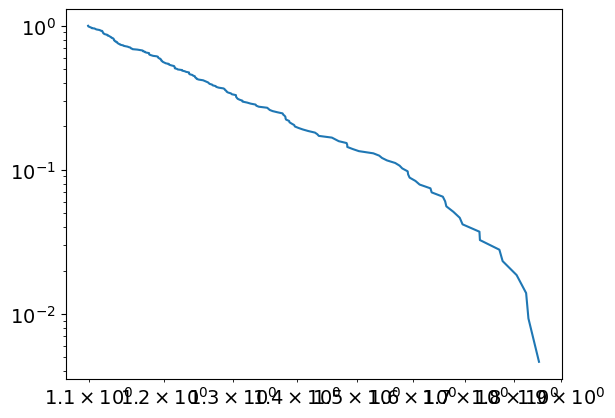

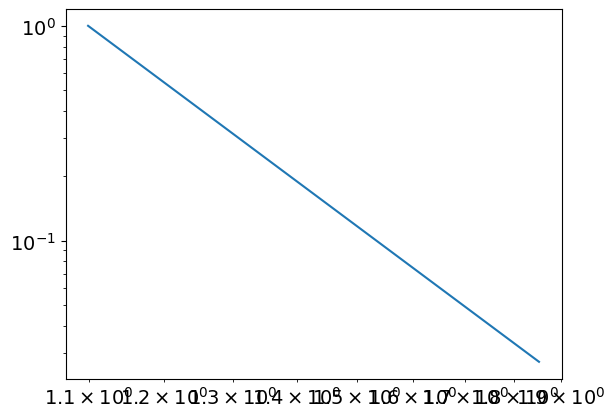

7.896818591727819
1.0989347740476227
powerlaw KstestResult(statistic=0.9956633161663513, pvalue=0.0, statistic_location=1.4928098300782764, statistic_sign=1)
lognorm KstestResult(statistic=0.9887202928392906, pvalue=0.0, statistic_location=1.240911984255245, statistic_sign=1)
tensor(0.0749, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2197, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7848, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
175
tensor(3.9861e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


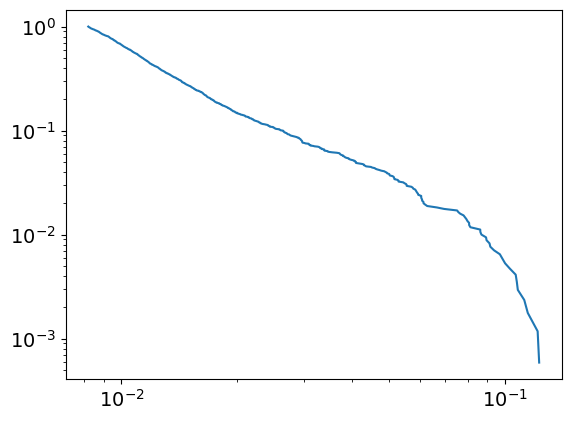

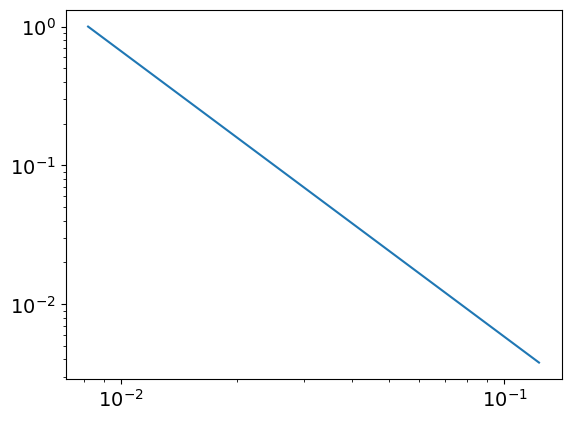

3.0574971090950123
0.008194196951747335
powerlaw KstestResult(statistic=0.998996207302065, pvalue=0.0, statistic_location=0.10318772495420303, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12304688535743591, statistic_sign=-1)
tensor(-2.1036e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3455, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.6713, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
175
tensor(0.1696, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


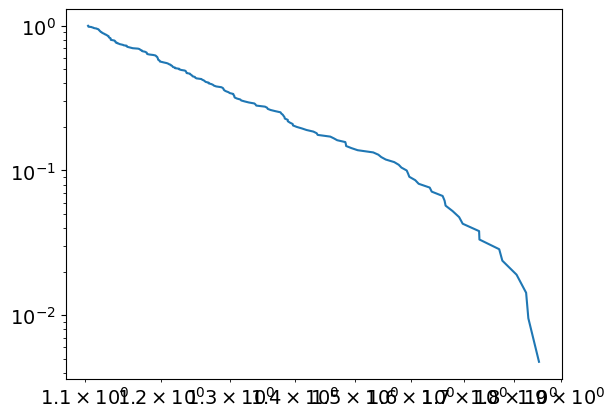

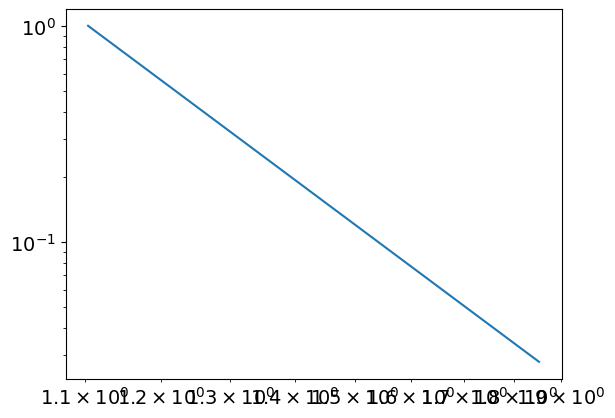

7.915318036545722
1.103781691913732
powerlaw KstestResult(statistic=0.9957225528964351, pvalue=0.0, statistic_location=1.4936833034457324, statistic_sign=1)
lognorm KstestResult(statistic=0.9887092173146781, pvalue=0.0, statistic_location=1.2413735563339803, statistic_sign=1)
tensor(0.0748, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2204, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7890, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
176
tensor(4.3393e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


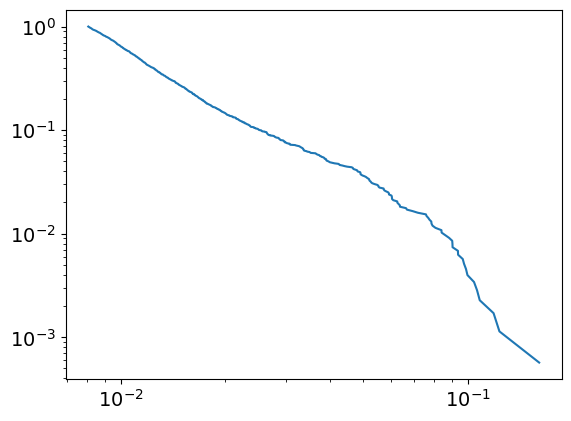

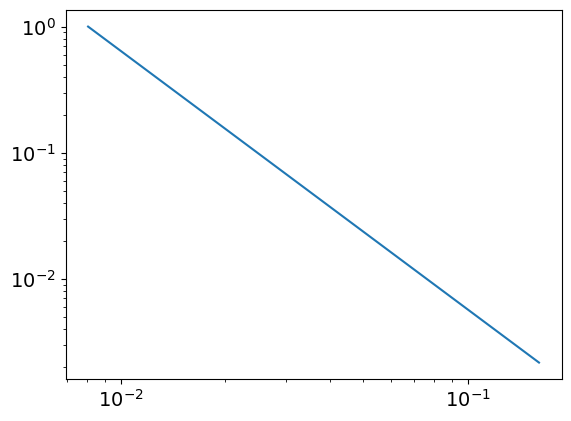

3.0493460311117735
0.00805363705719715
powerlaw KstestResult(statistic=0.9990609999192122, pvalue=0.0, statistic_location=0.0936925998463686, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12327029511156676, statistic_sign=-1)
tensor(-7.4258e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0162, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3878, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
176
tensor(0.1698, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


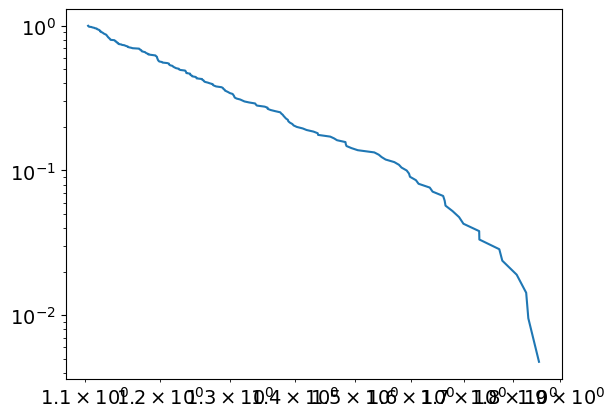

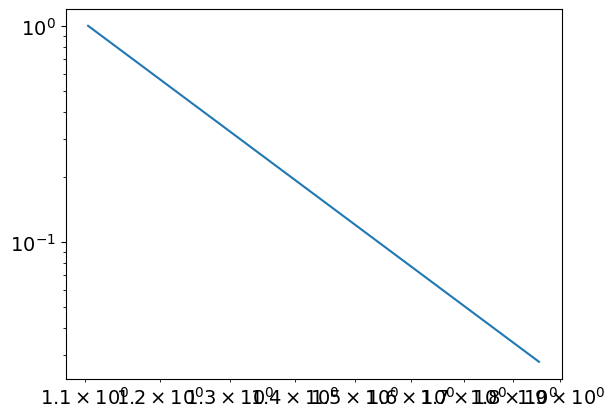

7.916563679714508
1.104409257590402
powerlaw KstestResult(statistic=0.9957214555275287, pvalue=0.0, statistic_location=1.4944620239385145, statistic_sign=1)
lognorm KstestResult(statistic=0.9886962416881881, pvalue=0.0, statistic_location=1.2418777726653027, statistic_sign=1)
tensor(0.0747, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2090, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2210, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7932, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
177
tensor(4.4079e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


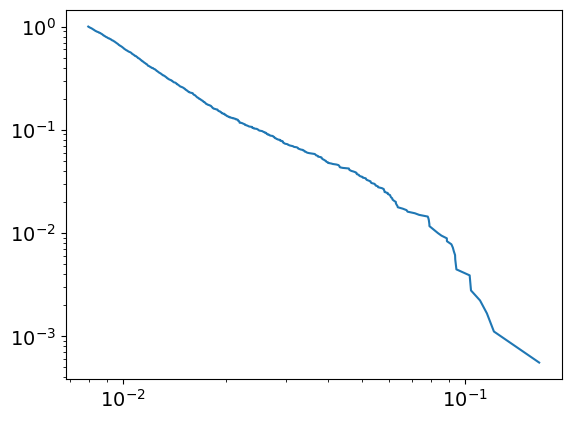

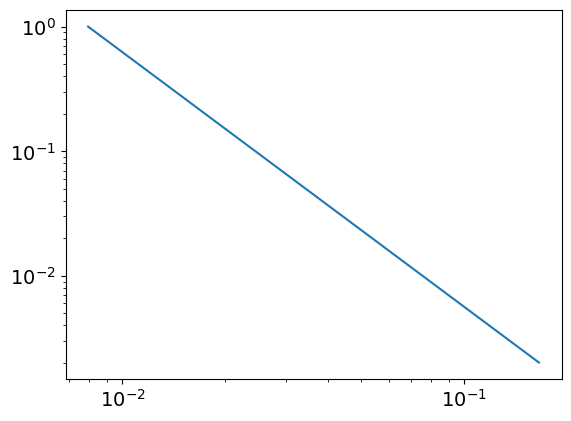

3.0451622069305775
0.007938743700857195
powerlaw KstestResult(statistic=0.999050735347436, pvalue=0.0, statistic_location=0.09380297410272241, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12182808077601505, statistic_sign=-1)
tensor(-4.7522e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0033, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.9902, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
177
tensor(0.1701, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


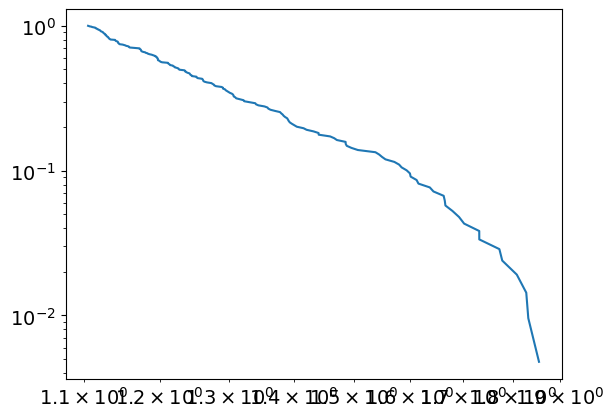

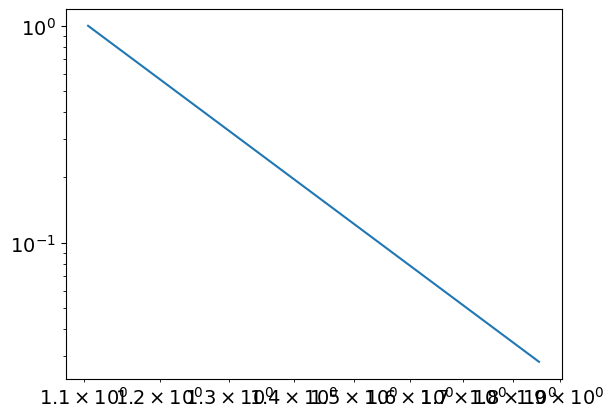

7.8858037244753945
1.105158316061494
powerlaw KstestResult(statistic=0.9957025541074402, pvalue=0.0, statistic_location=1.49536607602208, statistic_sign=1)
lognorm KstestResult(statistic=0.9886556147082779, pvalue=0.0, statistic_location=1.242925293328526, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2090, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2217, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7974, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
178
tensor(4.9439e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


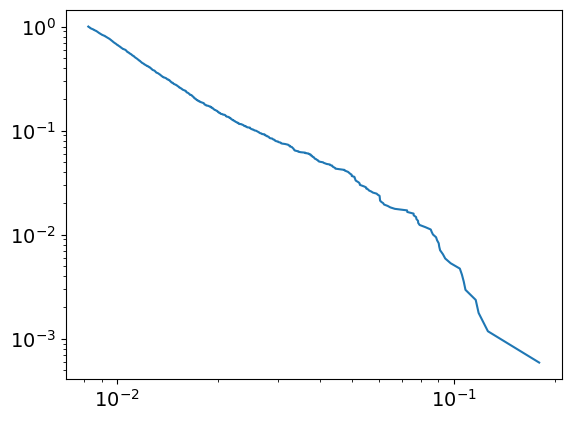

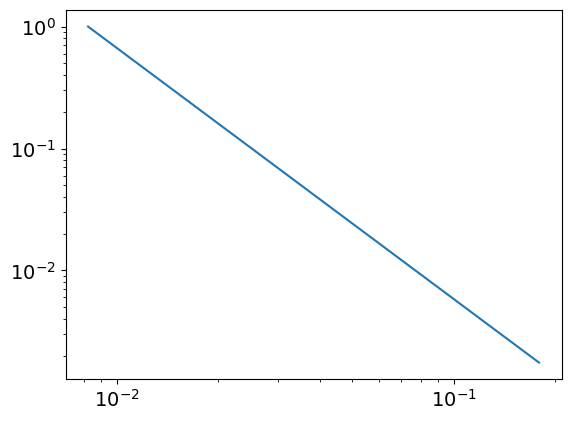

3.0577273370864146
0.00821275020181832
powerlaw KstestResult(statistic=0.999063219319467, pvalue=0.0, statistic_location=0.09431792268817163, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1262868191408596, statistic_sign=-1)
tensor(-1.5518e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0777, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.0082, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
178
tensor(0.1704, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


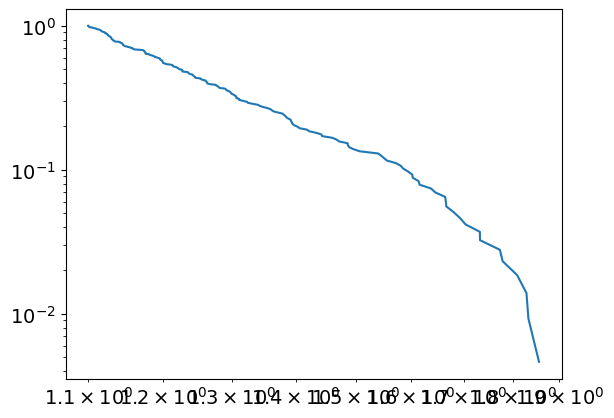

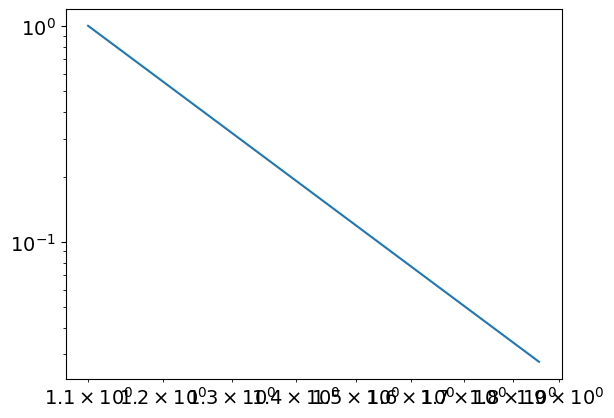

7.8507477580426555
1.0996205900897522
powerlaw KstestResult(statistic=0.9955986640348419, pvalue=0.0, statistic_location=1.4961960576484268, statistic_sign=1)
lognorm KstestResult(statistic=0.9886169271917974, pvalue=0.0, statistic_location=1.2439183133955178, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2090, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2224, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8017, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
179
tensor(4.2225e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


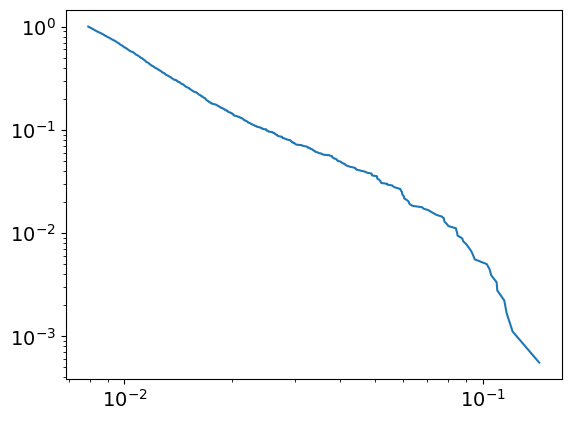

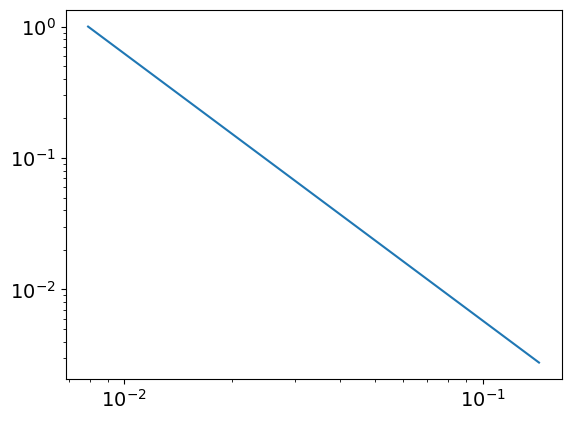

3.031605120352081
0.00792662279487734
powerlaw KstestResult(statistic=0.9990276879056462, pvalue=0.0, statistic_location=0.09397764621805908, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1211596293935388, statistic_sign=-1)
tensor(-3.4910e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4712, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1830, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
179
tensor(0.1706, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


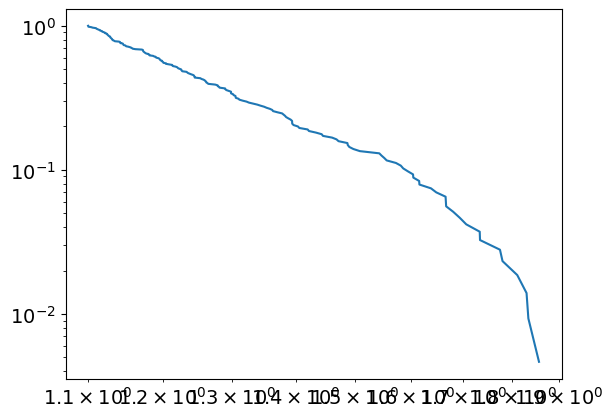

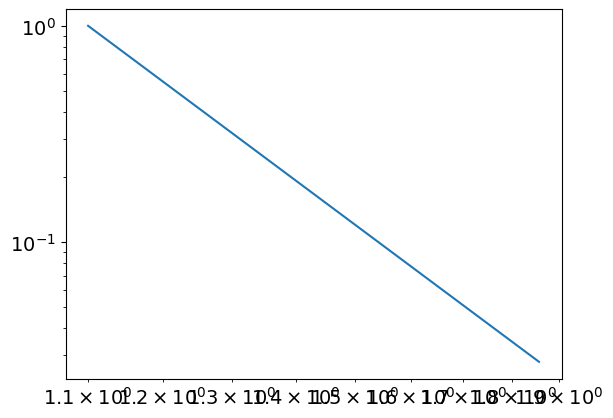

7.841117120477826
1.100738848535035
powerlaw KstestResult(statistic=0.9955966689775189, pvalue=0.0, statistic_location=1.4970073968993973, statistic_sign=1)
lognorm KstestResult(statistic=0.98857755226943, pvalue=0.0, statistic_location=1.2449048713045976, statistic_sign=1)
tensor(0.0745, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2091, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2231, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8058, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
180
tensor(4.2505e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


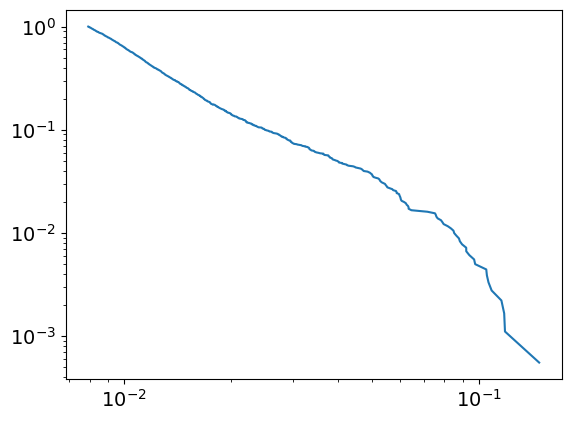

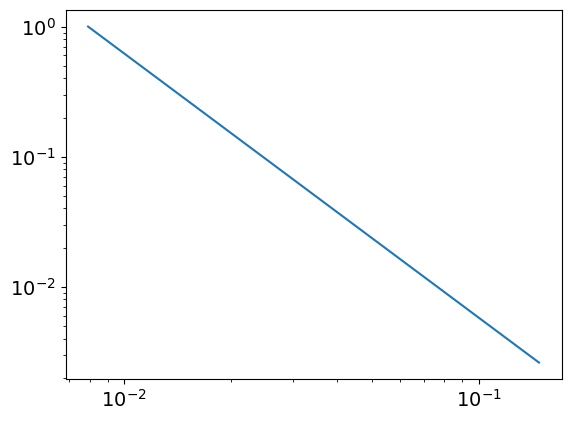

3.0308721599876507
0.007920736144951564
powerlaw KstestResult(statistic=0.9990246030220721, pvalue=0.0, statistic_location=0.0940689186091993, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11853826726866382, statistic_sign=-1)
tensor(-1.1137e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2906, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1103, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
180
tensor(0.1709, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


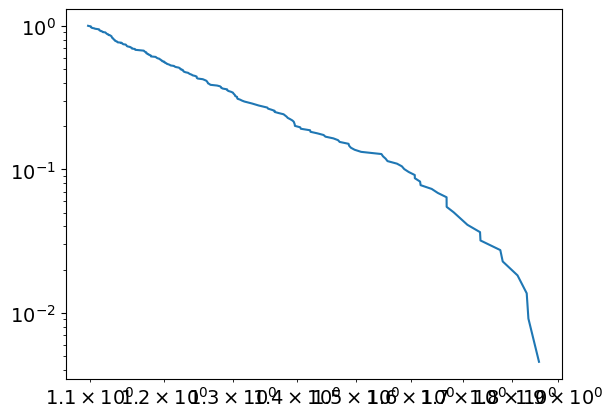

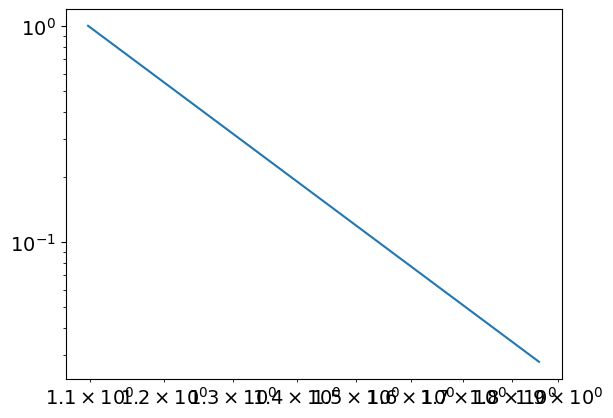

7.808596617206651
1.0976977834654758
powerlaw KstestResult(statistic=0.9955173759772444, pvalue=0.0, statistic_location=1.4978714521919851, statistic_sign=1)
lognorm KstestResult(statistic=0.9885718163177484, pvalue=0.0, statistic_location=1.2274404073149732, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2091, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2238, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8101, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
181
tensor(4.3546e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


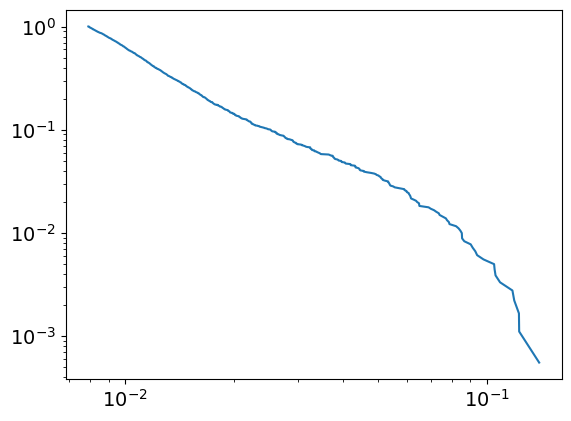

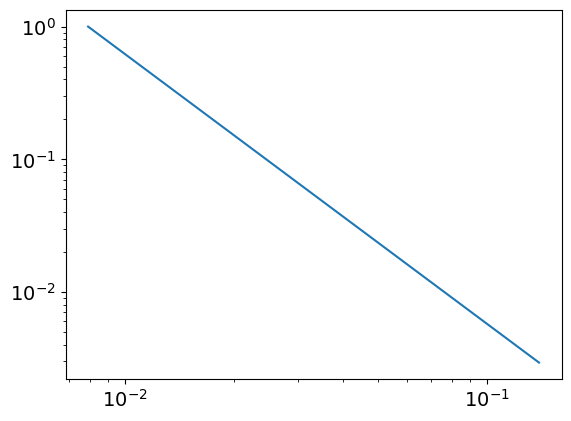

3.0333763421568647
0.007910588801449297
powerlaw KstestResult(statistic=0.99903127845427, pvalue=0.0, statistic_location=0.09391160449109985, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12270311270824806, statistic_sign=-1)
tensor(-2.0833e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4182, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.7894, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
181
tensor(0.1711, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


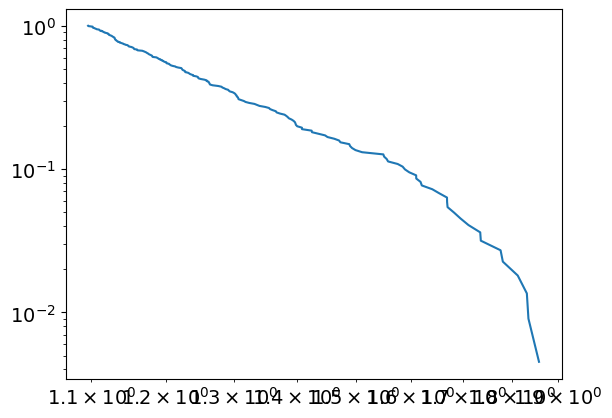

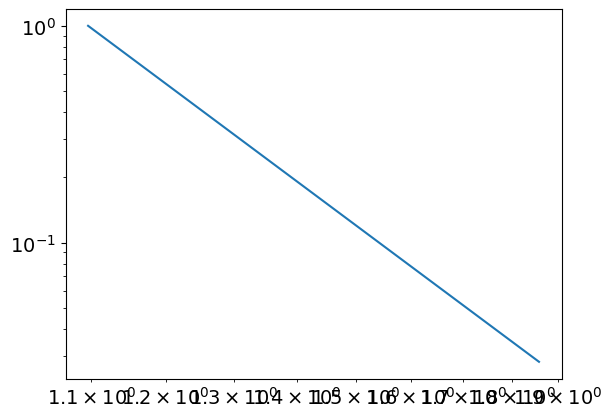

7.758646987626034
1.0956982612361745
powerlaw KstestResult(statistic=0.995433990402007, pvalue=0.0, statistic_location=1.4987380834626962, statistic_sign=1)
lognorm KstestResult(statistic=0.9885693177435303, pvalue=0.0, statistic_location=1.2278264254241165, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2092, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2246, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8145, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
182
tensor(4.8106e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


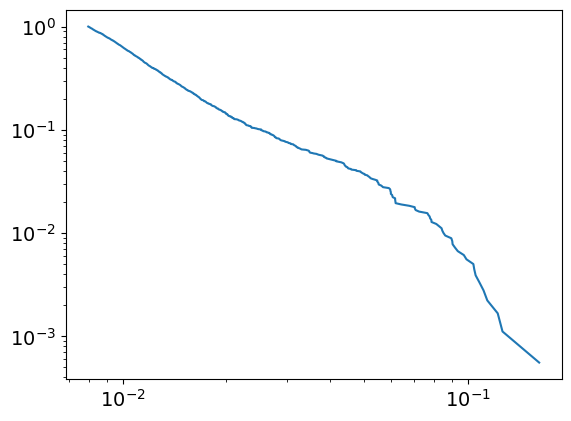

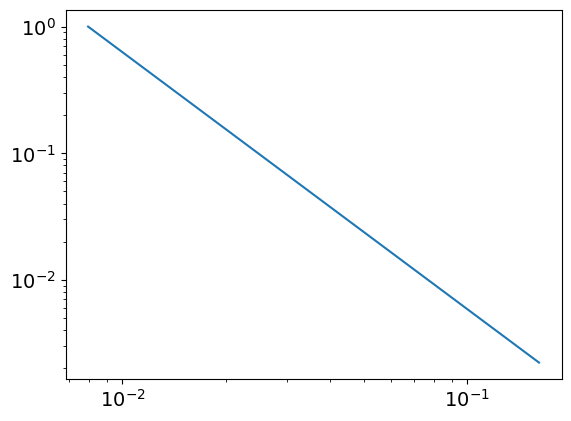

3.0292550579961195
0.007947527867857629
powerlaw KstestResult(statistic=0.9990304485500737, pvalue=0.0, statistic_location=0.09370201422103619, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12232866614600084, statistic_sign=-1)
tensor(-3.1607e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2844, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.9106, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
182
tensor(0.1714, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


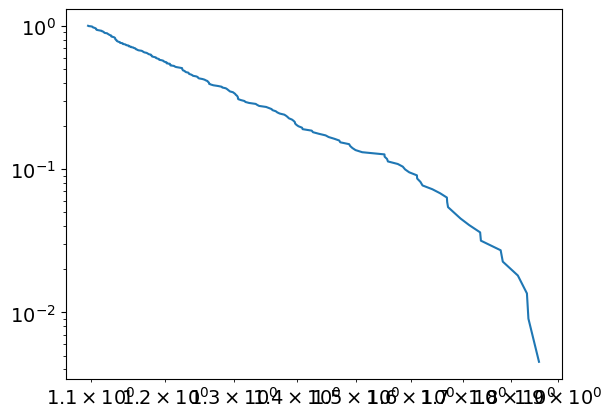

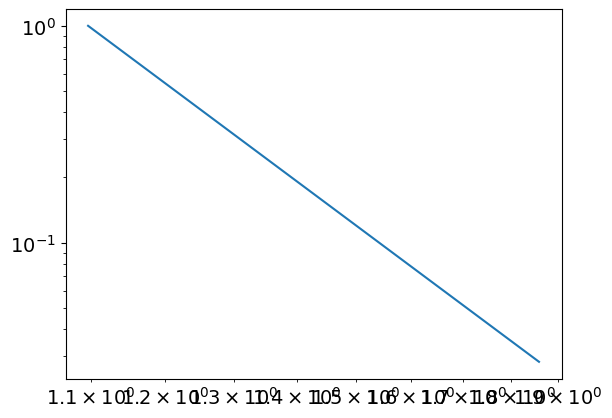

7.755673558645585
1.0962397396610501
powerlaw KstestResult(statistic=0.9954276097275294, pvalue=0.0, statistic_location=1.4995202554251712, statistic_sign=1)
lognorm KstestResult(statistic=0.9885775150044568, pvalue=0.0, statistic_location=1.2329997838105724, statistic_sign=1)
tensor(0.0742, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2092, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2253, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8189, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
183
tensor(4.4361e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


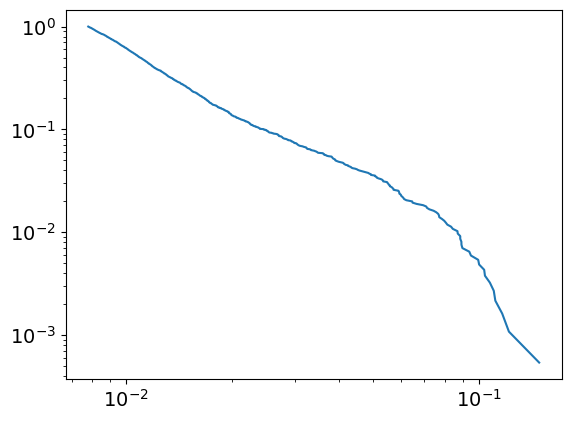

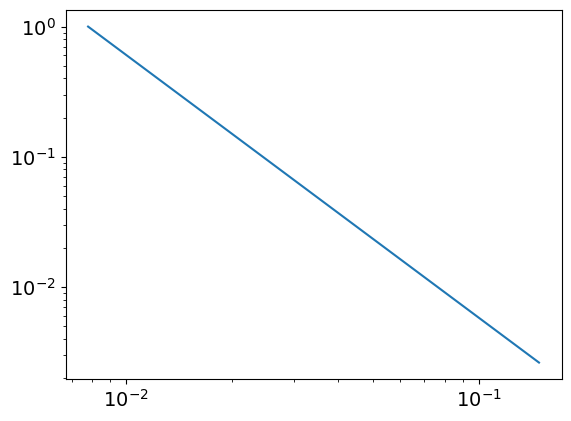

3.0168256618042855
0.007798725684155724
powerlaw KstestResult(statistic=0.9990040831166094, pvalue=0.0, statistic_location=0.09393534810301836, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11645004782510192, statistic_sign=-1)
tensor(-2.4135e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.3911, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
183
tensor(0.1716, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


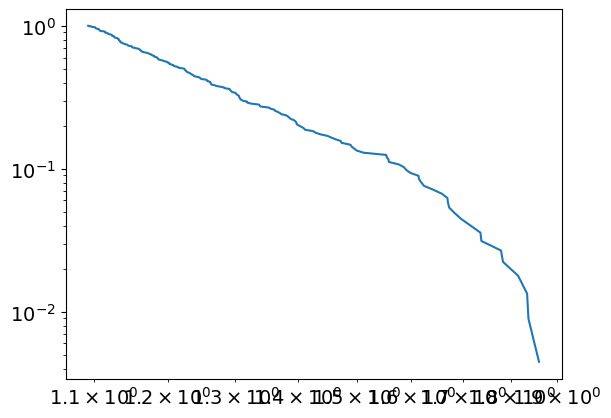

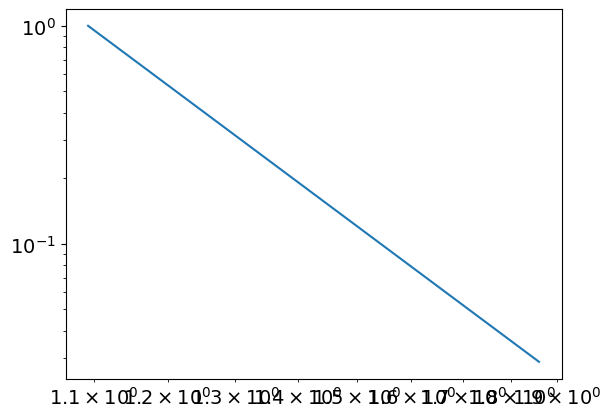

7.670950979528135
1.0926230763287388
powerlaw KstestResult(statistic=0.9952748858579713, pvalue=0.0, statistic_location=1.5003550934005705, statistic_sign=1)
lognorm KstestResult(statistic=0.9885919784051211, pvalue=0.0, statistic_location=1.2327621559217177, statistic_sign=1)
tensor(0.0741, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2092, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2261, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8233, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
184
tensor(4.4176e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


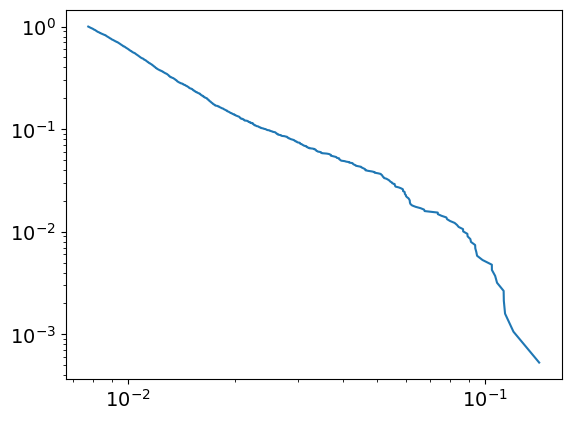

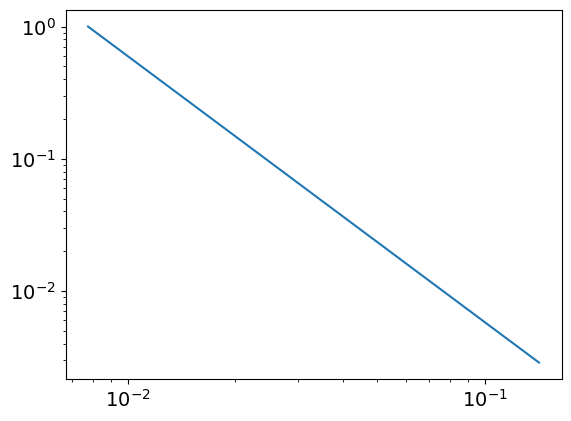

3.0126829315212924
0.0077443782259289315
powerlaw KstestResult(statistic=0.998983295959448, pvalue=0.0, statistic_location=0.09454621481521372, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12016136429978652, statistic_sign=-1)
tensor(-1.3637e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3914, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.9132, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
184
tensor(0.1719, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


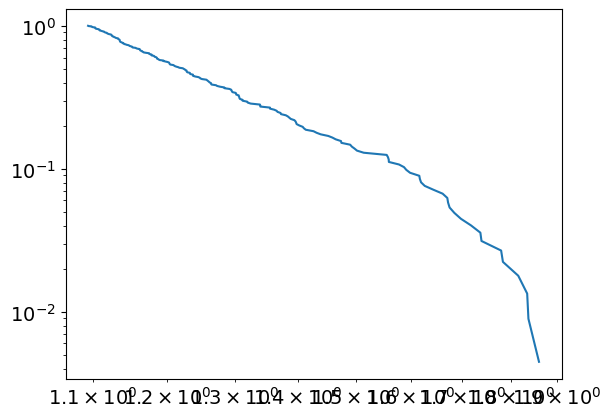

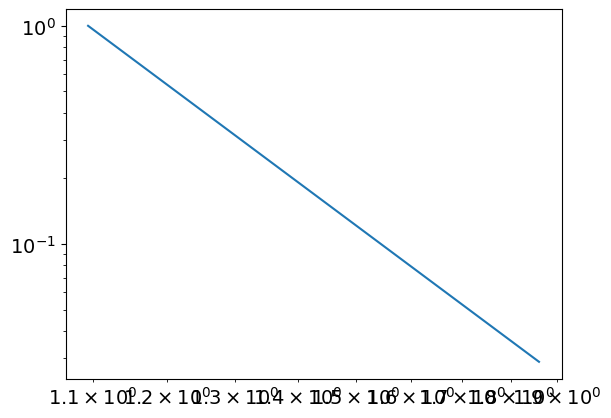

7.667740177511038
1.0931984888632746
powerlaw KstestResult(statistic=0.995266711130644, pvalue=0.0, statistic_location=1.5011993624844773, statistic_sign=1)
lognorm KstestResult(statistic=0.9886054858542356, pvalue=0.0, statistic_location=1.2325386979668358, statistic_sign=1)
tensor(0.0740, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2269, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8277, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
185
tensor(5.7915e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


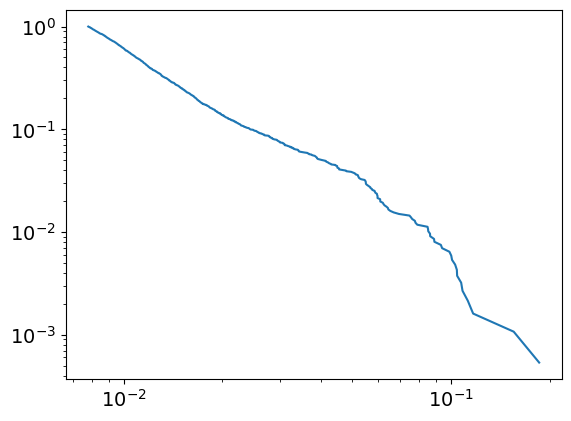

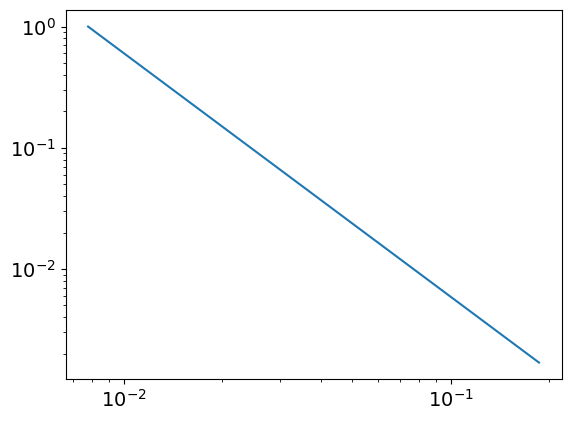

3.0117064888551863
0.007788033713956852
powerlaw KstestResult(statistic=0.9989958915856189, pvalue=0.0, statistic_location=0.09394518109226174, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15544724088207112, statistic_sign=-1)
tensor(-2.4697e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2711, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.9262, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
185
tensor(0.1721, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


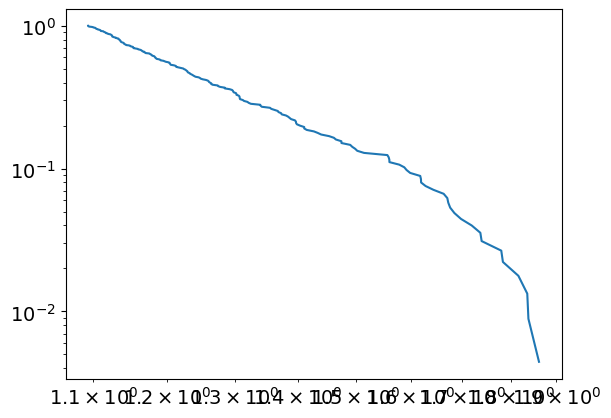

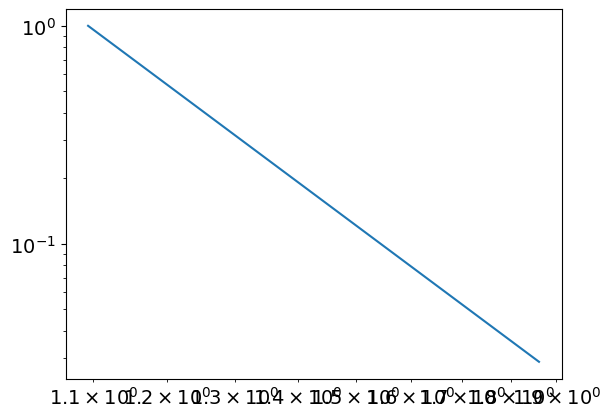

7.666181809789293
1.093048324636436
powerlaw KstestResult(statistic=0.9952471653405496, pvalue=0.0, statistic_location=1.501972241291905, statistic_sign=1)
lognorm KstestResult(statistic=0.9886205121094858, pvalue=0.0, statistic_location=1.2322629272196364, statistic_sign=1)
tensor(0.0739, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2278, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8322, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
186
tensor(6.0559e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


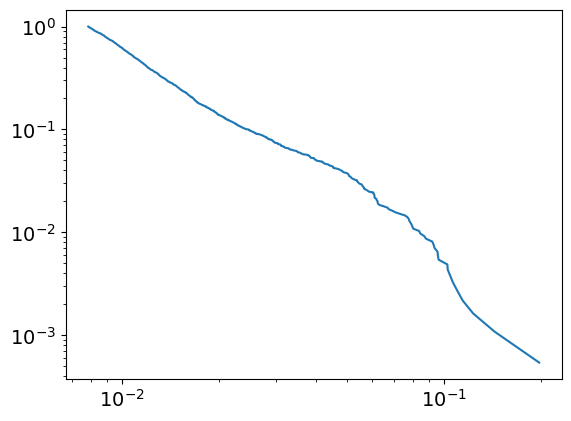

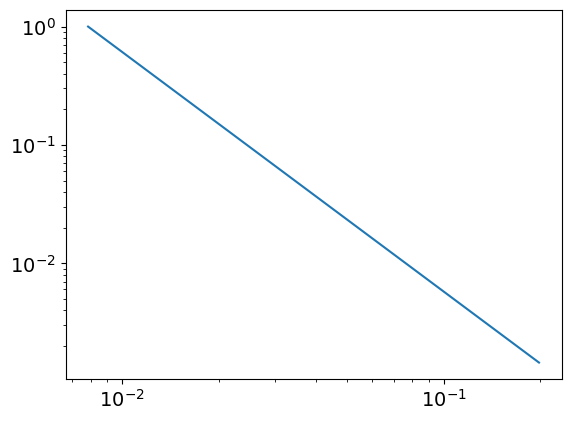

3.0265060063441536
0.00785485980772014
powerlaw KstestResult(statistic=0.9989773569657332, pvalue=0.0, statistic_location=0.09590191898248654, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14383675524664633, statistic_sign=-1)
tensor(-6.6076e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0246, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.9397, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
186
tensor(0.1724, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


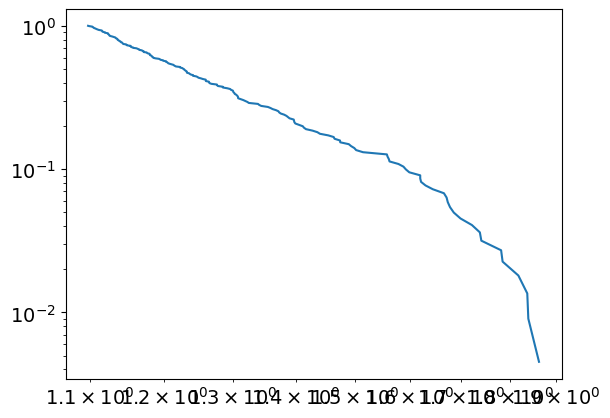

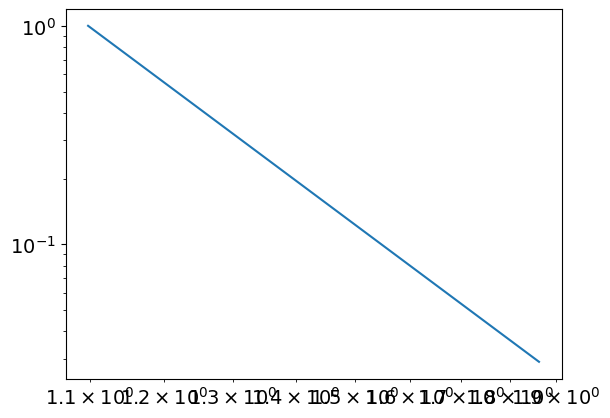

7.693499874412756
1.0973835738874784
powerlaw KstestResult(statistic=0.9953371781367342, pvalue=0.0, statistic_location=1.5028748662432345, statistic_sign=1)
lognorm KstestResult(statistic=0.9886318662246945, pvalue=0.0, statistic_location=1.2321029908340013, statistic_sign=1)
tensor(0.0739, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2286, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8368, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
187
tensor(6.4723e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


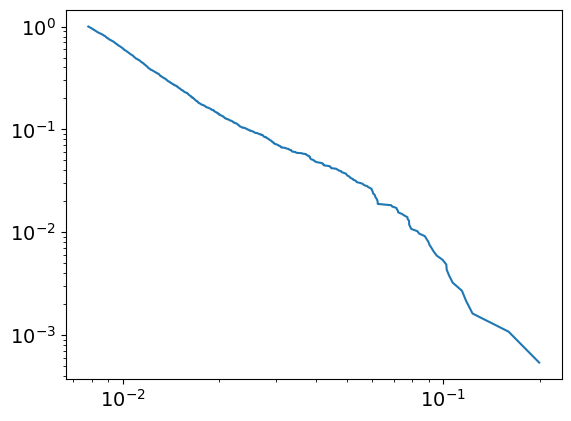

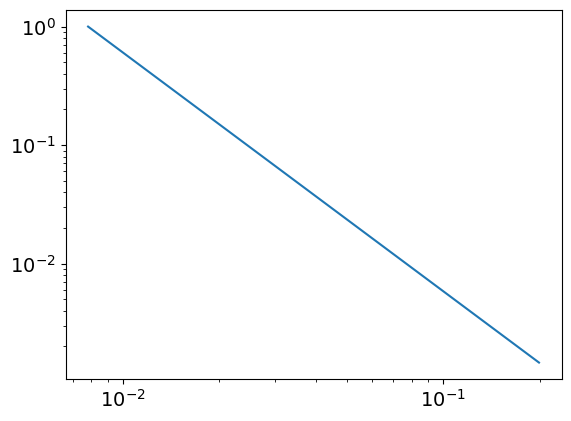

3.0151005838622087
0.007806273797115934
powerlaw KstestResult(statistic=0.9990122163697023, pvalue=0.0, statistic_location=0.09344210925263102, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.15994345279576397, statistic_sign=-1)
tensor(-1.2789e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0655, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.0751, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
187
tensor(0.1726, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


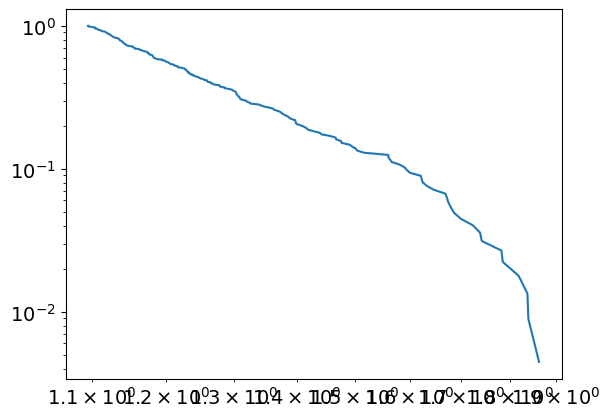

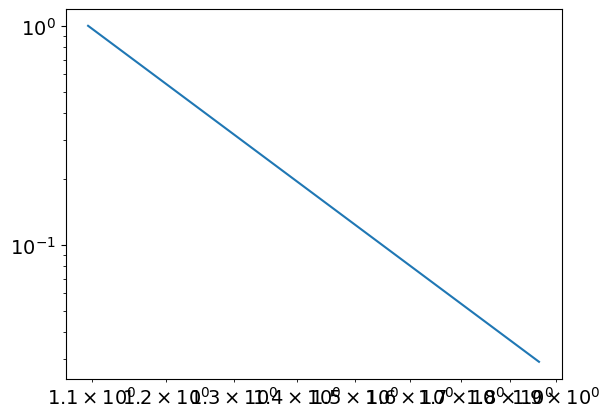

7.6447584215141715
1.0945848812285215
powerlaw KstestResult(statistic=0.9952237569798474, pvalue=0.0, statistic_location=1.5036592241616968, statistic_sign=1)
lognorm KstestResult(statistic=0.9886445025871734, pvalue=0.0, statistic_location=1.2318944907557148, statistic_sign=1)
tensor(0.0738, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2295, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8415, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
188
tensor(5.5615e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


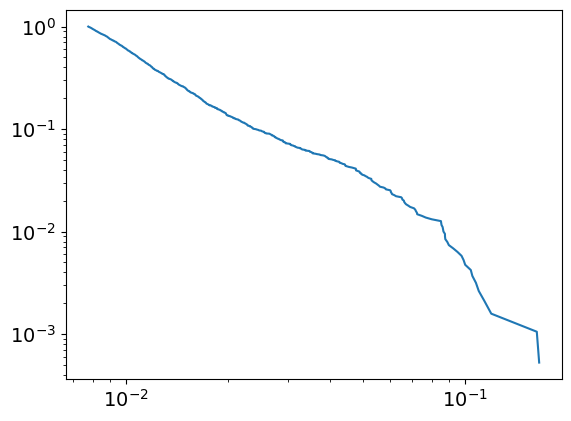

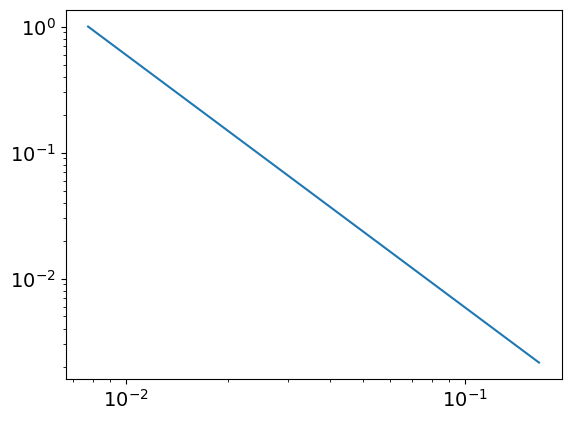

3.0052725179954223
0.007743187316606237
powerlaw KstestResult(statistic=0.999019736695236, pvalue=0.0, statistic_location=0.09234075035174567, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.16285055029364265, statistic_sign=-1)
tensor(-2.2297e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4217, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.0285, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
188
tensor(0.1729, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


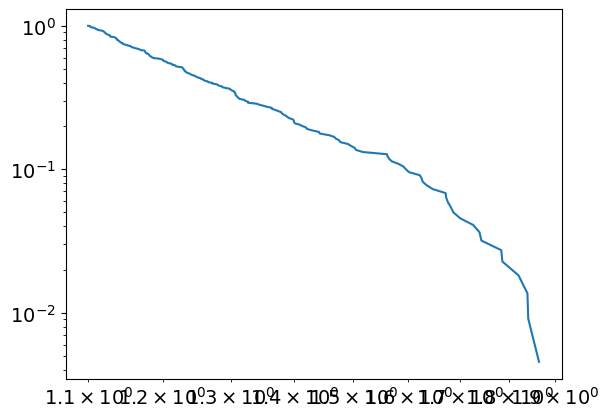

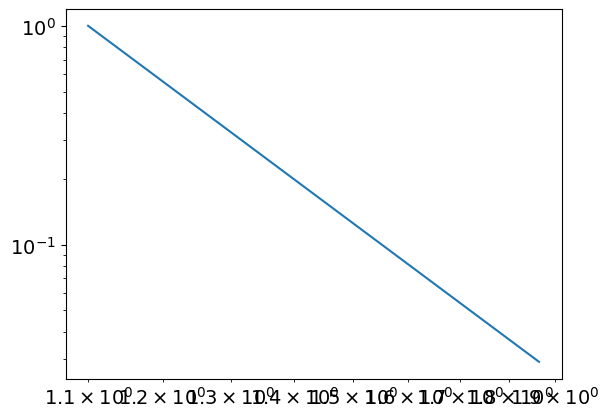

7.700442233326886
1.0996481510193639
powerlaw KstestResult(statistic=0.9953548283929696, pvalue=0.0, statistic_location=1.504496703235027, statistic_sign=1)
lognorm KstestResult(statistic=0.9886171789353237, pvalue=0.0, statistic_location=1.2332983404362423, statistic_sign=1)
tensor(0.0737, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2094, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2304, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8460, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
189
tensor(5.3847e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


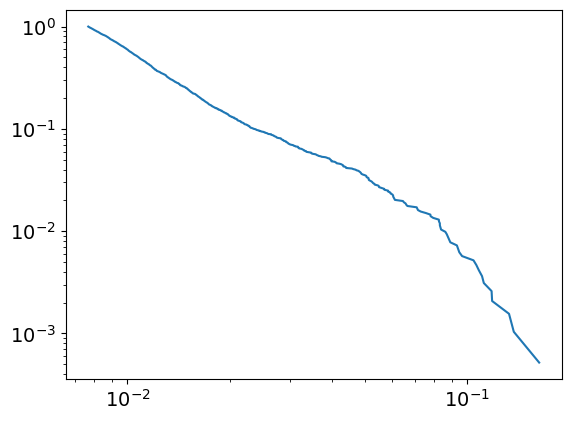

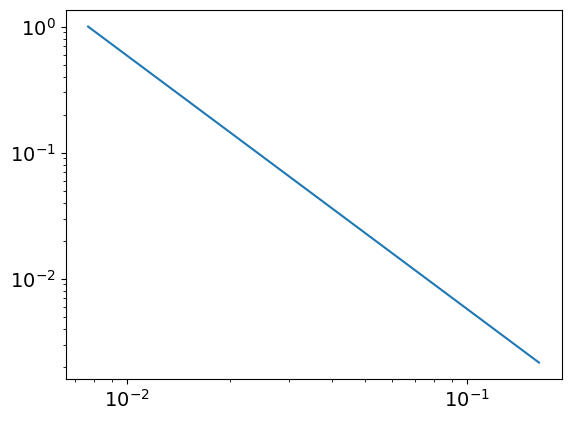

3.009915391241964
0.007673382796241378
powerlaw KstestResult(statistic=0.9988910068274606, pvalue=0.0, statistic_location=0.08614871702177093, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13696226083102325, statistic_sign=-1)
tensor(-2.7778e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3415, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.1694, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
189
tensor(0.1732, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


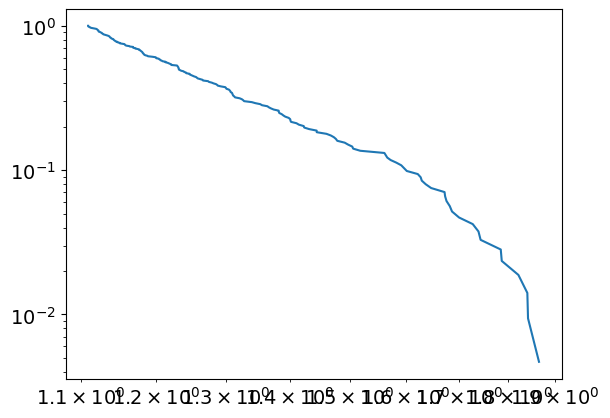

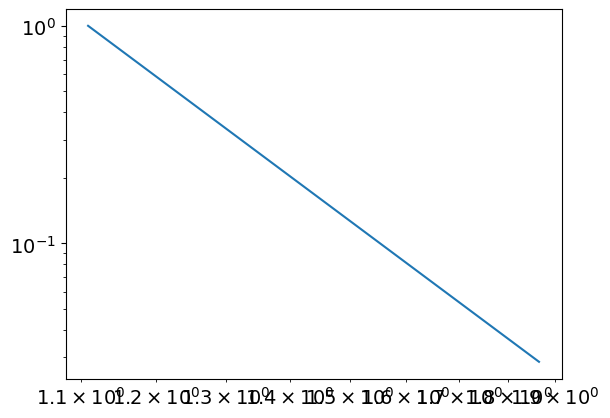

7.842029366362811
1.109065670981241
powerlaw KstestResult(statistic=0.99559752932965, pvalue=0.0, statistic_location=1.5053151292750855, statistic_sign=1)
lognorm KstestResult(statistic=0.9885893089872209, pvalue=0.0, statistic_location=1.2346615456167511, statistic_sign=1)
tensor(0.0735, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2094, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2313, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8507, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
190
tensor(5.8298e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


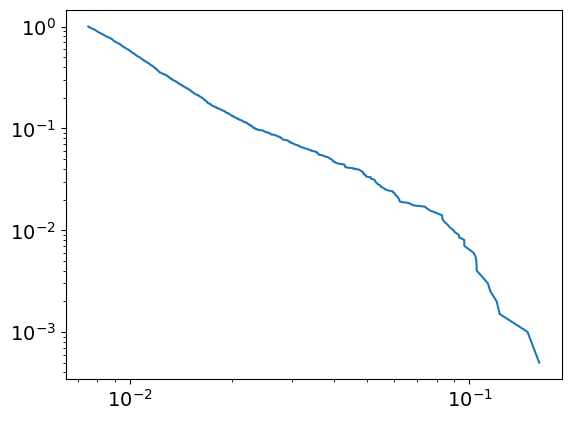

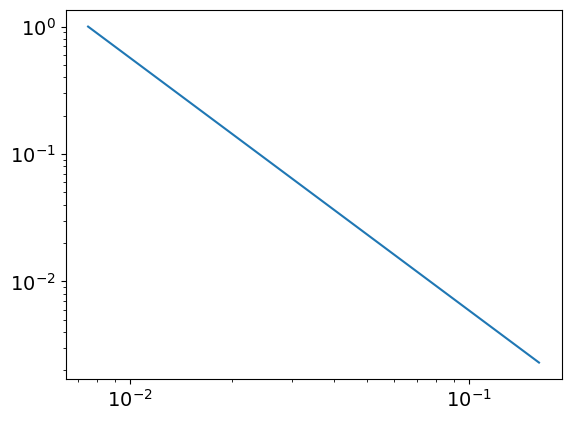

2.983605110539401
0.0075166533944676156
powerlaw KstestResult(statistic=0.9987816758471326, pvalue=0.0, statistic_location=0.10502699558477419, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14834956836368018, statistic_sign=-1)
tensor(-8.2781e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0713, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.8004, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
190
tensor(0.1734, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


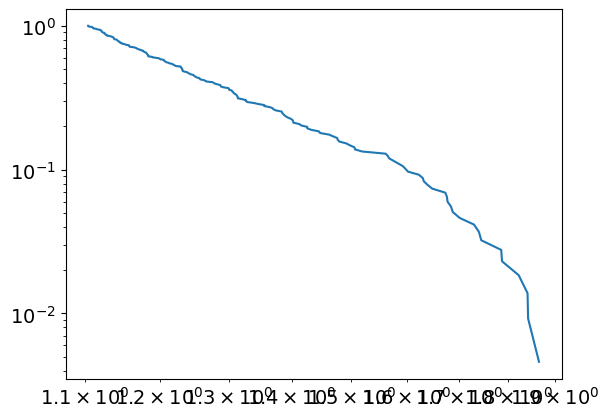

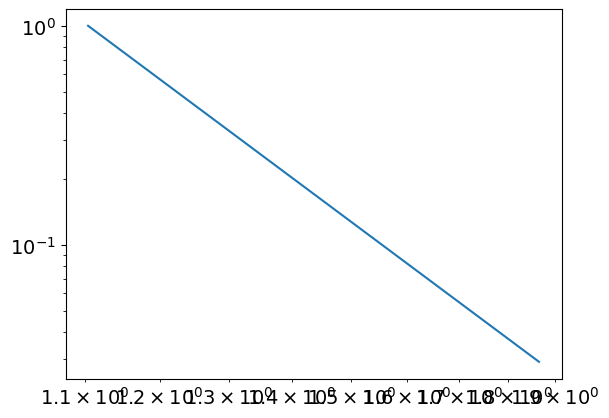

7.730280070117852
1.1040314237567428
powerlaw KstestResult(statistic=0.9954271009799923, pvalue=0.0, statistic_location=1.506140984462513, statistic_sign=1)
lognorm KstestResult(statistic=0.9885571434424448, pvalue=0.0, statistic_location=1.2361155035860059, statistic_sign=1)
tensor(0.0734, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2094, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2323, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8554, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
191
tensor(5.7252e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


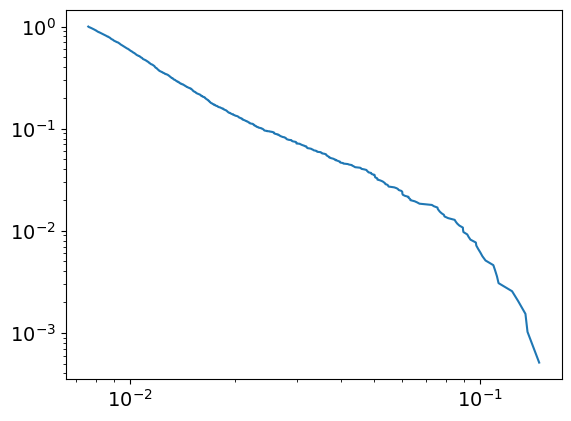

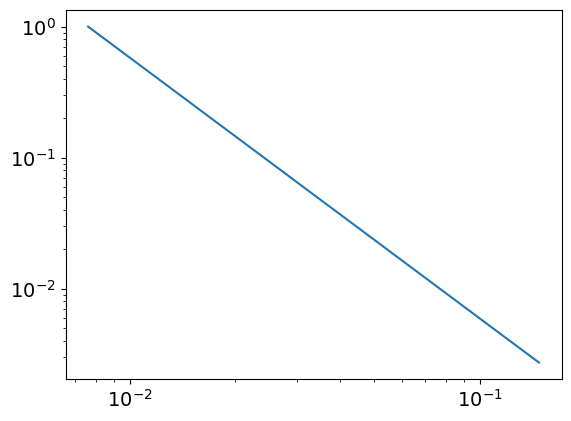

2.9913131962307515
0.007611786486930812
powerlaw KstestResult(statistic=0.9987091297512767, pvalue=0.0, statistic_location=0.1037993128484333, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.147712968793118, statistic_sign=-1)
tensor(-2.9378e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2913, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.2794, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
191
tensor(0.1737, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


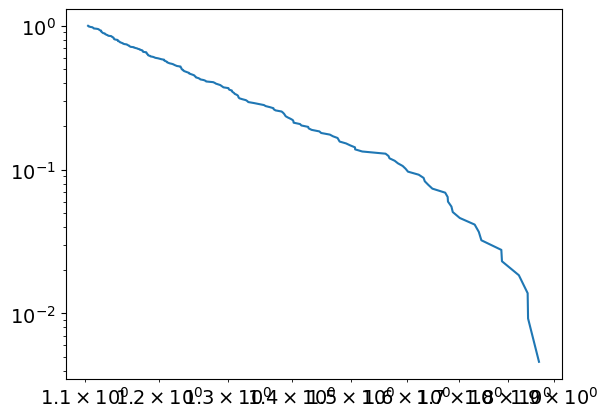

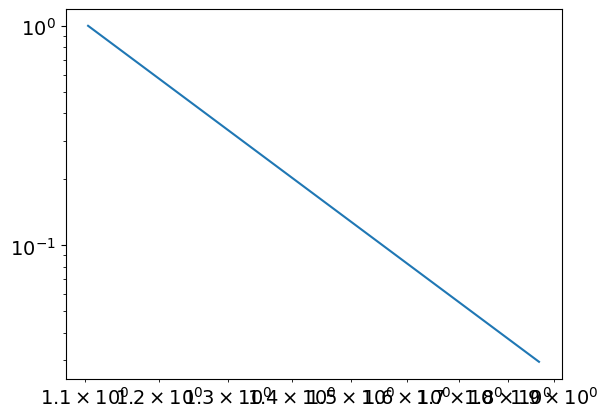

7.713044854004295
1.1043219115616447
powerlaw KstestResult(statistic=0.9954039938050516, pvalue=0.0, statistic_location=1.5069737948122643, statistic_sign=1)
lognorm KstestResult(statistic=0.9885224298520937, pvalue=0.0, statistic_location=1.237572850226905, statistic_sign=1)
tensor(0.0733, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2094, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2332, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8603, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
192
tensor(4.9525e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


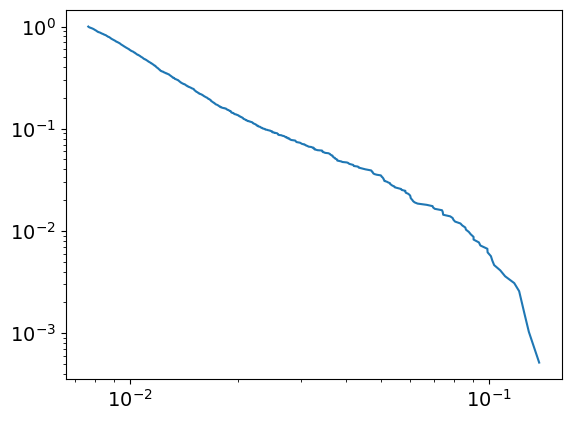

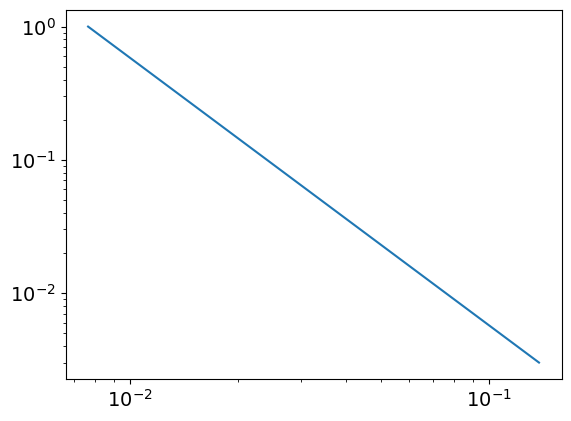

3.007405964915278
0.007640430698598219
powerlaw KstestResult(statistic=0.9987917130734394, pvalue=0.0, statistic_location=0.10200161453972578, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.12301876559739482, statistic_sign=1)
tensor(2.7136e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2500, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6259, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
192
tensor(0.1740, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


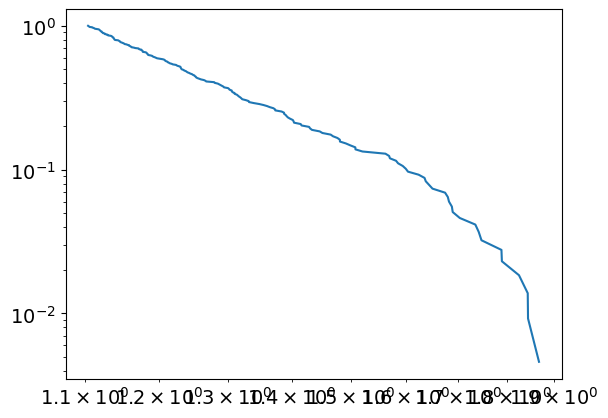

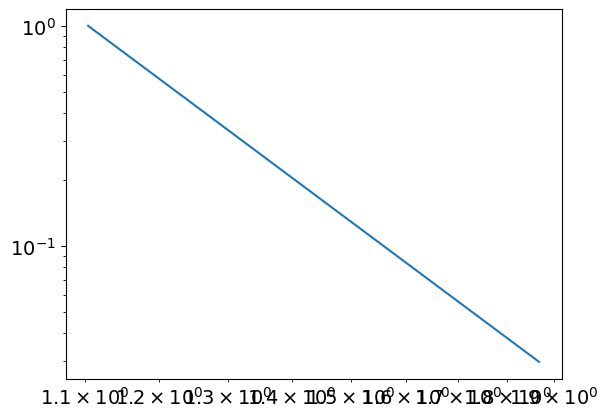

7.69489448823862
1.1045858319124175
powerlaw KstestResult(statistic=0.9953737436312006, pvalue=0.0, statistic_location=1.508110193706549, statistic_sign=1)
lognorm KstestResult(statistic=0.9884868856175122, pvalue=0.0, statistic_location=1.239016229534706, statistic_sign=1)
tensor(0.0732, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2342, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8651, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
193
tensor(5.4151e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


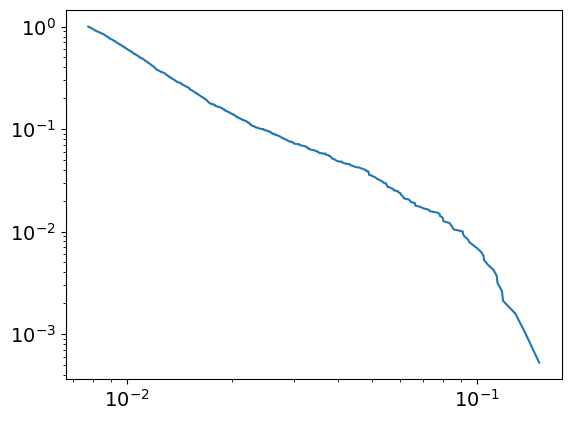

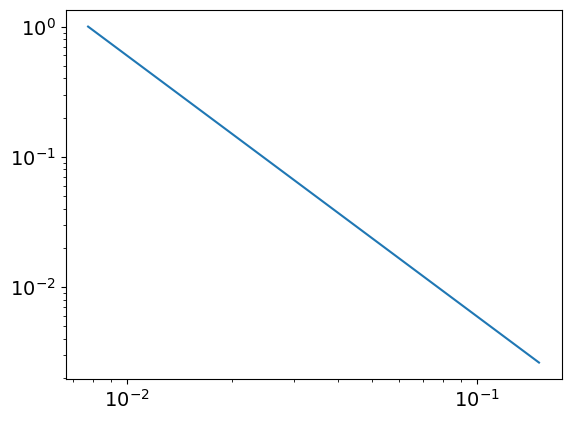

3.004504142898455
0.007747413659132915
powerlaw KstestResult(statistic=0.9986007950112227, pvalue=0.0, statistic_location=0.10423958196054163, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15030509905455294, statistic_sign=1)
tensor(2.5292e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0974, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.2939, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
193
tensor(0.1742, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


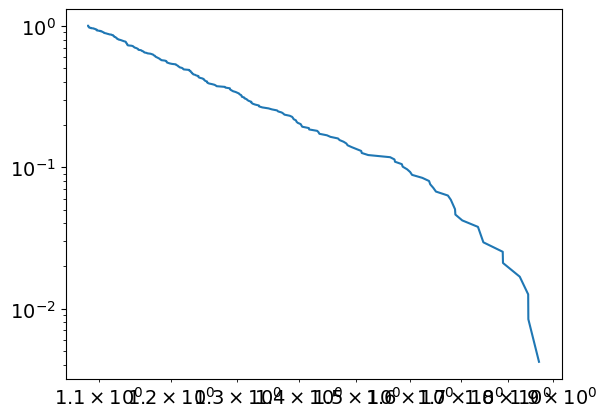

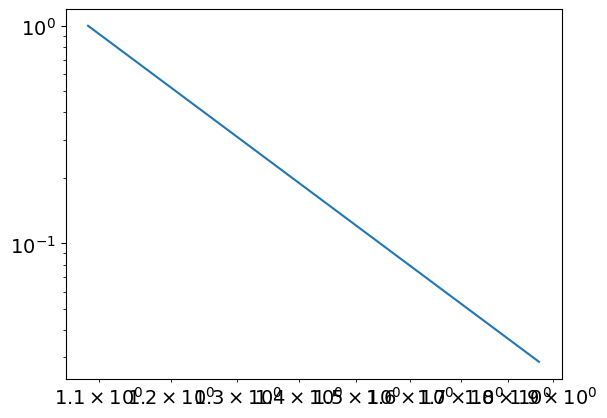

7.55289428770771
1.086210273551052
powerlaw KstestResult(statistic=0.9948414629936295, pvalue=0.0, statistic_location=1.4841458182984757, statistic_sign=1)
lognorm KstestResult(statistic=0.9884923201095417, pvalue=0.0, statistic_location=1.2426747762742283, statistic_sign=1)
tensor(0.0731, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2352, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8700, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
194
tensor(4.8762e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


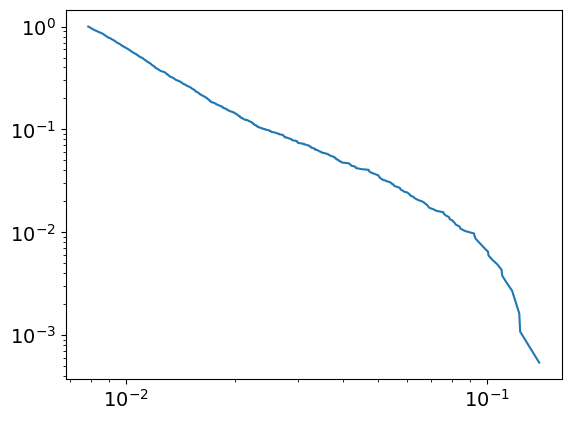

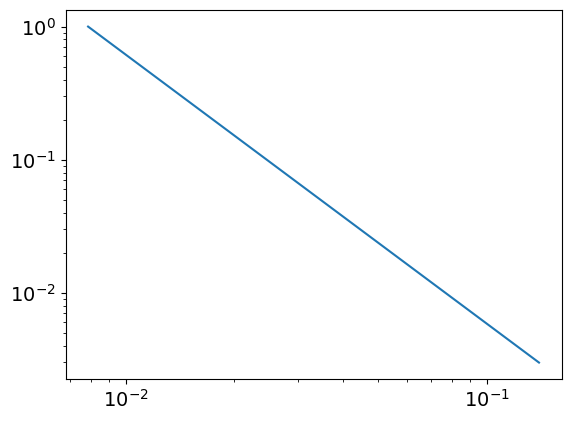

3.021423100043318
0.007864353668512175
powerlaw KstestResult(statistic=0.9986133892567973, pvalue=0.0, statistic_location=0.09469648201713489, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1394906076341565, statistic_sign=1)
tensor(2.1401e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2037, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.0329, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
194
tensor(0.1745, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


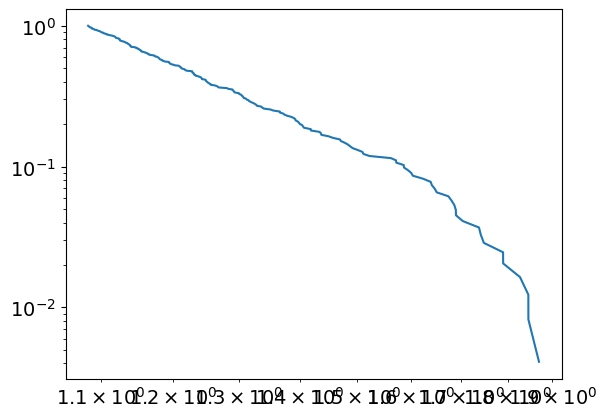

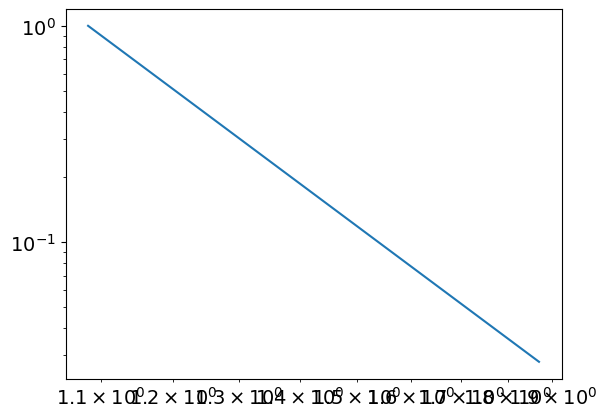

7.55290901285782
1.0828016899661184
powerlaw KstestResult(statistic=0.9947577549257739, pvalue=0.0, statistic_location=1.4914658860155154, statistic_sign=1)
lognorm KstestResult(statistic=0.9884930153042192, pvalue=0.0, statistic_location=1.2429995072070568, statistic_sign=1)
tensor(0.0730, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2363, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8749, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
195
tensor(4.1016e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


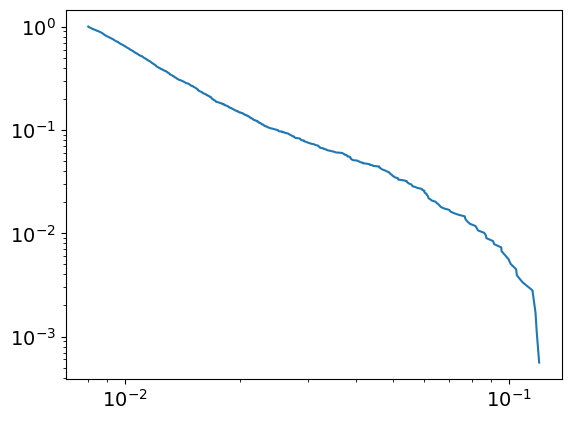

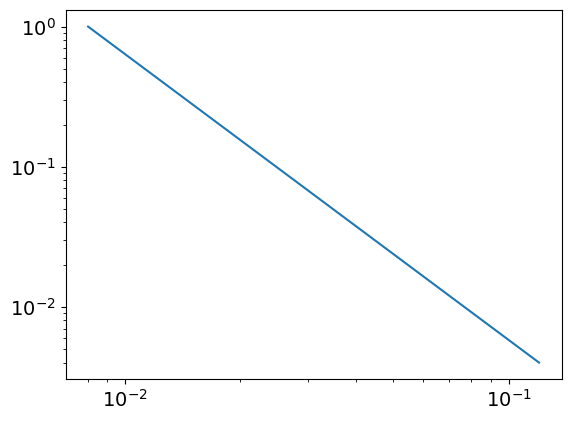

3.0405236549212344
0.008023933068400312
powerlaw KstestResult(statistic=0.9989154488087366, pvalue=0.0, statistic_location=0.10498972798595708, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12004661021878377, statistic_sign=-1)
tensor(-2.6940e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2579, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.4370, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
195
tensor(0.1748, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


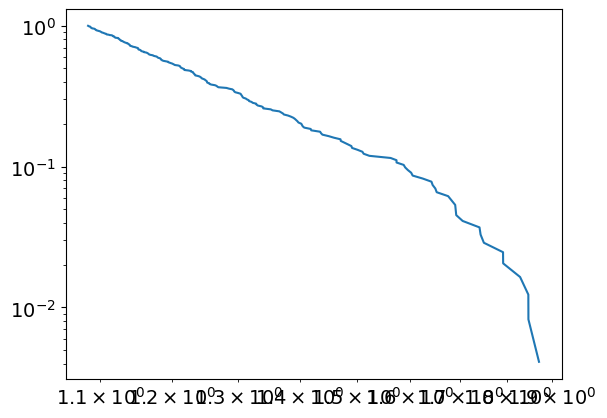

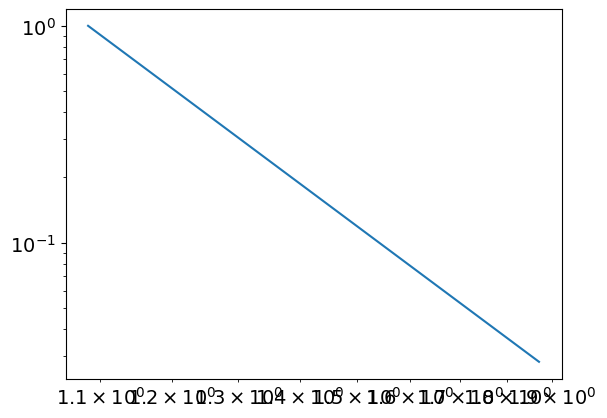

7.536683821304727
1.083765553553704
powerlaw KstestResult(statistic=0.9947613367246301, pvalue=0.0, statistic_location=1.4914759804310544, statistic_sign=1)
lognorm KstestResult(statistic=0.9884059234494113, pvalue=0.0, statistic_location=1.2338594390350126, statistic_sign=1)
tensor(0.0729, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2374, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8799, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
196
tensor(4.1335e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


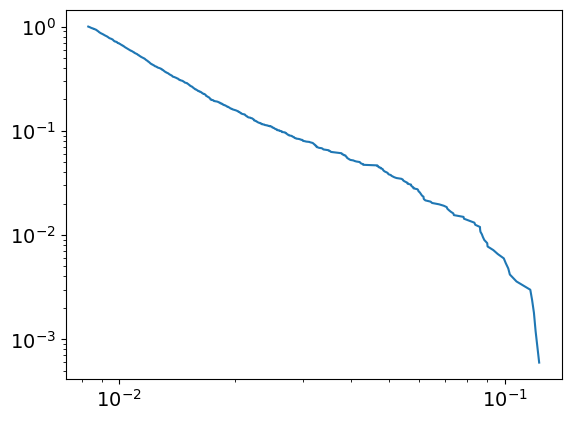

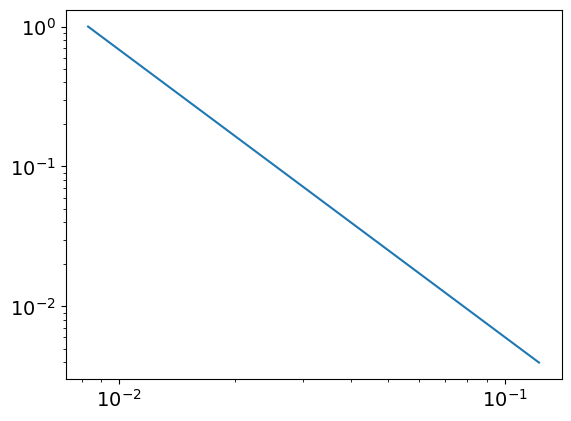

3.0533415007042586
0.008314822004936547
powerlaw KstestResult(statistic=0.9990260028571155, pvalue=0.0, statistic_location=0.09596347971914308, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1228689256914144, statistic_sign=-1)
tensor(-1.0111e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2999, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.5870, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
196
tensor(0.1750, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


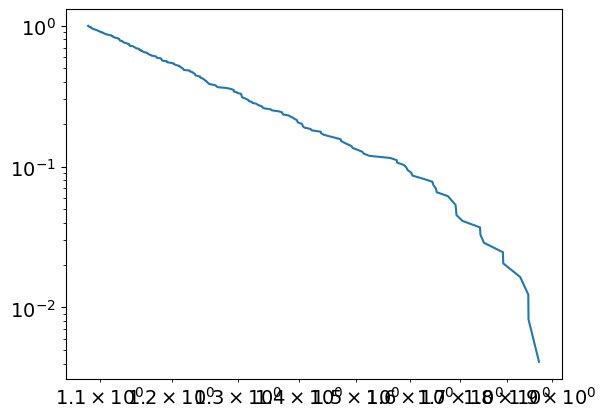

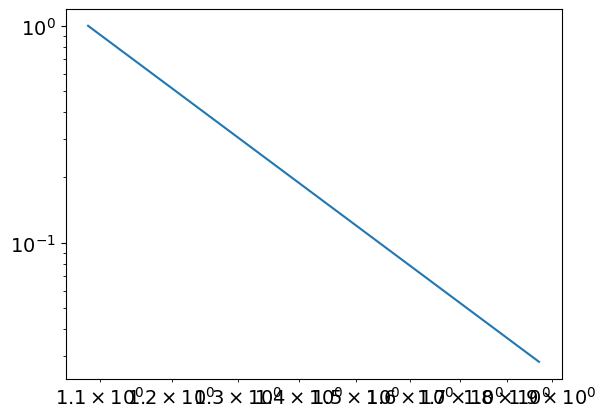

7.547841808683472
1.084757544141328
powerlaw KstestResult(statistic=0.9947525814406525, pvalue=0.0, statistic_location=1.49341704038656, statistic_sign=1)
lognorm KstestResult(statistic=0.9883846526777748, pvalue=0.0, statistic_location=1.2351062138185618, statistic_sign=1)
tensor(0.0728, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2385, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8850, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
197
tensor(3.8903e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


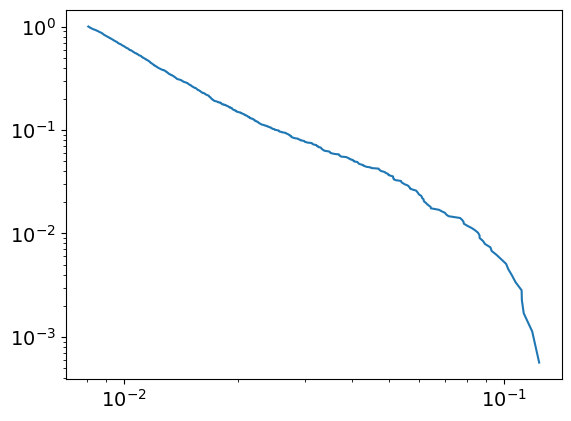

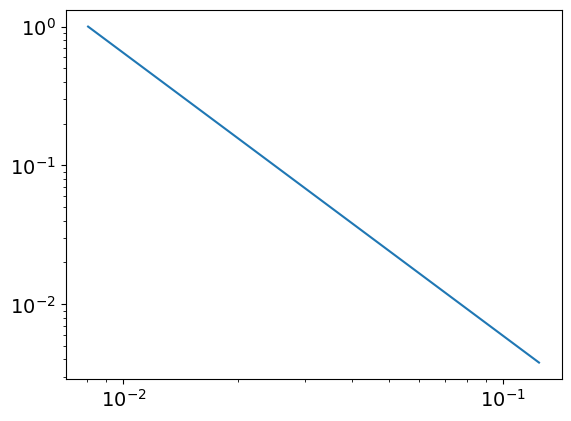

3.0397529172783724
0.00807615632110422
powerlaw KstestResult(statistic=0.9990038165186785, pvalue=0.0, statistic_location=0.09583305184007698, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12408062196611025, statistic_sign=-1)
tensor(-2.3674e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4171, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.4023, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
197
tensor(0.1753, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


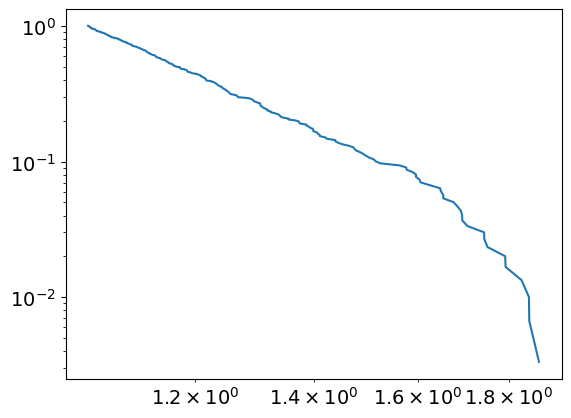

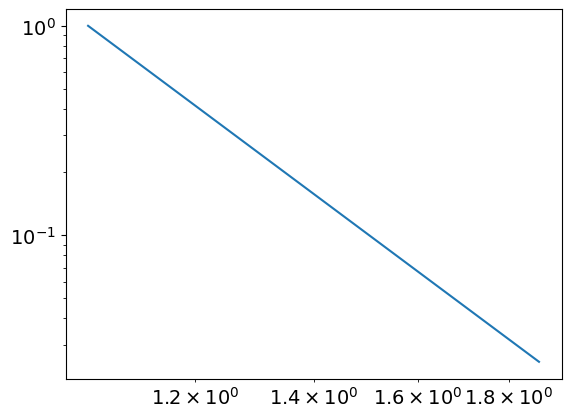

7.344910101119035
1.0452158098276445
powerlaw KstestResult(statistic=0.9937326940354797, pvalue=0.0, statistic_location=1.4228405028115352, statistic_sign=1)
lognorm KstestResult(statistic=0.9883183006999144, pvalue=0.0, statistic_location=1.2379667281500506, statistic_sign=1)
tensor(0.0726, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2396, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8901, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
198
tensor(4.1538e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


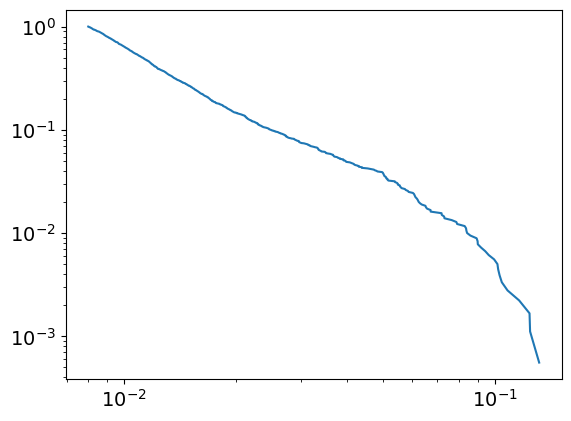

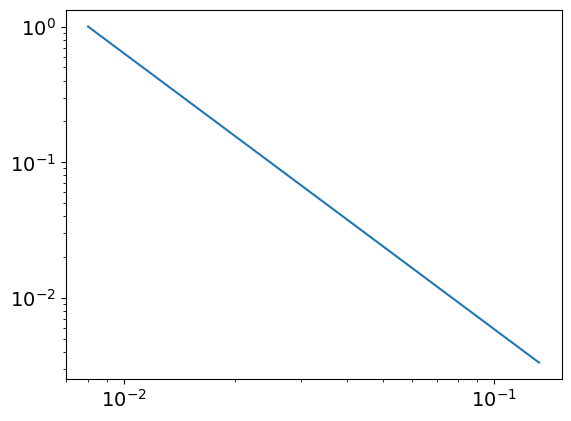

3.03493737707372
0.008009779913039096
powerlaw KstestResult(statistic=0.9989818233788038, pvalue=0.0, statistic_location=0.09644889313318496, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1247129845682385, statistic_sign=-1)
tensor(-3.6953e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4274, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.9719, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
198
tensor(0.1756, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


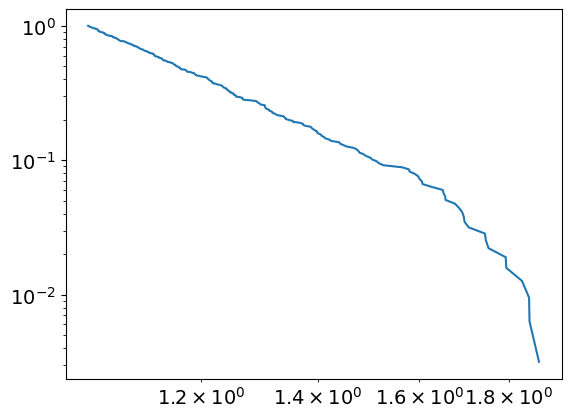

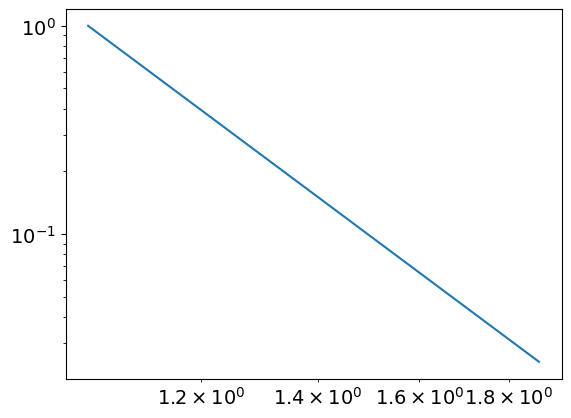

7.263379343911608
1.0346366417699162
powerlaw KstestResult(statistic=0.9934478123096826, pvalue=0.0, statistic_location=1.4244658468153035, statistic_sign=1)
lognorm KstestResult(statistic=0.9883015492383163, pvalue=0.0, statistic_location=1.242751384536635, statistic_sign=1)
tensor(0.0725, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2407, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8952, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


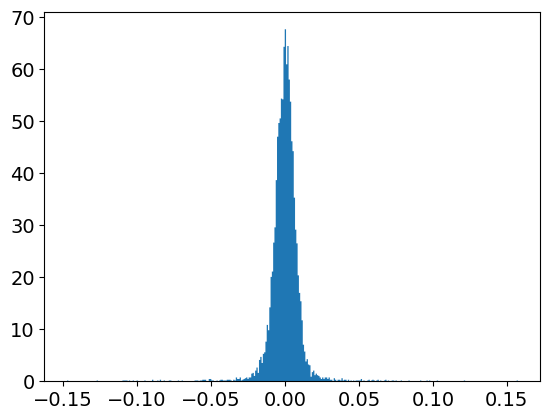

powerlaw
Calculating best minimal value for power law fit
6.0968908800677335
powerlaw KstestResult(statistic=0.999999980380747, pvalue=0.0, statistic_location=0.1574723918239505, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1474211007043199, statistic_sign=-1)



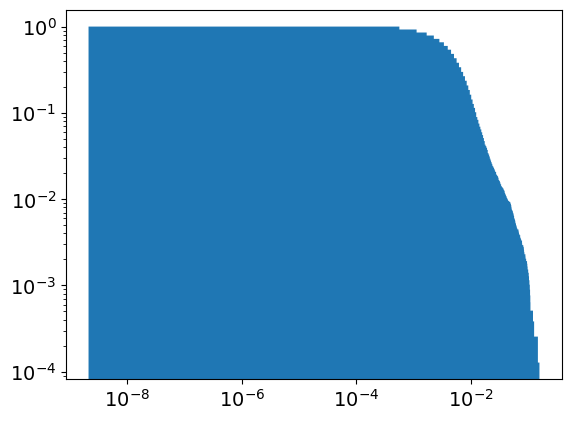

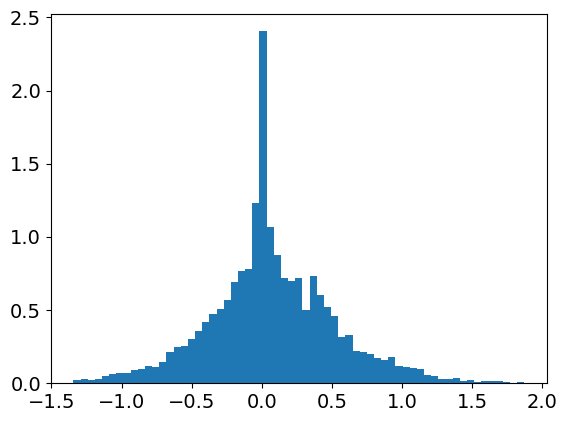

powerlaw
Calculating best minimal value for power law fit
6.396101697697172%
powerlaw KstestResult(statistic=0.9920093317325821, pvalue=0.0, statistic_location=1.4073921371487796, statistic_sign=1)
lognorm KstestResult(statistic=0.9882686117283203, pvalue=0.0, statistic_location=1.24398549607656, statistic_sign=1)



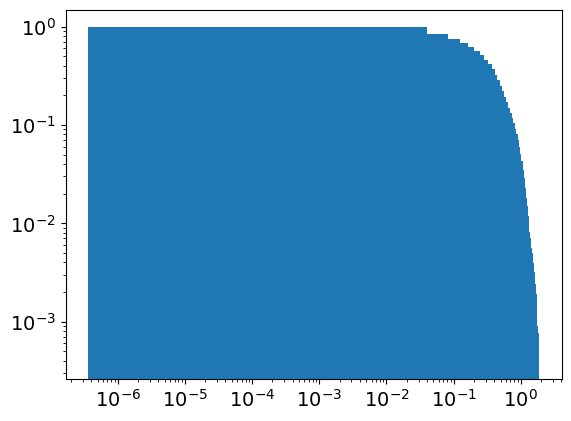

separation
epoch:
199
tensor(5.3147e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


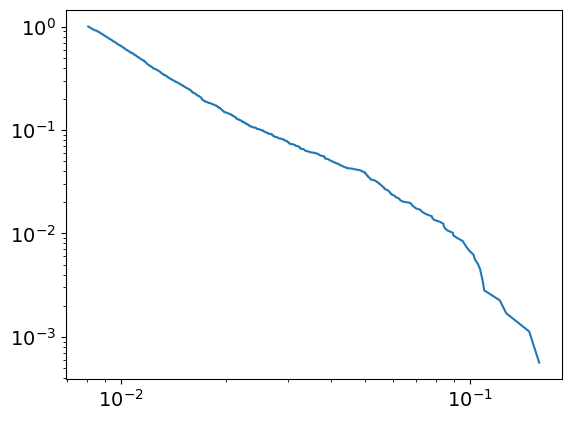

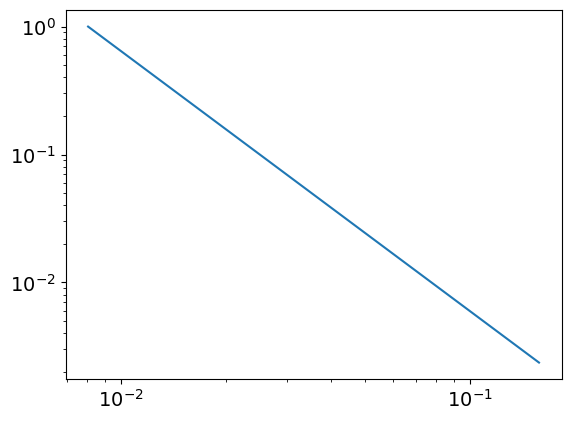

3.0347686834073144
0.008067192725490705
powerlaw KstestResult(statistic=0.998955594389632, pvalue=0.0, statistic_location=0.10303955091590682, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1474211007043199, statistic_sign=-1)
tensor(-6.6122e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.0973, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
199
tensor(0.1758, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


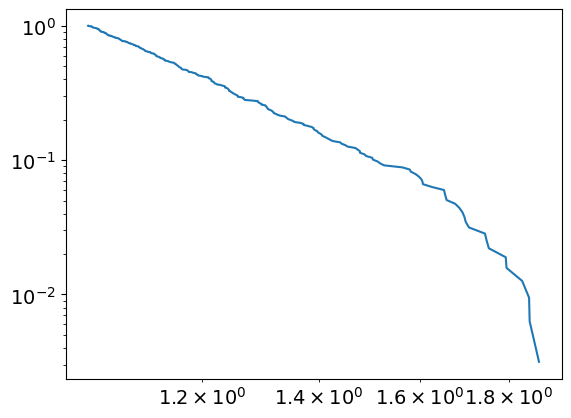

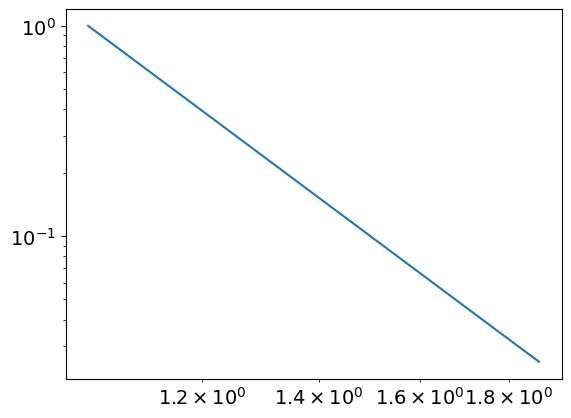

7.182208208112428
1.032632579638144
powerlaw KstestResult(statistic=0.9932838134129452, pvalue=0.0, statistic_location=1.4260850326415537, statistic_sign=1)
lognorm KstestResult(statistic=0.9882686117283203, pvalue=0.0, statistic_location=1.24398549607656, statistic_sign=1)
tensor(0.0724, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2419, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9004, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
200
tensor(5.5827e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


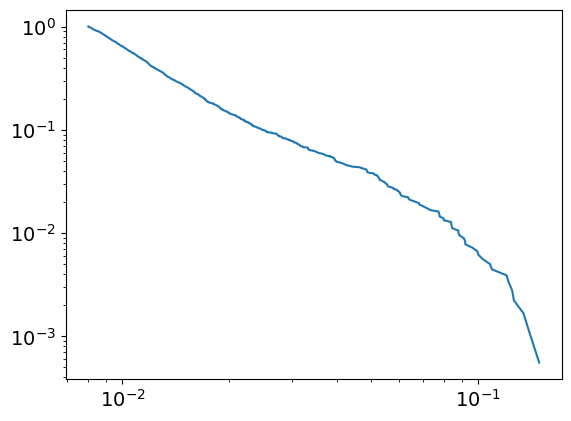

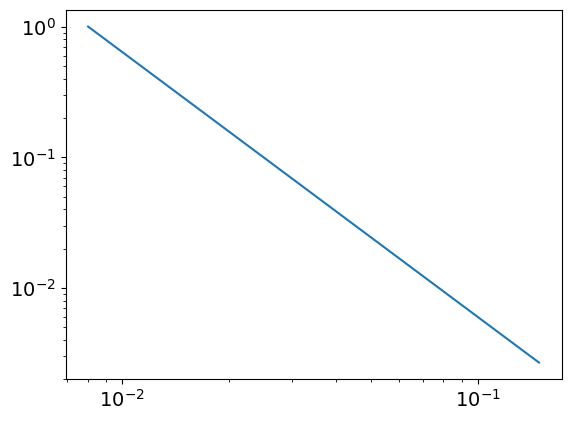

3.027002611670126
0.00801210630312371
powerlaw KstestResult(statistic=0.9989716073735223, pvalue=0.0, statistic_location=0.09635490952648278, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1392733785601601, statistic_sign=-1)
tensor(-6.6996e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.9113, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.4914, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
200
tensor(0.1761, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


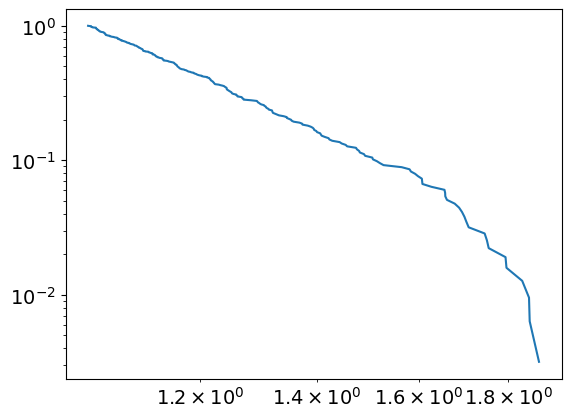

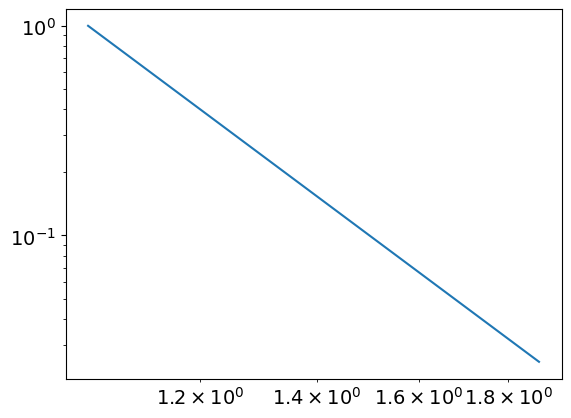

7.220030322080908
1.0354415586392722
powerlaw KstestResult(statistic=0.9933523049962207, pvalue=0.0, statistic_location=1.427700058179347, statistic_sign=1)
lognorm KstestResult(statistic=0.9882194610149329, pvalue=0.0, statistic_location=1.2508905976372517, statistic_sign=1)
tensor(0.0723, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2431, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9057, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
201
tensor(5.4116e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


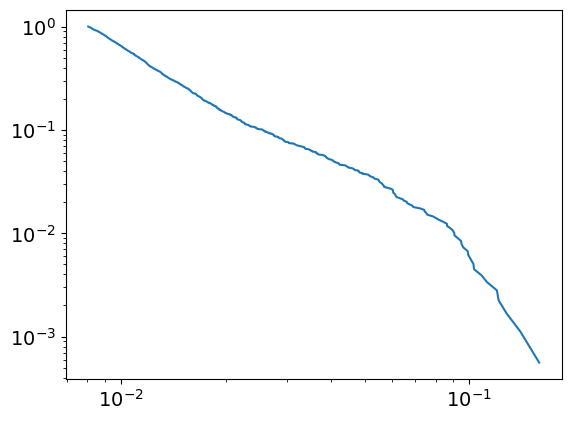

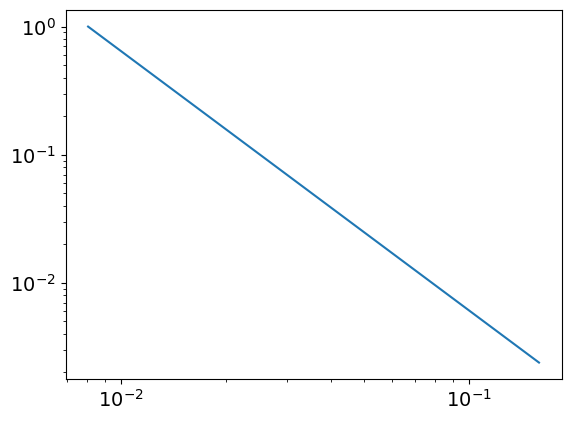

3.0249830094406143
0.008050165547183123
powerlaw KstestResult(statistic=0.9989753969017242, pvalue=0.0, statistic_location=0.0960785187747382, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14003733023889897, statistic_sign=-1)
tensor(-5.5168e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6382, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.6822, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
201
tensor(0.1764, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


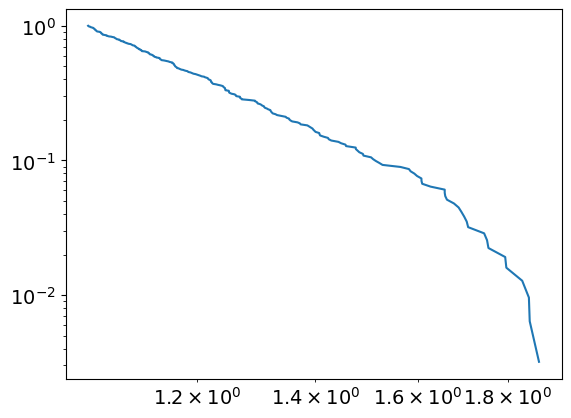

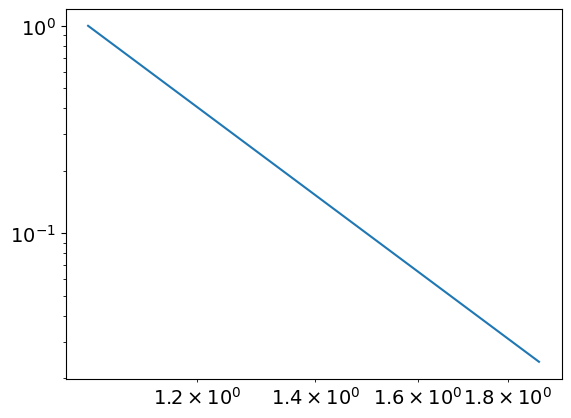

7.3333053639822845
1.040179888684575
powerlaw KstestResult(statistic=0.9935289530957413, pvalue=0.0, statistic_location=1.4293090350843591, statistic_sign=1)
lognorm KstestResult(statistic=0.9881541686883974, pvalue=0.0, statistic_location=1.252389734927152, statistic_sign=1)
tensor(0.0721, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2444, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9111, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
202
tensor(4.9681e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


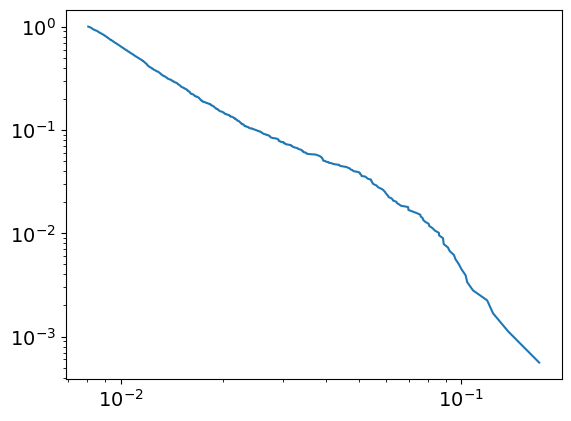

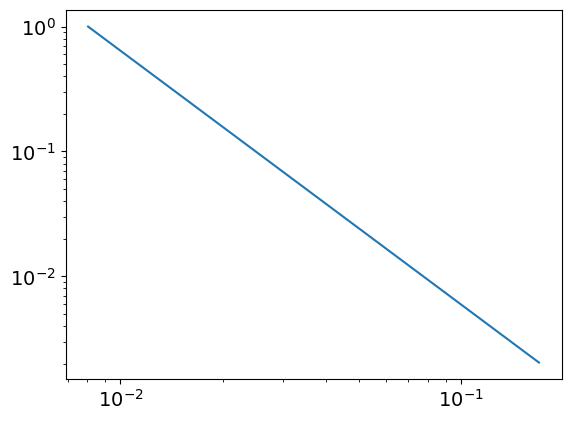

3.034021831640248
0.008041773039714943
powerlaw KstestResult(statistic=0.9989887024373457, pvalue=0.0, statistic_location=0.0960997440807799, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13721086263232082, statistic_sign=-1)
tensor(-2.6848e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2354, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.8635, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
202
tensor(0.1766, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


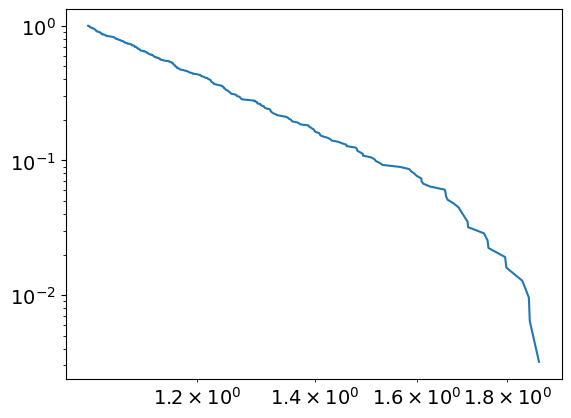

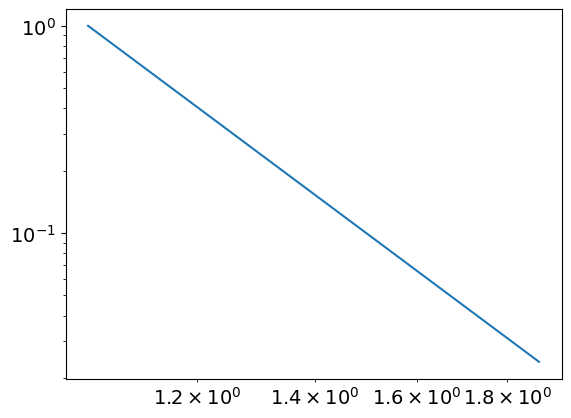

7.338427377181024
1.0409493756716732
powerlaw KstestResult(statistic=0.9935190612190108, pvalue=0.0, statistic_location=1.4308648017492365, statistic_sign=1)
lognorm KstestResult(statistic=0.9880931330186297, pvalue=0.0, statistic_location=1.2428991553871755, statistic_sign=1)
tensor(0.0720, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2457, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9166, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
203
tensor(4.6534e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


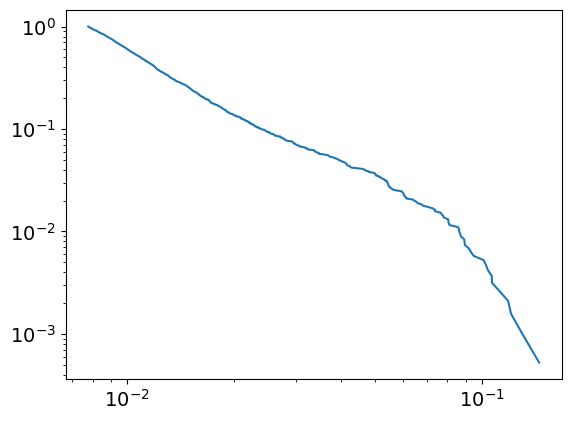

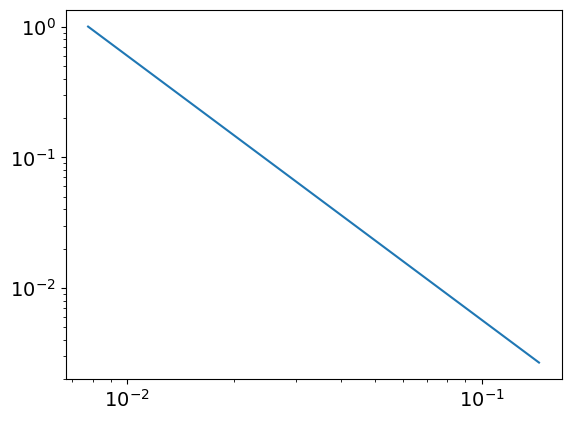

3.0229957049479923
0.007769597854638219
powerlaw KstestResult(statistic=0.9989931483574052, pvalue=0.0, statistic_location=0.09484593924318928, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12906786275468504, statistic_sign=-1)
tensor(-4.0196e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4888, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.9551, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
203
tensor(0.1769, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


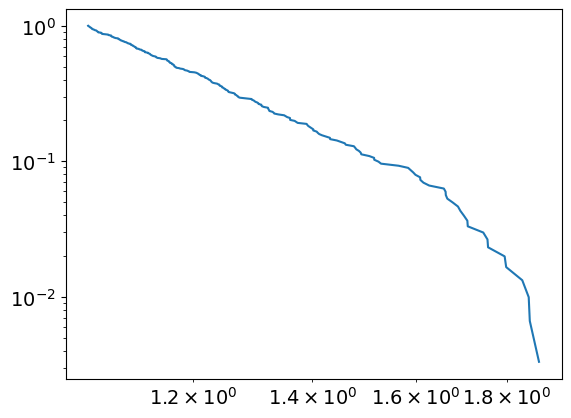

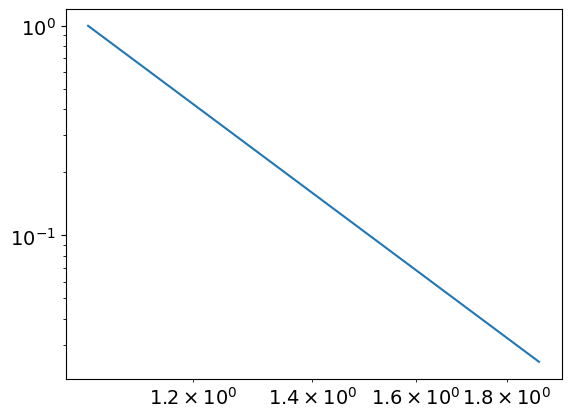

7.332277611458374
1.0475160994025512
powerlaw KstestResult(statistic=0.9936022539169538, pvalue=0.0, statistic_location=1.432517625438957, statistic_sign=1)
lognorm KstestResult(statistic=0.9880387621808511, pvalue=0.0, statistic_location=1.244791103388095, statistic_sign=1)
tensor(0.0719, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2470, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9221, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
204
tensor(5.6760e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


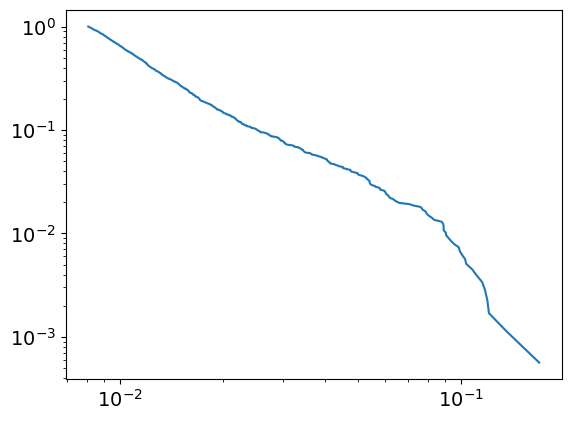

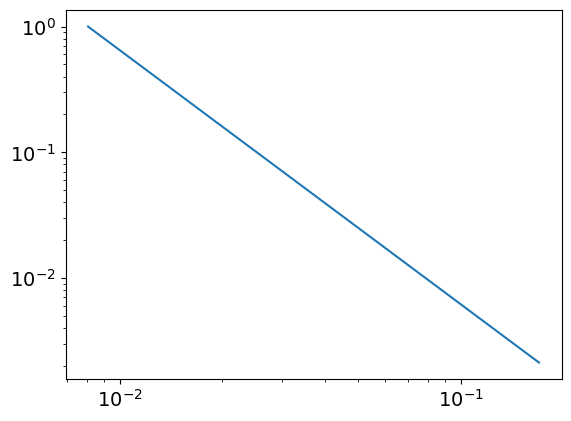

3.0226137596507763
0.008077011227682613
powerlaw KstestResult(statistic=0.9987914870330225, pvalue=0.0, statistic_location=0.10357426319692016, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1360784861630076, statistic_sign=-1)
tensor(-4.5201e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2062, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.9767, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
204
tensor(0.1772, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


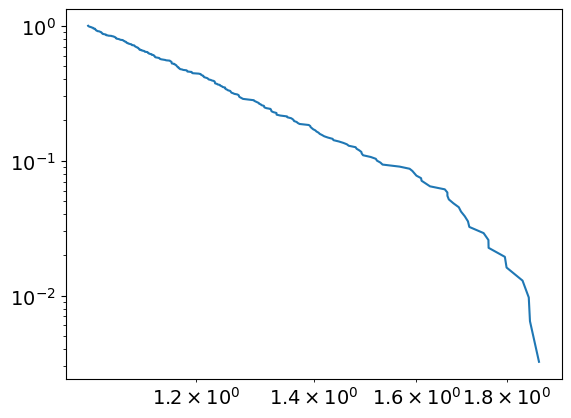

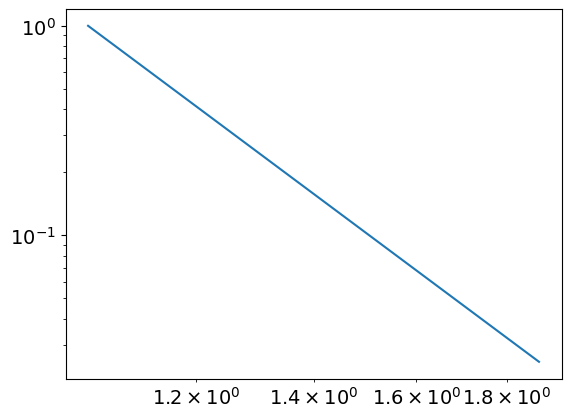

7.275360486029213
1.0423874994886708
powerlaw KstestResult(statistic=0.9933871664568906, pvalue=0.0, statistic_location=1.435798579447635, statistic_sign=1)
lognorm KstestResult(statistic=0.9880020474148465, pvalue=0.0, statistic_location=1.2425615779272288, statistic_sign=1)
tensor(0.0717, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2096, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2483, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9277, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
205
tensor(5.6112e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


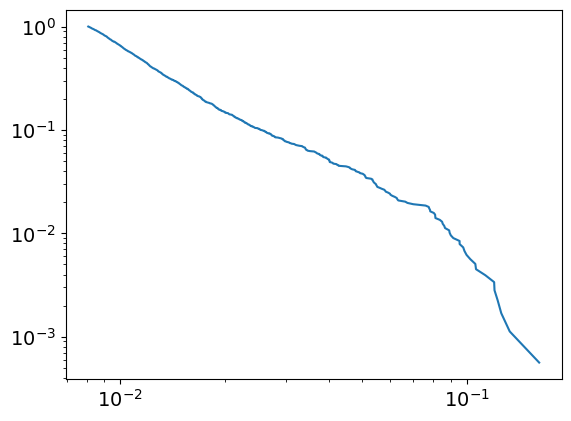

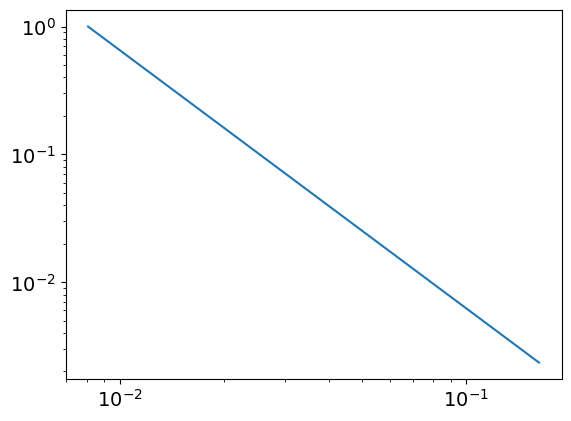

3.0194820017540738
0.00808253108523841
powerlaw KstestResult(statistic=0.9988529507379423, pvalue=0.0, statistic_location=0.09549059898430066, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.16203653445038202, statistic_sign=-1)
tensor(-4.4591e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.6064, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.2350, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
205
tensor(0.1775, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


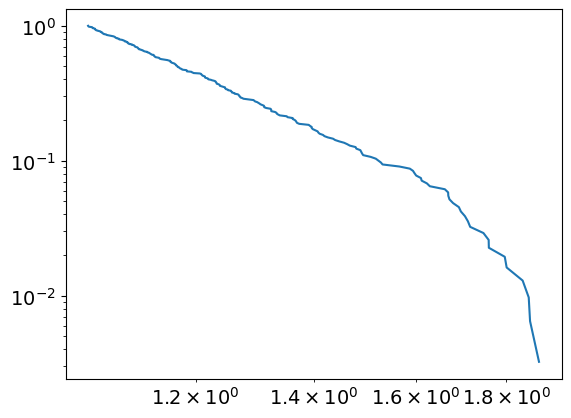

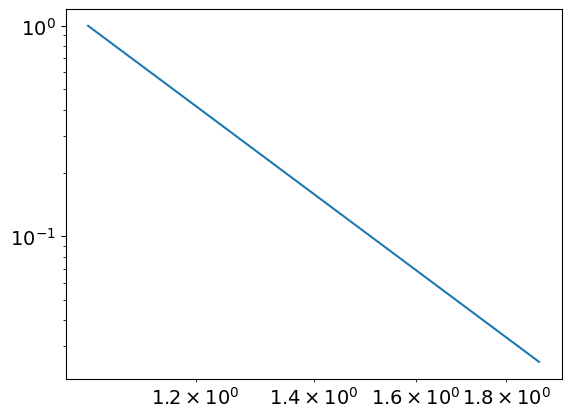

7.251370305535889
1.0430975294941387
powerlaw KstestResult(statistic=0.9933103786188469, pvalue=0.0, statistic_location=1.426100429057087, statistic_sign=1)
lognorm KstestResult(statistic=0.9879764944739835, pvalue=0.0, statistic_location=1.2437199566720287, statistic_sign=1)
tensor(0.0716, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2496, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9333, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
206
tensor(4.5242e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


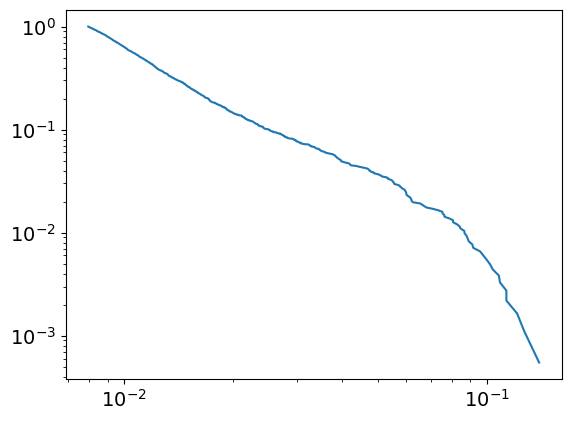

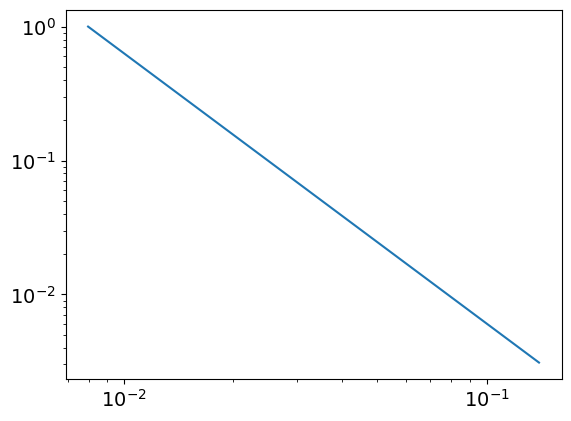

3.0171257228709742
0.007958602990881428
powerlaw KstestResult(statistic=0.9989656970828278, pvalue=0.0, statistic_location=0.09586750078291598, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12701694727748586, statistic_sign=-1)
tensor(-2.8234e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4645, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.7851, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
206
tensor(0.1778, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


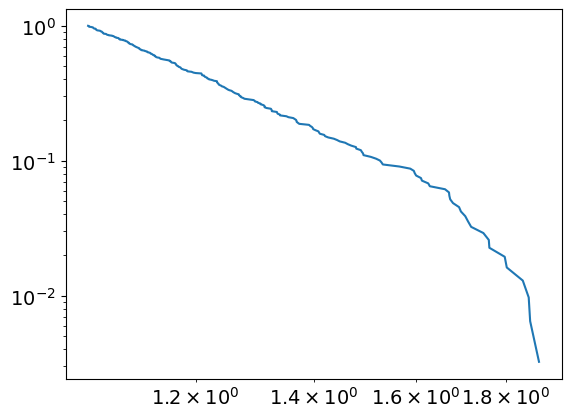

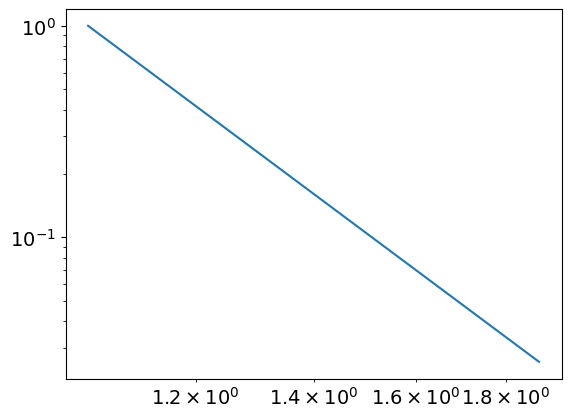

7.2114636319811956
1.042768102278355
powerlaw KstestResult(statistic=0.9932541844041696, pvalue=0.0, statistic_location=1.4267909982786477, statistic_sign=1)
lognorm KstestResult(statistic=0.9879525034585046, pvalue=0.0, statistic_location=1.2447889292329832, statistic_sign=1)
tensor(0.0715, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2510, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9390, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
207
tensor(4.8144e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


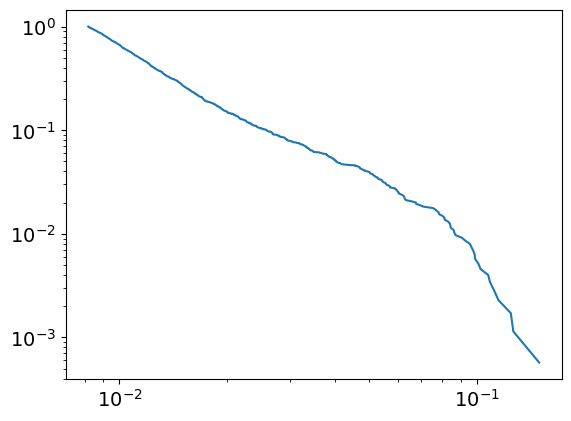

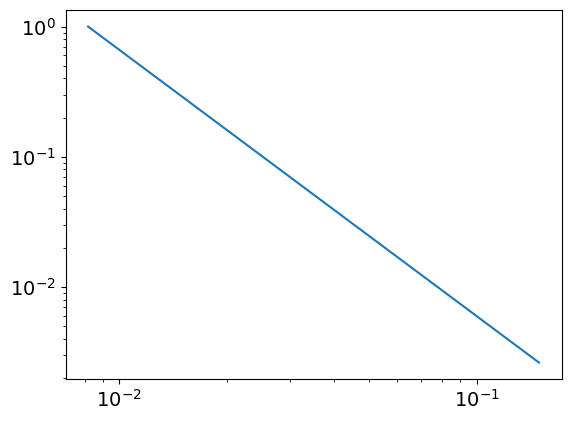

3.045362762642853
0.00818364336337704
powerlaw KstestResult(statistic=0.9989987385036205, pvalue=0.0, statistic_location=0.09657367681076663, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1264493398744843, statistic_sign=-1)
tensor(-4.0283e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.5200, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2890, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
207
tensor(0.1781, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


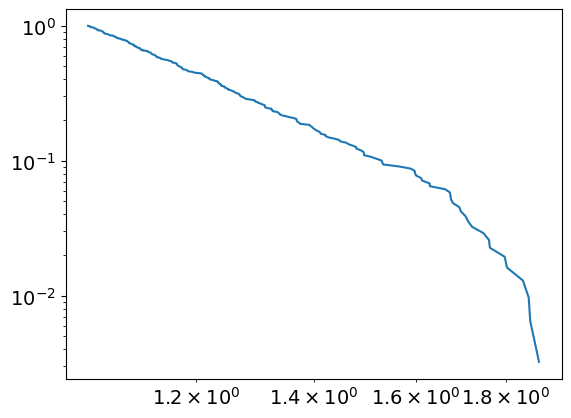

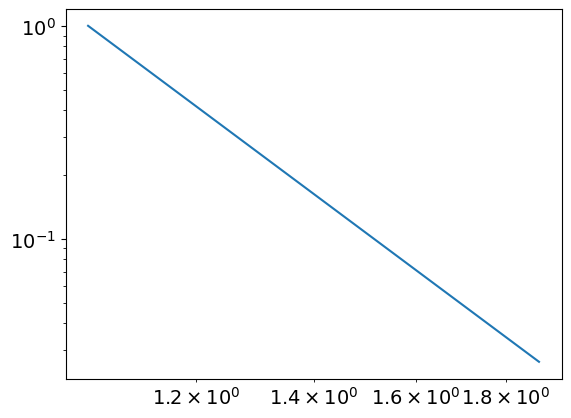

7.163456151521006
1.0421981236804394
powerlaw KstestResult(statistic=0.993181164217962, pvalue=0.0, statistic_location=1.4275164693881943, statistic_sign=1)
lognorm KstestResult(statistic=0.9879269699155463, pvalue=0.0, statistic_location=1.2458746414755248, statistic_sign=1)
tensor(0.0713, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2524, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9448, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
208
tensor(4.3895e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


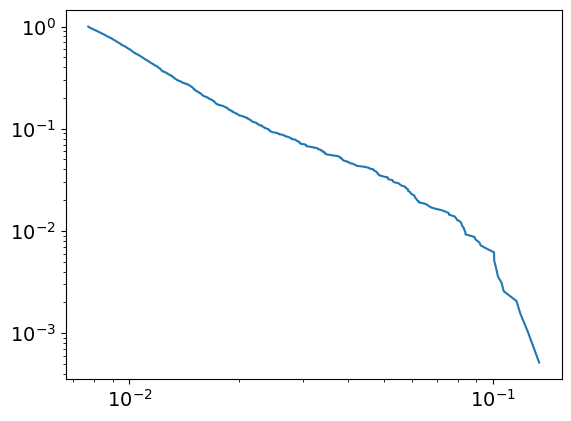

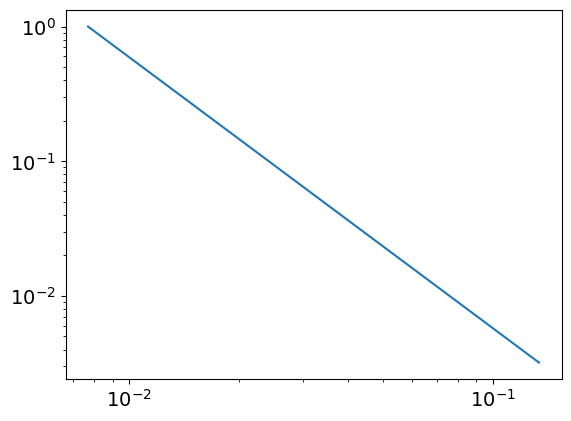

3.012461175116214
0.007706756668405864
powerlaw KstestResult(statistic=0.9989587836916004, pvalue=0.0, statistic_location=0.08953133117610701, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12457582314057745, statistic_sign=-1)
tensor(-3.1180e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4984, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.9865, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
208
tensor(0.1784, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


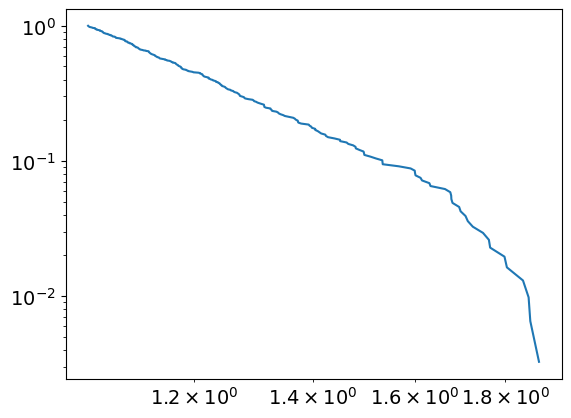

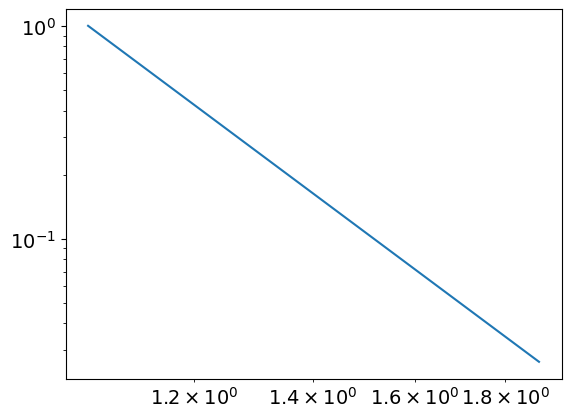

7.18058322820699
1.0445236598839598
powerlaw KstestResult(statistic=0.9932306590369343, pvalue=0.0, statistic_location=1.4282023575188656, statistic_sign=1)
lognorm KstestResult(statistic=0.9878458463461409, pvalue=0.0, statistic_location=1.2536595766732883, statistic_sign=1)
tensor(0.0712, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2539, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9506, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
209
tensor(4.3797e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


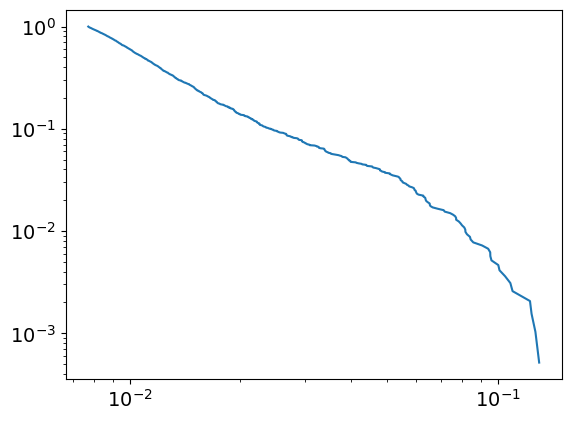

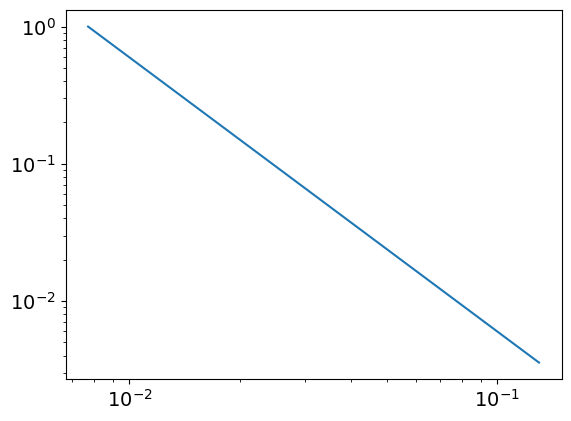

2.998601532799377
0.007724624329498322
powerlaw KstestResult(statistic=0.9989211362539939, pvalue=0.0, statistic_location=0.09625440896803286, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12671277482534382, statistic_sign=-1)
tensor(-8.5357e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3429, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.2614, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
209
tensor(0.1787, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


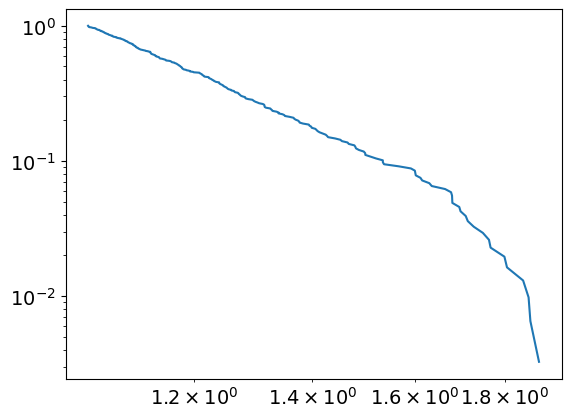

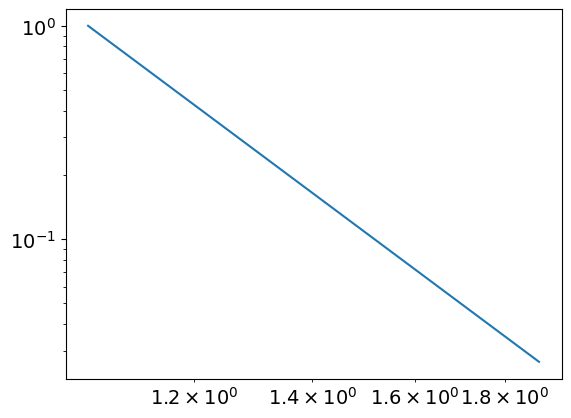

7.162116139129751
1.0448087550427252
powerlaw KstestResult(statistic=0.9932028317069171, pvalue=0.0, statistic_location=1.4289687856689093, statistic_sign=1)
lognorm KstestResult(statistic=0.9877647947220186, pvalue=0.0, statistic_location=1.2554423592160677, statistic_sign=1)
tensor(0.0710, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2553, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9564, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
210
tensor(4.9313e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


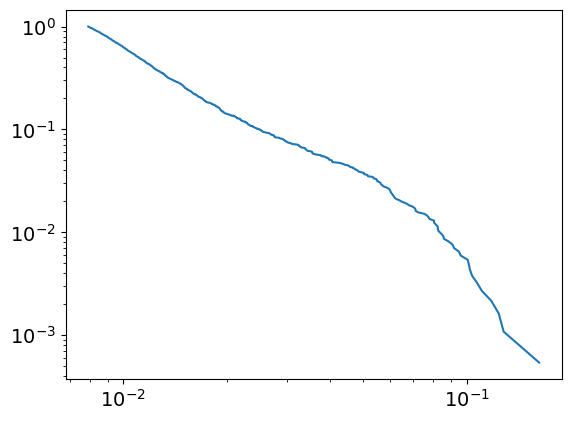

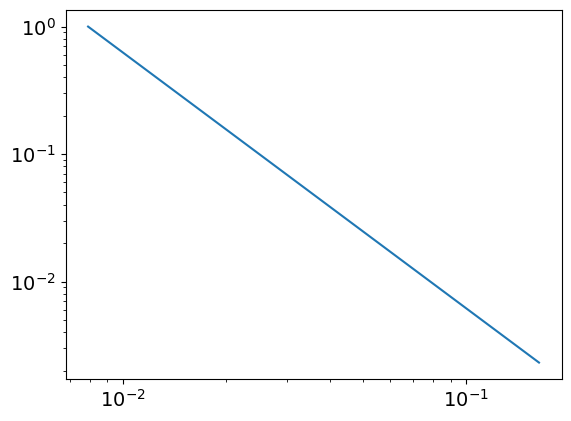

3.006181841318662
0.007909515633151837
powerlaw KstestResult(statistic=0.9989404285445793, pvalue=0.0, statistic_location=0.09615340509249548, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1282277453369465, statistic_sign=-1)
tensor(-2.0350e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1821, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.7764, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
210
tensor(0.1790, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


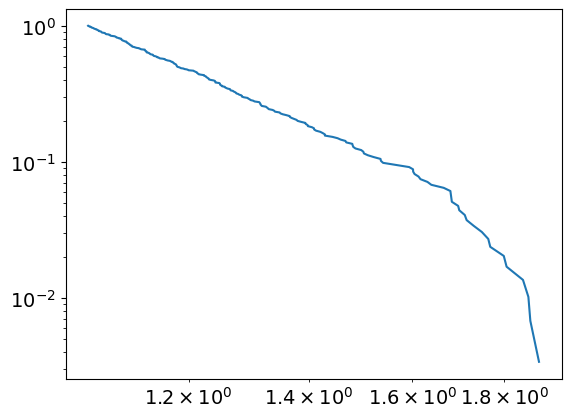

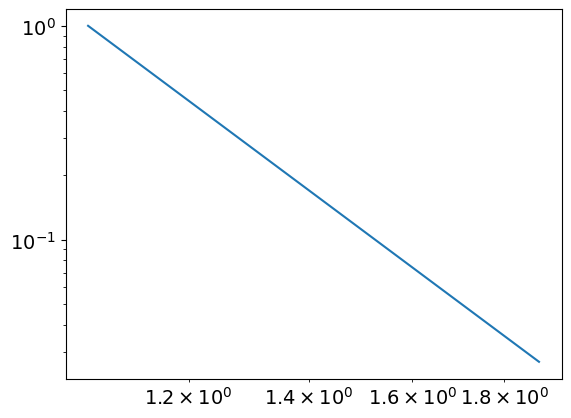

7.243651242252057
1.054667478041984
powerlaw KstestResult(statistic=0.9934386989397197, pvalue=0.0, statistic_location=1.4296888426528538, statistic_sign=1)
lognorm KstestResult(statistic=0.987690208892371, pvalue=0.0, statistic_location=1.2497568105890806, statistic_sign=1)
tensor(0.0709, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2569, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9626, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
211
tensor(4.9450e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


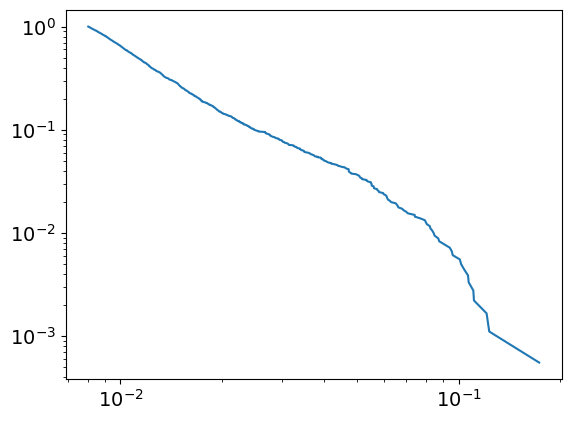

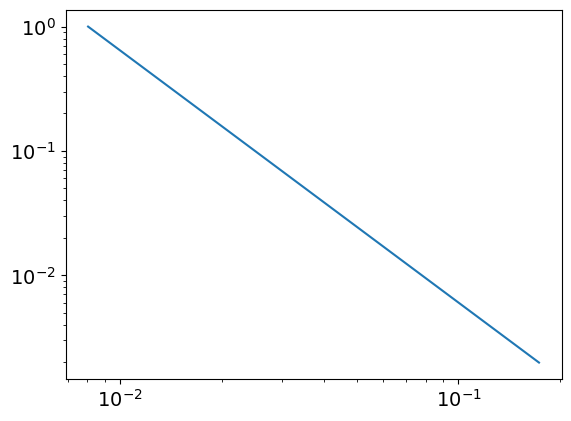

3.027254199911594
0.008034770123945809
powerlaw KstestResult(statistic=0.9989786025634673, pvalue=0.0, statistic_location=0.0960780439958925, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1209972775733229, statistic_sign=-1)
tensor(-1.8399e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1134, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.1467, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
211
tensor(0.1793, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


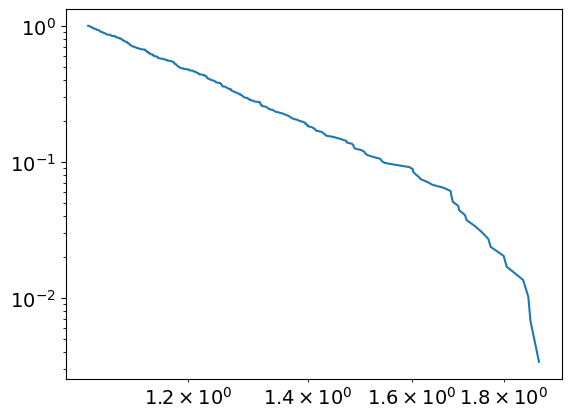

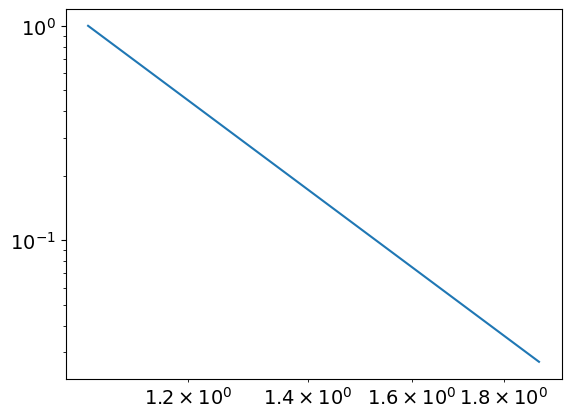

7.227802757894753
1.0550602711658998
powerlaw KstestResult(statistic=0.9933929828060392, pvalue=0.0, statistic_location=1.4320904277719033, statistic_sign=1)
lognorm KstestResult(statistic=0.9876731303382293, pvalue=0.0, statistic_location=1.2532078253323298, statistic_sign=1)
tensor(0.0708, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2584, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9686, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
212
tensor(5.0283e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


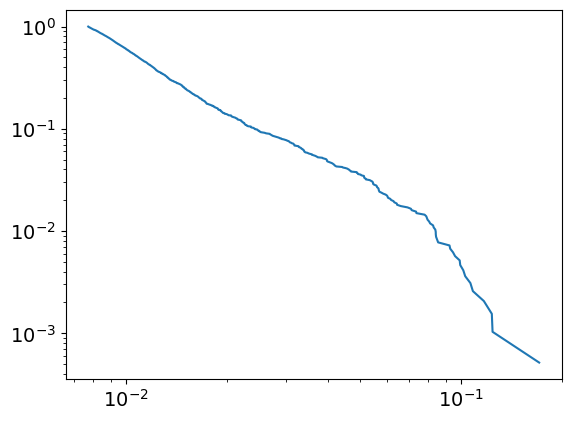

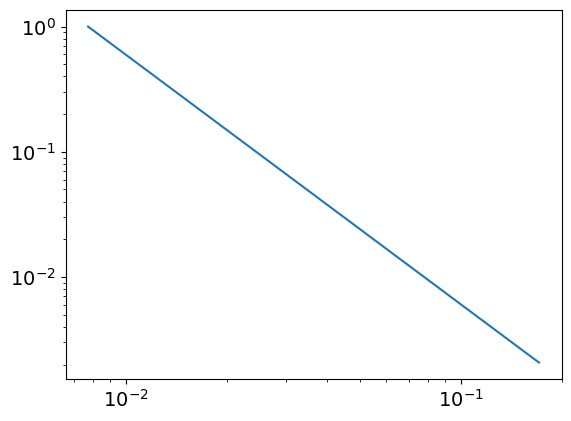

2.9934574496527455
0.007722361602118097
powerlaw KstestResult(statistic=0.9989155340453246, pvalue=0.0, statistic_location=0.09612043446442266, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17131717231329074, statistic_sign=1)
tensor(1.0520e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0692, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6161, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
212
tensor(0.1796, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


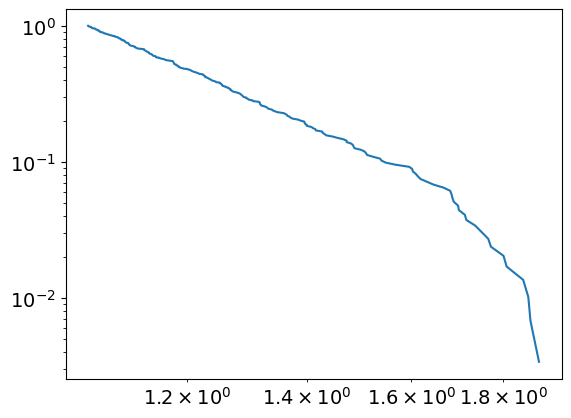

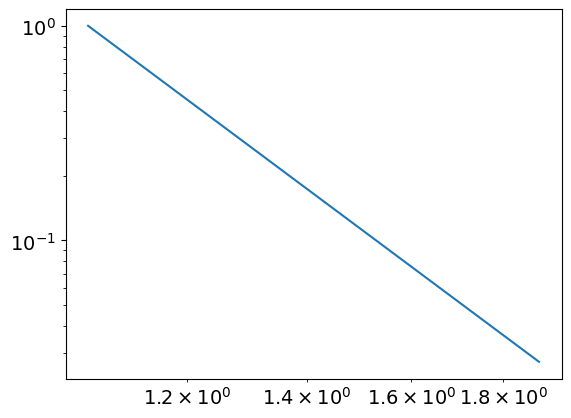

7.237819146451505
1.0572873303426535
powerlaw KstestResult(statistic=0.9933958985836111, pvalue=0.0, statistic_location=1.4346511470452263, statistic_sign=1)
lognorm KstestResult(statistic=0.9875158053634407, pvalue=0.0, statistic_location=1.2564158519791422, statistic_sign=1)
tensor(0.0706, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2599, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9748, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
213
tensor(5.8787e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


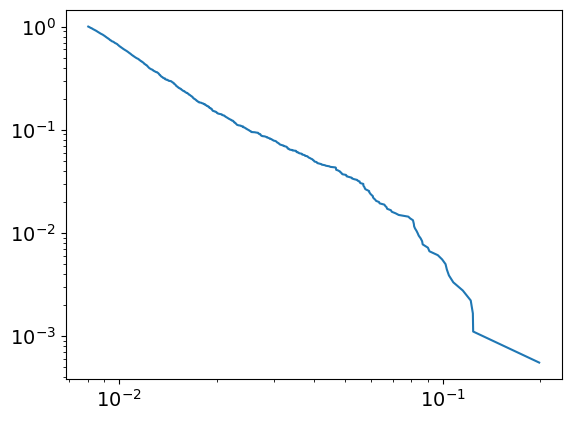

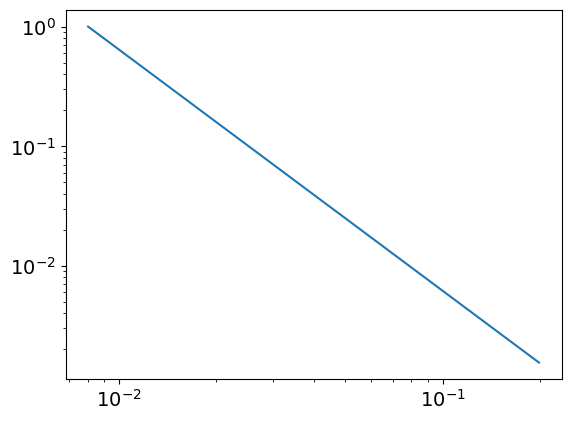

3.0164085033932255
0.00802446675764353
powerlaw KstestResult(statistic=0.9989626160018108, pvalue=0.0, statistic_location=0.08992062423569418, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.198426615594696, statistic_sign=1)
tensor(1.1226e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3012, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.0415, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
213
tensor(0.1799, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


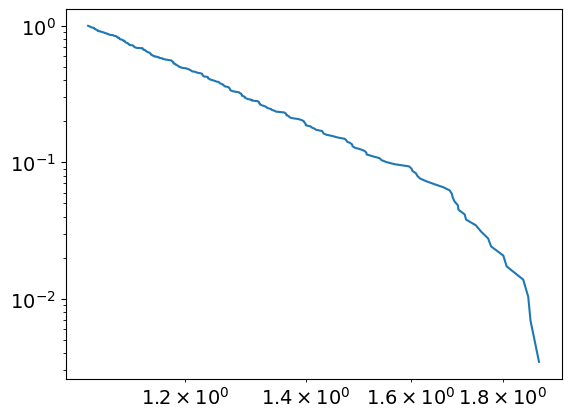

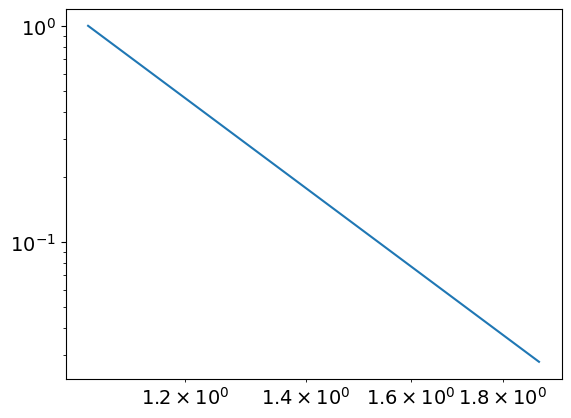

7.222352789998484
1.060013189897453
powerlaw KstestResult(statistic=0.9933852530204906, pvalue=0.0, statistic_location=1.4372291171475897, statistic_sign=1)
lognorm KstestResult(statistic=0.9873415604751001, pvalue=0.0, statistic_location=1.2466862797536704, statistic_sign=1)
tensor(0.0705, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2615, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9810, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
214
tensor(5.5072e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


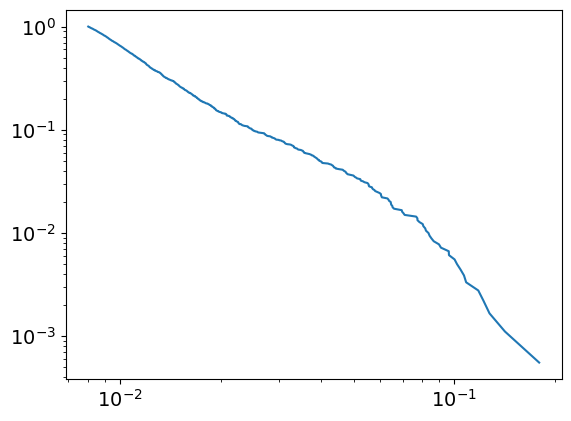

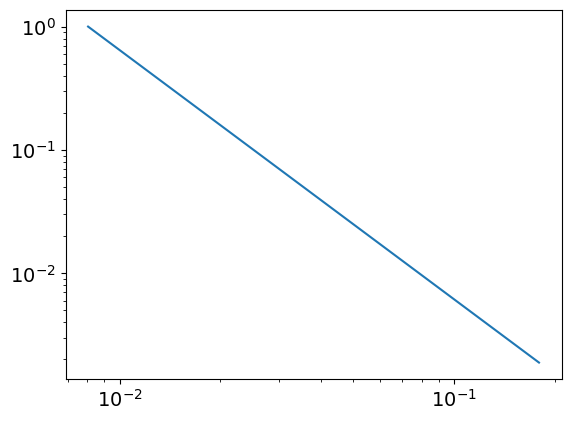

3.0202337952025493
0.008040247862214257
powerlaw KstestResult(statistic=0.9989223078688648, pvalue=0.0, statistic_location=0.08541975233589824, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14173117613137678, statistic_sign=-1)
tensor(-3.9911e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0483, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.6008, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
214
tensor(0.1802, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


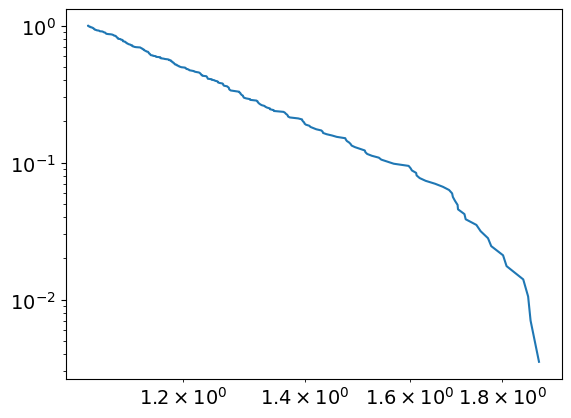

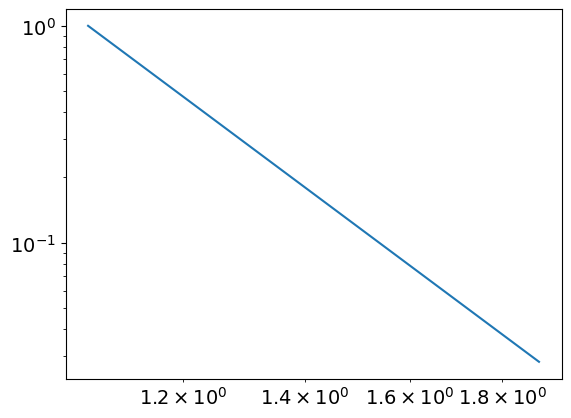

7.229820530473337
1.063457842915735
powerlaw KstestResult(statistic=0.9934049347060587, pvalue=0.0, statistic_location=1.439867439112774, statistic_sign=1)
lognorm KstestResult(statistic=0.9872982907940536, pvalue=0.0, statistic_location=1.244377445514145, statistic_sign=1)
tensor(0.0704, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2630, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9873, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
215
tensor(5.1186e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


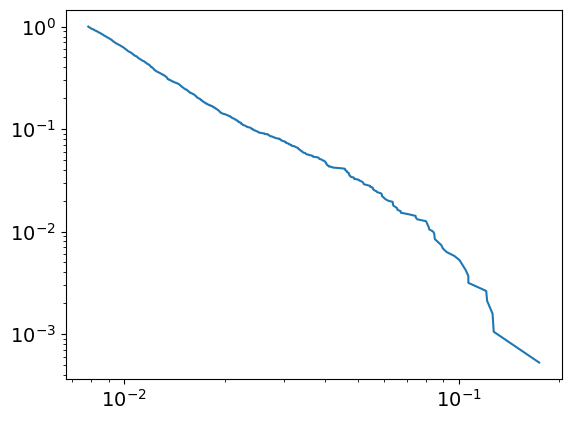

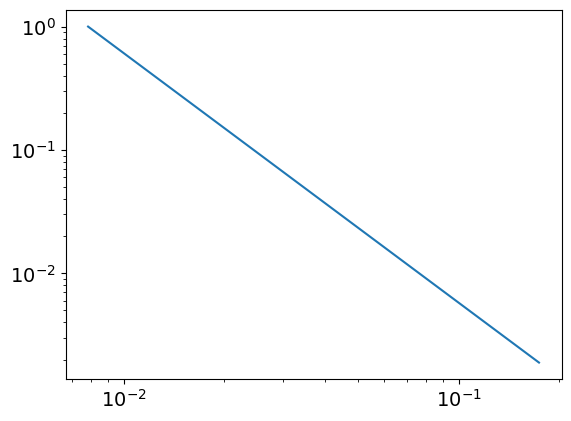

3.022278928848107
0.007829533916793563
powerlaw KstestResult(statistic=0.9990254304310118, pvalue=0.0, statistic_location=0.08674160932808263, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17392887310433774, statistic_sign=1)
tensor(4.2490e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0885, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.7885, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
215
tensor(0.1805, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


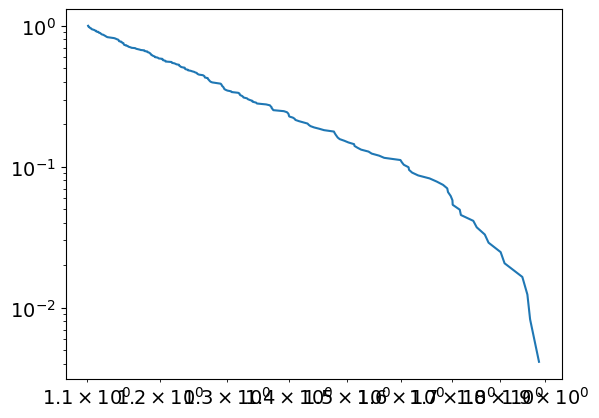

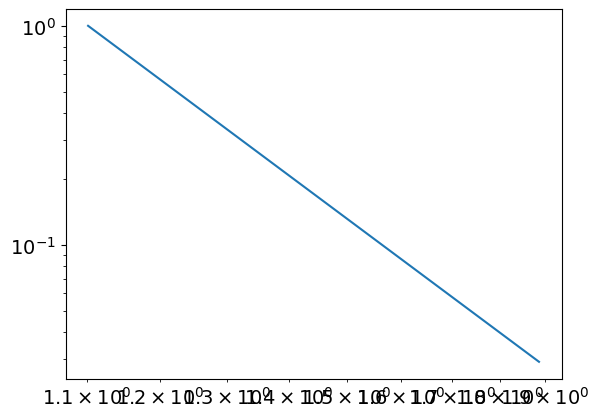

7.567551427374613
1.1014920475954233
powerlaw KstestResult(statistic=0.9945667674730331, pvalue=0.0, statistic_location=1.5137533639922114, statistic_sign=1)
lognorm KstestResult(statistic=0.9872447910793962, pvalue=0.0, statistic_location=1.2555185389142758, statistic_sign=1)
tensor(0.0702, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2646, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9936, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
216
tensor(5.0147e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


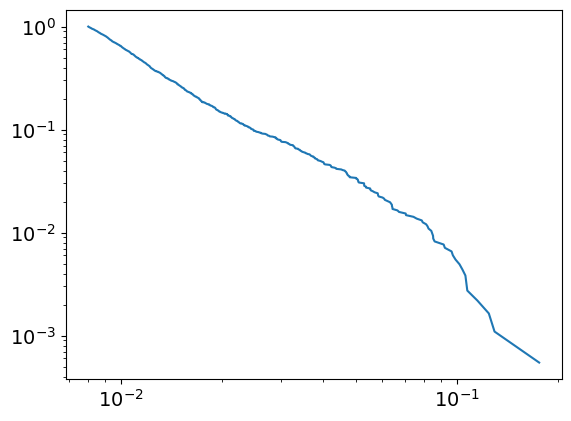

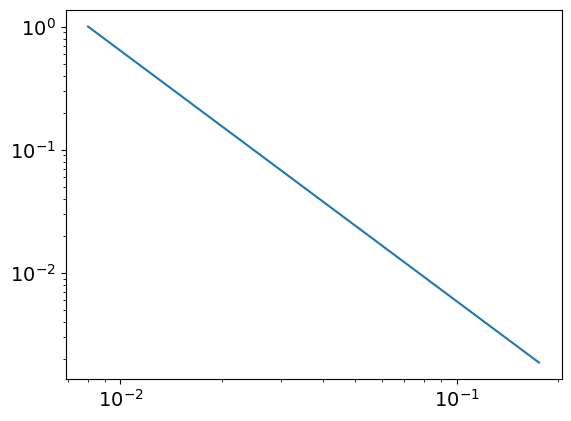

3.0322712041040614
0.00801264387418318
powerlaw KstestResult(statistic=0.9989757393234769, pvalue=0.0, statistic_location=0.09654108261891967, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17594135955638424, statistic_sign=1)
tensor(4.2380e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0873, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.4612, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
216
tensor(0.1808, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


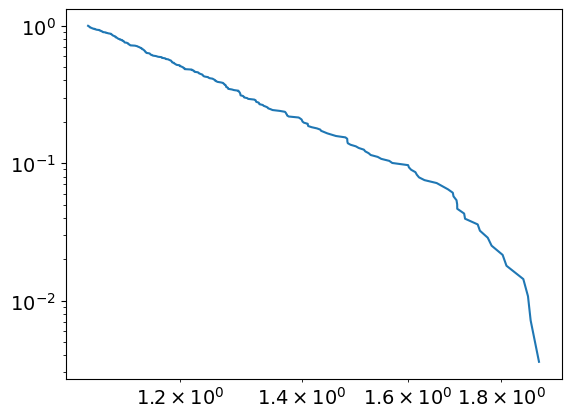

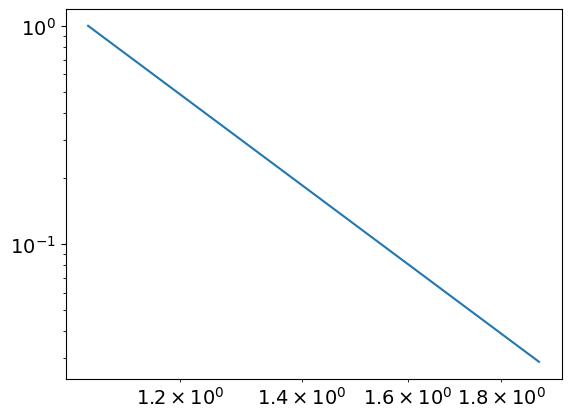

7.230060008933317
1.0688117761318188
powerlaw KstestResult(statistic=0.9934461912580441, pvalue=0.0, statistic_location=1.4829846590936075, statistic_sign=1)
lognorm KstestResult(statistic=0.9871942483363337, pvalue=0.0, statistic_location=1.2567835072751294, statistic_sign=1)
tensor(0.0701, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2663, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0001, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
217
tensor(4.5922e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


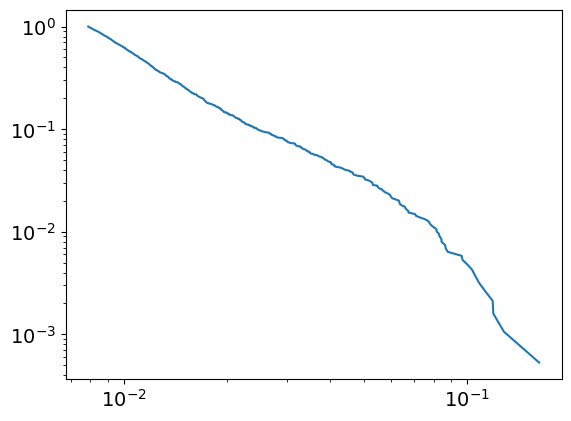

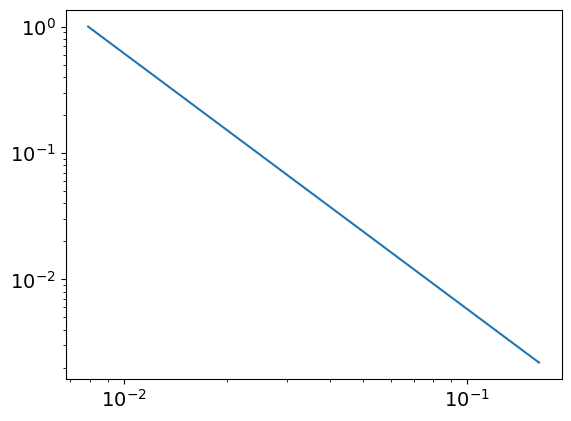

3.022980451689892
0.007881819140928966
powerlaw KstestResult(statistic=0.9990679711788713, pvalue=0.0, statistic_location=0.08437026550692234, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11938584228482488, statistic_sign=-1)
tensor(-1.9478e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0271, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3970, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
217
tensor(0.1811, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


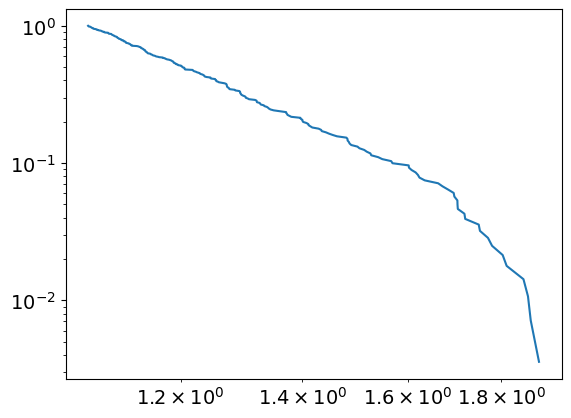

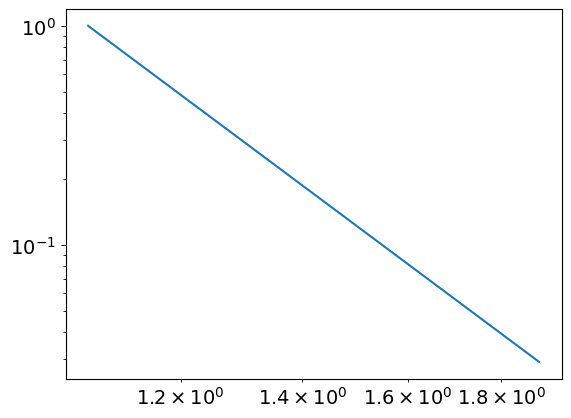

7.1979877509928905
1.0675455767922846
powerlaw KstestResult(statistic=0.9933112164750925, pvalue=0.0, statistic_location=1.4477854969001884, statistic_sign=1)
lognorm KstestResult(statistic=0.9871719215704196, pvalue=0.0, statistic_location=1.2551633916914806, statistic_sign=1)
tensor(0.0700, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0065, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
218
tensor(4.9885e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


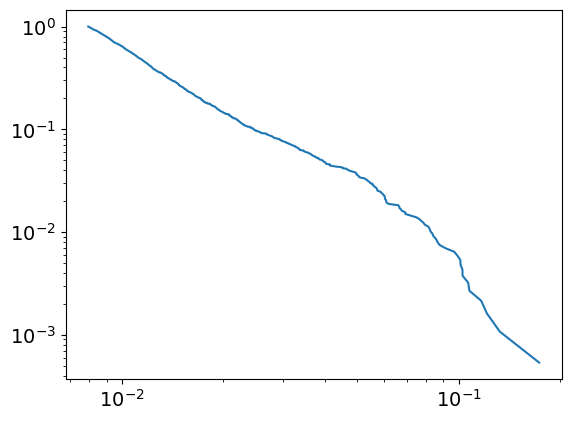

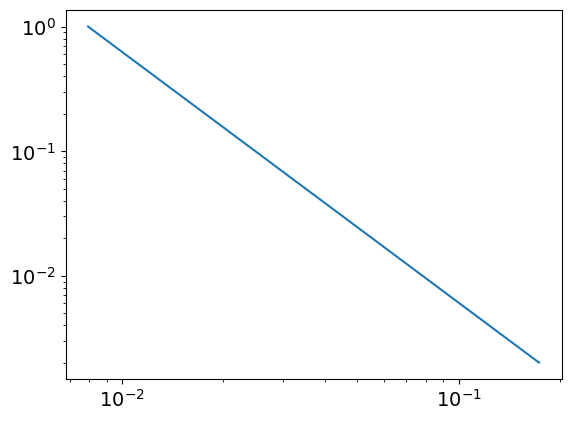

3.012689119736595
0.007932385767223481
powerlaw KstestResult(statistic=0.9989998756651789, pvalue=0.0, statistic_location=0.08761350188280824, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1733194662329582, statistic_sign=1)
tensor(1.0809e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0474, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.2380, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
218
tensor(0.1815, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


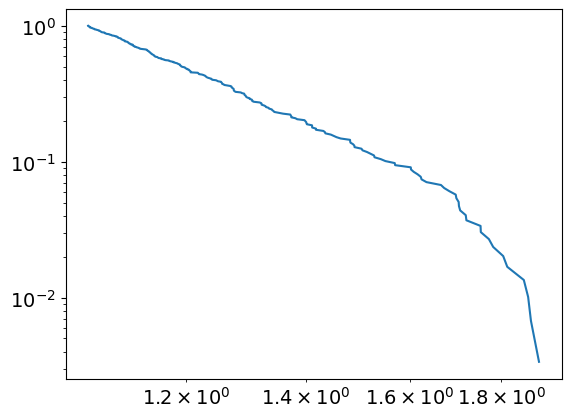

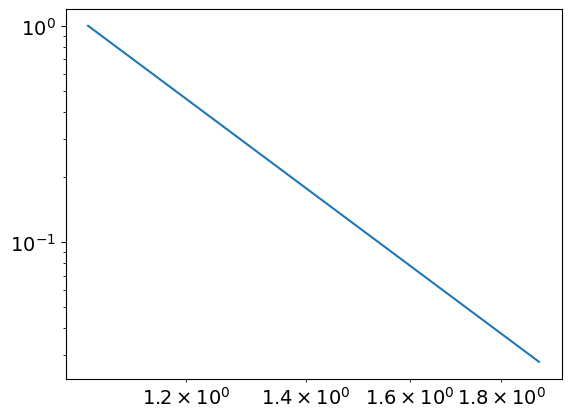

7.164340419861847
1.0578379076303022
powerlaw KstestResult(statistic=0.9930741780771698, pvalue=0.0, statistic_location=1.4353409606231817, statistic_sign=1)
lognorm KstestResult(statistic=0.987106134587583, pvalue=0.0, statistic_location=1.256747085518064, statistic_sign=1)
tensor(0.0699, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2695, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0129, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
219
tensor(4.6199e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


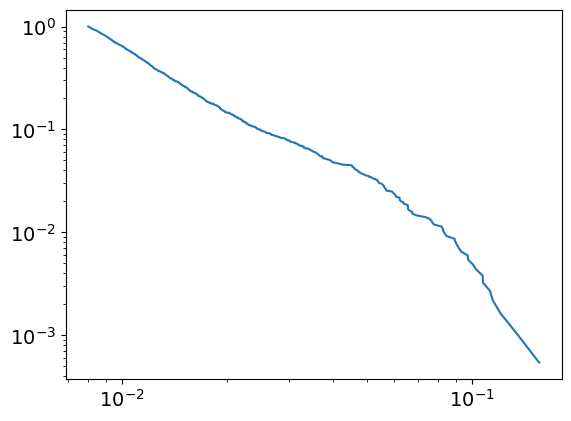

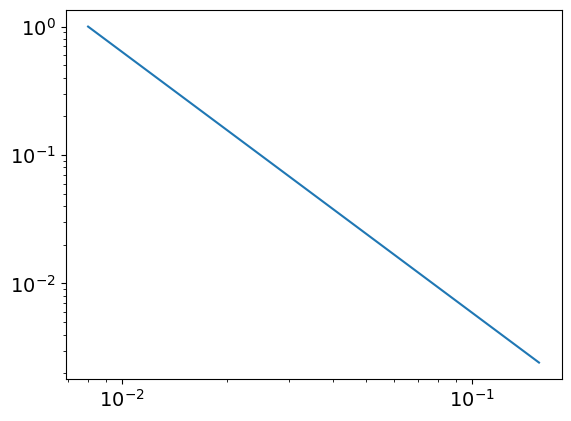

3.029102843117558
0.007997533133833092
powerlaw KstestResult(statistic=0.9989535165370035, pvalue=0.0, statistic_location=0.09729997466132595, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12078365491373524, statistic_sign=-1)
tensor(-3.1493e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1016, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8337, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
219
tensor(0.1818, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


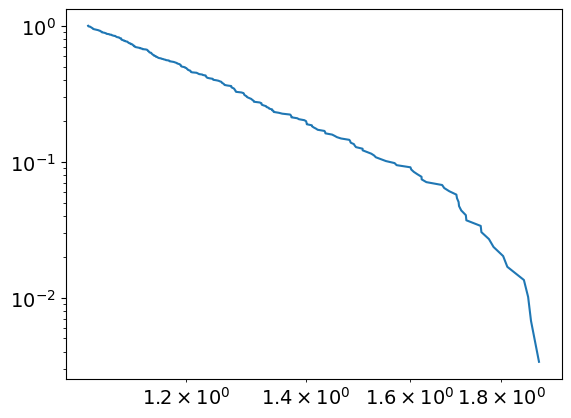

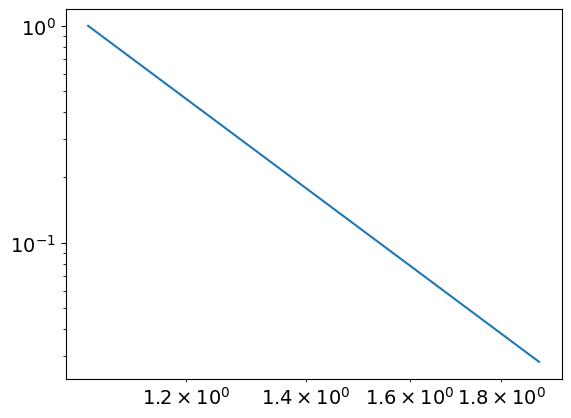

7.149688289961765
1.0582339184060117
powerlaw KstestResult(statistic=0.99305633927614, pvalue=0.0, statistic_location=1.4359856045980275, statistic_sign=1)
lognorm KstestResult(statistic=0.9870156856627457, pvalue=0.0, statistic_location=1.2606711456354018, statistic_sign=1)
tensor(0.0697, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2712, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0196, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
220
tensor(5.1267e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


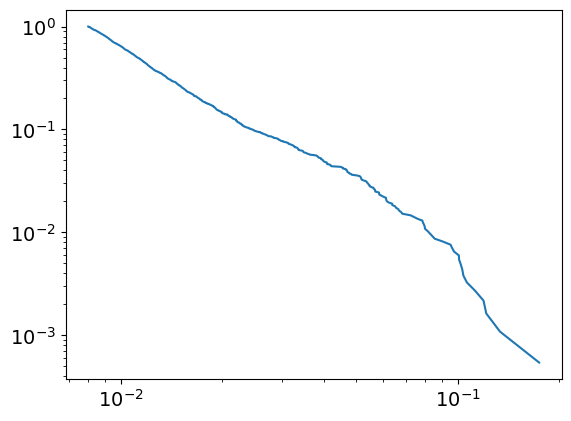

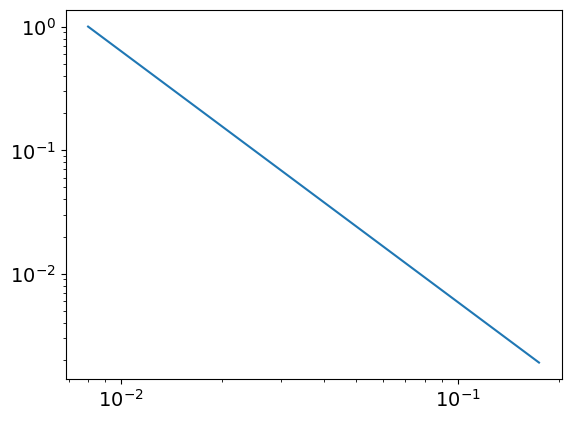

3.0318313943340844
0.008000526541412638
powerlaw KstestResult(statistic=0.9989466096001389, pvalue=0.0, statistic_location=0.10311094091322705, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12146275715502272, statistic_sign=-1)
tensor(-6.4094e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0147, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.2213, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
220
tensor(0.1821, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


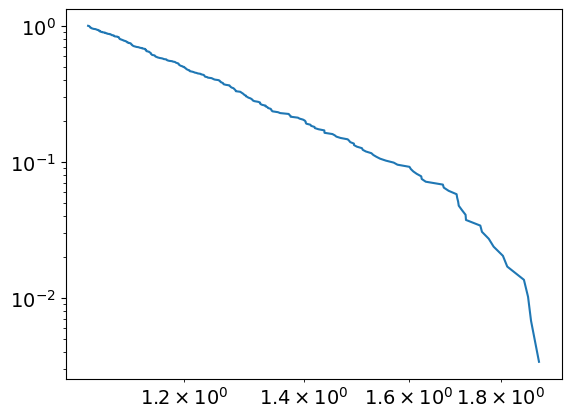

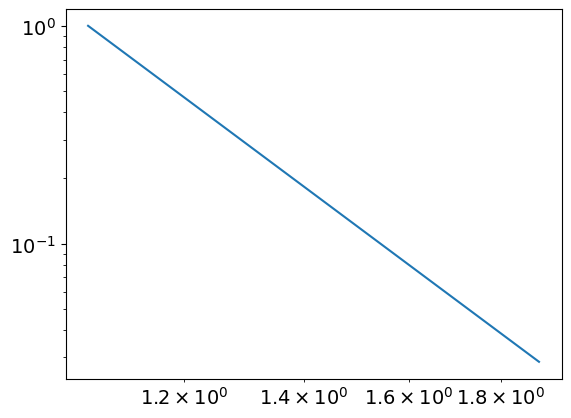

7.156473077704924
1.0616419110026418
powerlaw KstestResult(statistic=0.993107555148021, pvalue=0.0, statistic_location=1.4368218412435907, statistic_sign=1)
lognorm KstestResult(statistic=0.9869365755642993, pvalue=0.0, statistic_location=1.2581507181081815, statistic_sign=1)
tensor(0.0696, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2728, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0260, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
221
tensor(4.5421e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


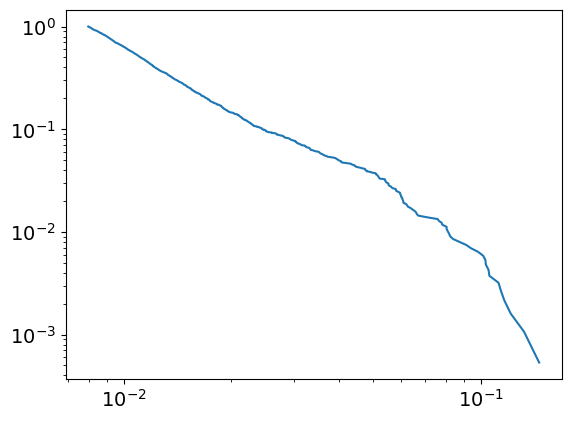

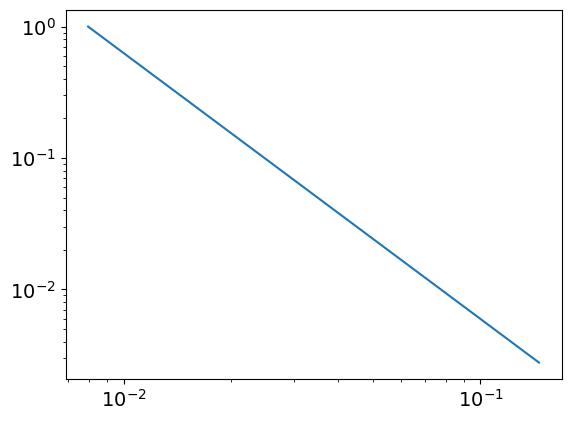

3.0239272732513096
0.007955207363429136
powerlaw KstestResult(statistic=0.998997488265837, pvalue=0.0, statistic_location=0.0809125408021944, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14593614254601386, statistic_sign=1)
tensor(8.8472e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1302, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.9972, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
221
tensor(0.1824, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


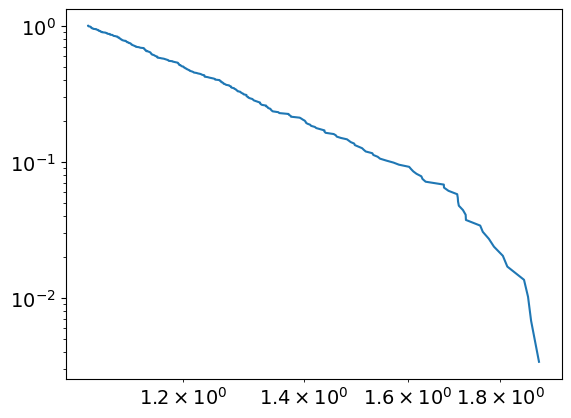

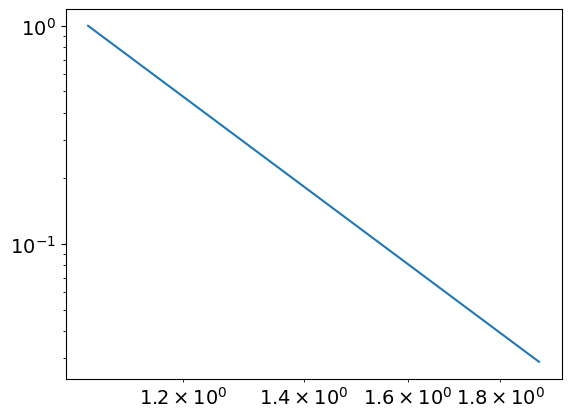

7.142652846519706
1.0620754228282874
powerlaw KstestResult(statistic=0.9930572633846414, pvalue=0.0, statistic_location=1.4394135696509245, statistic_sign=1)
lognorm KstestResult(statistic=0.9868697942622263, pvalue=0.0, statistic_location=1.259596077383804, statistic_sign=1)
tensor(0.0695, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0327, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
222
tensor(4.3401e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


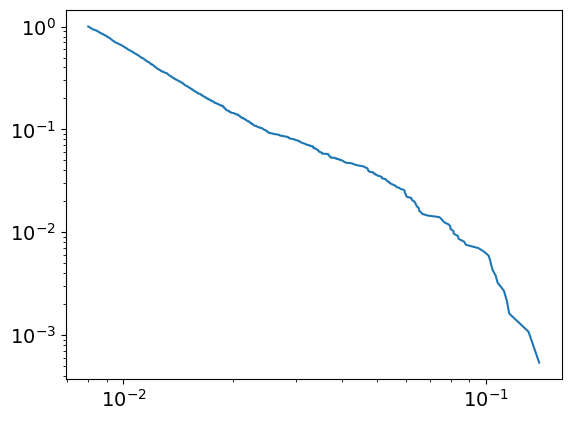

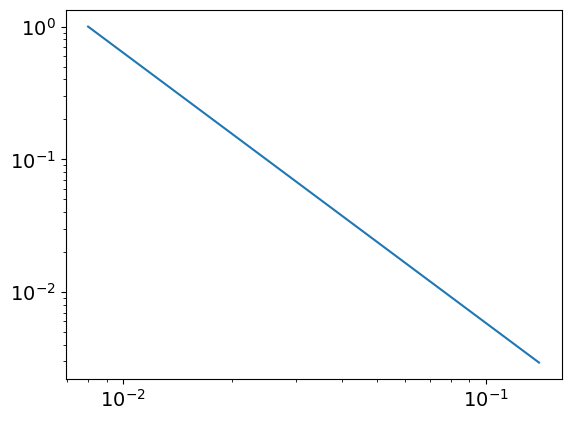

3.036705157717868
0.008002459656323992
powerlaw KstestResult(statistic=0.9990036337242083, pvalue=0.0, statistic_location=0.08135630463397298, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14008822093085274, statistic_sign=1)
tensor(3.0545e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0308, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.8487, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
222
tensor(0.1828, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


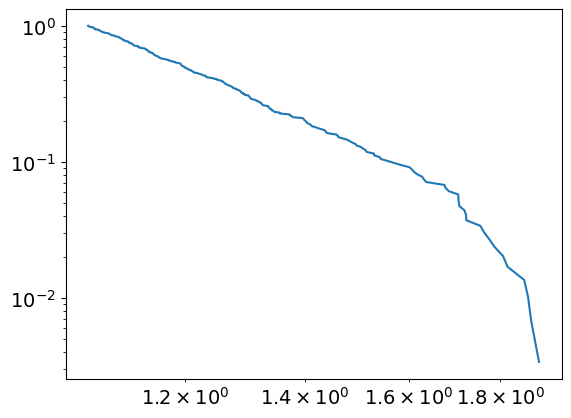

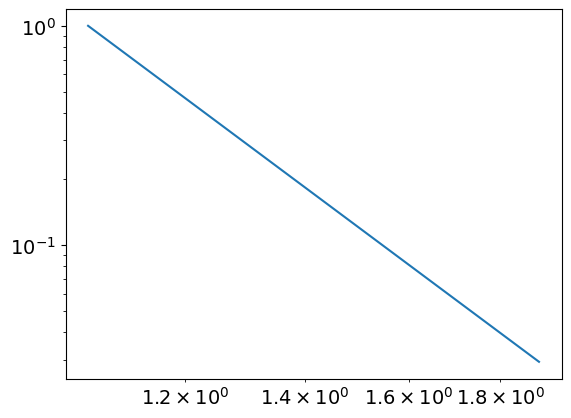

7.085925231694913
1.0595235519663415
powerlaw KstestResult(statistic=0.9929027363149455, pvalue=0.0, statistic_location=1.4419947312076167, statistic_sign=1)
lognorm KstestResult(statistic=0.9867058142302166, pvalue=0.0, statistic_location=1.2530847827461542, statistic_sign=1)
tensor(0.0694, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0392, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
223
tensor(4.5672e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


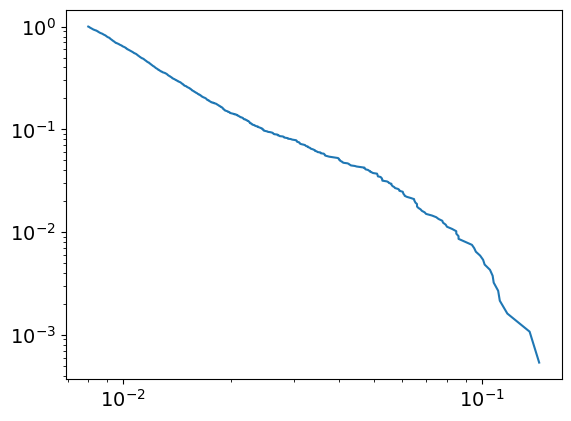

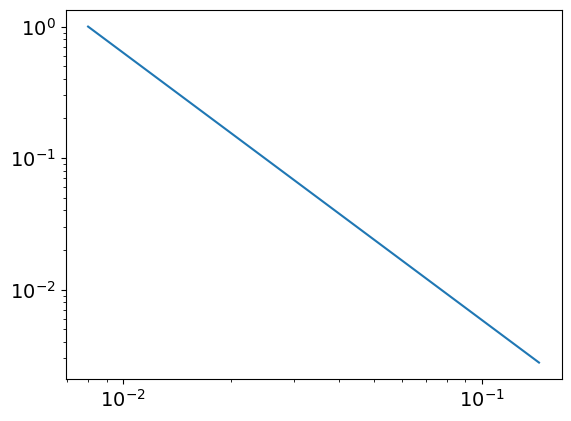

3.0334758325745232
0.007992648171756425
powerlaw KstestResult(statistic=0.998893184653598, pvalue=0.0, statistic_location=0.10527999564305399, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14437354696010782, statistic_sign=1)
tensor(2.7698e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0632, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.6424, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
223
tensor(0.1831, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


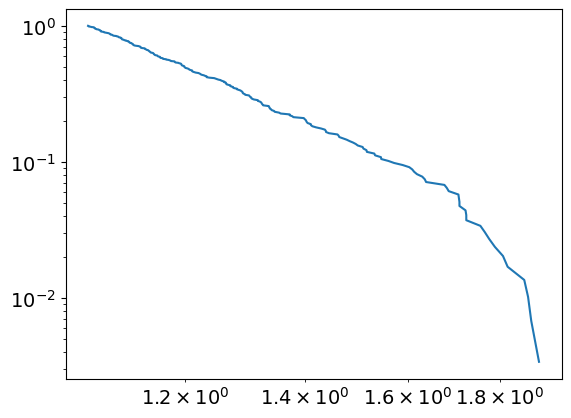

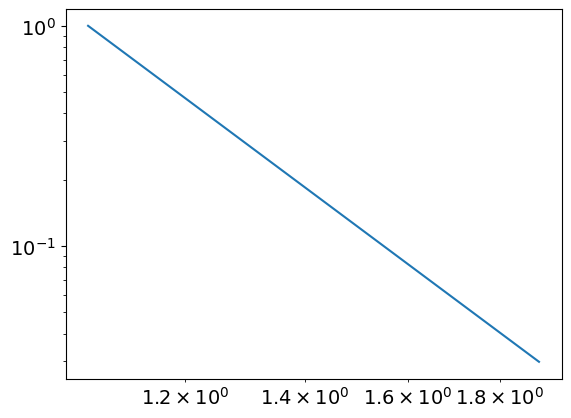

7.051661953497097
1.0593484331519523
powerlaw KstestResult(statistic=0.9928066764695941, pvalue=0.0, statistic_location=1.4445750206478547, statistic_sign=1)
lognorm KstestResult(statistic=0.986639616553447, pvalue=0.0, statistic_location=1.2575015240901004, statistic_sign=1)
tensor(0.0693, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2777, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0459, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
224
tensor(4.7915e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


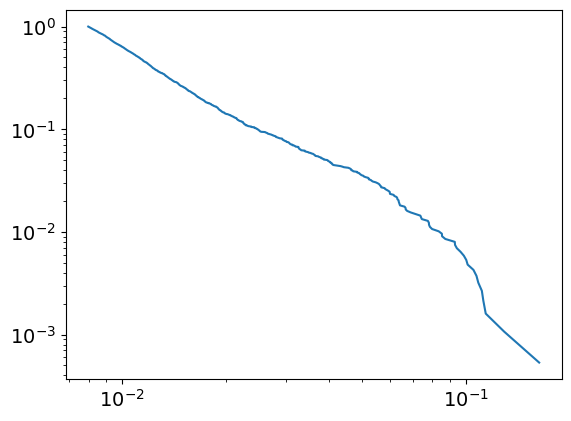

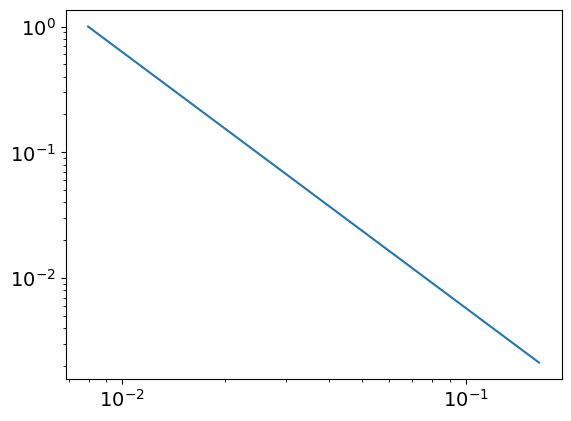

3.036434678734272
0.007968335312943414
powerlaw KstestResult(statistic=0.9989331916809072, pvalue=0.0, statistic_location=0.09868980059129093, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.163500520315581, statistic_sign=1)
tensor(1.8345e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0318, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5441, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
224
tensor(0.1834, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


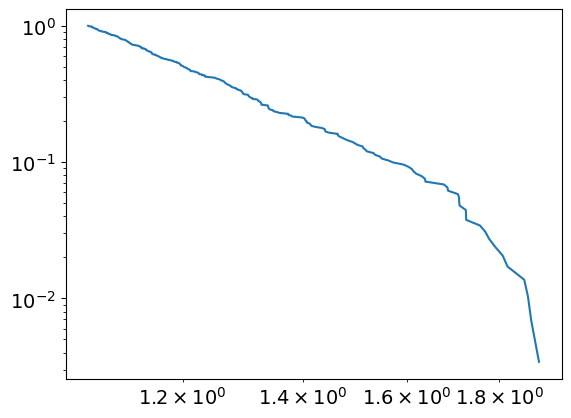

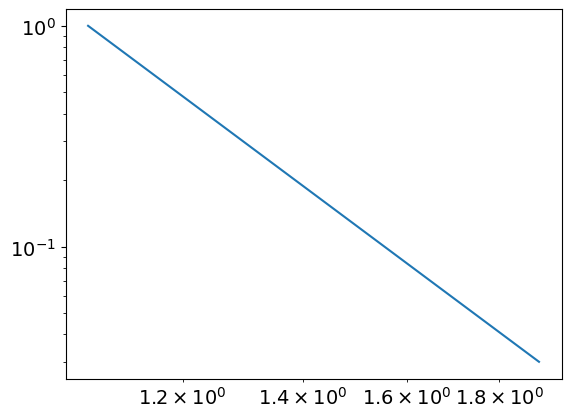

7.067522275474387
1.0630304790759137
powerlaw KstestResult(statistic=0.9928525018497814, pvalue=0.0, statistic_location=1.440640390049877, statistic_sign=1)
lognorm KstestResult(statistic=0.9866133453605463, pvalue=0.0, statistic_location=1.2386630765164983, statistic_sign=1)
tensor(0.0692, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2793, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0525, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
225
tensor(4.7421e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


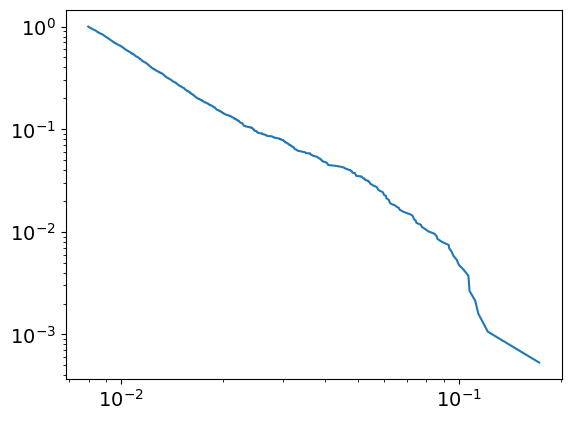

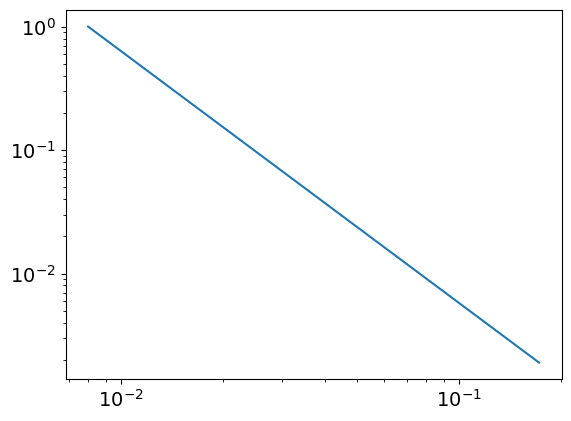

3.039581500800146
0.007983795604926434
powerlaw KstestResult(statistic=0.9989601063195096, pvalue=0.0, statistic_location=0.10313120822409144, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17239778609665807, statistic_sign=1)
tensor(1.0471e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1677, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.6811, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
225
tensor(0.1838, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


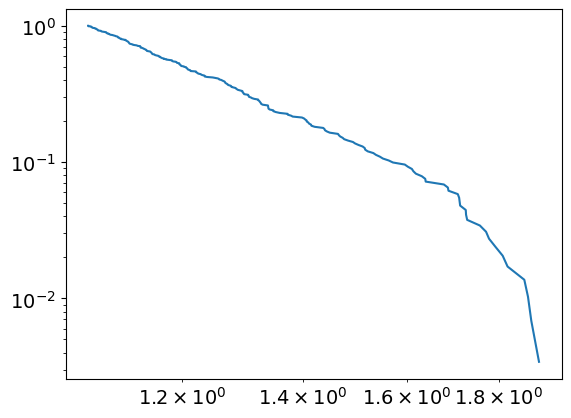

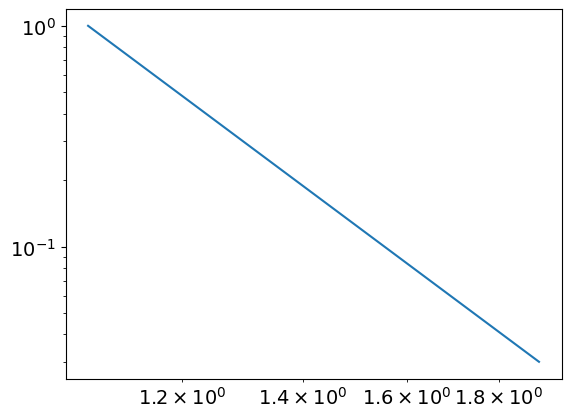

7.07373953686705
1.0640299934754192
powerlaw KstestResult(statistic=0.9928238835909818, pvalue=0.0, statistic_location=1.4496160750112301, statistic_sign=1)
lognorm KstestResult(statistic=0.9866126765388883, pvalue=0.0, statistic_location=1.238995076832358, statistic_sign=1)
tensor(0.0691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2809, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0593, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
226
tensor(5.1836e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


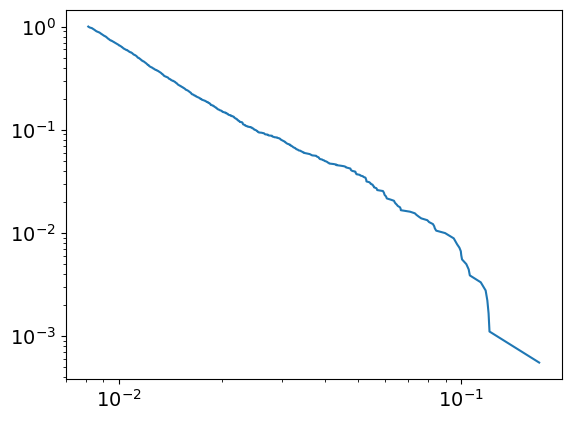

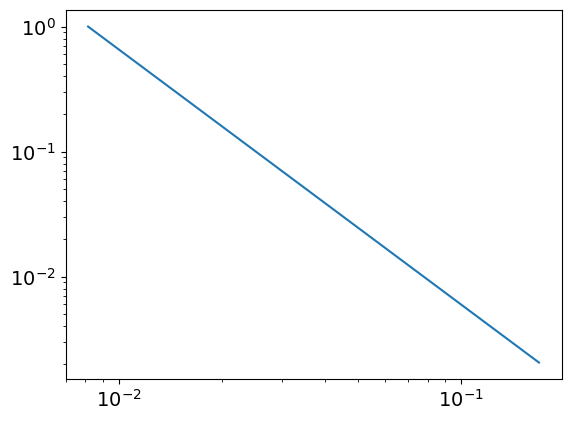

3.0416081106930806
0.008145208759398772
powerlaw KstestResult(statistic=0.9988330862343602, pvalue=0.0, statistic_location=0.10342066599155883, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1687466322171754, statistic_sign=1)
tensor(1.2963e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2209, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4599, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
226
tensor(0.1841, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


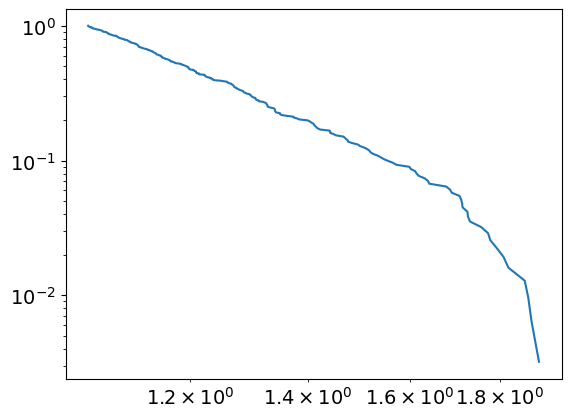

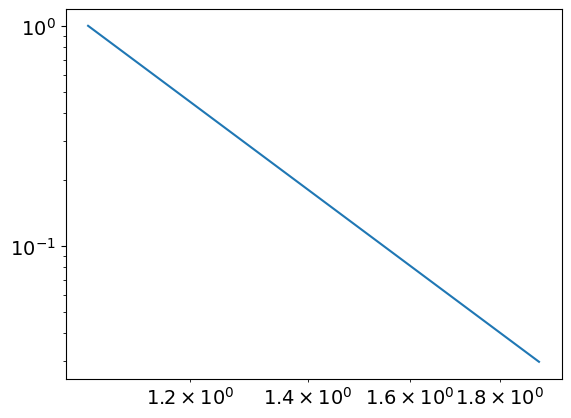

6.94772518227496
1.049336112719295
powerlaw KstestResult(statistic=0.9923082960400285, pvalue=0.0, statistic_location=1.4224061078333505, statistic_sign=1)
lognorm KstestResult(statistic=0.9866114115464556, pvalue=0.0, statistic_location=1.2393529858692838, statistic_sign=1)
tensor(0.0690, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2825, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0659, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
227
tensor(4.7610e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


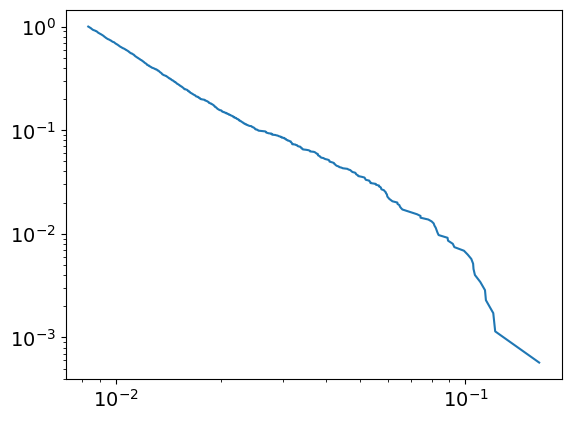

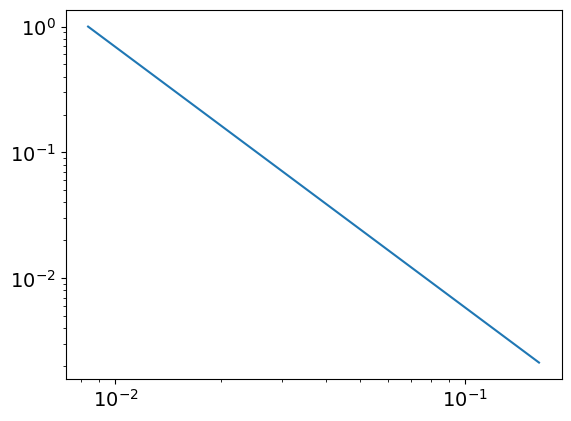

3.0730527626097133
0.0083576824770345
powerlaw KstestResult(statistic=0.998980577438035, pvalue=0.0, statistic_location=0.10513839525290132, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16237420041817685, statistic_sign=1)
tensor(5.2335e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0293, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4386, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
227
tensor(0.1844, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


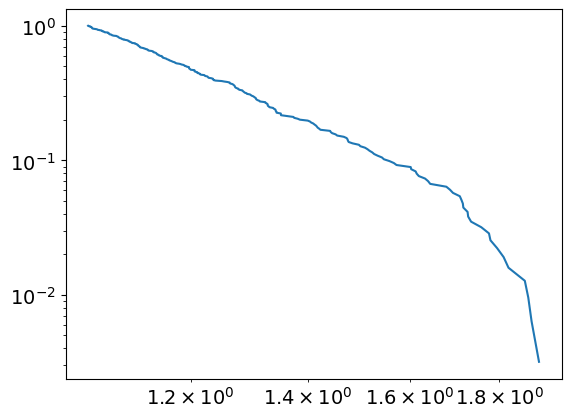

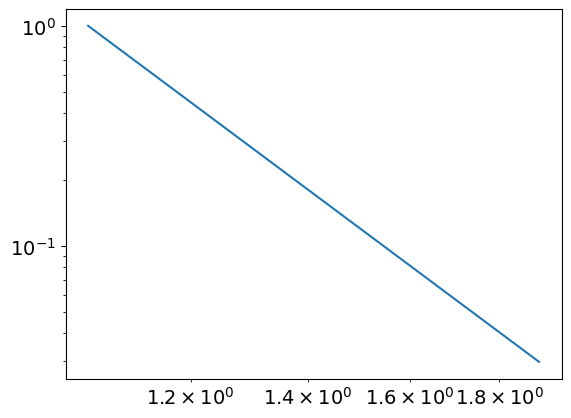

6.934243110909712
1.0486215413395998
powerlaw KstestResult(statistic=0.9922686456877152, pvalue=0.0, statistic_location=1.4229559828016338, statistic_sign=1)
lognorm KstestResult(statistic=0.9866093398635292, pvalue=0.0, statistic_location=1.2397564104156478, statistic_sign=1)
tensor(0.0689, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2841, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0725, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
228
tensor(5.6473e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


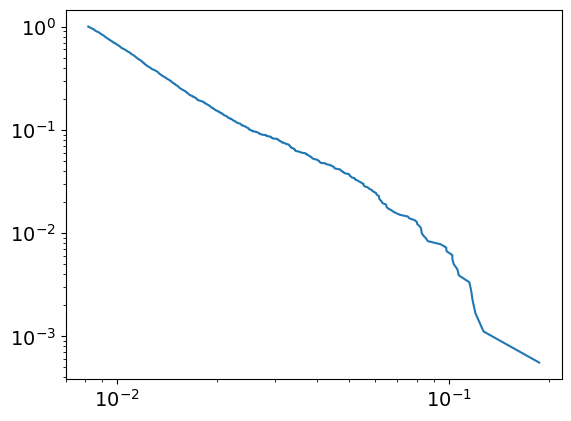

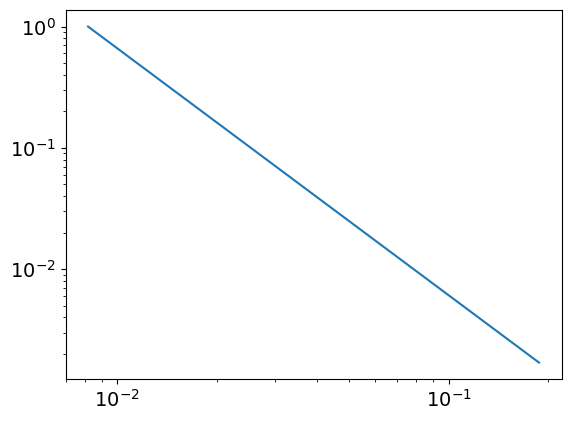

3.037130240091159
0.008178335168347043
powerlaw KstestResult(statistic=0.9988527357328716, pvalue=0.0, statistic_location=0.10724069315925104, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18739156664534376, statistic_sign=1)
tensor(2.4665e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2879, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.4484, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
228
tensor(0.1848, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


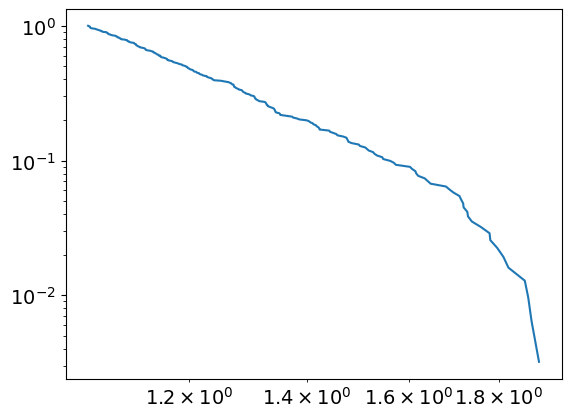

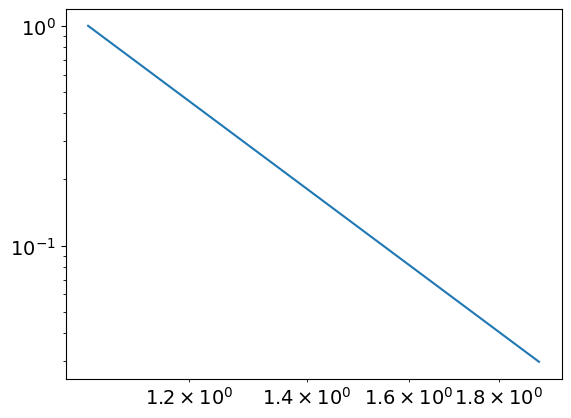

6.964802989547067
1.0514288406096275
powerlaw KstestResult(statistic=0.9923471140569587, pvalue=0.0, statistic_location=1.423402170297835, statistic_sign=1)
lognorm KstestResult(statistic=0.9866086532306512, pvalue=0.0, statistic_location=1.240059236197803, statistic_sign=1)
tensor(0.0688, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2857, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0791, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
229
tensor(4.7292e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


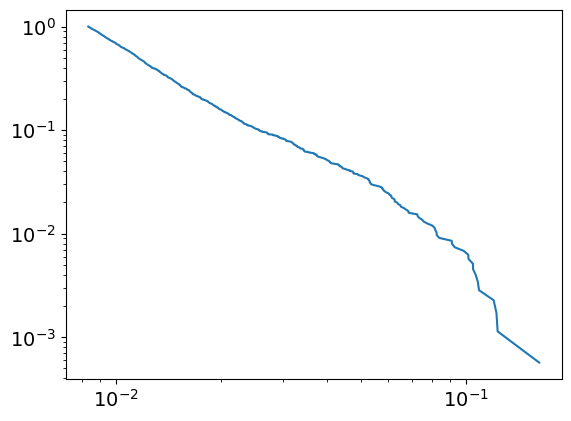

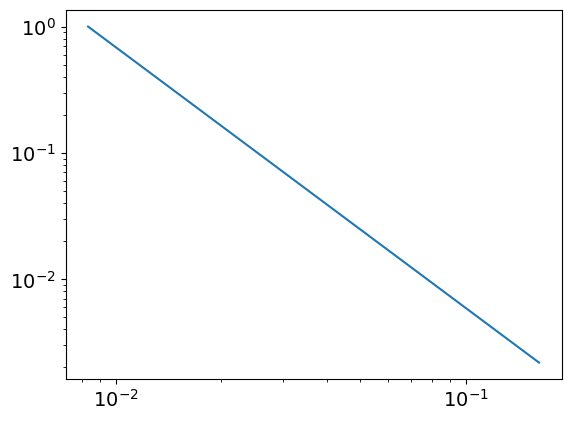

3.062780830984297
0.008318342340862976
powerlaw KstestResult(statistic=0.9989689542208015, pvalue=0.0, statistic_location=0.10481837948123839, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16209624413363793, statistic_sign=1)
tensor(3.3024e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1071, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3927, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
229
tensor(0.1852, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


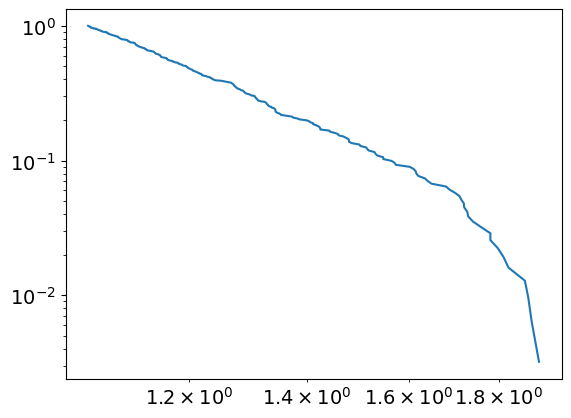

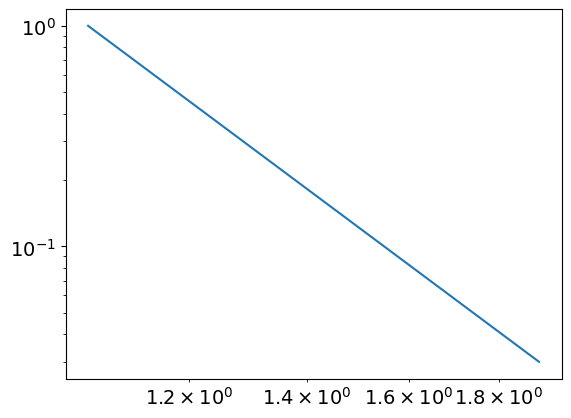

6.9412249733999
1.0515768527789033
powerlaw KstestResult(statistic=0.992289069539395, pvalue=0.0, statistic_location=1.425269892310305, statistic_sign=1)
lognorm KstestResult(statistic=0.9865831816719135, pvalue=0.0, statistic_location=1.241705057402378, statistic_sign=1)
tensor(0.0687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2099, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2872, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0857, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
230
tensor(4.6237e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


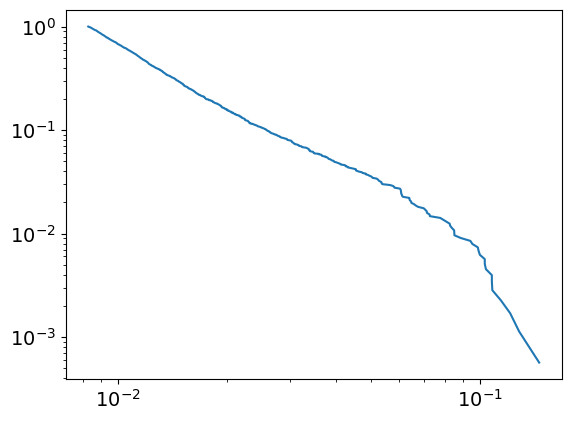

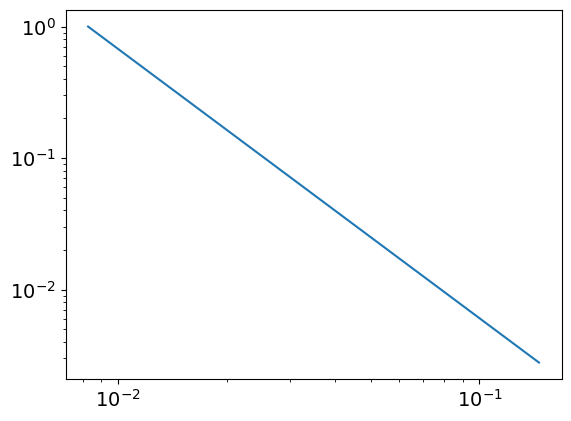

3.050561809924771
0.008284252266781419
powerlaw KstestResult(statistic=0.9989822434622698, pvalue=0.0, statistic_location=0.10334487550449732, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14608615038622333, statistic_sign=1)
tensor(2.9439e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0365, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1792, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
230
tensor(0.1855, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


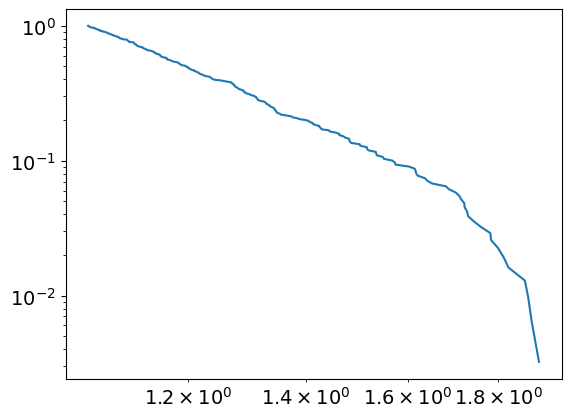

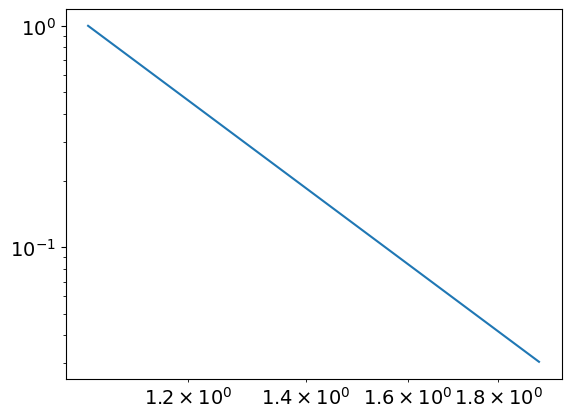

6.927925396151145
1.053086654271367
powerlaw KstestResult(statistic=0.992235910616761, pvalue=0.0, statistic_location=1.4286741143000248, statistic_sign=1)
lognorm KstestResult(statistic=0.9865229240513032, pvalue=0.0, statistic_location=1.244825162733336, statistic_sign=1)
tensor(0.0687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2099, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2888, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0923, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
231
tensor(4.2723e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


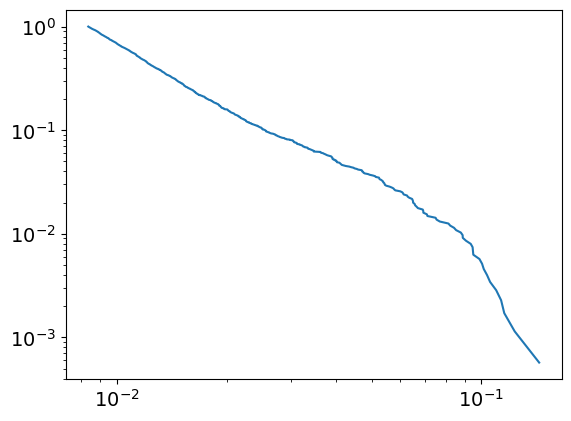

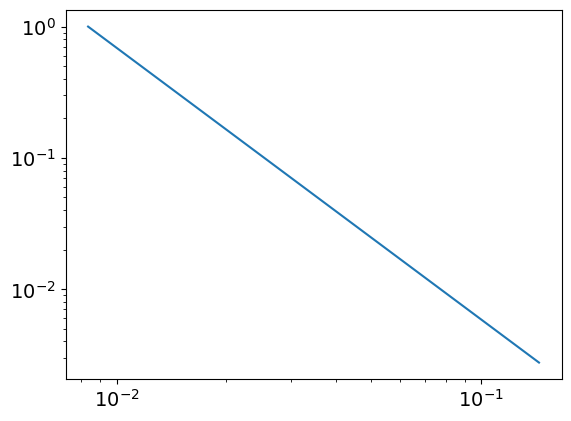

3.0696638476028597
0.00835314484073794
powerlaw KstestResult(statistic=0.9990595023779223, pvalue=0.0, statistic_location=0.10151735878758245, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14404240569414536, statistic_sign=1)
tensor(4.5002e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0077, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.4229, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
231
tensor(0.1859, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


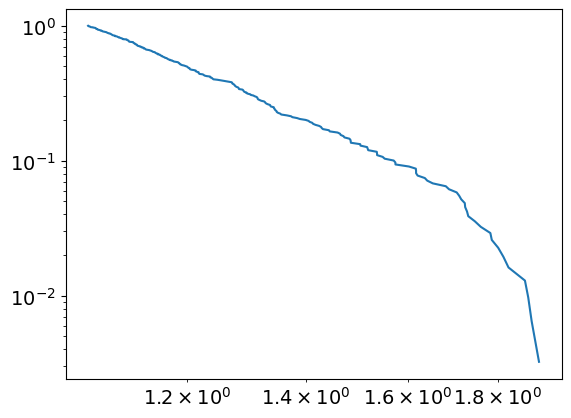

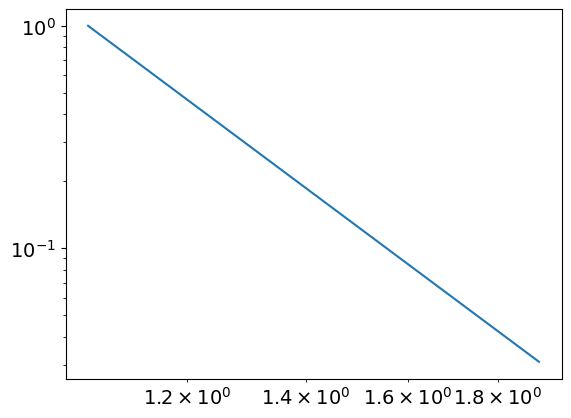

6.906055376679532
1.0538800138566427
powerlaw KstestResult(statistic=0.992148592342872, pvalue=0.0, statistic_location=1.4323568746928552, statistic_sign=1)
lognorm KstestResult(statistic=0.9864699337527881, pvalue=0.0, statistic_location=1.2413942719915536, statistic_sign=1)
tensor(0.0686, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2099, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2903, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0989, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
232
tensor(4.4266e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


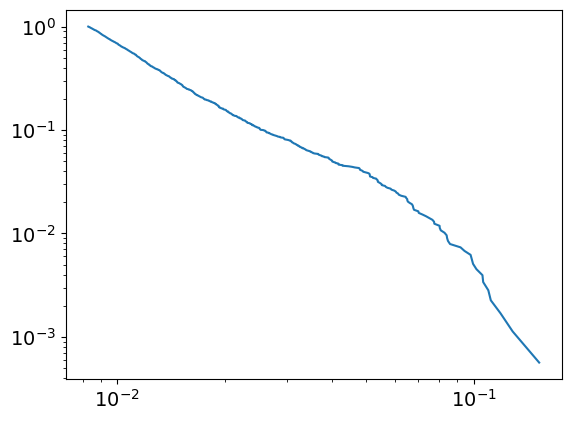

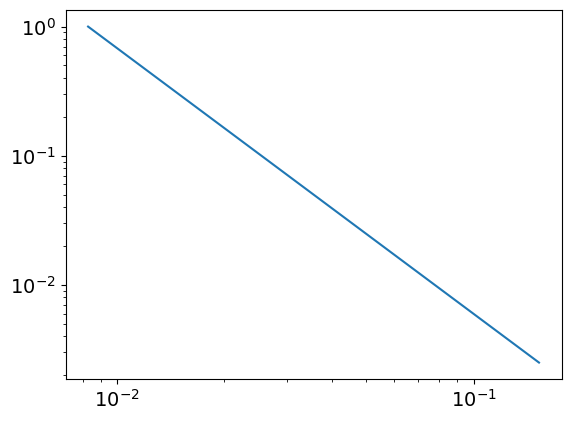

3.056236999055516
0.00829276033871601
powerlaw KstestResult(statistic=0.99908589729259, pvalue=0.0, statistic_location=0.085841215334845, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1526464171779114, statistic_sign=1)
tensor(2.3378e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0461, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.1201, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
232
tensor(0.1862, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


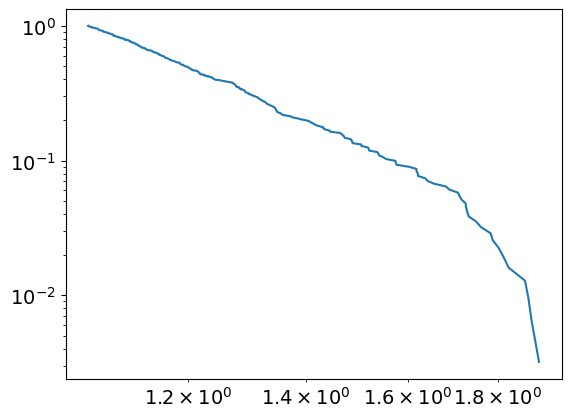

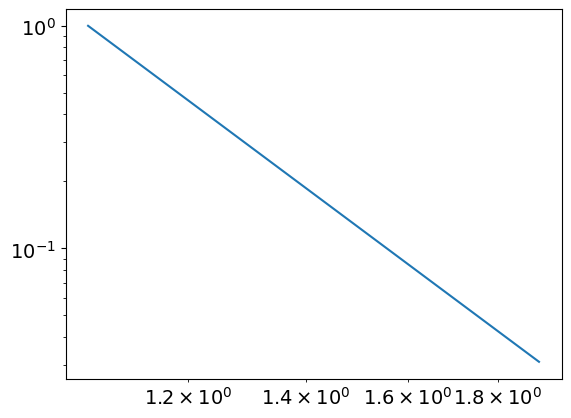

6.88007574857215
1.0521329541494557
powerlaw KstestResult(statistic=0.9919959243847708, pvalue=0.0, statistic_location=1.445379067260562, statistic_sign=1)
lognorm KstestResult(statistic=0.9864300254139379, pvalue=0.0, statistic_location=1.243664703668395, statistic_sign=1)
tensor(0.0685, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2099, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2918, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1054, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
233
tensor(4.5748e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


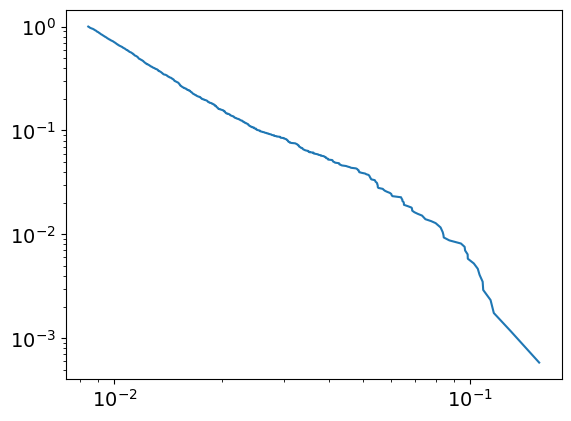

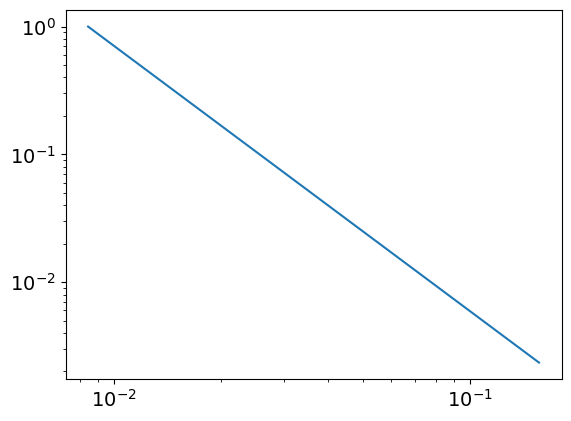

3.0753439224909016
0.008442785717527906
powerlaw KstestResult(statistic=0.9990528097460928, pvalue=0.0, statistic_location=0.10231242439886576, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15616221535087618, statistic_sign=1)
tensor(2.2508e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1071, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.3964, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
233
tensor(0.1866, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


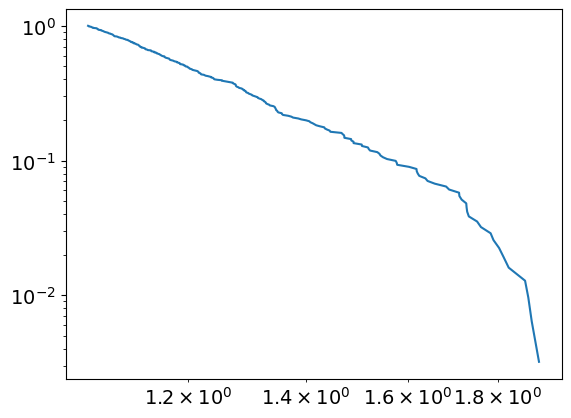

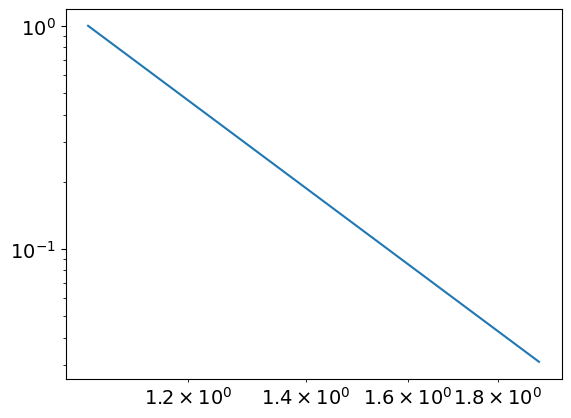

6.869700983476364
1.0525455283754241
powerlaw KstestResult(statistic=0.9919791745768479, pvalue=0.0, statistic_location=1.4458238296178967, statistic_sign=1)
lognorm KstestResult(statistic=0.9863666253180855, pvalue=0.0, statistic_location=1.2466979776006466, statistic_sign=1)
tensor(0.0685, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2100, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2932, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1118, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
234
tensor(4.8147e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


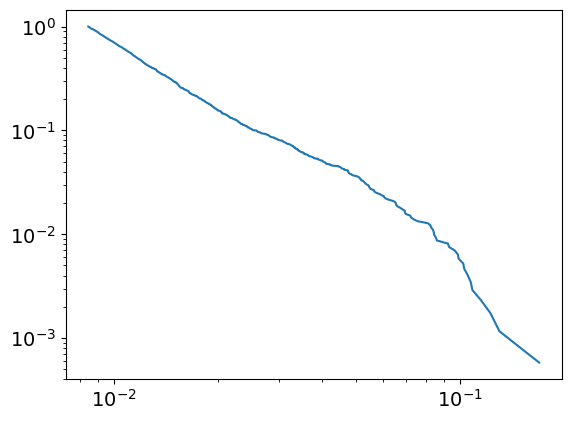

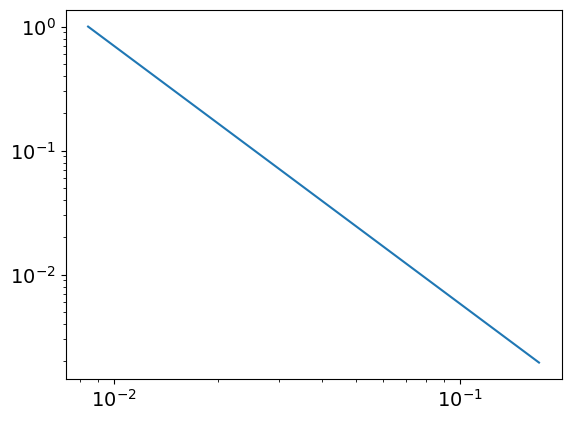

3.0799981677951482
0.00843420485691355
powerlaw KstestResult(statistic=0.9990465051624889, pvalue=0.0, statistic_location=0.10291780926310645, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16941600537901091, statistic_sign=1)
tensor(1.0986e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0517, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6731, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
234
tensor(0.1869, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


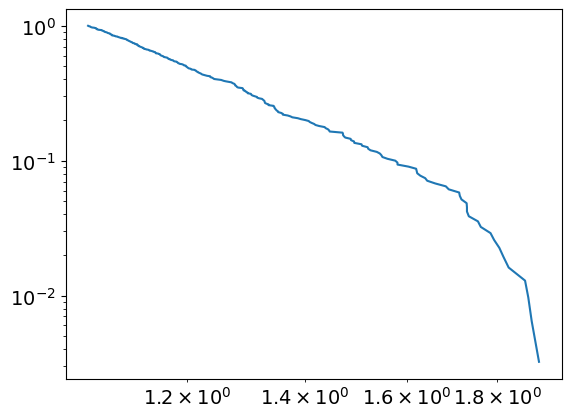

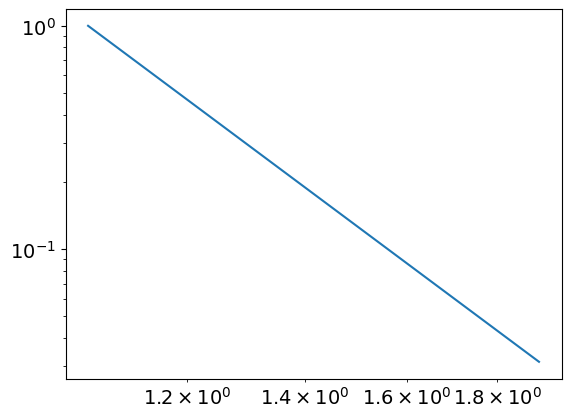

6.8776181492571595
1.0547407797392148
powerlaw KstestResult(statistic=0.9920394278012443, pvalue=0.0, statistic_location=1.4463092209691233, statistic_sign=1)
lognorm KstestResult(statistic=0.9863139425118188, pvalue=0.0, statistic_location=1.2435498703750283, statistic_sign=1)
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2100, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2947, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1181, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
235
tensor(4.7995e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


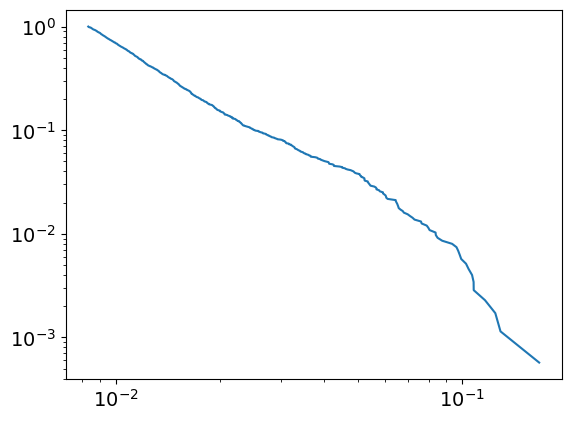

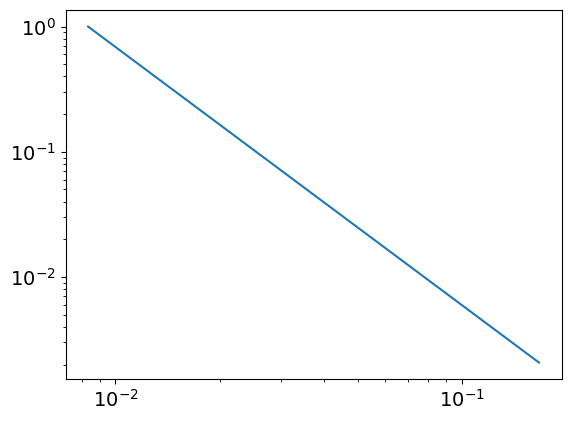

3.062195141380094
0.00833628637143832
powerlaw KstestResult(statistic=0.9990214154700198, pvalue=0.0, statistic_location=0.10261312617477351, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16683124762435358, statistic_sign=1)
tensor(6.3461e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1524, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.3863, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
235
tensor(0.1873, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


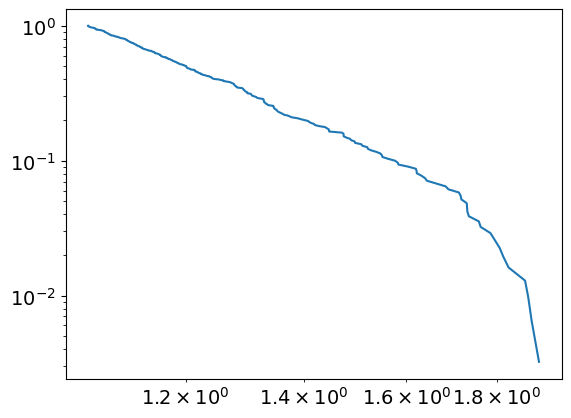

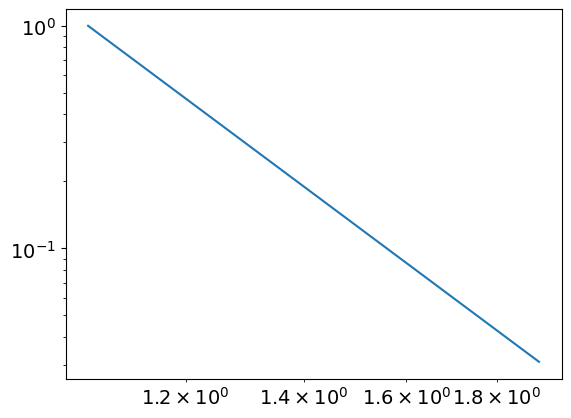

6.911418048929992
1.0565566769454757
powerlaw KstestResult(statistic=0.9921257626801679, pvalue=0.0, statistic_location=1.4467456736077944, statistic_sign=1)
lognorm KstestResult(statistic=0.9862665226708752, pvalue=0.0, statistic_location=1.2459509859046949, statistic_sign=1)
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2100, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2961, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1244, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
236
tensor(4.6790e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


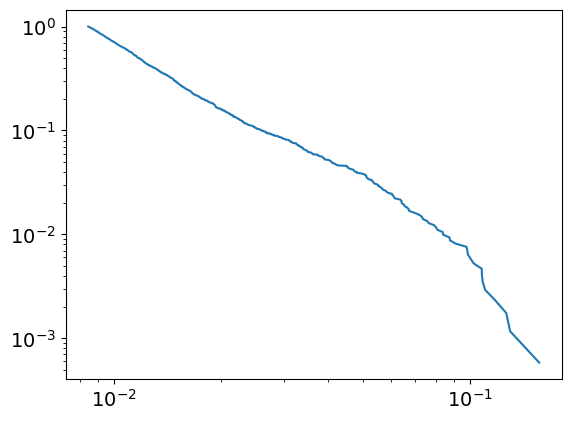

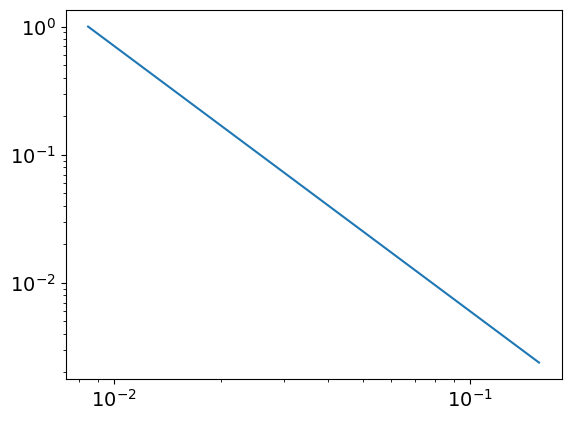

3.071061244649514
0.008462460377523863
powerlaw KstestResult(statistic=0.9990456958085615, pvalue=0.0, statistic_location=0.10233498180328678, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1295475218735366, statistic_sign=-1)
tensor(-3.2671e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3848, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.1697, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
236
tensor(0.1877, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


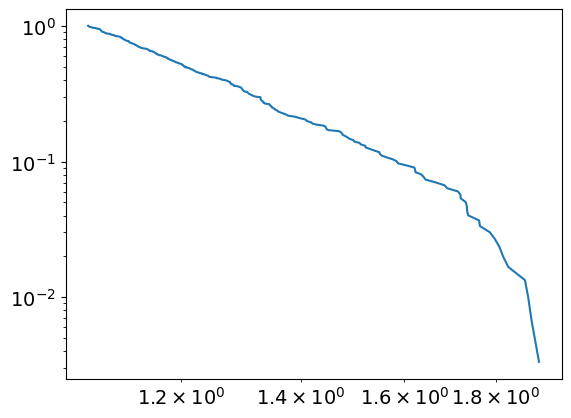

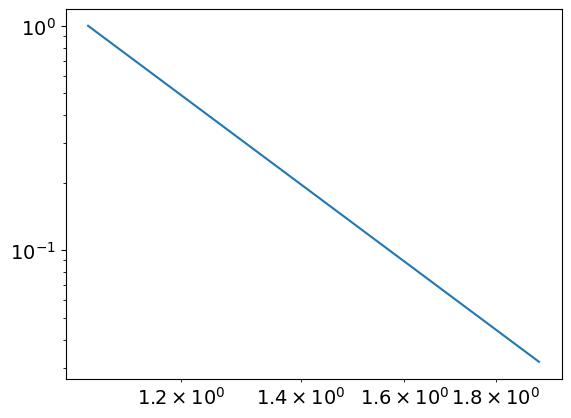

6.938344887436829
1.0646574240535456
powerlaw KstestResult(statistic=0.9922847460048324, pvalue=0.0, statistic_location=1.449986709421573, statistic_sign=1)
lognorm KstestResult(statistic=0.9862117620481179, pvalue=0.0, statistic_location=1.2483512649972675, statistic_sign=1)
tensor(0.0683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2101, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2976, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1309, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
237
tensor(4.5185e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


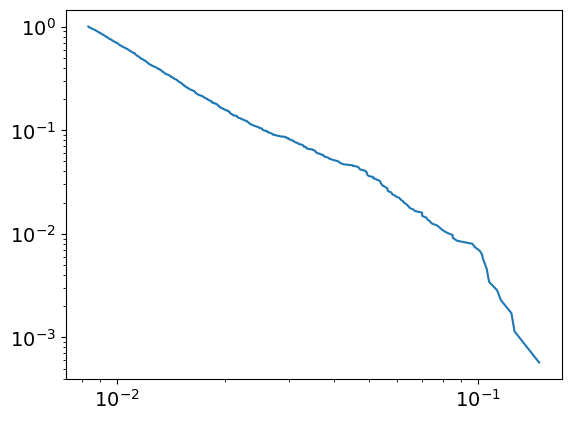

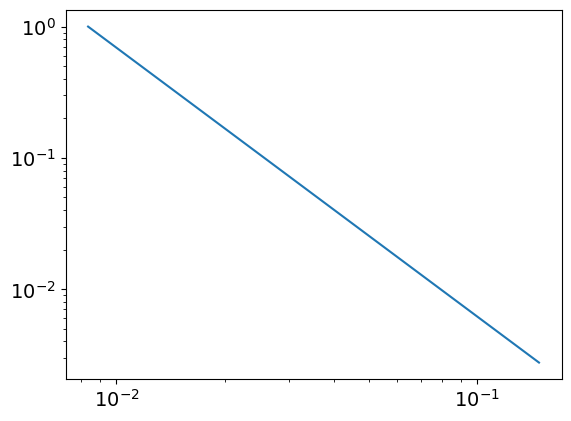

3.0491810511574373
0.008349951992949967
powerlaw KstestResult(statistic=0.9989771603736729, pvalue=0.0, statistic_location=0.1035164330619737, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12657622484413886, statistic_sign=-1)
tensor(-3.2756e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3768, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.9232, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
237
tensor(0.1880, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


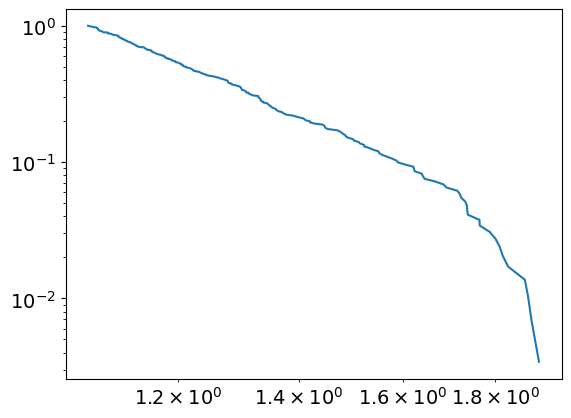

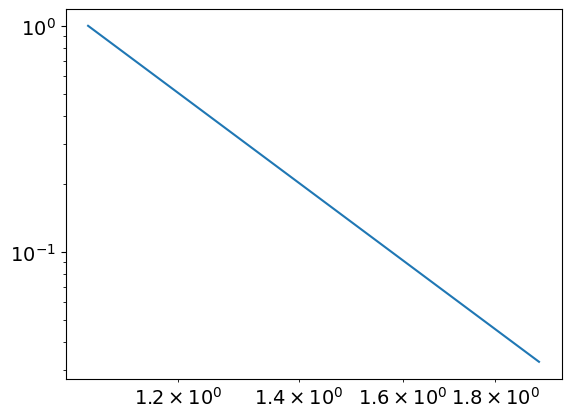

6.937081424571123
1.069687018630837
powerlaw KstestResult(statistic=0.9923205439924307, pvalue=0.0, statistic_location=1.453445869880697, statistic_sign=1)
lognorm KstestResult(statistic=0.9861494041169316, pvalue=0.0, statistic_location=1.2507369546340594, statistic_sign=1)
tensor(0.0683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2101, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2989, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1371, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
238
tensor(4.4717e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


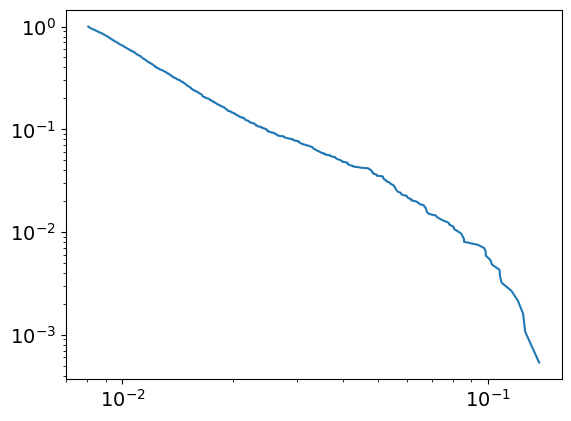

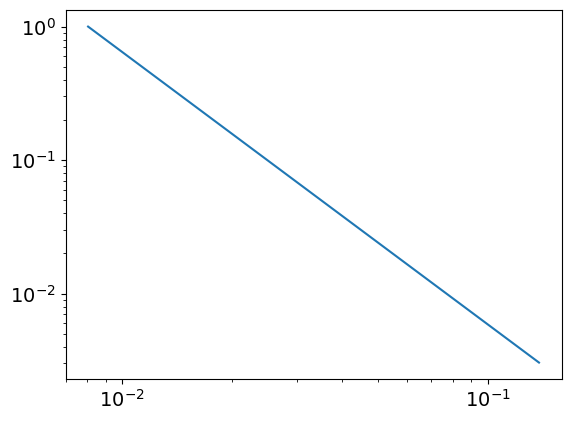

3.0407796831832887
0.0080623819268326
powerlaw KstestResult(statistic=0.9989811347466188, pvalue=0.0, statistic_location=0.10245116481985522, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12623431241137334, statistic_sign=-1)
tensor(-3.1388e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3981, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.2280, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
238
tensor(0.1884, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


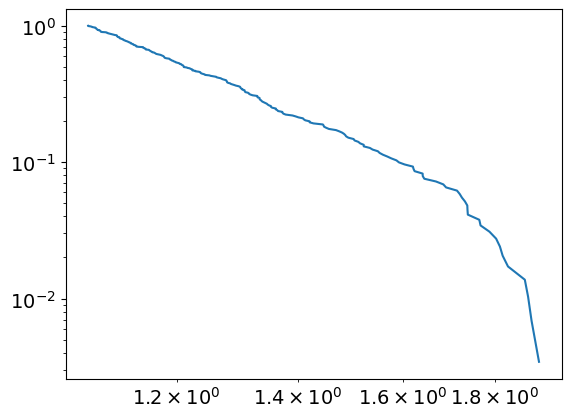

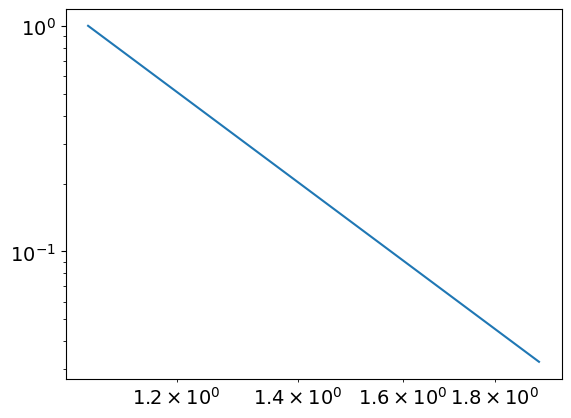

6.96999950831178
1.0720593635750433
powerlaw KstestResult(statistic=0.9923369592609738, pvalue=0.0, statistic_location=1.4568568226719434, statistic_sign=1)
lognorm KstestResult(statistic=0.9860783060004618, pvalue=0.0, statistic_location=1.2531195308179284, statistic_sign=1)
tensor(0.0682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2101, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3003, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1432, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
239
tensor(4.1885e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


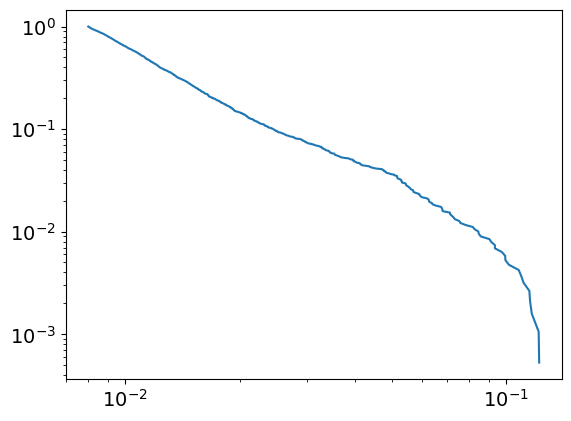

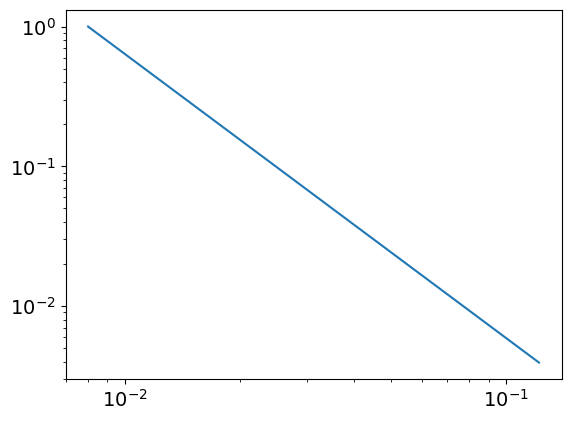

3.0333314949586105
0.008007426351599638
powerlaw KstestResult(statistic=0.9989872398615388, pvalue=0.0, statistic_location=0.10160278233479862, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12198874932332847, statistic_sign=-1)
tensor(-2.3960e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4247, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.2942, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
239
tensor(0.1887, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


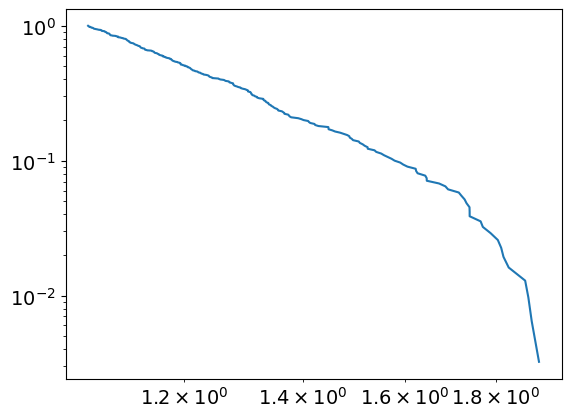

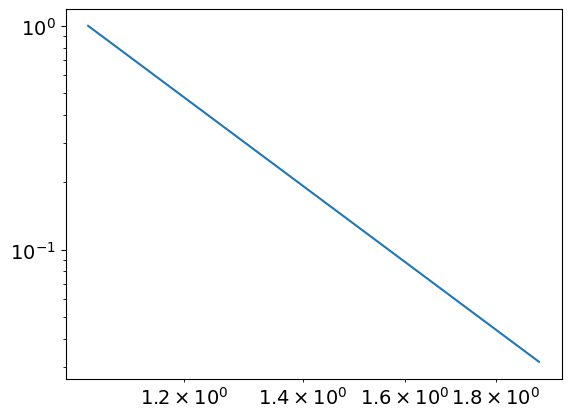

6.883513469228093
1.0587306889506125
powerlaw KstestResult(statistic=0.9919139054180017, pvalue=0.0, statistic_location=1.428977431543531, statistic_sign=1)
lognorm KstestResult(statistic=0.9860524469931615, pvalue=0.0, statistic_location=1.244738088675659, statistic_sign=1)
tensor(0.0682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2102, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3017, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1493, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
240
tensor(4.3719e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


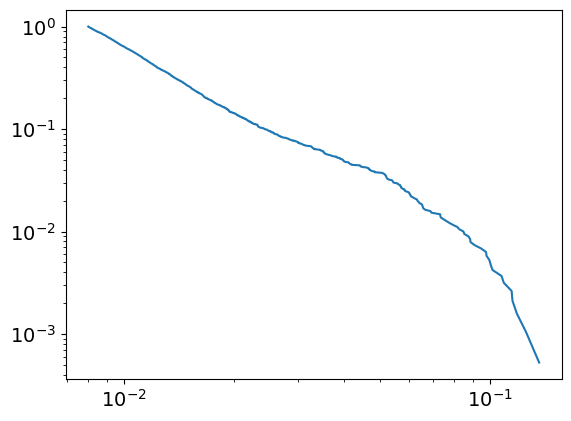

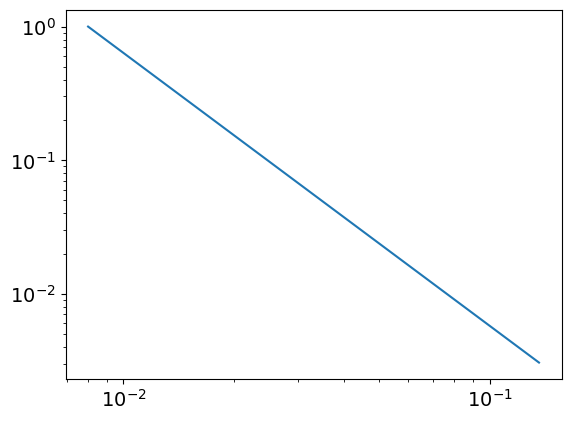

3.0427550291721572
0.00800867290169304
powerlaw KstestResult(statistic=0.9990013594334608, pvalue=0.0, statistic_location=0.10171207699727082, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1254267224438469, statistic_sign=-1)
tensor(-1.7140e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3228, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.0878, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
240
tensor(0.1891, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


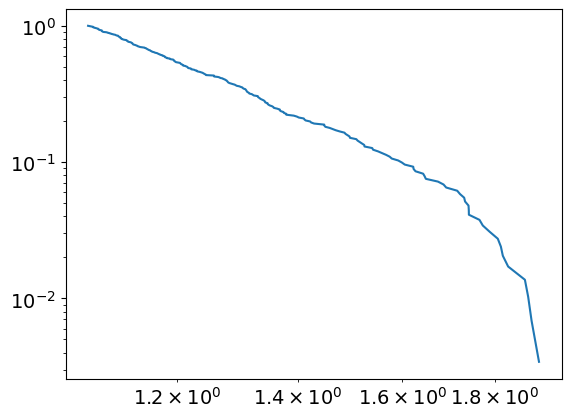

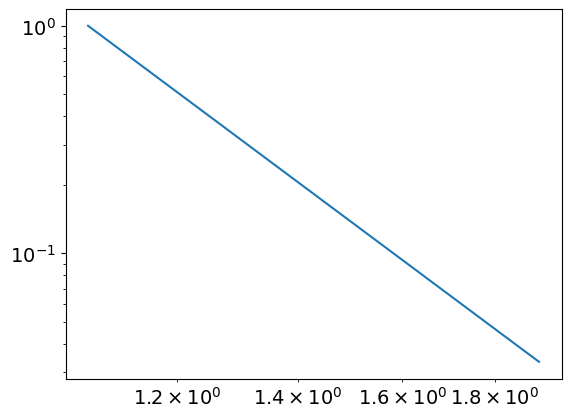

6.906992415809585
1.0710944234487154
powerlaw KstestResult(statistic=0.992149998257251, pvalue=0.0, statistic_location=1.429435282468697, statistic_sign=1)
lognorm KstestResult(statistic=0.9860459919765, pvalue=0.0, statistic_location=1.2451990860579265, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2102, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3030, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1554, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
241
tensor(4.4285e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


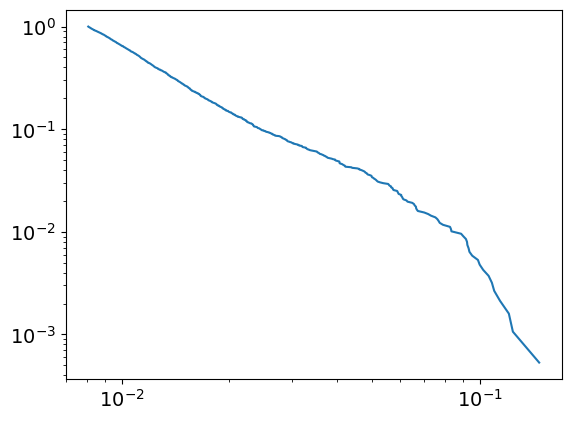

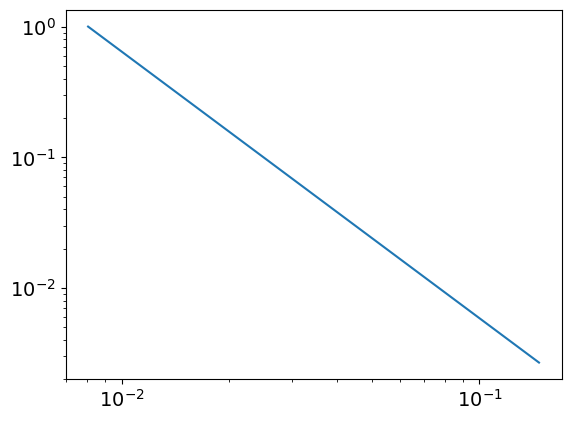

3.0414274461461233
0.008065088169107216
powerlaw KstestResult(statistic=0.9989855524067677, pvalue=0.0, statistic_location=0.10232138757929504, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12385207002610006, statistic_sign=-1)
tensor(-4.3837e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2246, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.7653, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
241
tensor(0.1895, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


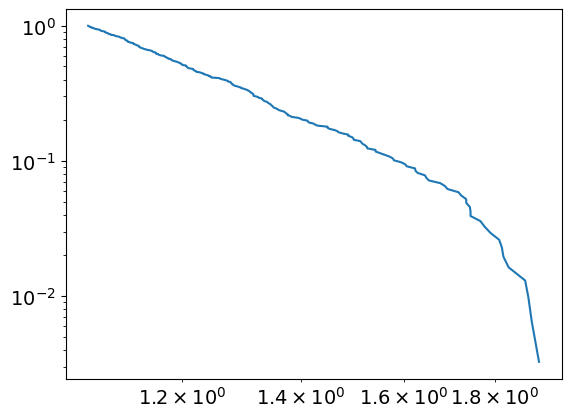

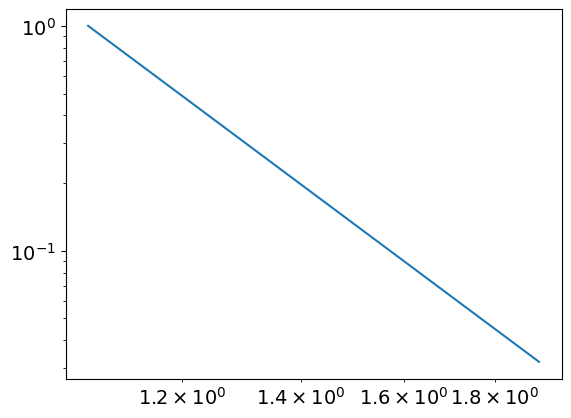

6.8841148150554
1.0620226692254213
powerlaw KstestResult(statistic=0.9919618016789595, pvalue=0.0, statistic_location=1.429848335555773, statistic_sign=1)
lognorm KstestResult(statistic=0.9860180845608905, pvalue=0.0, statistic_location=1.2466242631558713, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2103, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3043, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1613, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
242
tensor(4.5286e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


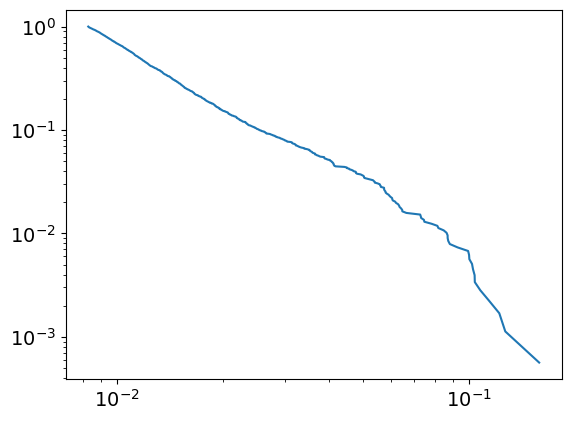

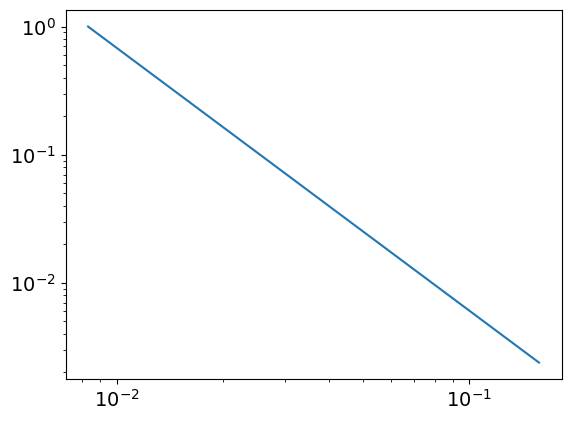

3.0483810911628297
0.008303011457968352
powerlaw KstestResult(statistic=0.9990523379140696, pvalue=0.0, statistic_location=0.08738594575479675, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1268756743994047, statistic_sign=-1)
tensor(-1.4898e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1932, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.0771, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
242
tensor(0.1898, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


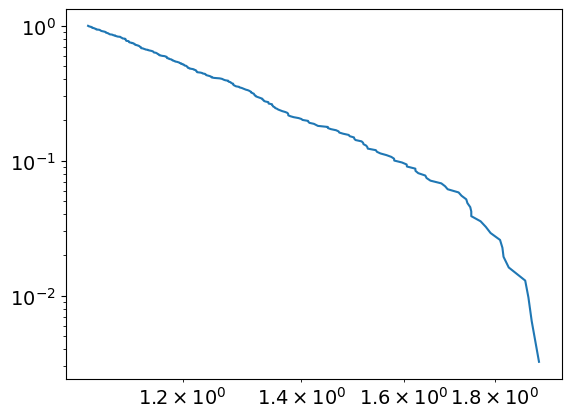

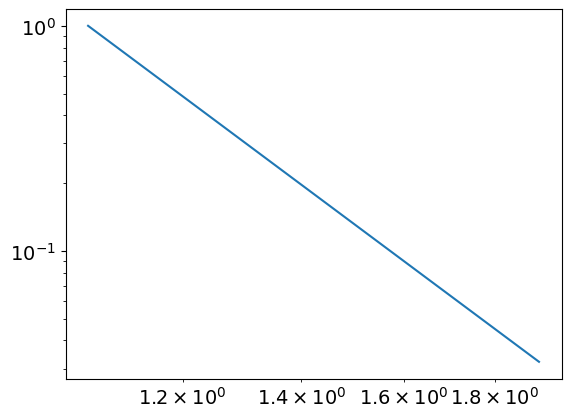

6.8689668844772624
1.0611368795018732
powerlaw KstestResult(statistic=0.9919206353436606, pvalue=0.0, statistic_location=1.4302664193386916, statistic_sign=1)
lognorm KstestResult(statistic=0.9859406087142697, pvalue=0.0, statistic_location=1.2498601650414363, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2103, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3056, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1672, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
243
tensor(4.6263e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


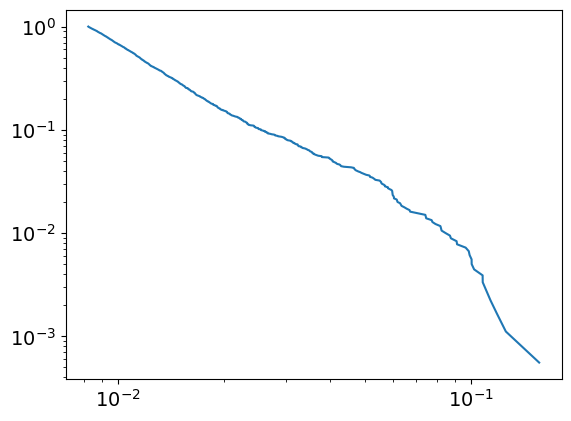

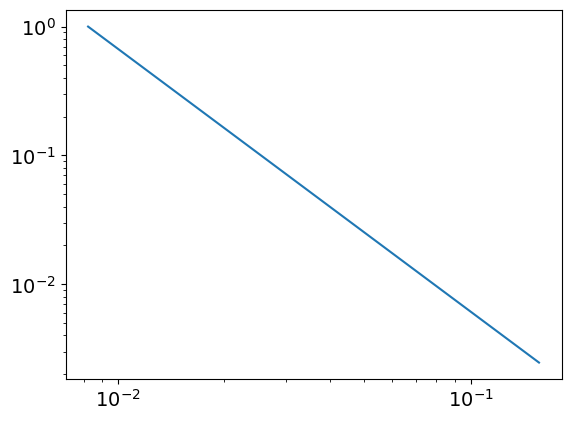

3.040684092688927
0.00823271863600633
powerlaw KstestResult(statistic=0.9989922043348225, pvalue=0.0, statistic_location=0.10216241950484467, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12566758505451894, statistic_sign=-1)
tensor(-1.0160e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.8078, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
243
tensor(0.1902, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


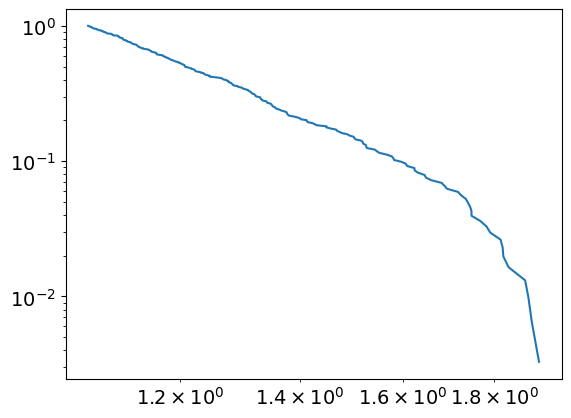

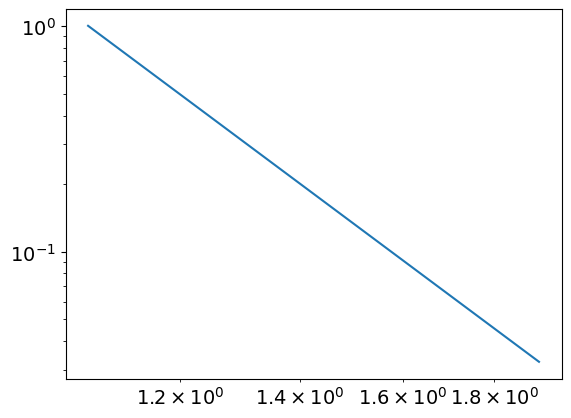

6.891461336252436
1.065529054015765
powerlaw KstestResult(statistic=0.9920196538630394, pvalue=0.0, statistic_location=1.4306494577402875, statistic_sign=1)
lognorm KstestResult(statistic=0.9859015153788903, pvalue=0.0, statistic_location=1.2463960255283506, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2103, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3069, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1730, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
244
tensor(4.5547e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


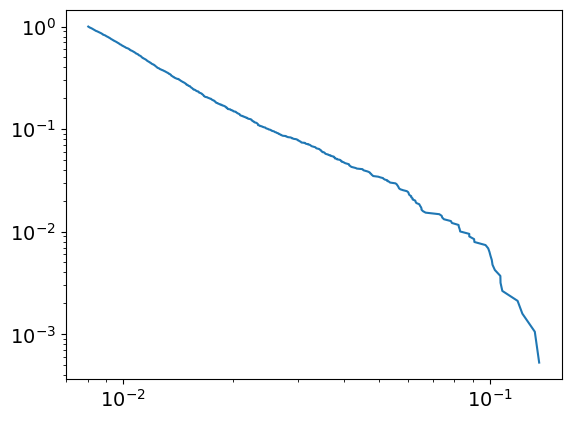

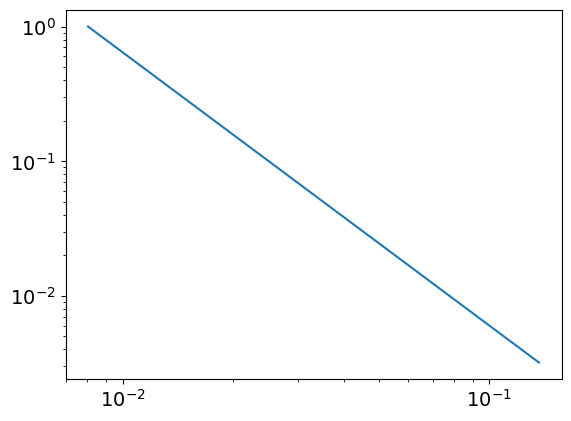

3.029158338738569
0.008036658340561926
powerlaw KstestResult(statistic=0.9989353971668392, pvalue=0.0, statistic_location=0.10338785417669827, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.136577102578707, statistic_sign=1)
tensor(3.0805e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2555, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.9329, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
244
tensor(0.1906, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


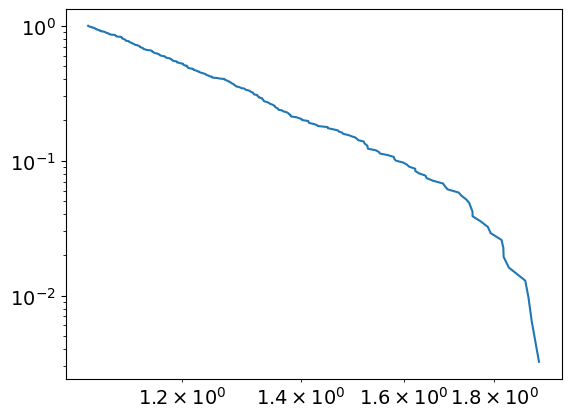

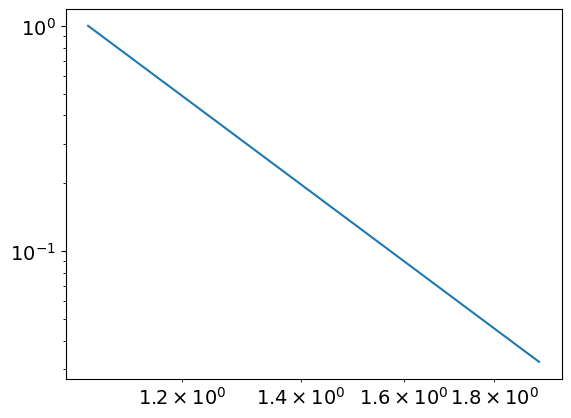

6.862643416934858
1.061858373427945
powerlaw KstestResult(statistic=0.9919113304456867, pvalue=0.0, statistic_location=1.4311172802010481, statistic_sign=1)
lognorm KstestResult(statistic=0.9858641719150418, pvalue=0.0, statistic_location=1.2481389937735747, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2104, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3083, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1789, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
245
tensor(4.2936e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


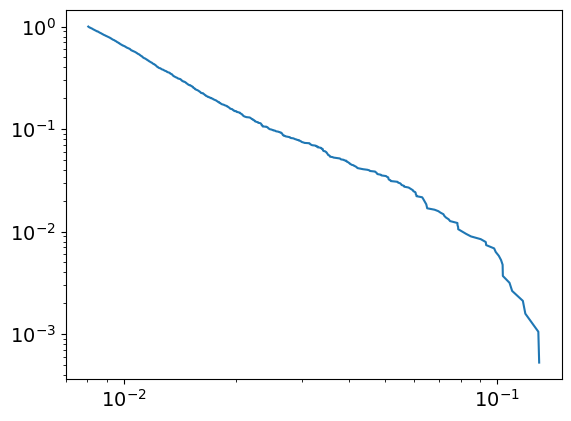

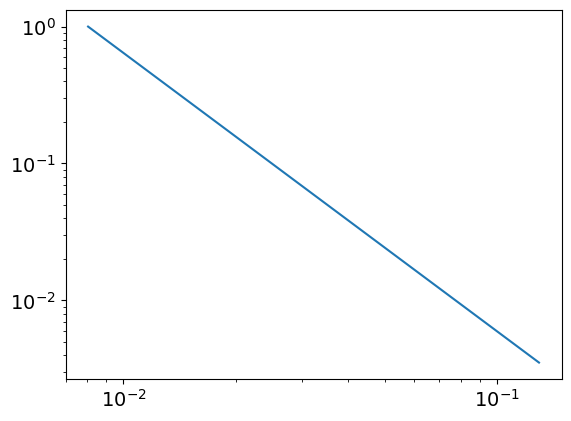

3.0340704168032557
0.008040087083177066
powerlaw KstestResult(statistic=0.9989443159432867, pvalue=0.0, statistic_location=0.10340591448573512, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1288003289348181, statistic_sign=1)
tensor(4.5319e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2237, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.6620, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
245
tensor(0.1909, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


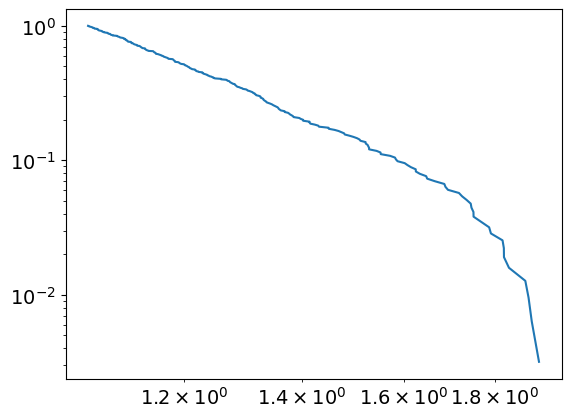

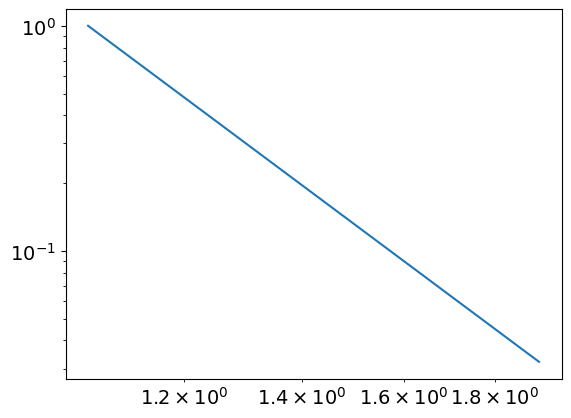

6.841568614275728
1.0590091709603322
powerlaw KstestResult(statistic=0.9918221477649986, pvalue=0.0, statistic_location=1.4314564186941738, statistic_sign=1)
lognorm KstestResult(statistic=0.9858211106215702, pvalue=0.0, statistic_location=1.2499318545325553, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2104, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3095, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1845, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
246
tensor(4.1116e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


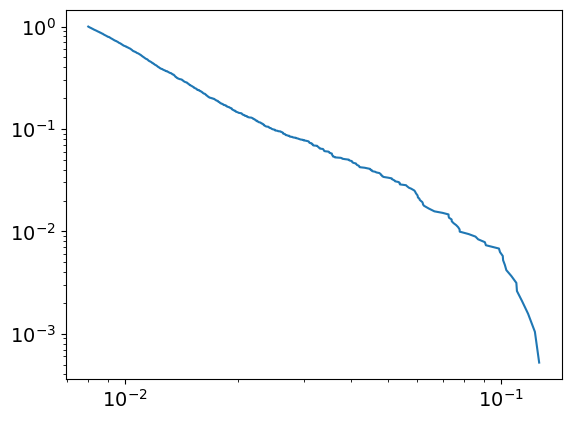

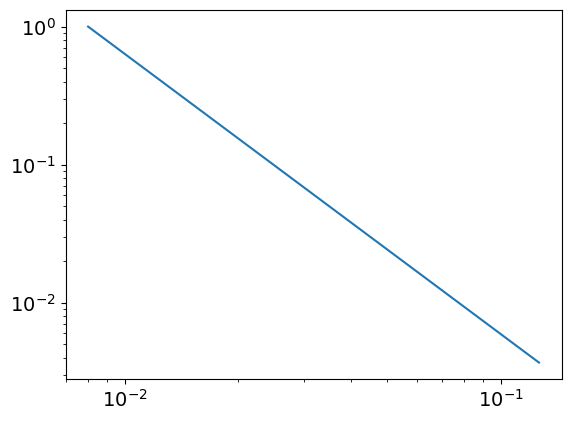

3.0296400829210133
0.007994854031862569
powerlaw KstestResult(statistic=0.9989286624559616, pvalue=0.0, statistic_location=0.08561792438192925, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.12645582854932869, statistic_sign=1)
tensor(3.5981e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2593, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.8134, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
246
tensor(0.1913, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


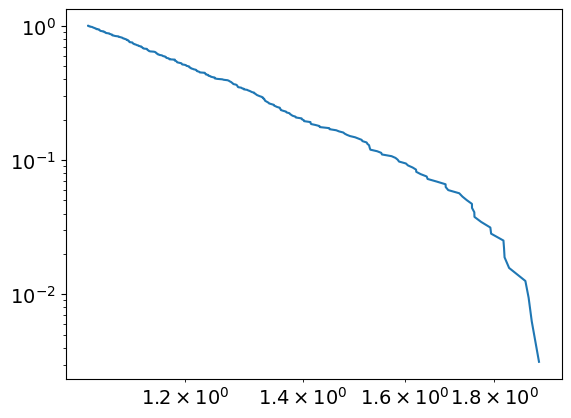

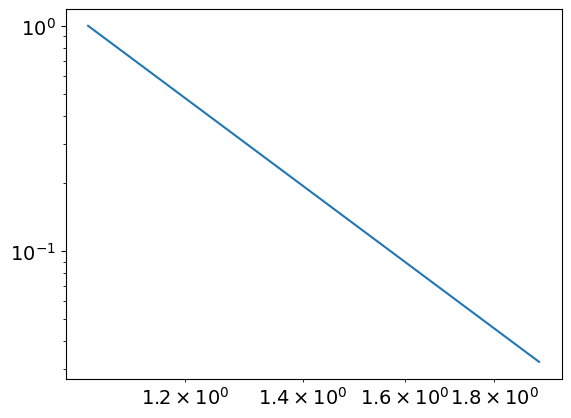

6.811392772658911
1.0570968217515528
powerlaw KstestResult(statistic=0.9917352458106193, pvalue=0.0, statistic_location=1.4318634571989688, statistic_sign=1)
lognorm KstestResult(statistic=0.985771652923586, pvalue=0.0, statistic_location=1.2517732343460986, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3108, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1902, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
247
tensor(4.0463e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


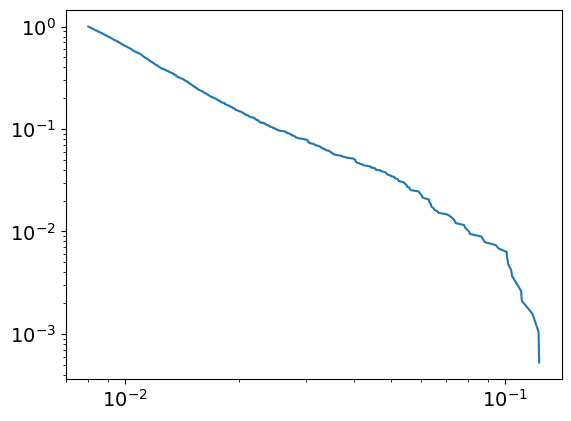

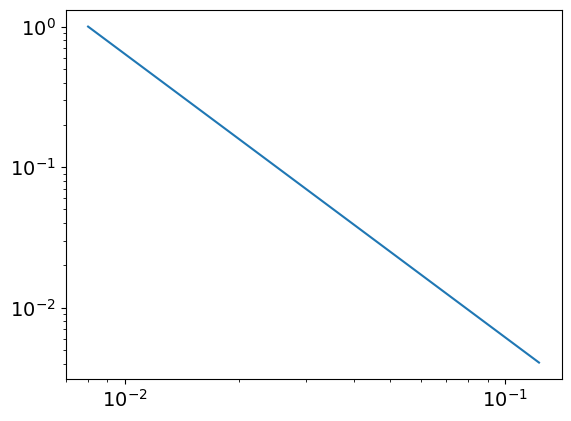

3.0153476977201157
0.008005463726686394
powerlaw KstestResult(statistic=0.9988979144636965, pvalue=0.0, statistic_location=0.10376246664853565, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12247013772813867, statistic_sign=-1)
tensor(-1.4648e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3780, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.0503, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
247
tensor(0.1916, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


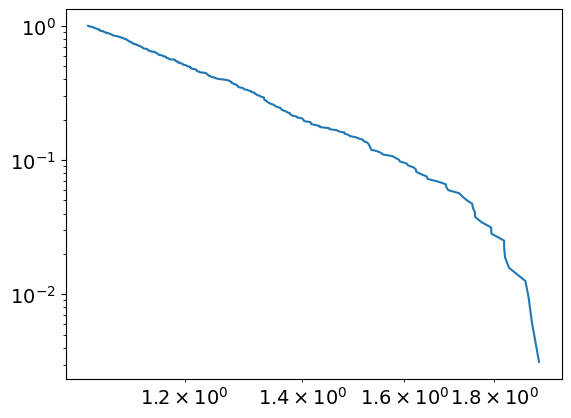

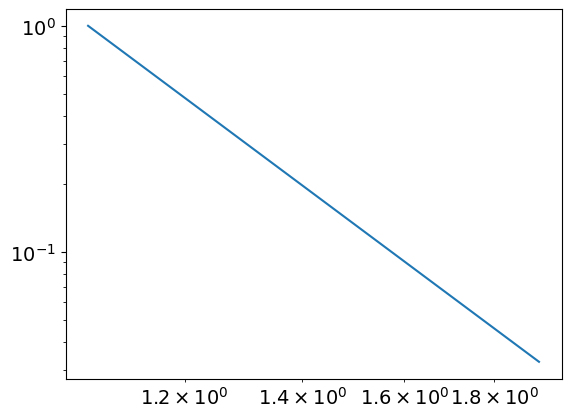

6.799604435087182
1.0574242558579638
powerlaw KstestResult(statistic=0.9917152925790846, pvalue=0.0, statistic_location=1.4324265187159355, statistic_sign=1)
lognorm KstestResult(statistic=0.9857199283373491, pvalue=0.0, statistic_location=1.2535298296441506, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3121, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1958, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
248
tensor(4.3848e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


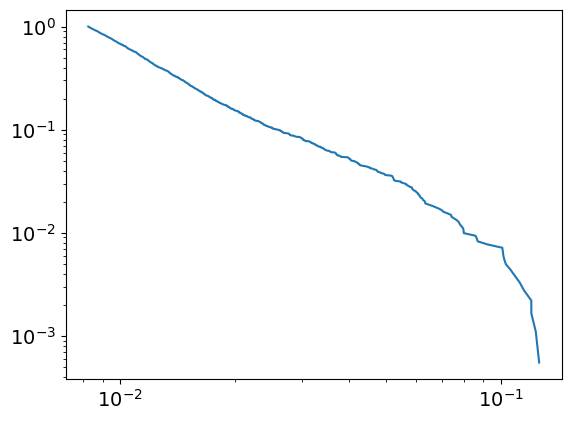

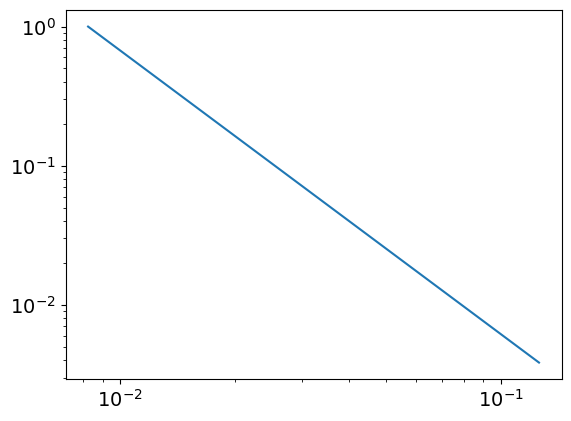

3.0380038990073945
0.008242116013676403
powerlaw KstestResult(statistic=0.9989383646259224, pvalue=0.0, statistic_location=0.08583315449523418, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12620069638144685, statistic_sign=-1)
tensor(-1.3036e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3810, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.5983, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
248
tensor(0.1920, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


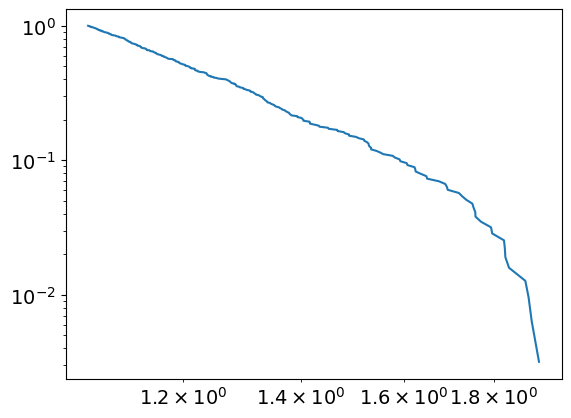

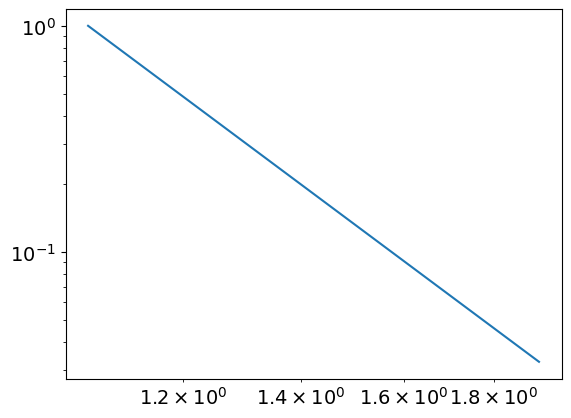

6.815776764468836
1.0604480290512677
powerlaw KstestResult(statistic=0.9917741838854969, pvalue=0.0, statistic_location=1.4337134237866316, statistic_sign=1)
lognorm KstestResult(statistic=0.9856577734518032, pvalue=0.0, statistic_location=1.2554067380379814, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2106, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3133, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2014, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


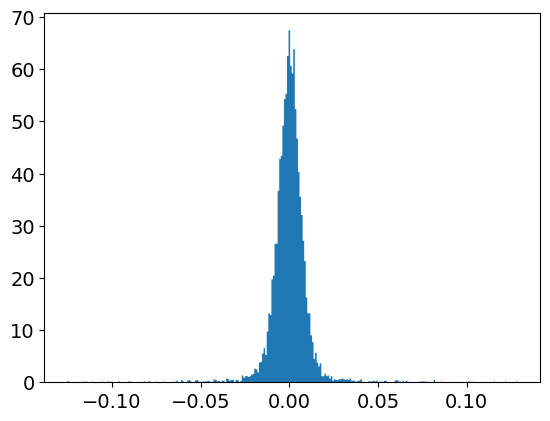

powerlaw
Calculating best minimal value for power law fit
9.618186504649245%
powerlaw KstestResult(statistic=0.999999999999999, pvalue=0.0, statistic_location=0.12883517059519778, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1253052000920538, statistic_sign=-1)



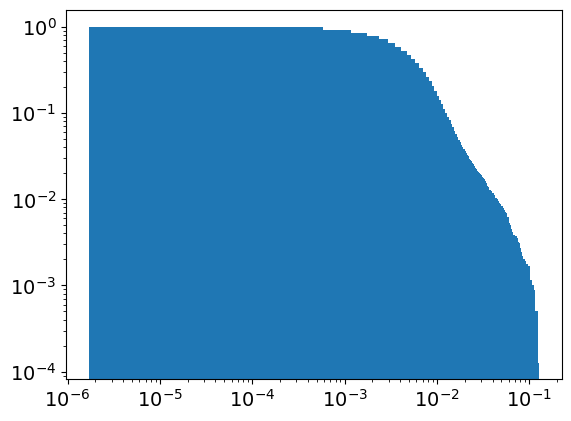

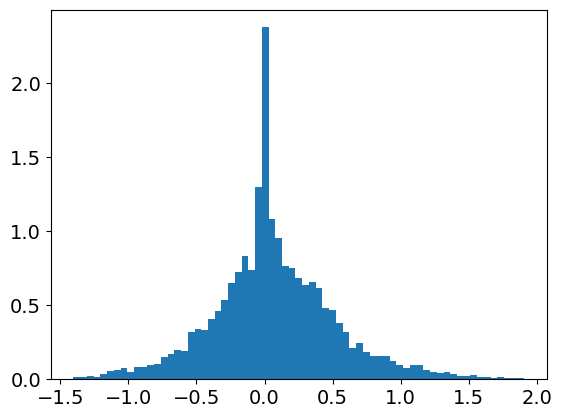

powerlaw
Calculating best minimal value for power law fit
5.927235801127729%
powerlaw KstestResult(statistic=0.9901471448420394, pvalue=0.0, statistic_location=1.3826866744297601, statistic_sign=1)
lognorm KstestResult(statistic=0.985607300314485, pvalue=0.0, statistic_location=1.2487039879802493, statistic_sign=1)



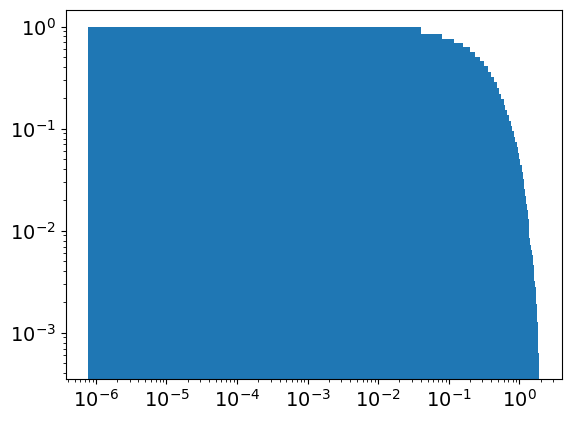

separation
epoch:
249
tensor(4.6835e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


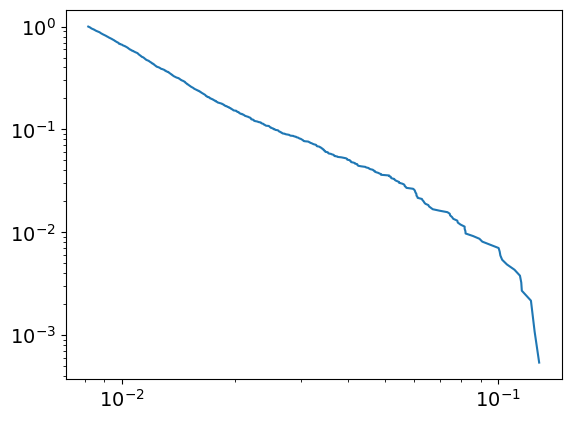

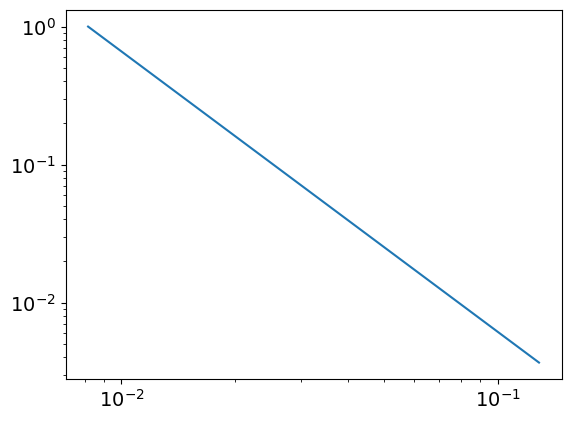

3.0317498032646584
0.008153242778115442
powerlaw KstestResult(statistic=0.9989277655769881, pvalue=0.0, statistic_location=0.08596751390707985, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1253052000920538, statistic_sign=-1)
tensor(-2.2466e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3961, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.0039, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
249
tensor(0.1924, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


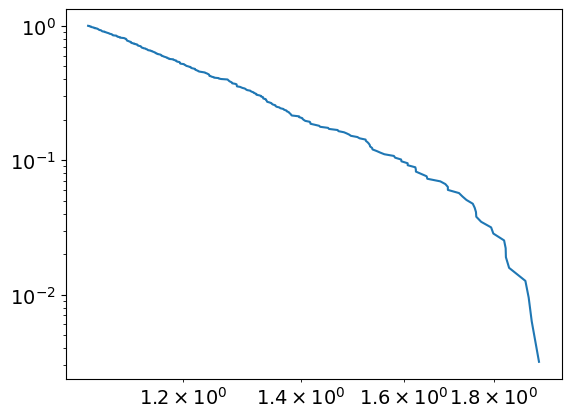

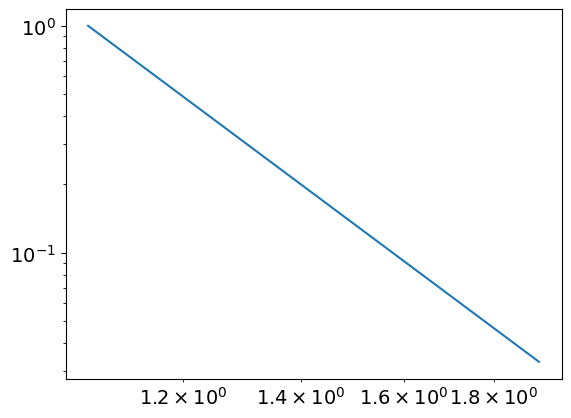

6.791559234337299
1.05978405833437
powerlaw KstestResult(statistic=0.9917025529701392, pvalue=0.0, statistic_location=1.4349020149826395, statistic_sign=1)
lognorm KstestResult(statistic=0.985607300314485, pvalue=0.0, statistic_location=1.2487039879802493, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2107, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3146, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2069, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
250
tensor(5.2371e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


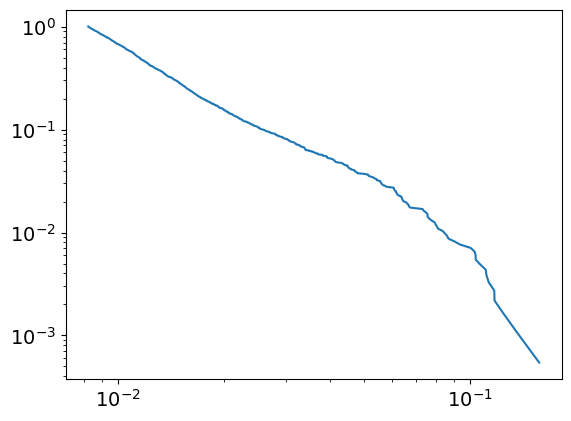

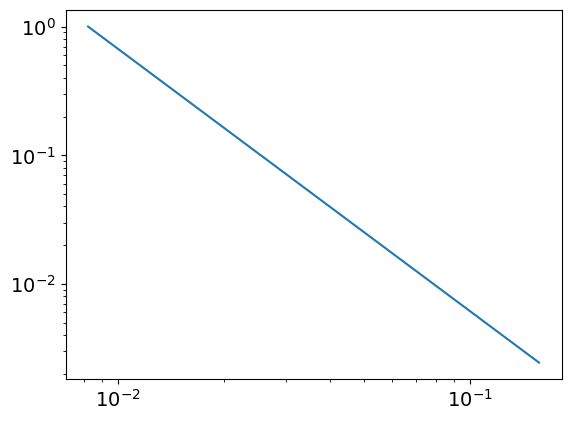

3.039542992867151
0.008226319530810301
powerlaw KstestResult(statistic=0.9989378106724837, pvalue=0.0, statistic_location=0.08595124617768583, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13520659848567407, statistic_sign=-1)
tensor(-2.5374e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3245, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5117, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
250
tensor(0.1927, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


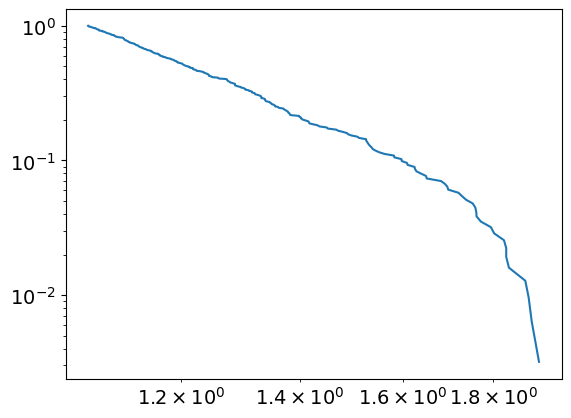

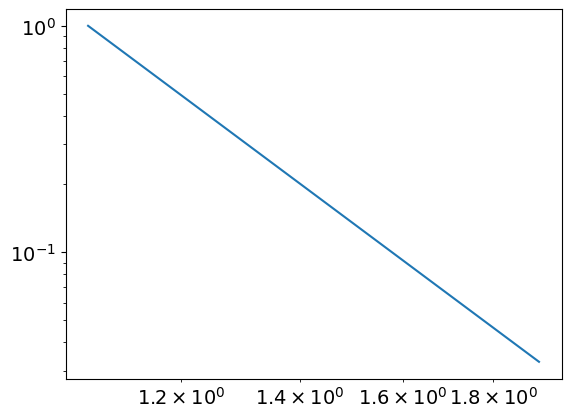

6.837600613082579
1.0636724875238488
powerlaw KstestResult(statistic=0.9918174715876577, pvalue=0.0, statistic_location=1.4361249238773426, statistic_sign=1)
lognorm KstestResult(statistic=0.9856024018751511, pvalue=0.0, statistic_location=1.2489996021523981, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2107, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3158, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2122, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
251
tensor(4.7599e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


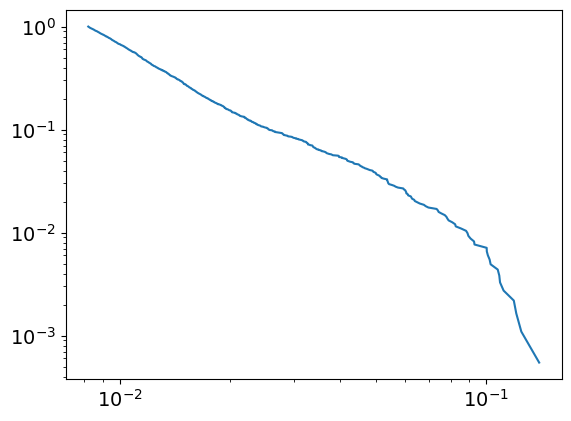

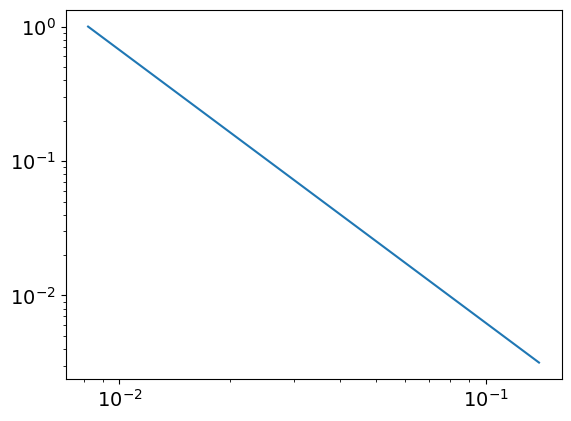

3.031378563900545
0.00821697956891972
powerlaw KstestResult(statistic=0.9988665413099228, pvalue=0.0, statistic_location=0.0894645190176864, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12477649995335288, statistic_sign=-1)
tensor(-1.3563e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4082, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.7029, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
251
tensor(0.1931, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


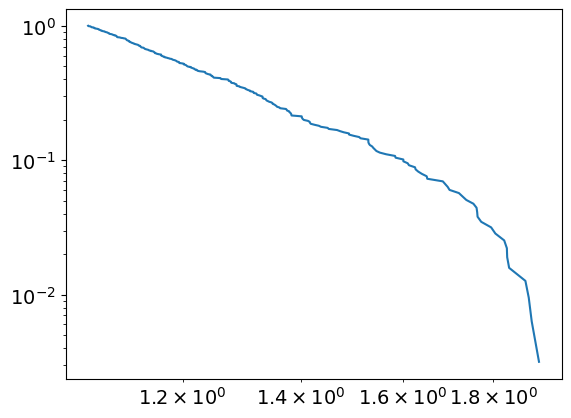

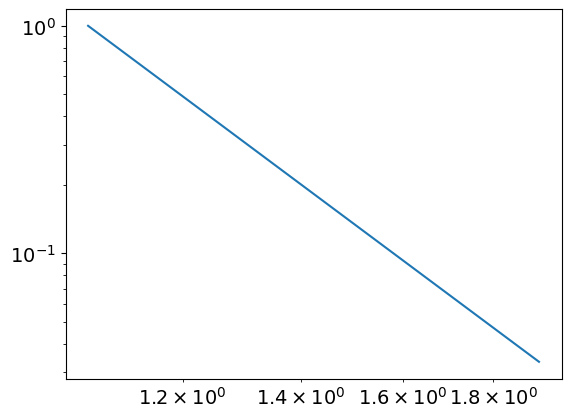

6.783350611588463
1.0609616244303335
powerlaw KstestResult(statistic=0.9916720478987102, pvalue=0.0, statistic_location=1.4183117673572203, statistic_sign=1)
lognorm KstestResult(statistic=0.9855942749189949, pvalue=0.0, statistic_location=1.2493908117895922, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2108, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3170, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2176, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
252
tensor(4.3803e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


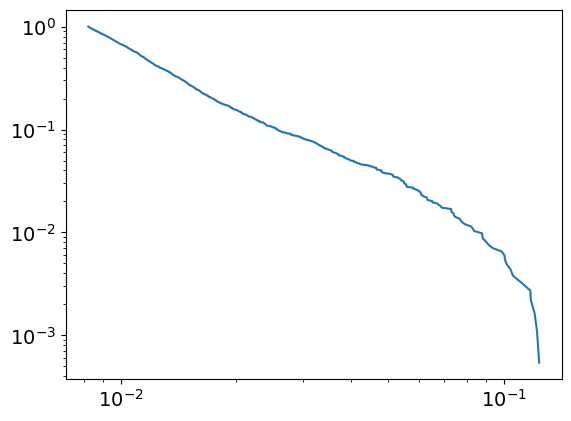

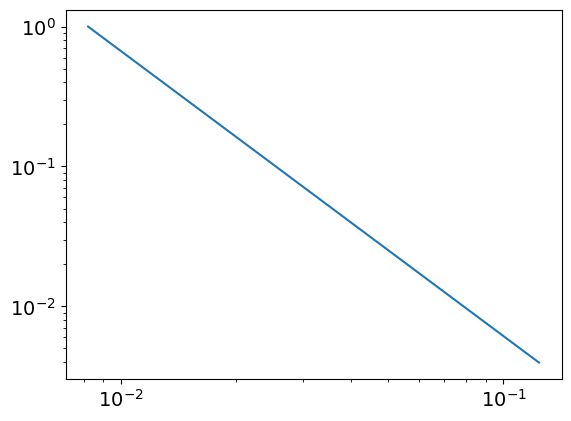

3.0394245646863753
0.00822072728699718
powerlaw KstestResult(statistic=0.9989354063233485, pvalue=0.0, statistic_location=0.10433149470998045, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.12223885441514842, statistic_sign=1)
tensor(9.3230e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2973, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.0353, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
252
tensor(0.1935, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


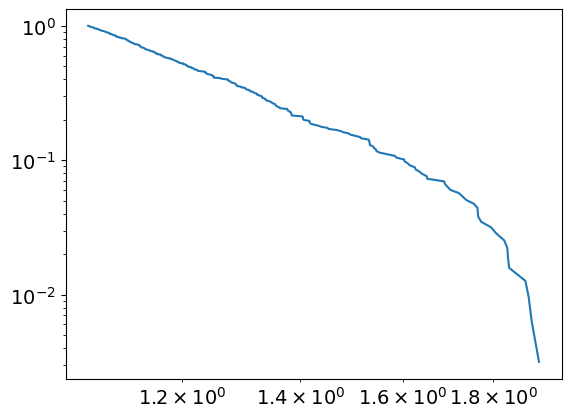

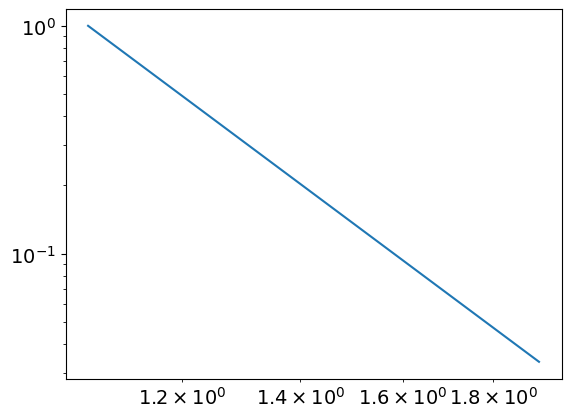

6.7790340860992115
1.06153997158121
powerlaw KstestResult(statistic=0.991672920662388, pvalue=0.0, statistic_location=1.4254470751002375, statistic_sign=1)
lognorm KstestResult(statistic=0.9855748876470676, pvalue=0.0, statistic_location=1.250215171721083, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2108, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3183, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2229, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
253
tensor(4.4209e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


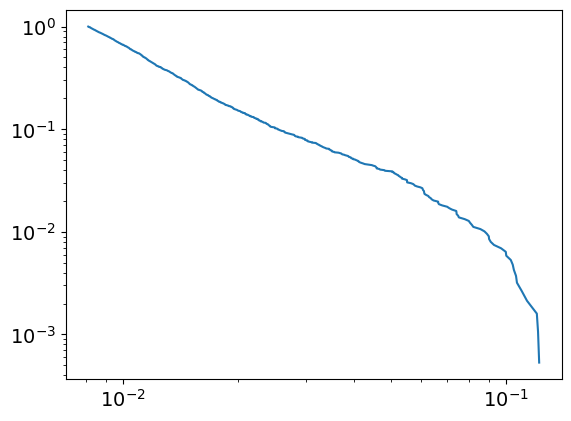

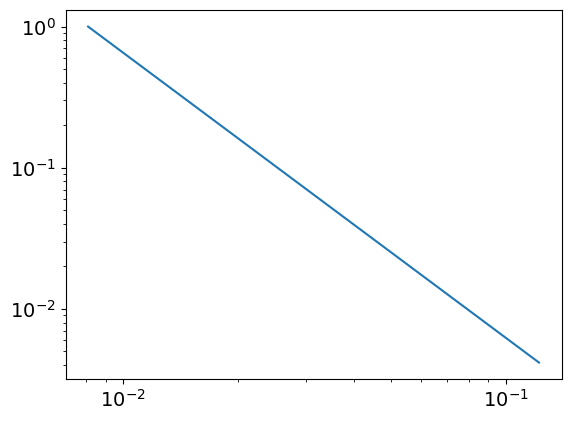

3.021572515050649
0.008104798828724395
powerlaw KstestResult(statistic=0.9988331645925578, pvalue=0.0, statistic_location=0.10670041909483023, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.12194030794289396, statistic_sign=1)
tensor(1.0153e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1921, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.5428, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
253
tensor(0.1938, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


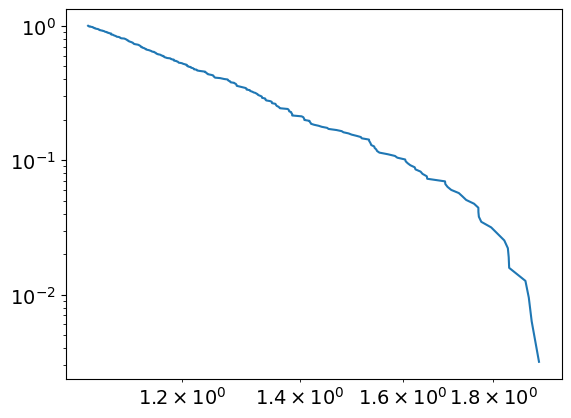

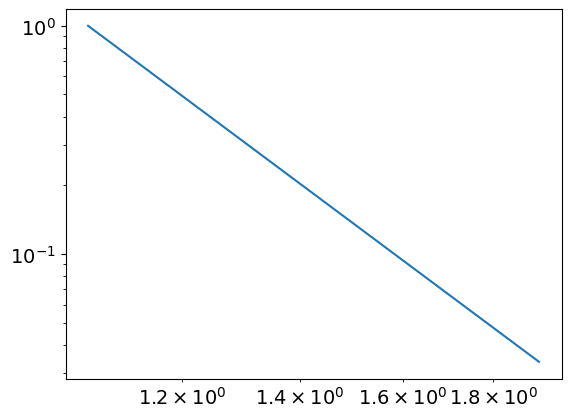

6.774445229023147
1.062054480023647
powerlaw KstestResult(statistic=0.991675983171622, pvalue=0.0, statistic_location=1.4255567164723997, statistic_sign=1)
lognorm KstestResult(statistic=0.9854944827898235, pvalue=0.0, statistic_location=1.2530999781565264, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2109, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3195, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2282, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
254
tensor(4.6966e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


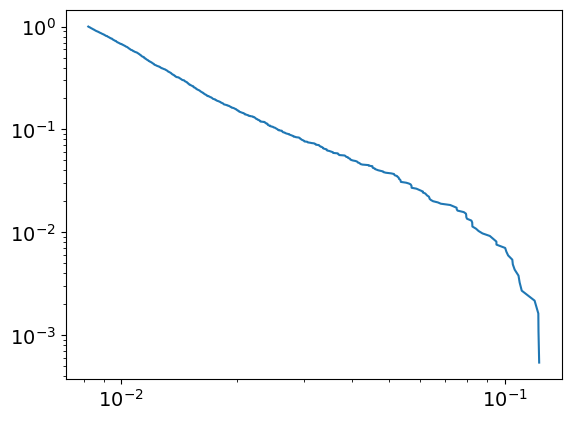

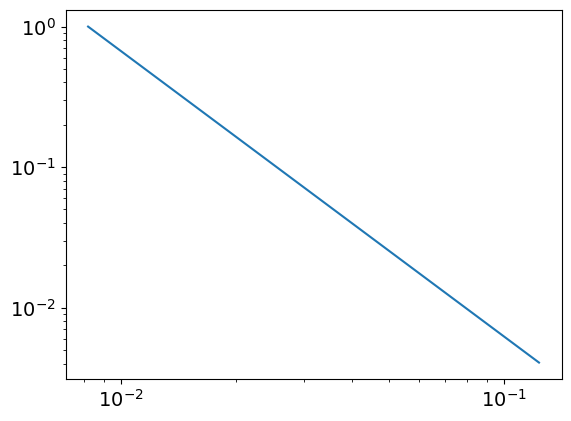

3.032725858454907
0.008200362596761674
powerlaw KstestResult(statistic=0.9989109742042269, pvalue=0.0, statistic_location=0.10475728022577158, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12309394321778204, statistic_sign=-1)
tensor(-2.7118e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4985, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.0977, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
254
tensor(0.1942, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


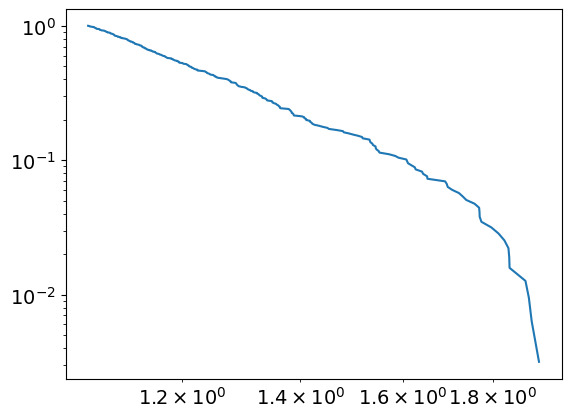

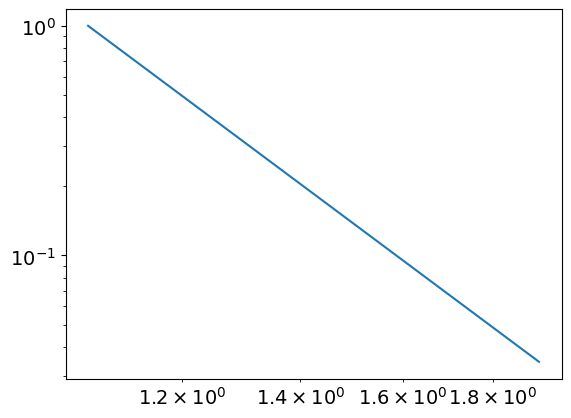

6.725836113454771
1.0612005343354936
powerlaw KstestResult(statistic=0.9916013653854081, pvalue=0.0, statistic_location=1.4257438179206765, statistic_sign=1)
lognorm KstestResult(statistic=0.9853969277468065, pvalue=0.0, statistic_location=1.25603867914177, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2109, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3207, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2334, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
255
tensor(4.1086e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


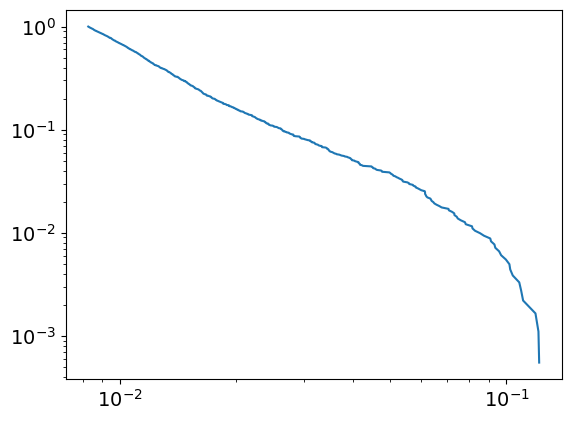

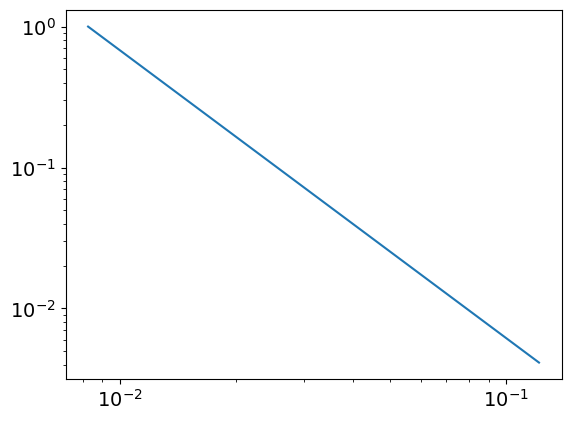

3.042309035820117
0.008269006425981423
powerlaw KstestResult(statistic=0.9989542161517393, pvalue=0.0, statistic_location=0.10385192581665624, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12155552765075064, statistic_sign=-1)
tensor(-2.0177e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3426, device='cuda:0', grad_fn=<MeanBackward0>) tensor(27.7458, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
255
tensor(0.1945, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


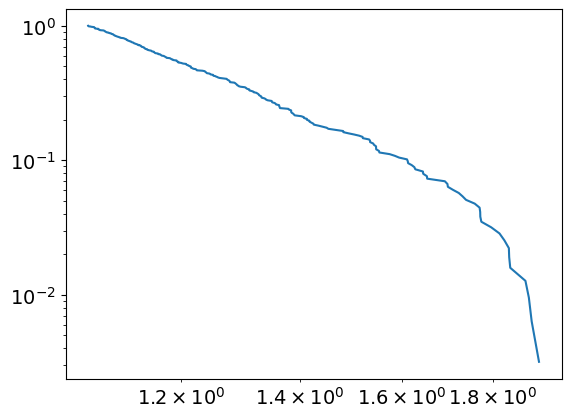

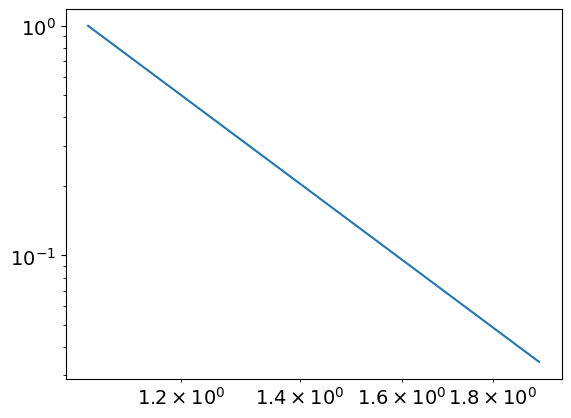

6.743515371617747
1.0630218071069955
powerlaw KstestResult(statistic=0.9916556135375639, pvalue=0.0, statistic_location=1.4258696253158445, statistic_sign=1)
lognorm KstestResult(statistic=0.9852840244149604, pvalue=0.0, statistic_location=1.2589085740509958, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2110, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3220, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2386, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
256
tensor(4.8125e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


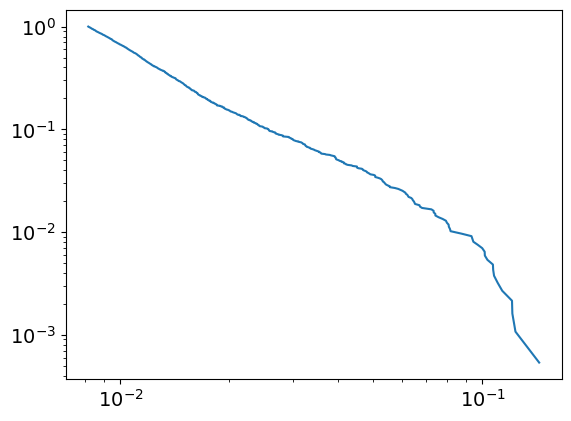

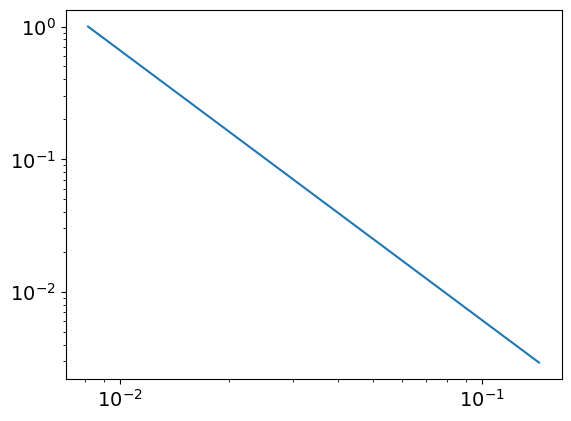

3.0345839661898517
0.008149872615829987
powerlaw KstestResult(statistic=0.9986975315997176, pvalue=0.0, statistic_location=0.10322585475497775, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1233854326592496, statistic_sign=-1)
tensor(-9.5656e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0584, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.3714, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
256
tensor(0.1949, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


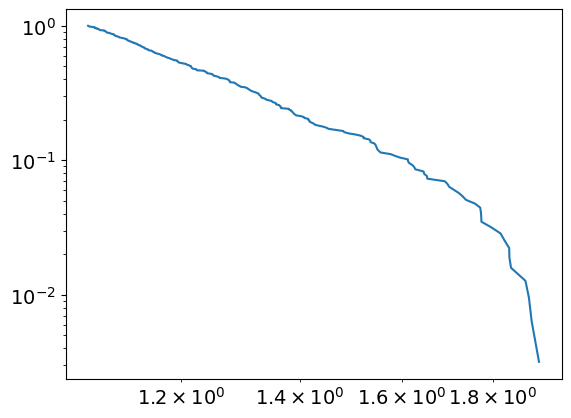

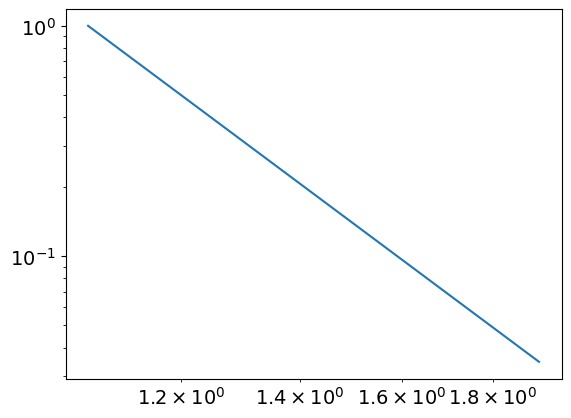

6.7283329781177414
1.0632858919993242
powerlaw KstestResult(statistic=0.9916024576364749, pvalue=0.0, statistic_location=1.4279132205201015, statistic_sign=1)
lognorm KstestResult(statistic=0.985145600853624, pvalue=0.0, statistic_location=1.2618819887320714, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2111, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3232, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2438, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
257
tensor(4.4983e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


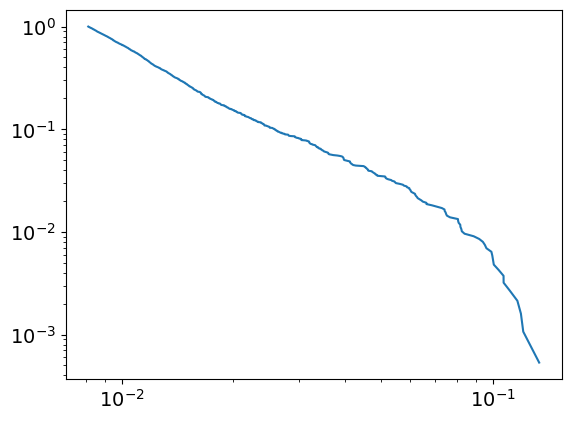

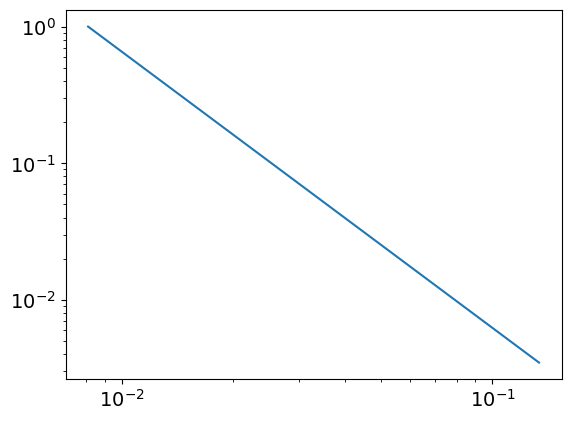

3.0226948169783783
0.008124867416511174
powerlaw KstestResult(statistic=0.9987880801024928, pvalue=0.0, statistic_location=0.10375829563924453, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13349840691965145, statistic_sign=-1)
tensor(-1.9119e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2666, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.2087, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
257
tensor(0.1953, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


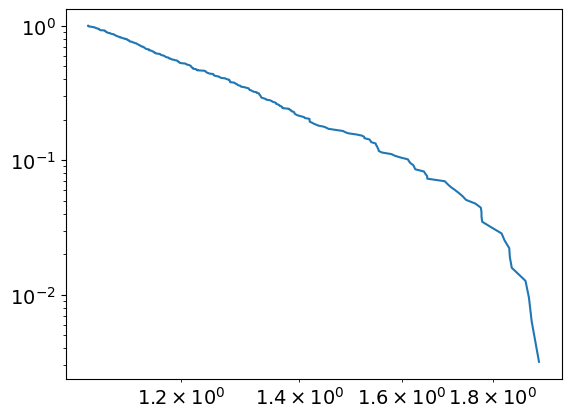

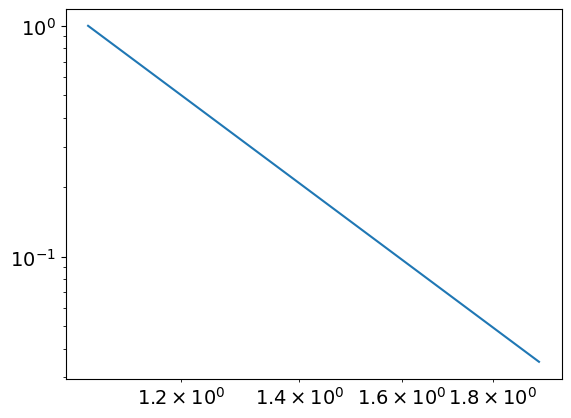

6.7126578010979205
1.0634800294489002
powerlaw KstestResult(statistic=0.9915519893558223, pvalue=0.0, statistic_location=1.4352835556524655, statistic_sign=1)
lognorm KstestResult(statistic=0.98498465957524, pvalue=0.0, statistic_location=1.2648261475790665, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2111, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3245, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2490, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
258
tensor(4.4731e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


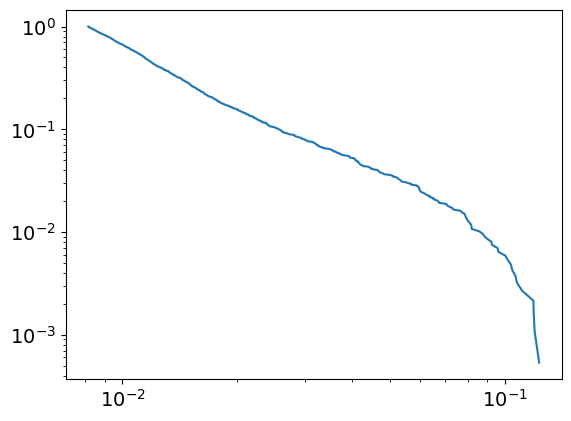

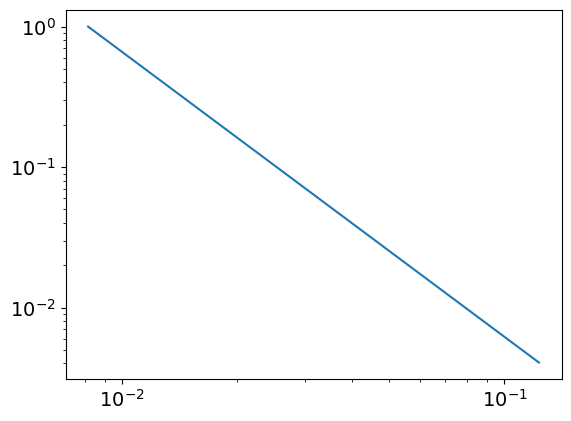

3.027033580968619
0.008141626884998246
powerlaw KstestResult(statistic=0.9987734973156075, pvalue=0.0, statistic_location=0.10465153588615689, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12315822592788497, statistic_sign=-1)
tensor(-9.6266e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1378, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.8560, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
258
tensor(0.1956, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


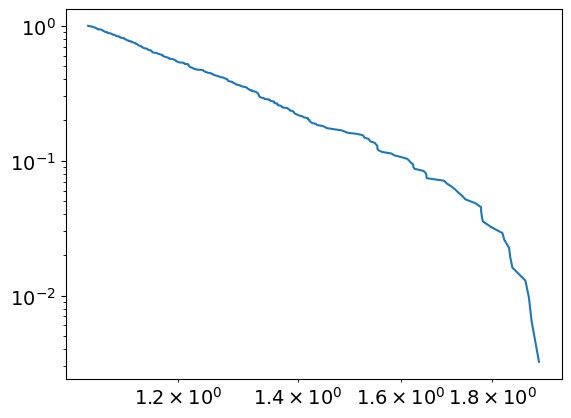

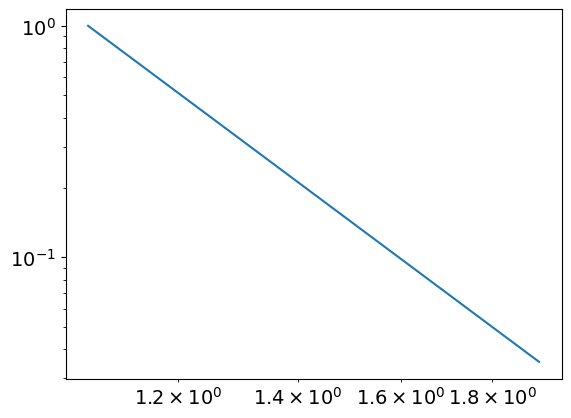

6.736106172968026
1.0678713244372526
powerlaw KstestResult(statistic=0.9916761115626849, pvalue=0.0, statistic_location=1.4354635545481769, statistic_sign=1)
lognorm KstestResult(statistic=0.9849159280149711, pvalue=0.0, statistic_location=1.258737001524555, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2112, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3257, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2540, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
259
tensor(4.3067e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


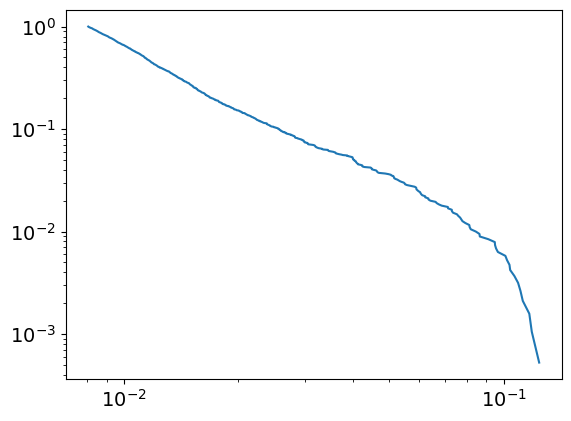

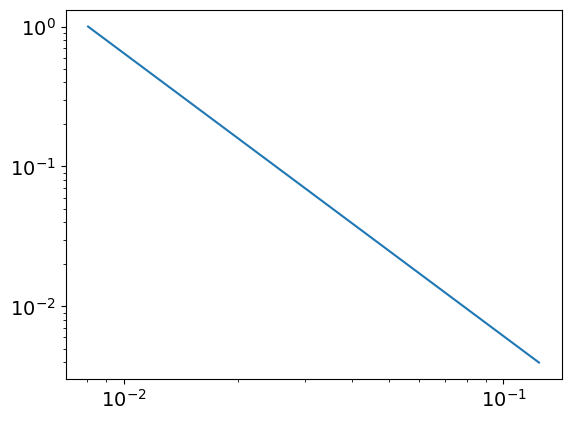

3.022157097254953
0.008053252536097026
powerlaw KstestResult(statistic=0.9989050889830464, pvalue=0.0, statistic_location=0.10404716203145044, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1168429823056893, statistic_sign=-1)
tensor(-1.8939e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2130, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.5182, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
259
tensor(0.1960, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


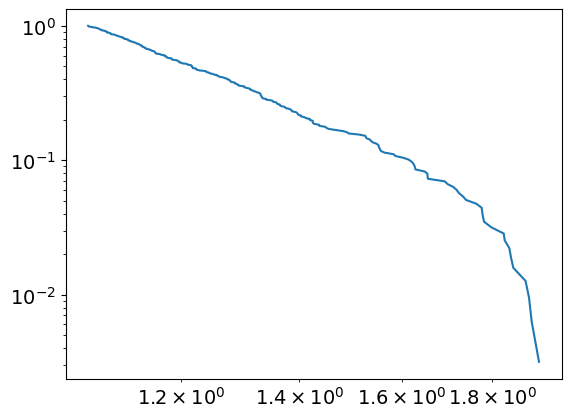

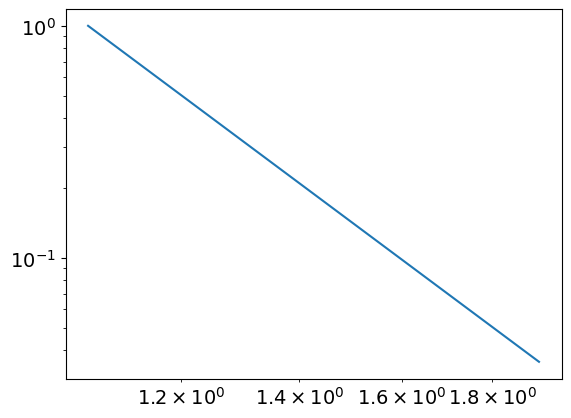

6.676188475532508
1.0630218082335499
powerlaw KstestResult(statistic=0.9914583367363105, pvalue=0.0, statistic_location=1.436679779371914, statistic_sign=1)
lognorm KstestResult(statistic=0.9848525522370136, pvalue=0.0, statistic_location=1.2602093300806059, statistic_sign=1)
tensor(0.0679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2113, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3270, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2590, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
260
tensor(4.8058e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


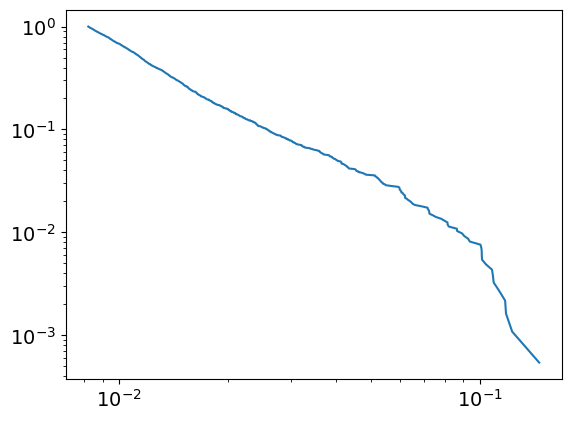

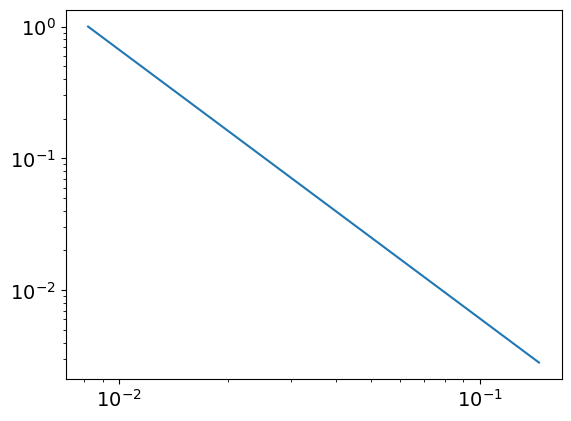

3.0389977633099714
0.008206227103492914
powerlaw KstestResult(statistic=0.9988149108084534, pvalue=0.0, statistic_location=0.10400901548191979, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11815840667467452, statistic_sign=-1)
tensor(-1.4744e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0149, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.4609, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
260
tensor(0.1963, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


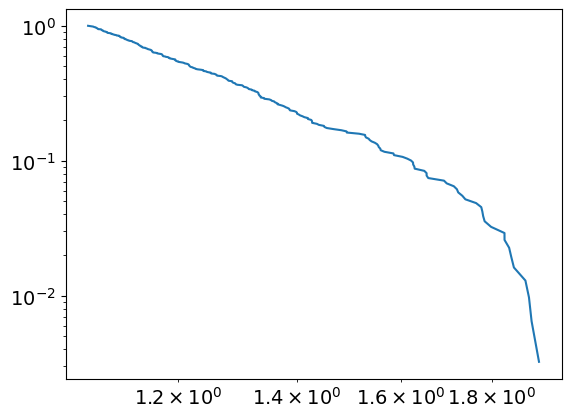

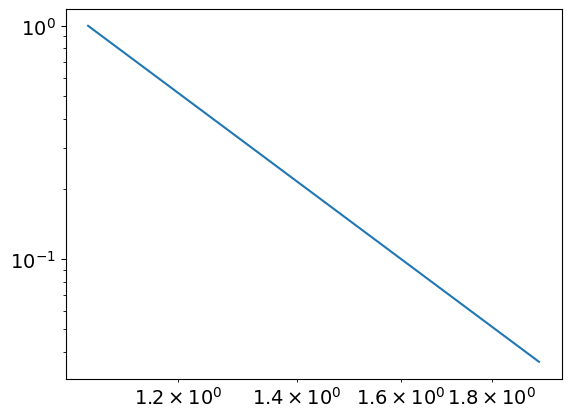

6.6984988791633215
1.0686531181542922
powerlaw KstestResult(statistic=0.9915637600957385, pvalue=0.0, statistic_location=1.4272232017775157, statistic_sign=1)
lognorm KstestResult(statistic=0.9847469040412528, pvalue=0.0, statistic_location=1.2623999967235677, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2113, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3282, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2640, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
261
tensor(4.8187e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


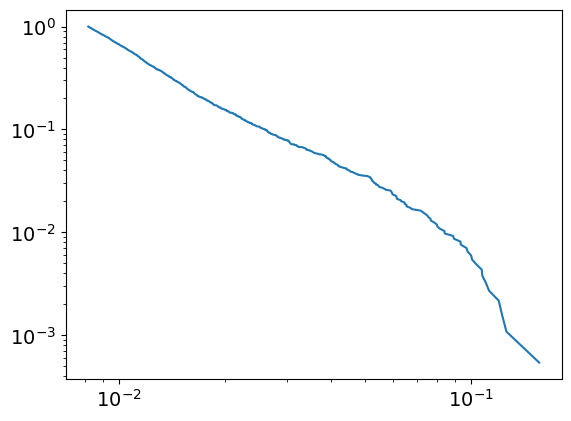

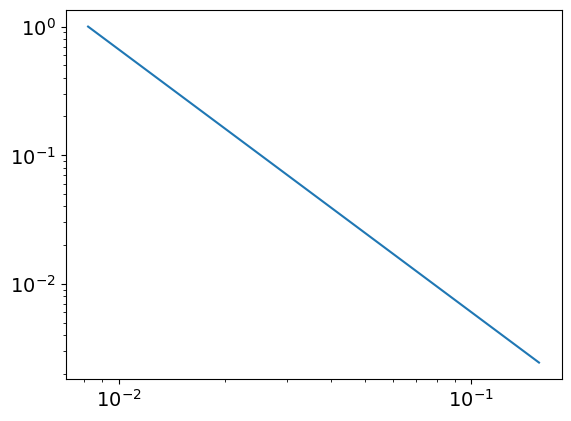

3.0421455206827943
0.008198159504251188
powerlaw KstestResult(statistic=0.9988344907630817, pvalue=0.0, statistic_location=0.10345704883917377, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15585909083512736, statistic_sign=1)
tensor(1.2916e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2308, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.2718, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
261
tensor(0.1967, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


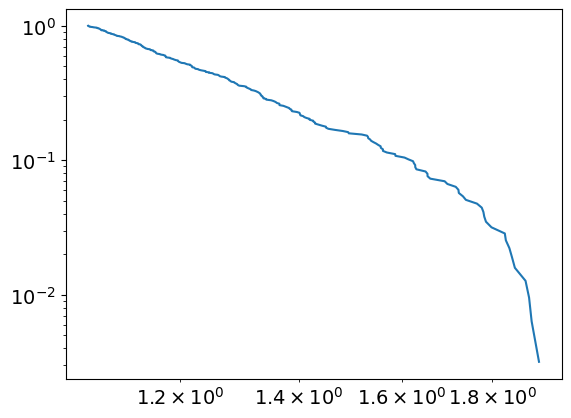

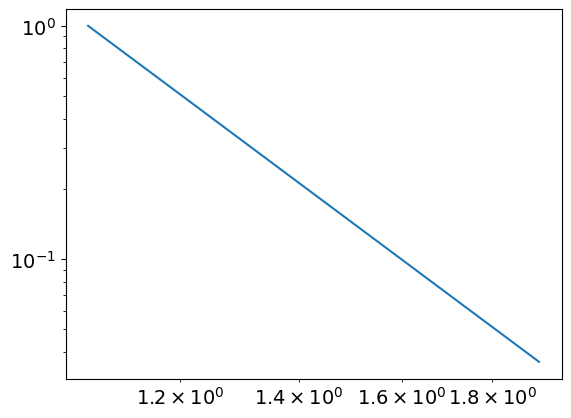

6.654787391816642
1.06420959197331
powerlaw KstestResult(statistic=0.9913633126925662, pvalue=0.0, statistic_location=1.4299458461467471, statistic_sign=1)
lognorm KstestResult(statistic=0.9845853249957961, pvalue=0.0, statistic_location=1.2630787016059792, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2114, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3295, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2691, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
262
tensor(4.1149e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


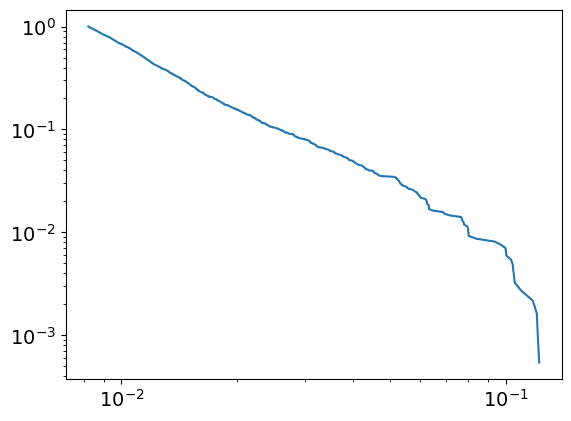

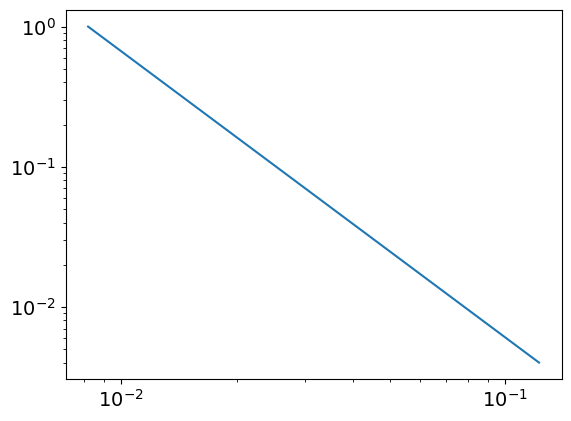

3.0424839223615514
0.008198023265525782
powerlaw KstestResult(statistic=0.9988114554312456, pvalue=0.0, statistic_location=0.10439438848961173, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.12116801879985775, statistic_sign=1)
tensor(2.7353e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0545, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.6752, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
262
tensor(0.1970, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


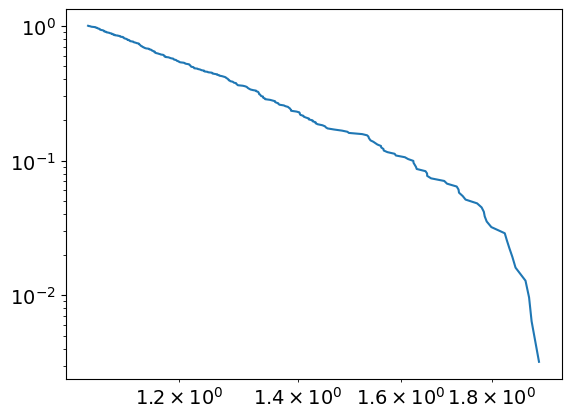

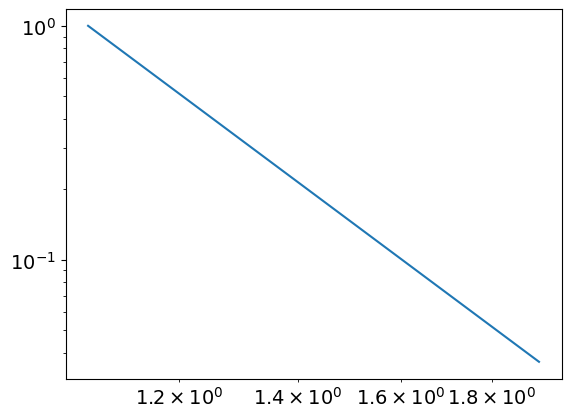

6.661368599563453
1.0669095599670566
powerlaw KstestResult(statistic=0.991415063575528, pvalue=0.0, statistic_location=1.4549286858125563, statistic_sign=1)
lognorm KstestResult(statistic=0.9844916563143005, pvalue=0.0, statistic_location=1.2647903174133714, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2114, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3307, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2737, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
263
tensor(4.1911e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


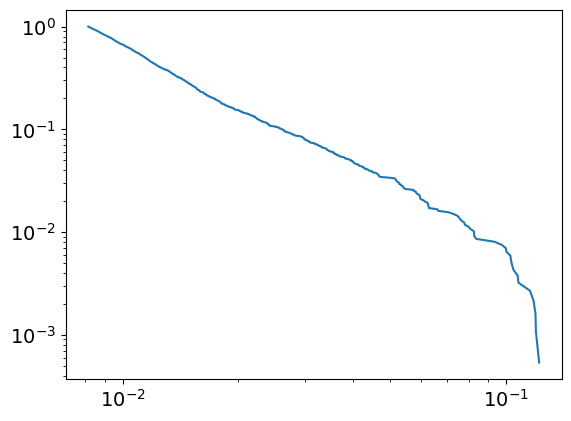

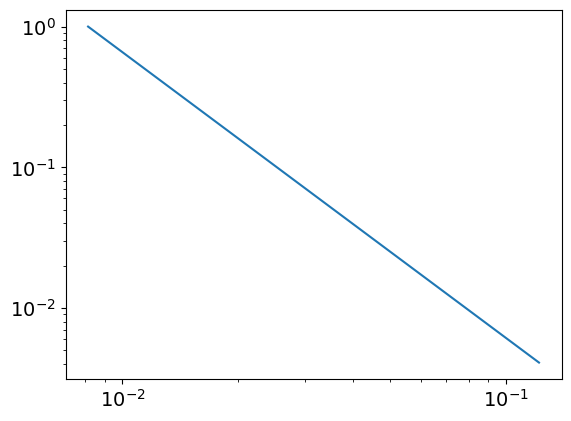

3.0305126187699525
0.008135787137702915
powerlaw KstestResult(statistic=0.9988049329965609, pvalue=0.0, statistic_location=0.1037003897807487, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12213924919299264, statistic_sign=-1)
tensor(-1.9125e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2139, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.0605, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
263
tensor(0.1974, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


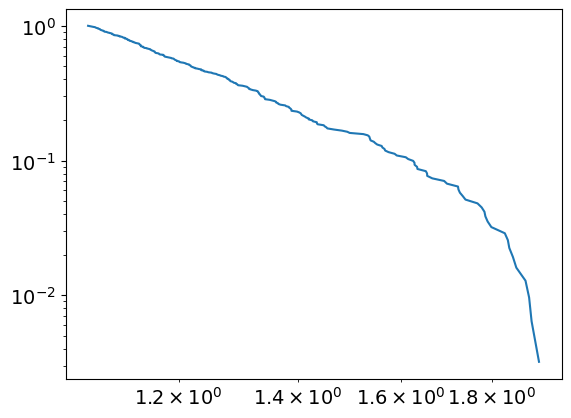

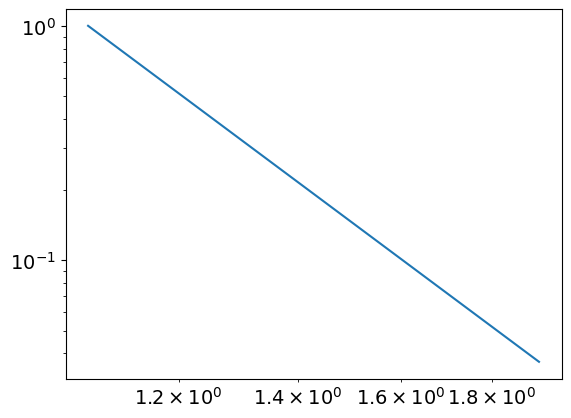

6.656700947947066
1.067439231859554
powerlaw KstestResult(statistic=0.9914176128727806, pvalue=0.0, statistic_location=1.4551194371833254, statistic_sign=1)
lognorm KstestResult(statistic=0.9843846420366985, pvalue=0.0, statistic_location=1.256269408197906, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3320, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2788, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
264
tensor(4.2055e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


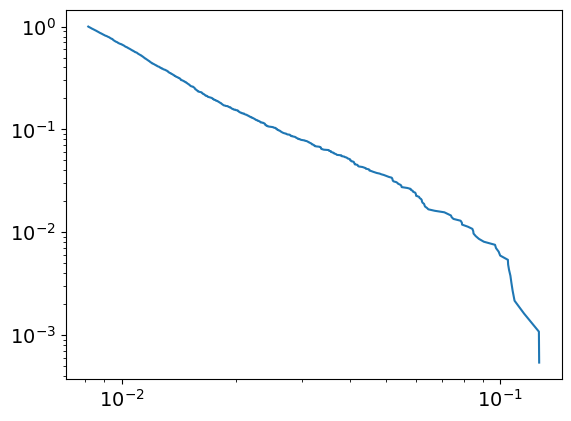

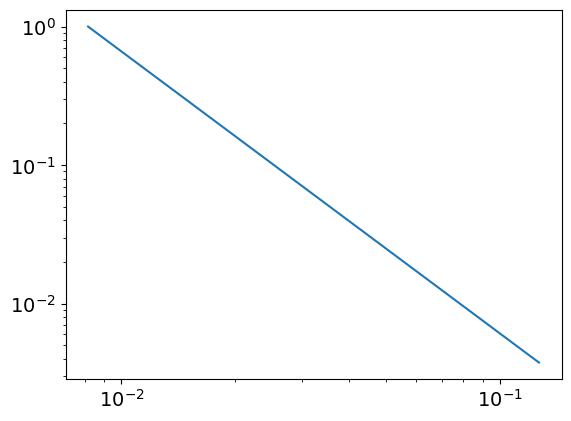

3.036504254035165
0.008163313763856678
powerlaw KstestResult(statistic=0.9989294373797701, pvalue=0.0, statistic_location=0.10900256163381077, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1263915296954175, statistic_sign=-1)
tensor(-3.9290e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1573, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.7049, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
264
tensor(0.1978, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


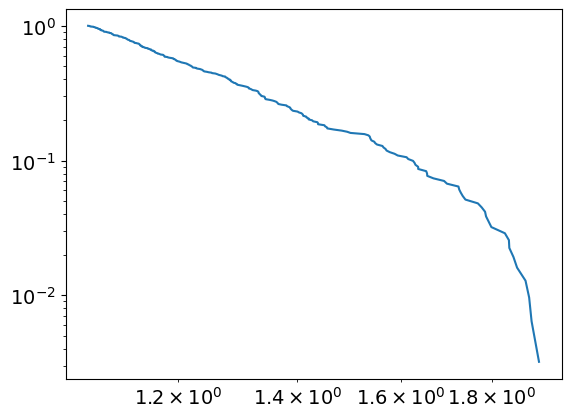

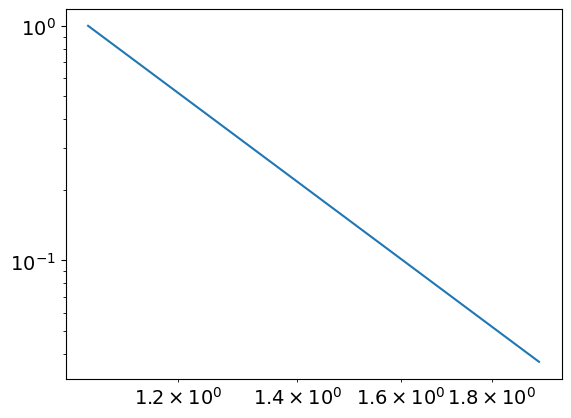

6.651467480641582
1.0679153641403574
powerlaw KstestResult(statistic=0.9914166709820978, pvalue=0.0, statistic_location=1.4553367350115027, statistic_sign=1)
lognorm KstestResult(statistic=0.9843725274290959, pvalue=0.0, statistic_location=1.2528056000094074, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2116, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3332, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2836, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
265
tensor(4.3875e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


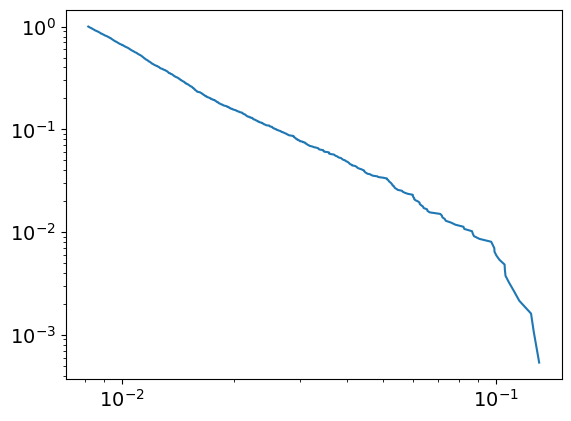

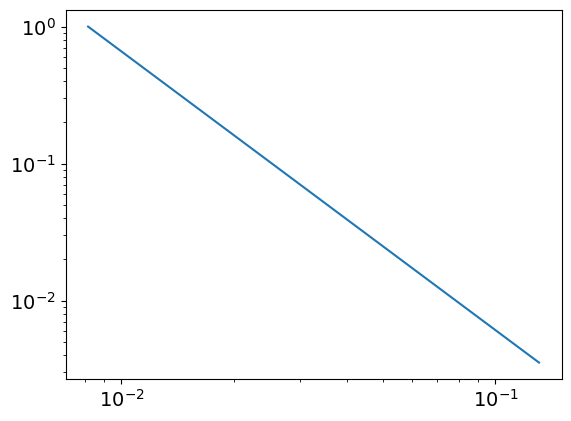

3.0338038925514077
0.008147309579717148
powerlaw KstestResult(statistic=0.9988712278631966, pvalue=0.0, statistic_location=0.10627902989895276, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12436865153506771, statistic_sign=-1)
tensor(-1.6627e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2338, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.1587, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
265
tensor(0.1981, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


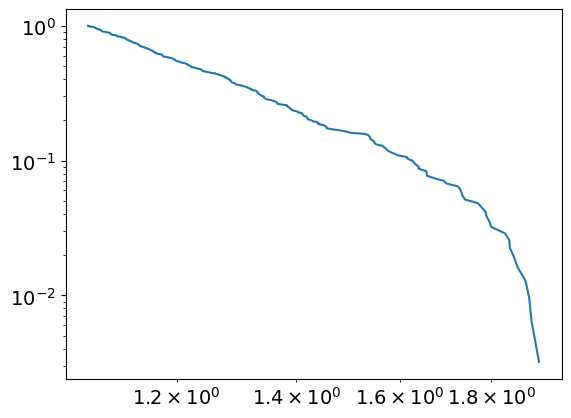

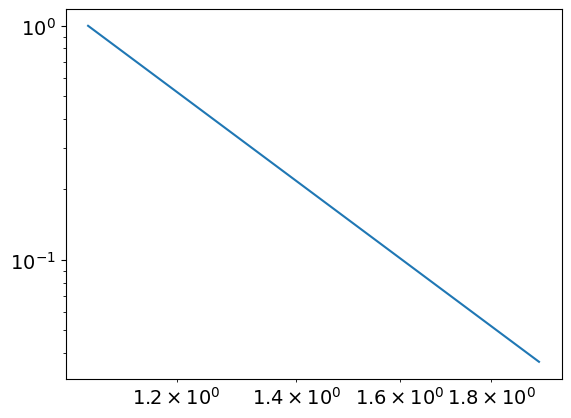

6.687936958697865
1.0703773040547437
powerlaw KstestResult(statistic=0.9915381599403891, pvalue=0.0, statistic_location=1.455812207653252, statistic_sign=1)
lognorm KstestResult(statistic=0.9843689484687229, pvalue=0.0, statistic_location=1.252961483711709, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2116, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3345, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2883, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
266
tensor(4.5813e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


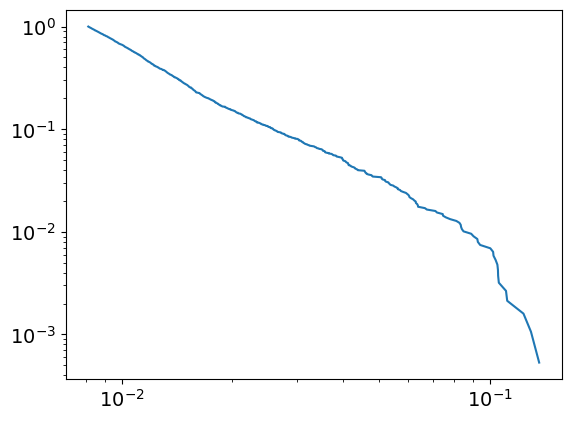

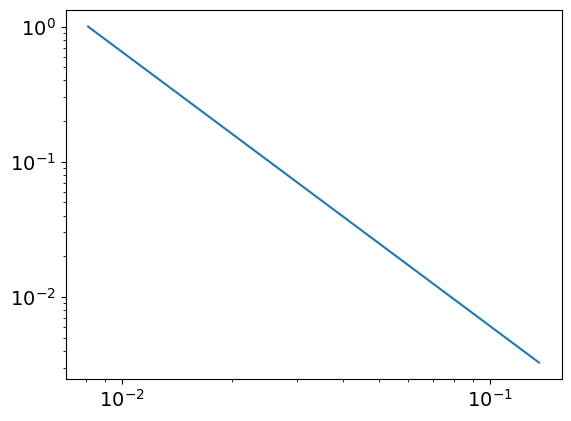

3.0287692189618958
0.008112804040608322
powerlaw KstestResult(statistic=0.9988976774400024, pvalue=0.0, statistic_location=0.10487939709288595, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12345564865325957, statistic_sign=-1)
tensor(-2.9272e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3291, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.4822, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
266
tensor(0.1985, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


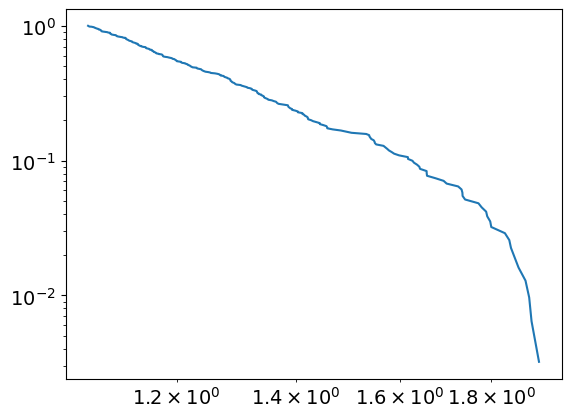

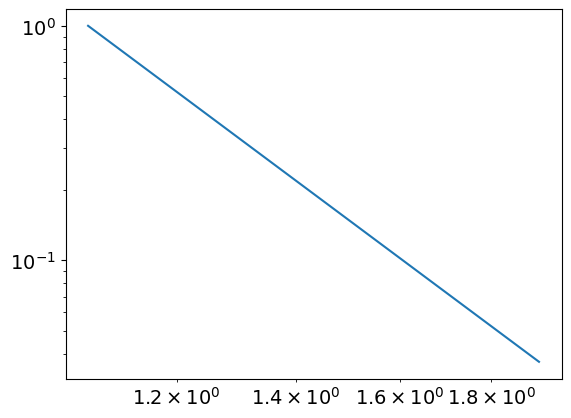

6.678220543462123
1.0706866822754957
powerlaw KstestResult(statistic=0.9914906285201056, pvalue=0.0, statistic_location=1.4571784303257138, statistic_sign=1)
lognorm KstestResult(statistic=0.9843659062580997, pvalue=0.0, statistic_location=1.2530921229087995, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2117, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3357, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2932, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
267
tensor(4.2514e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


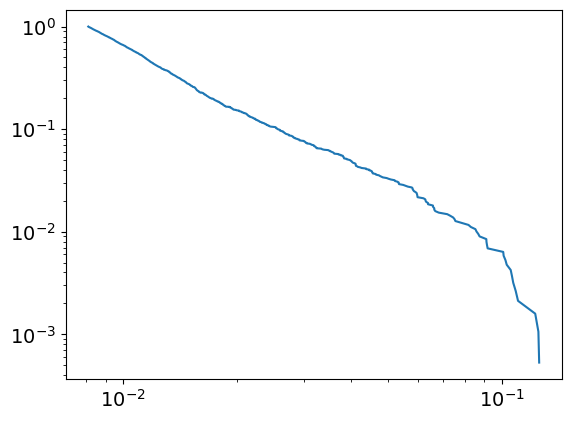

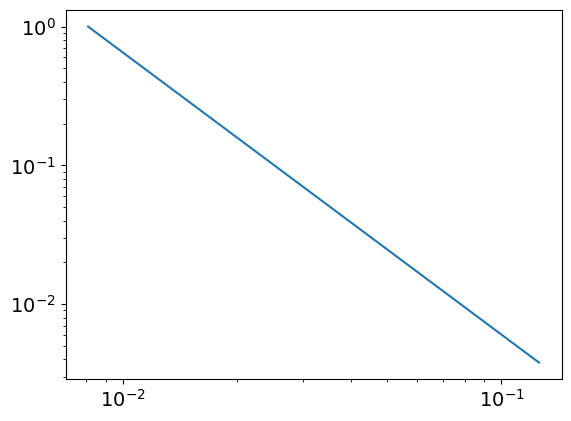

3.0330599656112467
0.008094828556136153
powerlaw KstestResult(statistic=0.998843183149298, pvalue=0.0, statistic_location=0.10233760219486841, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12506460606192052, statistic_sign=-1)
tensor(-1.3208e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2629, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.0080, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
267
tensor(0.1988, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


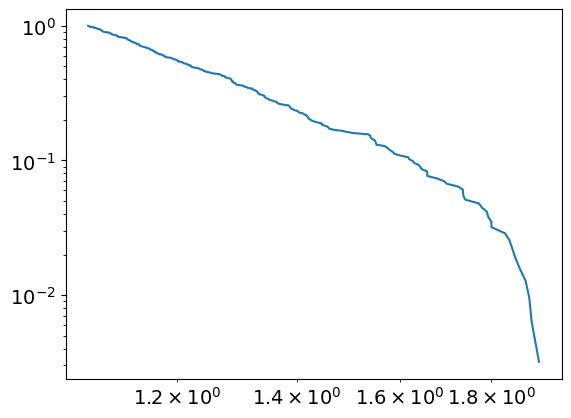

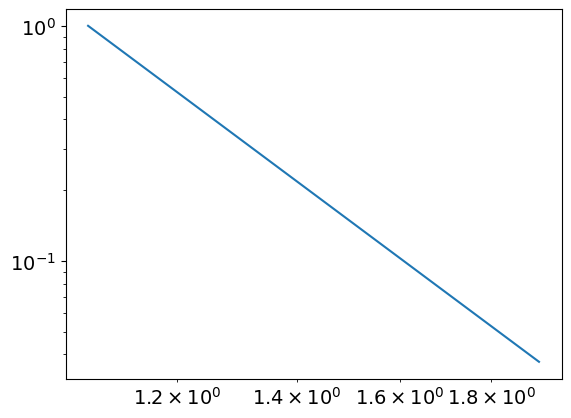

6.653590668785827
1.0693042331676996
powerlaw KstestResult(statistic=0.9913303186473258, pvalue=0.0, statistic_location=1.4595476808075254, statistic_sign=1)
lognorm KstestResult(statistic=0.9843618124243355, pvalue=0.0, statistic_location=1.2532598687224867, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2117, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3370, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.2979, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
268
tensor(4.0434e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


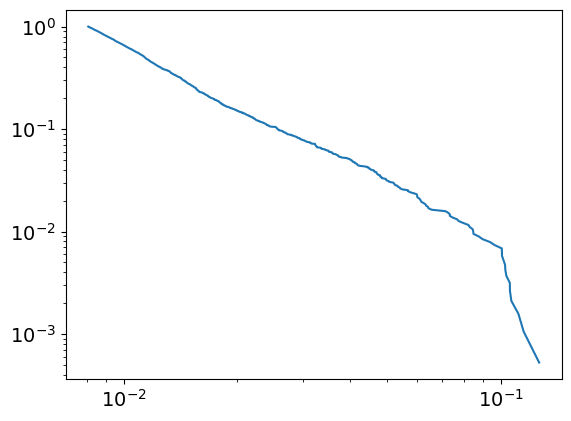

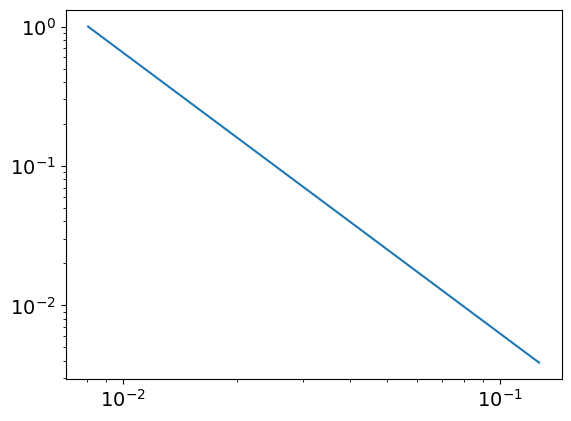

3.016145001577772
0.00806305090901015
powerlaw KstestResult(statistic=0.9989211441639259, pvalue=0.0, statistic_location=0.10300006700718918, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12662947672874486, statistic_sign=-1)
tensor(-2.7278e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.4066, device='cuda:0', grad_fn=<MeanBackward0>) tensor(27.7150, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
268
tensor(0.1992, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


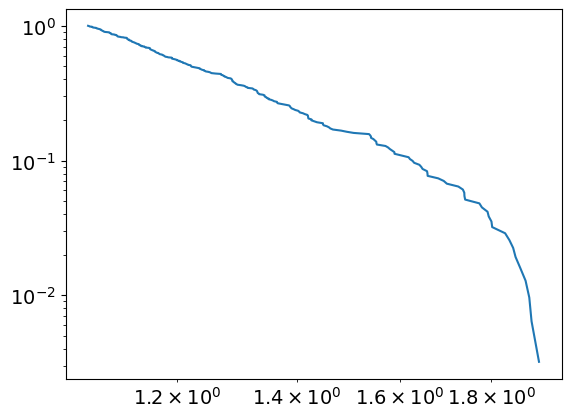

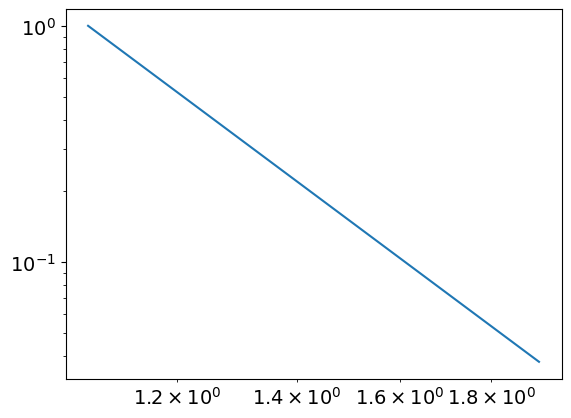

6.6301483122682585
1.0697432331670627
powerlaw KstestResult(statistic=0.9912196458295419, pvalue=0.0, statistic_location=1.4497798696117474, statistic_sign=1)
lognorm KstestResult(statistic=0.9843591696441591, pvalue=0.0, statistic_location=1.253369613349295, statistic_sign=1)
tensor(0.0680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2118, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3383, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3027, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
269
tensor(4.1558e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


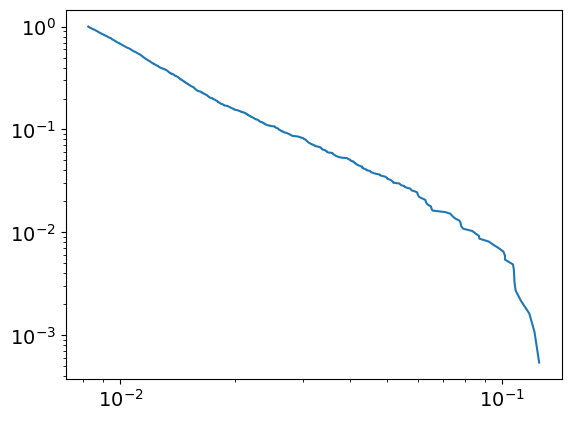

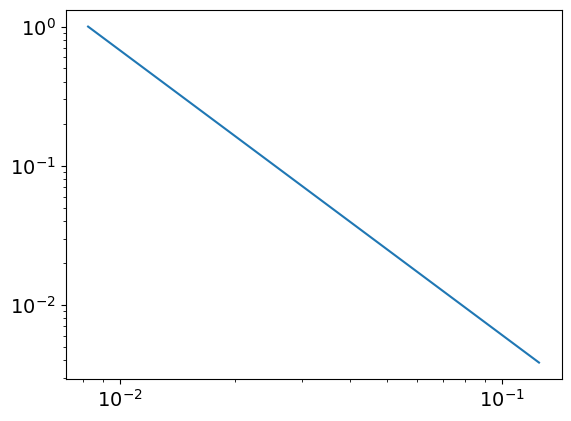

3.0447556696517517
0.008234578301284209
powerlaw KstestResult(statistic=0.9988840557456697, pvalue=0.0, statistic_location=0.10165708873398098, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12486263698527932, statistic_sign=-1)
tensor(-1.7883e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3604, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.6000, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
269
tensor(0.1995, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


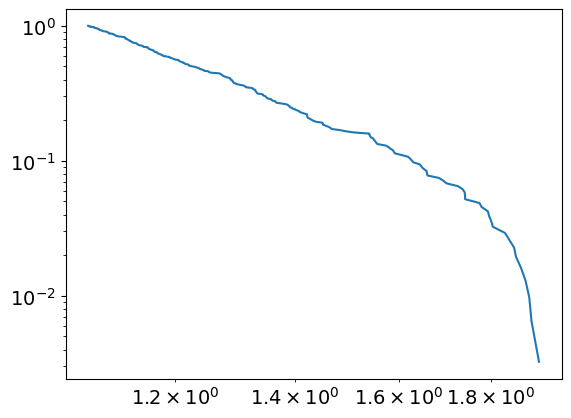

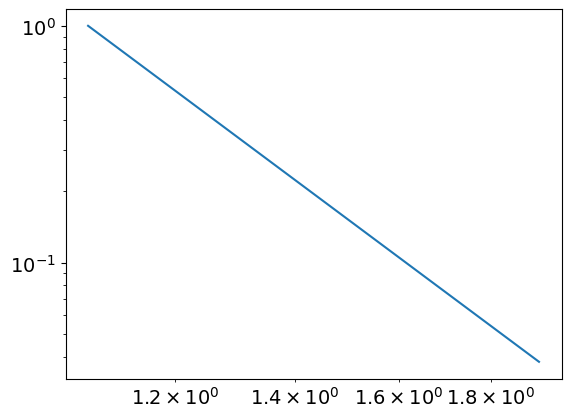

6.647929636381677
1.073470299988414
powerlaw KstestResult(statistic=0.9913270399028457, pvalue=0.0, statistic_location=1.4673076905542104, statistic_sign=1)
lognorm KstestResult(statistic=0.98435565161912, pvalue=0.0, statistic_location=1.253506394660794, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2119, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3396, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3075, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
270
tensor(4.5522e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


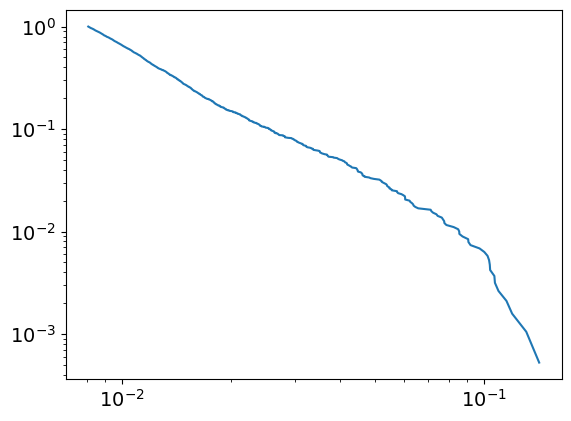

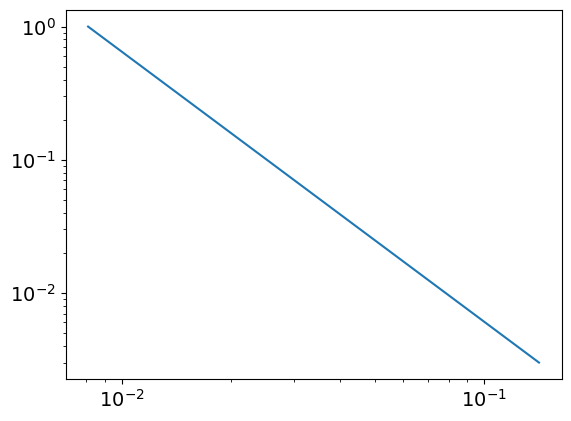

3.026703544621772
0.008082486981333285
powerlaw KstestResult(statistic=0.9988006296848082, pvalue=0.0, statistic_location=0.08554172397418465, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1308691448160164, statistic_sign=-1)
tensor(-2.1329e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2303, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.5978, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
270
tensor(0.1999, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


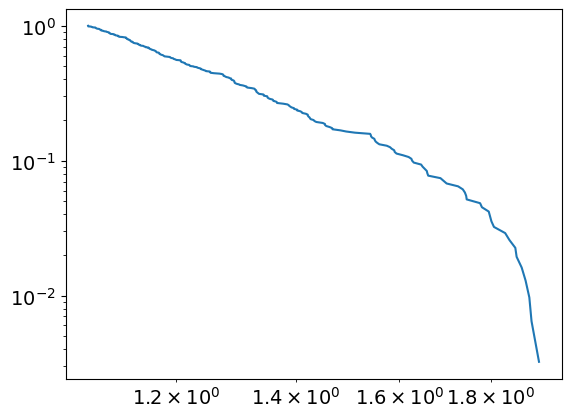

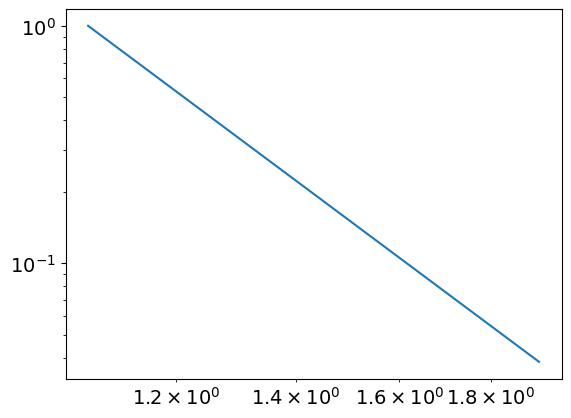

6.618638533209023
1.0718685529199494
powerlaw KstestResult(statistic=0.9911992658447634, pvalue=0.0, statistic_location=1.4562566613480845, statistic_sign=1)
lognorm KstestResult(statistic=0.9843146826139436, pvalue=0.0, statistic_location=1.2548111163819418, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2119, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3409, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3122, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
271
tensor(4.3193e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


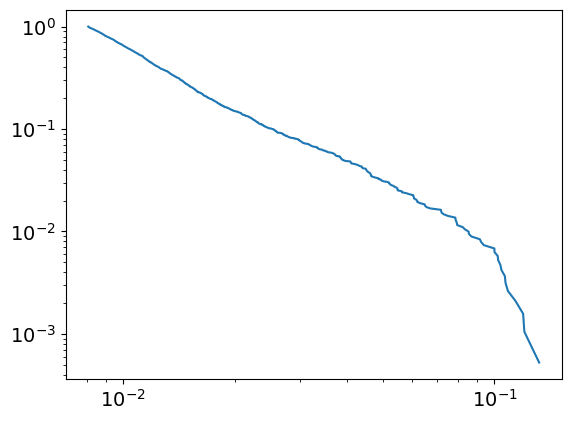

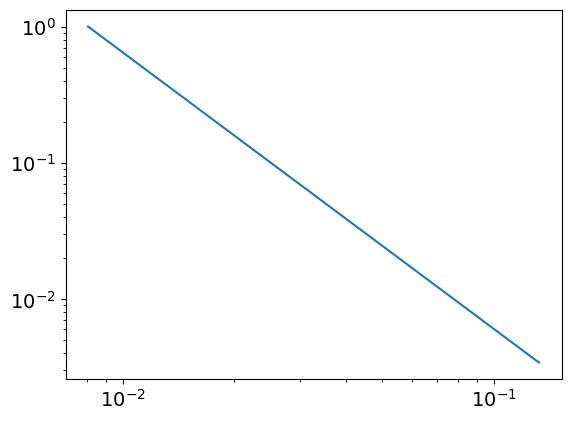

3.0317266888294796
0.008075229269778378
powerlaw KstestResult(statistic=0.9988047194858586, pvalue=0.0, statistic_location=0.10373801996708128, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11944073182784498, statistic_sign=-1)
tensor(-7.9466e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1059, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.2761, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
271
tensor(0.2002, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


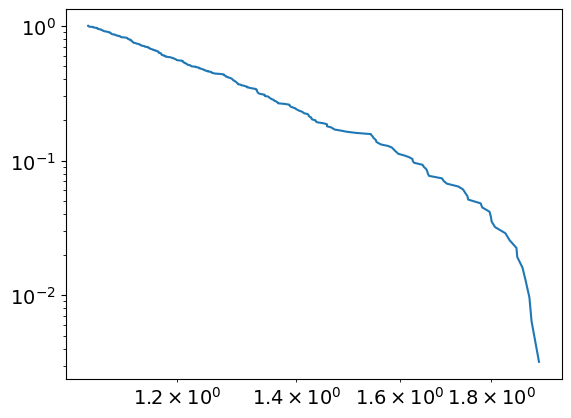

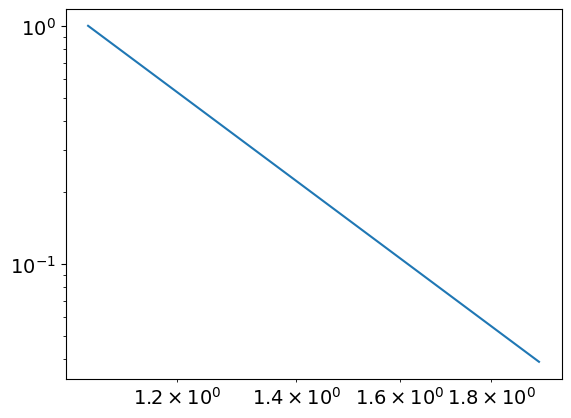

6.581296536872172
1.0699778338374604
powerlaw KstestResult(statistic=0.9910885217454045, pvalue=0.0, statistic_location=1.4378539271319064, statistic_sign=1)
lognorm KstestResult(statistic=0.9842197412705861, pvalue=0.0, statistic_location=1.2574732051901922, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2120, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3422, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3169, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
272
tensor(3.9580e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


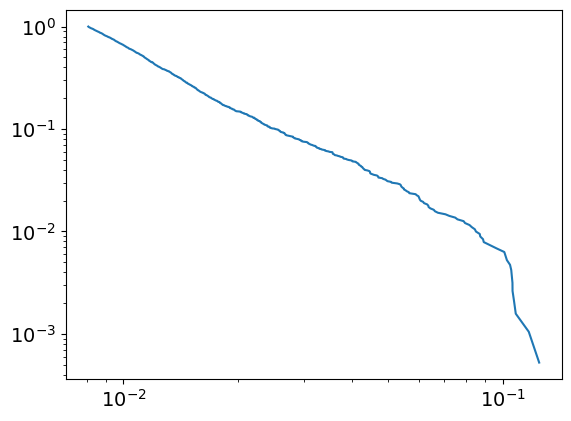

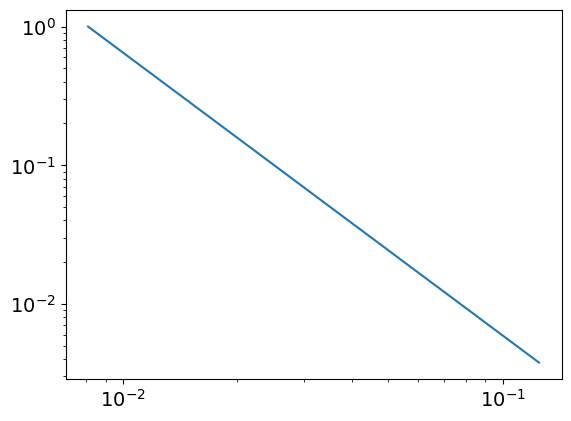

3.03883762449903
0.00808060787289745
powerlaw KstestResult(statistic=0.9989527490658289, pvalue=0.0, statistic_location=0.10826898507923963, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11715276860869481, statistic_sign=-1)
tensor(-1.5093e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2890, device='cuda:0', grad_fn=<MeanBackward0>) tensor(27.8445, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
272
tensor(0.2006, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


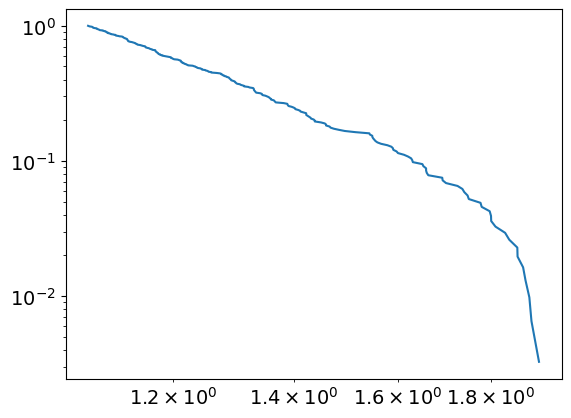

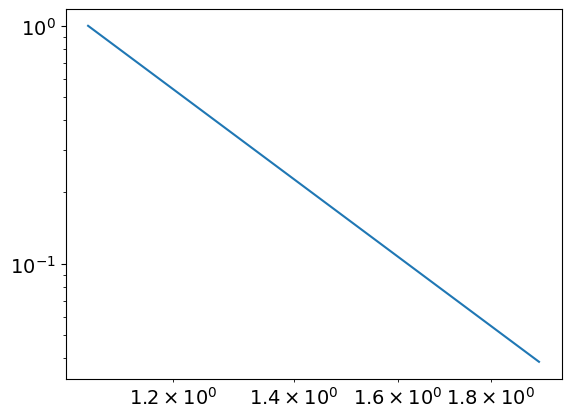

6.646200957534537
1.076599990329734
powerlaw KstestResult(statistic=0.9913185264470022, pvalue=0.0, statistic_location=1.4380805900081333, statistic_sign=1)
lognorm KstestResult(statistic=0.9841594507803595, pvalue=0.0, statistic_location=1.2556573738517107, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2120, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3434, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3215, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
273
tensor(4.1680e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


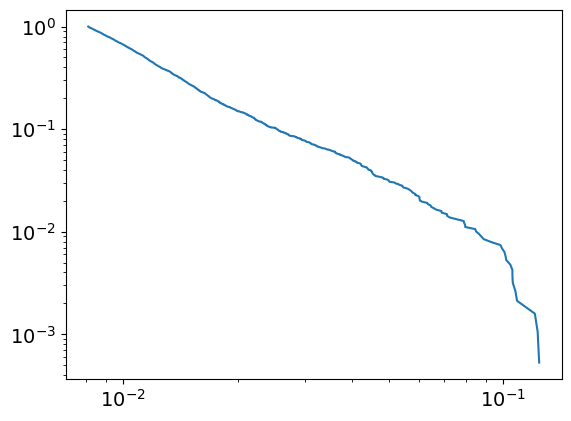

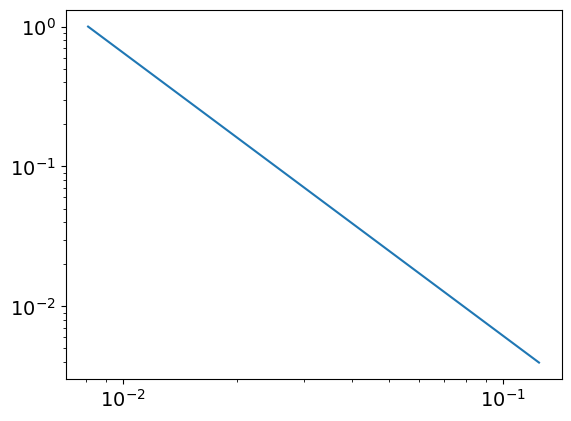

3.025103702477965
0.008092176685763173
powerlaw KstestResult(statistic=0.9988680148411346, pvalue=0.0, statistic_location=0.1056892651258567, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12105696804138093, statistic_sign=-1)
tensor(-1.8053e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2430, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.6994, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
273
tensor(0.2010, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


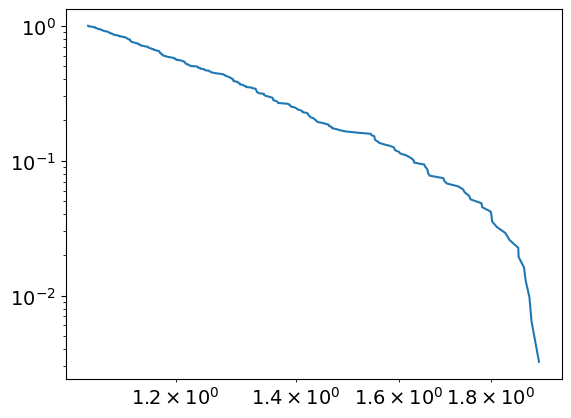

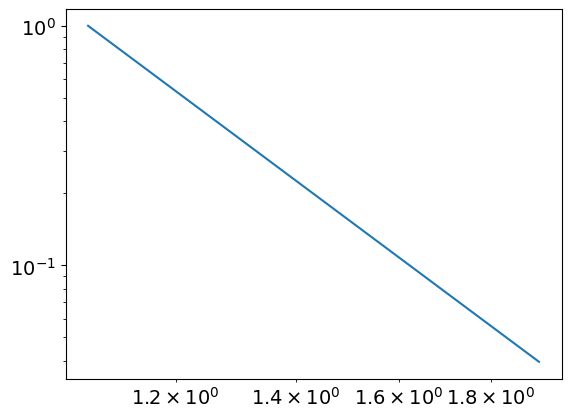

6.566146867292603
1.072002457551592
powerlaw KstestResult(statistic=0.9910447328385955, pvalue=0.0, statistic_location=1.4407735810737483, statistic_sign=1)
lognorm KstestResult(statistic=0.9841249247278042, pvalue=0.0, statistic_location=1.2566250972053026, statistic_sign=1)
tensor(0.0681, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2121, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3447, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3261, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
274
tensor(4.2449e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


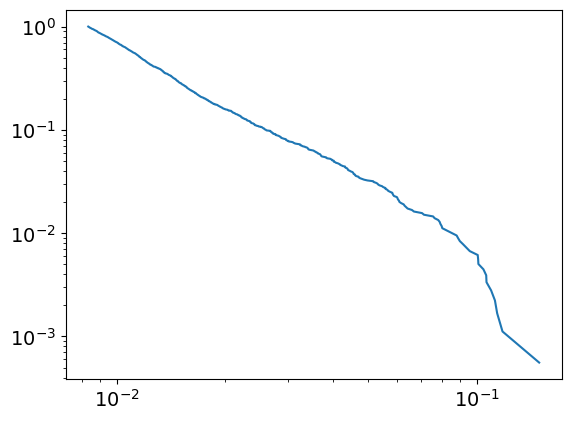

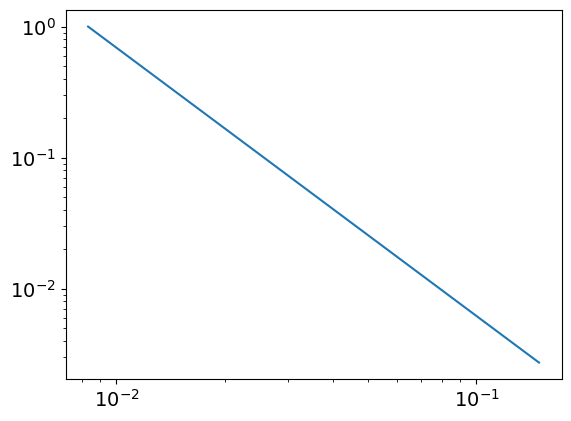

3.04823690418198
0.008341592357137459
powerlaw KstestResult(statistic=0.9989527045641373, pvalue=0.0, statistic_location=0.10442209087012527, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11401961904633914, statistic_sign=-1)
tensor(-1.7644e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1417, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.0399, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
274
tensor(0.2013, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


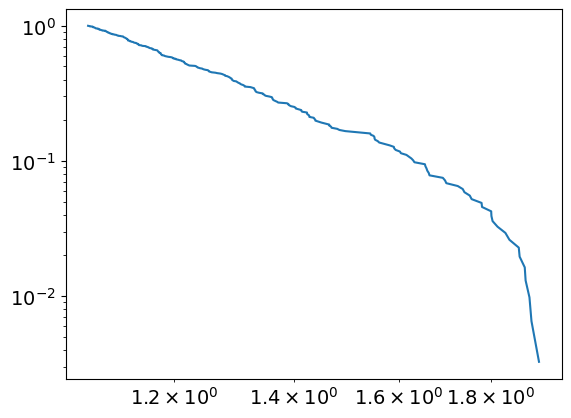

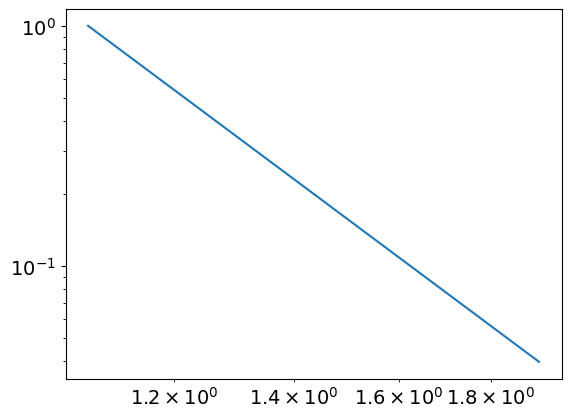

6.583818007047472
1.075101118373709
powerlaw KstestResult(statistic=0.9910935581694927, pvalue=0.0, statistic_location=1.4683930866953117, statistic_sign=1)
lognorm KstestResult(statistic=0.9840901732530252, pvalue=0.0, statistic_location=1.2575553488560796, statistic_sign=1)
tensor(0.0682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2122, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3460, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3307, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
275
tensor(4.1734e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


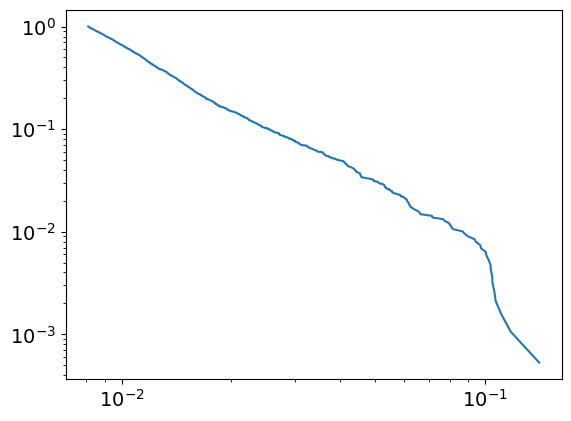

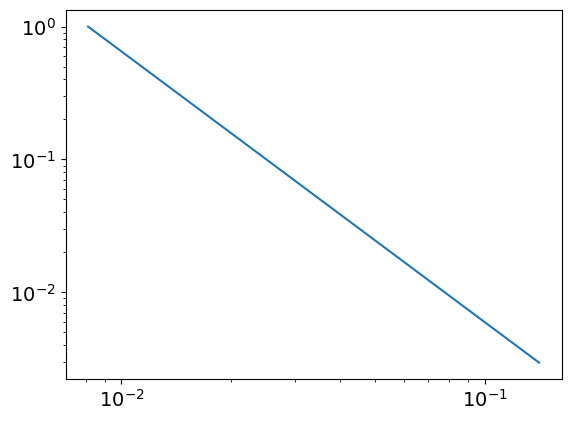

3.0369332746449014
0.008099066933132984
powerlaw KstestResult(statistic=0.9989153172290535, pvalue=0.0, statistic_location=0.10480278829736629, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11082552374810847, statistic_sign=-1)
tensor(-1.2605e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1131, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.2904, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
275
tensor(0.2016, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


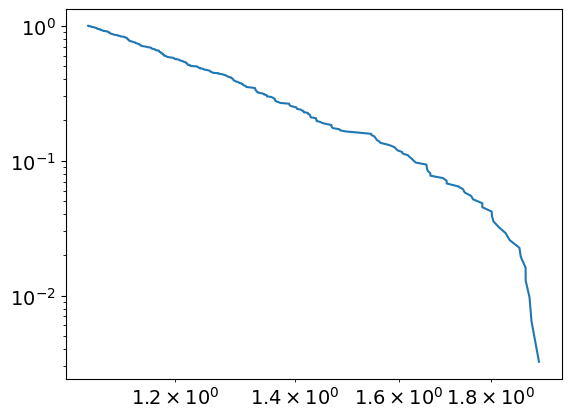

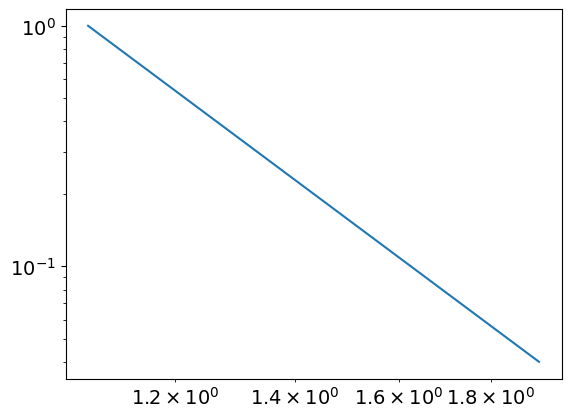

6.552959508359063
1.072777719959873
powerlaw KstestResult(statistic=0.9909644060322714, pvalue=0.0, statistic_location=1.4389277300525043, statistic_sign=1)
lognorm KstestResult(statistic=0.9840530888272593, pvalue=0.0, statistic_location=1.2585010632574003, statistic_sign=1)
tensor(0.0682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2122, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3474, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3355, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
276
tensor(4.4807e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


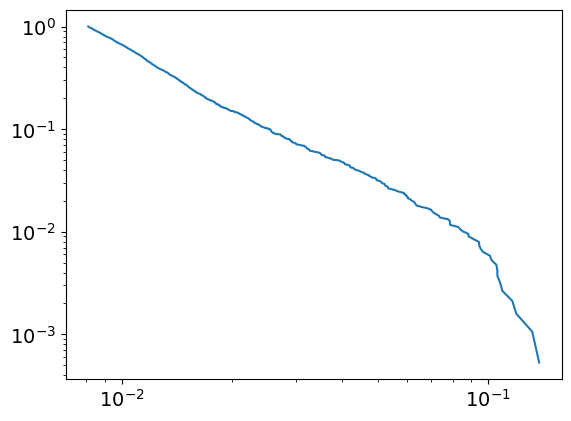

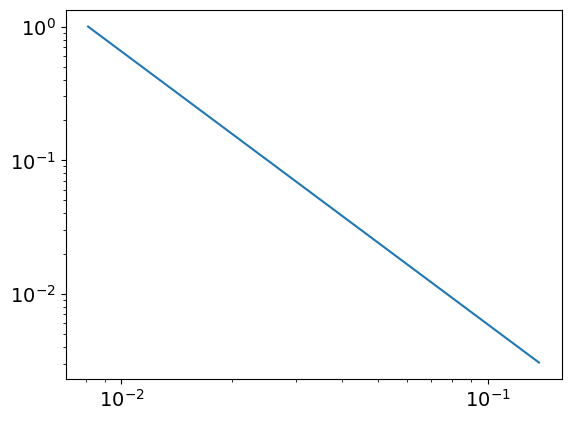

3.0439317535044412
0.008110380069084999
powerlaw KstestResult(statistic=0.9988976355047394, pvalue=0.0, statistic_location=0.10601086677963908, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13200006560044736, statistic_sign=-1)
tensor(-1.3124e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2707, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.0414, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
276
tensor(0.2020, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


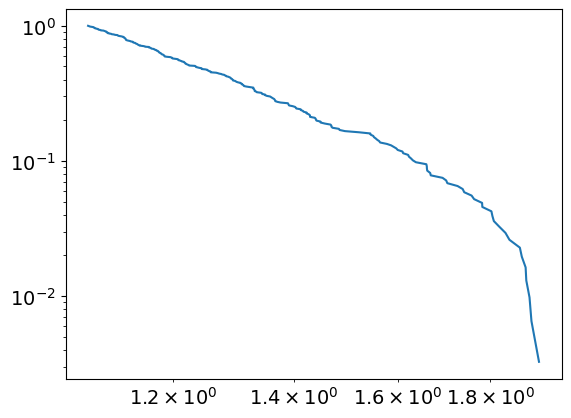

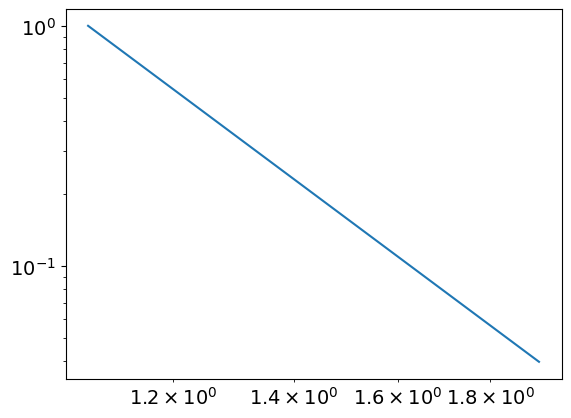

6.595993790601817
1.0767673249532157
powerlaw KstestResult(statistic=0.9911212239718976, pvalue=0.0, statistic_location=1.4491827802034964, statistic_sign=1)
lognorm KstestResult(statistic=0.9840135369460299, pvalue=0.0, statistic_location=1.2594331694708065, statistic_sign=1)
tensor(0.0682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2123, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3487, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3400, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
277
tensor(4.1134e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


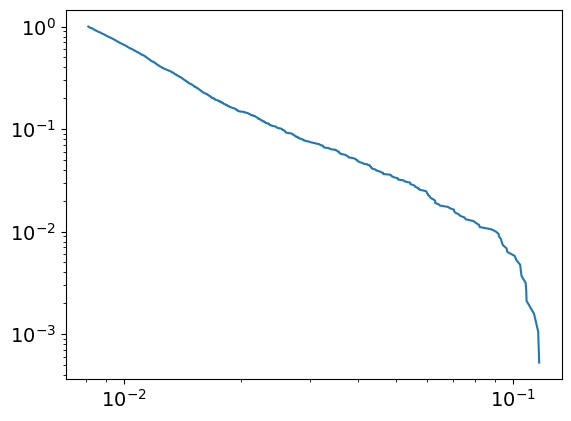

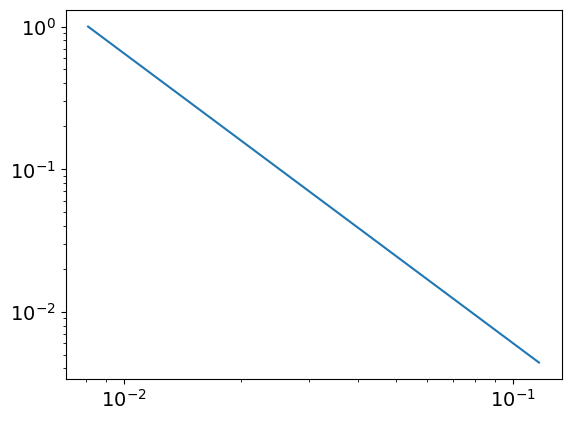

3.033628056476376
0.008094826234575357
powerlaw KstestResult(statistic=0.9989129614262077, pvalue=0.0, statistic_location=0.10464293329512753, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11319330866277161, statistic_sign=-1)
tensor(-2.1154e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3091, device='cuda:0', grad_fn=<MeanBackward0>) tensor(27.9222, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
277
tensor(0.2023, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


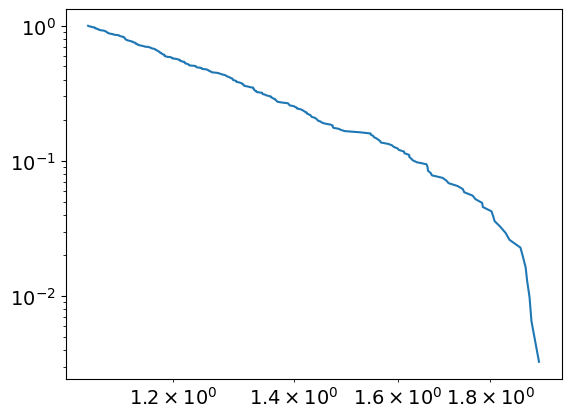

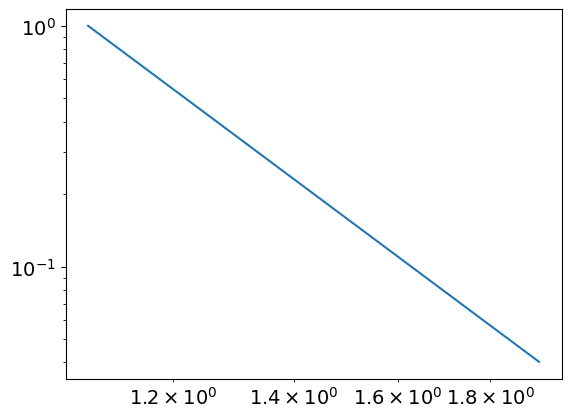

6.579763257172518
1.0768357725703954
powerlaw KstestResult(statistic=0.9910389583958831, pvalue=0.0, statistic_location=1.4514102077103737, statistic_sign=1)
lognorm KstestResult(statistic=0.9839358787689515, pvalue=0.0, statistic_location=1.261163875223417, statistic_sign=1)
tensor(0.0682, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2124, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3500, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3445, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
278
tensor(4.2119e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


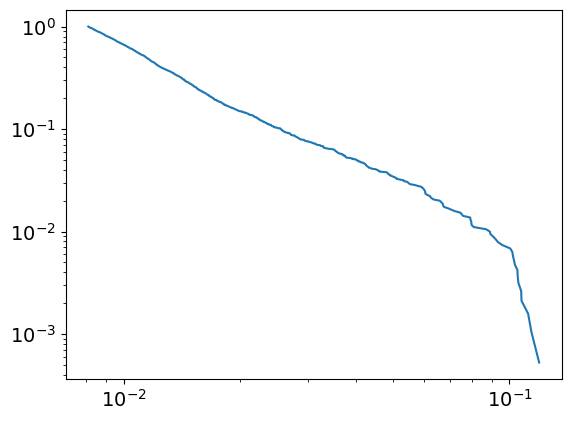

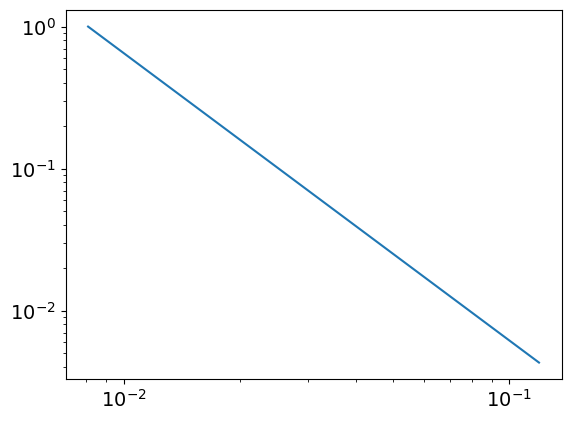

3.0239720995282893
0.008091499754092634
powerlaw KstestResult(statistic=0.9988720201944468, pvalue=0.0, statistic_location=0.10545612411199544, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11177219150088484, statistic_sign=-1)
tensor(-9.0812e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1585, device='cuda:0', grad_fn=<MeanBackward0>) tensor(27.8143, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
278
tensor(0.2027, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


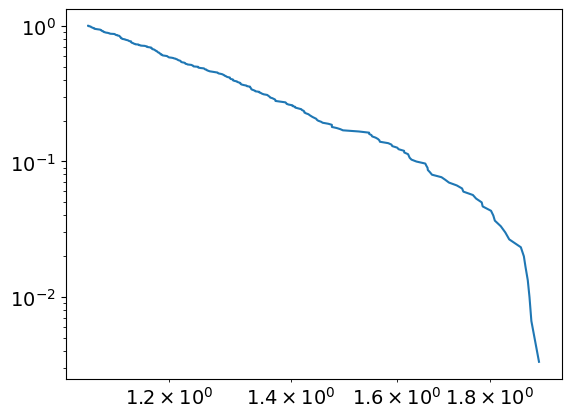

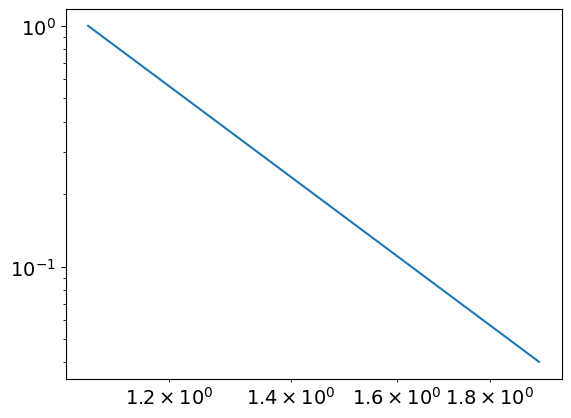

6.639508735931555
1.0833416743327076
powerlaw KstestResult(statistic=0.9912840512961337, pvalue=0.0, statistic_location=1.4742139781098833, statistic_sign=1)
lognorm KstestResult(statistic=0.9838329745763174, pvalue=0.0, statistic_location=1.263206928389046, statistic_sign=1)
tensor(0.0683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2124, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3513, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3491, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
279
tensor(4.1691e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


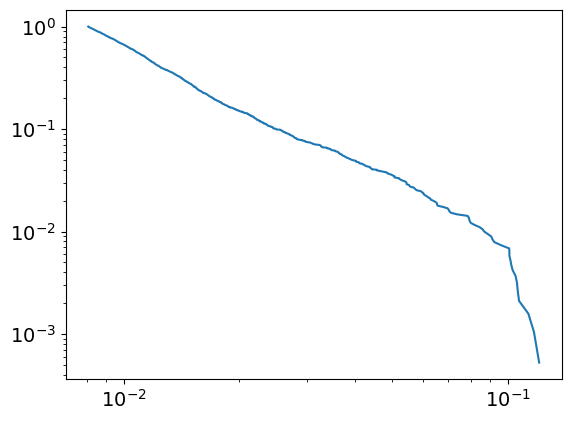

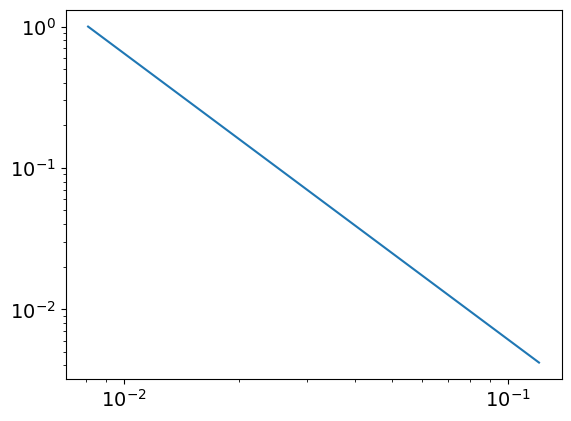

3.0245150002048584
0.008078230892815202
powerlaw KstestResult(statistic=0.9988915744704863, pvalue=0.0, statistic_location=0.10475662985098692, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11309704595589248, statistic_sign=-1)
tensor(-2.5401e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2987, device='cuda:0', grad_fn=<MeanBackward0>) tensor(27.8822, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
279
tensor(0.2031, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


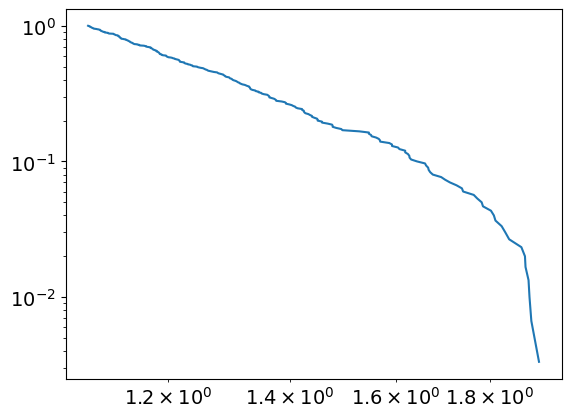

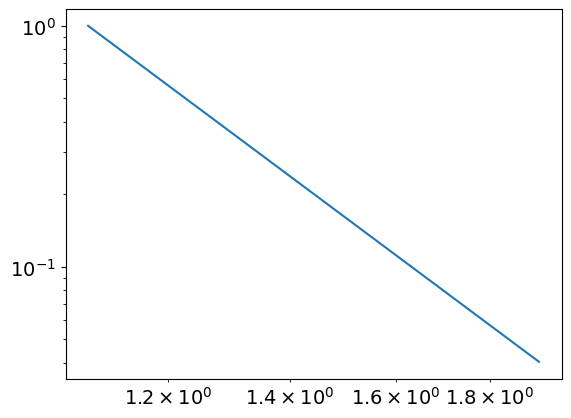

6.650895753235305
1.0850089806178405
powerlaw KstestResult(statistic=0.9913333776277977, pvalue=0.0, statistic_location=1.4571669339185178, statistic_sign=1)
lognorm KstestResult(statistic=0.9837520110362977, pvalue=0.0, statistic_location=1.2623194236118265, statistic_sign=1)
tensor(0.0683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2125, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3527, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3536, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
280
tensor(4.7566e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


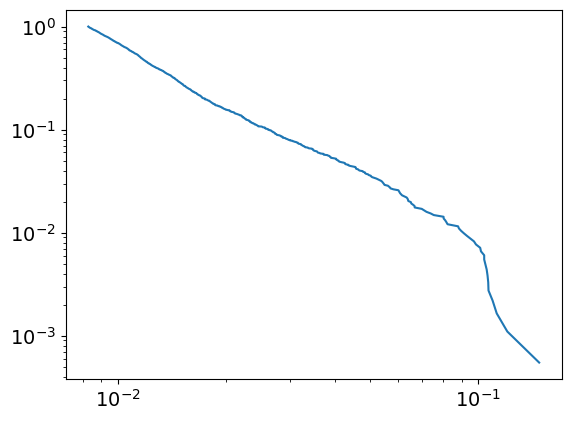

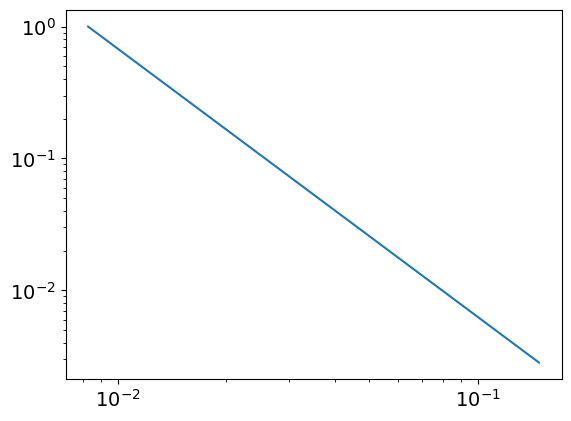

3.0357604614726226
0.00828094664427349
powerlaw KstestResult(statistic=0.9987516767272371, pvalue=0.0, statistic_location=0.10626225156612948, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.10974910961870296, statistic_sign=-1)
tensor(-2.8892e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0451, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.8077, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
280
tensor(0.2034, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


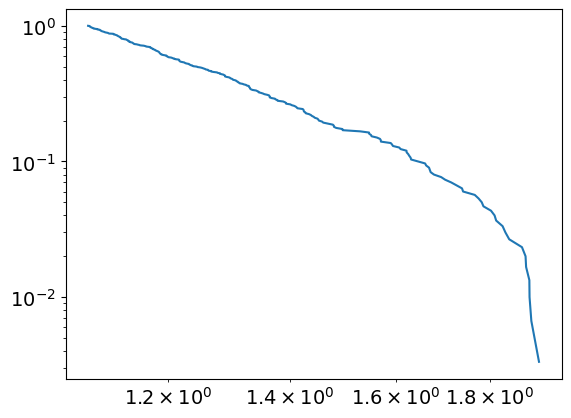

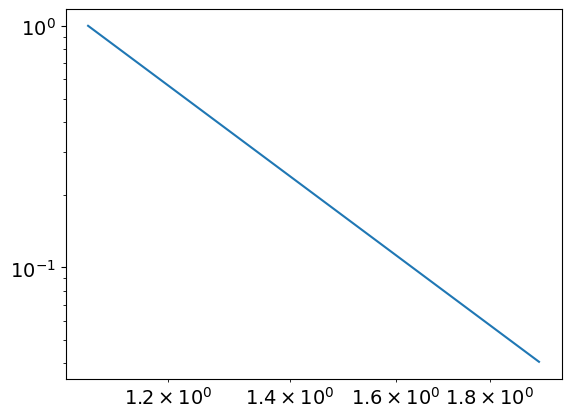

6.637901026031106
1.0851573087394413
powerlaw KstestResult(statistic=0.9912638181622095, pvalue=0.0, statistic_location=1.459326384583924, statistic_sign=1)
lognorm KstestResult(statistic=0.9837189620388617, pvalue=0.0, statistic_location=1.2672612117814512, statistic_sign=1)
tensor(0.0683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2125, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3540, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3582, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
281
tensor(4.7707e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


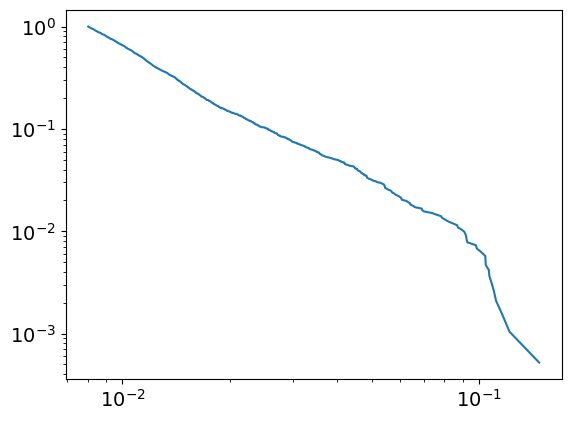

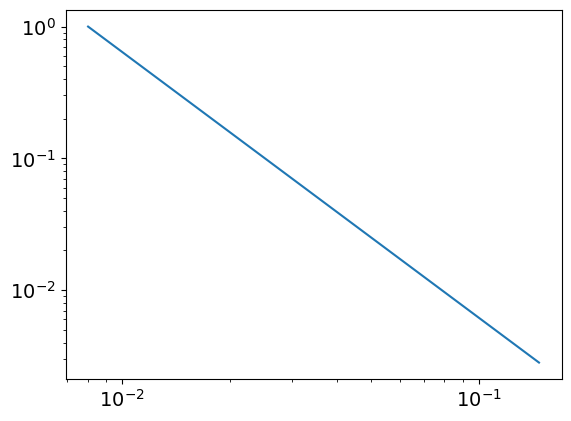

3.0161352829058194
0.008016911141835203
powerlaw KstestResult(statistic=0.9986708796560398, pvalue=0.0, statistic_location=0.11168177503649021, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11597846313567561, statistic_sign=-1)
tensor(-4.1220e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1065, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.1906, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
281
tensor(0.2038, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


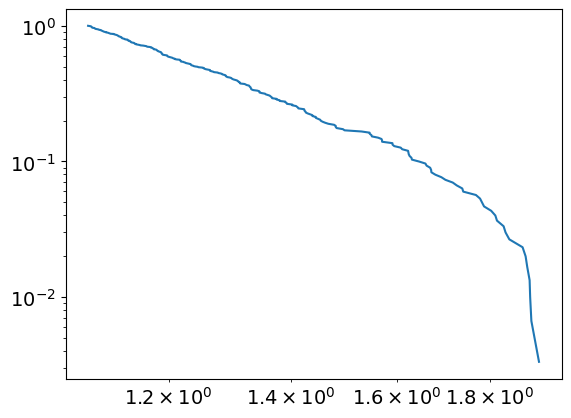

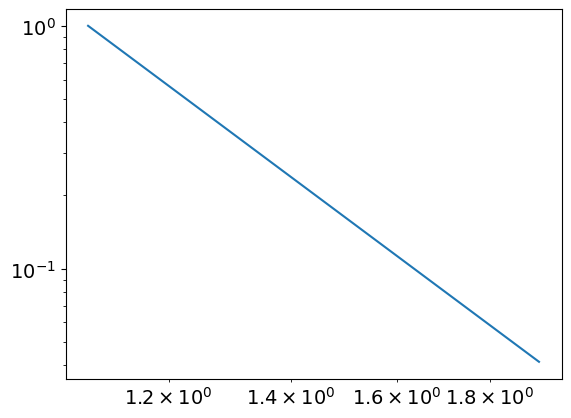

6.596876064893434
1.0837812569842755
powerlaw KstestResult(statistic=0.9910921450266981, pvalue=0.0, statistic_location=1.457345512247788, statistic_sign=1)
lognorm KstestResult(statistic=0.9836432780611672, pvalue=0.0, statistic_location=1.2643391679871419, statistic_sign=1)
tensor(0.0683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2126, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3554, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3626, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
282
tensor(4.6656e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


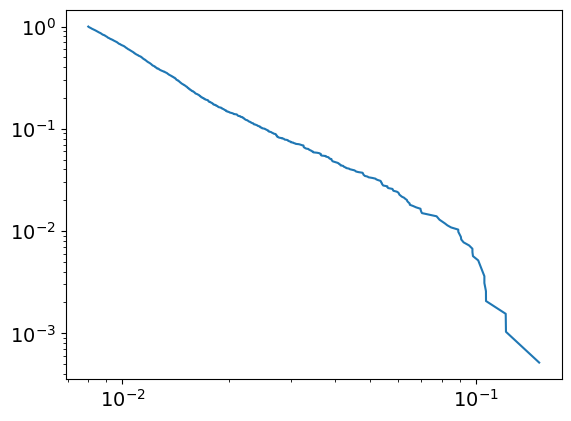

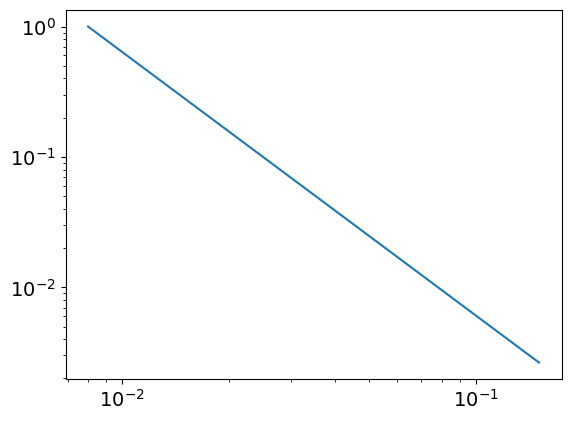

3.0202805057620714
0.008001120525482784
powerlaw KstestResult(statistic=0.9987736222943587, pvalue=0.0, statistic_location=0.10400310318119795, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.10678383279392394, statistic_sign=-1)
tensor(-5.0733e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0235, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.6583, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
282
tensor(0.2041, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


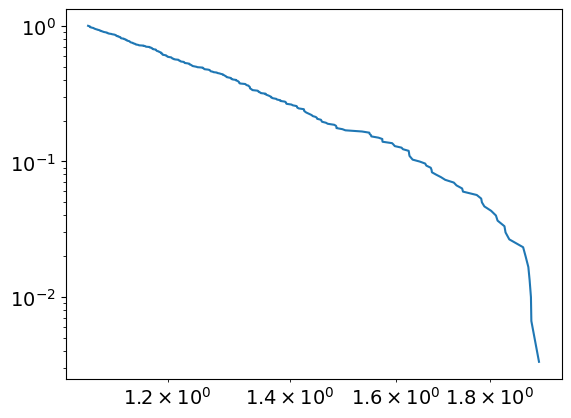

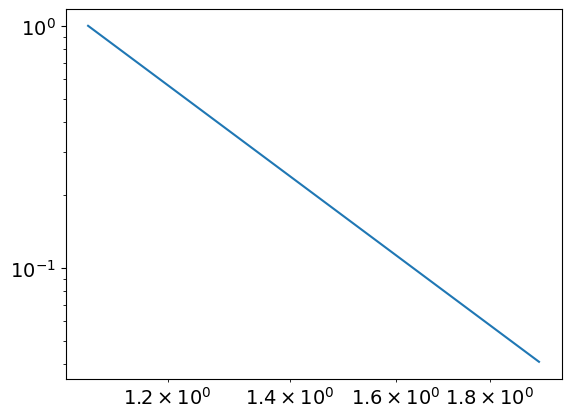

6.6323125010472985
1.0855820978980397
powerlaw KstestResult(statistic=0.9911899890654944, pvalue=0.0, statistic_location=1.457342478565904, statistic_sign=1)
lognorm KstestResult(statistic=0.9836114908318292, pvalue=0.0, statistic_location=1.2669456107472226, statistic_sign=1)
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2127, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3567, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3672, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
283
tensor(4.8253e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


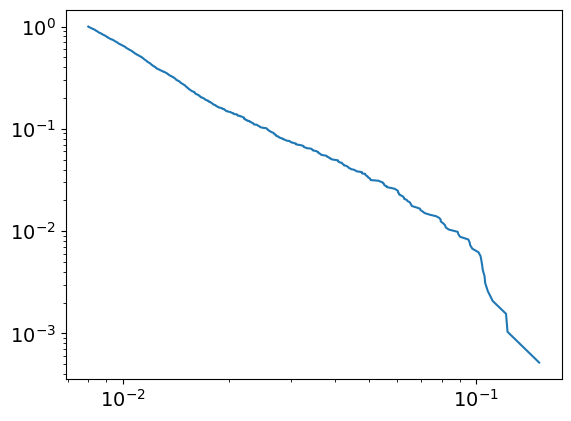

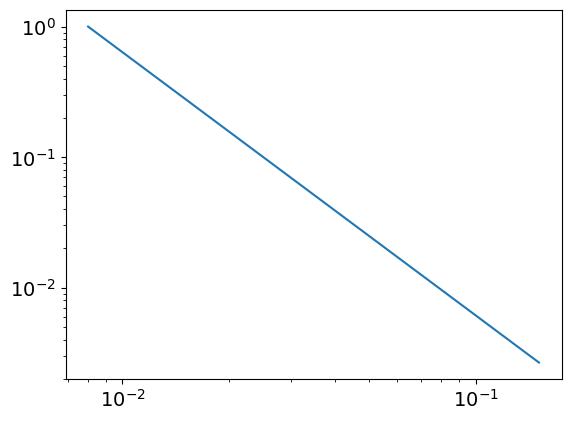

3.015247822838687
0.007994506980595619
powerlaw KstestResult(statistic=0.9986989490963956, pvalue=0.0, statistic_location=0.0902502885136385, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1081439587127006, statistic_sign=-1)
tensor(-3.3303e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0432, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.2771, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
283
tensor(0.2044, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


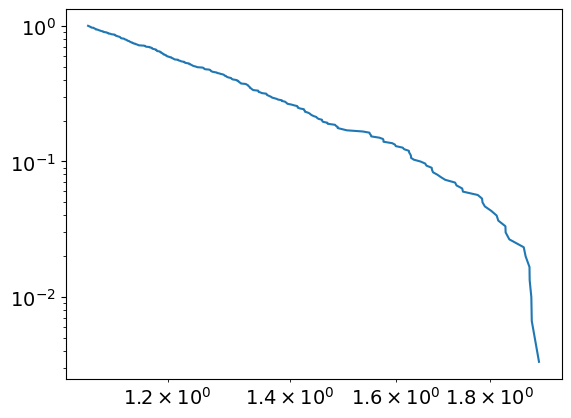

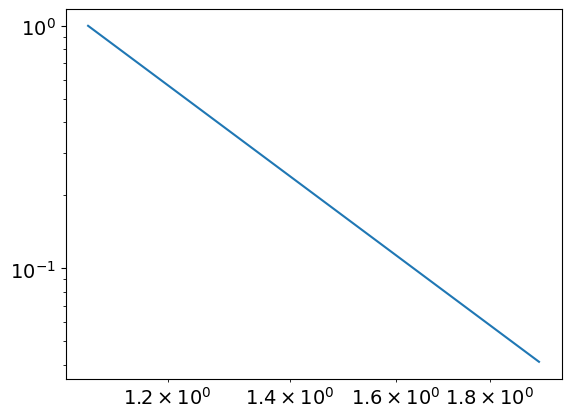

6.619996446352554
1.0857783142696018
powerlaw KstestResult(statistic=0.9911422526361189, pvalue=0.0, statistic_location=1.4679079328031042, statistic_sign=1)
lognorm KstestResult(statistic=0.9835546295050618, pvalue=0.0, statistic_location=1.269572313336579, statistic_sign=1)
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2127, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3581, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3717, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
284
tensor(4.5987e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


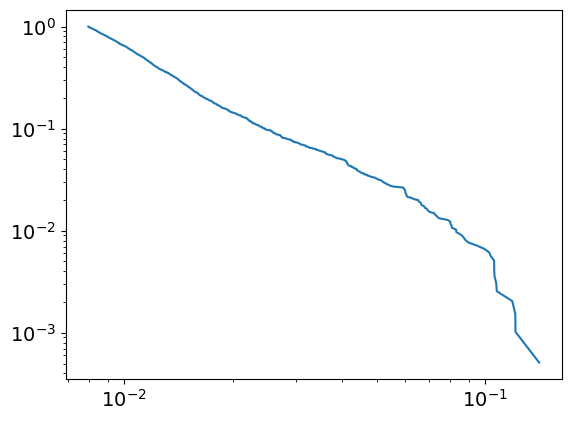

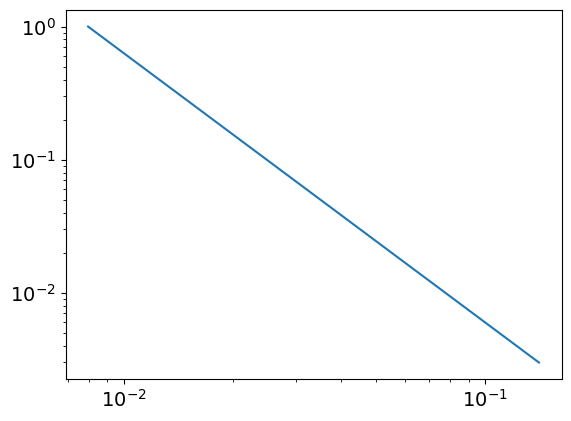

3.0226435025170106
0.007954665608138917
powerlaw KstestResult(statistic=0.9988969339412909, pvalue=0.0, statistic_location=0.08694404980815404, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11877516726783298, statistic_sign=-1)
tensor(-6.3365e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2795, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.4213, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
284
tensor(0.2048, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


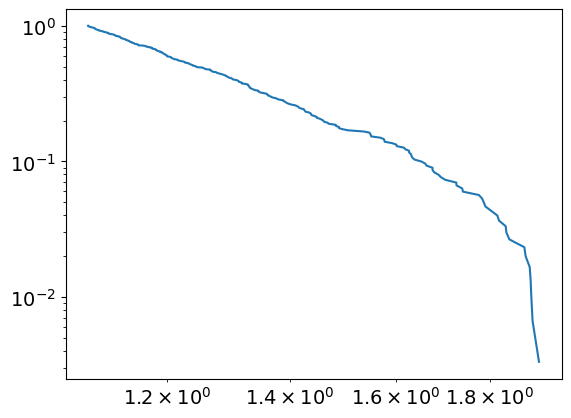

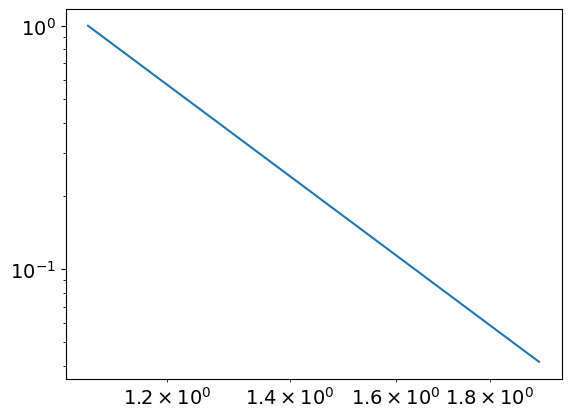

6.607879198200978
1.0859443587689905
powerlaw KstestResult(statistic=0.9910717444130035, pvalue=0.0, statistic_location=1.4697335617192464, statistic_sign=1)
lognorm KstestResult(statistic=0.9834864530097531, pvalue=0.0, statistic_location=1.2704474582973007, statistic_sign=1)
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2128, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3595, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3762, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
285
tensor(4.3065e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


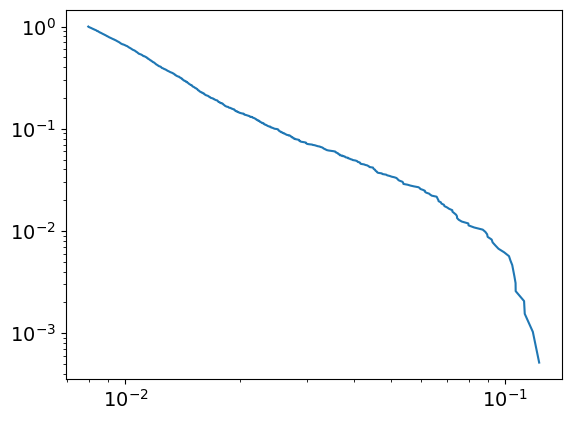

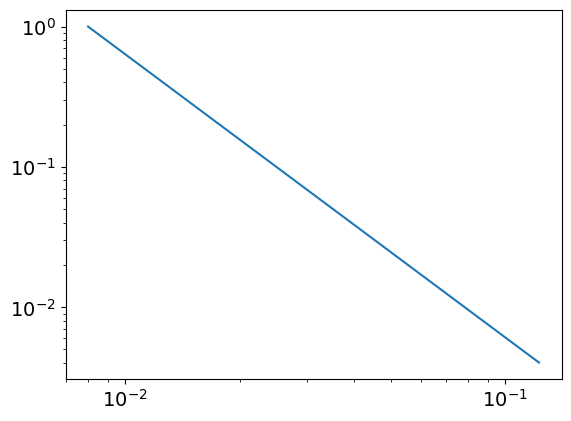

3.0177990455369406
0.007983122506642801
powerlaw KstestResult(statistic=0.9988433438788415, pvalue=0.0, statistic_location=0.08954483628197164, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11201316197816628, statistic_sign=-1)
tensor(-4.8043e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.3400, device='cuda:0', grad_fn=<MeanBackward0>) tensor(28.2976, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
285
tensor(0.2051, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


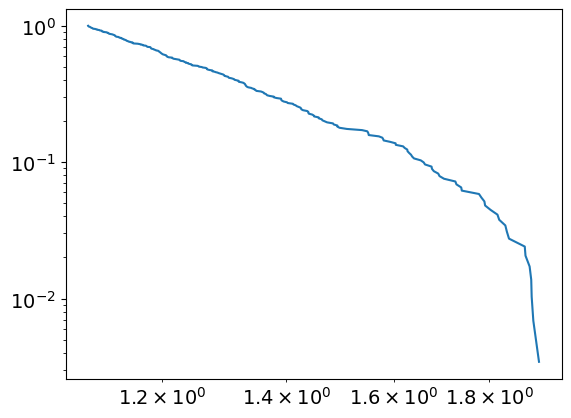

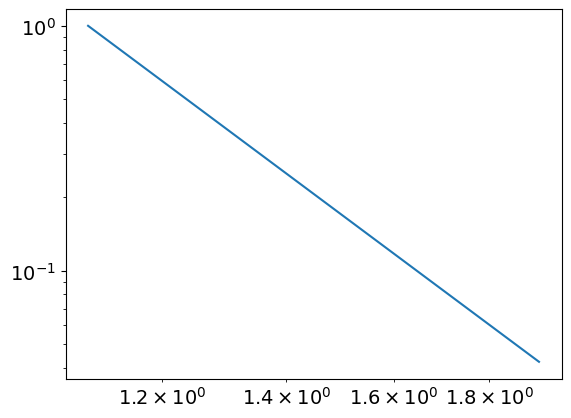

6.651748811482941
1.0946478640635213
powerlaw KstestResult(statistic=0.9913196991081564, pvalue=0.0, statistic_location=1.4722839710124878, statistic_sign=1)
lognorm KstestResult(statistic=0.9833990766146672, pvalue=0.0, statistic_location=1.2699256753807666, statistic_sign=1)
tensor(0.0684, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2128, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3608, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3805, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
286
tensor(4.9958e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


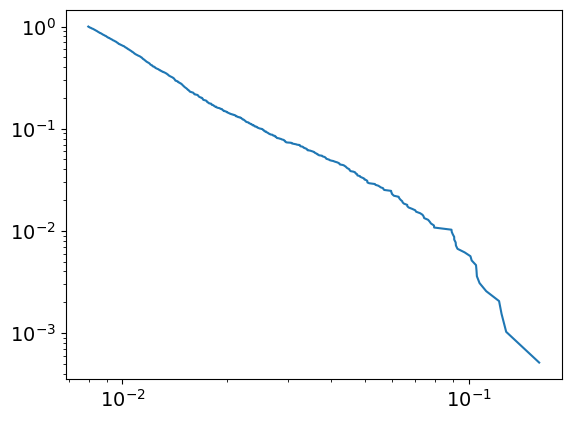

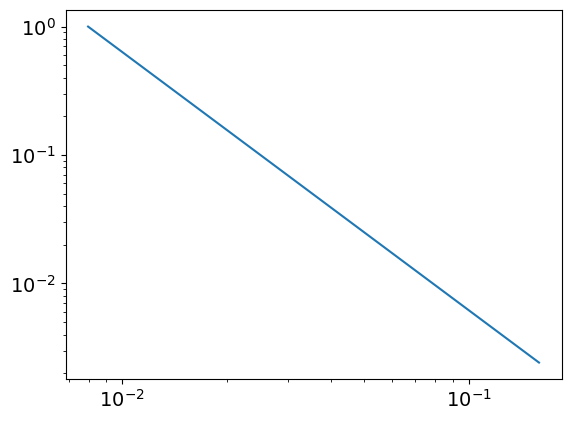

3.0110644369589576
0.007969426023125812
powerlaw KstestResult(statistic=0.998812795288408, pvalue=0.0, statistic_location=0.0906307650305666, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12802958665858089, statistic_sign=-1)
tensor(-4.0250e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0670, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.5599, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
286
tensor(0.2054, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


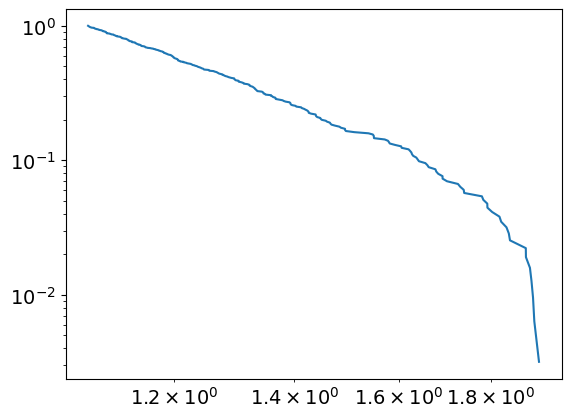

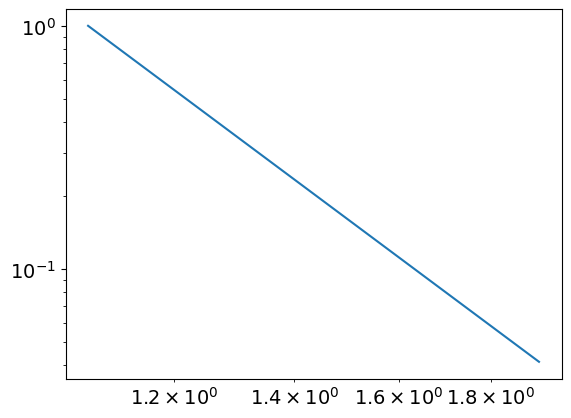

6.5187789673451135
1.075052522495756
powerlaw KstestResult(statistic=0.9904575988427275, pvalue=0.0, statistic_location=1.4681180910559837, statistic_sign=1)
lognorm KstestResult(statistic=0.983370284351922, pvalue=0.0, statistic_location=1.2470671466148446, statistic_sign=1)
tensor(0.0685, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3623, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3850, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
287
tensor(4.8729e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


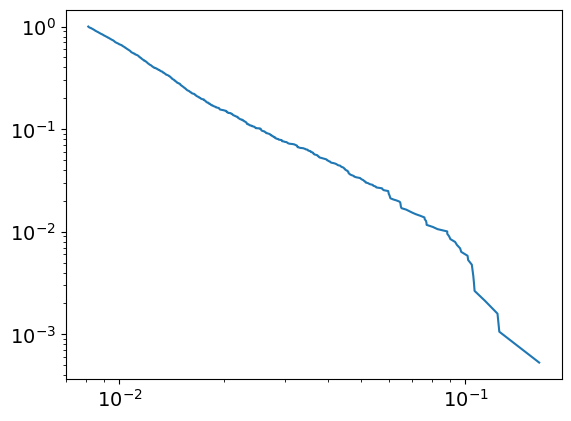

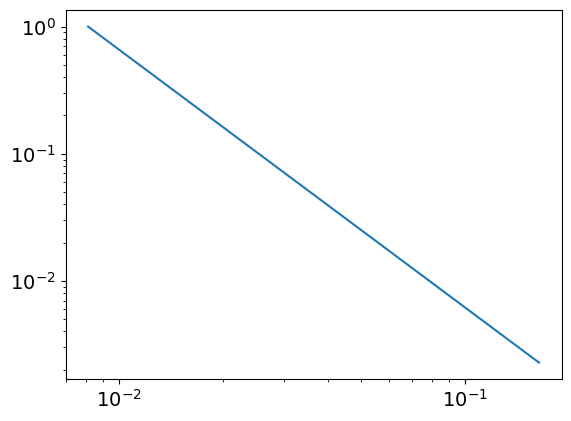

3.028227683417817
0.008126016946433372
powerlaw KstestResult(statistic=0.9988722025290989, pvalue=0.0, statistic_location=0.1058031348301747, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1237633211402677, statistic_sign=-1)
tensor(-2.4966e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0170, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.5500, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
287
tensor(0.2058, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


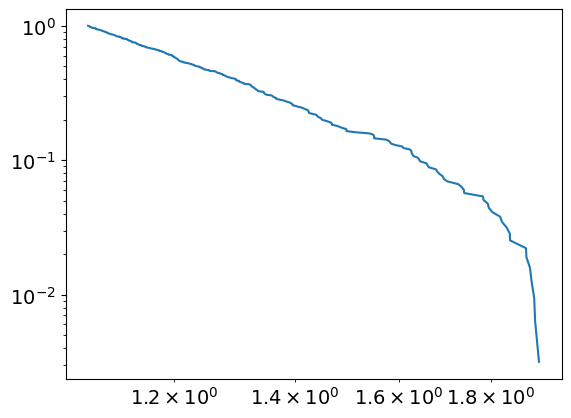

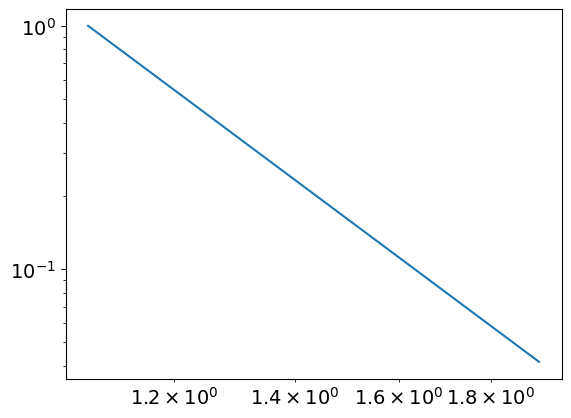

6.503157410239085
1.0745502026134077
powerlaw KstestResult(statistic=0.9903834652867262, pvalue=0.0, statistic_location=1.468676219816563, statistic_sign=1)
lognorm KstestResult(statistic=0.9833188653876019, pvalue=0.0, statistic_location=1.254014365599868, statistic_sign=1)
tensor(0.0685, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2130, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3637, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3894, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
288
tensor(4.8747e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


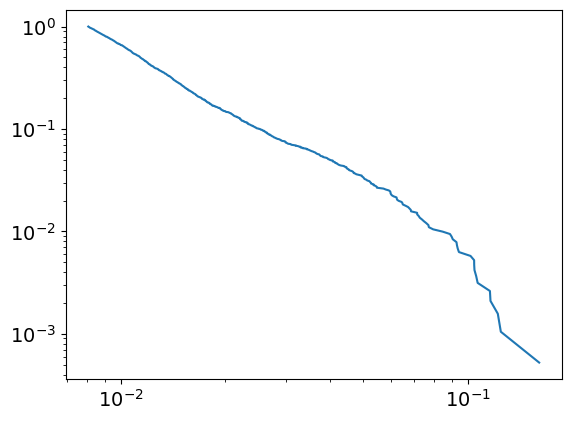

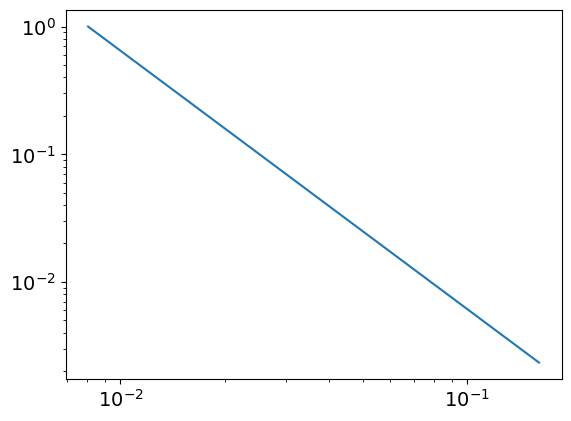

3.025506867436077
0.008064927959974237
powerlaw KstestResult(statistic=0.9987830089693236, pvalue=0.0, statistic_location=0.09318830890682181, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12222402345141543, statistic_sign=-1)
tensor(-2.1242e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0187, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.3711, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
288
tensor(0.2061, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


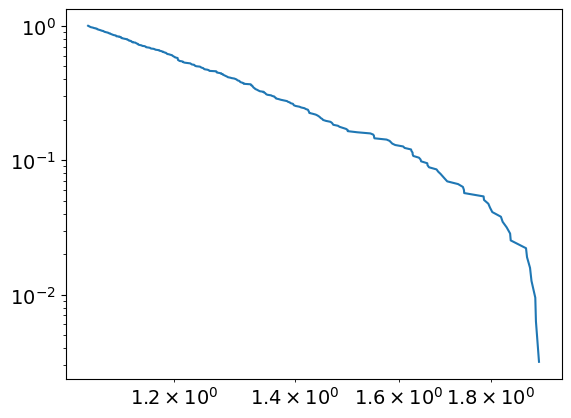

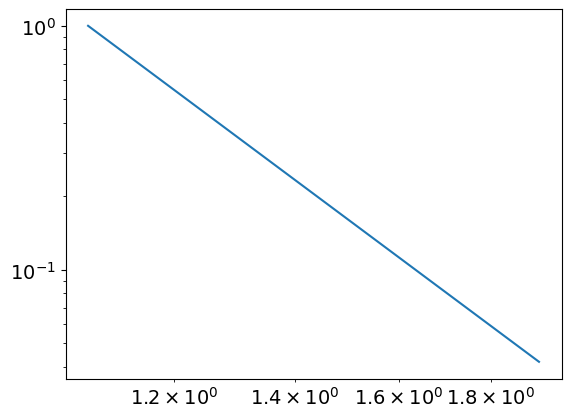

6.490541245267422
1.0746321718028162
powerlaw KstestResult(statistic=0.9903020175588789, pvalue=0.0, statistic_location=1.4519778053324286, statistic_sign=1)
lognorm KstestResult(statistic=0.9833222310183704, pvalue=0.0, statistic_location=1.2538825249139687, statistic_sign=1)
tensor(0.0685, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2130, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3651, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3939, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
289
tensor(4.6435e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


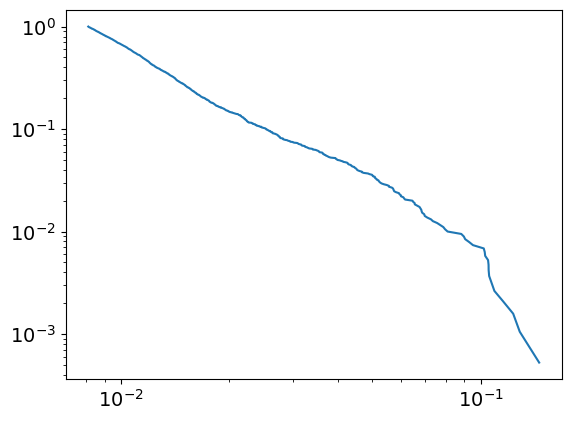

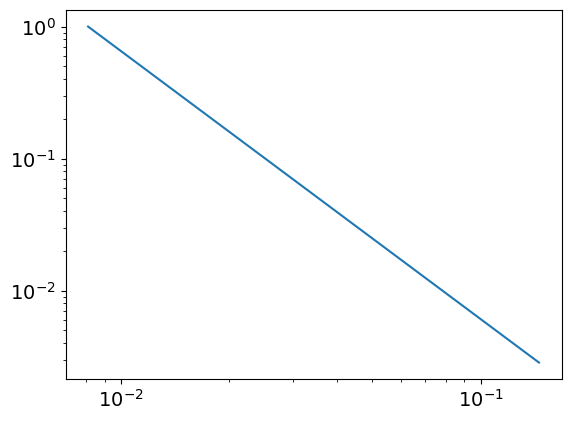

3.0291239365064535
0.008095300410839005
powerlaw KstestResult(statistic=0.9987950243264628, pvalue=0.0, statistic_location=0.0928807172871862, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11515252899076935, statistic_sign=-1)
tensor(-2.5841e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1030, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.0039, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
289
tensor(0.2065, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


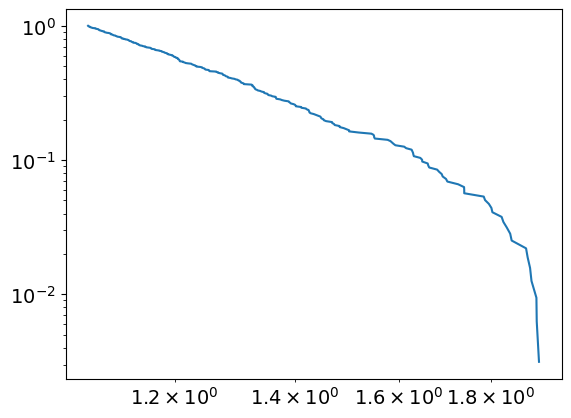

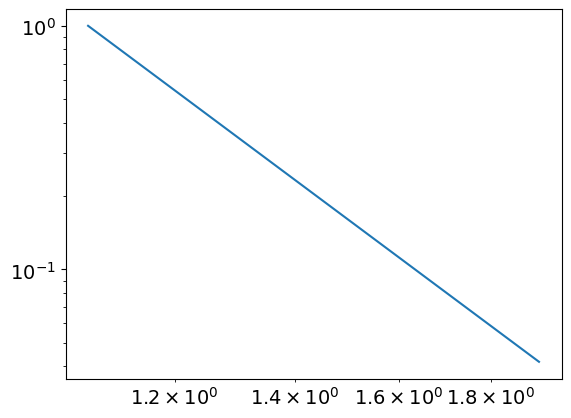

6.495510325007938
1.0741727819183073
powerlaw KstestResult(statistic=0.9902624236617684, pvalue=0.0, statistic_location=1.453074065494024, statistic_sign=1)
lognorm KstestResult(statistic=0.9833077726029558, pvalue=0.0, statistic_location=1.254313960679591, statistic_sign=1)
tensor(0.0686, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2131, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3665, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3983, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
290
tensor(4.8623e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


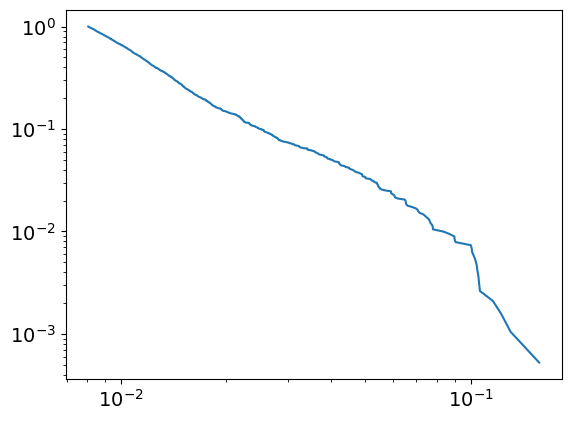

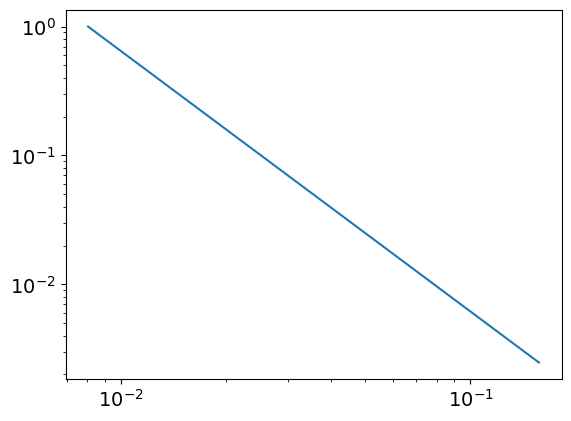

3.0213820620183407
0.00806158426767154
powerlaw KstestResult(statistic=0.9988298965785707, pvalue=0.0, statistic_location=0.09056174085734152, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1157393279186285, statistic_sign=-1)
tensor(-1.6738e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0748, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1689, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
290
tensor(0.2069, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


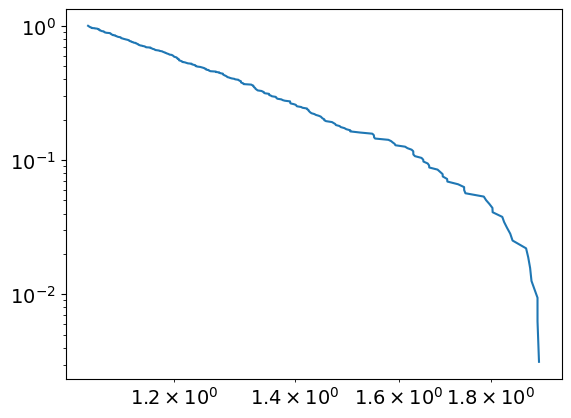

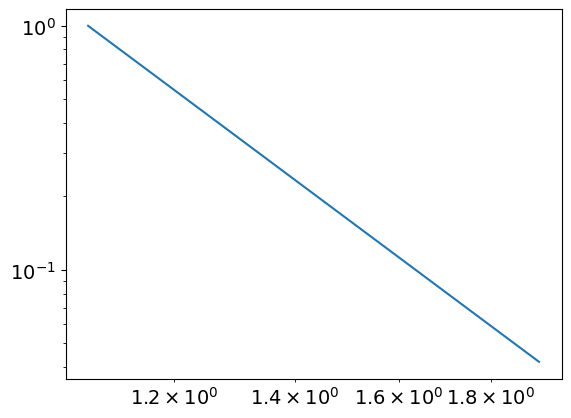

6.488438191350984
1.0745464829704725
powerlaw KstestResult(statistic=0.9902489782517722, pvalue=0.0, statistic_location=1.457403183323035, statistic_sign=1)
lognorm KstestResult(statistic=0.9832233664924086, pvalue=0.0, statistic_location=1.256738872159077, statistic_sign=1)
tensor(0.0686, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2132, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3679, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4027, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
291
tensor(4.5663e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


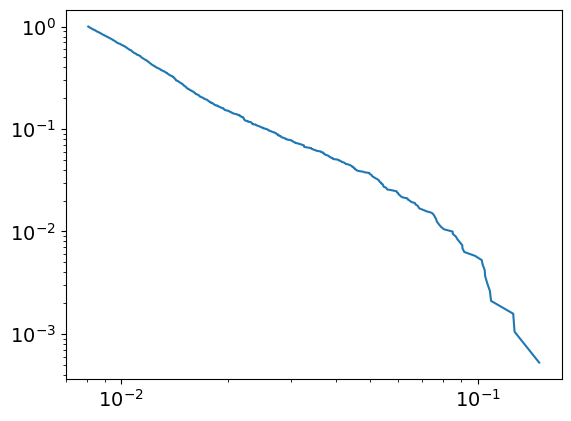

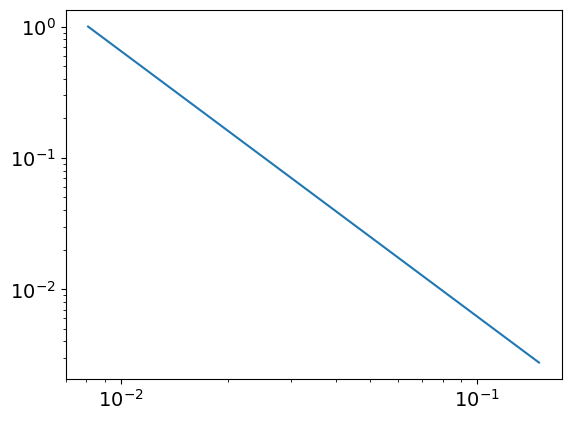

3.0227414781289133
0.008087470426402149
powerlaw KstestResult(statistic=0.9988081043176054, pvalue=0.0, statistic_location=0.09178379778749661, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.10909977126566738, statistic_sign=-1)
tensor(-6.9216e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1064, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.1132, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
291
tensor(0.2072, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


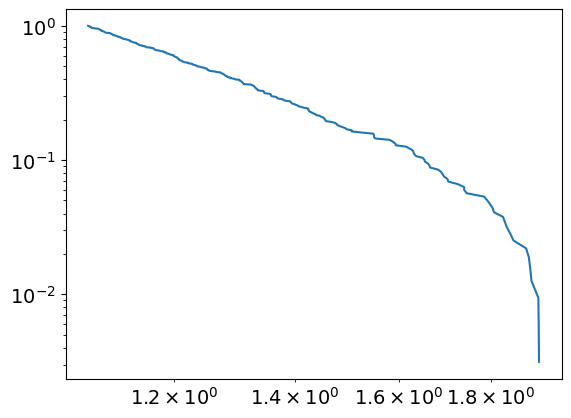

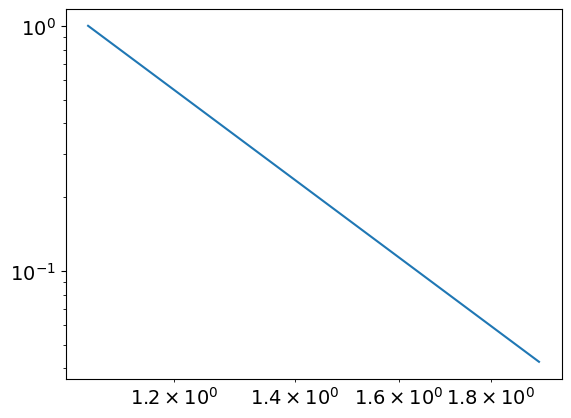

6.465068652174655
1.074281289528138
powerlaw KstestResult(statistic=0.9901972317900811, pvalue=0.0, statistic_location=1.4573444777022535, statistic_sign=1)
lognorm KstestResult(statistic=0.9831975852753123, pvalue=0.0, statistic_location=1.2537126658850988, statistic_sign=1)
tensor(0.0686, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2132, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3693, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4071, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
292
tensor(4.3223e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


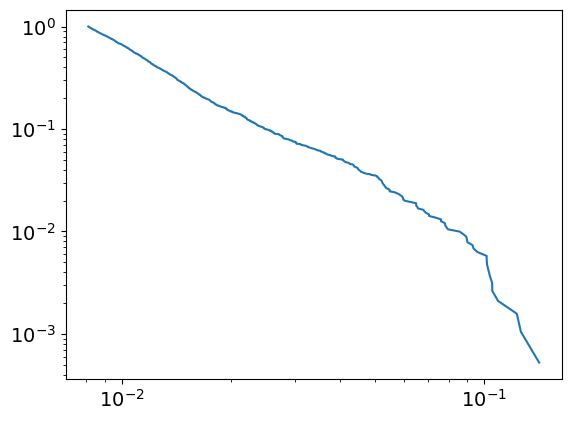

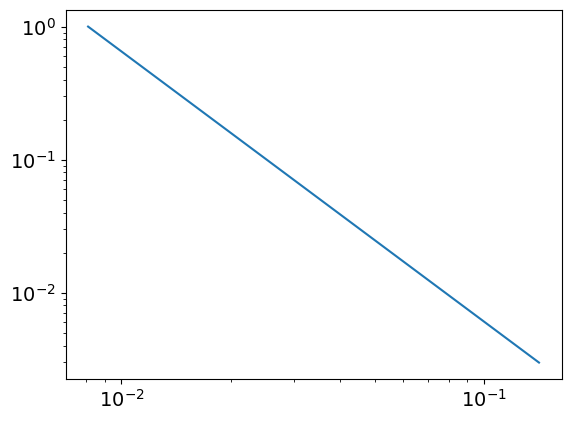

3.0303736632640836
0.00809013387119131
powerlaw KstestResult(statistic=0.9987833891208202, pvalue=0.0, statistic_location=0.09353247199153579, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14196849593870878, statistic_sign=1)
tensor(7.2248e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1167, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.4429, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
292
tensor(0.2076, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


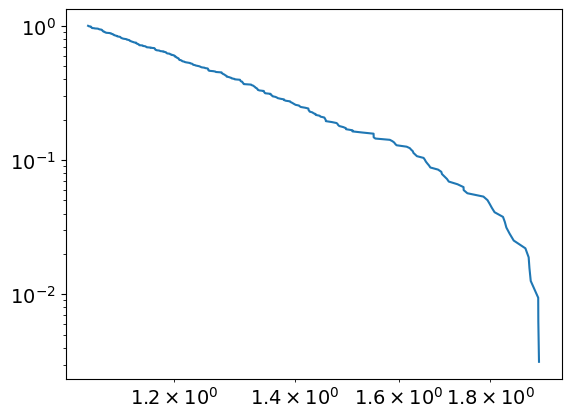

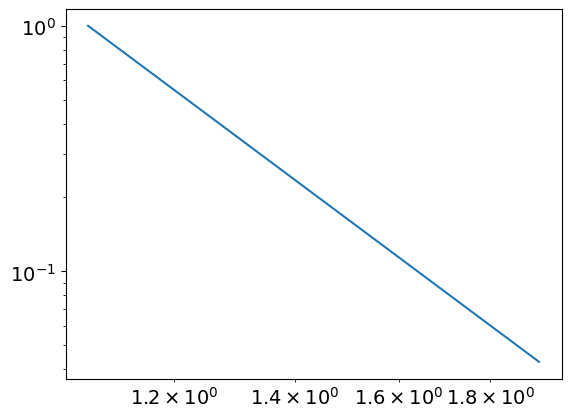

6.441827485730043
1.0740750773411674
powerlaw KstestResult(statistic=0.9901391162171849, pvalue=0.0, statistic_location=1.4574971855694447, statistic_sign=1)
lognorm KstestResult(statistic=0.9831972760631597, pvalue=0.0, statistic_location=1.2536928860388024, statistic_sign=1)
tensor(0.0687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2133, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3708, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4115, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
293
tensor(4.3049e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


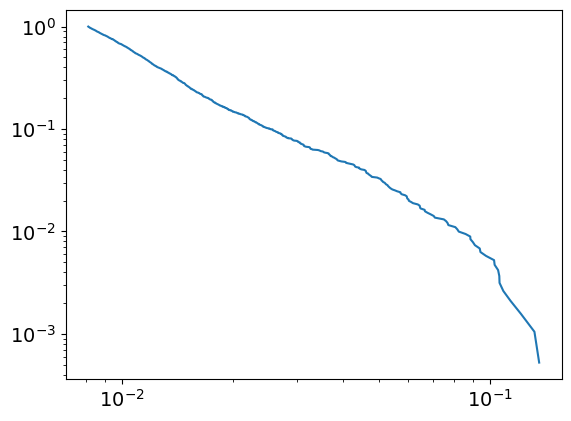

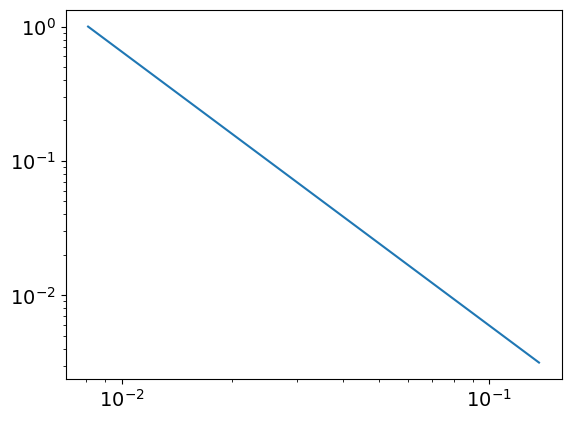

3.039234279177713
0.008099272507862031
powerlaw KstestResult(statistic=0.998785987315217, pvalue=0.0, statistic_location=0.0940292905920994, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.13642414319879026, statistic_sign=1)
tensor(4.8262e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0531, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.7734, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
293
tensor(0.2079, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


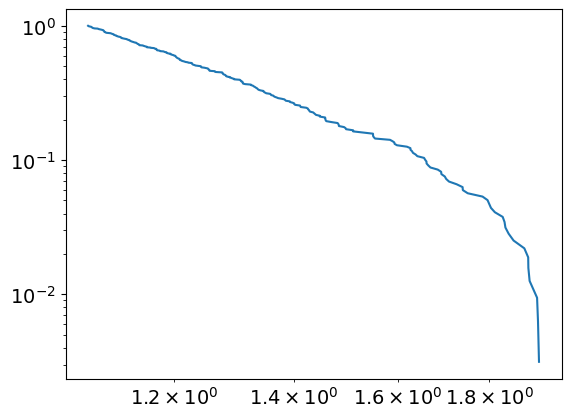

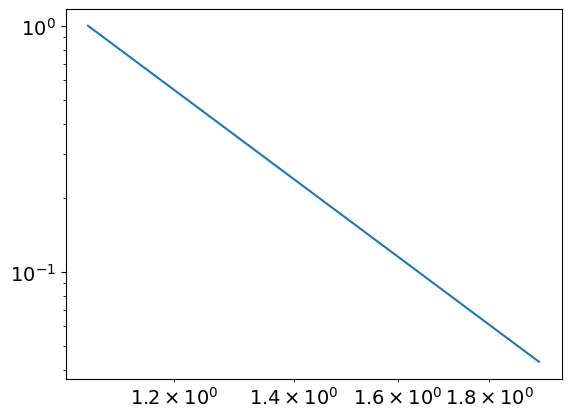

6.418170056168224
1.0737109708157342
powerlaw KstestResult(statistic=0.9900212382375924, pvalue=0.0, statistic_location=1.459075893036871, statistic_sign=1)
lognorm KstestResult(statistic=0.983134626488828, pvalue=0.0, statistic_location=1.2555775130797298, statistic_sign=1)
tensor(0.0687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2133, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3722, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4159, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
294
tensor(4.4064e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


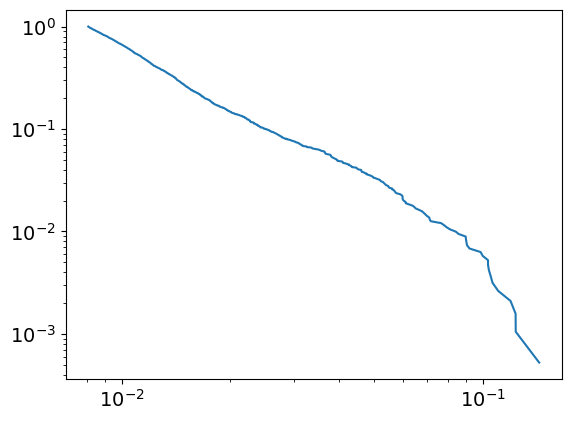

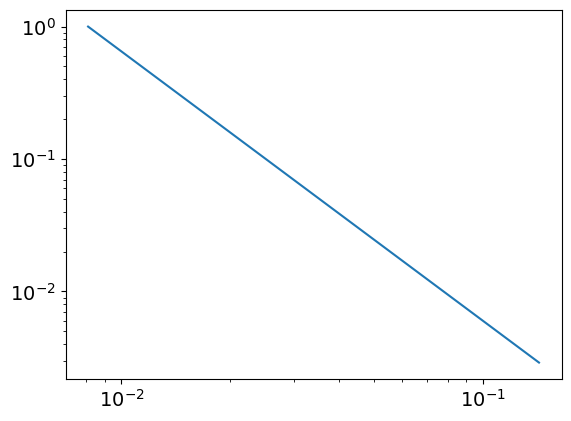

3.0322339548926363
0.0080861178060384
powerlaw KstestResult(statistic=0.9988585974445918, pvalue=0.0, statistic_location=0.0898186246585634, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14325715170428632, statistic_sign=1)
tensor(6.0061e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0545, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.0540, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
294
tensor(0.2083, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


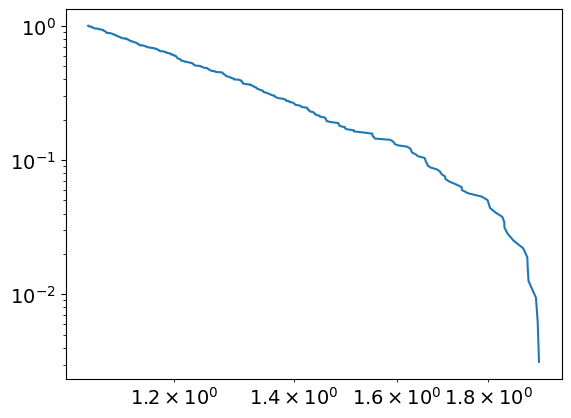

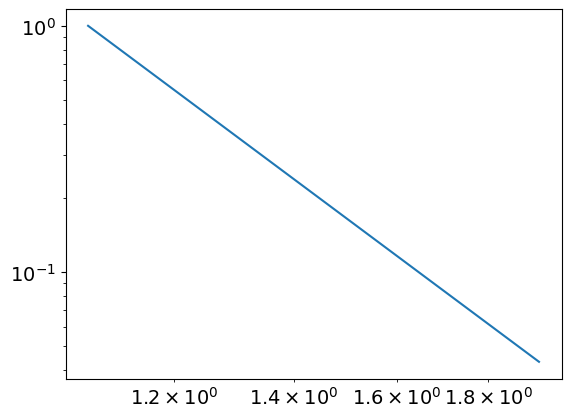

6.395282549609369
1.0734533121942627
powerlaw KstestResult(statistic=0.9898989187357989, pvalue=0.0, statistic_location=1.4607712213132398, statistic_sign=1)
lognorm KstestResult(statistic=0.9830337289885296, pvalue=0.0, statistic_location=1.2582501928136178, statistic_sign=1)
tensor(0.0687, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2134, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3737, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4202, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
295
tensor(4.4118e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


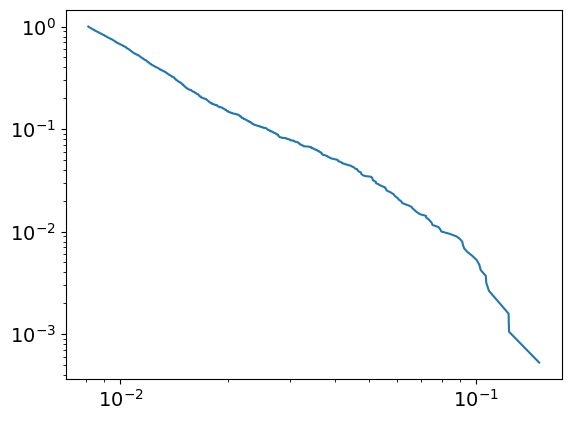

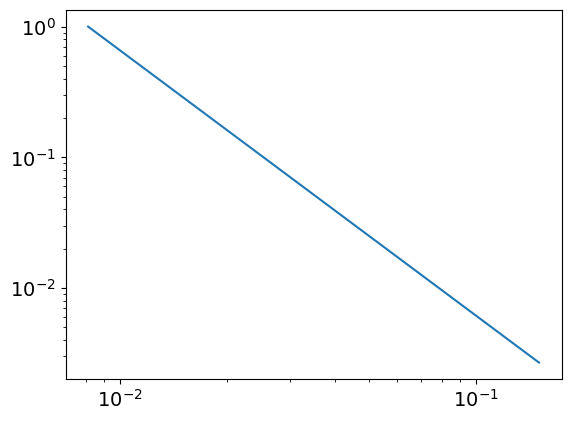

3.027843827021175
0.008117815492015906
powerlaw KstestResult(statistic=0.9987628093737335, pvalue=0.0, statistic_location=0.09437422425985703, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1501495980223951, statistic_sign=1)
tensor(2.9804e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3118, device='cuda:0', grad_fn=<MeanBackward0>) tensor(29.8988, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
295
tensor(0.2086, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


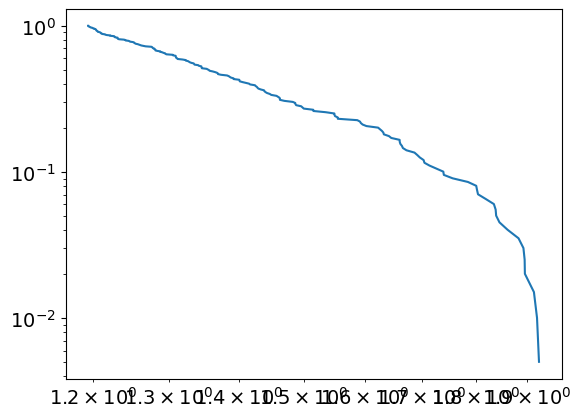

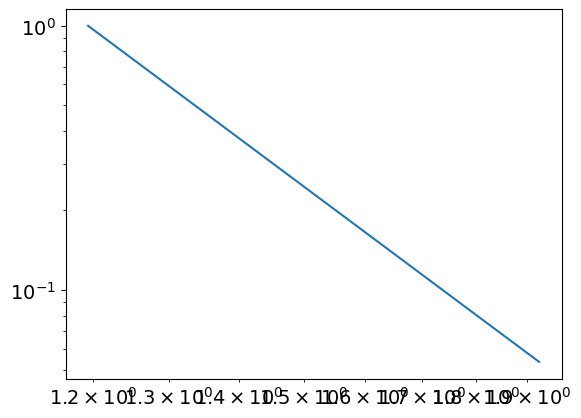

7.134159277575365
1.1936807478371265
powerlaw KstestResult(statistic=0.9935606603431133, pvalue=0.0, statistic_location=1.554870596932638, statistic_sign=1)
lognorm KstestResult(statistic=0.982947007152256, pvalue=0.0, statistic_location=1.2628453998426332, statistic_sign=1)
tensor(0.0688, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3752, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4247, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
296
tensor(4.8993e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


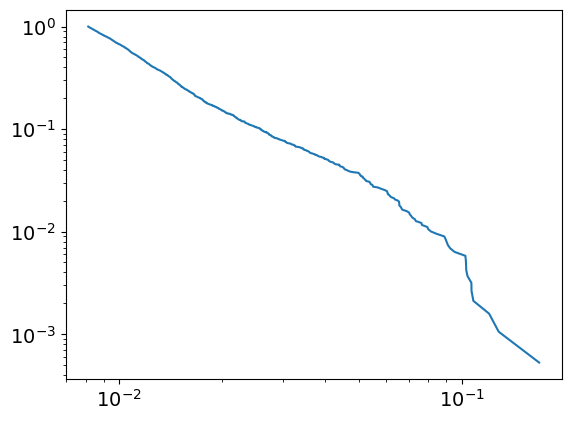

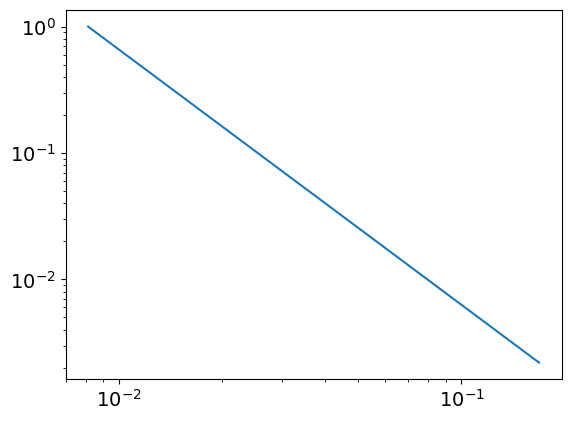

3.0180579736527915
0.008119640489899379
powerlaw KstestResult(statistic=0.9987256295508248, pvalue=0.0, statistic_location=0.09541681051096088, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16849700795478478, statistic_sign=1)
tensor(1.9151e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3890, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1703, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
296
tensor(0.2089, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


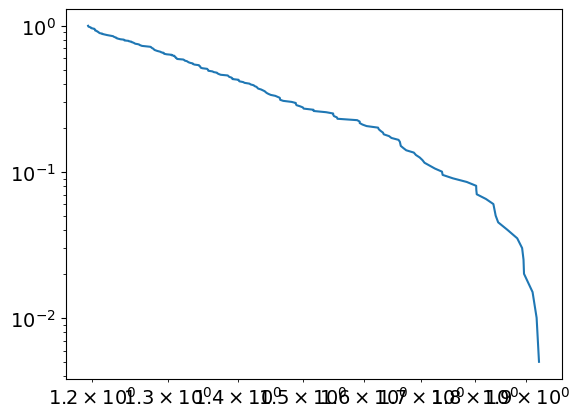

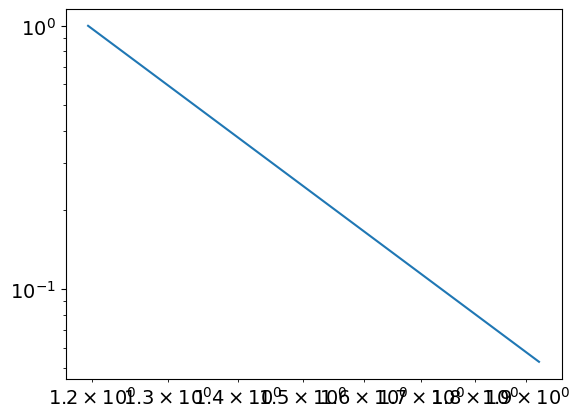

7.151399286825536
1.1949717159079678
powerlaw KstestResult(statistic=0.9935717903334885, pvalue=0.0, statistic_location=1.5562382468352498, statistic_sign=1)
lognorm KstestResult(statistic=0.9829403547153776, pvalue=0.0, statistic_location=1.2652024854396402, statistic_sign=1)
tensor(0.0688, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2135, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3766, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4290, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
297
tensor(5.4737e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


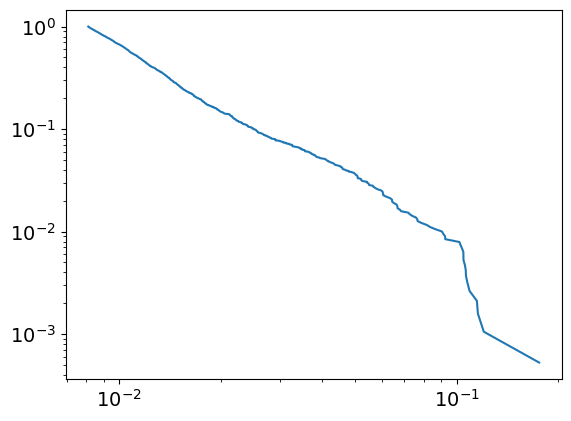

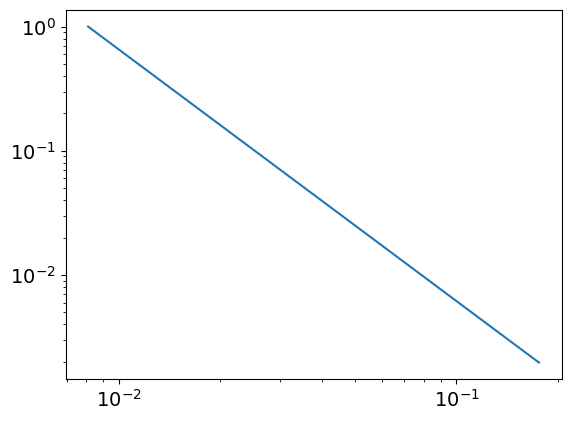

3.026049898424266
0.008109745521849763
powerlaw KstestResult(statistic=0.9987231253284892, pvalue=0.0, statistic_location=0.10641187626416747, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11560685201550047, statistic_sign=-1)
tensor(-8.6585e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2555, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6967, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
297
tensor(0.2093, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


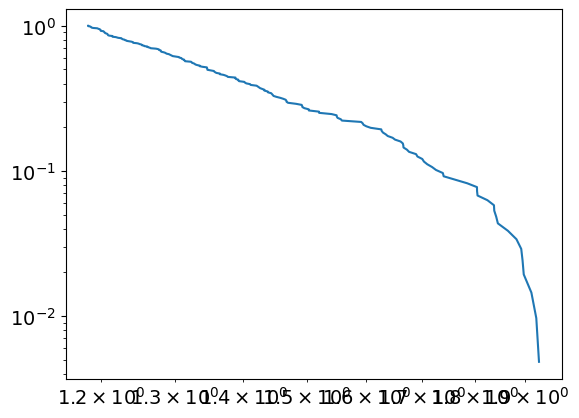

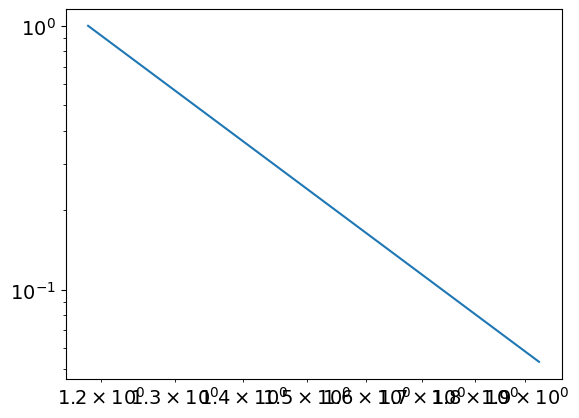

6.997393524582171
1.1830085502731398
powerlaw KstestResult(statistic=0.9932157992032482, pvalue=0.0, statistic_location=1.5579517591537881, statistic_sign=1)
lognorm KstestResult(statistic=0.982873150560877, pvalue=0.0, statistic_location=1.2662591923833466, statistic_sign=1)
tensor(0.0688, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2136, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3781, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4334, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
298
tensor(5.5057e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


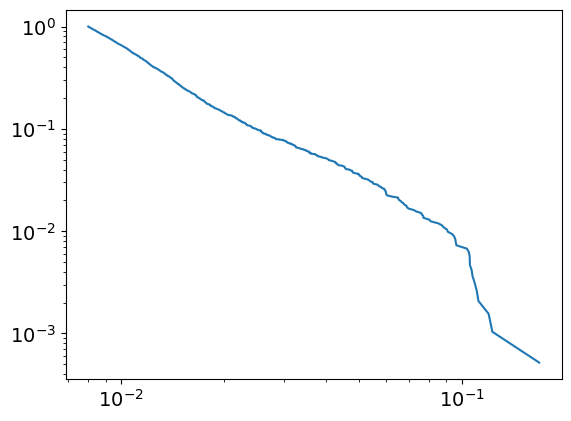

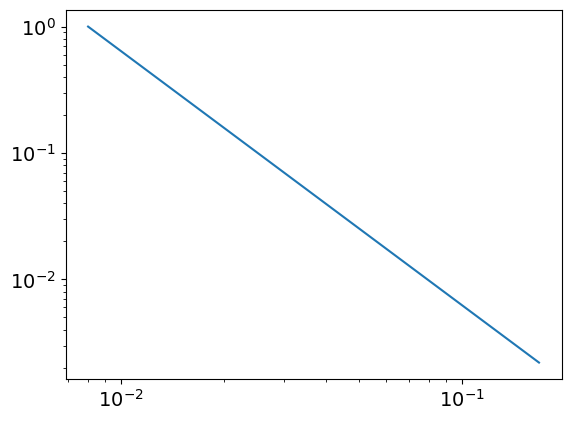

3.0085664621707813
0.008010147640018653
powerlaw KstestResult(statistic=0.9986955101969771, pvalue=0.0, statistic_location=0.09597964948365262, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11185699093693614, statistic_sign=-1)
tensor(-6.6246e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1811, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.1515, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
298
tensor(0.2097, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


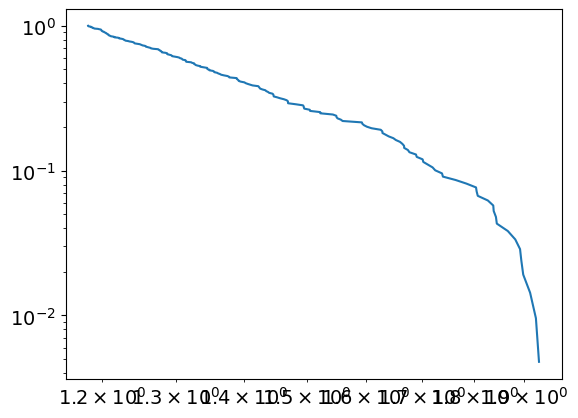

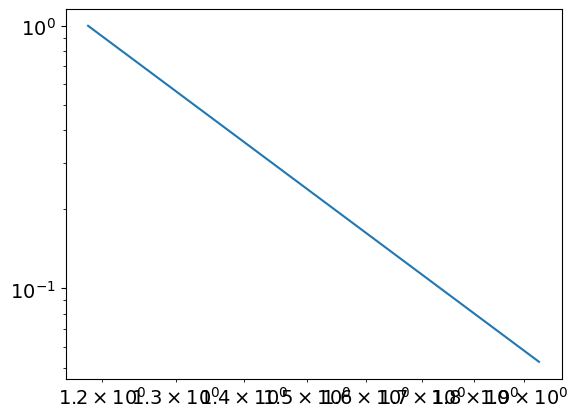

6.993817092835115
1.1818201136180422
powerlaw KstestResult(statistic=0.9931547110923307, pvalue=0.0, statistic_location=1.5596336178916212, statistic_sign=1)
lognorm KstestResult(statistic=0.9827808203660138, pvalue=0.0, statistic_location=1.2656697770956584, statistic_sign=1)
tensor(0.0689, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2137, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3796, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4377, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


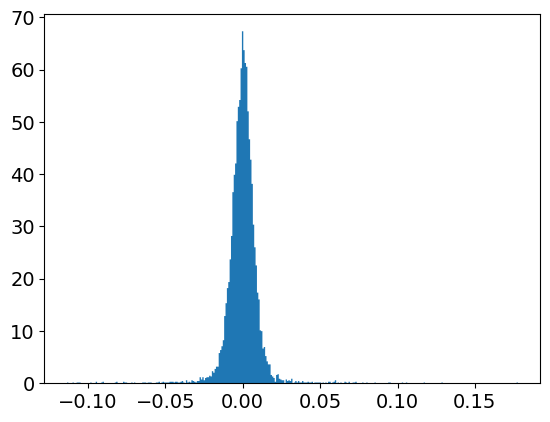

powerlaw
Calculating best minimal value for power law fit
6.373347980621626%
powerlaw KstestResult(statistic=0.9999999337566448, pvalue=0.0, statistic_location=0.17778182169292384, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11350680364211523, statistic_sign=-1)



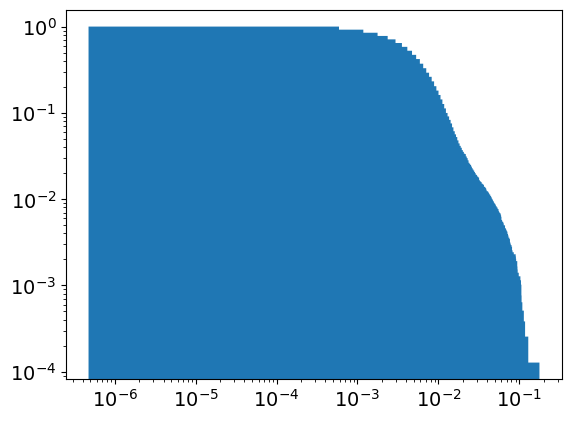

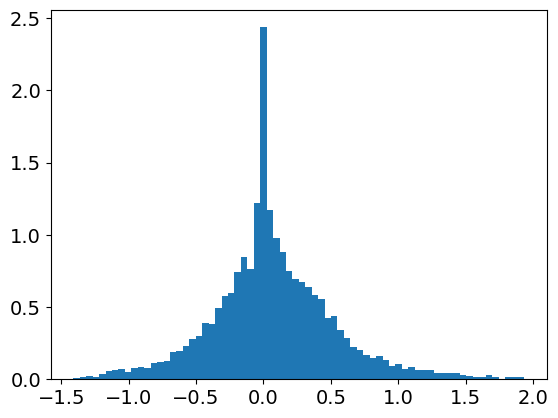

powerlaw
Calculating best minimal value for power law fit
3.0351399490164455
powerlaw KstestResult(statistic=0.9075105070371562, pvalue=0.0, statistic_location=0.7153422367155444, statistic_sign=1)
lognorm KstestResult(statistic=0.9826908753787552, pvalue=0.0, statistic_location=1.2650177092044466, statistic_sign=1)



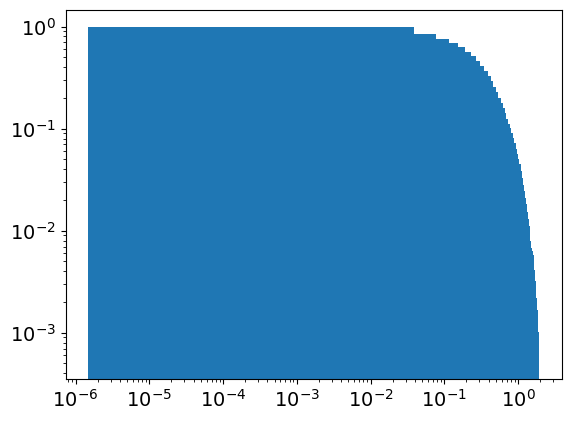

separation
epoch:
299
tensor(5.4636e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


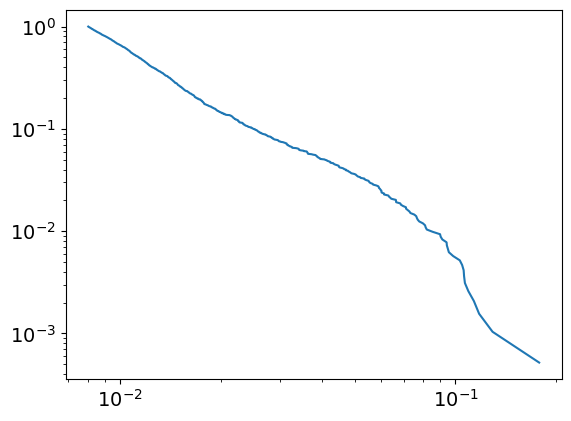

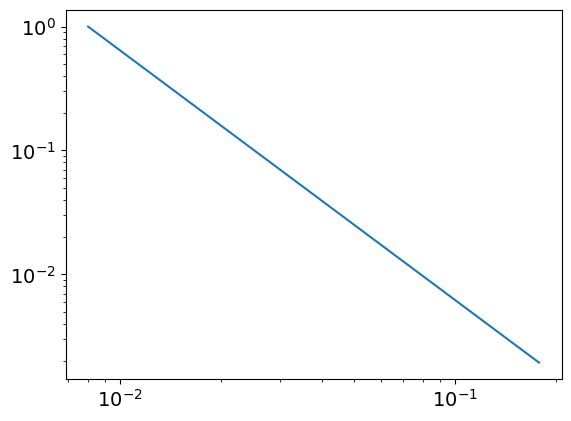

3.0156537384508324
0.00802302726720042
powerlaw KstestResult(statistic=0.9987159363855524, pvalue=0.0, statistic_location=0.09558834156526465, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11350680364211523, statistic_sign=-1)
tensor(-6.1146e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2492, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.3867, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
299
tensor(0.2100, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


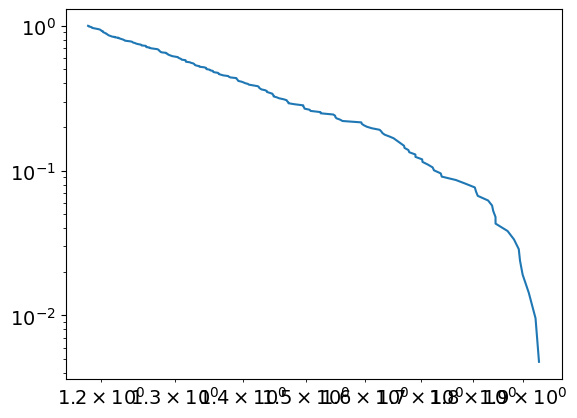

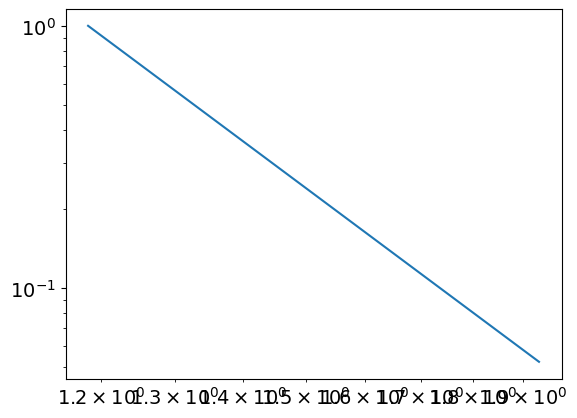

7.002580051699632
1.1828560413606617
powerlaw KstestResult(statistic=0.9931529910771275, pvalue=0.0, statistic_location=1.5612140118104825, statistic_sign=1)
lognorm KstestResult(statistic=0.9826908753787552, pvalue=0.0, statistic_location=1.2650177092044466, statistic_sign=1)
tensor(0.0689, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2137, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3811, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4420, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
300
tensor(4.8026e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


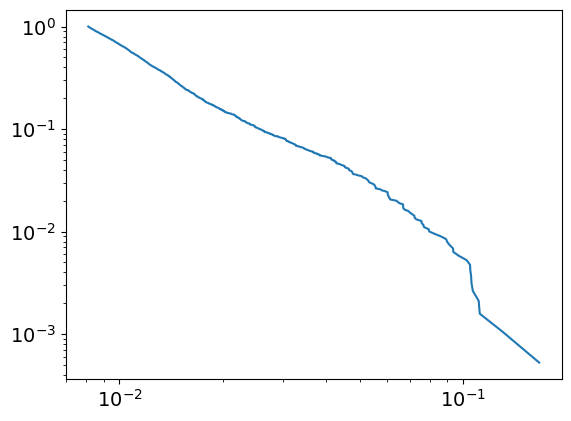

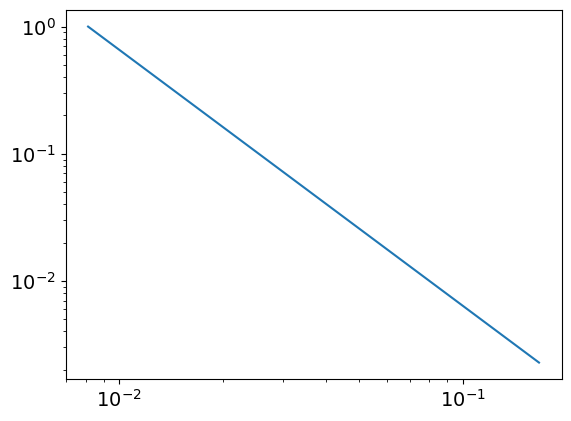

3.013256737419585
0.008113347264294666
powerlaw KstestResult(statistic=0.9987537483239293, pvalue=0.0, statistic_location=0.09377804775329858, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16672295829343, statistic_sign=1)
tensor(6.5077e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2562, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.4604, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
300
tensor(0.2104, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


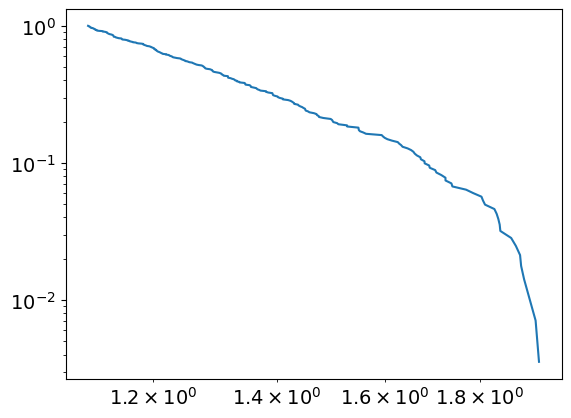

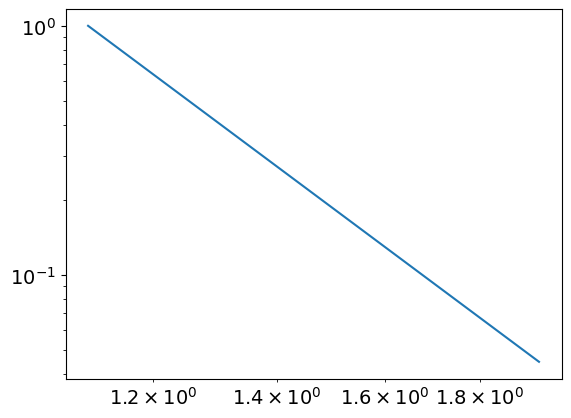

6.5576593800455205
1.107090559994288
powerlaw KstestResult(statistic=0.99094137779171, pvalue=0.0, statistic_location=1.4744285155094214, statistic_sign=1)
lognorm KstestResult(statistic=0.9825925141595029, pvalue=0.0, statistic_location=1.266558296708521, statistic_sign=1)
tensor(0.0690, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2138, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3826, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4464, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
301
tensor(5.7392e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


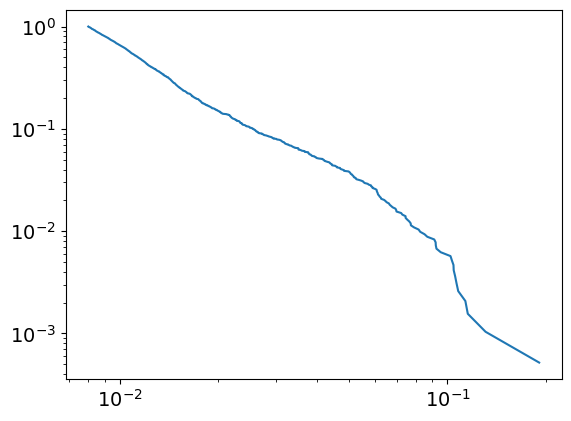

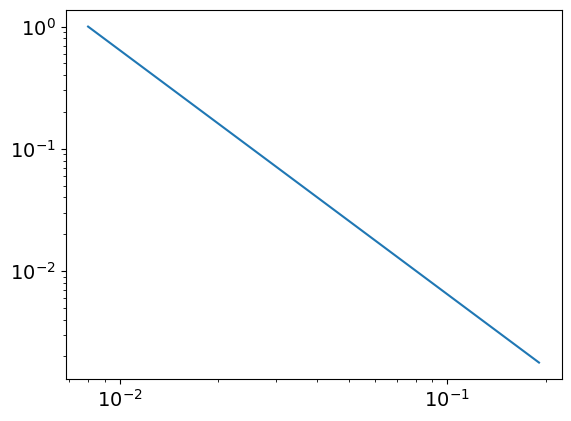

2.9981888321608263
0.008018493352572894
powerlaw KstestResult(statistic=0.9986923945905344, pvalue=0.0, statistic_location=0.09538670741118661, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1904470269502549, statistic_sign=1)
tensor(1.4034e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4584, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.7627, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
301
tensor(0.2108, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


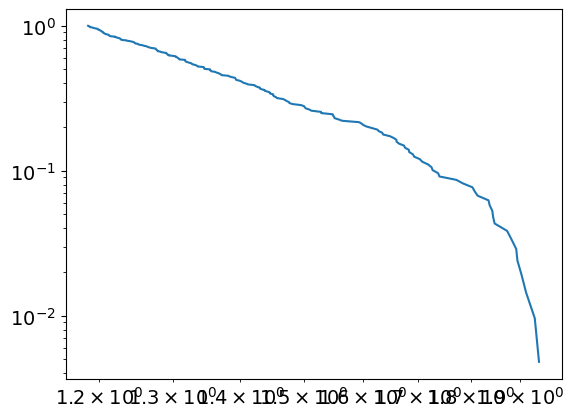

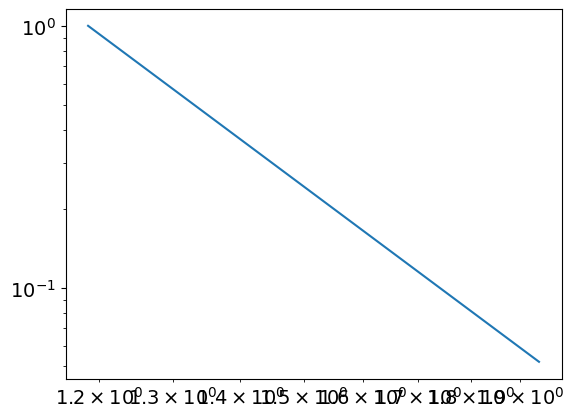

7.00392754565337
1.1855270357497416
powerlaw KstestResult(statistic=0.993139984701384, pvalue=0.0, statistic_location=1.5645872871927289, statistic_sign=1)
lognorm KstestResult(statistic=0.9824713975028403, pvalue=0.0, statistic_location=1.268294919626048, statistic_sign=1)
tensor(0.0690, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2139, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3841, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4508, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
302
tensor(7.2547e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


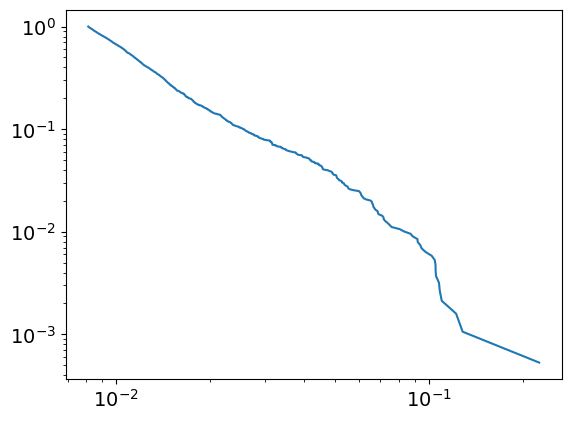

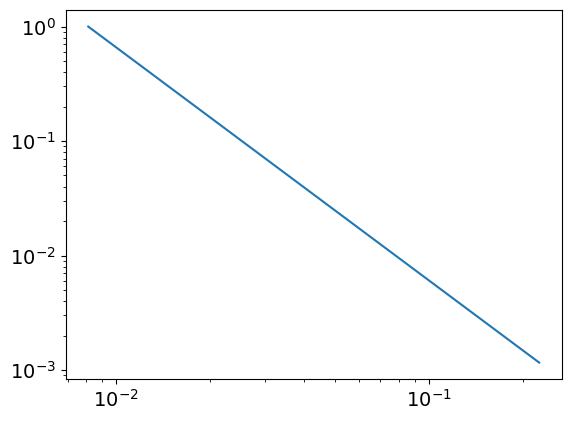

3.0362849113851813
0.008148642403690686
powerlaw KstestResult(statistic=0.9988183719191069, pvalue=0.0, statistic_location=0.1083872431141015, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22524260160118276, statistic_sign=1)
tensor(6.3374e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7793, device='cuda:0', grad_fn=<MeanBackward0>) tensor(46.4466, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
302
tensor(0.2111, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


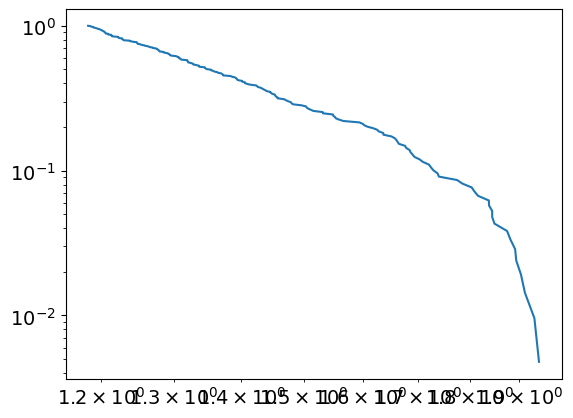

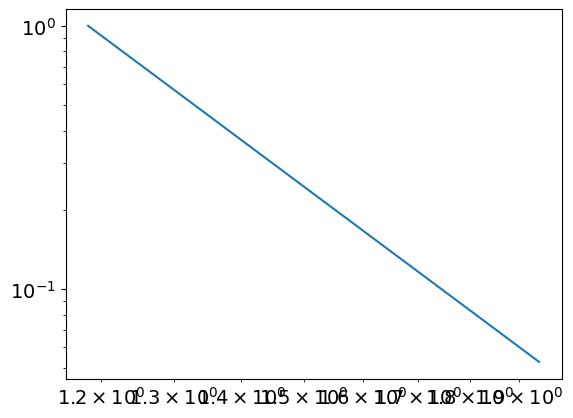

6.9244020634103896
1.182693802932805
powerlaw KstestResult(statistic=0.992982727322423, pvalue=0.0, statistic_location=1.5589739737484765, statistic_sign=1)
lognorm KstestResult(statistic=0.9823966955079501, pvalue=0.0, statistic_location=1.2655376941903929, statistic_sign=1)
tensor(0.0690, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2139, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3857, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4551, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
303
tensor(7.0034e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


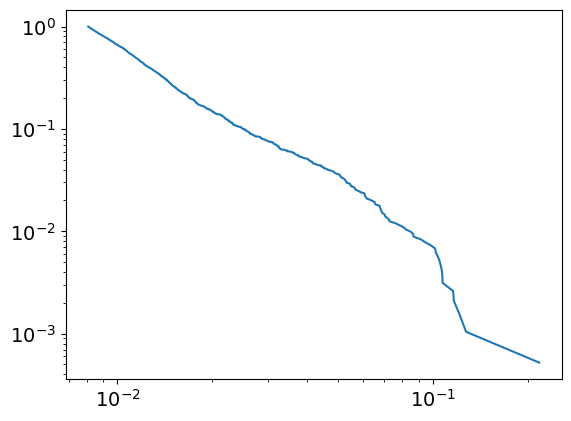

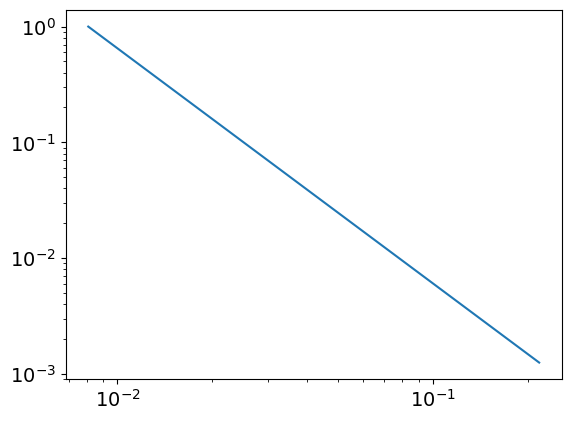

3.031881307851077
0.00807861148683673
powerlaw KstestResult(statistic=0.9987550198376279, pvalue=0.0, statistic_location=0.10564453889779639, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21689945764580343, statistic_sign=1)
tensor(2.1461e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7281, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.6254, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
303
tensor(0.2115, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


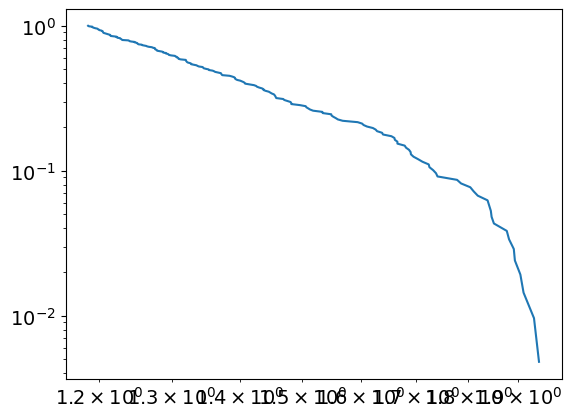

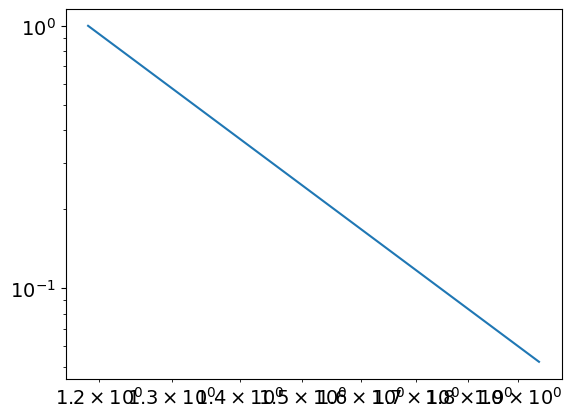

6.957288855252811
1.1855558976320446
powerlaw KstestResult(statistic=0.9930648462719872, pvalue=0.0, statistic_location=1.5595742569461541, statistic_sign=1)
lognorm KstestResult(statistic=0.9823046940846466, pvalue=0.0, statistic_location=1.2649080706000322, statistic_sign=1)
tensor(0.0691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2140, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3871, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4594, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
304
tensor(5.4969e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


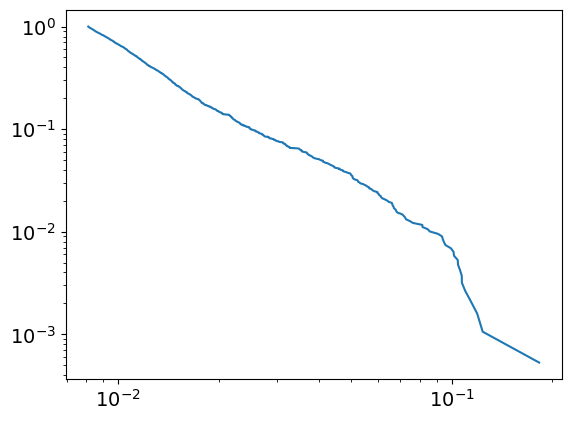

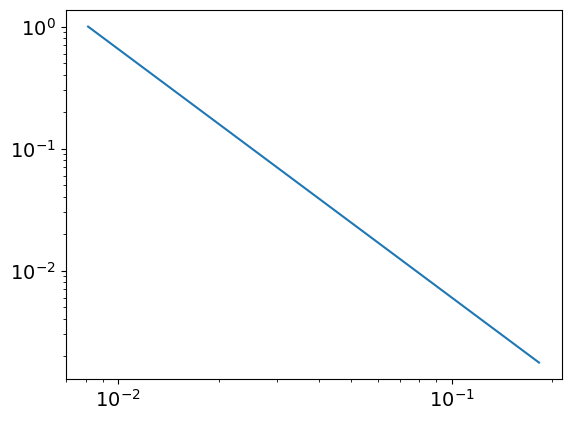

3.037695522400592
0.008130792637672923
powerlaw KstestResult(statistic=0.9987271222953028, pvalue=0.0, statistic_location=0.10716487409625691, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18265811550782055, statistic_sign=1)
tensor(1.2585e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4050, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.7976, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
304
tensor(0.2118, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


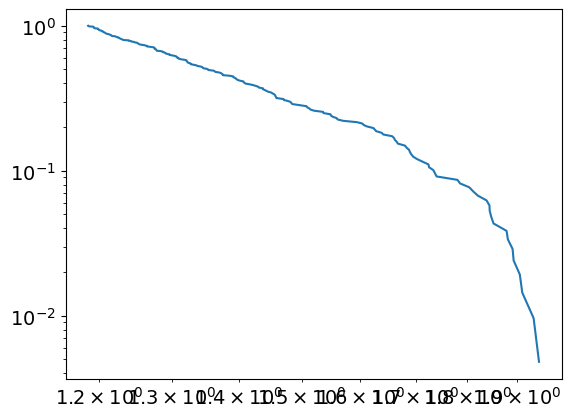

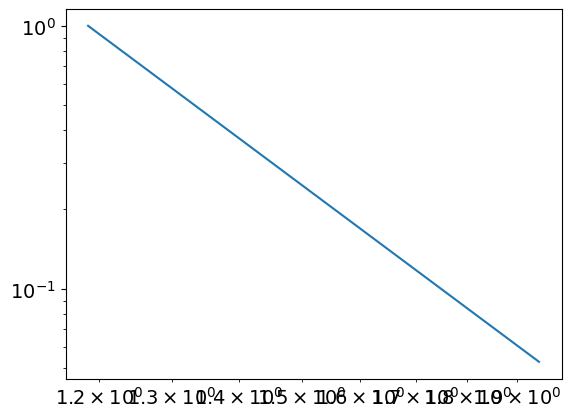

6.932902695204944
1.185514893297369
powerlaw KstestResult(statistic=0.9930266155226662, pvalue=0.0, statistic_location=1.5601376620343113, statistic_sign=1)
lognorm KstestResult(statistic=0.9823055692229093, pvalue=0.0, statistic_location=1.2648548133233124, statistic_sign=1)
tensor(0.0691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2140, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3887, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4636, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
305
tensor(5.1740e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


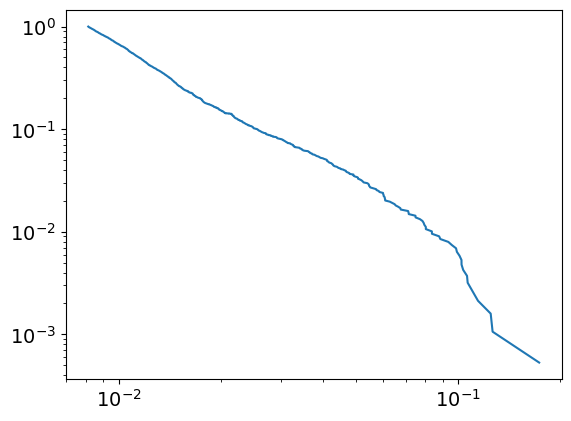

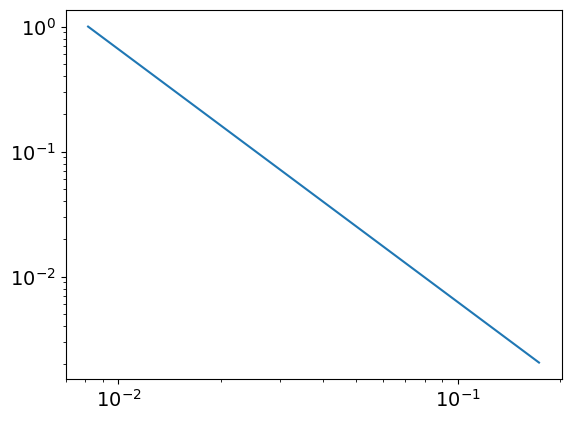

3.023936209494511
0.008142738603449199
powerlaw KstestResult(statistic=0.9987257474228686, pvalue=0.0, statistic_location=0.10619034588267545, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11438999137522378, statistic_sign=-1)
tensor(-9.1890e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2594, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.8125, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
305
tensor(0.2122, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


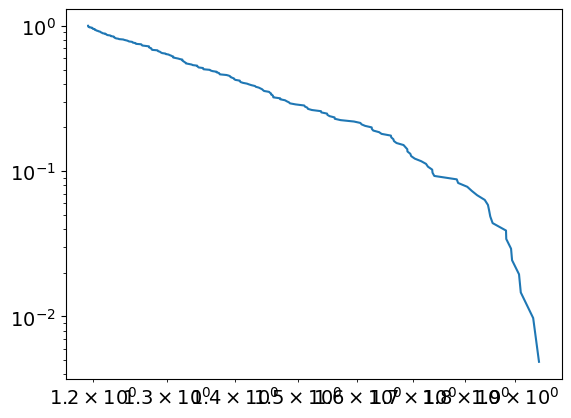

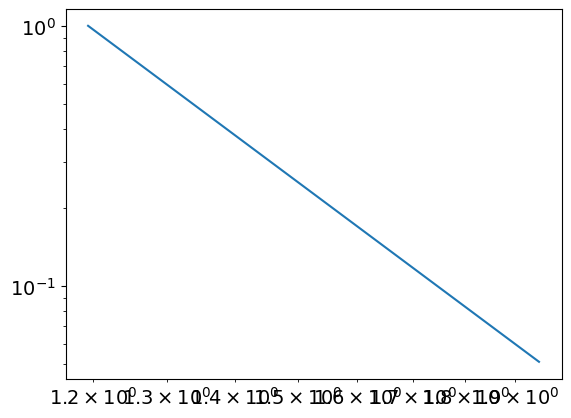

7.051862545106069
1.1931760402320284
powerlaw KstestResult(statistic=0.9932666404669106, pvalue=0.0, statistic_location=1.5610685986149568, statistic_sign=1)
lognorm KstestResult(statistic=0.9822421391013262, pvalue=0.0, statistic_location=1.265846468517674, statistic_sign=1)
tensor(0.0692, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2141, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3902, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4679, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
306
tensor(4.9130e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


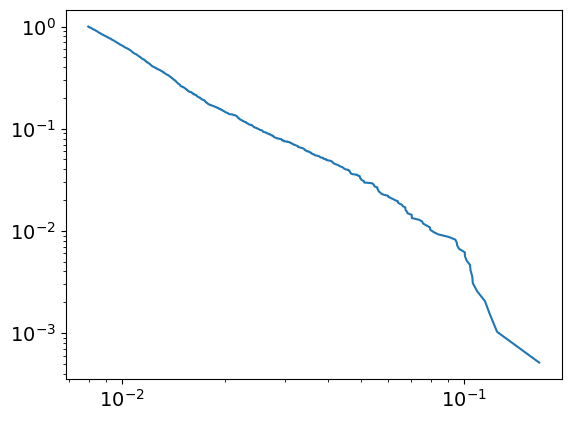

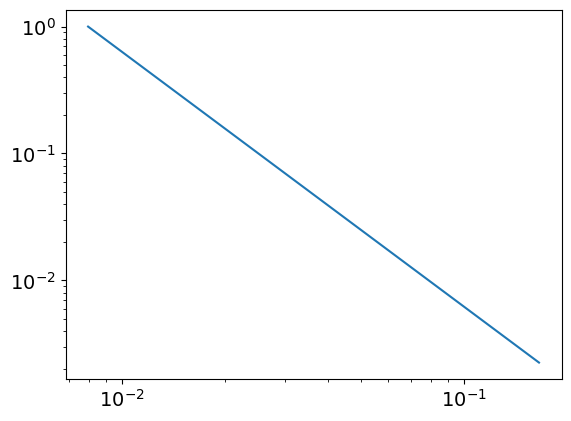

3.007932984987305
0.00797118870316625
powerlaw KstestResult(statistic=0.9987457313164788, pvalue=0.0, statistic_location=0.07969993853459284, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11522622993011086, statistic_sign=-1)
tensor(-1.4616e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1053, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.5189, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
306
tensor(0.2125, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


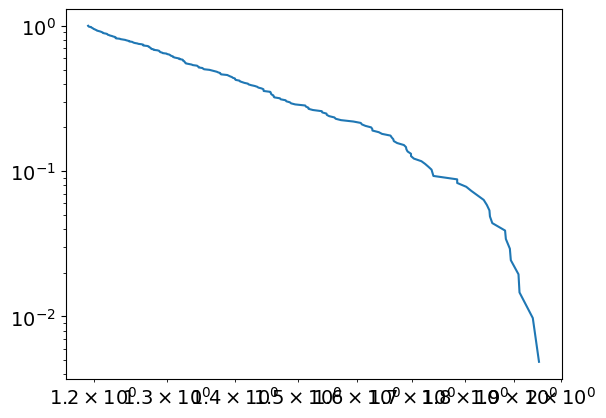

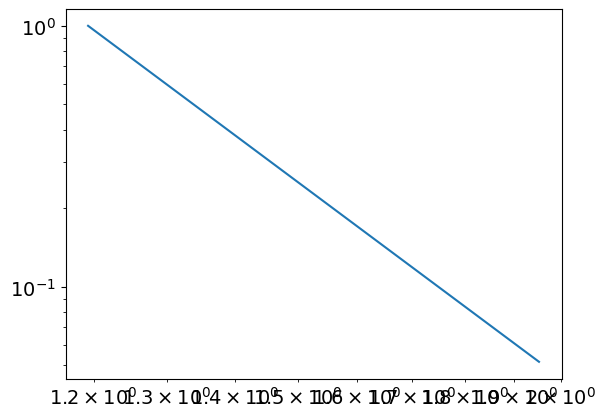

7.0170489765613775
1.1927898090433753
powerlaw KstestResult(statistic=0.9931859575628954, pvalue=0.0, statistic_location=1.5635384609843361, statistic_sign=1)
lognorm KstestResult(statistic=0.9821610968637525, pvalue=0.0, statistic_location=1.2670420688732642, statistic_sign=1)
tensor(0.0692, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2142, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3918, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4723, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
307
tensor(5.1102e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


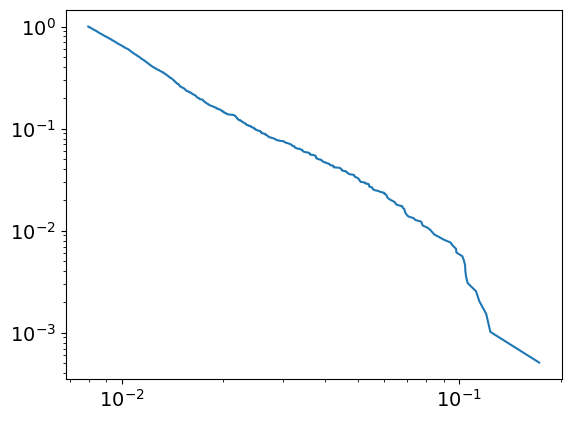

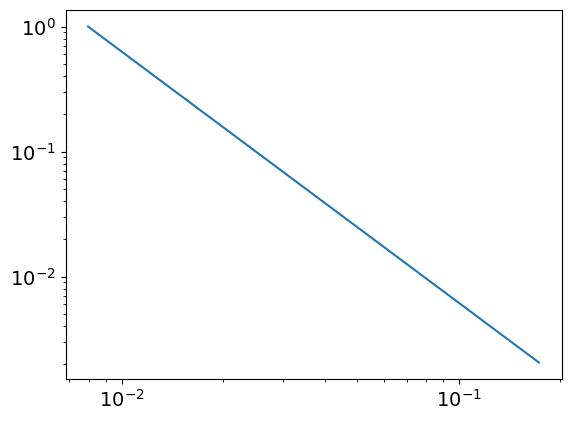

3.010892564738644
0.00795278507255229
powerlaw KstestResult(statistic=0.9987726958811564, pvalue=0.0, statistic_location=0.0780391863444406, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11479473261422231, statistic_sign=-1)
tensor(-2.5273e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0854, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.7545, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
307
tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


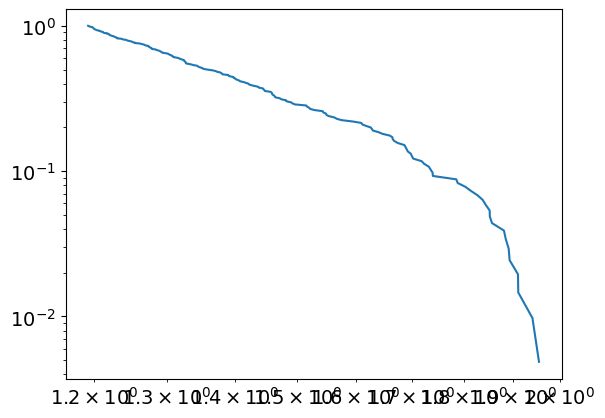

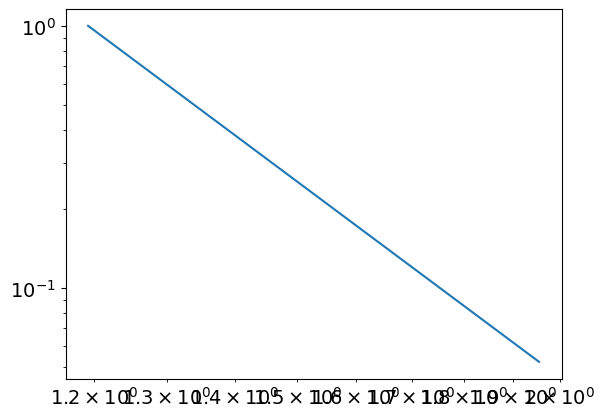

6.970188887585425
1.192032898275283
powerlaw KstestResult(statistic=0.993077630584088, pvalue=0.0, statistic_location=1.5660856979113165, statistic_sign=1)
lognorm KstestResult(statistic=0.981989422570786, pvalue=0.0, statistic_location=1.2549104613287376, statistic_sign=1)
tensor(0.0693, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2142, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3933, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4766, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
308
tensor(5.6491e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


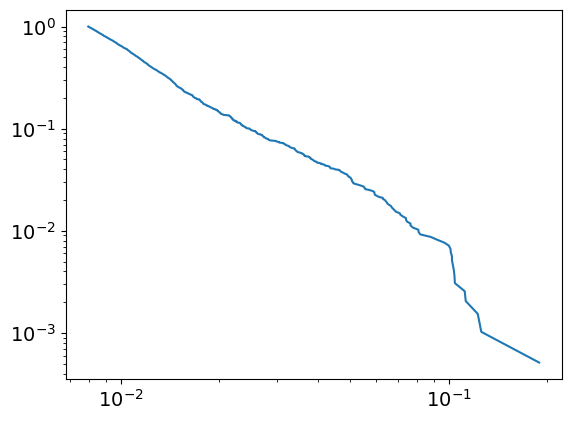

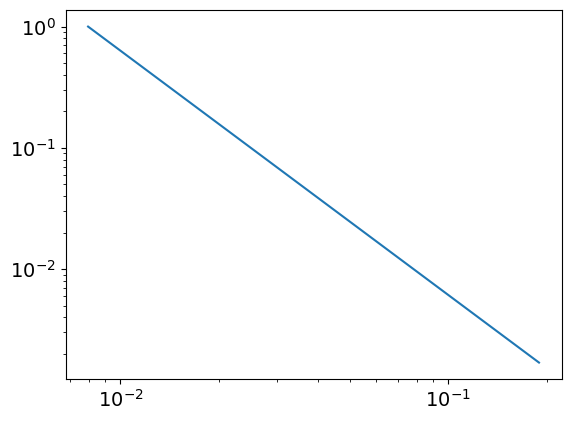

3.0160655618506906
0.007972067347502908
powerlaw KstestResult(statistic=0.9987799913438491, pvalue=0.0, statistic_location=0.07786574553061691, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11282873105439498, statistic_sign=-1)
tensor(-1.3556e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2584, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.0913, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
308
tensor(0.2132, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


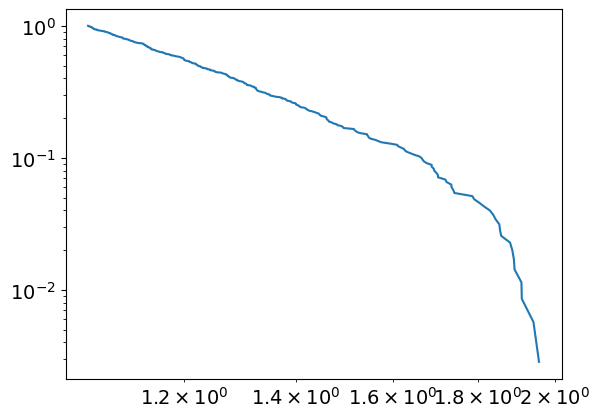

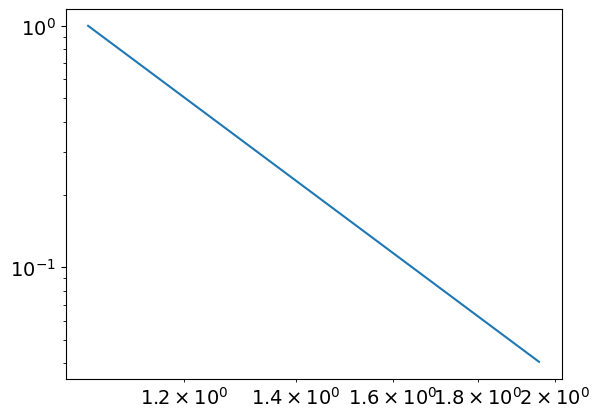

6.158401177472847
1.051719659420371
powerlaw KstestResult(statistic=0.9875859475464289, pvalue=0.0, statistic_location=1.4256055293905006, statistic_sign=1)
lognorm KstestResult(statistic=0.9819424159654936, pvalue=0.0, statistic_location=1.2561828760068194, statistic_sign=1)
tensor(0.0693, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2143, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3949, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4808, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
309
tensor(6.4559e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


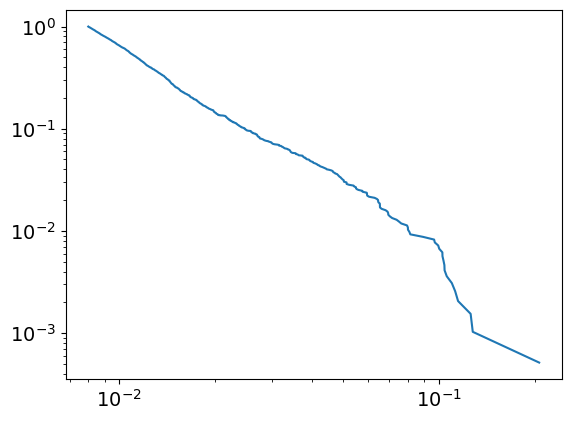

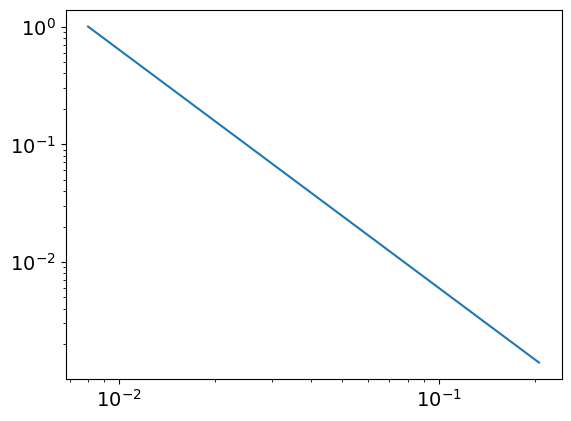

3.0233486534460416
0.00799972693608343
powerlaw KstestResult(statistic=0.9987756546497992, pvalue=0.0, statistic_location=0.10415355297753227, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1258311753168984, statistic_sign=-1)
tensor(-3.3264e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3072, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.0258, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
309
tensor(0.2136, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


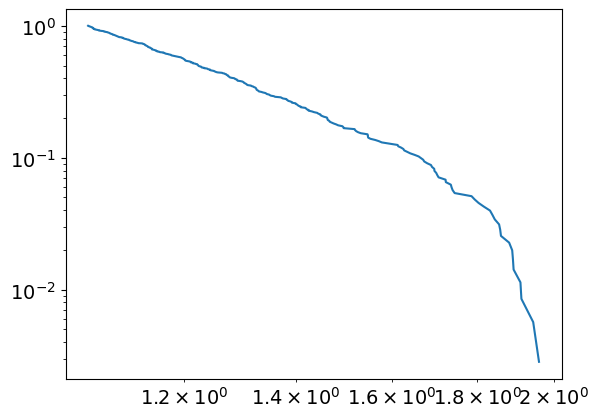

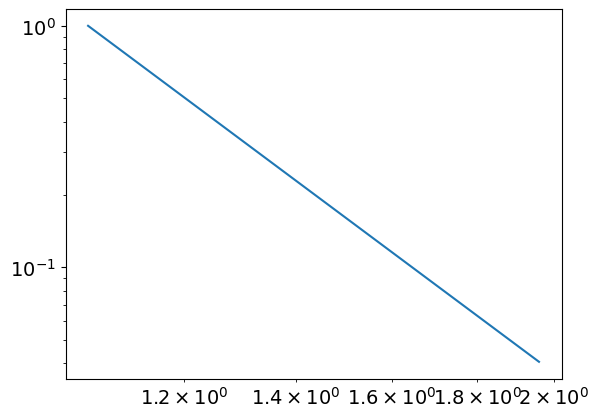

6.142568161879568
1.0509987086671553
powerlaw KstestResult(statistic=0.9875189610761481, pvalue=0.0, statistic_location=1.425657030681473, statistic_sign=1)
lognorm KstestResult(statistic=0.9818912893356753, pvalue=0.0, statistic_location=1.2574553205905437, statistic_sign=1)
tensor(0.0693, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2143, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3965, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4850, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
310
tensor(5.6783e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


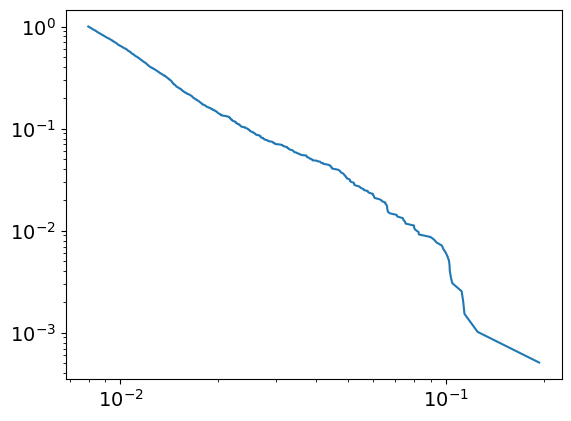

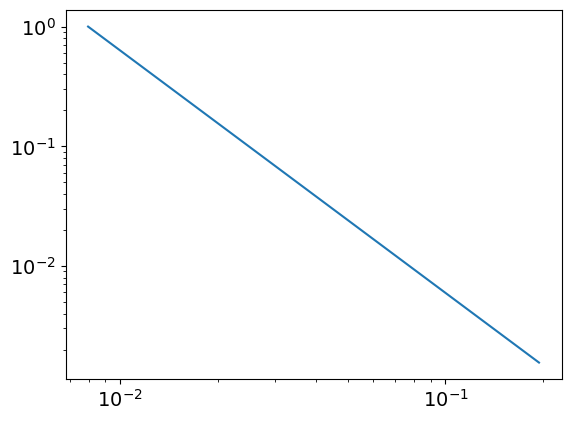

3.0254971036158995
0.007966073334777436
powerlaw KstestResult(statistic=0.9988103373676517, pvalue=0.0, statistic_location=0.1029496593668139, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1132007497749341, statistic_sign=-1)
tensor(-2.7726e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3635, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.7967, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
310
tensor(0.2139, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


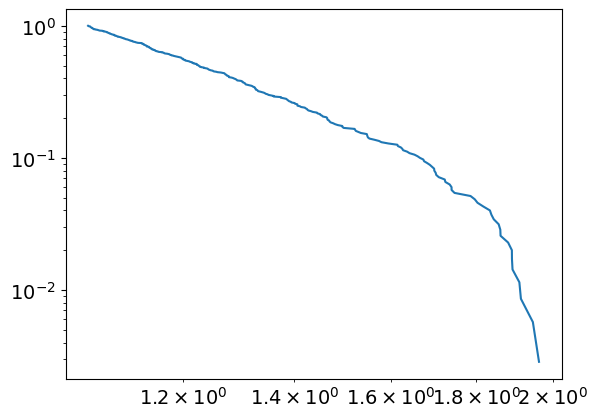

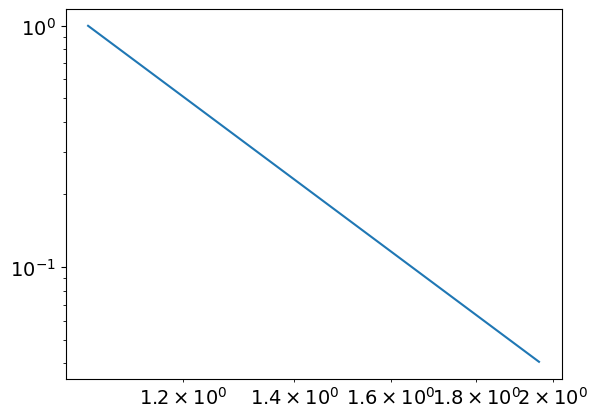

6.145884979088431
1.05279177583422
powerlaw KstestResult(statistic=0.9875291935539884, pvalue=0.0, statistic_location=1.4273886321530054, statistic_sign=1)
lognorm KstestResult(statistic=0.9818350787702537, pvalue=0.0, statistic_location=1.2587519708007784, statistic_sign=1)
tensor(0.0694, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2144, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3981, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4894, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
311
tensor(6.1673e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


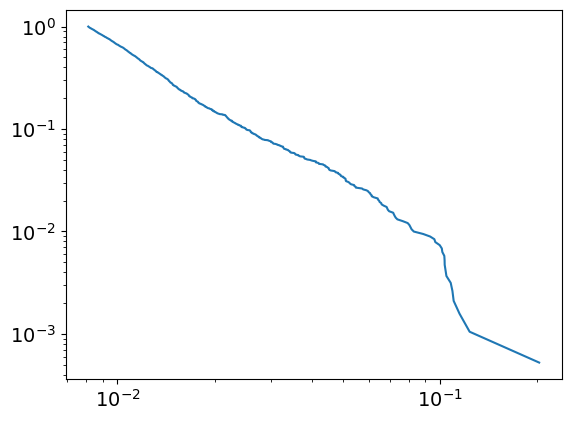

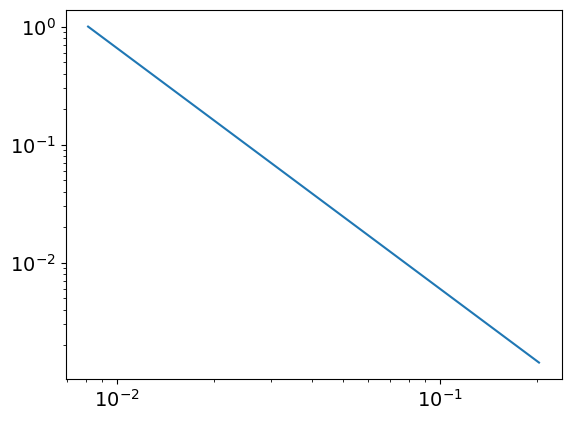

3.0372001338648436
0.008121682990372926
powerlaw KstestResult(statistic=0.9988358669576992, pvalue=0.0, statistic_location=0.10780217586141541, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2026298535100428, statistic_sign=1)
tensor(6.5545e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4074, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.0649, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
311
tensor(0.2143, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


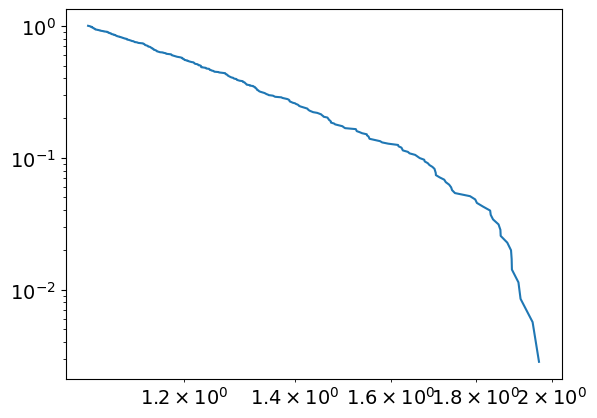

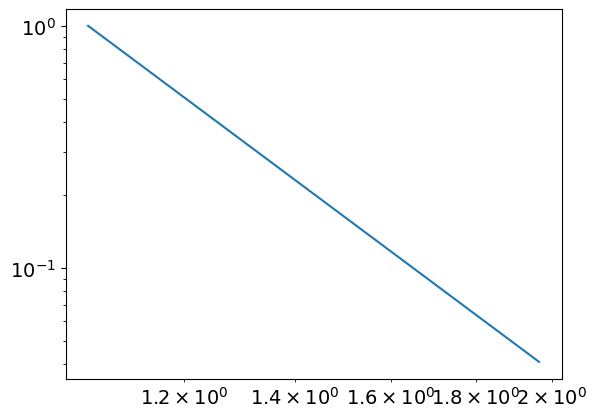

6.103732833389827
1.0504336882159646
powerlaw KstestResult(statistic=0.9872569123808581, pvalue=0.0, statistic_location=1.4291227830044584, statistic_sign=1)
lognorm KstestResult(statistic=0.9818200019985382, pvalue=0.0, statistic_location=1.2519768654787269, statistic_sign=1)
tensor(0.0694, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2145, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3997, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4937, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
312
tensor(7.5664e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


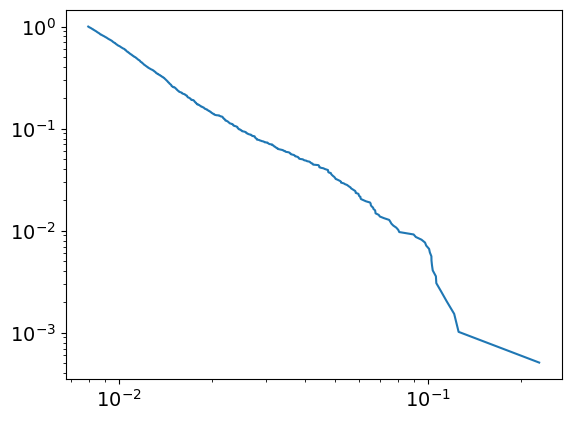

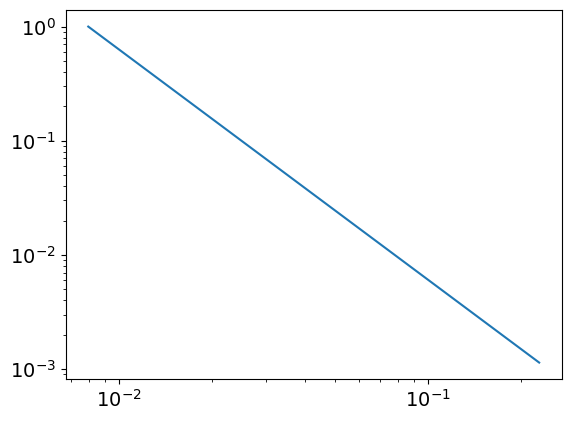

3.017969365014125
0.007964581950267549
powerlaw KstestResult(statistic=0.9988389867962193, pvalue=0.0, statistic_location=0.10607937692599809, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12561549504742386, statistic_sign=-1)
tensor(-5.7064e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5945, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.5053, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
312
tensor(0.2147, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


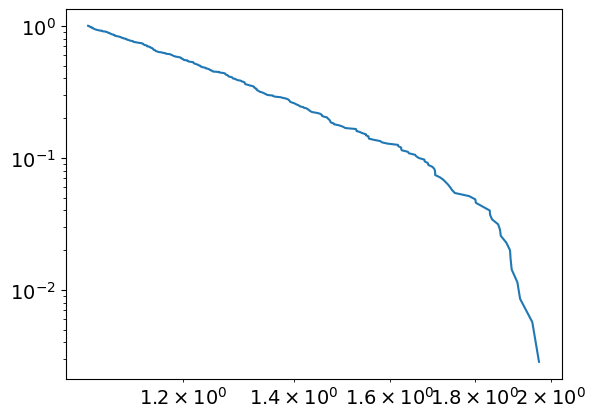

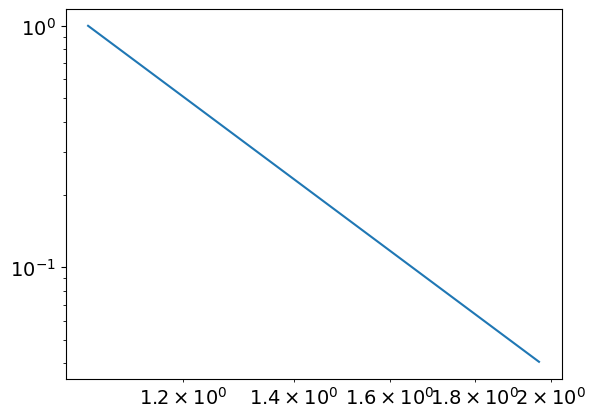

6.116365328089309
1.0520319266348799
powerlaw KstestResult(statistic=0.9873195963603327, pvalue=0.0, statistic_location=1.4358285033710976, statistic_sign=1)
lognorm KstestResult(statistic=0.9818382044677786, pvalue=0.0, statistic_location=1.251274029497276, statistic_sign=1)
tensor(0.0695, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2145, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4013, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.4979, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
313
tensor(8.0381e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


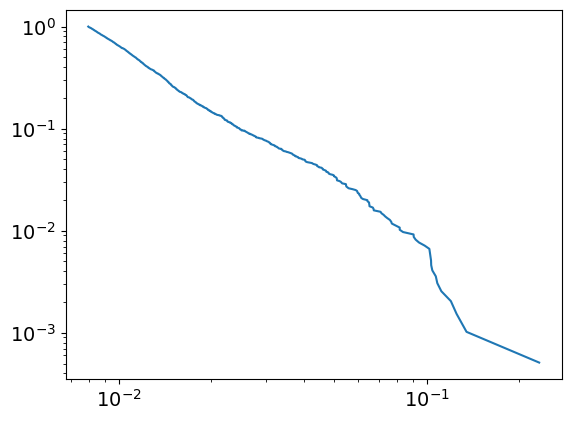

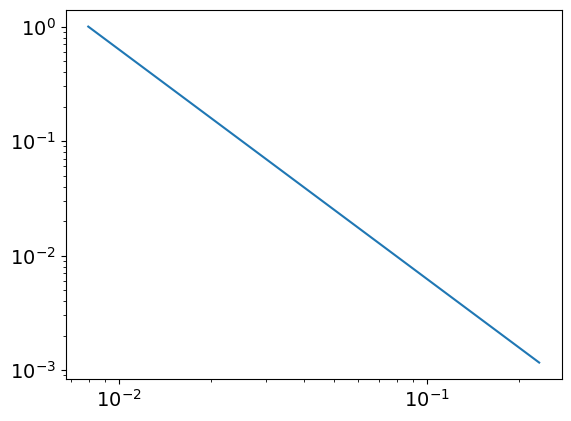

3.004377654451954
0.007965656742576696
powerlaw KstestResult(statistic=0.9988837568711614, pvalue=0.0, statistic_location=0.10343121795301369, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13471052538862052, statistic_sign=-1)
tensor(-9.8824e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4618, device='cuda:0', grad_fn=<MeanBackward0>) tensor(49.7527, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
313
tensor(0.2150, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


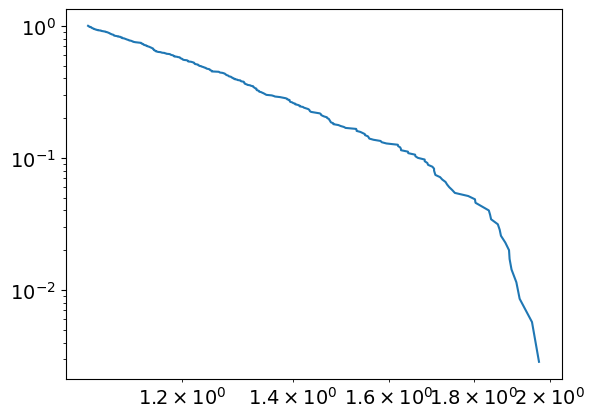

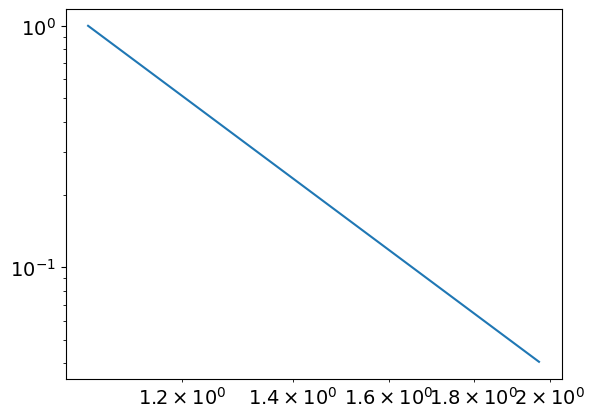

6.114113333108515
1.052952029341047
powerlaw KstestResult(statistic=0.9873683854181594, pvalue=0.0, statistic_location=1.4355346867562417, statistic_sign=1)
lognorm KstestResult(statistic=0.9818590011394467, pvalue=0.0, statistic_location=1.2504578844754717, statistic_sign=1)
tensor(0.0695, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2146, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4029, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5022, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
314
tensor(6.9885e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


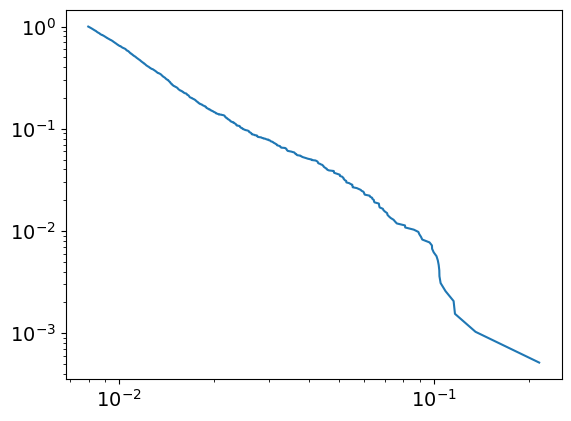

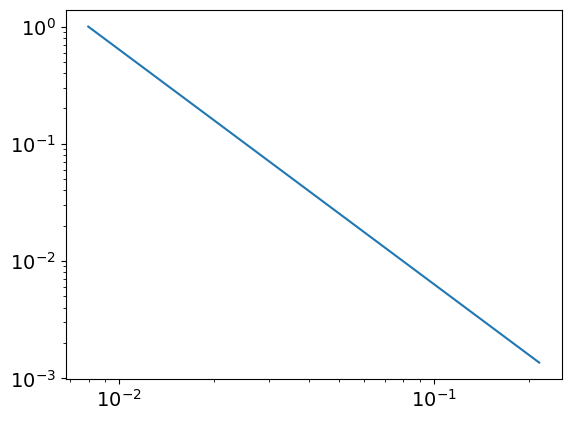

3.0019038387676775
0.007982052849489196
powerlaw KstestResult(statistic=0.9988599873487427, pvalue=0.0, statistic_location=0.10413115584562534, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1355833354152394, statistic_sign=-1)
tensor(-6.9473e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4021, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.7346, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
314
tensor(0.2153, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


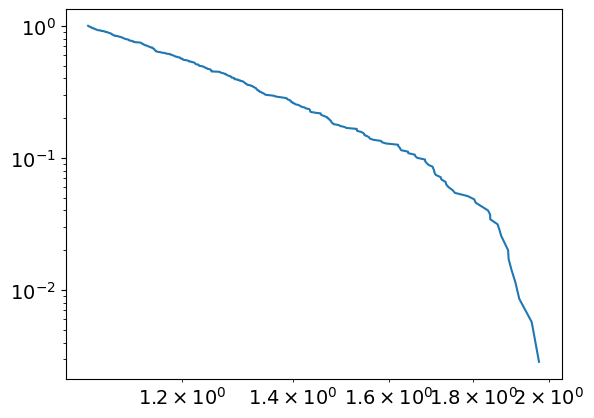

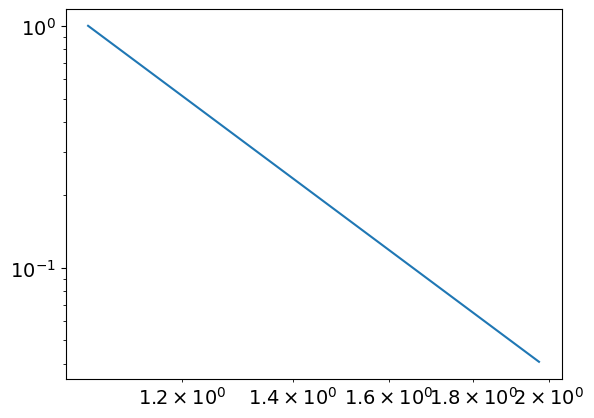

6.091835010877274
1.0525081665850025
powerlaw KstestResult(statistic=0.9872978989866018, pvalue=0.0, statistic_location=1.435302390699079, statistic_sign=1)
lognorm KstestResult(statistic=0.9818755870808954, pvalue=0.0, statistic_location=1.249757898664034, statistic_sign=1)
tensor(0.0696, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2146, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4045, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5065, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
315
tensor(7.9893e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


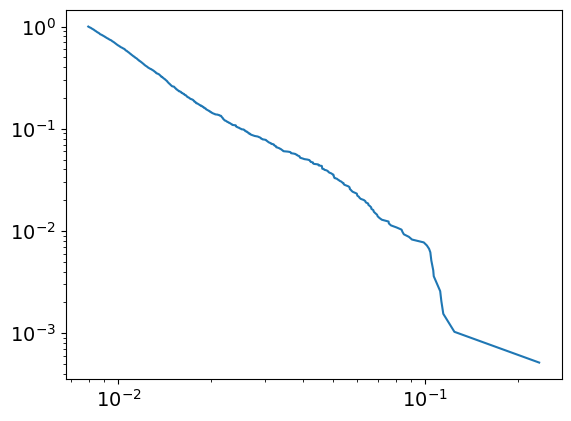

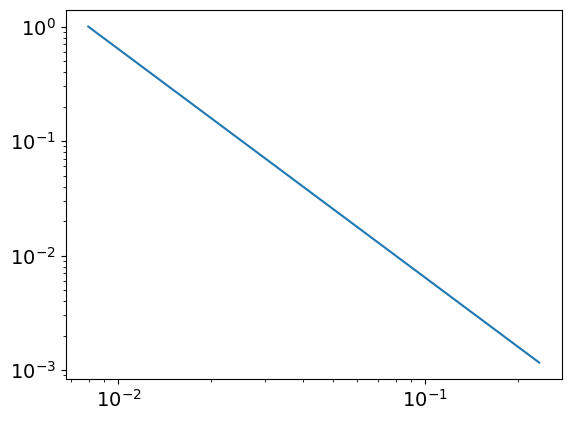

2.997535673135279
0.007978759088735412
powerlaw KstestResult(statistic=0.9987974822208874, pvalue=0.0, statistic_location=0.09046823543821028, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12436308319385082, statistic_sign=-1)
tensor(-1.5131e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5525, device='cuda:0', grad_fn=<MeanBackward0>) tensor(49.8527, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
315
tensor(0.2157, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


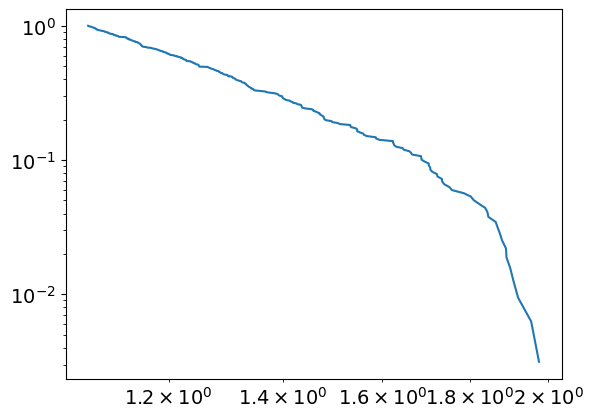

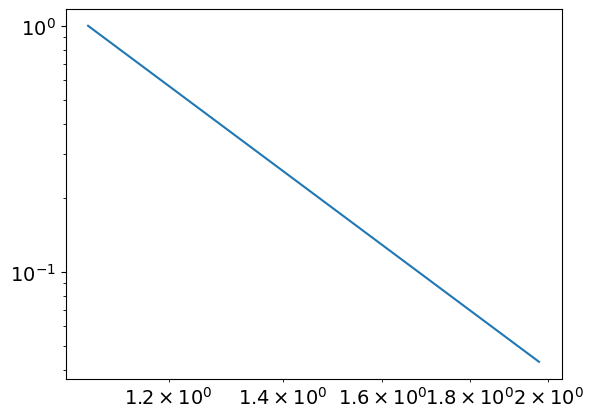

6.1813828063447005
1.076807708341536
powerlaw KstestResult(statistic=0.9883811252728801, pvalue=0.0, statistic_location=1.4364484942073579, statistic_sign=1)
lognorm KstestResult(statistic=0.9818514756918011, pvalue=0.0, statistic_location=1.2505978044114794, statistic_sign=1)
tensor(0.0696, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2147, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4061, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5107, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
316
tensor(5.2014e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


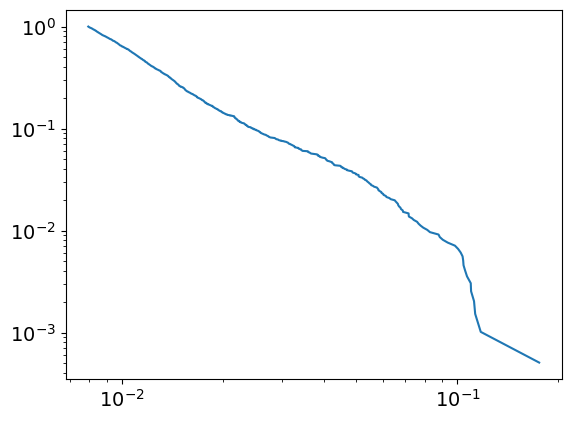

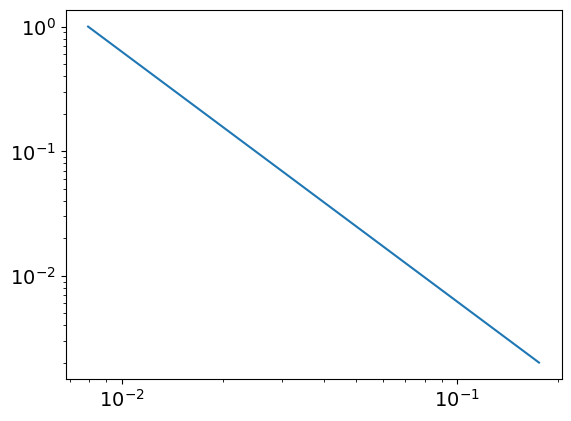

3.0065073129886497
0.007940073287497159
powerlaw KstestResult(statistic=0.9987940293065031, pvalue=0.0, statistic_location=0.10676967344000834, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11292271806463972, statistic_sign=-1)
tensor(-3.7000e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0449, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2865, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
316
tensor(0.2160, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


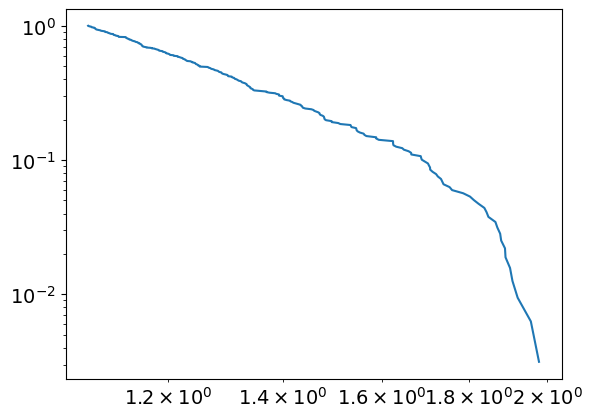

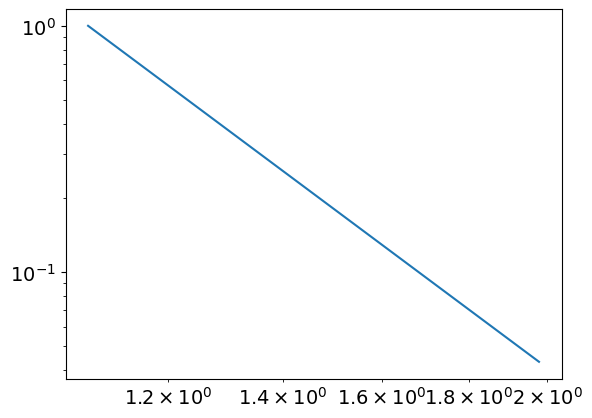

6.1704419159072135
1.0768870994480426
powerlaw KstestResult(statistic=0.9882885222485711, pvalue=0.0, statistic_location=1.4388109515692191, statistic_sign=1)
lognorm KstestResult(statistic=0.9818115082739005, pvalue=0.0, statistic_location=1.2519241898199118, statistic_sign=1)
tensor(0.0697, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2147, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4078, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5150, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
317
tensor(5.1217e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


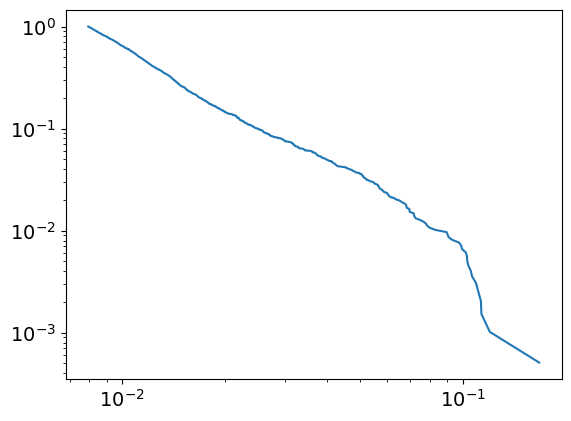

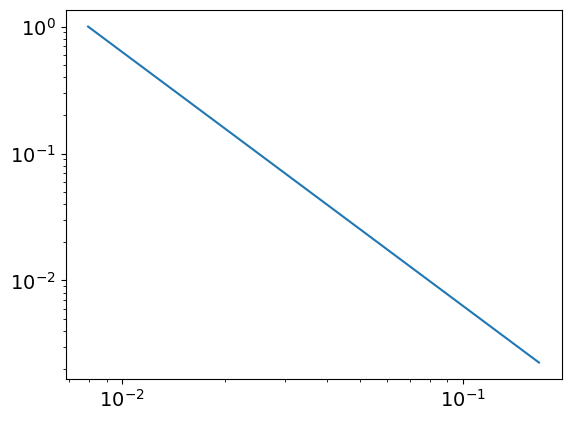

2.998632872112213
0.007944709602474788
powerlaw KstestResult(statistic=0.9987855008080538, pvalue=0.0, statistic_location=0.10646843430476191, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16758681662591707, statistic_sign=1)
tensor(2.9048e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0947, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.4259, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
317
tensor(0.2164, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


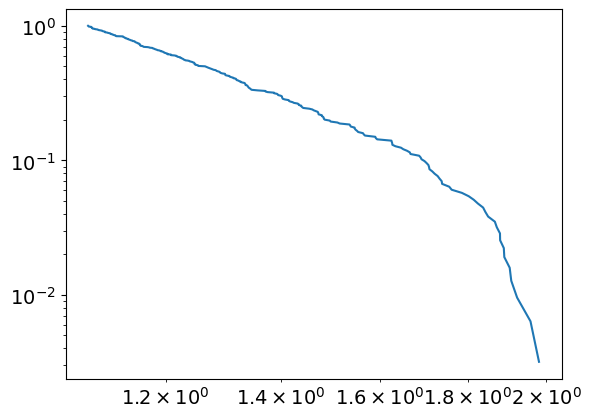

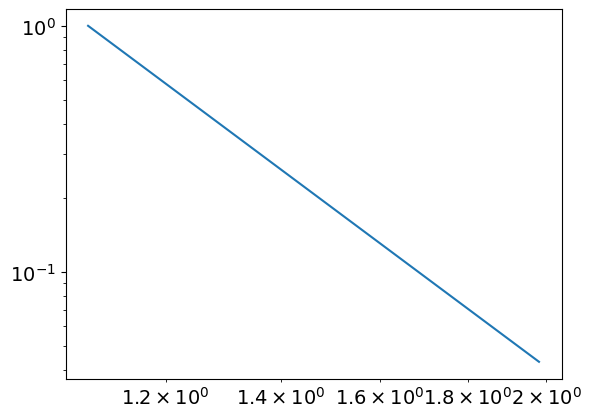

6.196798959577637
1.081140108749187
powerlaw KstestResult(statistic=0.9884622445446376, pvalue=0.0, statistic_location=1.4431840198870165, statistic_sign=1)
lognorm KstestResult(statistic=0.9817590584850299, pvalue=0.0, statistic_location=1.2535388289253901, statistic_sign=1)
tensor(0.0697, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2148, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4094, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5192, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
318
tensor(5.4775e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


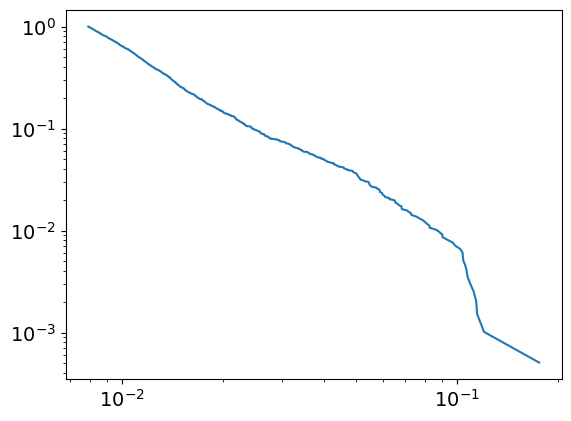

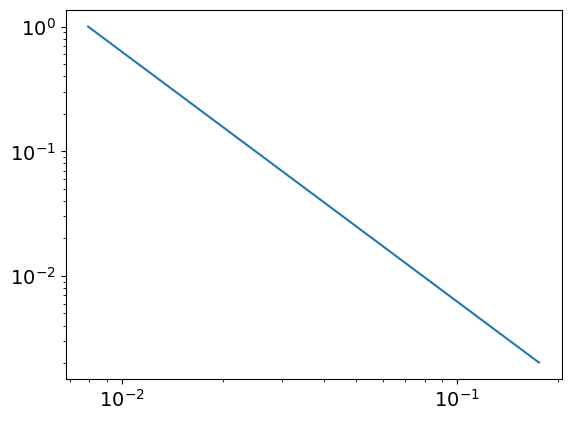

3.0029931683469733
0.007927959322701692
powerlaw KstestResult(statistic=0.9987894509810668, pvalue=0.0, statistic_location=0.10664803999824628, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11465512597548691, statistic_sign=-1)
tensor(-3.0067e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.1287, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.3573, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
318
tensor(0.2168, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


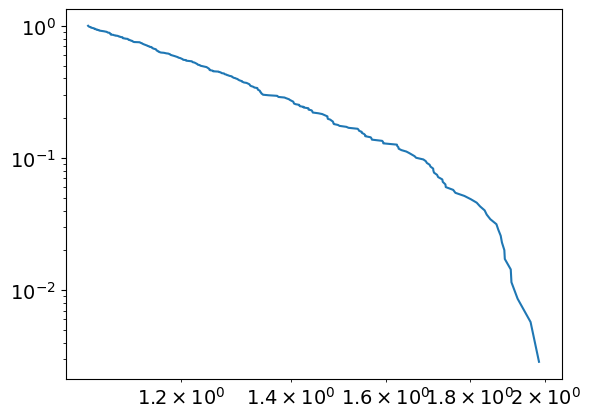

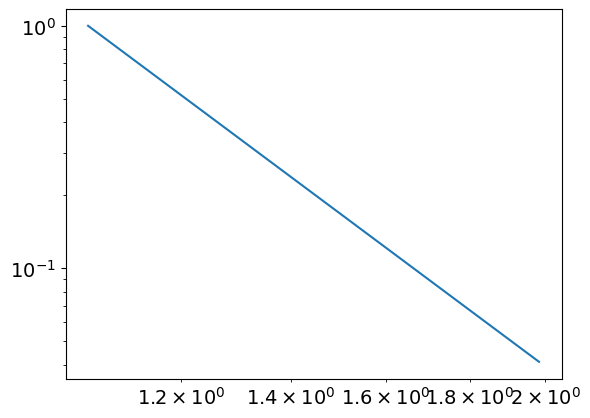

6.044390081220847
1.053075127189739
powerlaw KstestResult(statistic=0.9869146025963699, pvalue=0.0, statistic_location=1.4176041356762894, statistic_sign=1)
lognorm KstestResult(statistic=0.9817005034079614, pvalue=0.0, statistic_location=1.2551602534982083, statistic_sign=1)
tensor(0.0698, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2149, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4110, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5235, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
319
tensor(4.9711e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


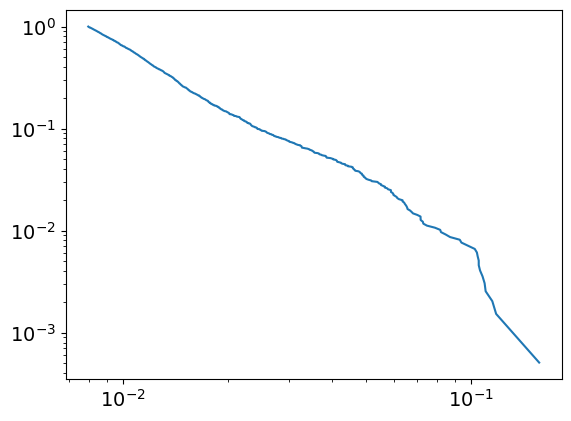

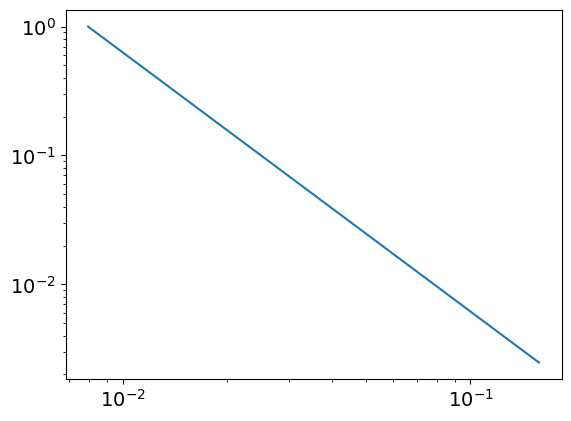

3.009848182832682
0.007946238310253406
powerlaw KstestResult(statistic=0.9988117013656128, pvalue=0.0, statistic_location=0.10641438954458023, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13154502852922048, statistic_sign=-1)
tensor(-3.8360e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2614, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.2290, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
319
tensor(0.2171, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


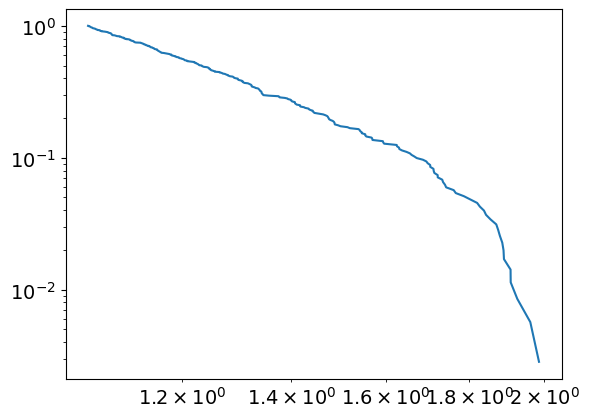

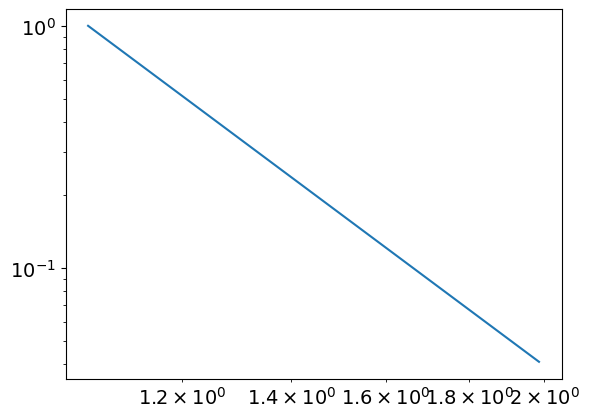

6.020171643854775
1.0507307407298698
powerlaw KstestResult(statistic=0.9867547250907149, pvalue=0.0, statistic_location=1.417957924797938, statistic_sign=1)
lognorm KstestResult(statistic=0.9816378194694622, pvalue=0.0, statistic_location=1.2567343757560152, statistic_sign=1)
tensor(0.0698, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2149, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4127, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5277, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
320
tensor(5.3093e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


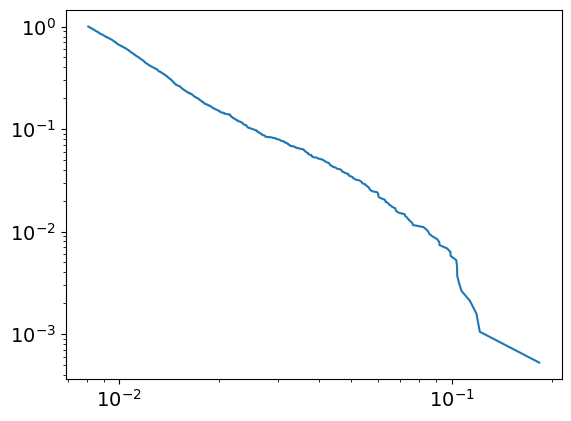

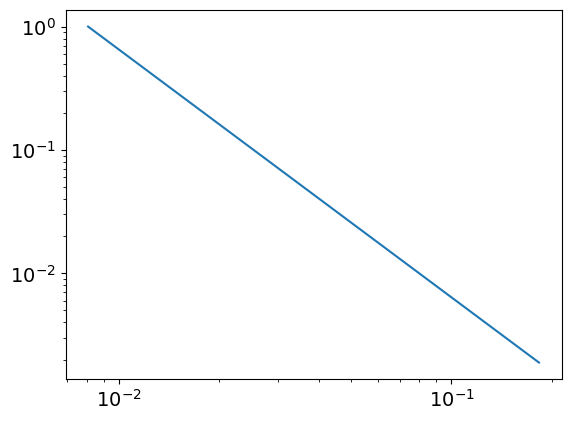

3.008281209891573
0.008078261717386978
powerlaw KstestResult(statistic=0.9988457720550006, pvalue=0.0, statistic_location=0.10521913770583055, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11877630666041936, statistic_sign=-1)
tensor(-2.1514e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1512, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7429, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
320
tensor(0.2175, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


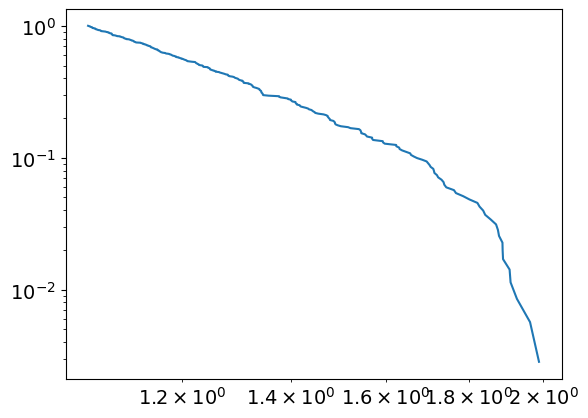

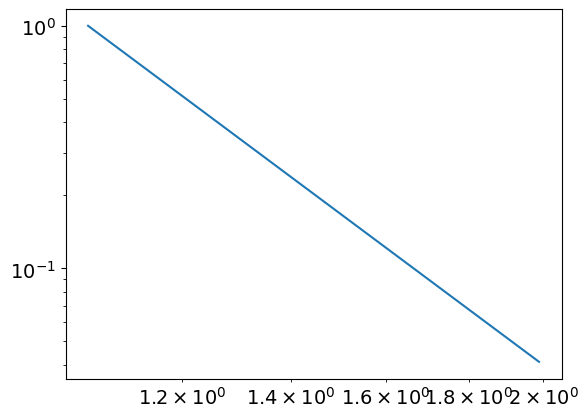

5.99778014002481
1.0502593845526174
powerlaw KstestResult(statistic=0.9866259490036552, pvalue=0.0, statistic_location=1.419313377451745, statistic_sign=1)
lognorm KstestResult(statistic=0.9815673079159785, pvalue=0.0, statistic_location=1.2583573034116586, statistic_sign=1)
tensor(0.0699, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2150, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4144, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5319, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
321
tensor(5.1644e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


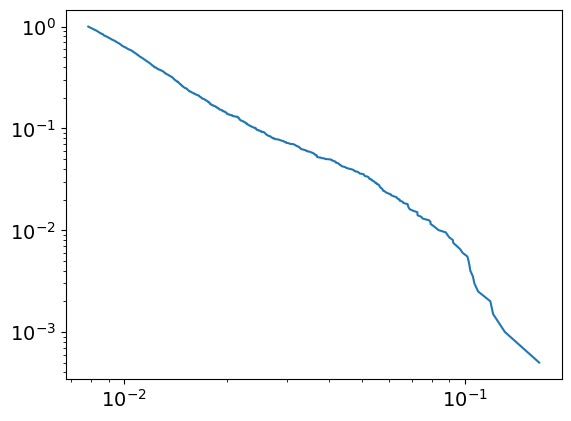

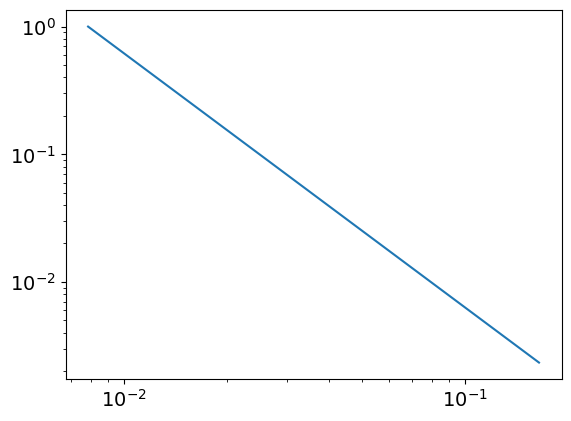

2.99026325069851
0.007843455622626177
powerlaw KstestResult(statistic=0.9987936492850712, pvalue=0.0, statistic_location=0.10545135753067444, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13081459652426852, statistic_sign=-1)
tensor(-2.8076e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.2506, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8700, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
321
tensor(0.2178, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


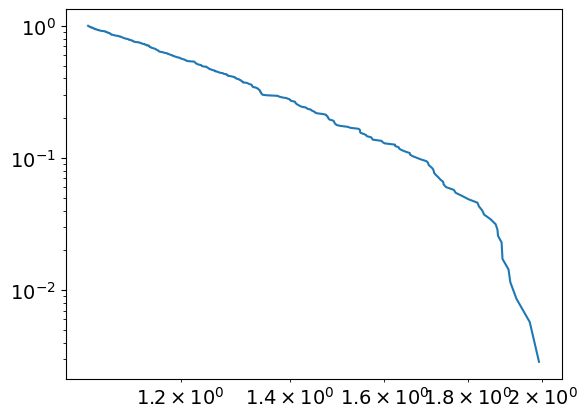

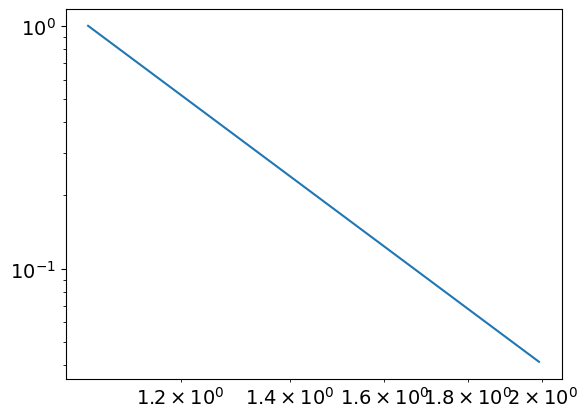

6.004765595612976
1.0528116705893908
powerlaw KstestResult(statistic=0.9866945515845345, pvalue=0.0, statistic_location=1.4206077249746738, statistic_sign=1)
lognorm KstestResult(statistic=0.9814913490166665, pvalue=0.0, statistic_location=1.259931055381618, statistic_sign=1)
tensor(0.0699, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2151, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4160, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5362, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
322
tensor(4.9229e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


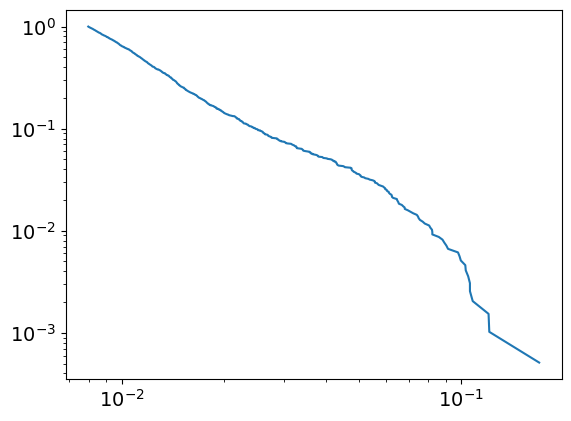

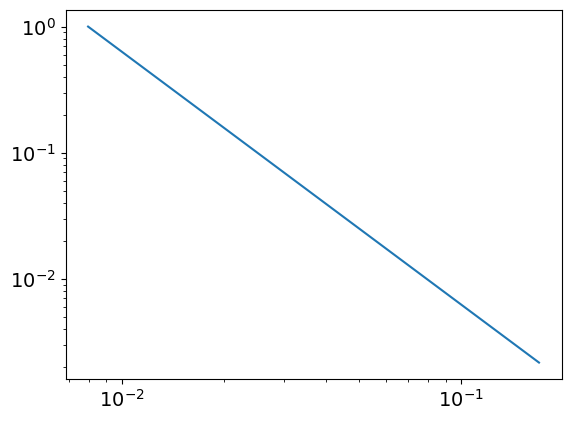

3.004352996804353
0.007957897751568617
powerlaw KstestResult(statistic=0.9988097325090407, pvalue=0.0, statistic_location=0.10607825202055353, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16970734266837573, statistic_sign=1)
tensor(3.8039e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1360, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.7863, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
322
tensor(0.2182, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


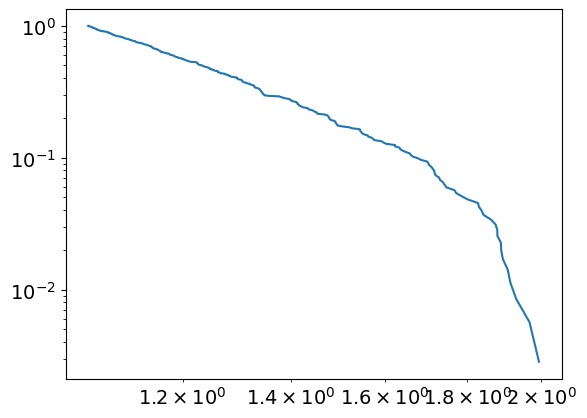

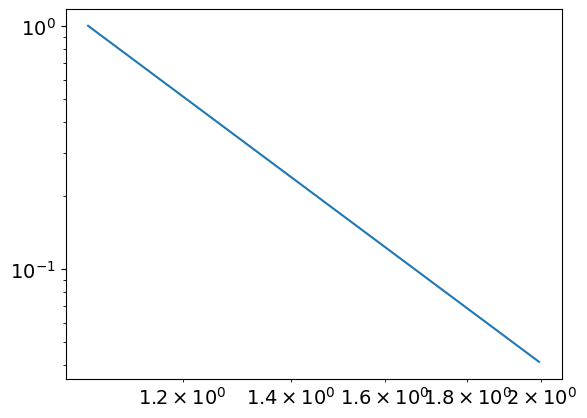

5.963990037106181
1.0491111468446361
powerlaw KstestResult(statistic=0.9863807909537707, pvalue=0.0, statistic_location=1.42463387162769, statistic_sign=1)
lognorm KstestResult(statistic=0.9814906174298347, pvalue=0.0, statistic_location=1.2623707344984907, statistic_sign=1)
tensor(0.0700, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2151, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4177, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5403, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
323
tensor(5.3234e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


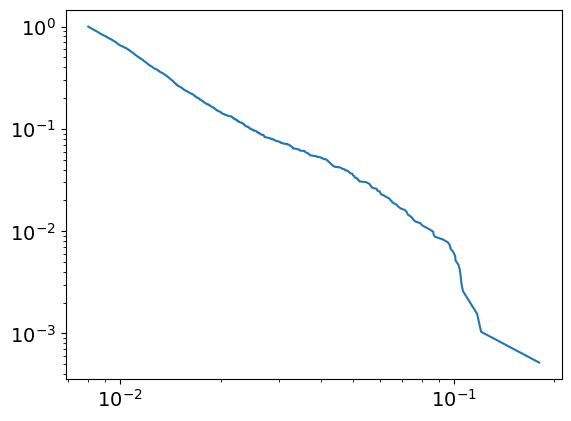

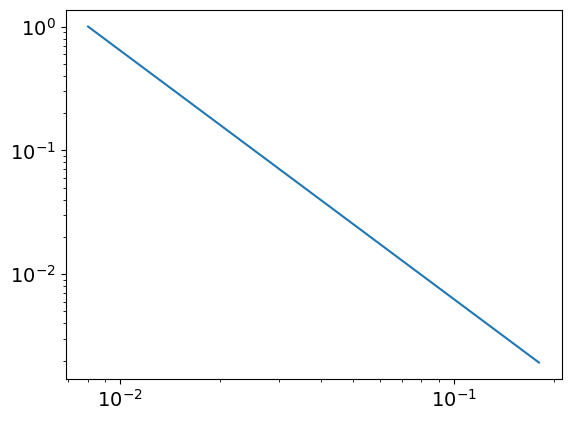

3.010151150334598
0.008025176207911771
powerlaw KstestResult(statistic=0.9986881065735169, pvalue=0.0, statistic_location=0.10637739353620422, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17996928112249855, statistic_sign=1)
tensor(2.4558e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2908, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.2670, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
323
tensor(0.2185, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


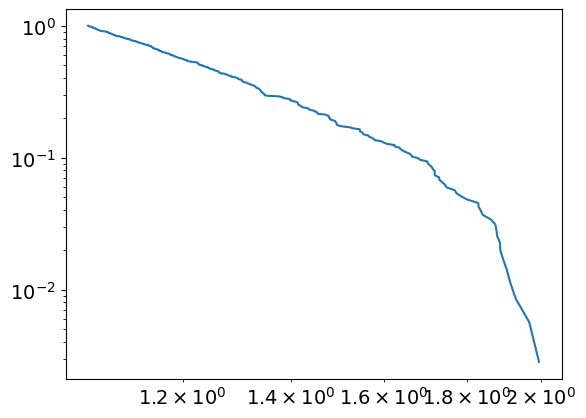

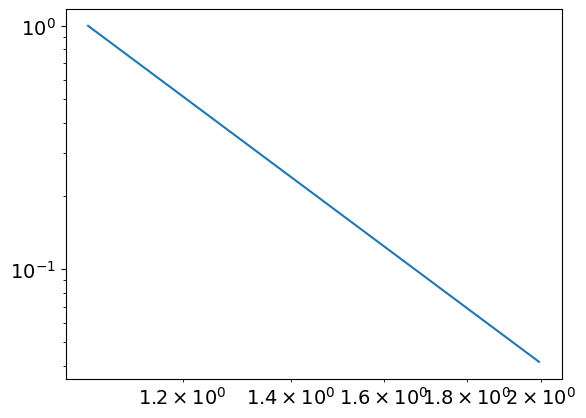

5.945028640265426
1.0487280028812977
powerlaw KstestResult(statistic=0.9863238341475012, pvalue=0.0, statistic_location=1.3496686747176034, statistic_sign=1)
lognorm KstestResult(statistic=0.9814377399054425, pvalue=0.0, statistic_location=1.2653294351046585, statistic_sign=1)
tensor(0.0700, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2152, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4194, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5445, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
324
tensor(6.1526e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


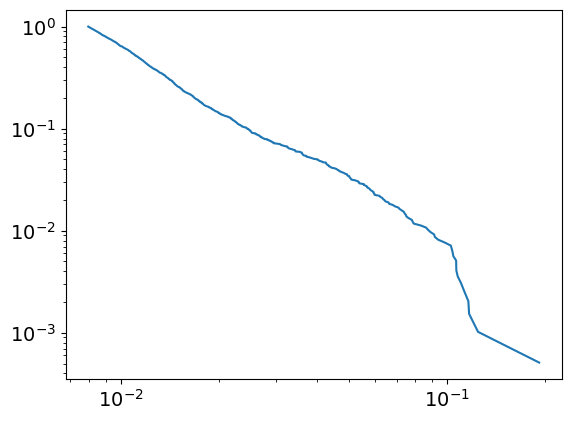

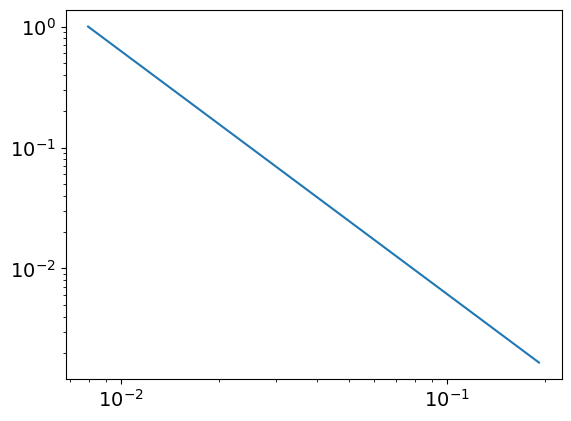

3.0102472010554027
0.007949251008847568
powerlaw KstestResult(statistic=0.9986447680002821, pvalue=0.0, statistic_location=0.10780952685160188, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11622181010261944, statistic_sign=-1)
tensor(-3.1051e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3494, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.4702, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
324
tensor(0.2189, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


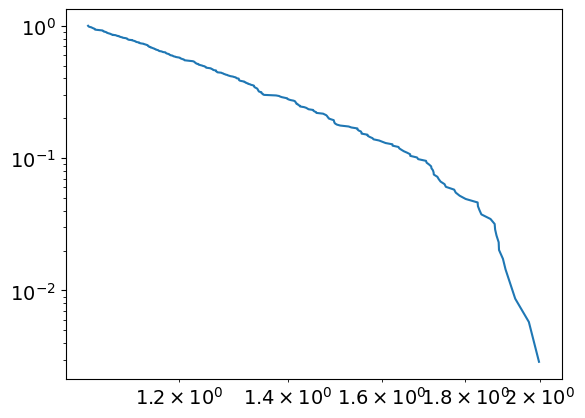

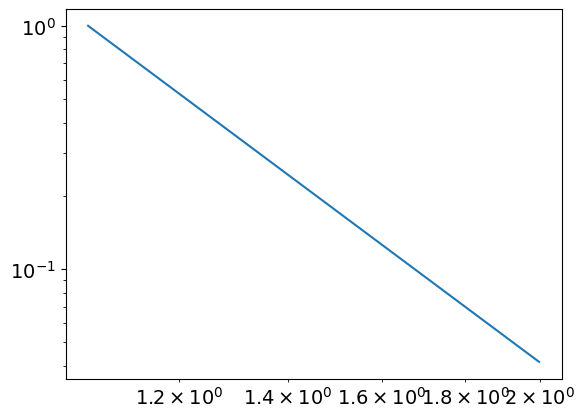

5.982984776139841
1.0550705393379107
powerlaw KstestResult(statistic=0.9866989974194058, pvalue=0.0, statistic_location=1.4245286059174727, statistic_sign=1)
lognorm KstestResult(statistic=0.9813005775873407, pvalue=0.0, statistic_location=1.26727553416591, statistic_sign=1)
tensor(0.0701, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2152, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4210, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5487, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
325
tensor(5.2728e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


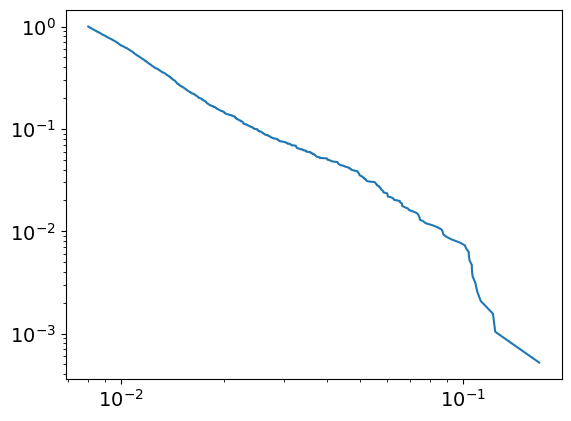

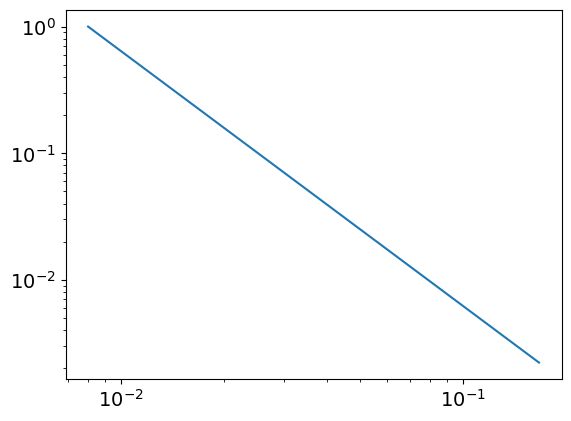

3.0119951332570767
0.008021480698398654
powerlaw KstestResult(statistic=0.9986472812569352, pvalue=0.0, statistic_location=0.09260198489994831, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11272346769213082, statistic_sign=-1)
tensor(-9.1380e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0819, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.7188, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
325
tensor(0.2192, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


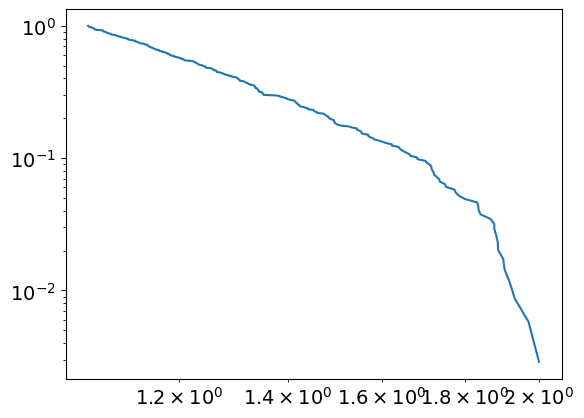

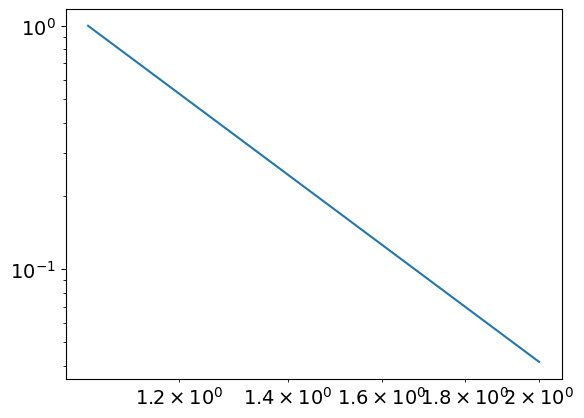

5.967566708647832
1.054867034508965
powerlaw KstestResult(statistic=0.9865943997691182, pvalue=0.0, statistic_location=1.4258318748476297, statistic_sign=1)
lognorm KstestResult(statistic=0.9812283989429792, pvalue=0.0, statistic_location=1.266399525278352, statistic_sign=1)
tensor(0.0702, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2153, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4227, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5529, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
326
tensor(5.4790e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


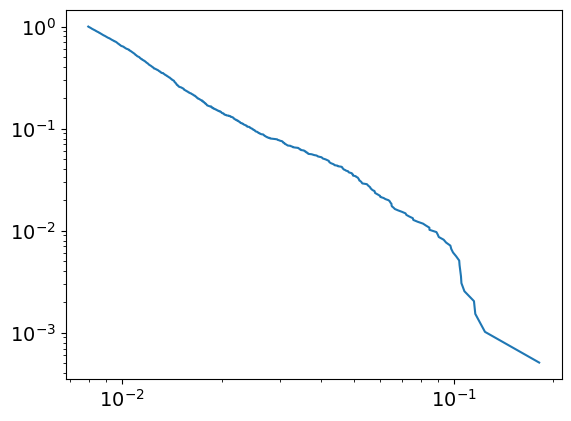

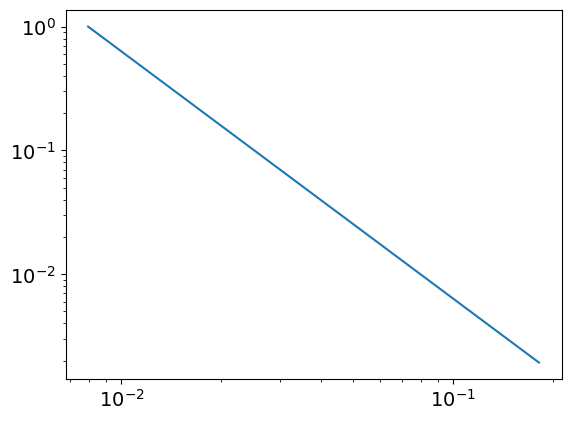

2.997999664360008
0.00793515245606593
powerlaw KstestResult(statistic=0.9986346754569337, pvalue=0.0, statistic_location=0.07794104014026011, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1163031904612105, statistic_sign=-1)
tensor(-1.1681e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1619, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.8736, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
326
tensor(0.2196, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


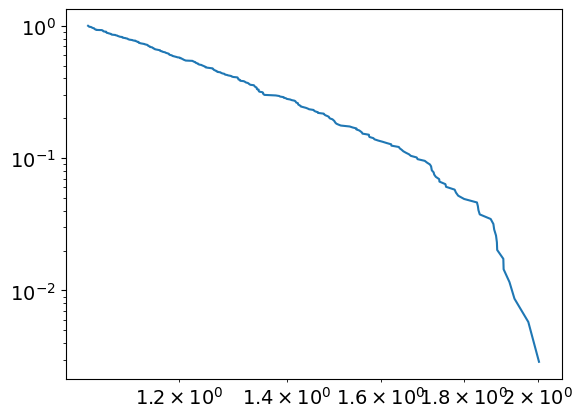

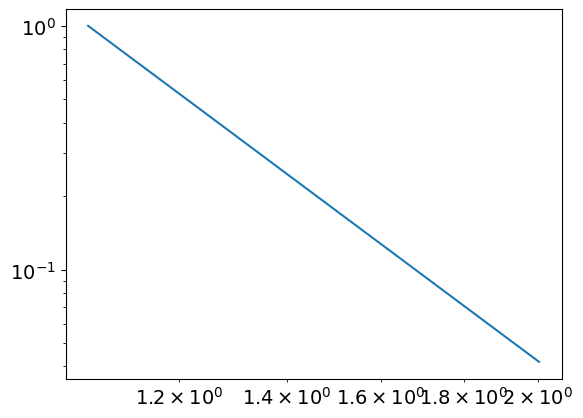

5.948559095412613
1.0545221808872385
powerlaw KstestResult(statistic=0.9864693033848403, pvalue=0.0, statistic_location=1.427148612530443, statistic_sign=1)
lognorm KstestResult(statistic=0.9811055582220436, pvalue=0.0, statistic_location=1.268029201409524, statistic_sign=1)
tensor(0.0702, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2154, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4244, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5570, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
327
tensor(5.9798e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


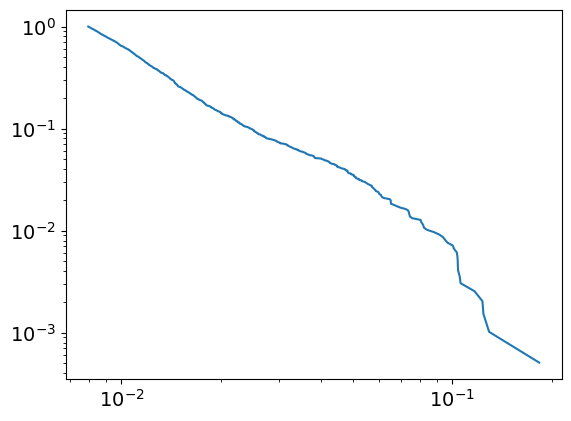

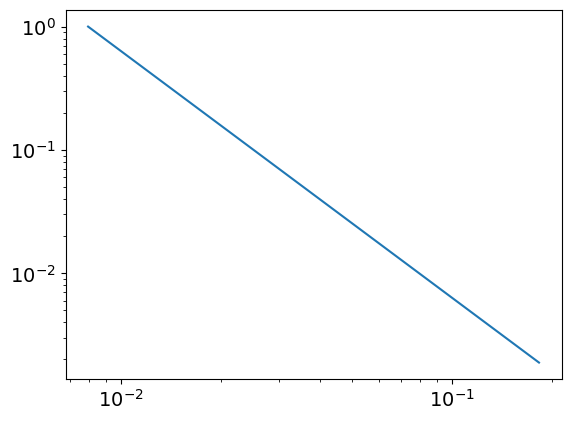

2.998951272390003
0.007940636973996518
powerlaw KstestResult(statistic=0.9986715925147529, pvalue=0.0, statistic_location=0.1060190896507871, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12935492725662182, statistic_sign=-1)
tensor(-2.0026e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1187, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.8111, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
327
tensor(0.2200, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


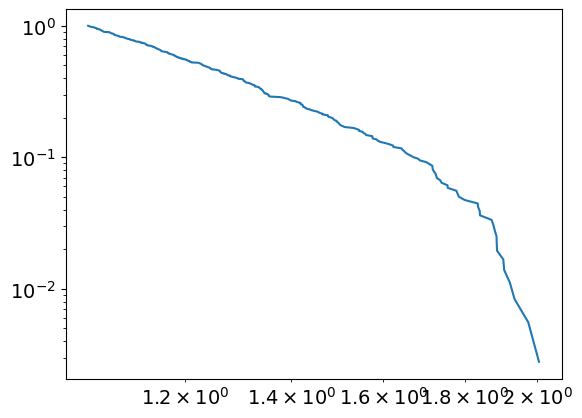

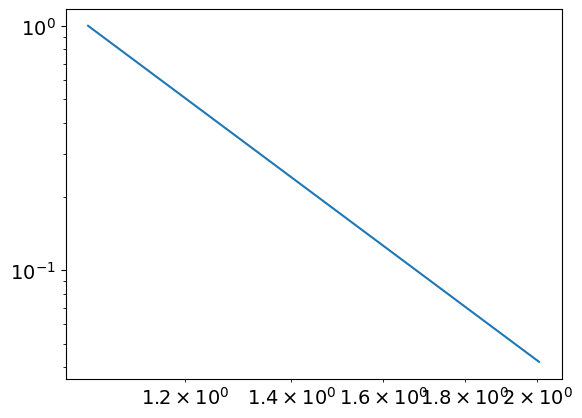

5.840407083107668
1.0422507630683724
powerlaw KstestResult(statistic=0.9859497192579153, pvalue=0.0, statistic_location=1.3569249327733666, statistic_sign=1)
lognorm KstestResult(statistic=0.9810055783119527, pvalue=0.0, statistic_location=1.265763053829846, statistic_sign=1)
tensor(0.0703, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2154, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4261, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5613, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
328
tensor(6.8205e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


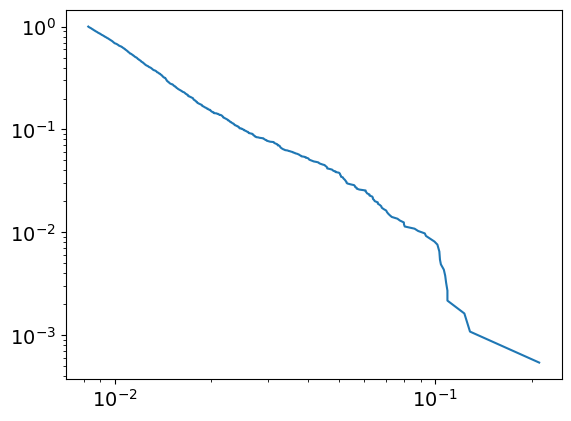

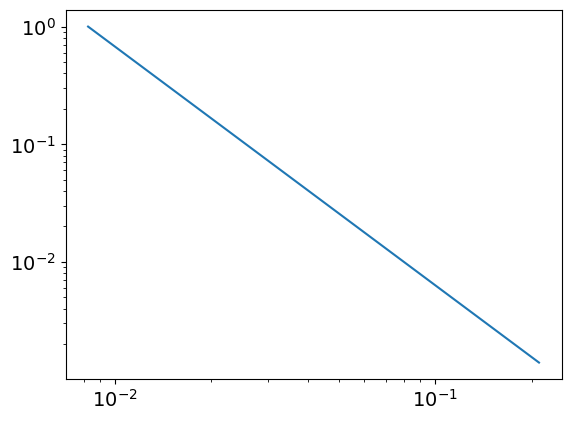

3.0288663383557806
0.008247670422551855
powerlaw KstestResult(statistic=0.998706819507455, pvalue=0.0, statistic_location=0.10735156907433899, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.10909868735481096, statistic_sign=-1)
tensor(-1.1567e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6625, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.9775, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
328
tensor(0.2203, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


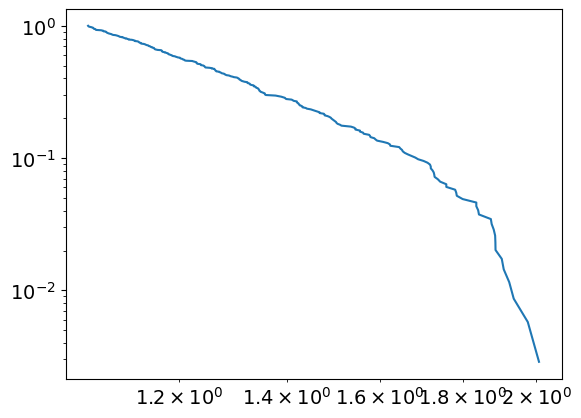

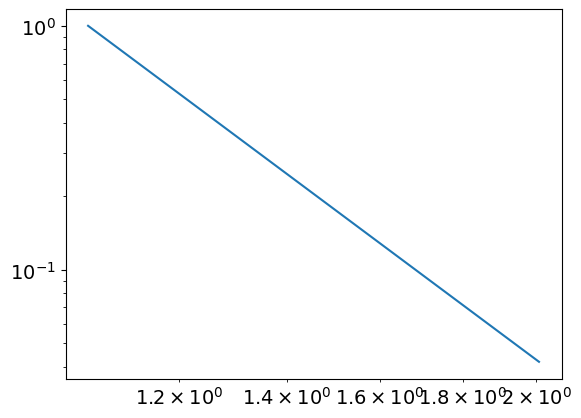

5.92308170871221
1.0536672193166827
powerlaw KstestResult(statistic=0.9862699925661683, pvalue=0.0, statistic_location=1.4316573238070078, statistic_sign=1)
lognorm KstestResult(statistic=0.9809925786451664, pvalue=0.0, statistic_location=1.2658637504390793, statistic_sign=1)
tensor(0.0703, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2155, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4279, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5655, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
329
tensor(6.6875e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


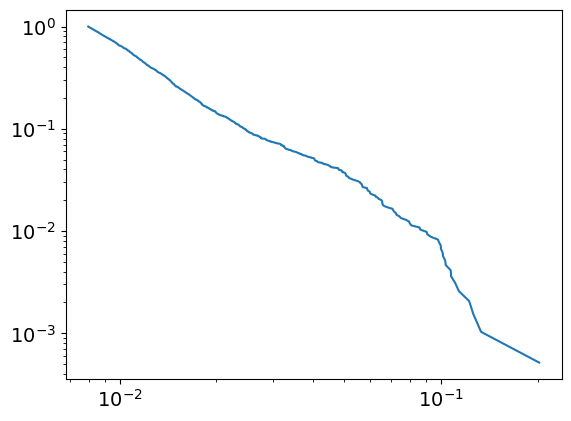

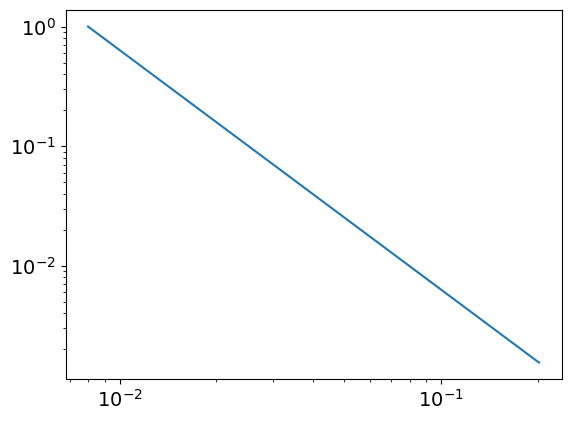

3.0044885949179903
0.007984746158383684
powerlaw KstestResult(statistic=0.9986551994108555, pvalue=0.0, statistic_location=0.10704882326115024, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12217110061339459, statistic_sign=-1)
tensor(-1.2222e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5496, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.9838, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
329
tensor(0.2207, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


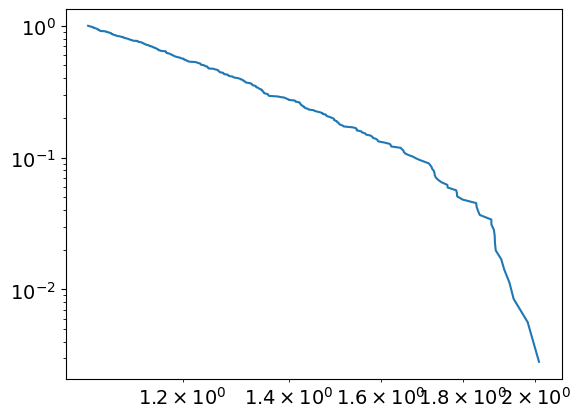

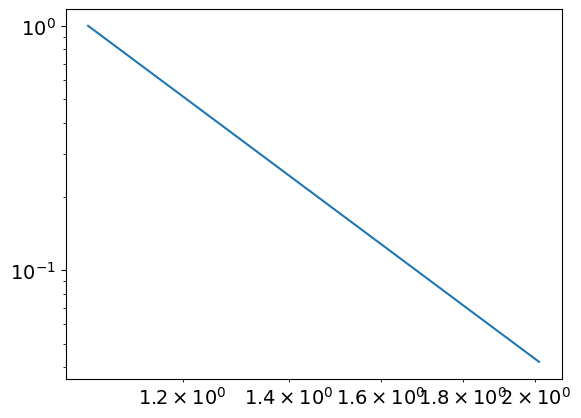

5.85297758624485
1.0467113645554056
powerlaw KstestResult(statistic=0.9859843706674222, pvalue=0.0, statistic_location=1.3605483868489754, statistic_sign=1)
lognorm KstestResult(statistic=0.9808912479148092, pvalue=0.0, statistic_location=1.2672243605687086, statistic_sign=1)
tensor(0.0704, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2155, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4296, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5699, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
330
tensor(7.1171e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


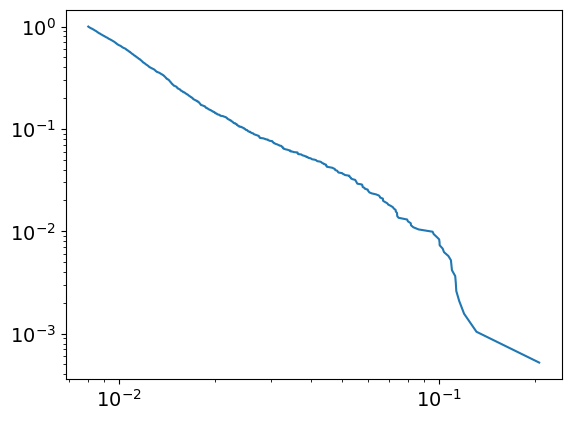

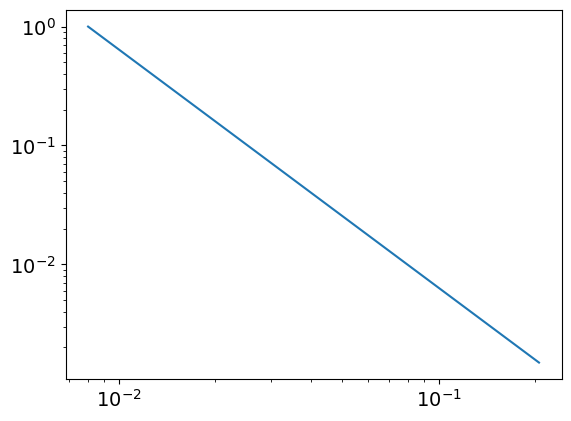

3.0065178860027957
0.00803345200023898
powerlaw KstestResult(statistic=0.998478826937889, pvalue=0.0, statistic_location=0.11296532527421575, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11576072463839945, statistic_sign=-1)
tensor(-3.9351e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5902, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.3105, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
330
tensor(0.2210, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


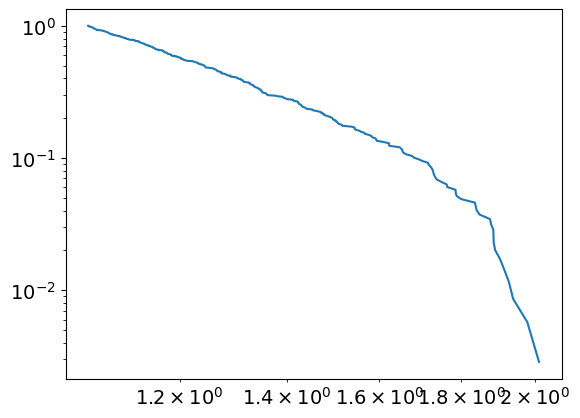

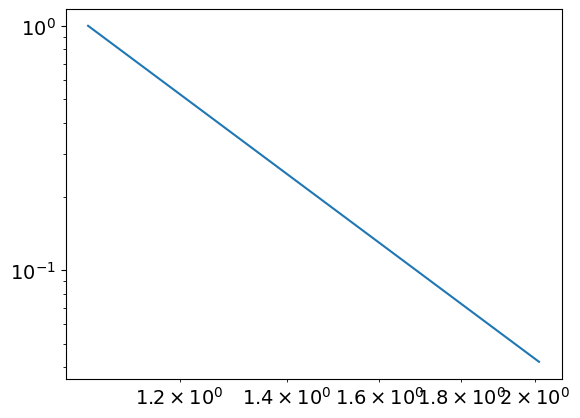

5.881234099740535
1.0520996832480456
powerlaw KstestResult(statistic=0.986091942846467, pvalue=0.0, statistic_location=1.3623809017046637, statistic_sign=1)
lognorm KstestResult(statistic=0.9807547583627364, pvalue=0.0, statistic_location=1.2689273103859107, statistic_sign=1)
tensor(0.0705, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2156, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4313, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5740, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
331
tensor(6.4186e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


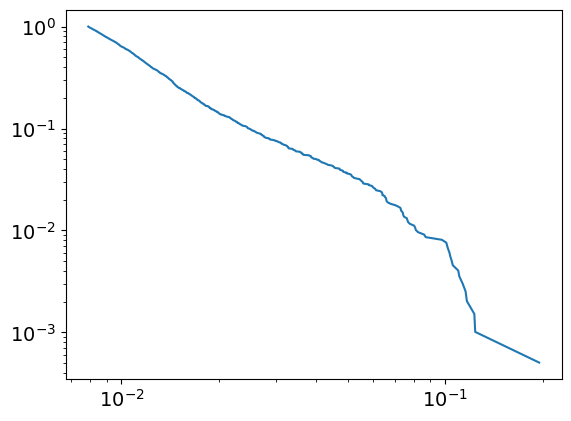

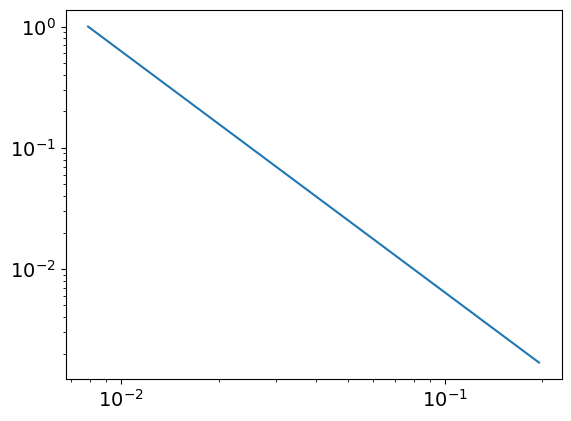

2.9901713554735645
0.007896645441924382
powerlaw KstestResult(statistic=0.9985362439733381, pvalue=0.0, statistic_location=0.10557653730614862, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19514235920346665, statistic_sign=1)
tensor(9.4178e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4668, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.5974, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
331
tensor(0.2214, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


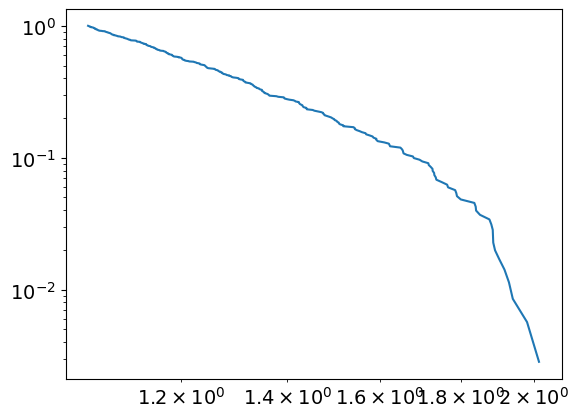

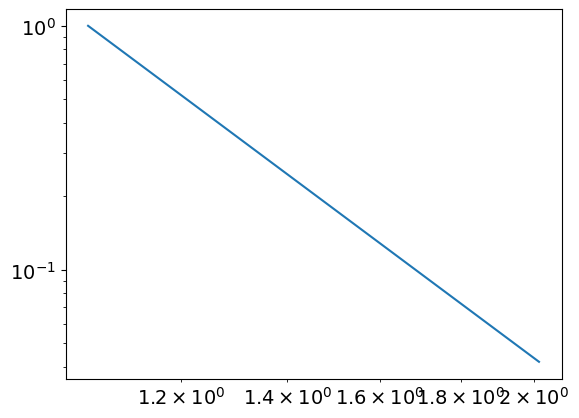

5.86176083635683
1.0492096892984688
powerlaw KstestResult(statistic=0.9859716530423469, pvalue=0.0, statistic_location=1.364191395034161, statistic_sign=1)
lognorm KstestResult(statistic=0.9806033748860813, pvalue=0.0, statistic_location=1.2706488410688657, statistic_sign=1)
tensor(0.0705, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2157, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4331, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5782, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
332
tensor(5.4772e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


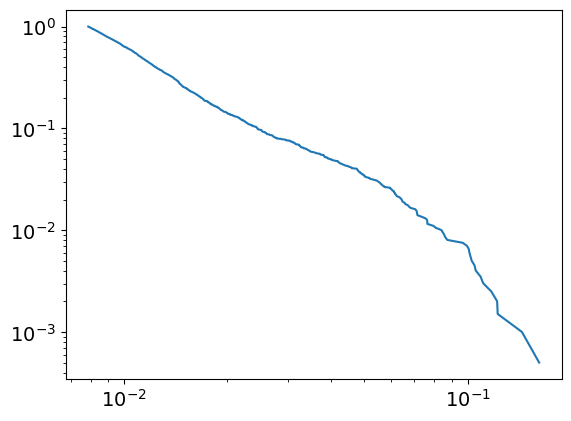

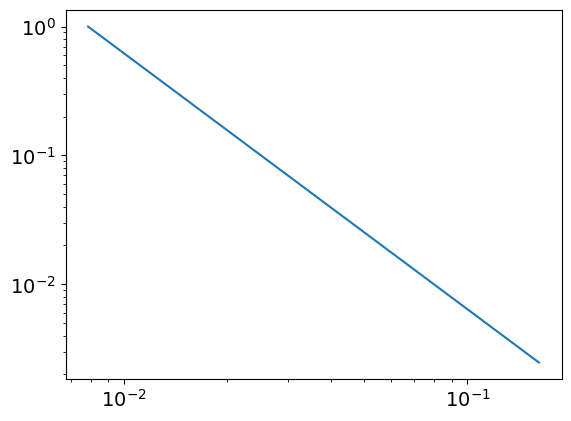

2.9869916380452493
0.007868951615871254
powerlaw KstestResult(statistic=0.9986551694583559, pvalue=0.0, statistic_location=0.10560146859981388, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1438864815541167, statistic_sign=-1)
tensor(-1.0092e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0879, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.9092, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
332
tensor(0.2217, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


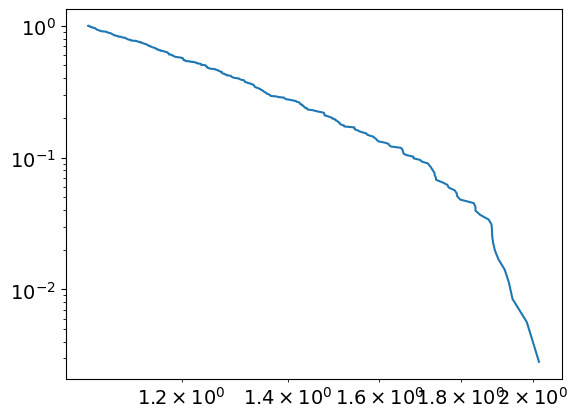

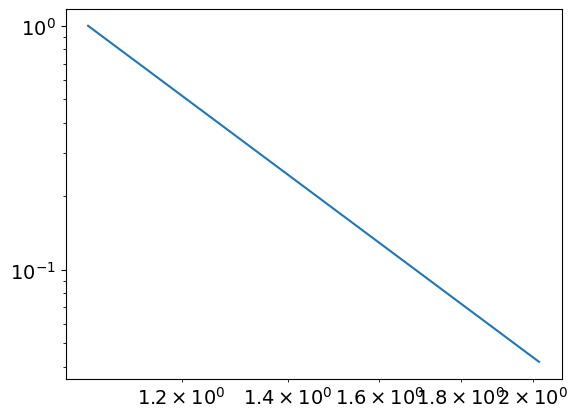

5.84246492833226
1.0474861242643971
powerlaw KstestResult(statistic=0.9858689691121078, pvalue=0.0, statistic_location=1.3659122911561754, statistic_sign=1)
lognorm KstestResult(statistic=0.9805557707978251, pvalue=0.0, statistic_location=1.2498085426035963, statistic_sign=1)
tensor(0.0706, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2157, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4348, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5823, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
333
tensor(6.6097e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


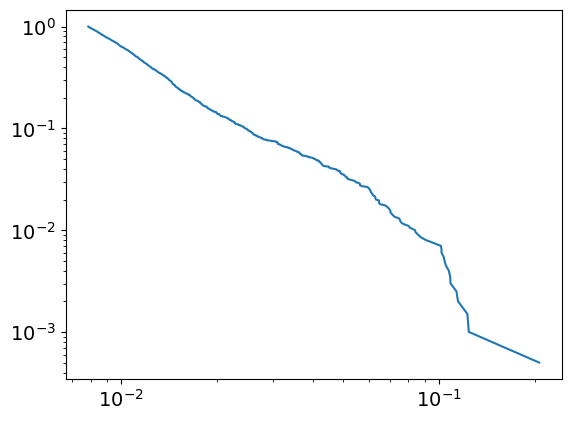

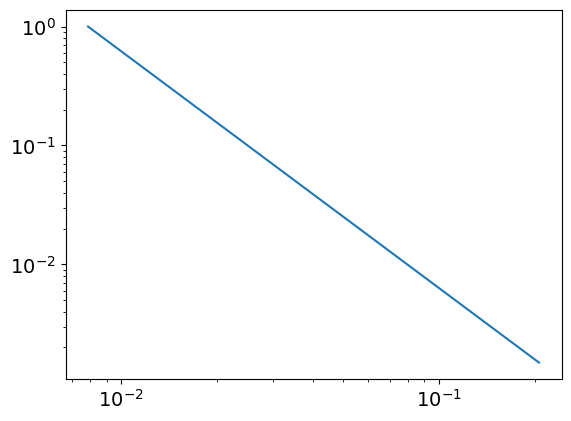

2.9921732218222266
0.007869592495083963
powerlaw KstestResult(statistic=0.9986189589550375, pvalue=0.0, statistic_location=0.10721552421676207, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20637054268640642, statistic_sign=1)
tensor(1.4494e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6195, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.7699, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
333
tensor(0.2221, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


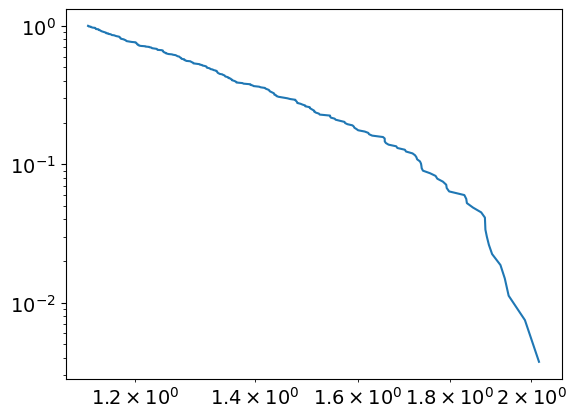

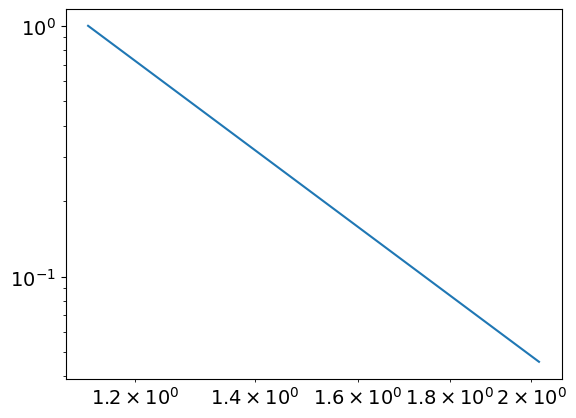

6.3099084655944235
1.1296689320248205
powerlaw KstestResult(statistic=0.9896461665081896, pvalue=0.0, statistic_location=1.5152457694363368, statistic_sign=1)
lognorm KstestResult(statistic=0.9805820855363877, pvalue=0.0, statistic_location=1.252970098736083, statistic_sign=1)
tensor(0.0706, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2158, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4366, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5865, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
334
tensor(7.5152e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


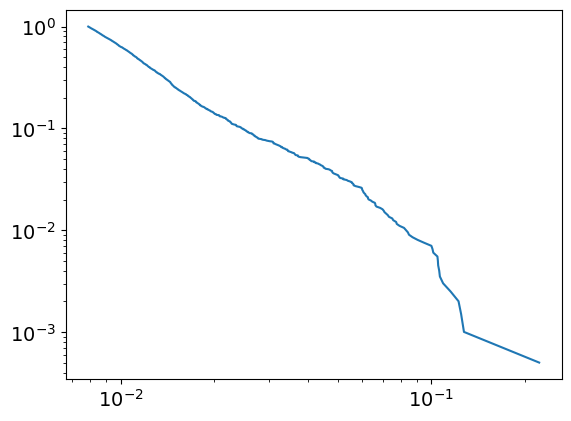

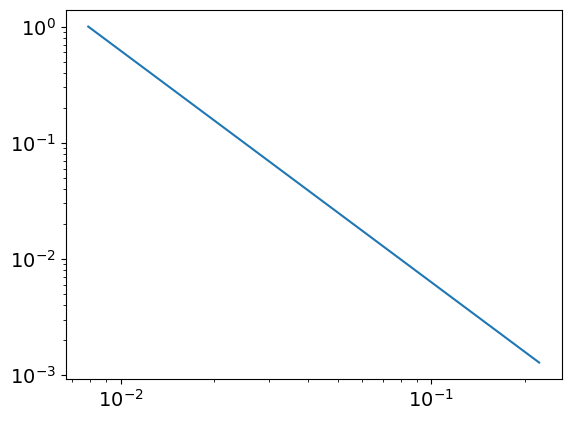

2.993566261055625
0.007872147627692458
powerlaw KstestResult(statistic=0.998641919185673, pvalue=0.0, statistic_location=0.10655494228130562, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22236679836441847, statistic_sign=1)
tensor(1.1382e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8033, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.9555, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
334
tensor(0.2224, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


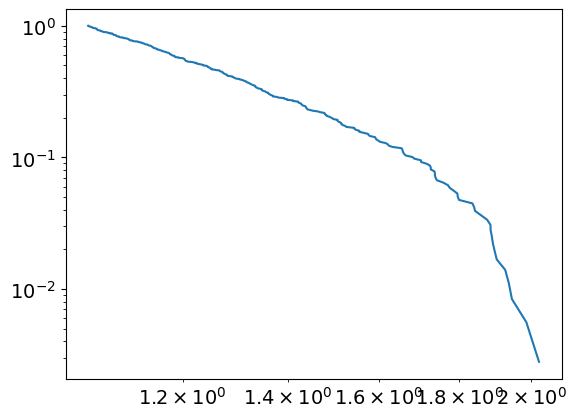

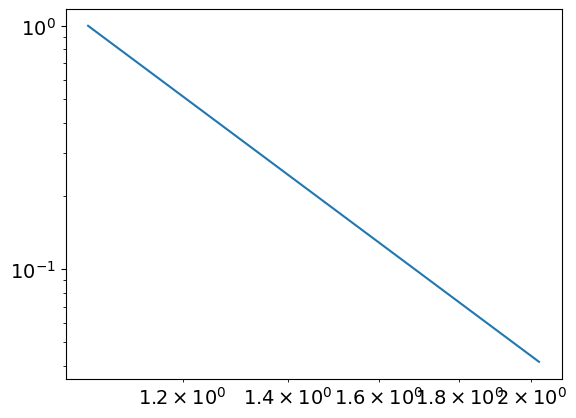

5.814410727888277
1.04461749840716
powerlaw KstestResult(statistic=0.9856689845730885, pvalue=0.0, statistic_location=1.3694872568761476, statistic_sign=1)
lognorm KstestResult(statistic=0.9806057398885154, pvalue=0.0, statistic_location=1.2521623548007381, statistic_sign=1)
tensor(0.0707, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2158, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4383, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5907, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
335
tensor(6.0679e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


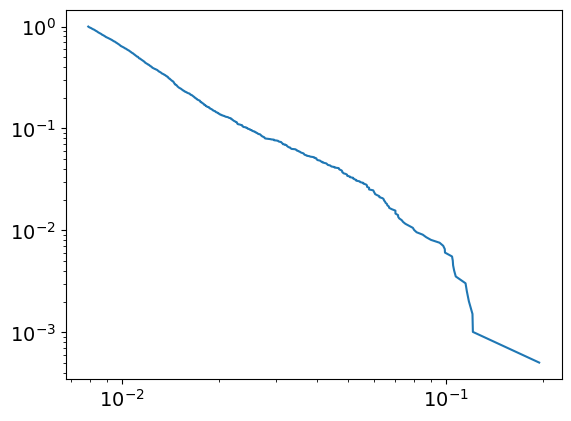

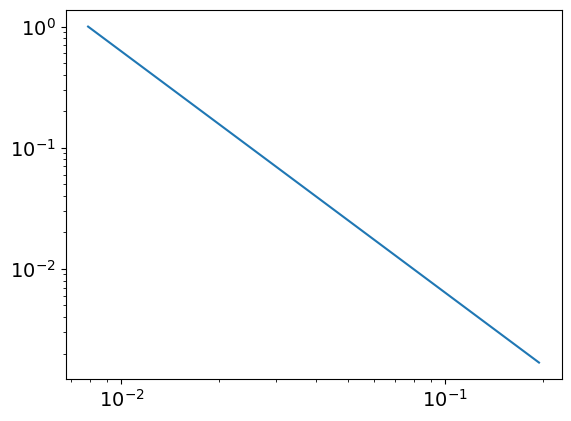

2.9924454712802353
0.007885848168578275
powerlaw KstestResult(statistic=0.9986108299866255, pvalue=0.0, statistic_location=0.1075222889239874, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19454359295552723, statistic_sign=1)
tensor(4.8091e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5158, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.0904, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
335
tensor(0.2228, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


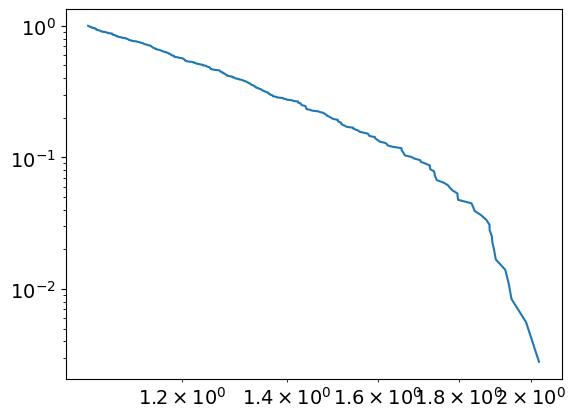

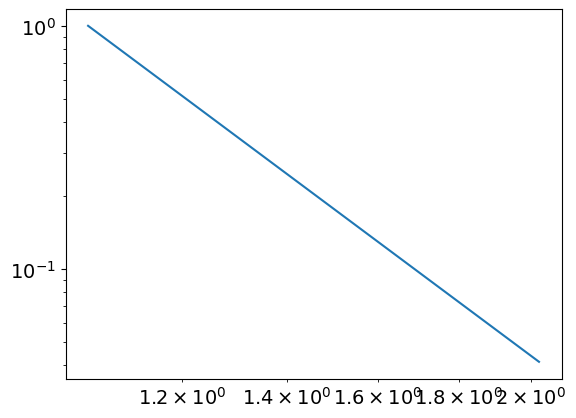

5.820983612138047
1.045928320598826
powerlaw KstestResult(statistic=0.9856604349065125, pvalue=0.0, statistic_location=1.3715398446801894, statistic_sign=1)
lognorm KstestResult(statistic=0.9805627006920361, pvalue=0.0, statistic_location=1.2533285103827145, statistic_sign=1)
tensor(0.0707, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2159, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4401, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5949, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
336
tensor(5.9821e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


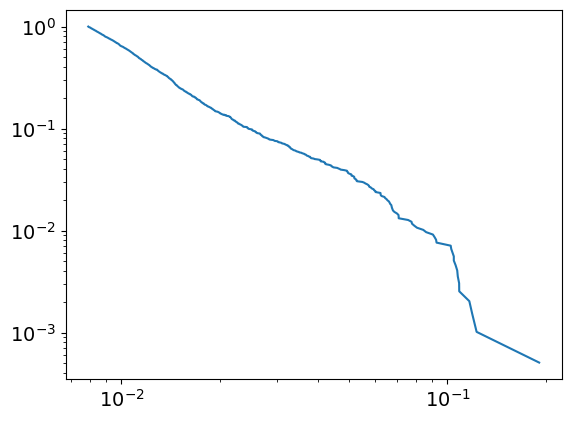

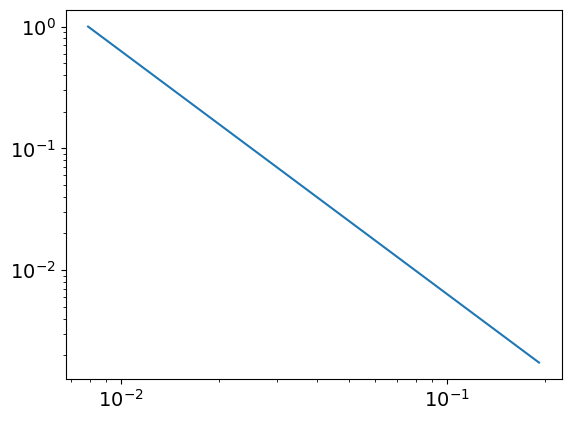

2.9955470269017272
0.007915860977146253
powerlaw KstestResult(statistic=0.9987924781453305, pvalue=0.0, statistic_location=0.1059654518073879, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12290212848829504, statistic_sign=-1)
tensor(-9.2097e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2714, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.3458, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
336
tensor(0.2231, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


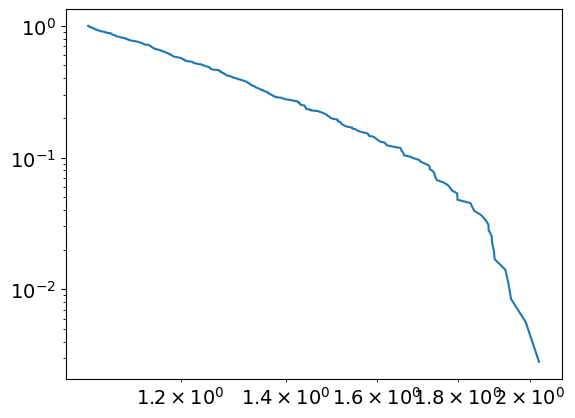

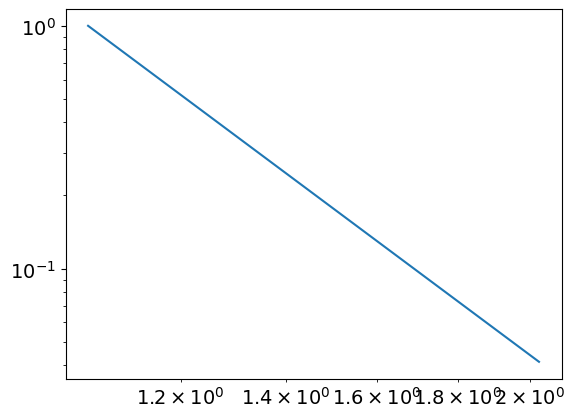

5.830500572148571
1.0479802791030566
powerlaw KstestResult(statistic=0.9856753052338577, pvalue=0.0, statistic_location=1.3736152213565127, statistic_sign=1)
lognorm KstestResult(statistic=0.9805171733058458, pvalue=0.0, statistic_location=1.2544811430493223, statistic_sign=1)
tensor(0.0708, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2159, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4419, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.5990, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
337
tensor(5.0243e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


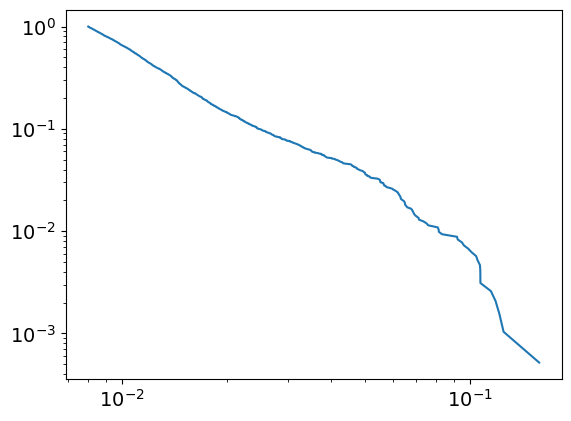

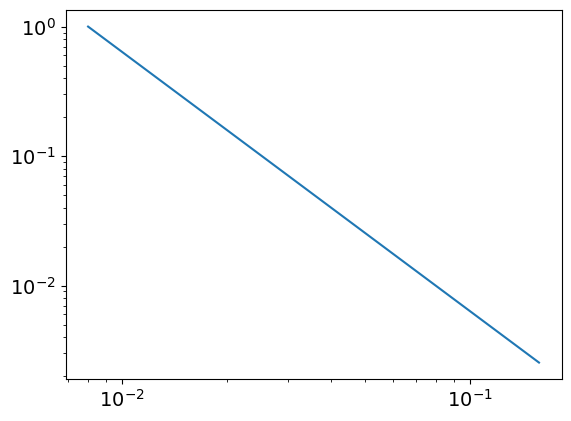

3.0026517714478405
0.008001348082288477
powerlaw KstestResult(statistic=0.9987163777730835, pvalue=0.0, statistic_location=0.08127961553464488, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12489527017661735, statistic_sign=-1)
tensor(-1.2584e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0406, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.9354, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
337
tensor(0.2235, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


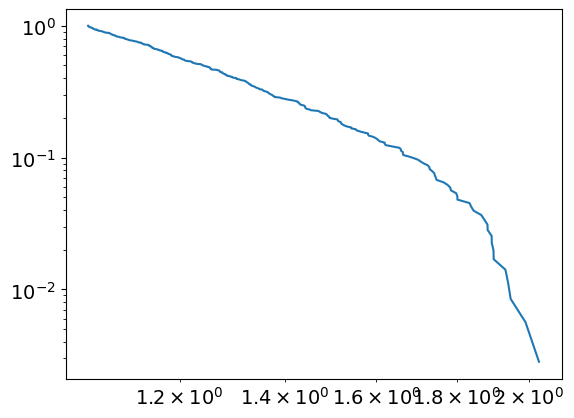

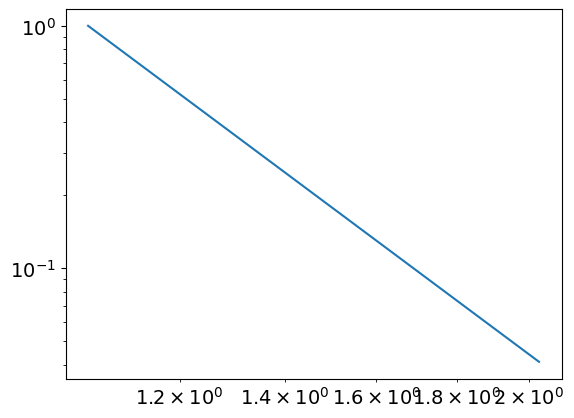

5.83859909503791
1.0493679953947168
powerlaw KstestResult(statistic=0.9857224998054538, pvalue=0.0, statistic_location=1.3785533081597354, statistic_sign=1)
lognorm KstestResult(statistic=0.9804662565260188, pvalue=0.0, statistic_location=1.255673693316618, statistic_sign=1)
tensor(0.0709, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2160, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4437, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6032, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
338
tensor(5.5589e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


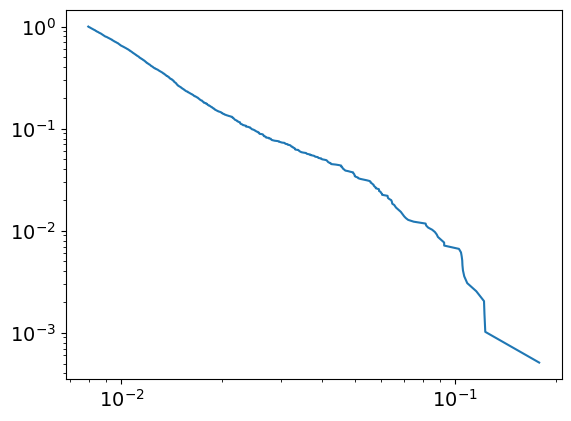

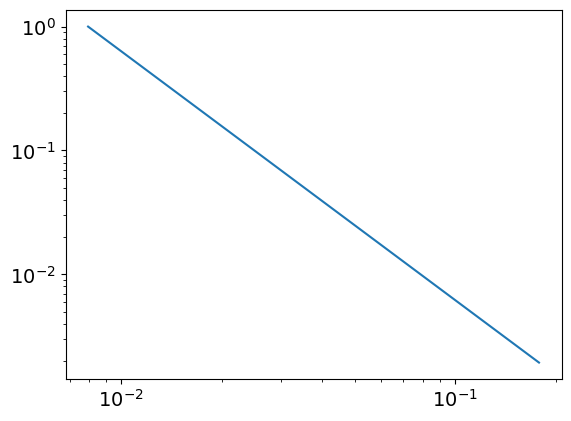

3.0077134832571533
0.007952767651215354
powerlaw KstestResult(statistic=0.9986398113569414, pvalue=0.0, statistic_location=0.0925912366045287, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12291165020700921, statistic_sign=-1)
tensor(-1.0244e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2009, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4014, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
338
tensor(0.2238, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


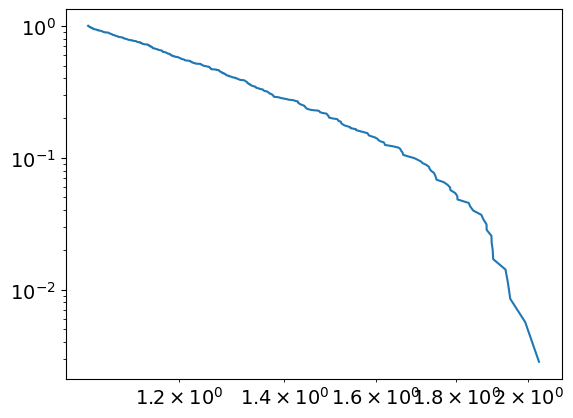

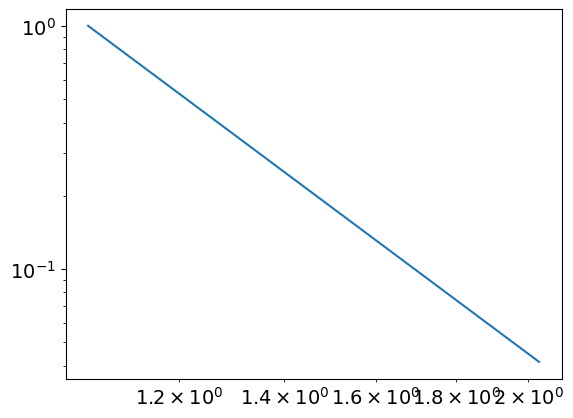

5.8247098611534875
1.0504138085196313
powerlaw KstestResult(statistic=0.9857239230675982, pvalue=0.0, statistic_location=1.3786753700838683, statistic_sign=1)
lognorm KstestResult(statistic=0.9803429576211672, pvalue=0.0, statistic_location=1.2583818620174871, statistic_sign=1)
tensor(0.0709, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2160, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4455, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6075, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
339
tensor(5.4007e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


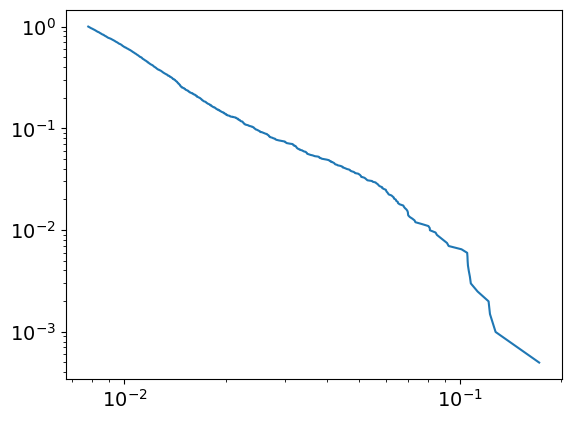

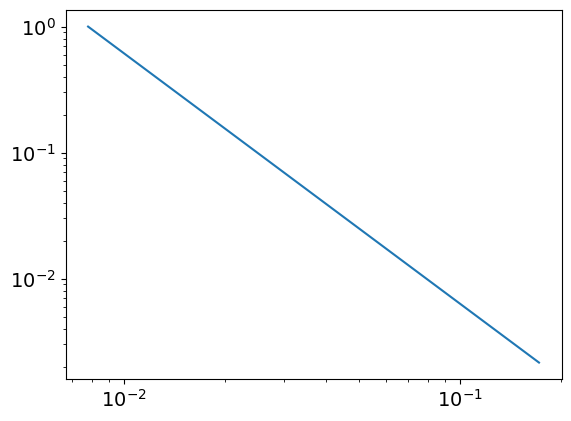

2.985408302490348
0.007801283125970455
powerlaw KstestResult(statistic=0.9986252630563467, pvalue=0.0, statistic_location=0.08523117827840135, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17184445265338577, statistic_sign=1)
tensor(1.4592e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2276, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.1708, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
339
tensor(0.2242, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


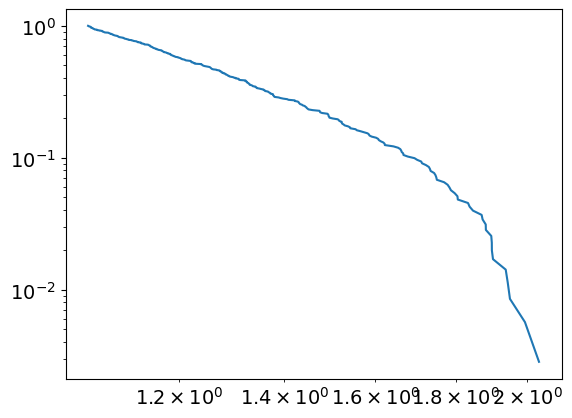

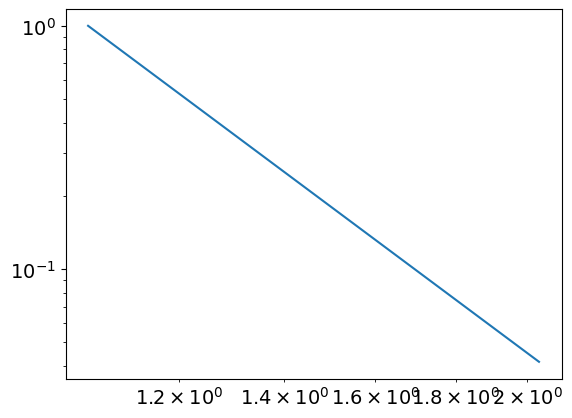

5.806448907427741
1.0493760749521606
powerlaw KstestResult(statistic=0.9856298066667915, pvalue=0.0, statistic_location=1.3798896275883394, statistic_sign=1)
lognorm KstestResult(statistic=0.9801948555327313, pvalue=0.0, statistic_location=1.2611698450877782, statistic_sign=1)
tensor(0.0710, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2161, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4473, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6116, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
340
tensor(4.9563e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


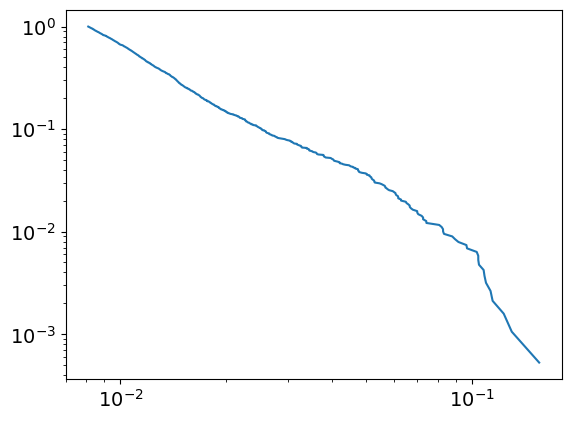

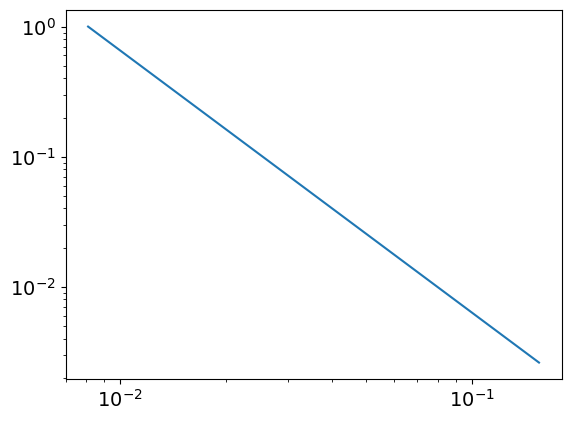

3.0123684995837174
0.008101963875920442
powerlaw KstestResult(statistic=0.9986274519082299, pvalue=0.0, statistic_location=0.10871208150469916, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15554056429565433, statistic_sign=1)
tensor(2.1703e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1411, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1298, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
340
tensor(0.2246, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


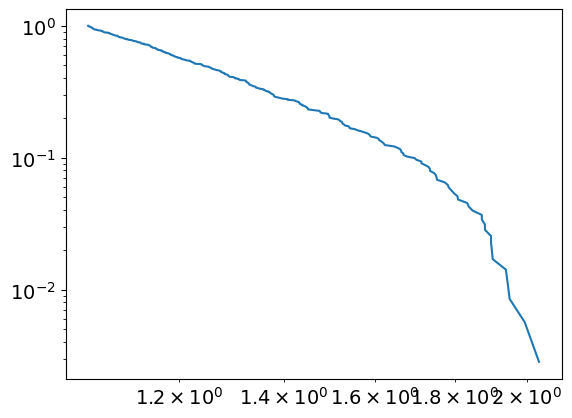

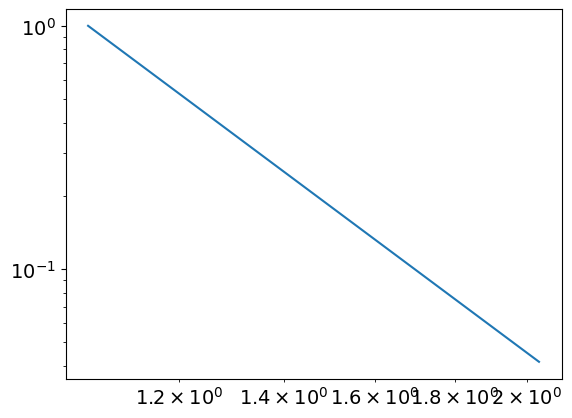

5.797504405156501
1.0494389601889764
powerlaw KstestResult(statistic=0.985552351411247, pvalue=0.0, statistic_location=1.3820651843846858, statistic_sign=1)
lognorm KstestResult(statistic=0.980076483180822, pvalue=0.0, statistic_location=1.2608969086508366, statistic_sign=1)
tensor(0.0711, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2162, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4490, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6158, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
341
tensor(5.6529e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


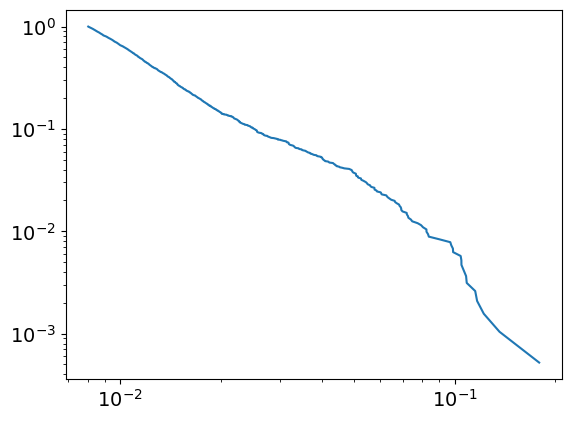

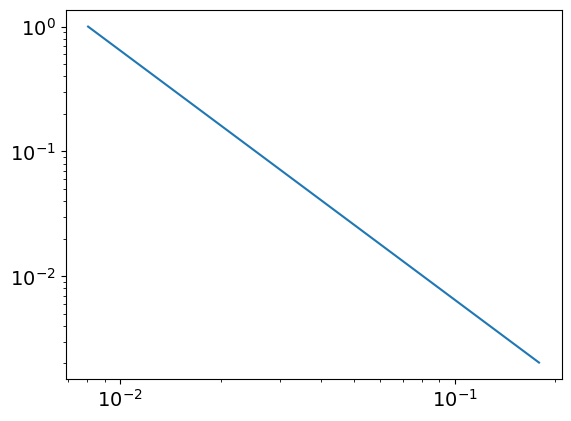

2.997646072313752
0.008034411193998232
powerlaw KstestResult(statistic=0.9986796963296561, pvalue=0.0, statistic_location=0.08321032593288887, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17881171782188365, statistic_sign=1)
tensor(1.7220e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3314, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4642, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
341
tensor(0.2249, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


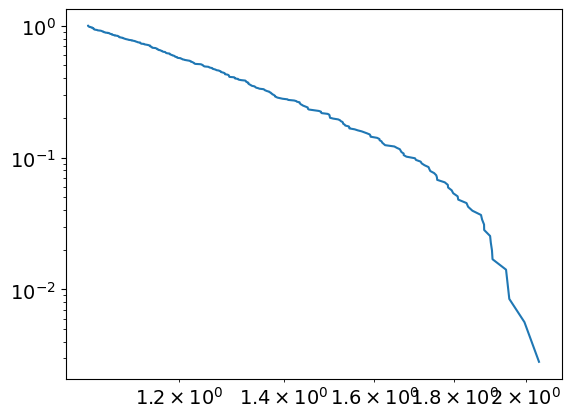

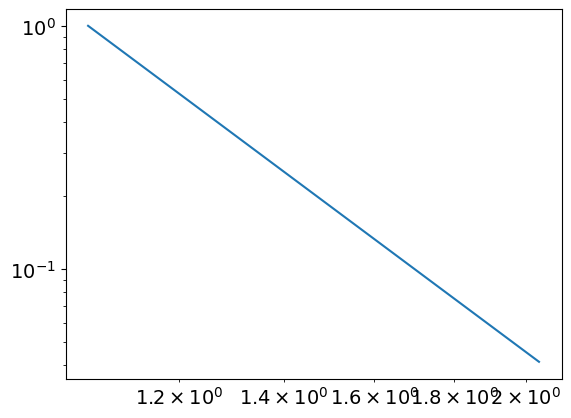

5.791765430453612
1.0489508966171253
powerlaw KstestResult(statistic=0.985464104386119, pvalue=0.0, statistic_location=1.3841430881393892, statistic_sign=1)
lognorm KstestResult(statistic=0.9799706159012351, pvalue=0.0, statistic_location=1.2603825373163153, statistic_sign=1)
tensor(0.0711, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2162, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4508, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6200, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
342
tensor(6.4604e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


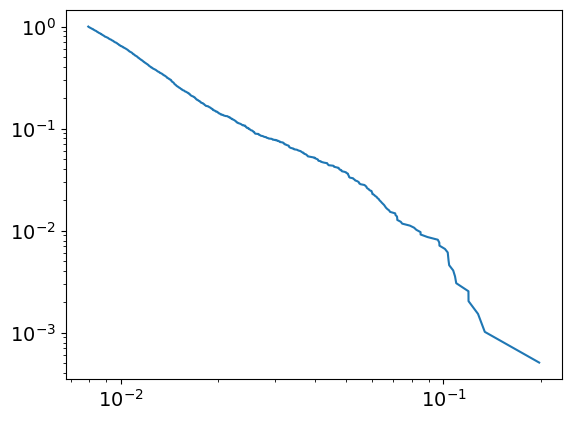

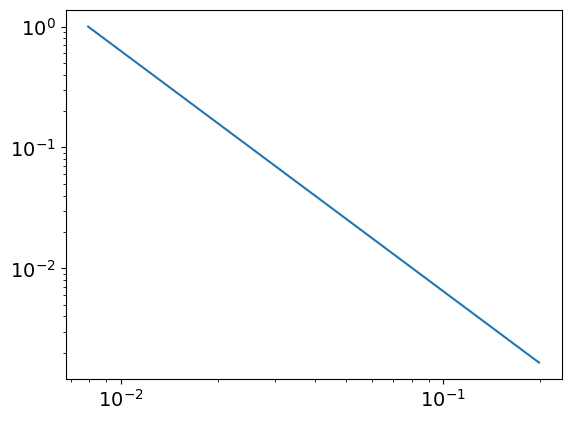

2.989674782924042
0.007933003813595239
powerlaw KstestResult(statistic=0.9986381815440648, pvalue=0.0, statistic_location=0.08494294475596936, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1279375050001548, statistic_sign=-1)
tensor(-1.6125e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3521, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.5946, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
342
tensor(0.2253, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


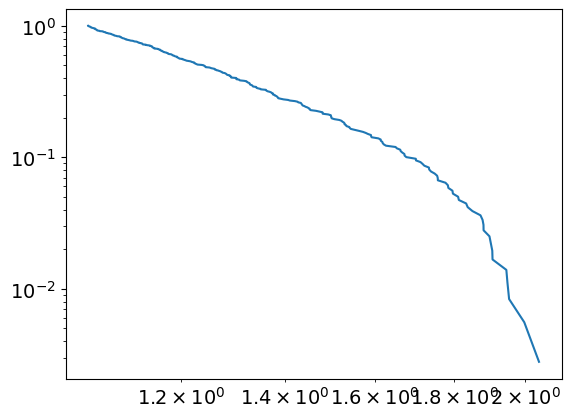

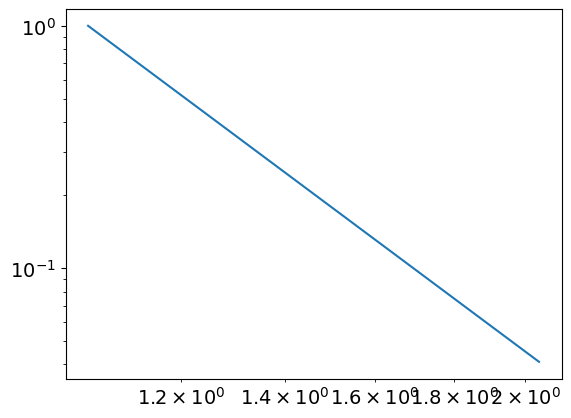

5.77020556012607
1.0452846056394445
powerlaw KstestResult(statistic=0.9852329448342768, pvalue=0.0, statistic_location=1.386246661628112, statistic_sign=1)
lognorm KstestResult(statistic=0.9798909399793493, pvalue=0.0, statistic_location=1.2616963870558915, statistic_sign=1)
tensor(0.0712, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2163, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4527, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6242, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
343
tensor(8.1828e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


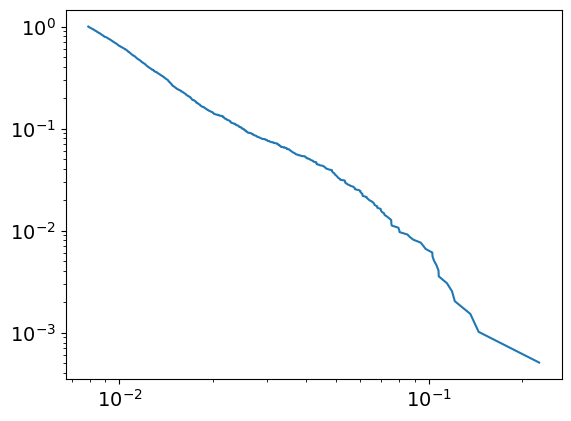

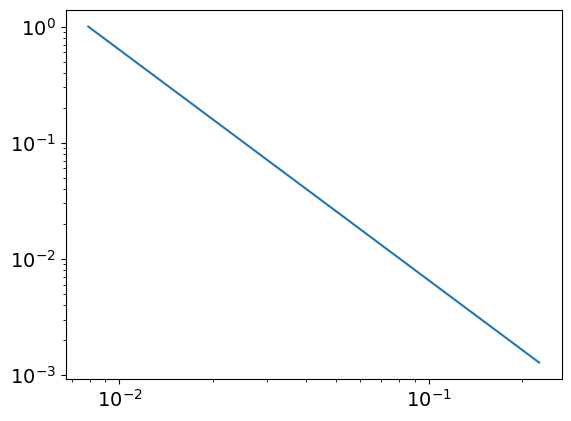

2.983795753054917
0.007924261775018393
powerlaw KstestResult(statistic=0.9986092431823709, pvalue=0.0, statistic_location=0.09772464894184126, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.14505349589679017, statistic_sign=-1)
tensor(-1.0809e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6538, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.8268, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
343
tensor(0.2256, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


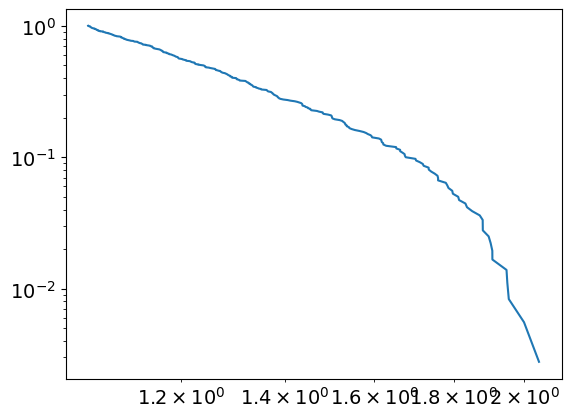

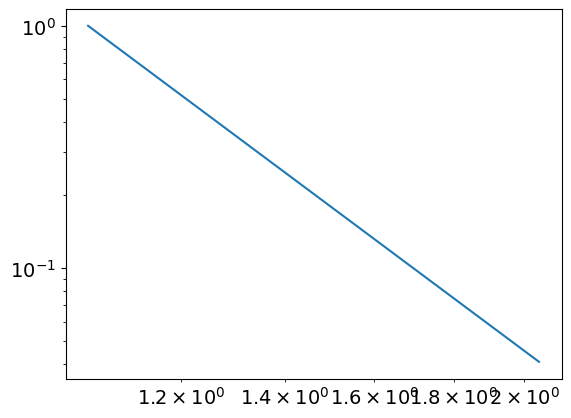

5.762681663540025
1.0447054657386121
powerlaw KstestResult(statistic=0.9851391721726782, pvalue=0.0, statistic_location=1.3914113002383228, statistic_sign=1)
lognorm KstestResult(statistic=0.9798776698045037, pvalue=0.0, statistic_location=1.2451430502881193, statistic_sign=1)
tensor(0.0713, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2163, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4545, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6285, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
344
tensor(8.5532e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


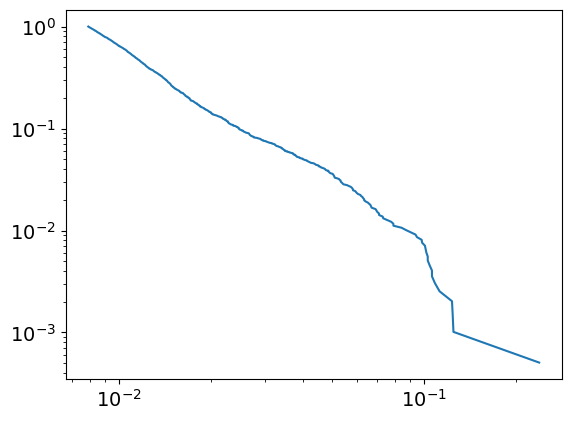

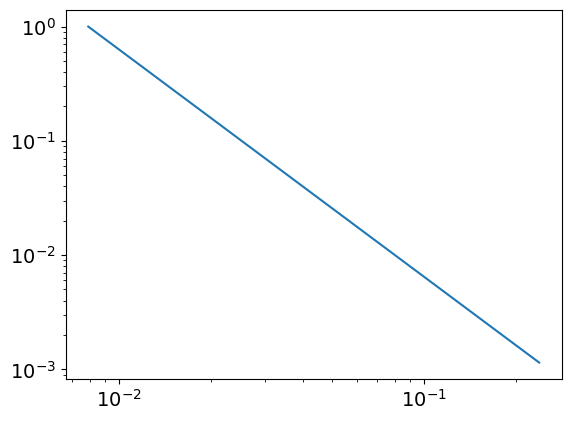

2.9890970338489695
0.00791021987881557
powerlaw KstestResult(statistic=0.9986487318362507, pvalue=0.0, statistic_location=0.10602158730560712, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.23814655150815486, statistic_sign=1)
tensor(2.9992e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0804, device='cuda:0', grad_fn=<MeanBackward0>) tensor(51.3302, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
344
tensor(0.2260, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


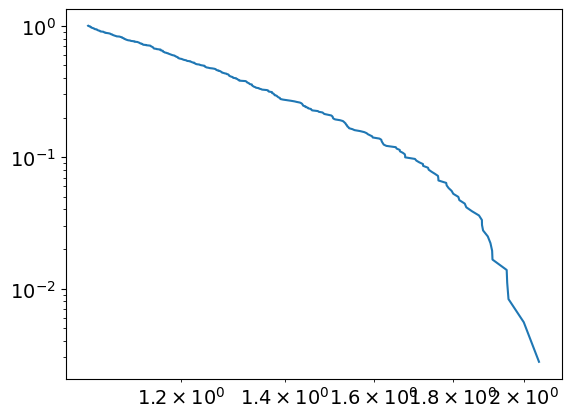

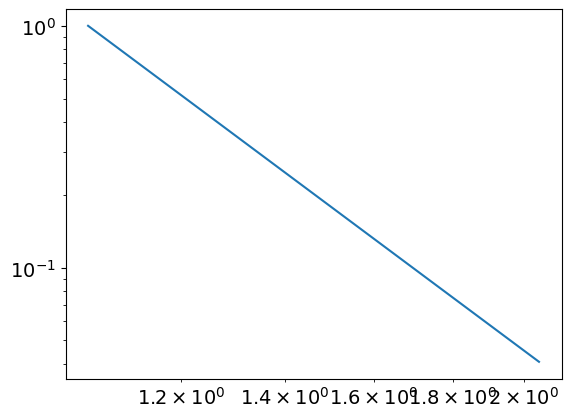

5.753608678242351
1.0440906867503028
powerlaw KstestResult(statistic=0.985098853505986, pvalue=0.0, statistic_location=1.3912959287824491, statistic_sign=1)
lognorm KstestResult(statistic=0.9798515138765865, pvalue=0.0, statistic_location=1.2461311792683485, statistic_sign=1)
tensor(0.0713, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2164, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4564, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6327, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
345
tensor(7.0000e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


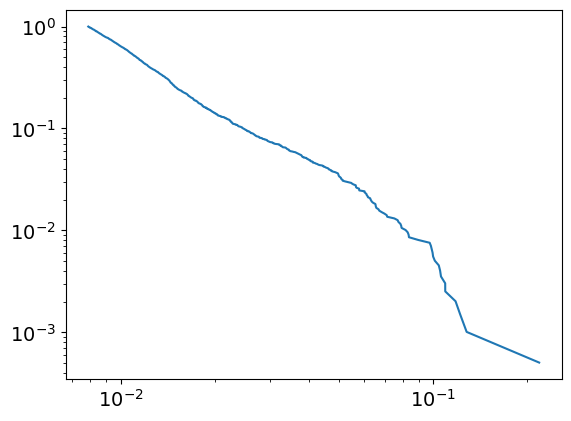

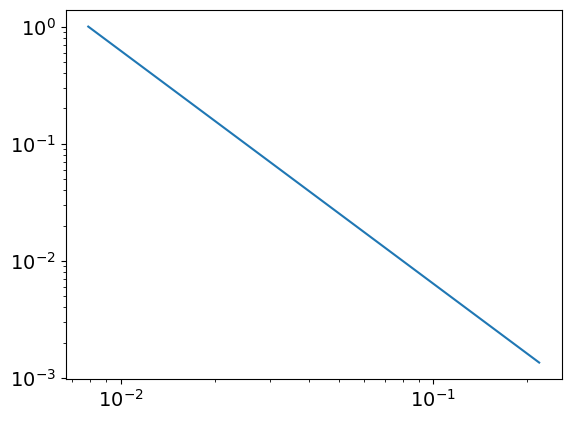

2.9895346867794395
0.007876221043046477
powerlaw KstestResult(statistic=0.9986613681816634, pvalue=0.0, statistic_location=0.08358188510701, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2180306851549712, statistic_sign=1)
tensor(3.8342e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7918, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.9916, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
345
tensor(0.2264, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


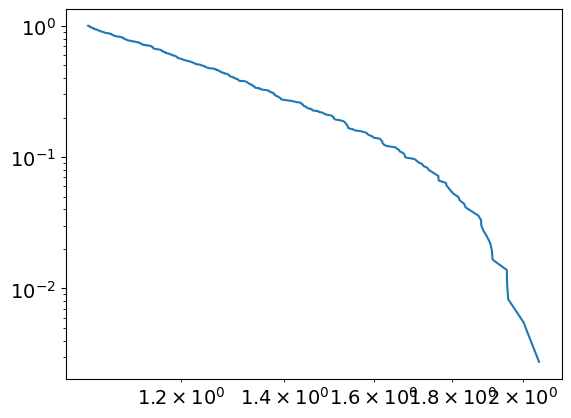

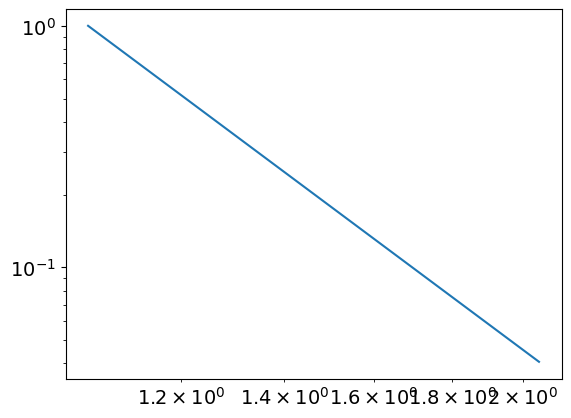

5.750099762494077
1.0437511039768452
powerlaw KstestResult(statistic=0.9850220403549794, pvalue=0.0, statistic_location=1.3927431067461238, statistic_sign=1)
lognorm KstestResult(statistic=0.9798225448266451, pvalue=0.0, statistic_location=1.2471557913278954, statistic_sign=1)
tensor(0.0714, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2165, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4582, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6368, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
346
tensor(7.3588e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


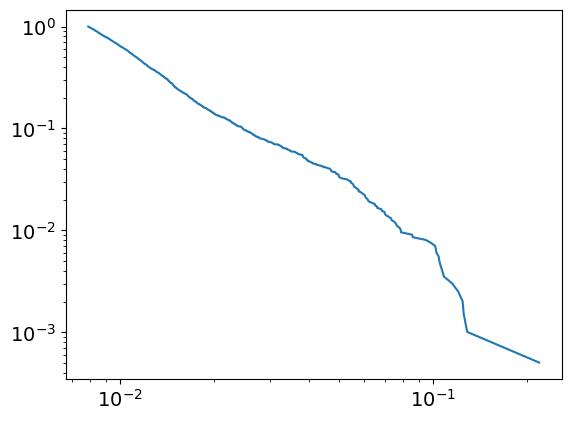

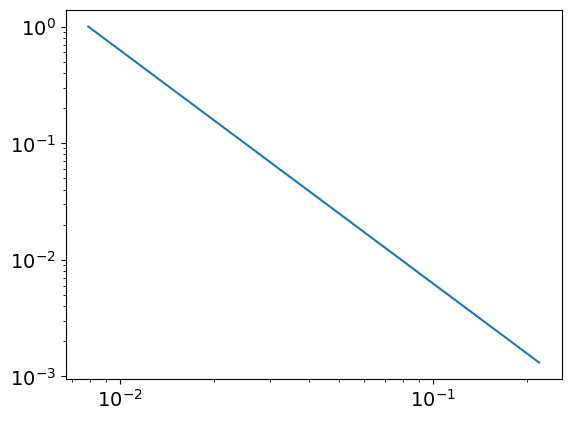

2.999128000650879
0.00789664695289204
powerlaw KstestResult(statistic=0.9986201841664304, pvalue=0.0, statistic_location=0.07894084643301273, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21834849350042795, statistic_sign=1)
tensor(2.9944e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8472, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.5680, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
346
tensor(0.2268, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


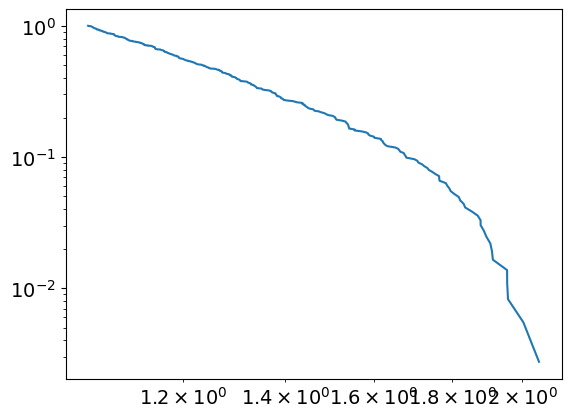

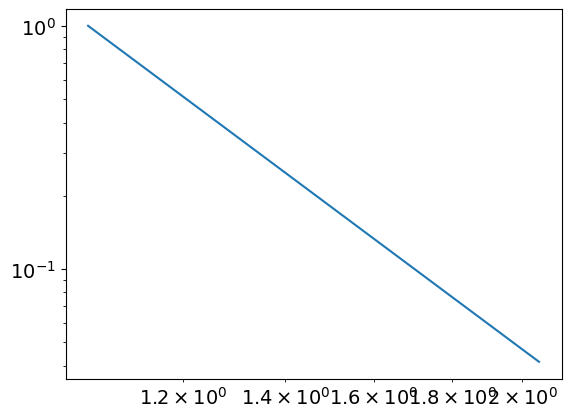

5.688460101642186
1.040049151167327
powerlaw KstestResult(statistic=0.9846666135717469, pvalue=0.0, statistic_location=1.3966064847212174, statistic_sign=1)
lognorm KstestResult(statistic=0.9797918123802156, pvalue=0.0, statistic_location=1.248168218682263, statistic_sign=1)
tensor(0.0715, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2165, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4600, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6410, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
347
tensor(6.7759e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


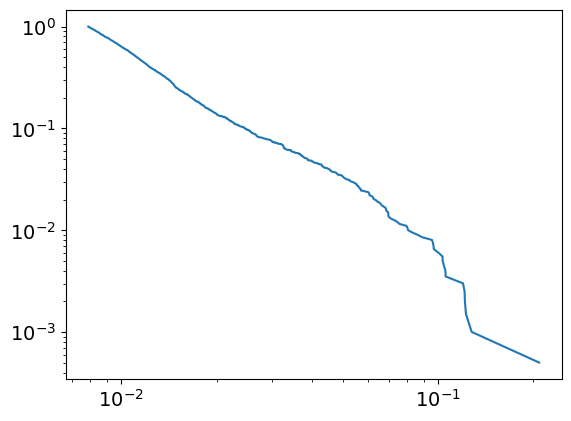

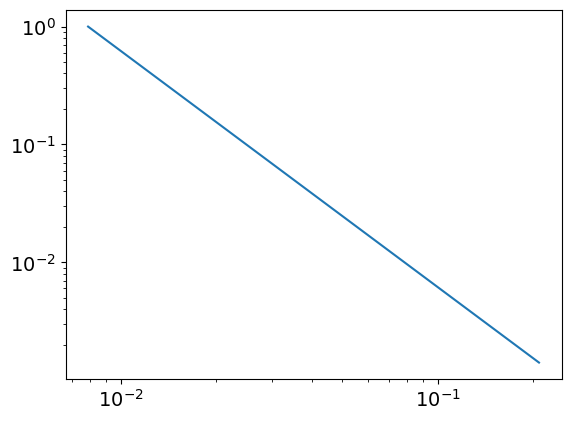

3.003882203515802
0.007877070115527478
powerlaw KstestResult(statistic=0.9986954168368148, pvalue=0.0, statistic_location=0.10549739947084556, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2085061333158866, statistic_sign=1)
tensor(1.5715e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4210, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.6962, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
347
tensor(0.2271, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


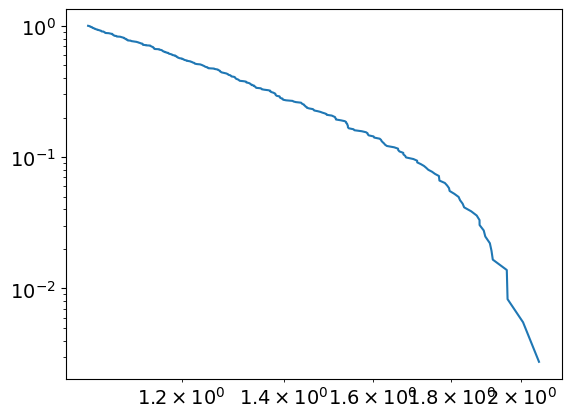

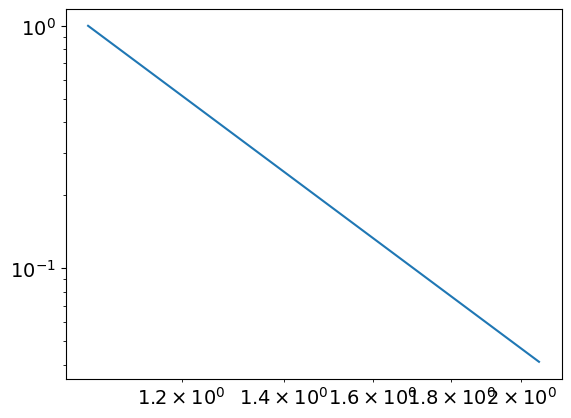

5.709968795810281
1.0427375092457516
powerlaw KstestResult(statistic=0.984778892082778, pvalue=0.0, statistic_location=1.3981568946807406, statistic_sign=1)
lognorm KstestResult(statistic=0.9797578875339035, pvalue=0.0, statistic_location=1.2491985558897112, statistic_sign=1)
tensor(0.0715, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2166, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4619, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6453, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
348
tensor(5.7617e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


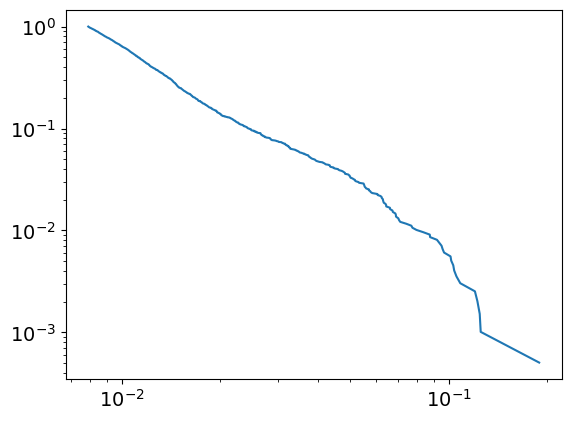

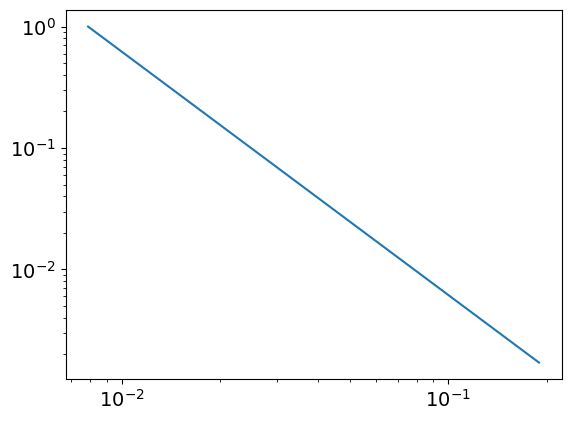

3.005359504442285
0.007901741836336827
powerlaw KstestResult(statistic=0.998691744744504, pvalue=0.0, statistic_location=0.10576313618826354, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18939589483722383, statistic_sign=1)
tensor(2.9449e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3852, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.6050, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
348
tensor(0.2275, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


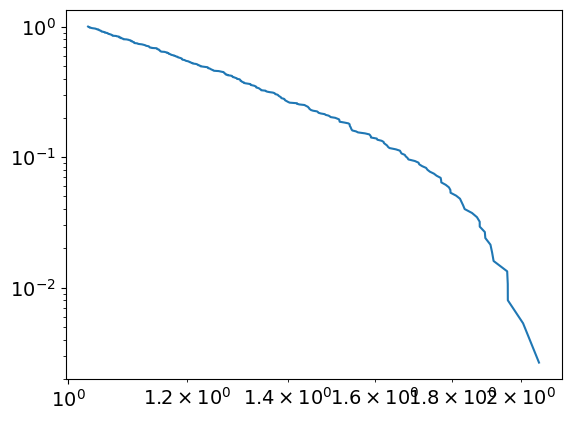

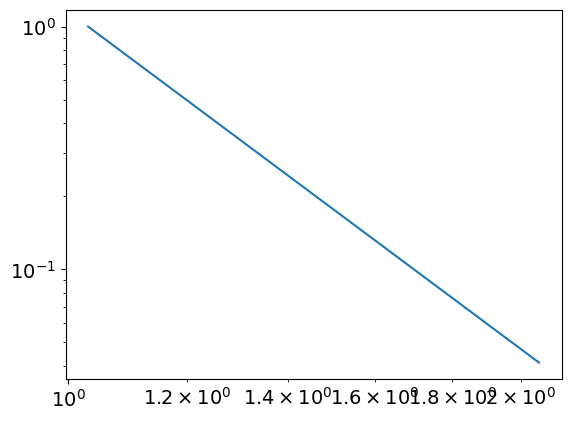

5.620974060626913
1.0309218702213652
powerlaw KstestResult(statistic=0.9837695353635717, pvalue=0.0, statistic_location=1.4007536437660717, statistic_sign=1)
lognorm KstestResult(statistic=0.9797236589504659, pvalue=0.0, statistic_location=1.250176005295497, statistic_sign=1)
tensor(0.0716, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2166, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4638, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6495, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


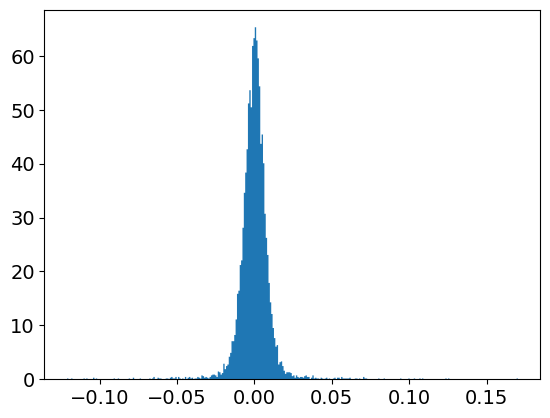

powerlaw
Calculating best minimal value for power law fit
7.3830565526430405
powerlaw KstestResult(statistic=0.9999999979477819, pvalue=0.0, statistic_location=0.17016843801195702, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17016843801195702, statistic_sign=1)



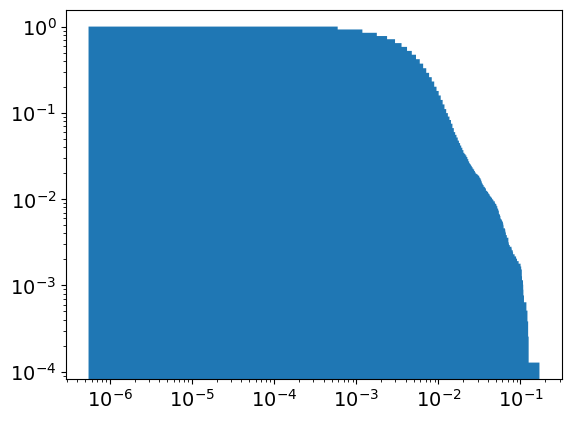

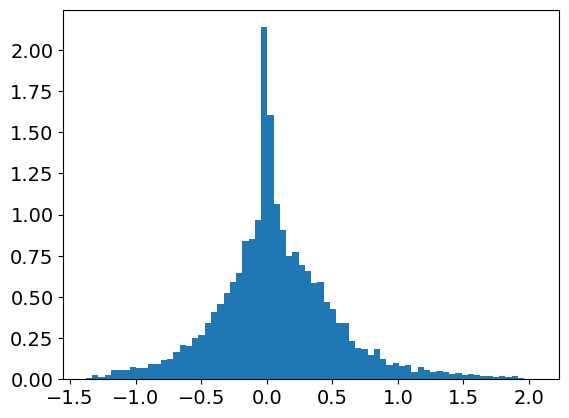

powerlaw
Calculating best minimal value for power law fit
3.0447789685419013
powerlaw KstestResult(statistic=0.9108846329136742, pvalue=0.0, statistic_location=0.7054891072893501, statistic_sign=1)
lognorm KstestResult(statistic=0.9796864221891594, pvalue=0.0, statistic_location=1.251180873291992, statistic_sign=1)



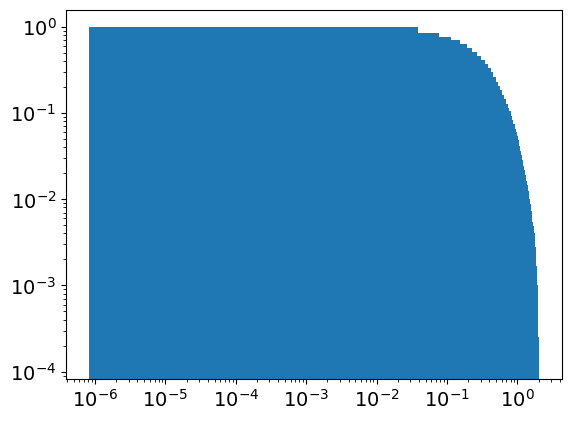

separation
epoch:
349
tensor(5.2901e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


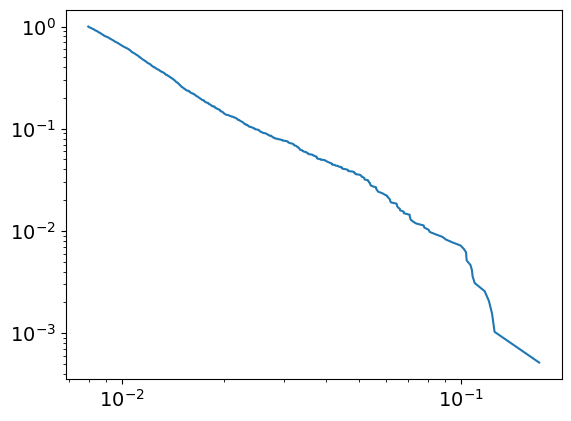

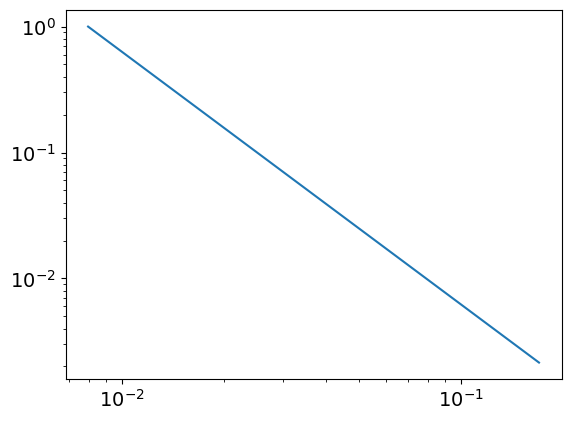

3.0055704872268794
0.007955046220373477
powerlaw KstestResult(statistic=0.9986212527526364, pvalue=0.0, statistic_location=0.10825203770293614, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17016843801195702, statistic_sign=1)
tensor(3.1918e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3910, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6045, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
349
tensor(0.2279, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


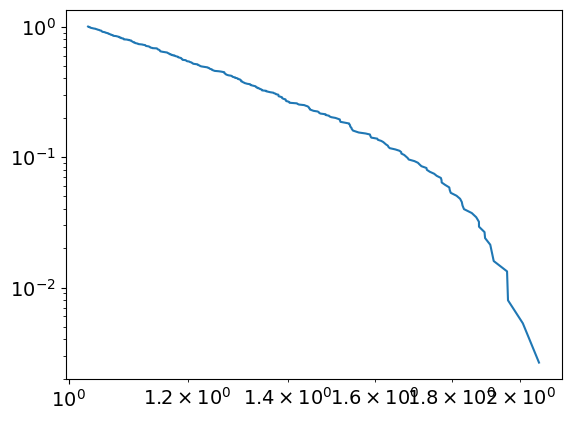

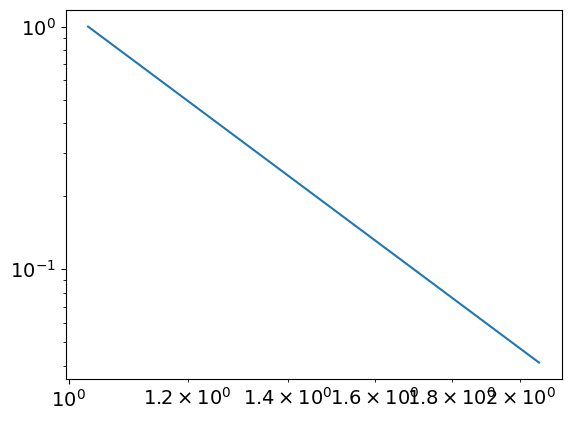

5.609169695646603
1.0301676288379666
powerlaw KstestResult(statistic=0.9836784773947054, pvalue=0.0, statistic_location=1.396279010321156, statistic_sign=1)
lognorm KstestResult(statistic=0.9796864221891594, pvalue=0.0, statistic_location=1.251180873291992, statistic_sign=1)
tensor(0.0717, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2167, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4656, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6537, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
350
tensor(5.0952e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


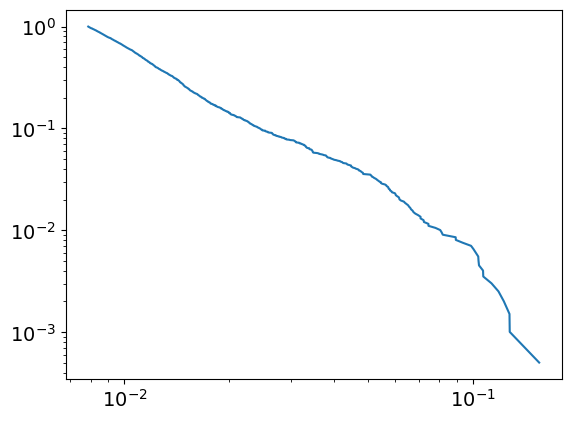

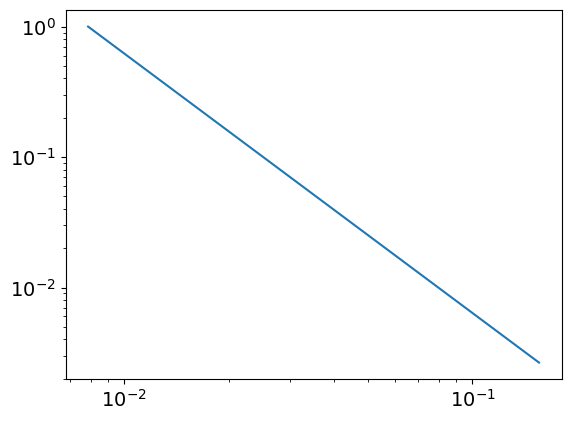

2.9885407164187754
0.00787258856487581
powerlaw KstestResult(statistic=0.9986078997980768, pvalue=0.0, statistic_location=0.10730592352081808, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1553033629253411, statistic_sign=1)
tensor(3.9555e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3276, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.4070, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
350
tensor(0.2282, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


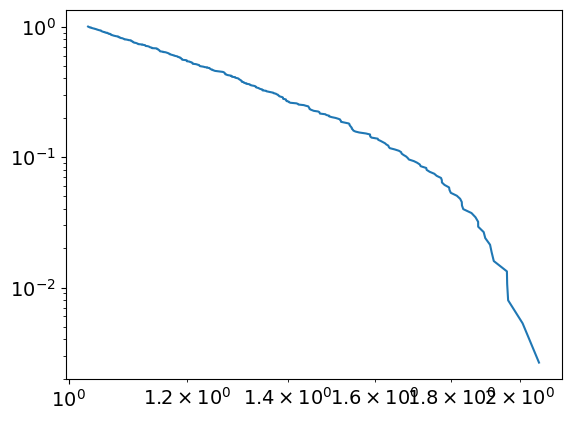

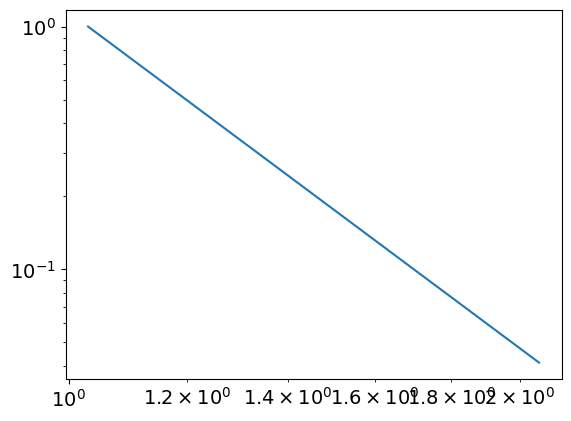

5.601298455408912
1.0301297272314955
powerlaw KstestResult(statistic=0.9835711445259149, pvalue=0.0, statistic_location=1.397664985491158, statistic_sign=1)
lognorm KstestResult(statistic=0.9796483841701139, pvalue=0.0, statistic_location=1.2521415517543044, statistic_sign=1)
tensor(0.0717, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2167, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4675, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6580, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
351
tensor(5.6909e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


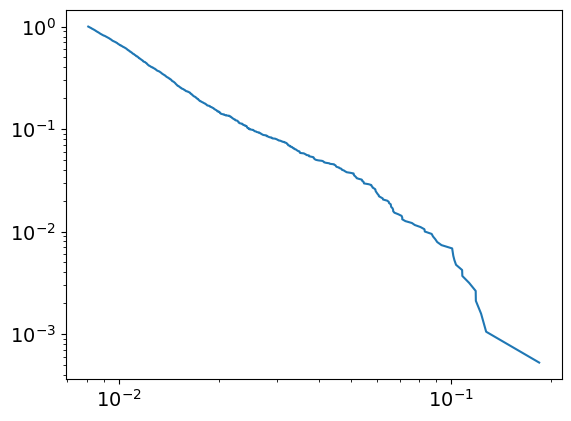

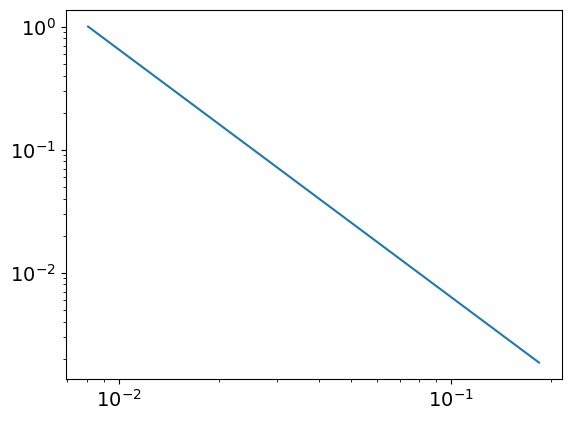

3.0126968668817393
0.008084558118180001
powerlaw KstestResult(statistic=0.9986863720176902, pvalue=0.0, statistic_location=0.09080120348057816, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1274668341080566, statistic_sign=-1)
tensor(-5.3196e-09, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3301, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.5143, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
351
tensor(0.2286, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


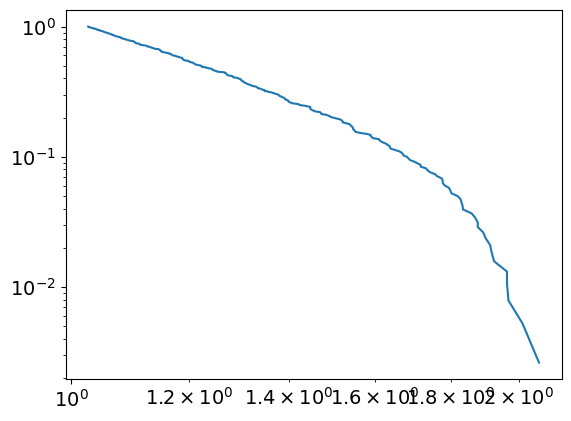

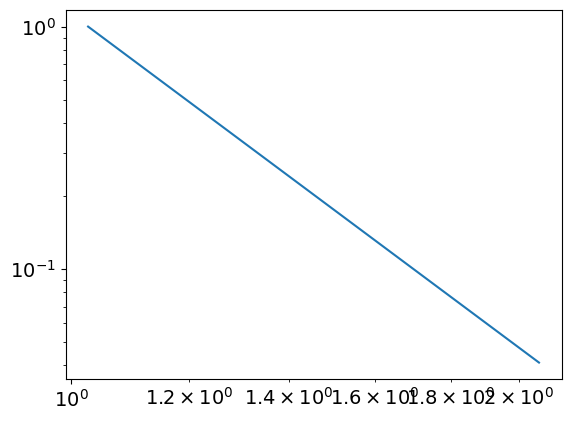

5.570909139583608
1.0260638255509855
powerlaw KstestResult(statistic=0.9830993495988796, pvalue=0.0, statistic_location=1.3996120182715484, statistic_sign=1)
lognorm KstestResult(statistic=0.9796054976506099, pvalue=0.0, statistic_location=1.253153272414589, statistic_sign=1)
tensor(0.0718, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2168, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4694, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6622, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
352
tensor(5.2324e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


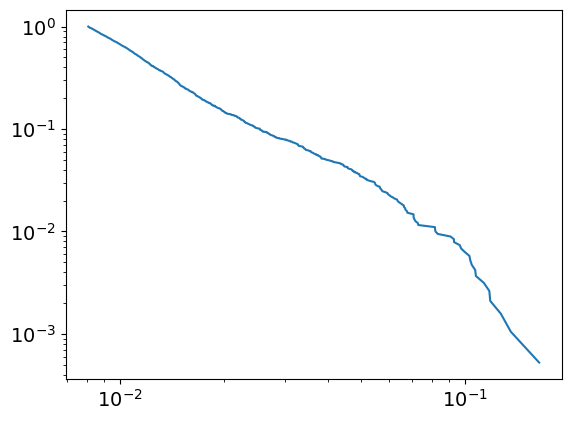

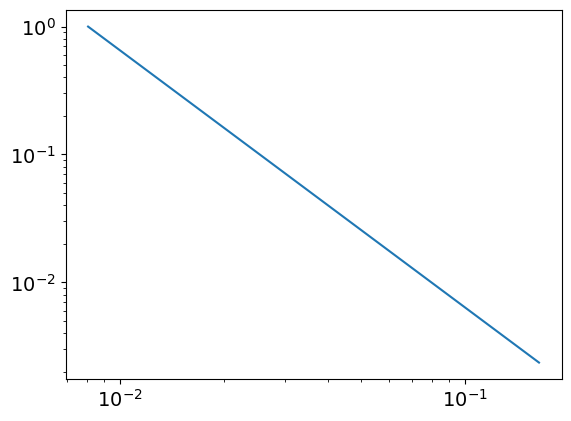

3.0113618130793545
0.008079199984318624
powerlaw KstestResult(statistic=0.9986635564946812, pvalue=0.0, statistic_location=0.10737932880687855, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16380991882606238, statistic_sign=1)
tensor(3.0119e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2707, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.7946, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
352
tensor(0.2289, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


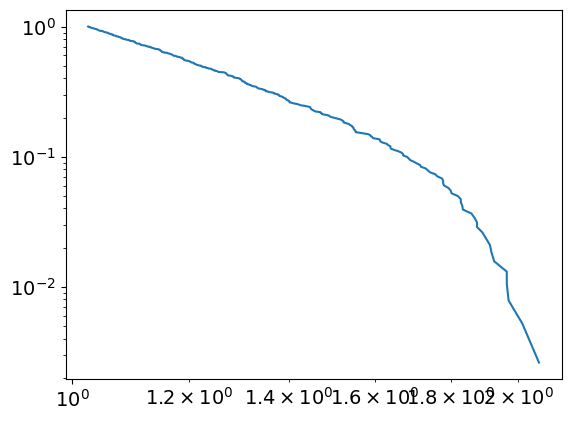

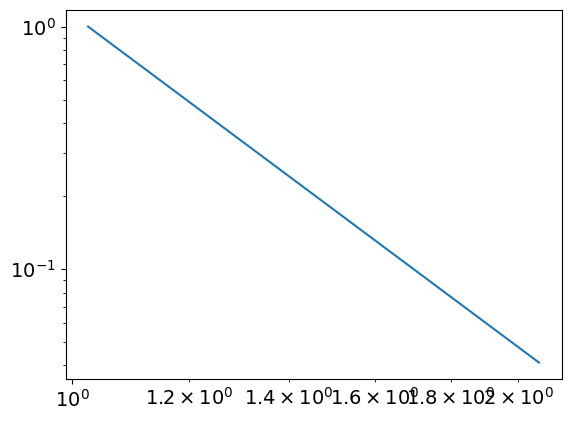

5.556724031615287
1.0251420020092326
powerlaw KstestResult(statistic=0.9829628821349166, pvalue=0.0, statistic_location=1.4019155706742283, statistic_sign=1)
lognorm KstestResult(statistic=0.9795614148324988, pvalue=0.0, statistic_location=1.2541409429746226, statistic_sign=1)
tensor(0.0719, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2169, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4713, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6664, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
353
tensor(5.9404e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


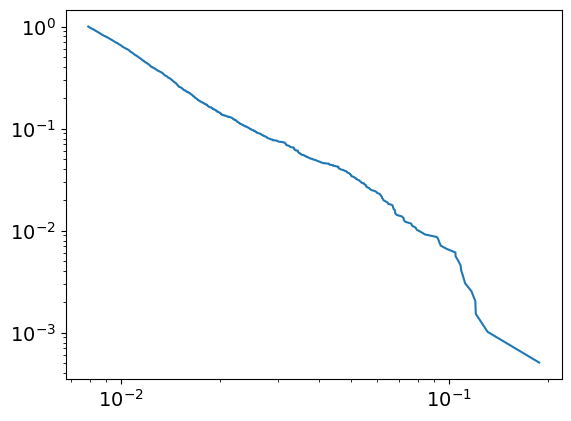

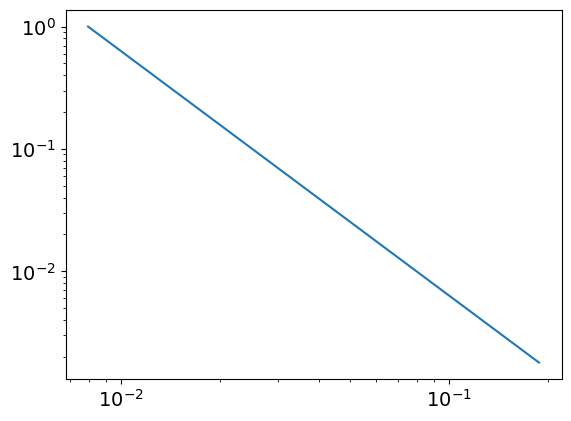

2.9985602222391066
0.007928703133228318
powerlaw KstestResult(statistic=0.9984966267954338, pvalue=0.0, statistic_location=0.1116879534090982, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18791620777931345, statistic_sign=1)
tensor(3.1168e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6155, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.6603, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
353
tensor(0.2293, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


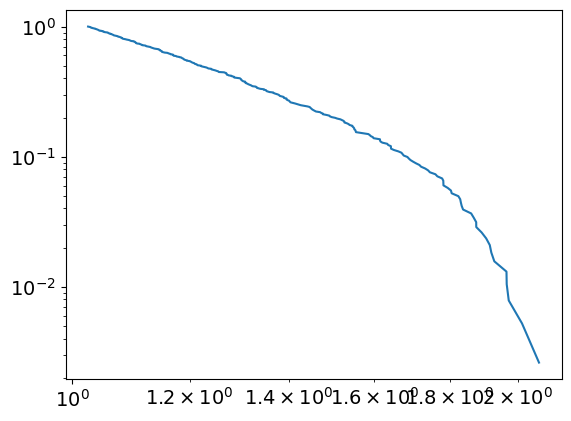

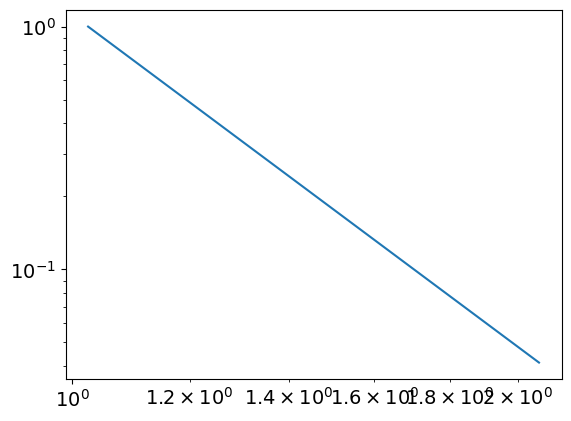

5.5391848350442014
1.0246329074235179
powerlaw KstestResult(statistic=0.9827687769747736, pvalue=0.0, statistic_location=1.358805918771004, statistic_sign=1)
lognorm KstestResult(statistic=0.9794800677320423, pvalue=0.0, statistic_location=1.2559052174371275, statistic_sign=1)
tensor(0.0720, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2169, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4732, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6706, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
354
tensor(6.1972e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


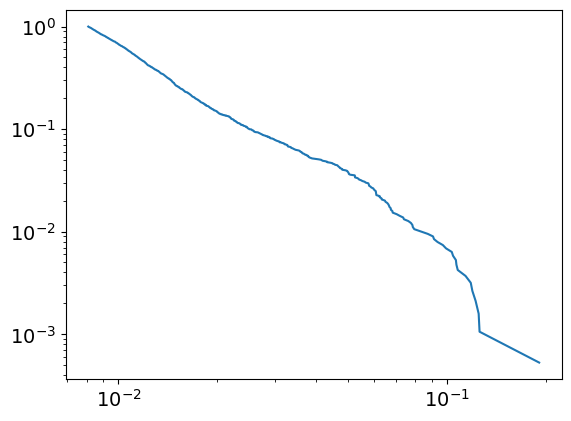

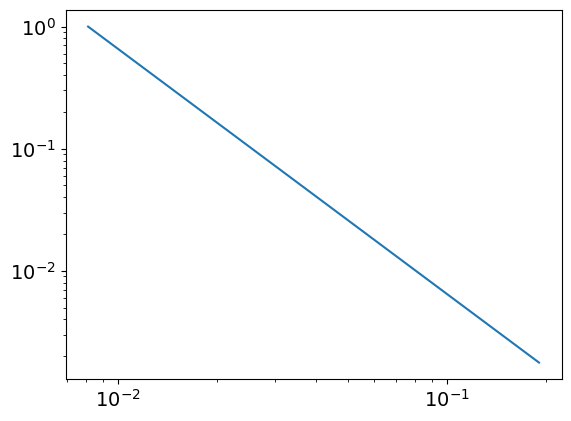

3.0058749644641503
0.008097255559896509
powerlaw KstestResult(statistic=0.9985417260266365, pvalue=0.0, statistic_location=0.10678192725960578, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1906450662282255, statistic_sign=1)
tensor(3.8238e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5860, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.2728, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
354
tensor(0.2297, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


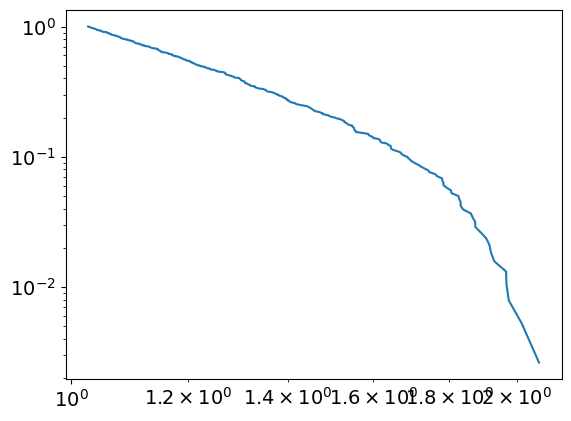

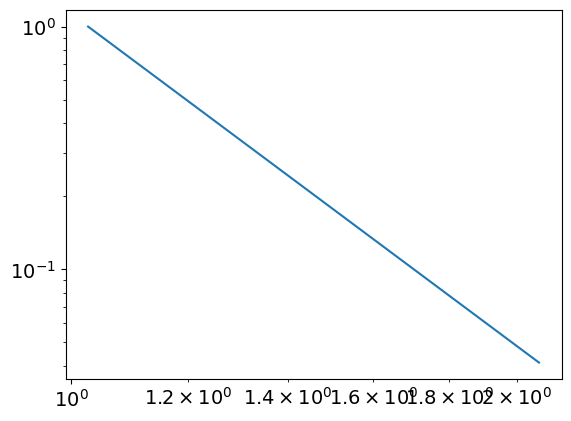

5.5501191879916565
1.0267794622452076
powerlaw KstestResult(statistic=0.9828333911391103, pvalue=0.0, statistic_location=1.3564696777075267, statistic_sign=1)
lognorm KstestResult(statistic=0.9793530479101284, pvalue=0.0, statistic_location=1.2583879379372709, statistic_sign=1)
tensor(0.0720, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2170, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6749, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
355
tensor(5.6788e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


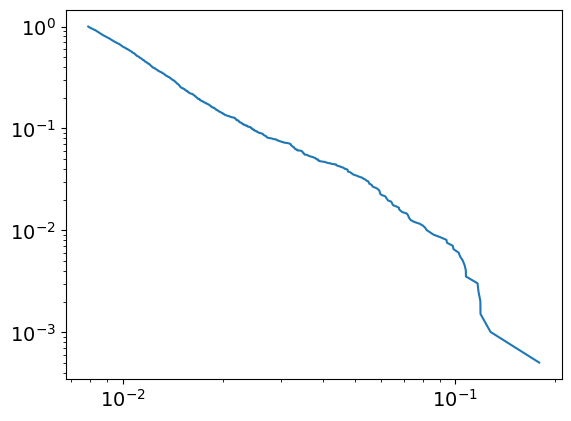

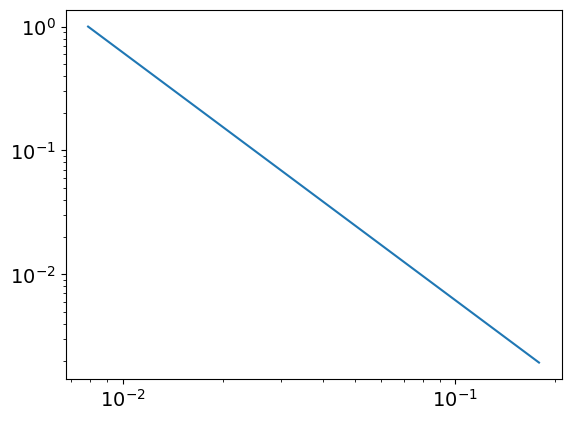

3.0006838909915188
0.007878097348781705
powerlaw KstestResult(statistic=0.9985018417207898, pvalue=0.0, statistic_location=0.08609835041896322, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1788906265527642, statistic_sign=1)
tensor(3.5649e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5105, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.9300, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
355
tensor(0.2300, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


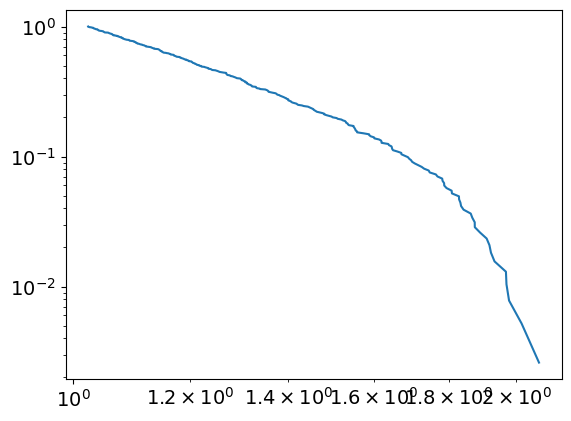

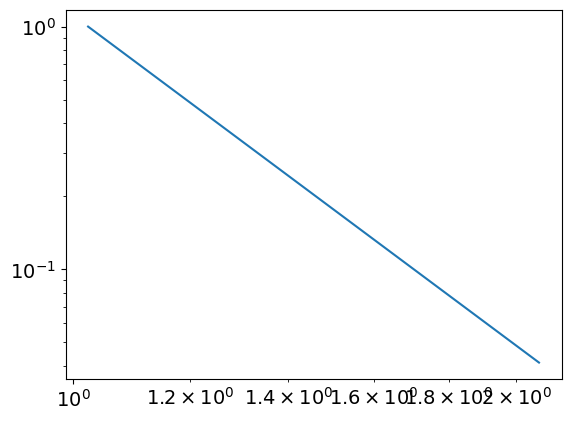

5.518450607797415
1.0231508256106185
powerlaw KstestResult(statistic=0.9825992217575673, pvalue=0.0, statistic_location=1.3570400100670517, statistic_sign=1)
lognorm KstestResult(statistic=0.9792831076917984, pvalue=0.0, statistic_location=1.257112404342252, statistic_sign=1)
tensor(0.0721, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2170, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4771, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6792, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
356
tensor(5.3091e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


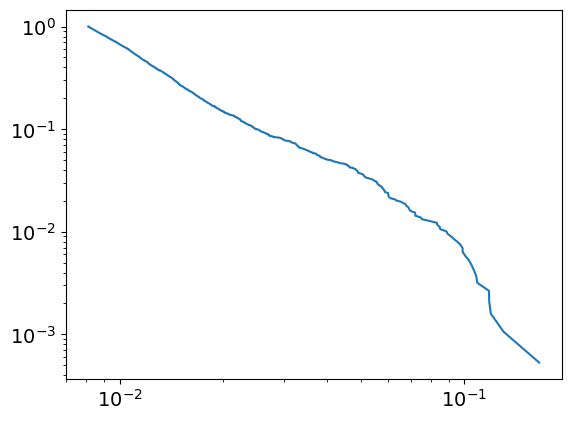

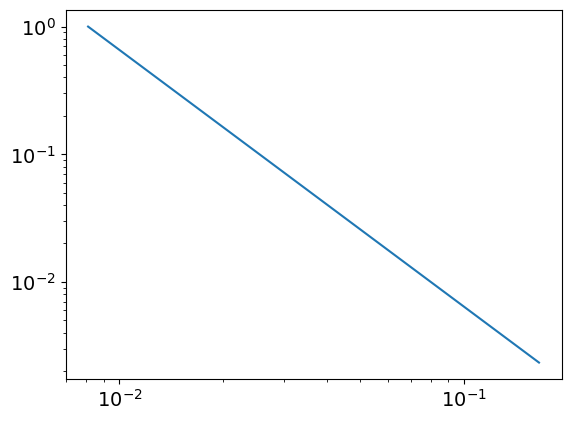

3.013188085350559
0.008114151932090115
powerlaw KstestResult(statistic=0.9986628398740044, pvalue=0.0, statistic_location=0.10295410212633728, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16475764885102223, statistic_sign=1)
tensor(9.9315e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2536, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.4403, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
356
tensor(0.2304, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


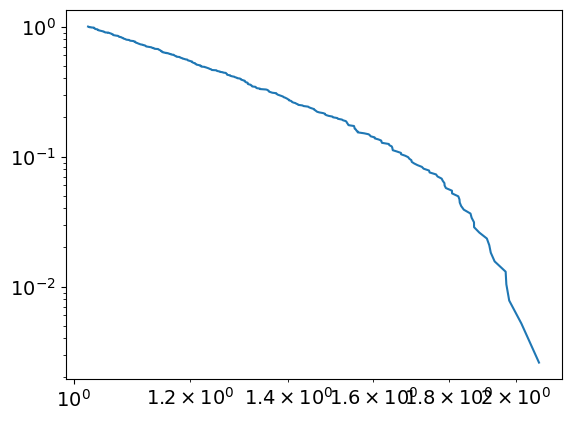

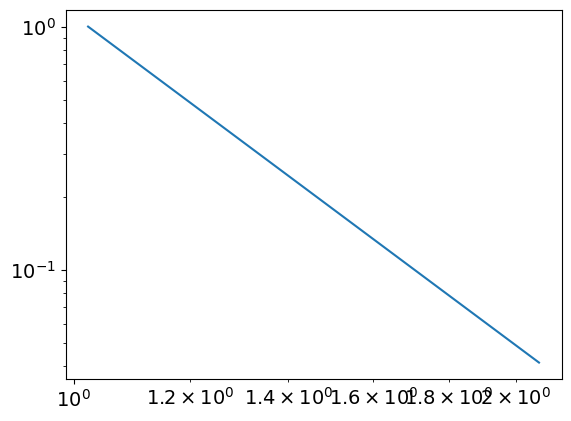

5.499022963645521
1.0225462657311797
powerlaw KstestResult(statistic=0.9824376709247327, pvalue=0.0, statistic_location=1.3591900250792792, statistic_sign=1)
lognorm KstestResult(statistic=0.9792258678494189, pvalue=0.0, statistic_location=1.2581091861266505, statistic_sign=1)
tensor(0.0722, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2171, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4790, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6834, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
357
tensor(5.0661e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


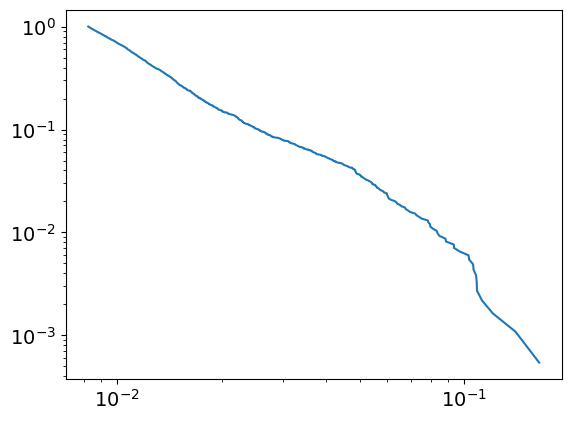

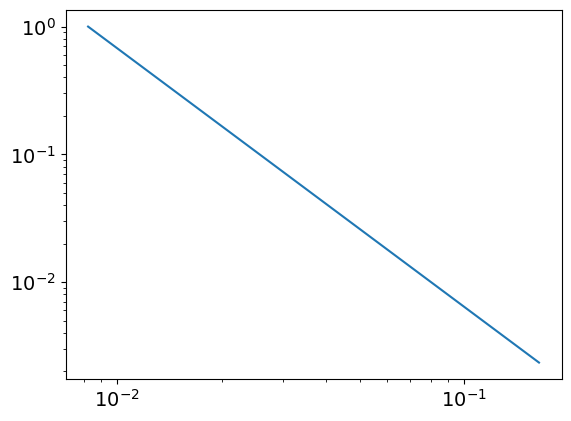

3.0238526144004845
0.008245215730615856
powerlaw KstestResult(statistic=0.9987638646107532, pvalue=0.0, statistic_location=0.07974826222051208, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16430435304805394, statistic_sign=1)
tensor(1.8726e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2359, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.1666, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
357
tensor(0.2308, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


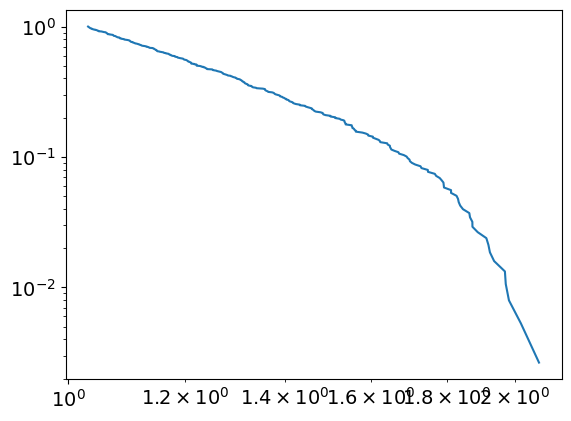

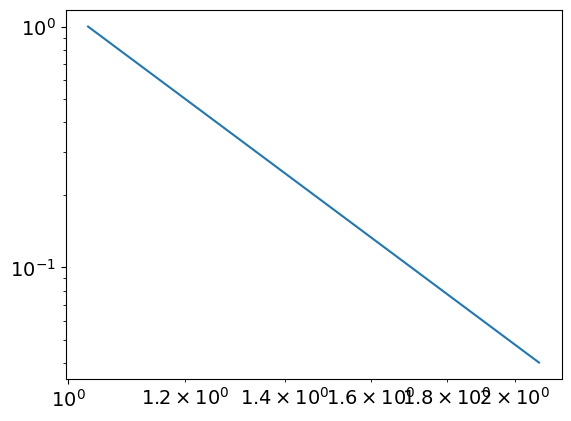

5.594206059831048
1.0318392142187922
powerlaw KstestResult(statistic=0.9829922879581094, pvalue=0.0, statistic_location=1.363538786467446, statistic_sign=1)
lognorm KstestResult(statistic=0.9791611001192765, pvalue=0.0, statistic_location=1.240905696076597, statistic_sign=1)
tensor(0.0723, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2171, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4809, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6876, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
358
tensor(4.8121e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


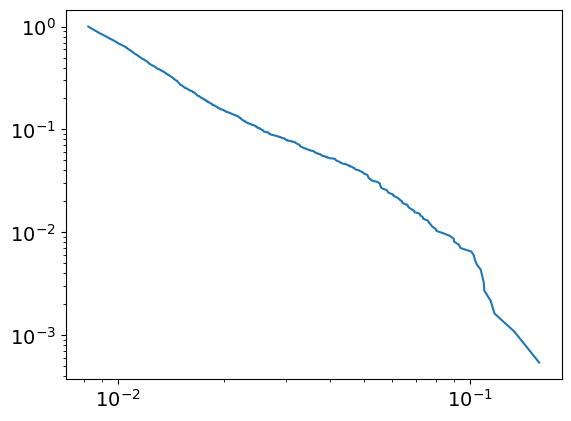

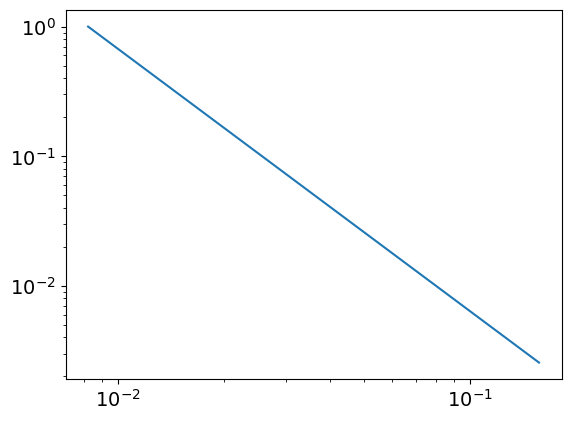

3.023251190161841
0.008214540106436225
powerlaw KstestResult(statistic=0.9987005833032363, pvalue=0.0, statistic_location=0.10233535587334115, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15692841450834008, statistic_sign=1)
tensor(6.4847e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2213, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.6803, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
358
tensor(0.2311, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


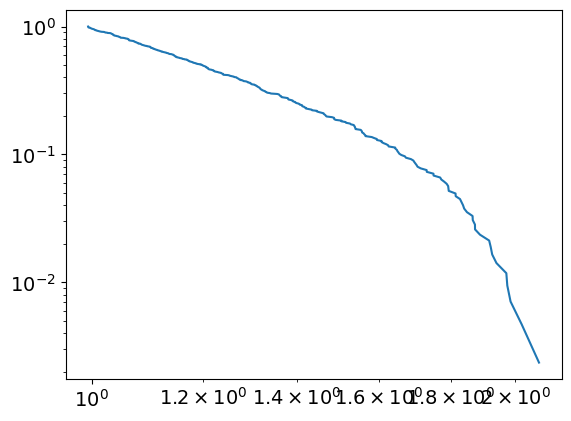

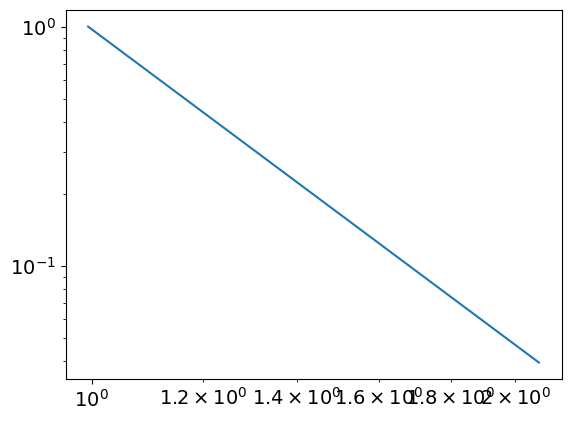

5.380880509367475
0.9941906907081813
powerlaw KstestResult(statistic=0.9809962027489764, pvalue=0.0, statistic_location=1.332488993787678, statistic_sign=1)
lognorm KstestResult(statistic=0.9791625623954239, pvalue=0.0, statistic_location=1.2406784616024378, statistic_sign=1)
tensor(0.0723, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2172, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4828, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6919, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
359
tensor(5.2560e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


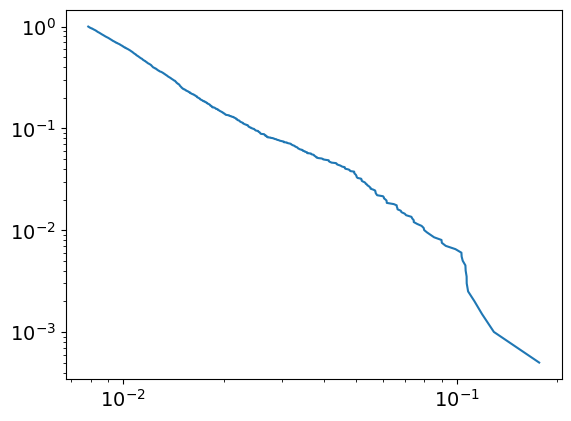

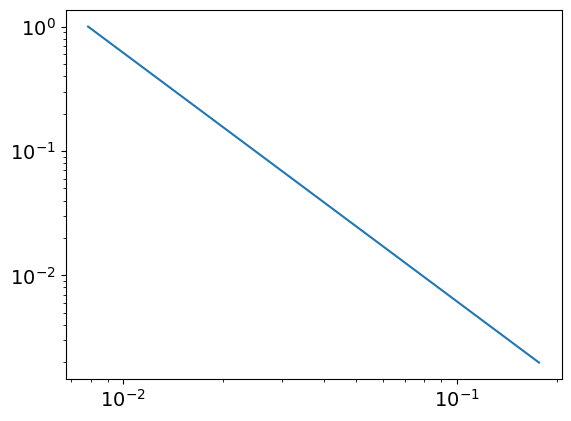

2.998663401161334
0.007864059619618769
powerlaw KstestResult(statistic=0.9986074350084033, pvalue=0.0, statistic_location=0.10809059988013693, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1765008914189771, statistic_sign=1)
tensor(7.7584e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3875, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.1369, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
359
tensor(0.2315, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


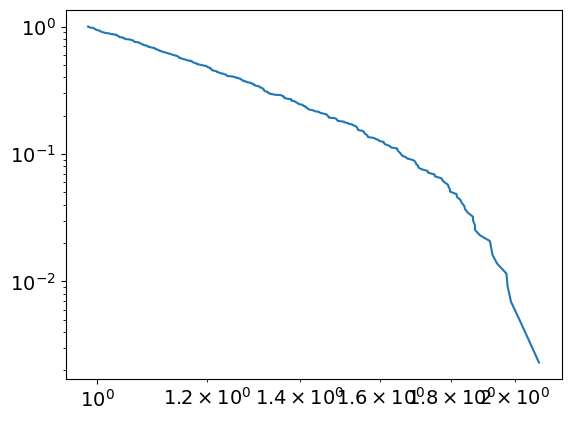

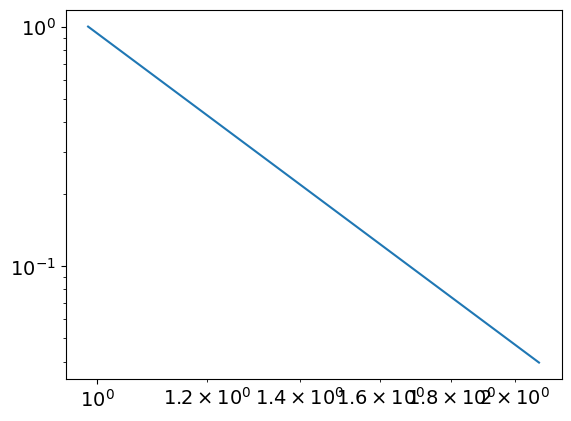

5.318209669081144
0.9853784827725474
powerlaw KstestResult(statistic=0.9803354071522014, pvalue=0.0, statistic_location=1.332393702961872, statistic_sign=1)
lognorm KstestResult(statistic=0.979148237508641, pvalue=0.0, statistic_location=1.241232982746196, statistic_sign=1)
tensor(0.0724, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2172, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4848, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6962, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
360
tensor(4.8101e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


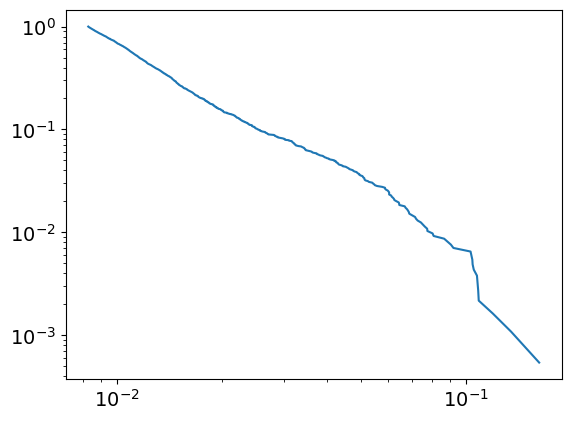

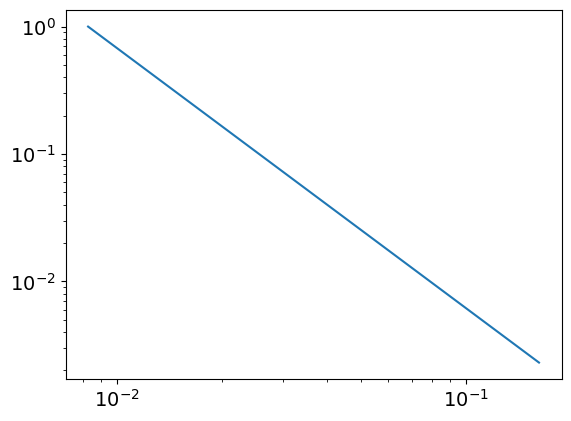

3.038465765596614
0.008258611809306456
powerlaw KstestResult(statistic=0.9988220643550664, pvalue=0.0, statistic_location=0.10853097327380866, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16234822395634704, statistic_sign=1)
tensor(5.0437e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2980, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.0266, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
360
tensor(0.2319, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


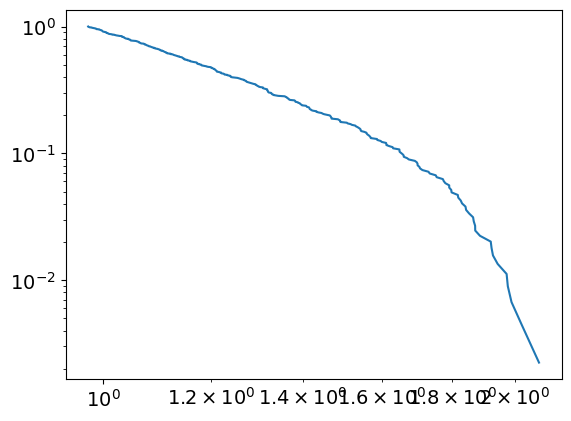

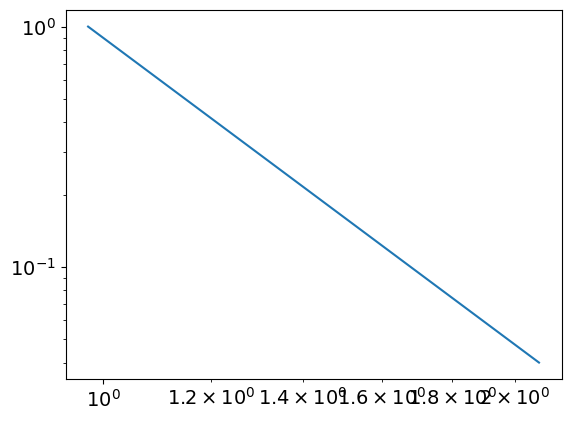

5.236647236515854
0.9750441977062372
powerlaw KstestResult(statistic=0.9794406942944218, pvalue=0.0, statistic_location=1.3209180020213864, statistic_sign=1)
lognorm KstestResult(statistic=0.9791124254312709, pvalue=0.0, statistic_location=1.2427435792529589, statistic_sign=1)
tensor(0.0725, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2173, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4867, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7004, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
361
tensor(5.2627e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


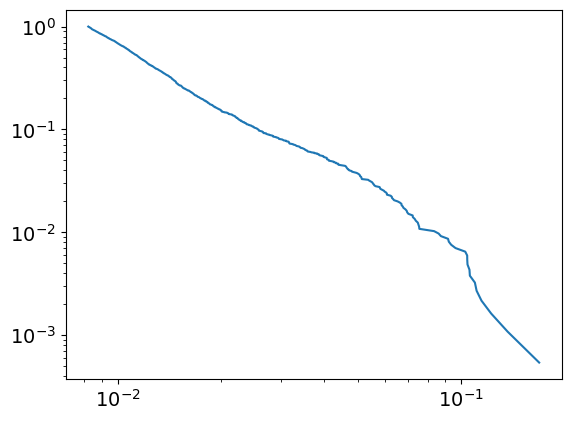

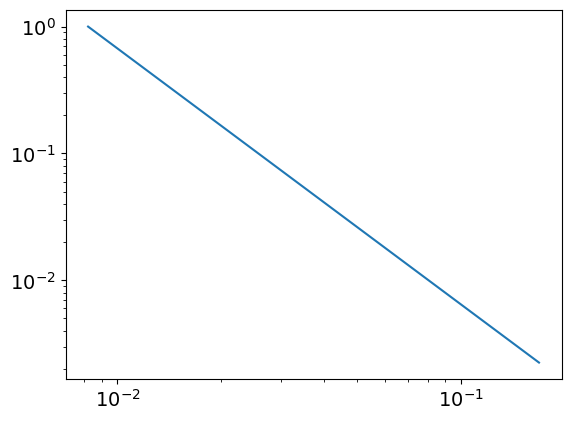

3.016931466279886
0.008209827046629873
powerlaw KstestResult(statistic=0.9987136824413996, pvalue=0.0, statistic_location=0.10616563390324264, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16897938665733545, statistic_sign=1)
tensor(1.7442e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5847, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
361
tensor(0.2322, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


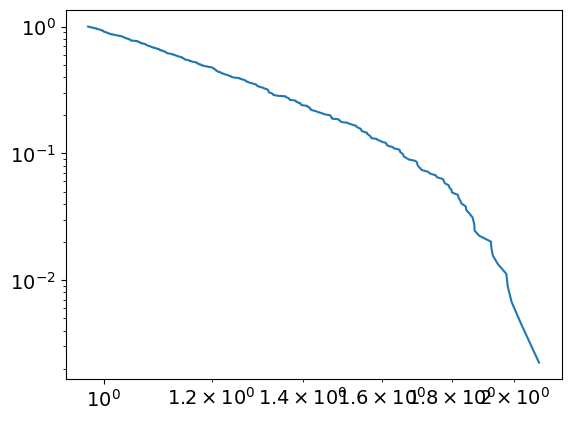

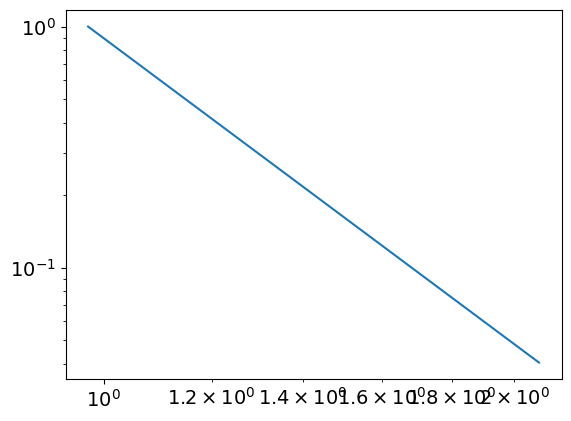

5.2157732725043715
0.9741915105761814
powerlaw KstestResult(statistic=0.9792183132580949, pvalue=0.0, statistic_location=1.3321740782904878, statistic_sign=1)
lognorm KstestResult(statistic=0.9790746047665216, pvalue=0.0, statistic_location=1.2441934793315408, statistic_sign=1)
tensor(0.0725, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2173, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4887, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7047, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
362
tensor(5.2834e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


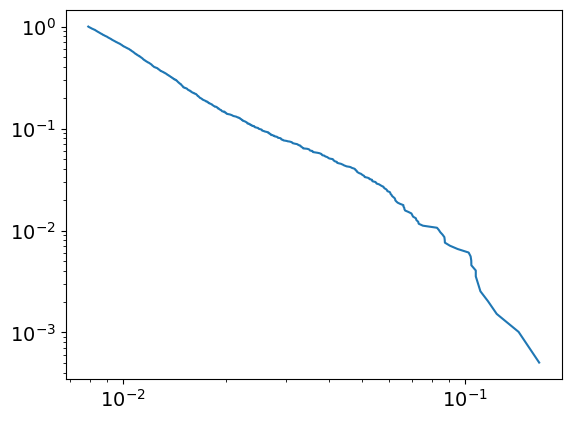

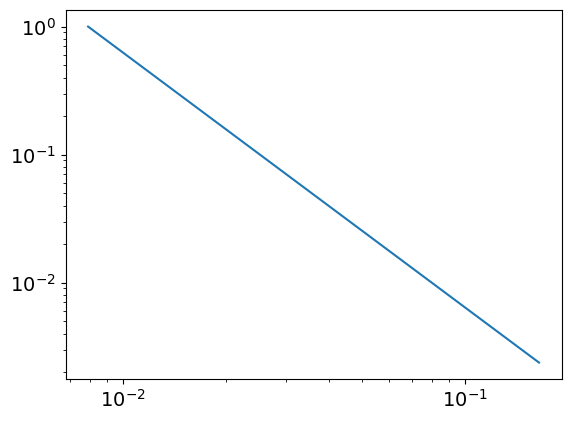

2.990553173819299
0.007914912242422505
powerlaw KstestResult(statistic=0.9987213130909893, pvalue=0.0, statistic_location=0.08735067767940044, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16477307436730868, statistic_sign=1)
tensor(2.1257e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3263, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
362
tensor(0.2326, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


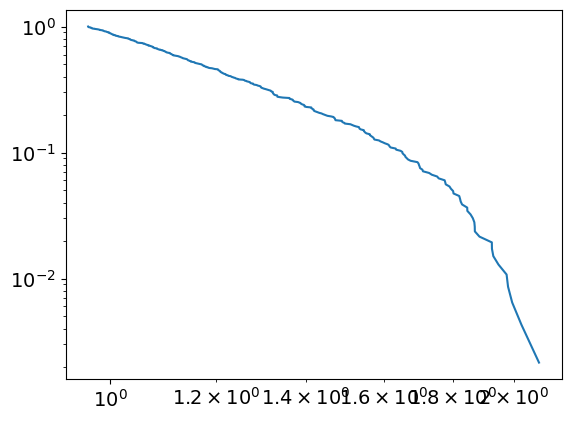

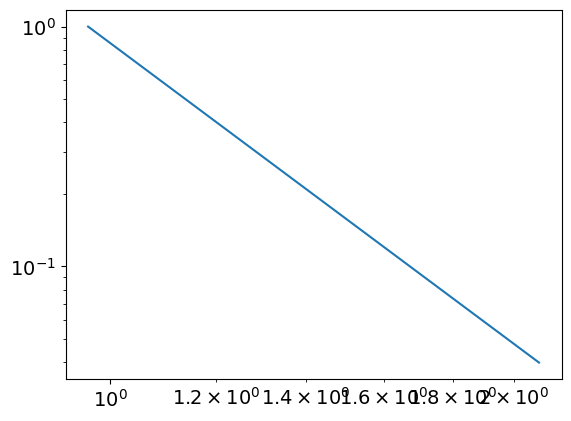

5.1660316138604685
0.9625419190529056
powerlaw KstestResult(statistic=0.9783342131830393, pvalue=0.0, statistic_location=1.2799005868691, statistic_sign=1)
lognorm KstestResult(statistic=0.9790316959388804, pvalue=0.0, statistic_location=1.2456825668326403, statistic_sign=1)
tensor(0.0726, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2174, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4906, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7089, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
363
tensor(5.0008e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


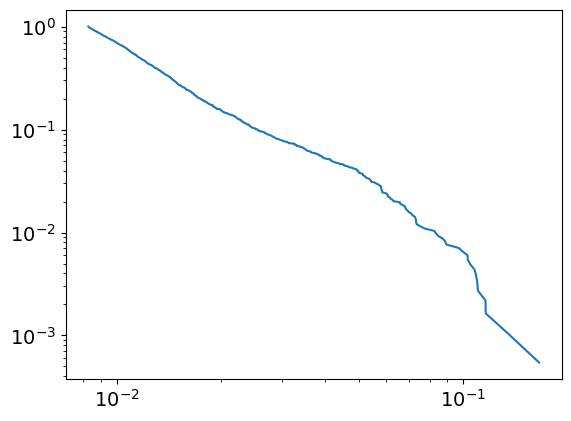

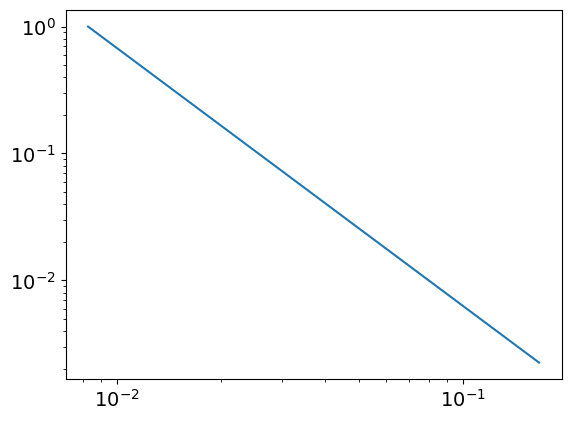

3.0339922842837956
0.008273456008008993
powerlaw KstestResult(statistic=0.9987432435893185, pvalue=0.0, statistic_location=0.08946594967525932, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16575780532030407, statistic_sign=1)
tensor(5.4242e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2715, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.6856, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
363
tensor(0.2329, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


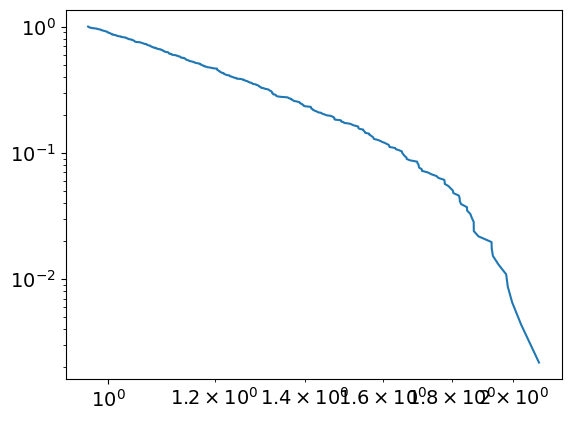

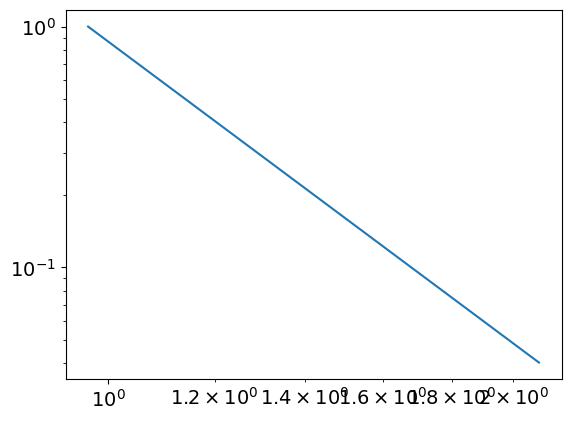

5.162152721816572
0.966095549865471
powerlaw KstestResult(statistic=0.9784678183657181, pvalue=0.0, statistic_location=1.288724716571469, statistic_sign=1)
lognorm KstestResult(statistic=0.9789874126208676, pvalue=0.0, statistic_location=1.2470855257593225, statistic_sign=1)
tensor(0.0727, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2174, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4926, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7132, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
364
tensor(5.6732e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


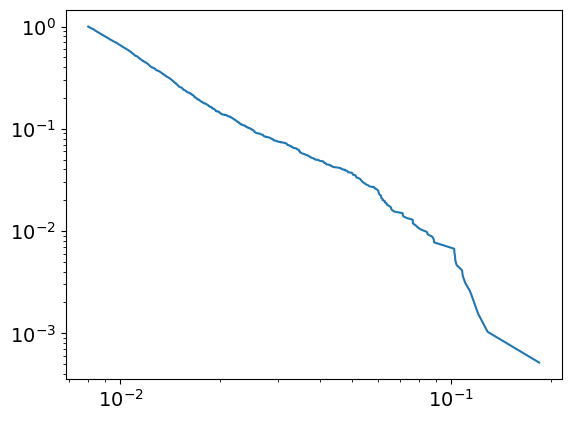

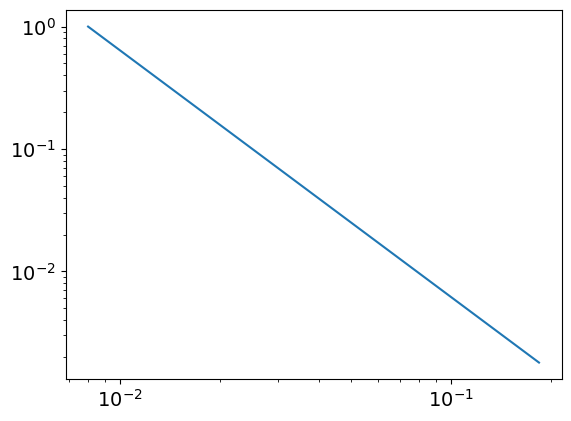

3.013843933642955
0.007996602960195436
powerlaw KstestResult(statistic=0.9987238319812515, pvalue=0.0, statistic_location=0.08887041517611426, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11697284322918387, statistic_sign=-1)
tensor(-3.9929e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4301, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.3914, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
364
tensor(0.2333, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


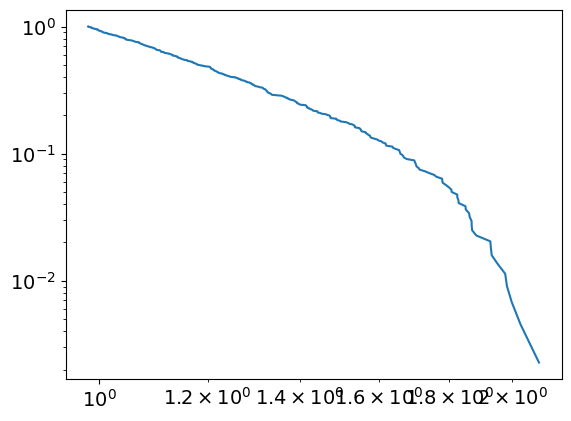

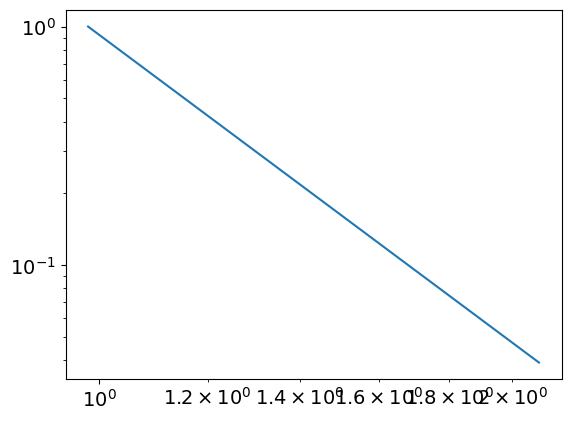

5.282676969743982
0.981818175730874
powerlaw KstestResult(statistic=0.9798292203230465, pvalue=0.0, statistic_location=1.3371309585190965, statistic_sign=1)
lognorm KstestResult(statistic=0.9789368013749877, pvalue=0.0, statistic_location=1.2485559728480977, statistic_sign=1)
tensor(0.0728, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2175, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4946, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7176, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
365
tensor(6.1950e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


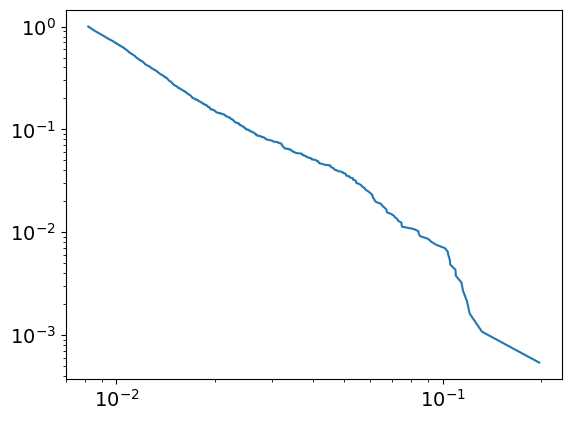

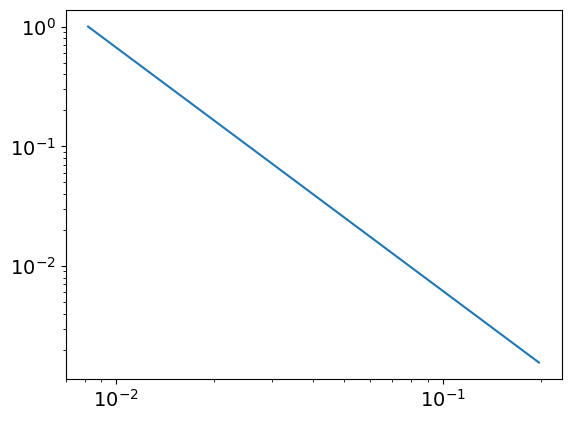

3.031437258146182
0.008196543141860722
powerlaw KstestResult(statistic=0.998686402135495, pvalue=0.0, statistic_location=0.09219600441757607, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11854394636960423, statistic_sign=-1)
tensor(-9.3289e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4797, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.9253, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
365
tensor(0.2337, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


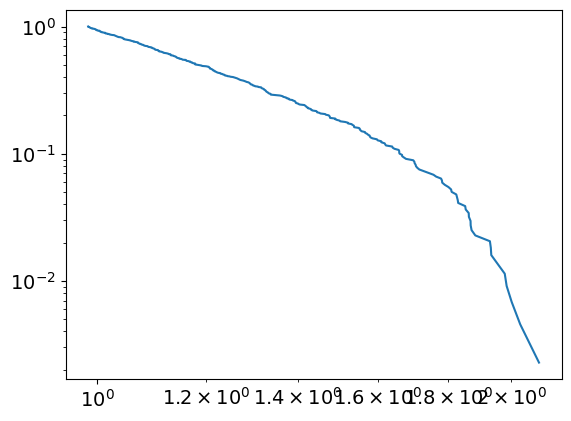

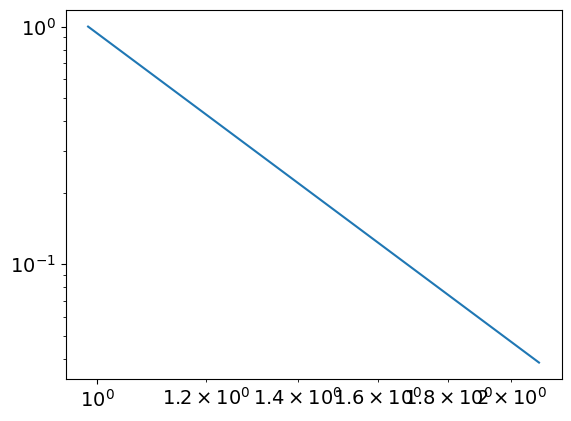

5.317774956994024
0.9850737676156547
powerlaw KstestResult(statistic=0.9801520828160278, pvalue=0.0, statistic_location=1.3375157878897286, statistic_sign=1)
lognorm KstestResult(statistic=0.9788790407576393, pvalue=0.0, statistic_location=1.2500894247729957, statistic_sign=1)
tensor(0.0729, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2175, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4965, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7218, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
366
tensor(5.7035e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


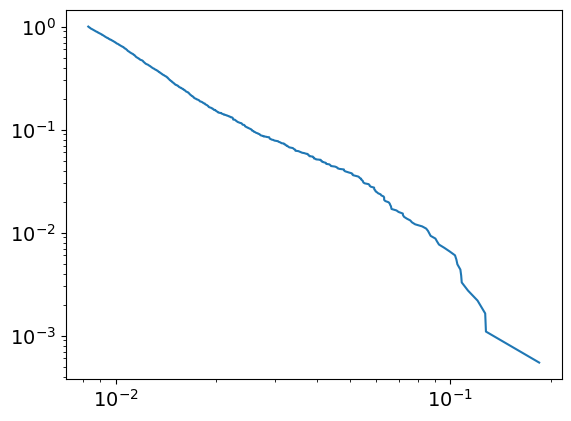

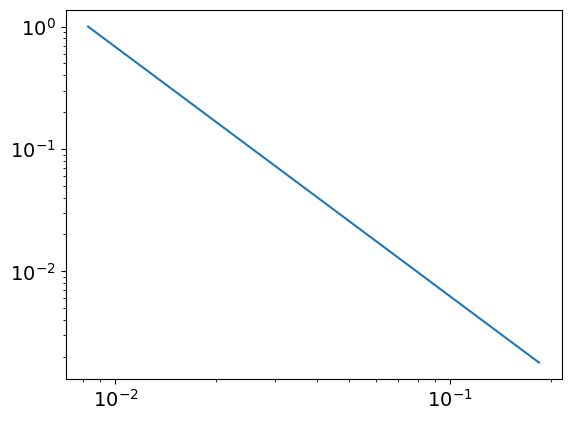

3.03901139264894
0.008282368521602699
powerlaw KstestResult(statistic=0.9987169155031851, pvalue=0.0, statistic_location=0.09122440056154196, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18417468065796916, statistic_sign=1)
tensor(2.1720e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4716, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.6455, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
366
tensor(0.2341, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


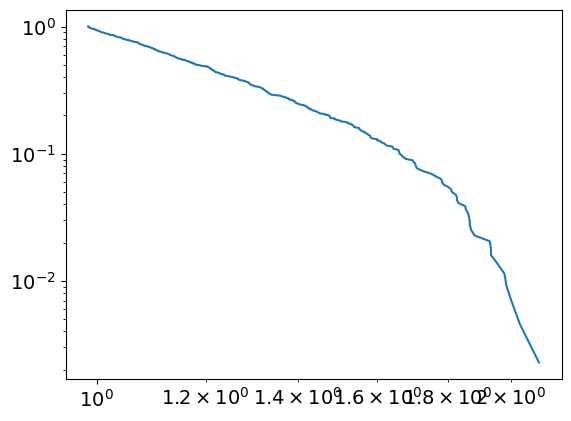

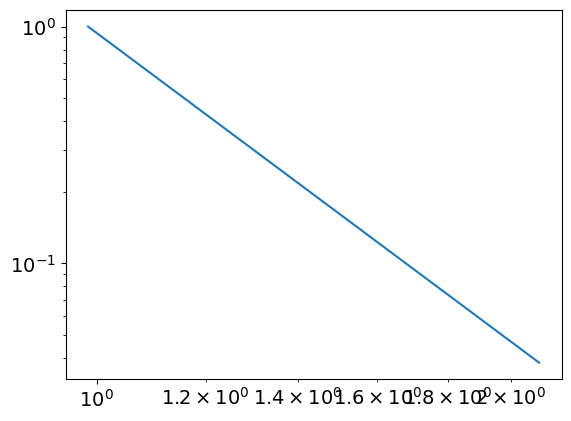

5.3268760911247846
0.9858732496344512
powerlaw KstestResult(statistic=0.9801211770346276, pvalue=0.0, statistic_location=1.3394668269822083, statistic_sign=1)
lognorm KstestResult(statistic=0.9788170721110695, pvalue=0.0, statistic_location=1.2515911842379355, statistic_sign=1)
tensor(0.0729, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2176, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4985, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7261, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
367
tensor(5.9537e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


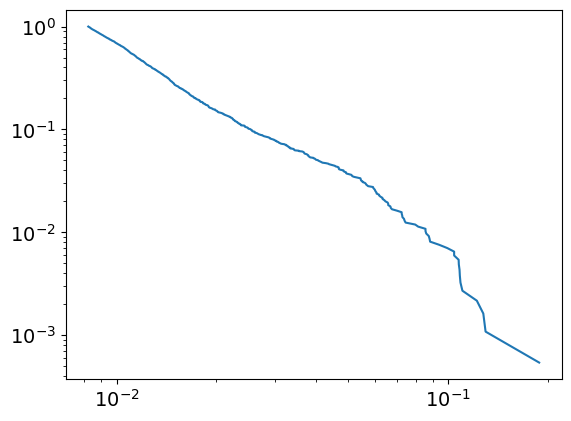

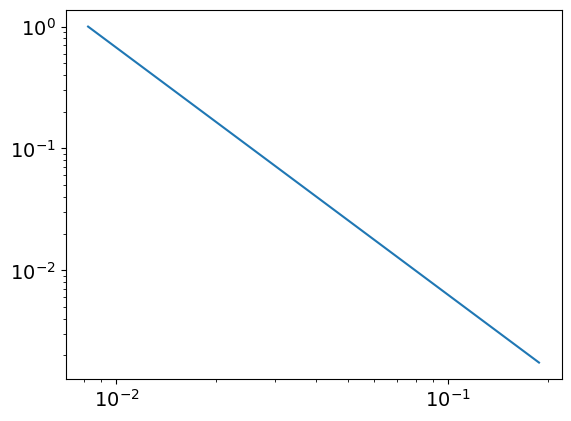

3.0289713433903107
0.008216711812917834
powerlaw KstestResult(statistic=0.998758929628661, pvalue=0.0, statistic_location=0.08821067917846072, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18804093828722168, statistic_sign=1)
tensor(1.2616e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3541, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.6546, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
367
tensor(0.2344, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


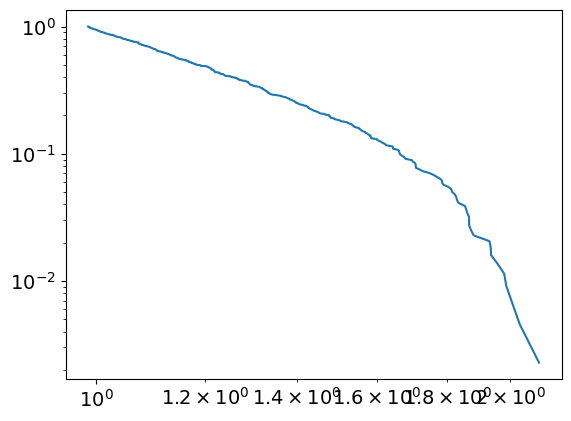

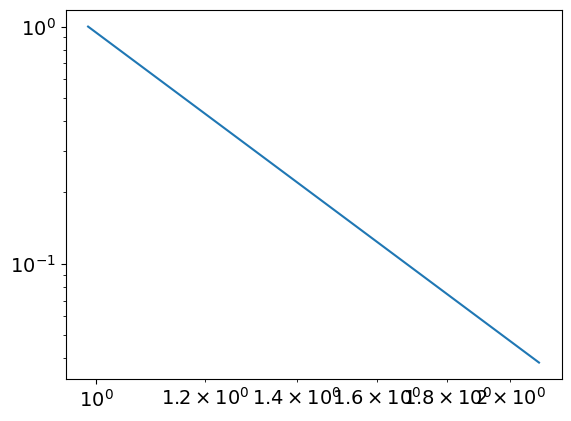

5.316072391764026
0.9860942289553947
powerlaw KstestResult(statistic=0.98001301631643, pvalue=0.0, statistic_location=1.3364245224394773, statistic_sign=1)
lognorm KstestResult(statistic=0.9787651473250681, pvalue=0.0, statistic_location=1.2399877931350027, statistic_sign=1)
tensor(0.0730, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2176, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5006, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7304, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
368
tensor(5.5846e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


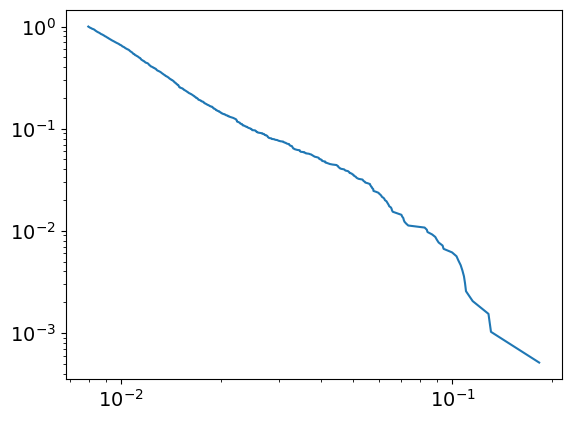

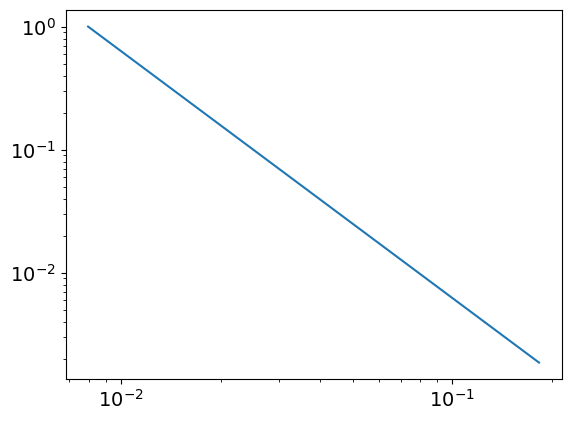

3.006849915820334
0.00796477930580971
powerlaw KstestResult(statistic=0.9986219140492125, pvalue=0.0, statistic_location=0.09338114807540762, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1826440704225832, statistic_sign=1)
tensor(2.7724e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3820, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.9093, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
368
tensor(0.2348, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


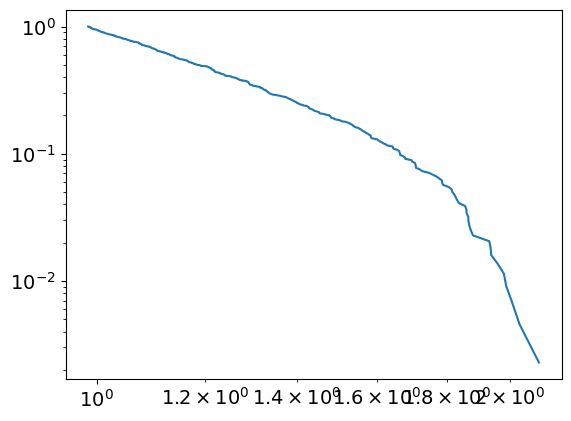

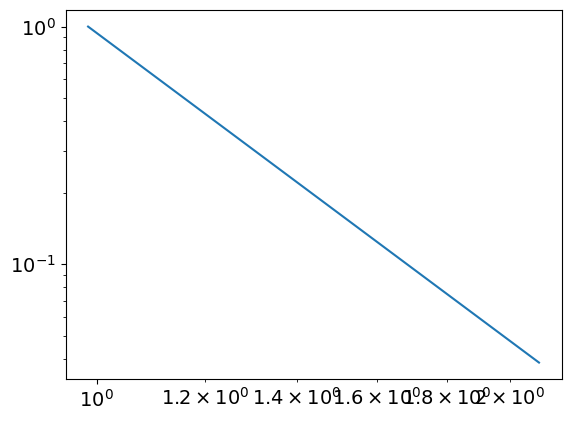

5.303121209788035
0.9857373777659636
powerlaw KstestResult(statistic=0.9798251360023889, pvalue=0.0, statistic_location=1.3362141390185494, statistic_sign=1)
lognorm KstestResult(statistic=0.9787338773920234, pvalue=0.0, statistic_location=1.241275307568192, statistic_sign=1)
tensor(0.0731, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2177, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5025, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7347, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
369
tensor(6.7152e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


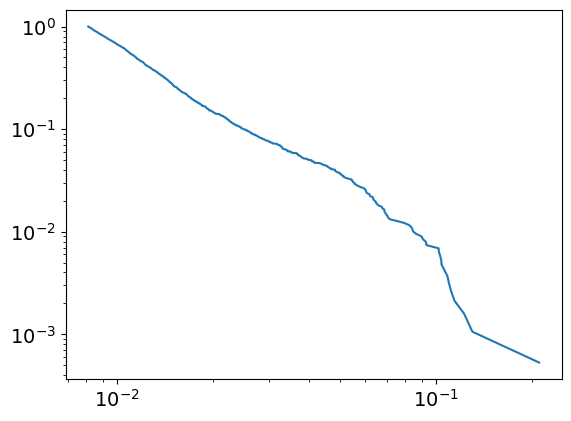

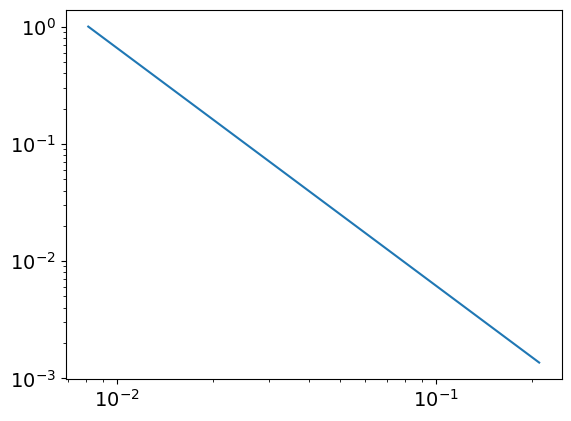

3.0263769132259335
0.0081090795575334
powerlaw KstestResult(statistic=0.9986611195863969, pvalue=0.0, statistic_location=0.1039934369474318, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21033097643543638, statistic_sign=1)
tensor(1.3581e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6015, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.6613, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
369
tensor(0.2351, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


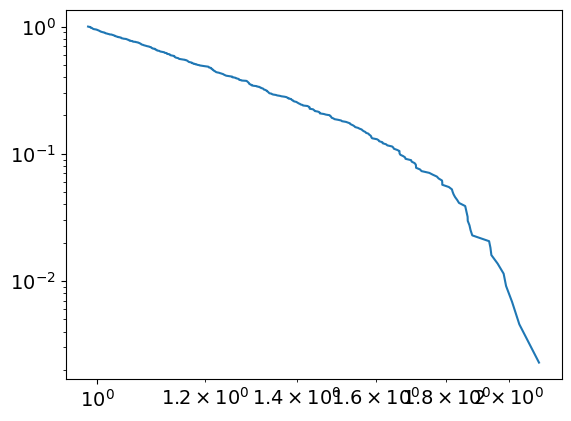

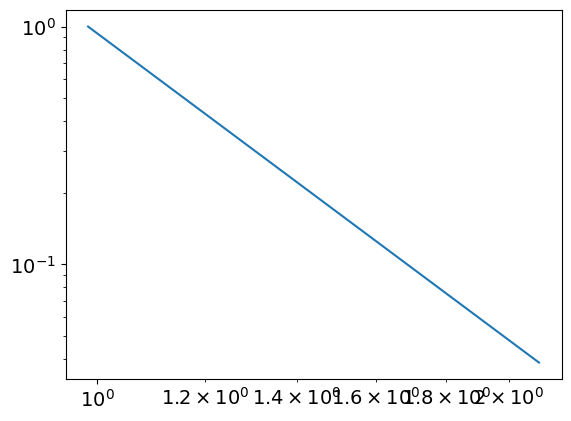

5.2896729186798535
0.9852732892711326
powerlaw KstestResult(statistic=0.9797146699735563, pvalue=0.0, statistic_location=1.3366922025584842, statistic_sign=1)
lognorm KstestResult(statistic=0.9787035173955012, pvalue=0.0, statistic_location=1.2470824423037923, statistic_sign=1)
tensor(0.0732, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2177, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5045, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7389, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
370
tensor(6.2339e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


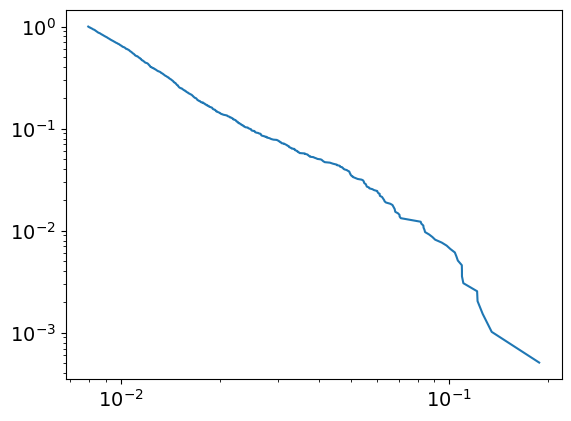

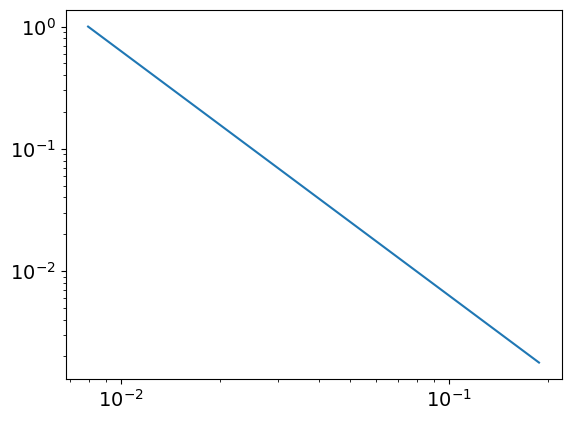

3.000929495641642
0.007935869301814022
powerlaw KstestResult(statistic=0.9985797943739205, pvalue=0.0, statistic_location=0.10924411284220564, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1346006333870818, statistic_sign=-1)
tensor(-4.0965e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3301, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.3423, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
370
tensor(0.2355, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


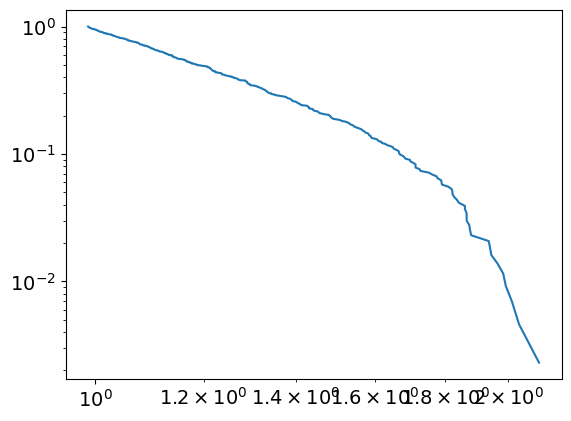

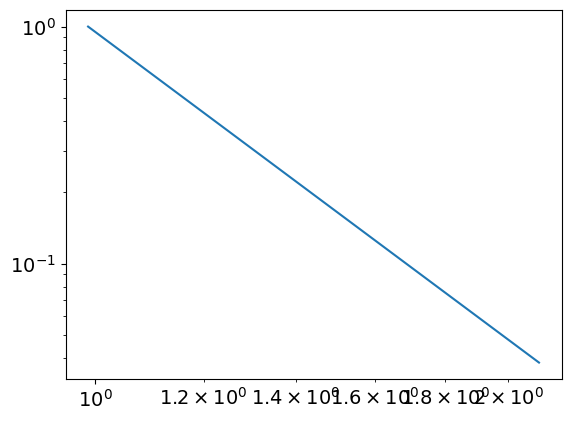

5.315813105522421
0.9885326430570982
powerlaw KstestResult(statistic=0.9799097221844739, pvalue=0.0, statistic_location=1.338421914644444, statistic_sign=1)
lognorm KstestResult(statistic=0.978670959424904, pvalue=0.0, statistic_location=1.2479308882107245, statistic_sign=1)
tensor(0.0732, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2178, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5066, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7433, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
371
tensor(5.4754e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


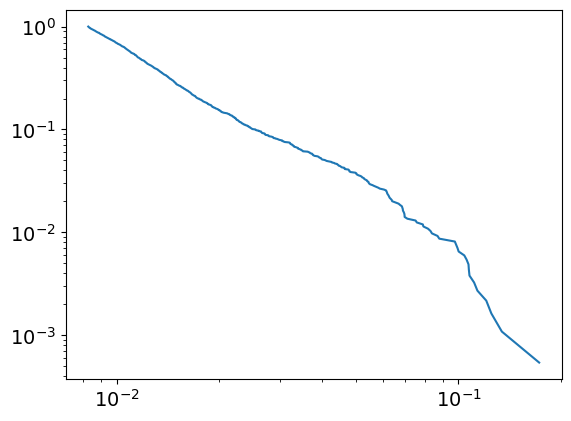

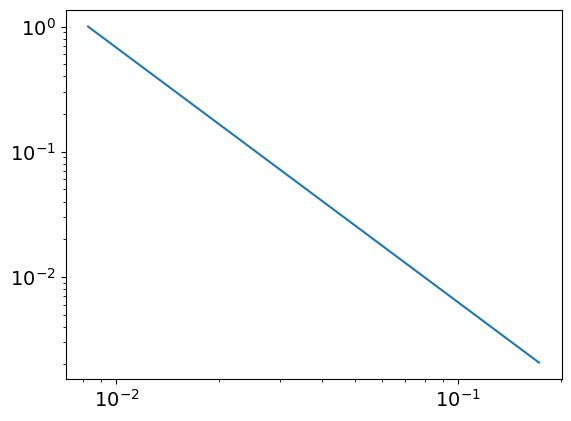

3.0360110594477074
0.008265584949604958
powerlaw KstestResult(statistic=0.9986154414098521, pvalue=0.0, statistic_location=0.11109885094833448, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13395224174212067, statistic_sign=-1)
tensor(-1.3551e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3773, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.9786, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
371
tensor(0.2359, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


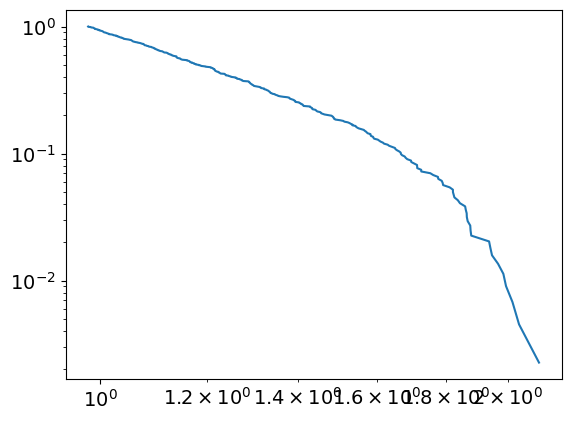

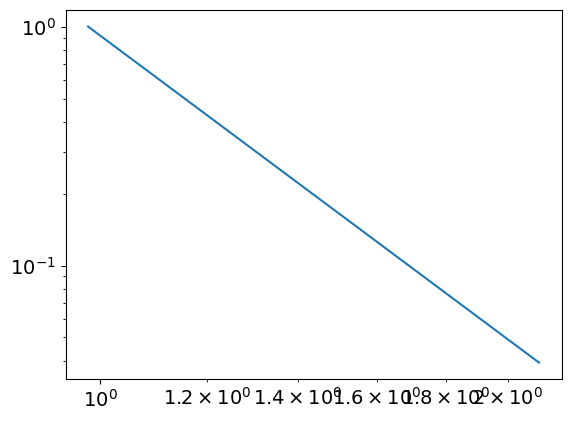

5.226092625481214
0.9797758284631517
powerlaw KstestResult(statistic=0.978954699145704, pvalue=0.0, statistic_location=1.2987539940996058, statistic_sign=1)
lognorm KstestResult(statistic=0.9786369205026416, pvalue=0.0, statistic_location=1.2487666755562914, statistic_sign=1)
tensor(0.0733, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2178, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5086, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7475, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
372
tensor(5.3028e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


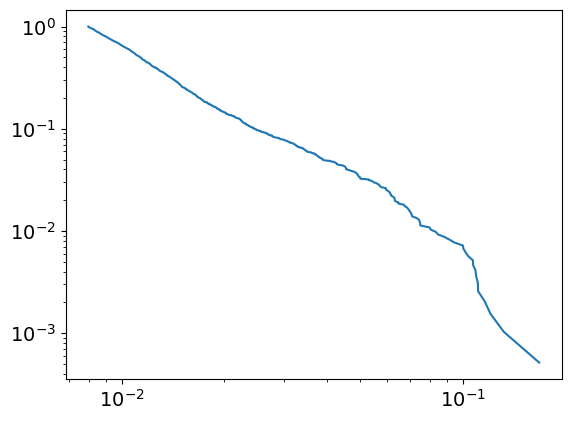

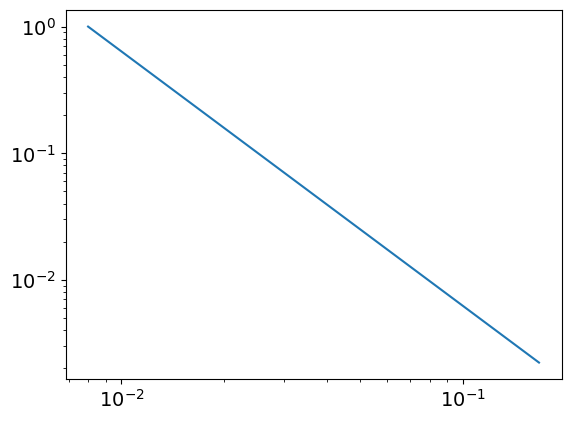

3.0091912924043025
0.00798582910504926
powerlaw KstestResult(statistic=0.9985583386215673, pvalue=0.0, statistic_location=0.11062871297638388, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1672948067321389, statistic_sign=1)
tensor(9.9689e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3919, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.7915, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
372
tensor(0.2363, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


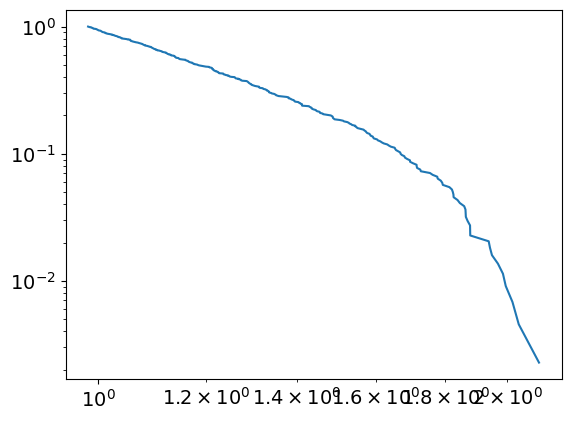

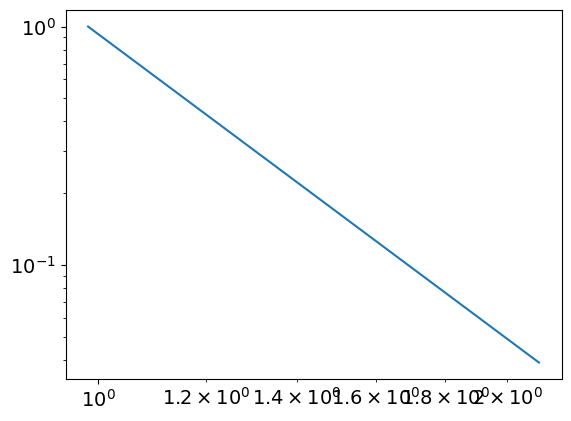

5.247106573164598
0.9828353755666822
powerlaw KstestResult(statistic=0.9790868017981226, pvalue=0.0, statistic_location=1.3352995764245483, statistic_sign=1)
lognorm KstestResult(statistic=0.9785992963370188, pvalue=0.0, statistic_location=1.2496511198555627, statistic_sign=1)
tensor(0.0734, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2179, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5106, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7519, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
373
tensor(5.7770e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


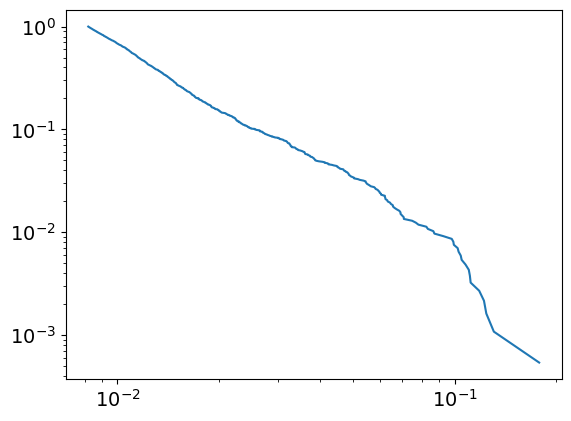

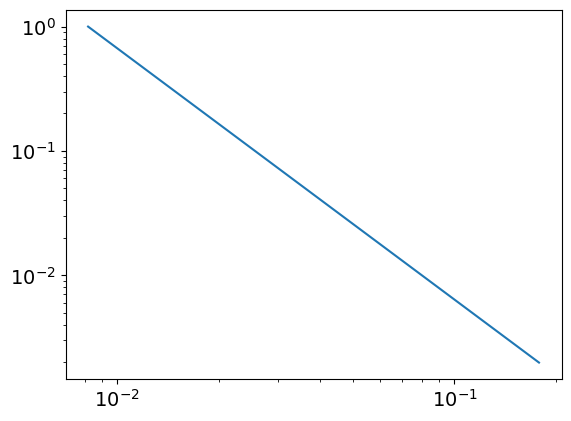

3.020946906033826
0.008189577536185525
powerlaw KstestResult(statistic=0.998606960338975, pvalue=0.0, statistic_location=0.11014712369954606, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13071417407771238, statistic_sign=-1)
tensor(-9.3873e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2964, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.6636, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
373
tensor(0.2366, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


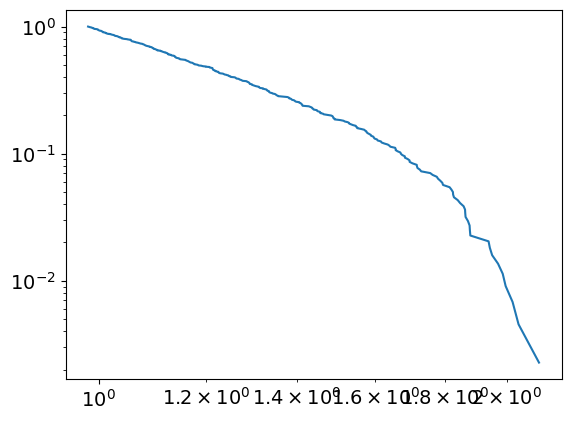

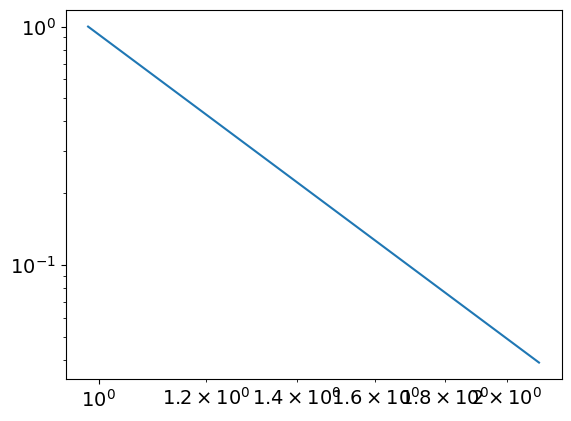

5.233897309846606
0.9818605673408862
powerlaw KstestResult(statistic=0.9789196596457413, pvalue=0.0, statistic_location=1.305177937577524, statistic_sign=1)
lognorm KstestResult(statistic=0.9785608544182836, pvalue=0.0, statistic_location=1.2504918926209472, statistic_sign=1)
tensor(0.0735, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2179, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5126, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7563, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
374
tensor(5.6561e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


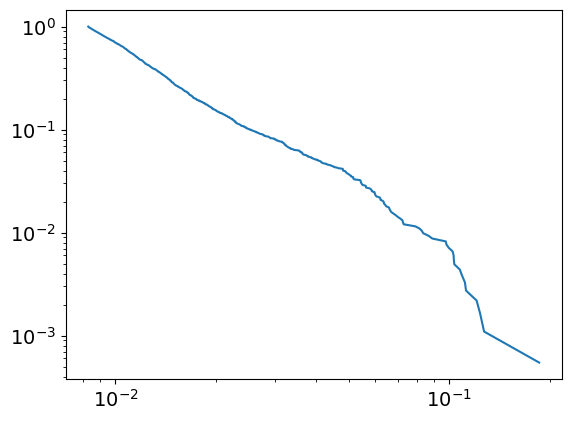

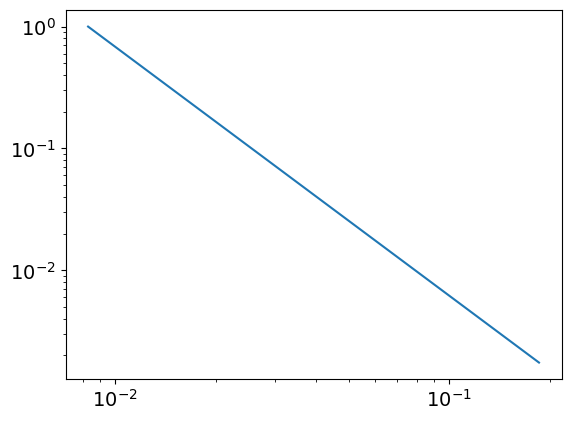

3.0422028621999533
0.00829519198837739
powerlaw KstestResult(statistic=0.998707988413024, pvalue=0.0, statistic_location=0.10351633776231968, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1271086045779227, statistic_sign=-1)
tensor(-5.8654e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3846, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.1066, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
374
tensor(0.2370, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


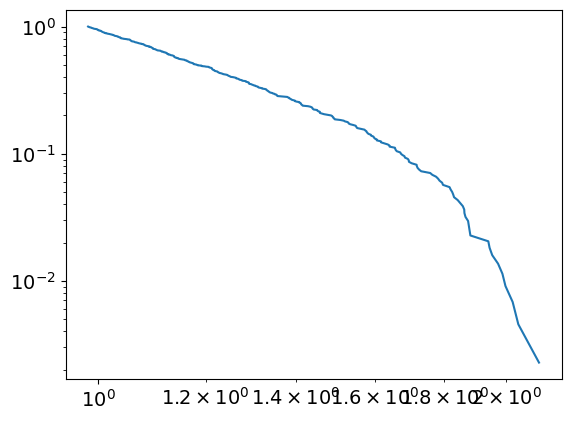

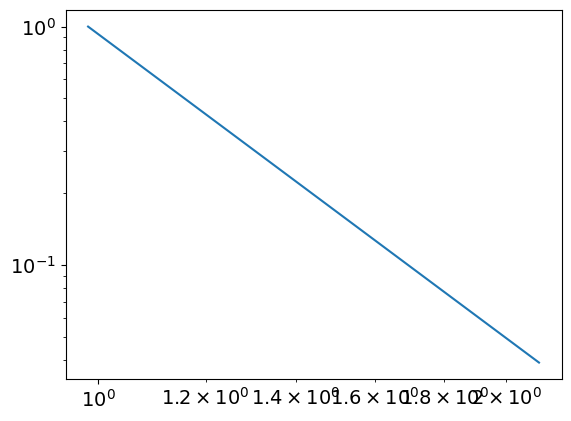

5.237616073235573
0.9828603409073793
powerlaw KstestResult(statistic=0.9789335501150445, pvalue=0.0, statistic_location=1.3061200483848996, statistic_sign=1)
lognorm KstestResult(statistic=0.9784829099443022, pvalue=0.0, statistic_location=1.2522349870752474, statistic_sign=1)
tensor(0.0736, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2180, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5147, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7606, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
375
tensor(4.7746e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


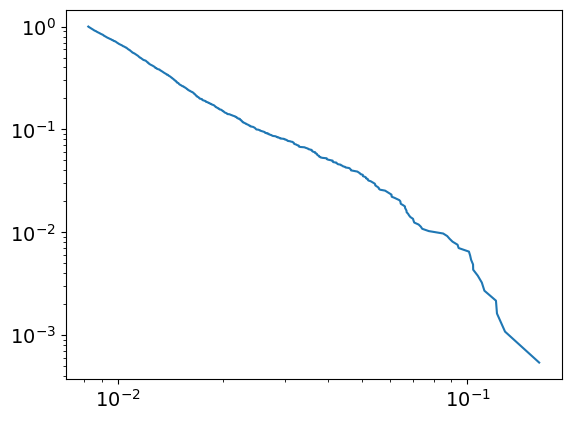

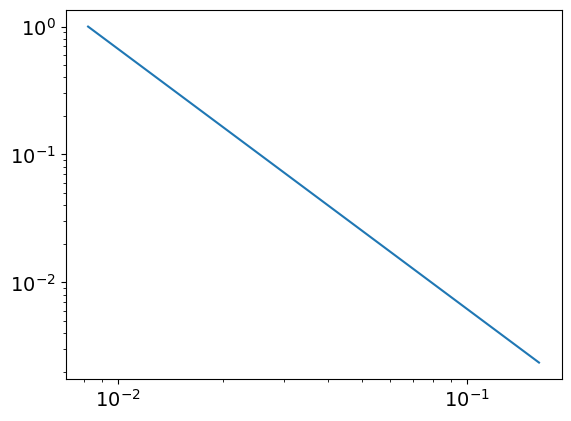

3.037326818796633
0.00823092119394893
powerlaw KstestResult(statistic=0.9987198795074729, pvalue=0.0, statistic_location=0.07422709018977354, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1603097628144791, statistic_sign=1)
tensor(8.6645e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2873, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.1134, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
375
tensor(0.2373, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


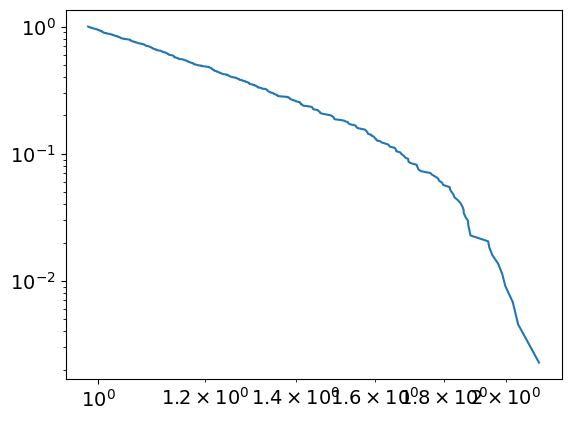

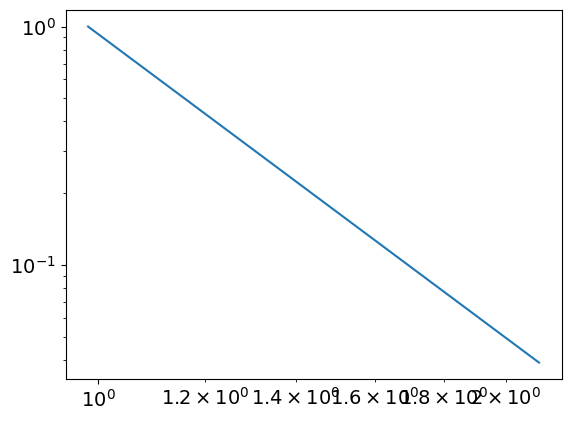

5.229059338413086
0.9826889641976886
powerlaw KstestResult(statistic=0.9788921732991135, pvalue=0.0, statistic_location=1.3118472736509164, statistic_sign=1)
lognorm KstestResult(statistic=0.9783900054759315, pvalue=0.0, statistic_location=1.2541016079682559, statistic_sign=1)
tensor(0.0737, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2180, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5167, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7651, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
376
tensor(4.7387e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


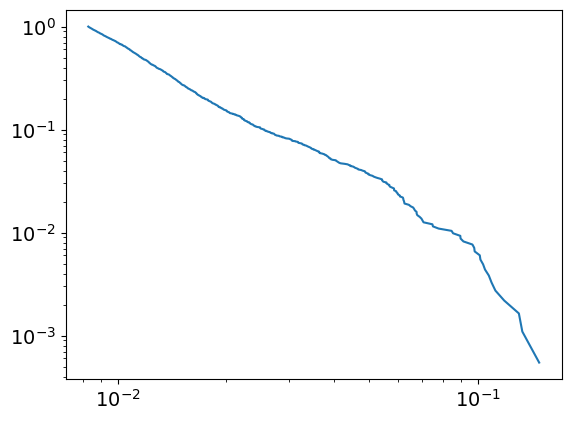

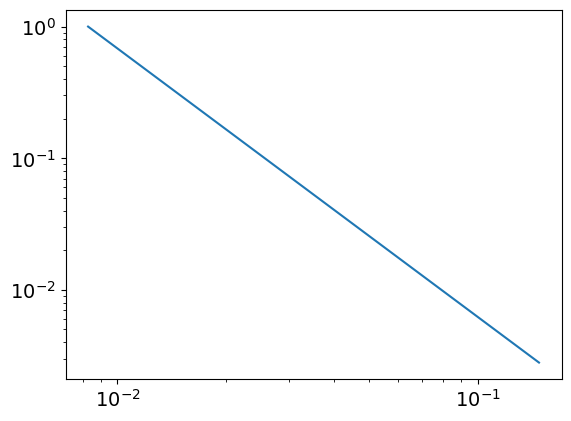

3.038909524348911
0.008288323171934156
powerlaw KstestResult(statistic=0.9987042323718878, pvalue=0.0, statistic_location=0.09802932813381862, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14804955827042862, statistic_sign=1)
tensor(1.1693e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2066, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.5354, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
376
tensor(0.2378, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


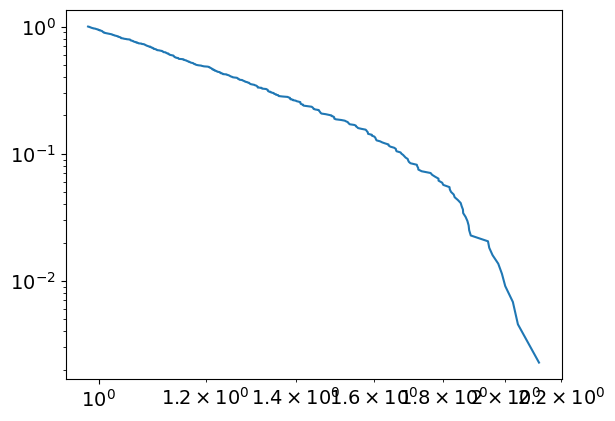

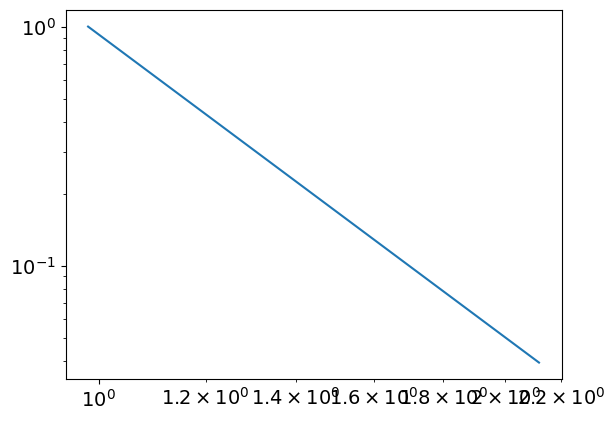

5.2078540404178
0.9818435700257427
powerlaw KstestResult(statistic=0.9787986705260834, pvalue=0.0, statistic_location=1.3114555332677167, statistic_sign=1)
lognorm KstestResult(statistic=0.9783008222112679, pvalue=0.0, statistic_location=1.2531134733877853, statistic_sign=1)
tensor(0.0737, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2181, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5188, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7695, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
377
tensor(5.2259e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


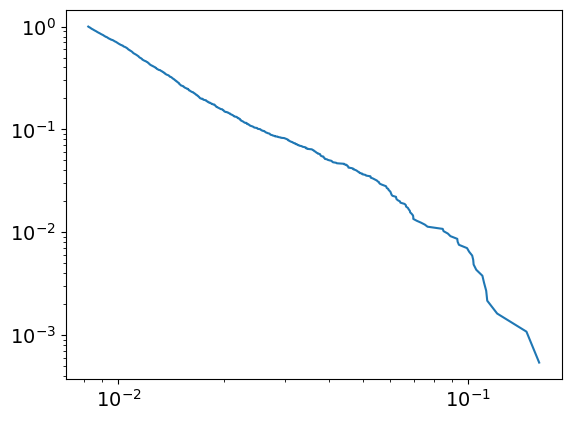

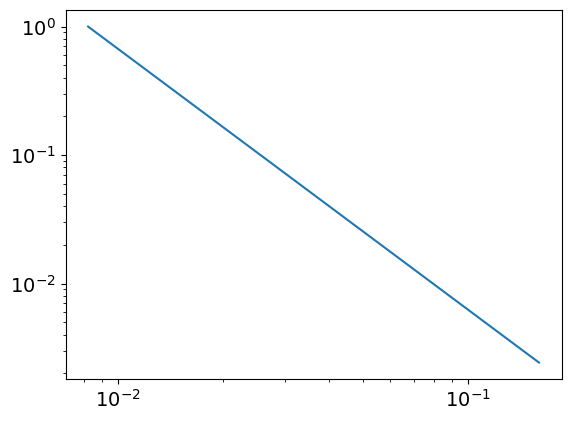

3.0278946111489664
0.00820223679735711
powerlaw KstestResult(statistic=0.9986786907114092, pvalue=0.0, statistic_location=0.1035222623715686, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15984323539181058, statistic_sign=1)
tensor(5.9536e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2791, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5439, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
377
tensor(0.2381, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


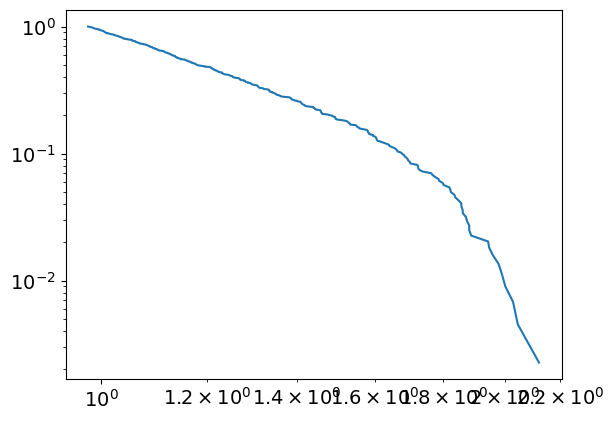

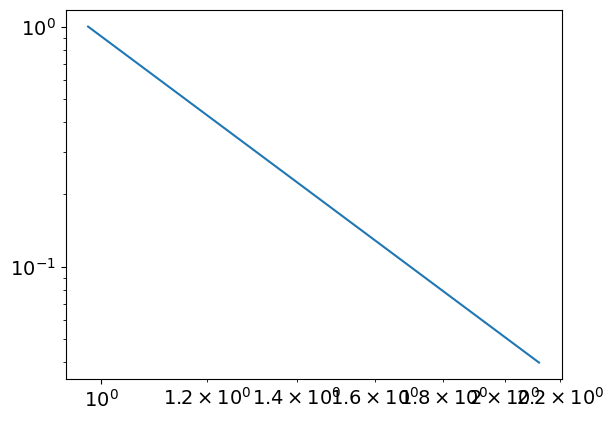

5.16366086182652
0.9780635401954625
powerlaw KstestResult(statistic=0.9783794358554788, pvalue=0.0, statistic_location=1.3127062033403392, statistic_sign=1)
lognorm KstestResult(statistic=0.9782518080256879, pvalue=0.0, statistic_location=1.253979848025254, statistic_sign=1)
tensor(0.0738, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2182, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5208, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7739, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
378
tensor(5.7557e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


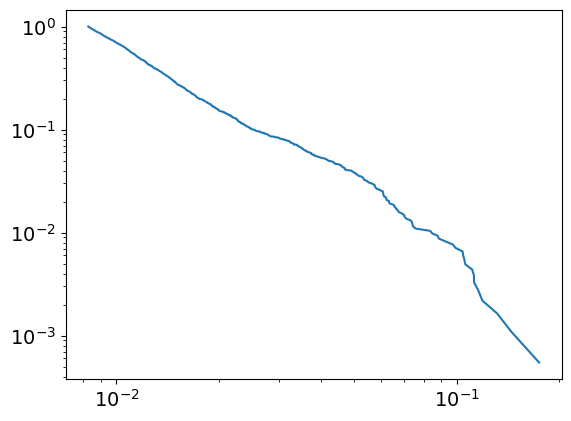

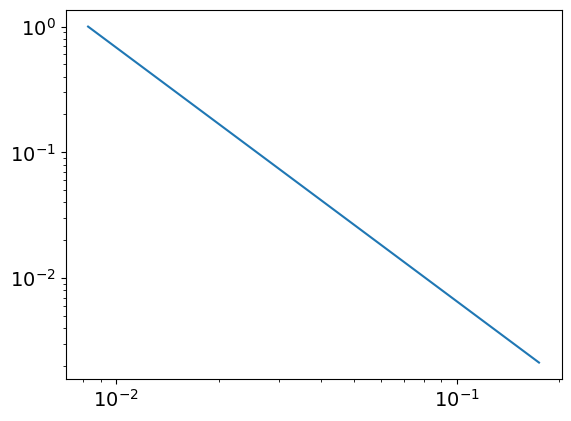

3.016741463193536
0.008265572718258197
powerlaw KstestResult(statistic=0.9986118589176685, pvalue=0.0, statistic_location=0.08850701715289415, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.174596824384111, statistic_sign=1)
tensor(1.1829e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5517, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.2814, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
378
tensor(0.2385, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


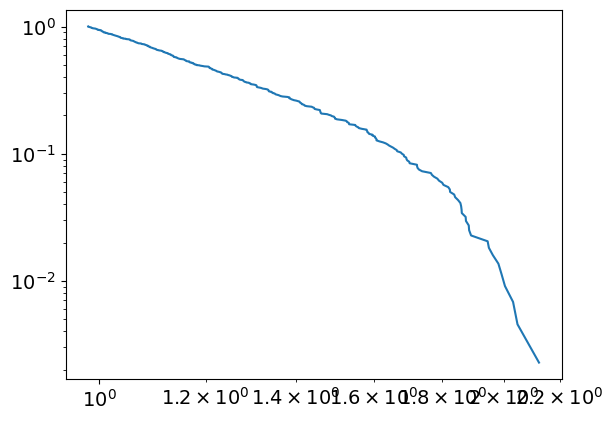

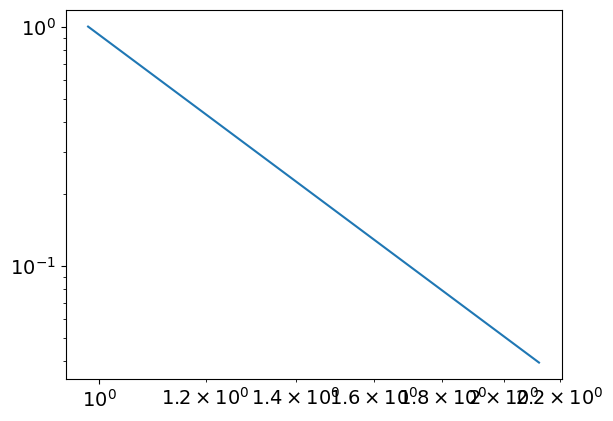

5.188266518854102
0.9812794000073424
powerlaw KstestResult(statistic=0.9786231618438614, pvalue=0.0, statistic_location=1.3104892462131759, statistic_sign=1)
lognorm KstestResult(statistic=0.9781777003207079, pvalue=0.0, statistic_location=1.2596336653892808, statistic_sign=1)
tensor(0.0739, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2182, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5229, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7784, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
379
tensor(5.7768e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


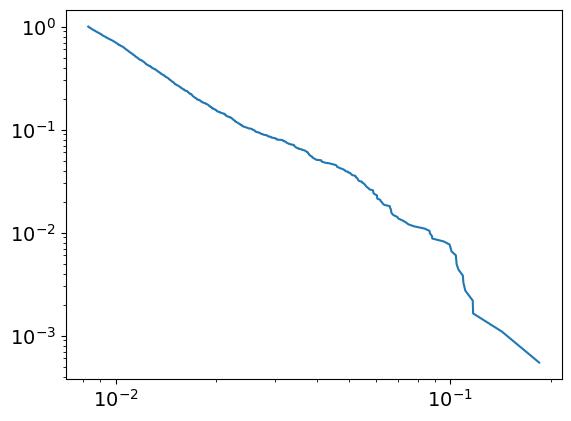

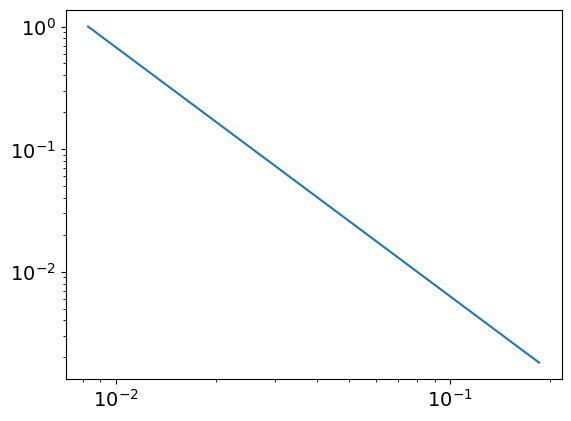

3.032222355247662
0.008276026222027751
powerlaw KstestResult(statistic=0.9986584511783672, pvalue=0.0, statistic_location=0.10469692678401692, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11725884812698432, statistic_sign=-1)
tensor(-1.9276e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5187, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.1384, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
379
tensor(0.2389, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


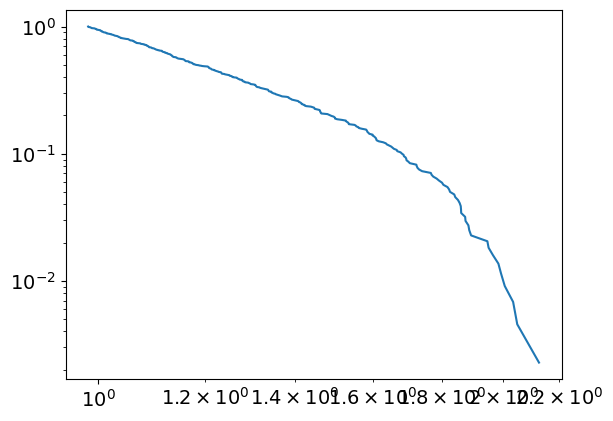

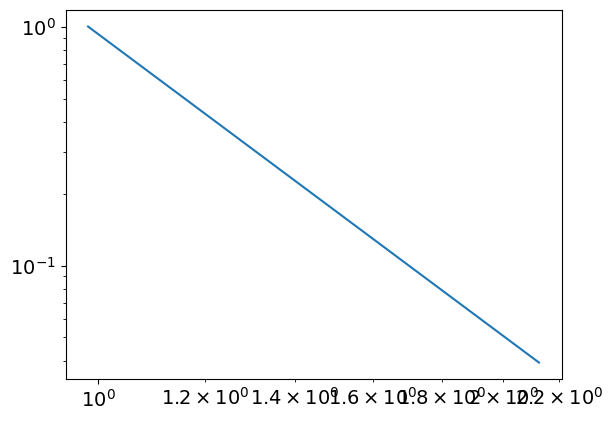

5.194608477739006
0.9824637980299405
powerlaw KstestResult(statistic=0.9786177237050783, pvalue=0.0, statistic_location=1.3122304431672278, statistic_sign=1)
lognorm KstestResult(statistic=0.9781481990583373, pvalue=0.0, statistic_location=1.2579030851612738, statistic_sign=1)
tensor(0.0740, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2182, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5250, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7828, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
380
tensor(5.2044e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


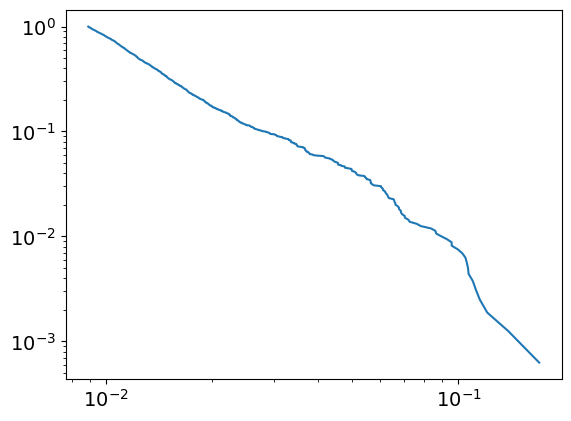

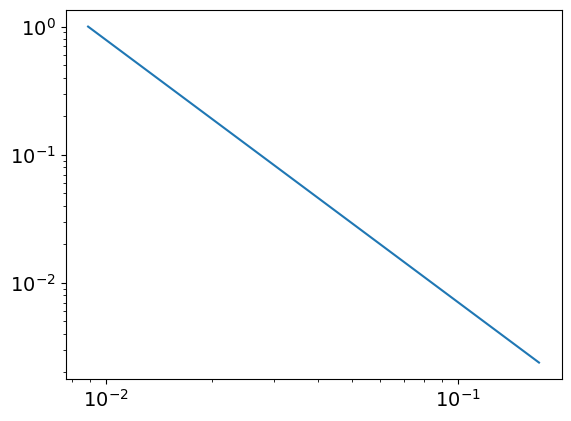

3.049049190848905
0.008893230900942666
powerlaw KstestResult(statistic=0.9986961633615206, pvalue=0.0, statistic_location=0.08641628794416713, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12069919697410354, statistic_sign=-1)
tensor(-1.3395e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3240, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.0589, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
380
tensor(0.2392, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


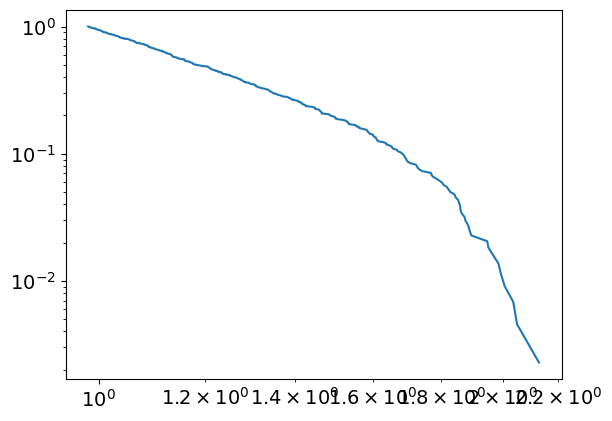

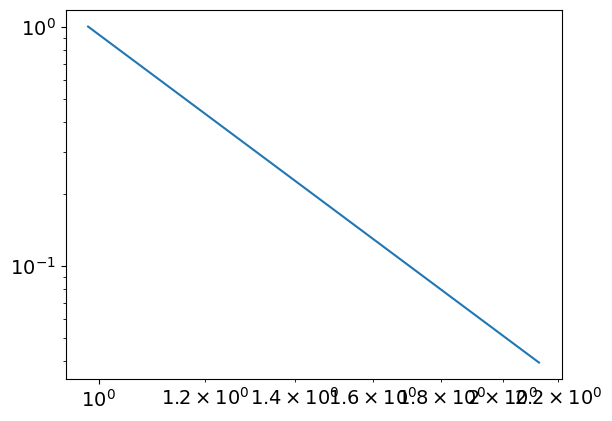

5.177511101019306
0.9817898925277867
powerlaw KstestResult(statistic=0.9784238341452545, pvalue=0.0, statistic_location=1.3116790528792996, statistic_sign=1)
lognorm KstestResult(statistic=0.9779870456749844, pvalue=0.0, statistic_location=1.2602465388583917, statistic_sign=1)
tensor(0.0741, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2183, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5270, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7871, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
381
tensor(5.6854e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


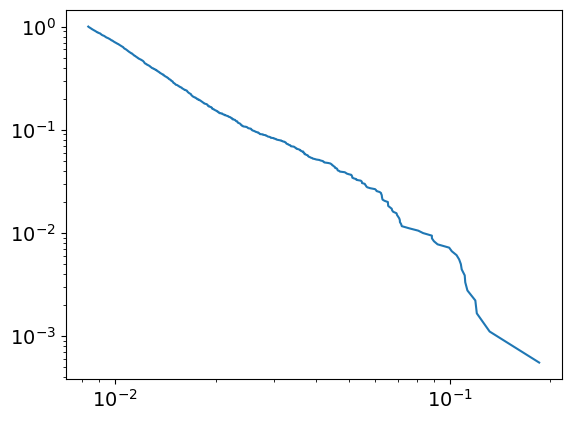

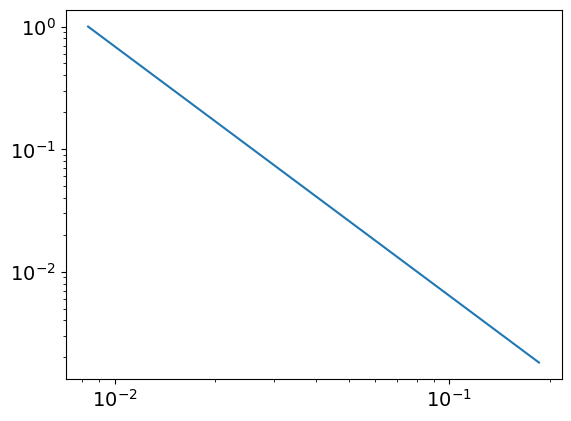

3.0349551778308967
0.008330674421363312
powerlaw KstestResult(statistic=0.9986173050029233, pvalue=0.0, statistic_location=0.07202886581854134, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12066013908465974, statistic_sign=-1)
tensor(-7.9011e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5125, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.9430, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
381
tensor(0.2397, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


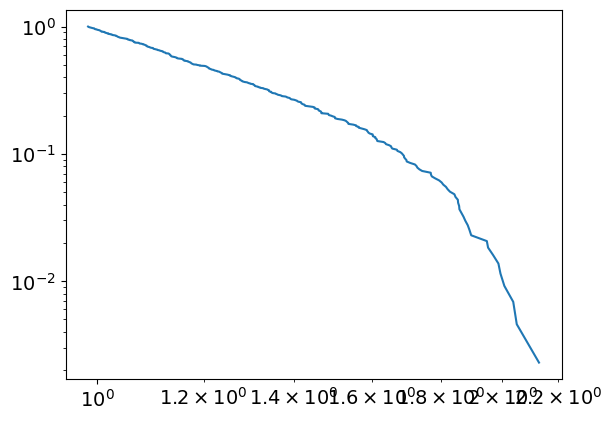

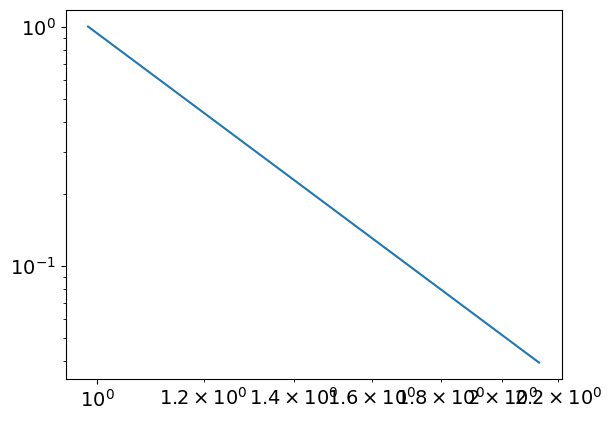

5.193424978077613
0.9846327881855391
powerlaw KstestResult(statistic=0.978586629521108, pvalue=0.0, statistic_location=1.317457450829831, statistic_sign=1)
lognorm KstestResult(statistic=0.9779031600113288, pvalue=0.0, statistic_location=1.2574049006741344, statistic_sign=1)
tensor(0.0742, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2184, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5291, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7915, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
382
tensor(5.9154e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


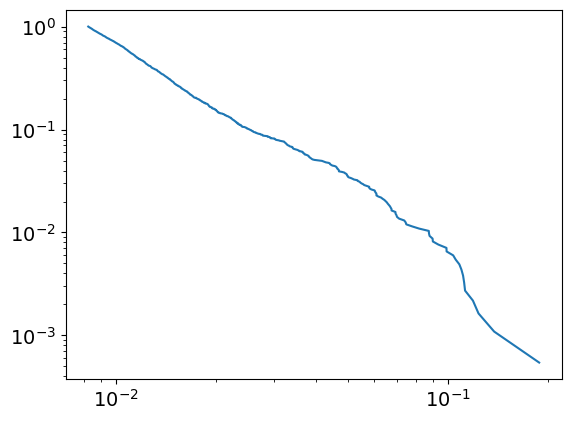

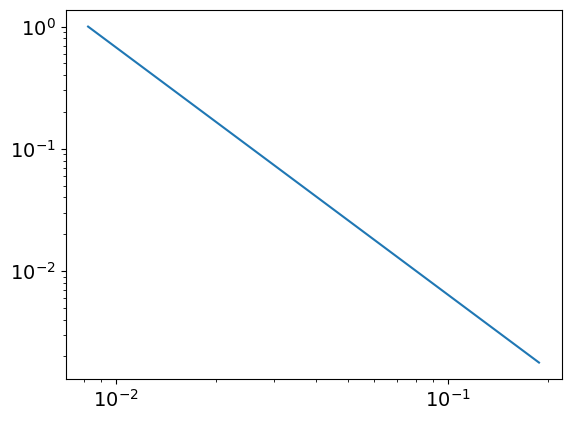

3.0261432949772167
0.00825777434433071
powerlaw KstestResult(statistic=0.9987243081192569, pvalue=0.0, statistic_location=0.08993729203425968, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12339928746750639, statistic_sign=-1)
tensor(-1.8255e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2572, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.8997, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
382
tensor(0.2400, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


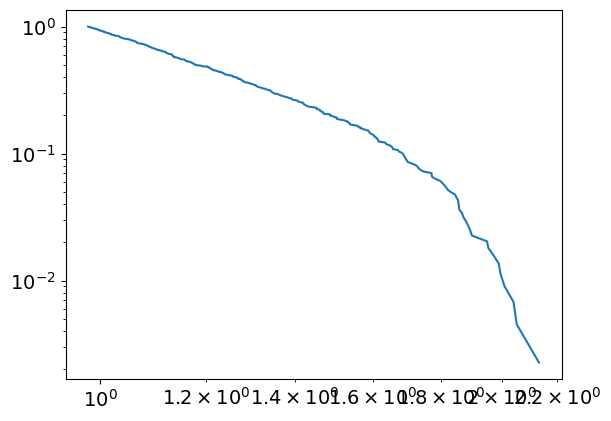

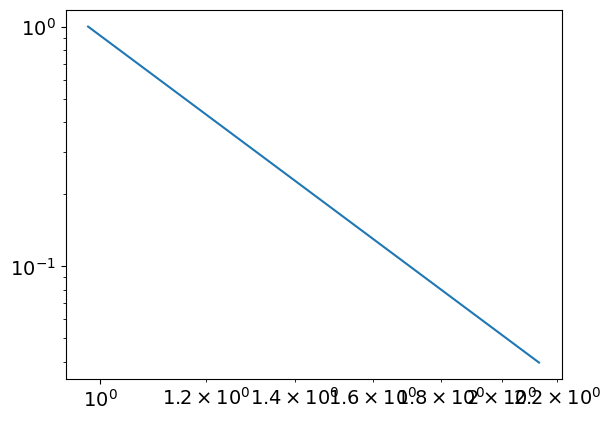

5.145602291817317
0.9789407167521335
powerlaw KstestResult(statistic=0.9781779177303824, pvalue=0.0, statistic_location=1.2828358473465327, statistic_sign=1)
lognorm KstestResult(statistic=0.9778429428355664, pvalue=0.0, statistic_location=1.2582139860192494, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2184, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5312, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.7960, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
383
tensor(5.9446e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


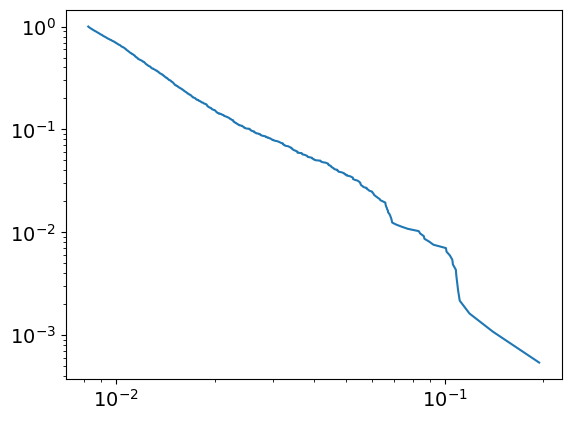

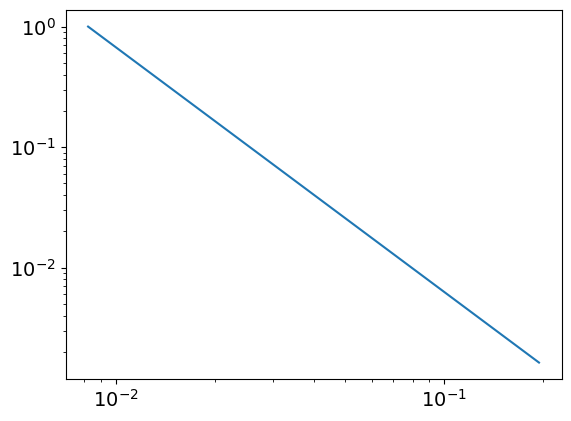

3.0304833858376887
0.008227356987486898
powerlaw KstestResult(statistic=0.9987493959898107, pvalue=0.0, statistic_location=0.07125972404289659, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11913251400549162, statistic_sign=-1)
tensor(-2.3312e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3620, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.4879, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
383
tensor(0.2404, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


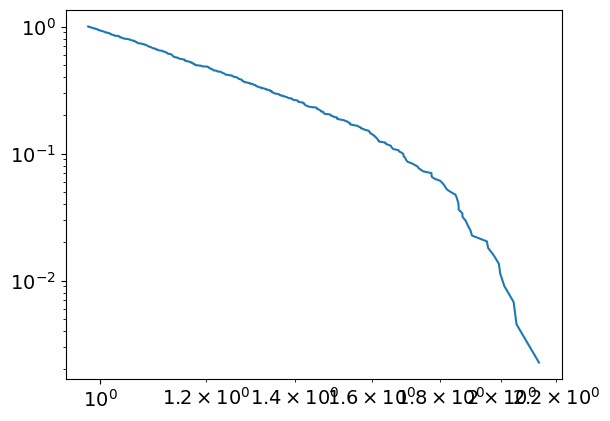

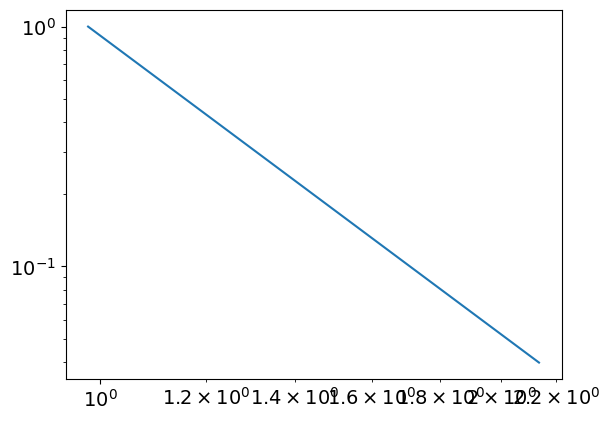

5.137971776040768
0.9787987086681437
powerlaw KstestResult(statistic=0.9781179075095107, pvalue=0.0, statistic_location=1.2837648960068804, statistic_sign=1)
lognorm KstestResult(statistic=0.9777757237085613, pvalue=0.0, statistic_location=1.2590848660564071, statistic_sign=1)
tensor(0.0743, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2185, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5333, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8004, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
384
tensor(5.2619e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


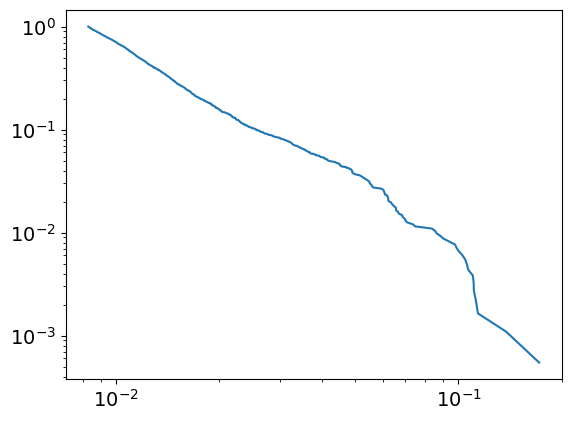

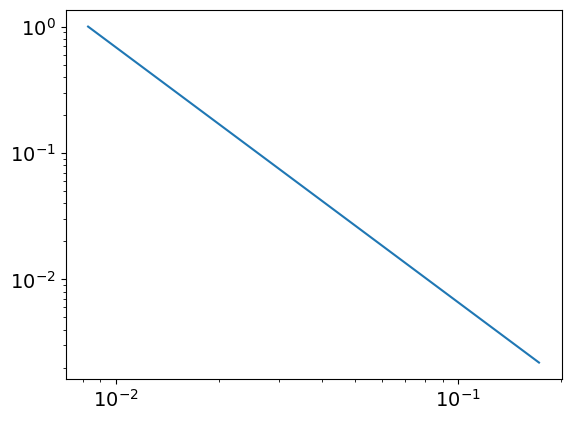

3.0184016609896576
0.008285847001690258
powerlaw KstestResult(statistic=0.9987146791493683, pvalue=0.0, statistic_location=0.07359435481692103, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11090000127488298, statistic_sign=-1)
tensor(-2.9932e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1489, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.8150, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
384
tensor(0.2408, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


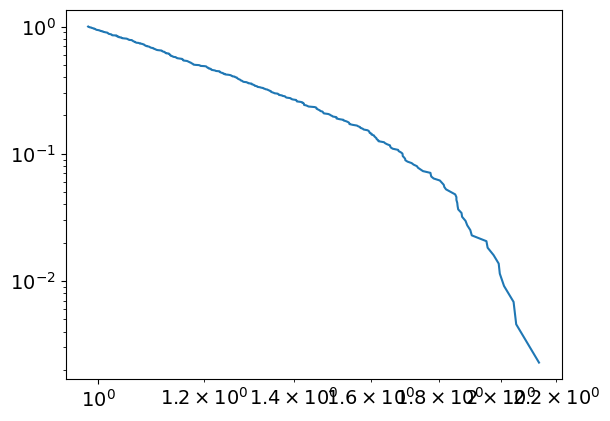

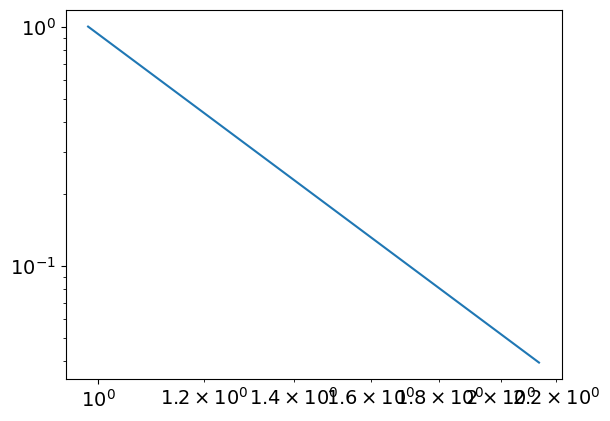

5.162716650752608
0.9826470013252423
powerlaw KstestResult(statistic=0.9783296244723537, pvalue=0.0, statistic_location=1.3157736539675007, statistic_sign=1)
lognorm KstestResult(statistic=0.9777191960383852, pvalue=0.0, statistic_location=1.2432186311663067, statistic_sign=1)
tensor(0.0744, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2185, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5354, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8050, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
385
tensor(5.0079e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


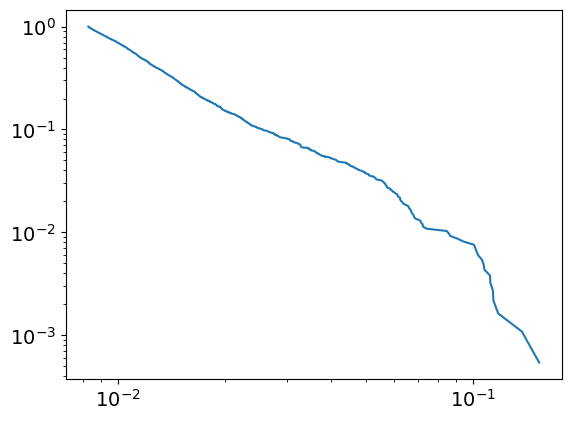

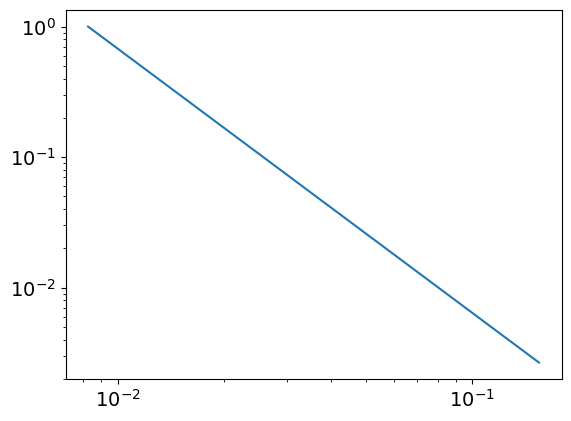

3.0257740711674255
0.008259997731905602
powerlaw KstestResult(statistic=0.9987334201900336, pvalue=0.0, statistic_location=0.07242911004583877, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11812223584750778, statistic_sign=-1)
tensor(-1.5657e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0050, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.2925, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
385
tensor(0.2411, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


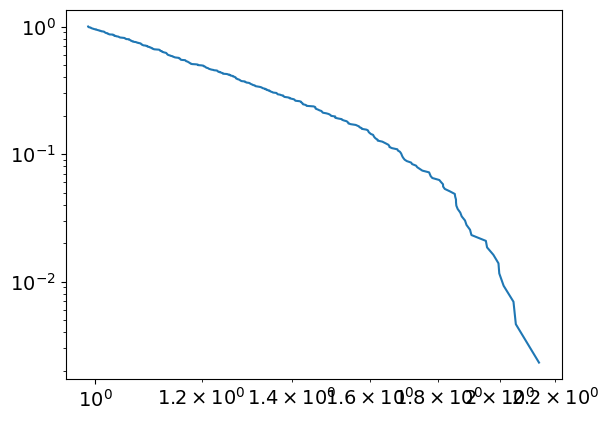

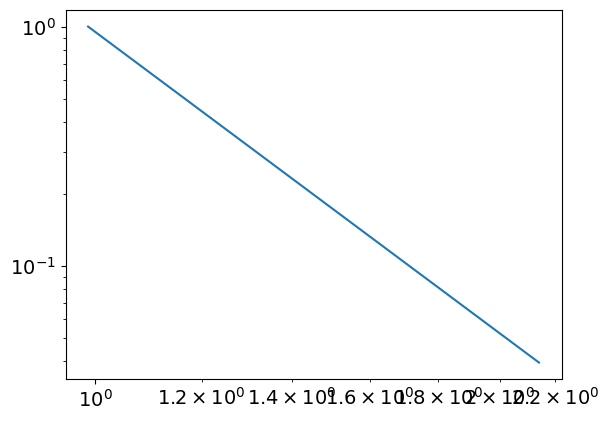

5.186624541829088
0.9880905427138857
powerlaw KstestResult(statistic=0.9786662141208841, pvalue=0.0, statistic_location=1.3163089649431796, statistic_sign=1)
lognorm KstestResult(statistic=0.9776601393760659, pvalue=0.0, statistic_location=1.2449765765078753, statistic_sign=1)
tensor(0.0745, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2186, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5375, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8094, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
386
tensor(4.8834e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


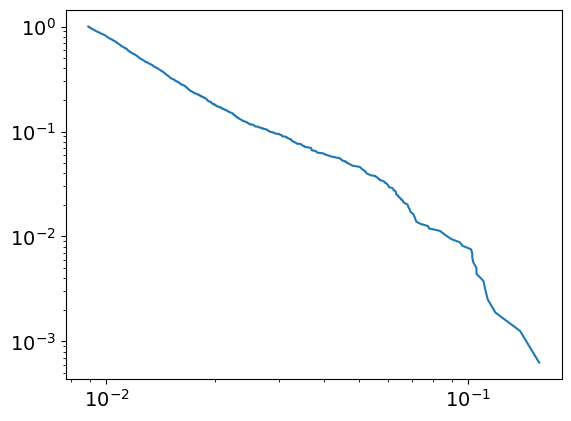

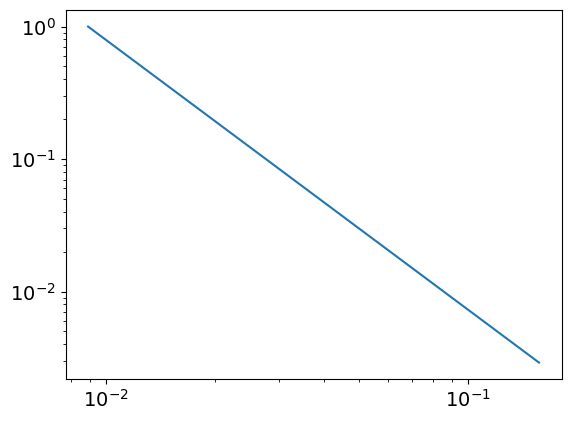

3.0358518724967585
0.008905638702022912
powerlaw KstestResult(statistic=0.9987330330898739, pvalue=0.0, statistic_location=0.07369594035908375, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11874108536844344, statistic_sign=-1)
tensor(-7.7400e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2052, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.4887, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
386
tensor(0.2415, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


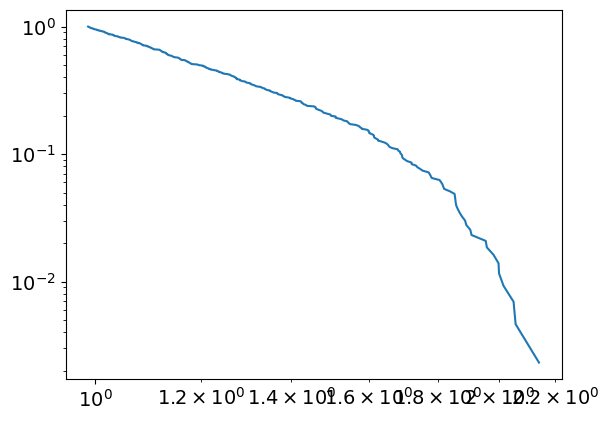

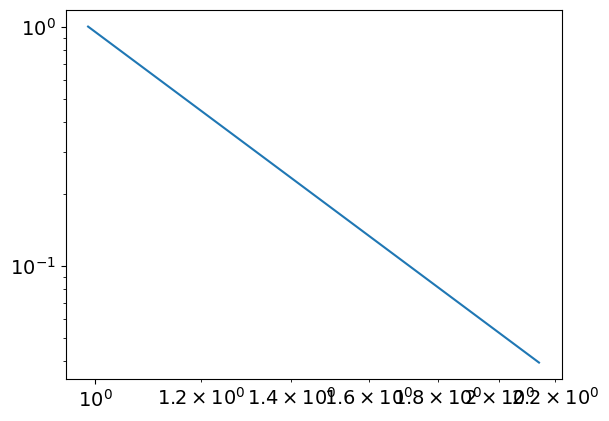

5.177413566362884
0.9878813341143322
powerlaw KstestResult(statistic=0.9785781334093562, pvalue=0.0, statistic_location=1.3172306830924985, statistic_sign=1)
lognorm KstestResult(statistic=0.9775922638359812, pvalue=0.0, statistic_location=1.246796690419933, statistic_sign=1)
tensor(0.0746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2186, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5396, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8139, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
387
tensor(5.4644e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


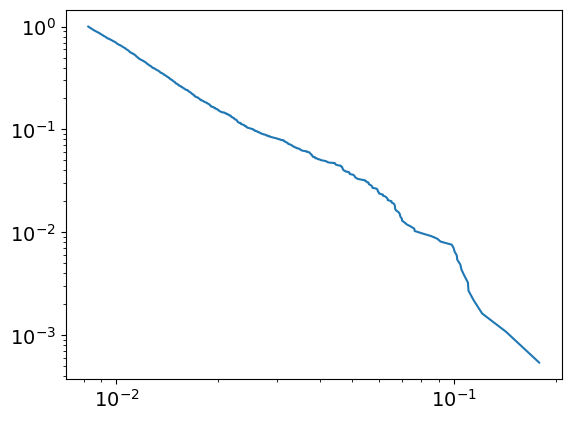

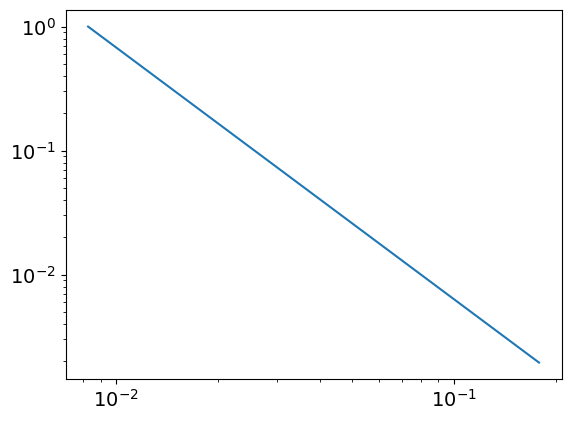

3.028674110213621
0.008254404860571512
powerlaw KstestResult(statistic=0.9986854354848079, pvalue=0.0, statistic_location=0.07648890940949447, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1786874856061949, statistic_sign=1)
tensor(4.6809e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4655, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.3570, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
387
tensor(0.2419, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


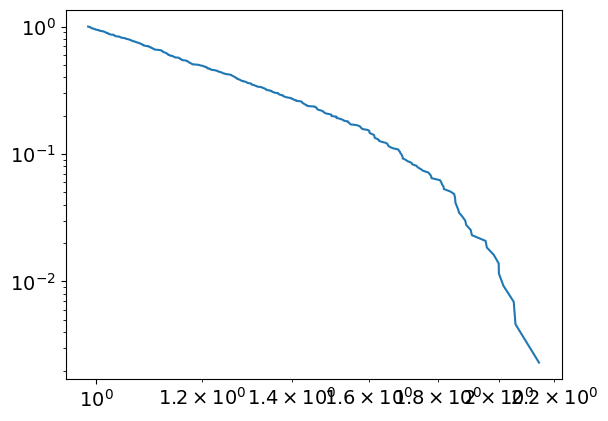

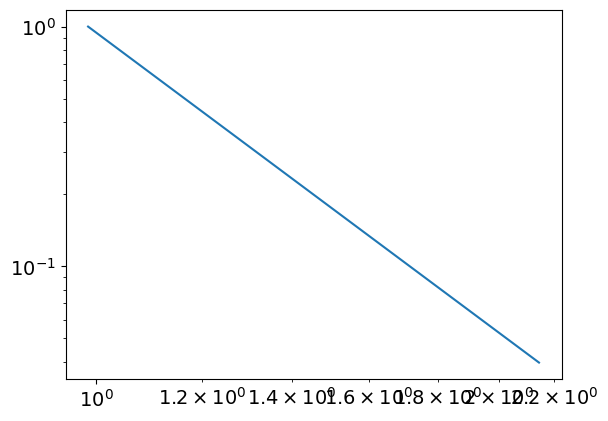

5.156109811775539
0.9858684137352215
powerlaw KstestResult(statistic=0.9784178034652966, pvalue=0.0, statistic_location=1.3063867789466357, statistic_sign=1)
lognorm KstestResult(statistic=0.9775168929804224, pvalue=0.0, statistic_location=1.2486150582537043, statistic_sign=1)
tensor(0.0747, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2187, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5417, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8183, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
388
tensor(5.5366e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


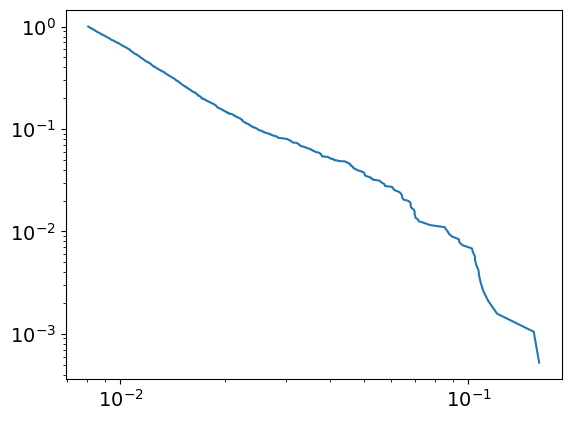

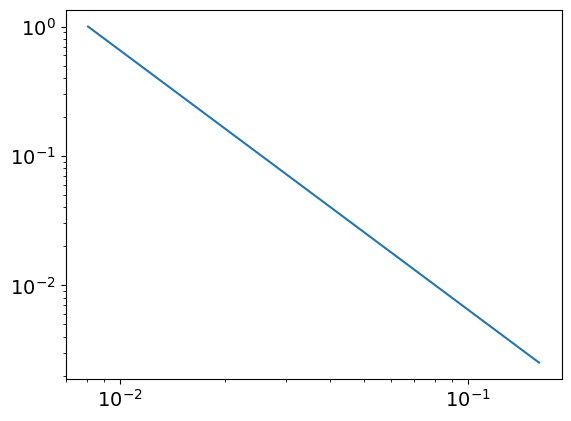

3.005581363276291
0.00808194931478395
powerlaw KstestResult(statistic=0.9986490373590053, pvalue=0.0, statistic_location=0.07756874251680562, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12088253725671781, statistic_sign=-1)
tensor(-9.5862e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2938, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.8868, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
388
tensor(0.2423, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


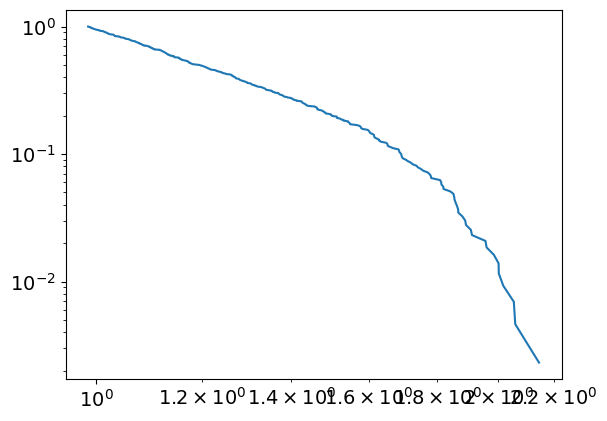

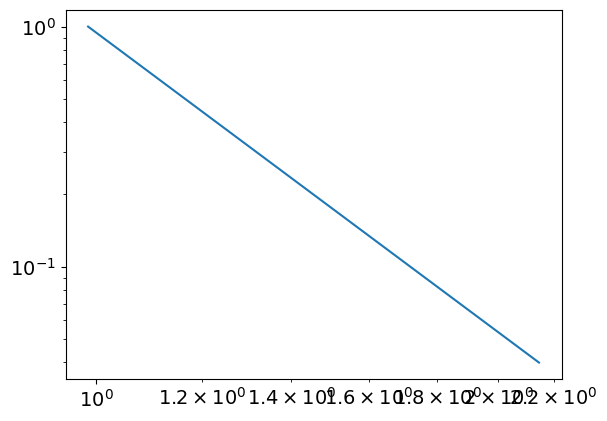

5.147832259953122
0.9862575854958257
powerlaw KstestResult(statistic=0.9783668444391593, pvalue=0.0, statistic_location=1.3073002877859963, statistic_sign=1)
lognorm KstestResult(statistic=0.9774343300507565, pvalue=0.0, statistic_location=1.2530880286704031, statistic_sign=1)
tensor(0.0748, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2187, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5438, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8229, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
389
tensor(5.9526e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


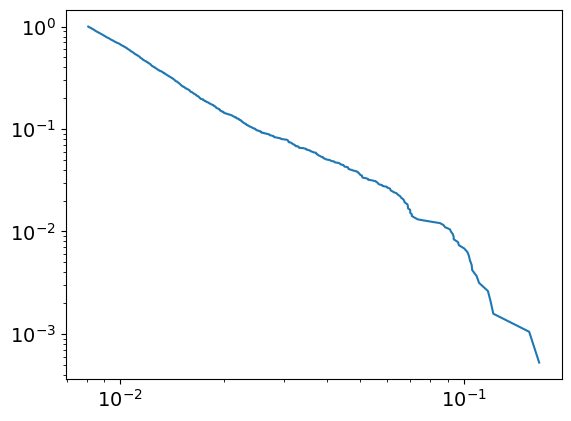

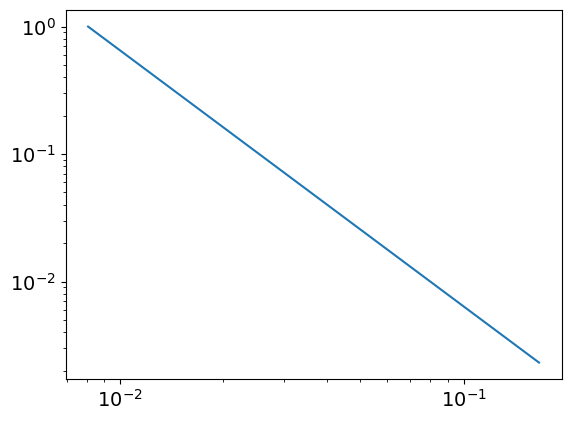

3.008560383671699
0.008077820108533484
powerlaw KstestResult(statistic=0.9986367741484037, pvalue=0.0, statistic_location=0.09291863134841044, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12193393685349062, statistic_sign=-1)
tensor(-2.7402e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2129, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.9447, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
389
tensor(0.2426, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


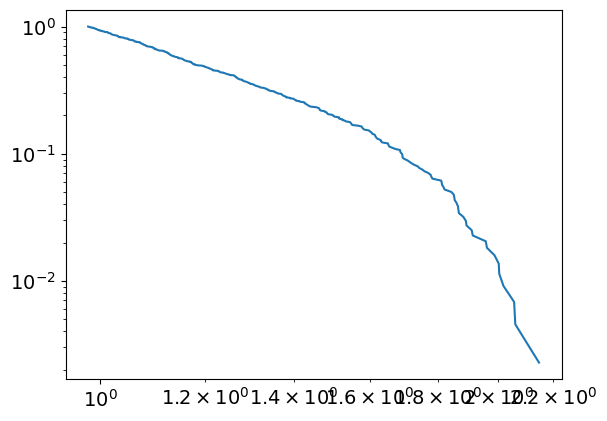

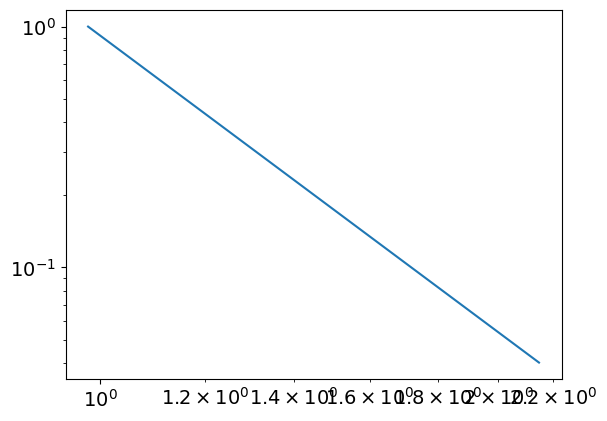

5.088984114921836
0.9786487680708921
powerlaw KstestResult(statistic=0.9777247319645999, pvalue=0.0, statistic_location=1.3082707822481372, statistic_sign=1)
lognorm KstestResult(statistic=0.9774608745967386, pvalue=0.0, statistic_location=1.2523755000232581, statistic_sign=1)
tensor(0.0749, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2187, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5459, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8274, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
390
tensor(5.8389e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


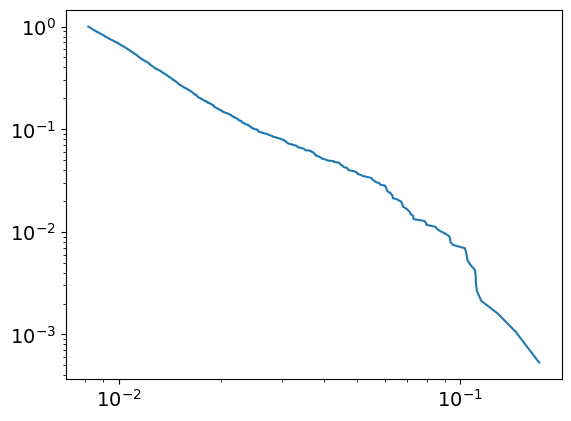

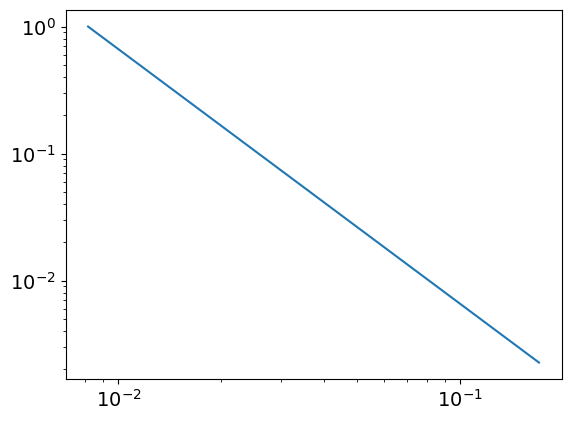

3.0058081358241067
0.008155797063615262
powerlaw KstestResult(statistic=0.9986225356589337, pvalue=0.0, statistic_location=0.09347055191093805, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12869262189683991, statistic_sign=-1)
tensor(-1.6760e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1350, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.3273, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
390
tensor(0.2430, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


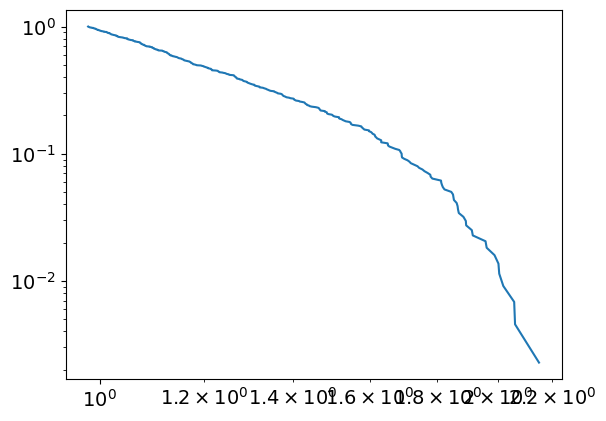

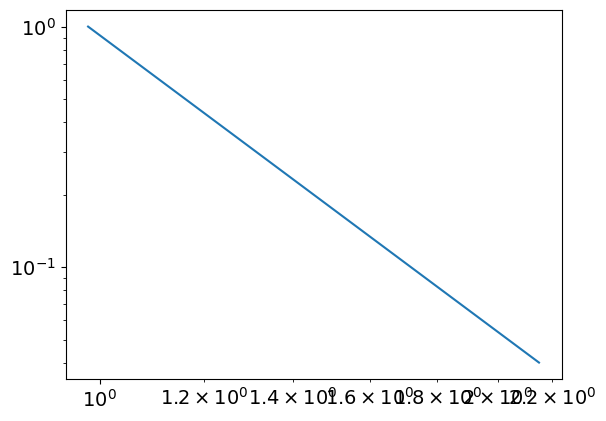

5.094254960263657
0.9797984414891195
powerlaw KstestResult(statistic=0.9777480241001854, pvalue=0.0, statistic_location=1.30937002290551, statistic_sign=1)
lognorm KstestResult(statistic=0.977369492225842, pvalue=0.0, statistic_location=1.2539617801951097, statistic_sign=1)
tensor(0.0750, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2188, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5480, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8319, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
391
tensor(6.0206e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


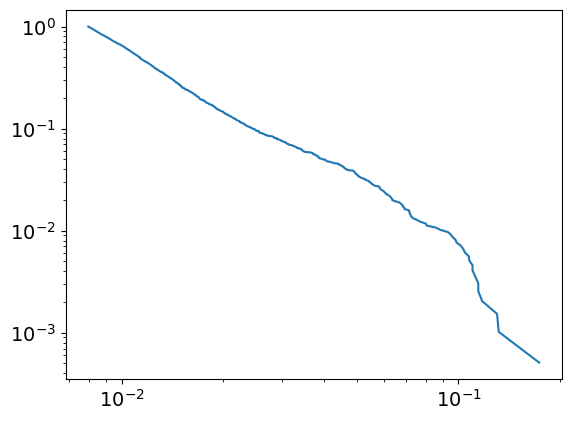

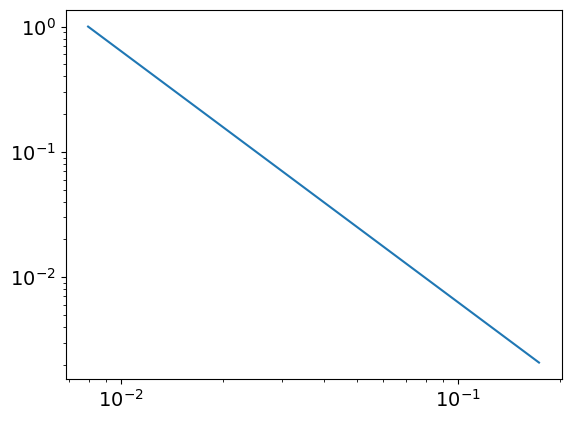

3.0043215872093234
0.00796720151085748
powerlaw KstestResult(statistic=0.9986002031888256, pvalue=0.0, statistic_location=0.08063383777850558, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13023913904136394, statistic_sign=-1)
tensor(-2.4282e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(-0.0104, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.2010, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
391
tensor(0.2435, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


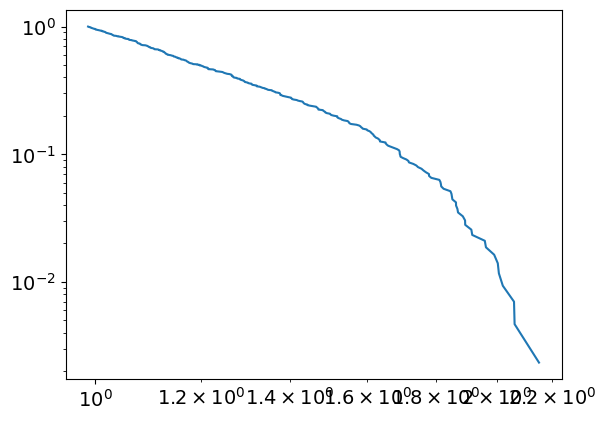

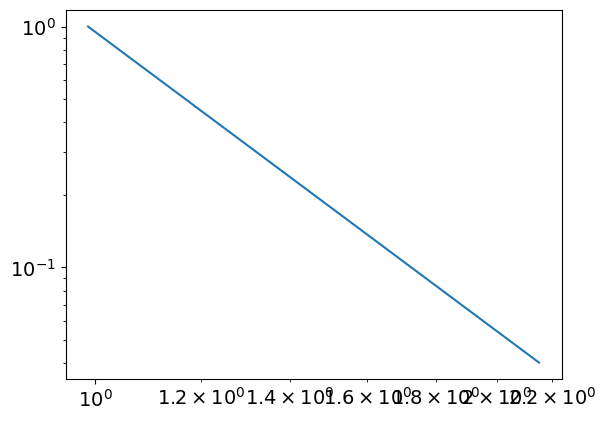

5.129009725034016
0.9876767216132638
powerlaw KstestResult(statistic=0.9782851005545988, pvalue=0.0, statistic_location=1.3117817792732611, statistic_sign=1)
lognorm KstestResult(statistic=0.9772560594012262, pvalue=0.0, statistic_location=1.255788084845838, statistic_sign=1)
tensor(0.0751, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2189, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5502, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8365, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
392
tensor(6.1237e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


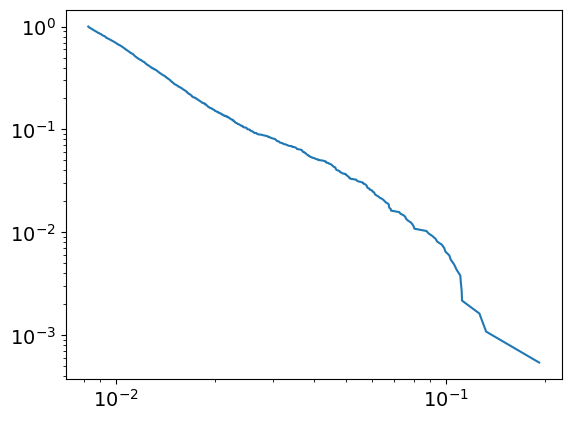

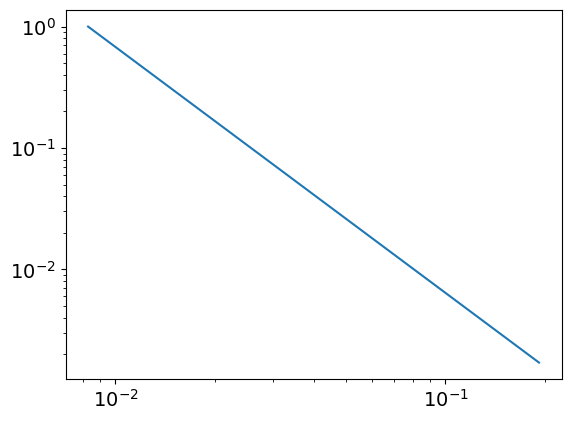

3.0256784882925563
0.008265758024446592
powerlaw KstestResult(statistic=0.9986959661176986, pvalue=0.0, statistic_location=0.11186197970197231, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12658566978729785, statistic_sign=-1)
tensor(-4.8698e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3766, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.9893, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
392
tensor(0.2439, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


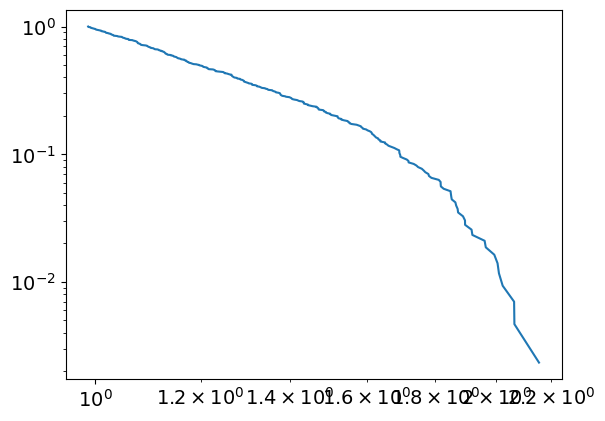

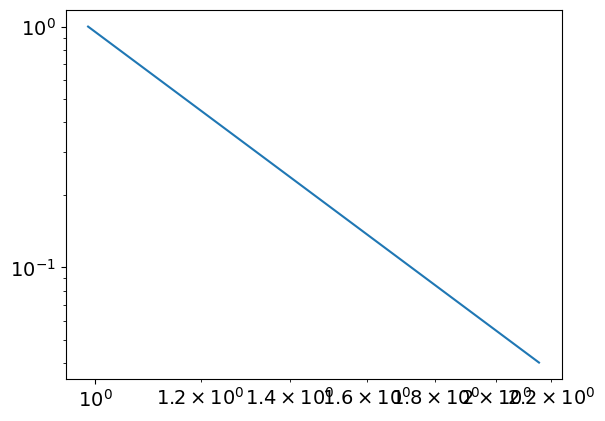

5.123066475859881
0.9876673631694964
powerlaw KstestResult(statistic=0.9782730725586147, pvalue=0.0, statistic_location=1.3115944288127128, statistic_sign=1)
lognorm KstestResult(statistic=0.9772520270996193, pvalue=0.0, statistic_location=1.2508467236300496, statistic_sign=1)
tensor(0.0752, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2189, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5523, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8411, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
393
tensor(6.3468e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


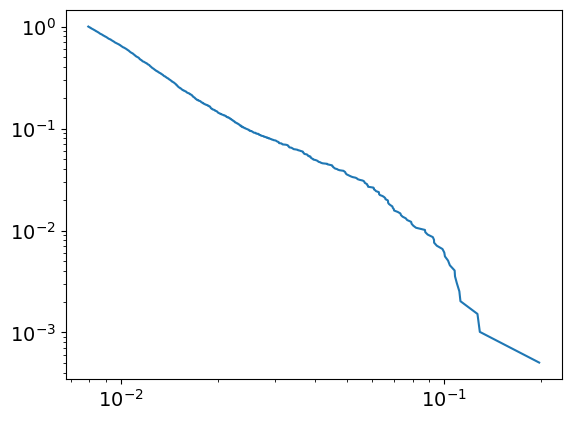

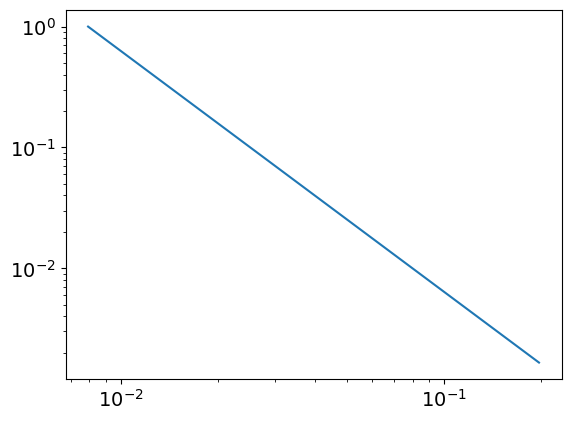

2.99423932227338
0.007930373901718869
powerlaw KstestResult(statistic=0.9986203573779885, pvalue=0.0, statistic_location=0.11146854307016493, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12897393286937694, statistic_sign=-1)
tensor(-6.7467e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3705, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.2621, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
393
tensor(0.2442, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


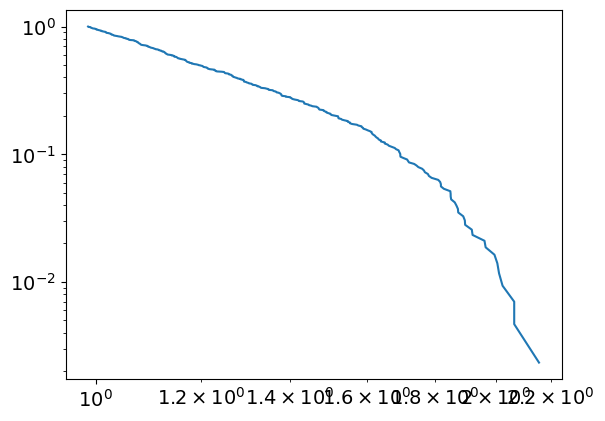

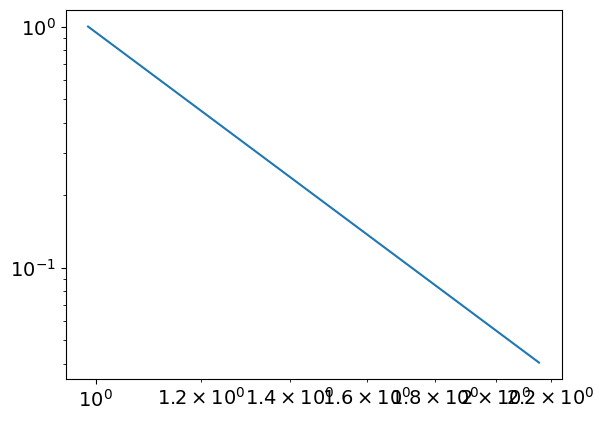

5.106514018721379
0.9869626477687946
powerlaw KstestResult(statistic=0.9781473597060788, pvalue=0.0, statistic_location=1.3042940730713728, statistic_sign=1)
lognorm KstestResult(statistic=0.9771923518577869, pvalue=0.0, statistic_location=1.2519011592176967, statistic_sign=1)
tensor(0.0752, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2190, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5544, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8455, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
394
tensor(7.4019e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


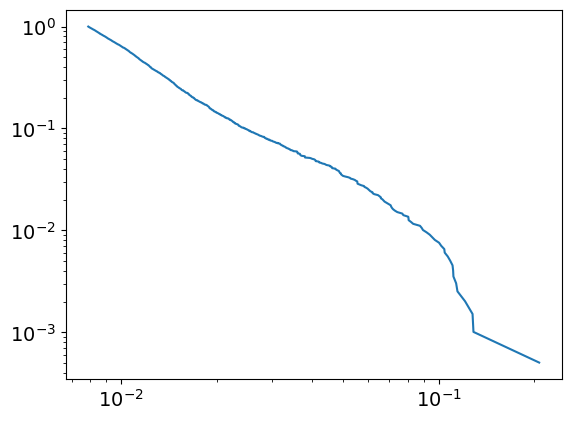

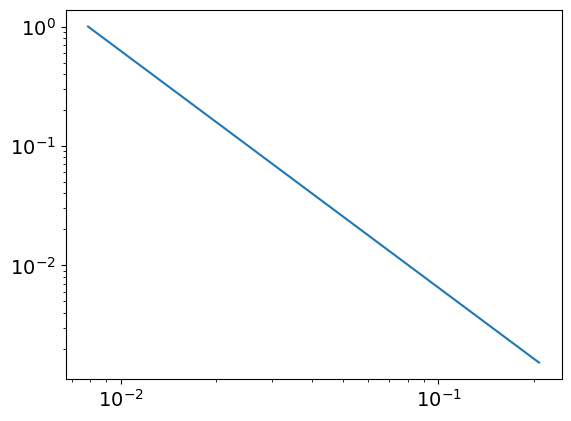

2.9835655652077677
0.007890646821879526
powerlaw KstestResult(statistic=0.9984823949431367, pvalue=0.0, statistic_location=0.10687465031159646, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12790976493273407, statistic_sign=-1)
tensor(-1.6603e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3652, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.2886, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
394
tensor(0.2446, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


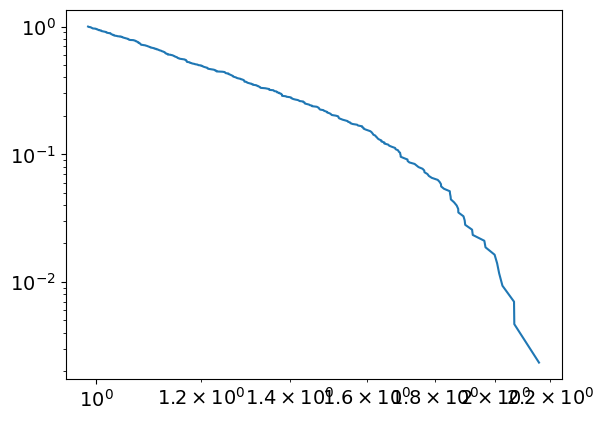

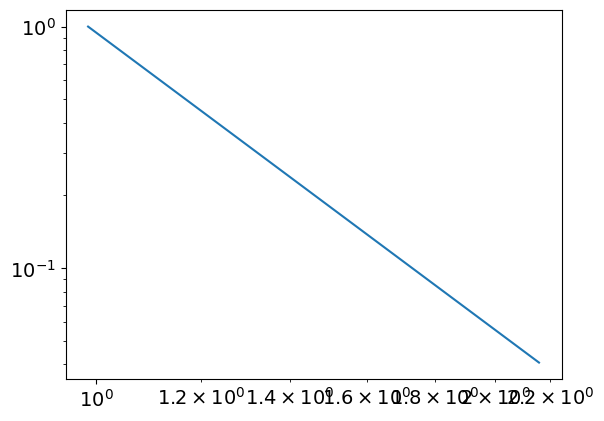

5.0897742497084675
0.986229640154493
powerlaw KstestResult(statistic=0.9779948791054963, pvalue=0.0, statistic_location=1.3029072620334103, statistic_sign=1)
lognorm KstestResult(statistic=0.9771198303724288, pvalue=0.0, statistic_location=1.2531103904115661, statistic_sign=1)
tensor(0.0753, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2190, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5566, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8503, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
395
tensor(6.3790e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


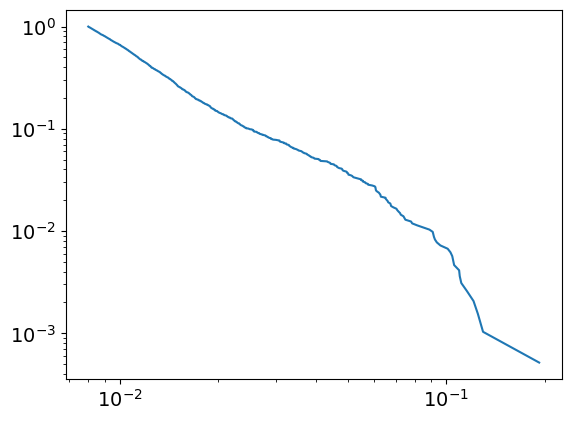

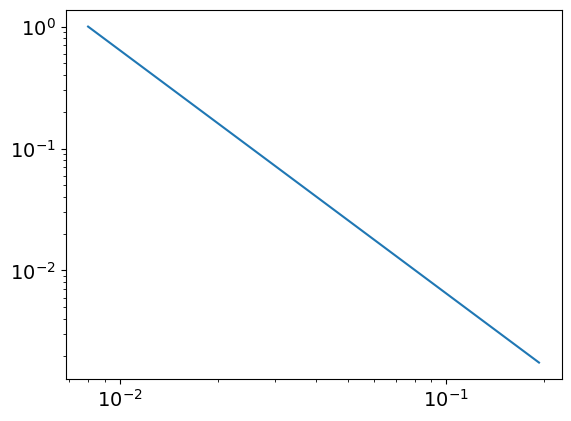

2.9956587741166705
0.008008506531340278
powerlaw KstestResult(statistic=0.9986757303001902, pvalue=0.0, statistic_location=0.10992554521335177, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12953847260671972, statistic_sign=-1)
tensor(-4.0861e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3387, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.0053, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
395
tensor(0.2450, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


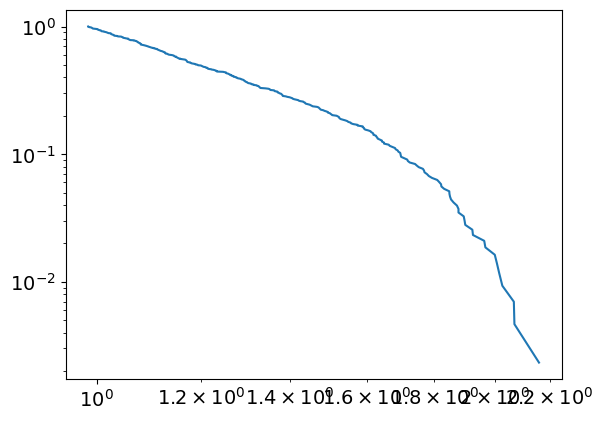

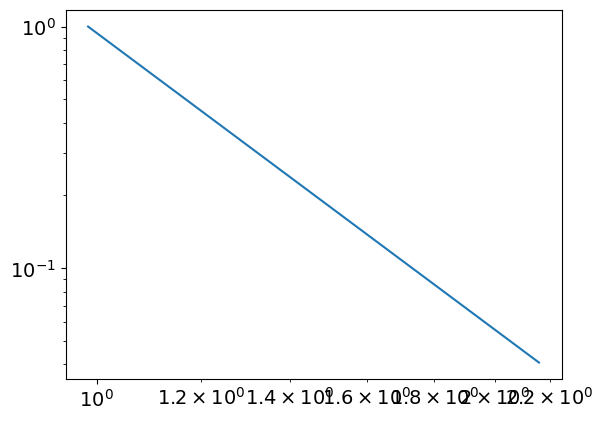

5.0811864148172035
0.9854461940068202
powerlaw KstestResult(statistic=0.9779532297354303, pvalue=0.0, statistic_location=1.3024056744600272, statistic_sign=1)
lognorm KstestResult(statistic=0.9770405277761937, pvalue=0.0, statistic_location=1.2543528994555144, statistic_sign=1)
tensor(0.0754, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2190, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5588, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8548, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
396
tensor(8.1681e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


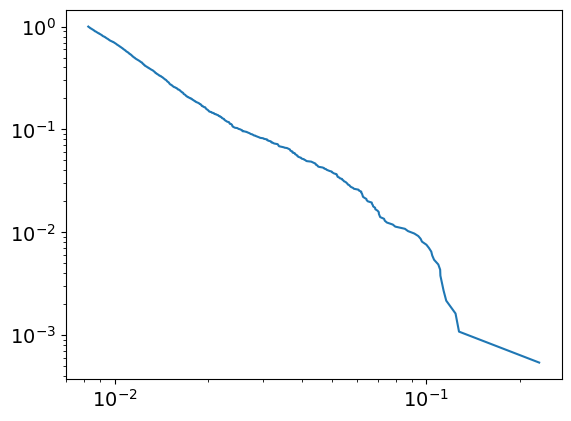

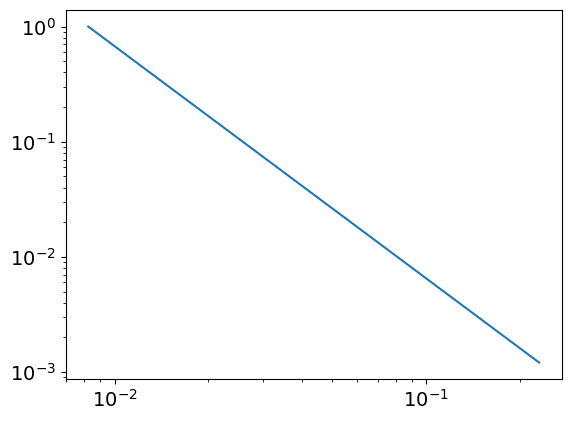

3.014932647678339
0.008227212762125053
powerlaw KstestResult(statistic=0.9985602324399426, pvalue=0.0, statistic_location=0.11125485181310132, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.23097543237370768, statistic_sign=1)
tensor(2.3964e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9519, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.8772, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
396
tensor(0.2454, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


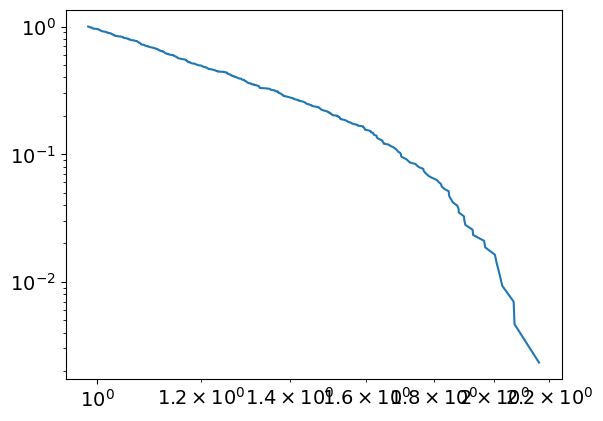

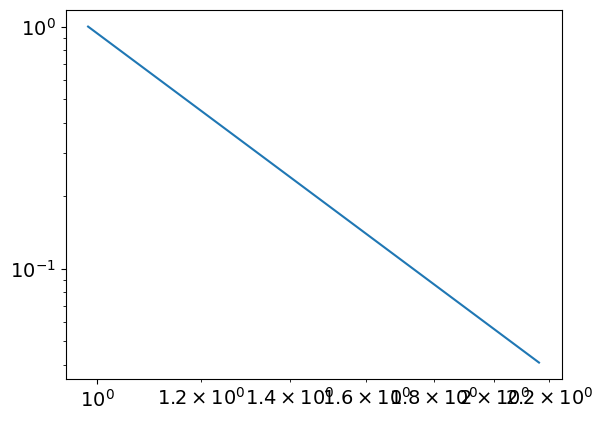

5.064699804007924
0.9847385008981464
powerlaw KstestResult(statistic=0.9778473358431576, pvalue=0.0, statistic_location=1.302748014920513, statistic_sign=1)
lognorm KstestResult(statistic=0.976986306571818, pvalue=0.0, statistic_location=1.23414785160082, statistic_sign=1)
tensor(0.0755, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2191, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5609, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8594, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
397
tensor(7.9285e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


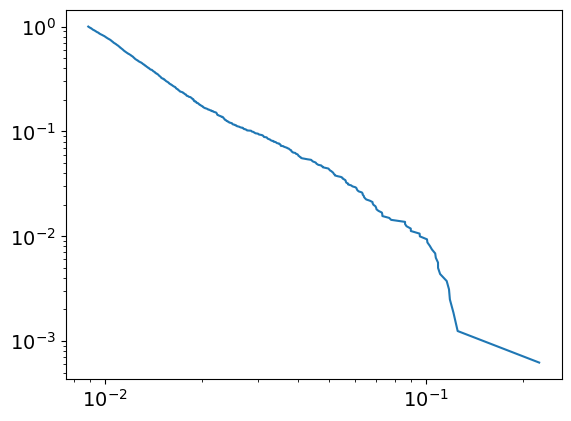

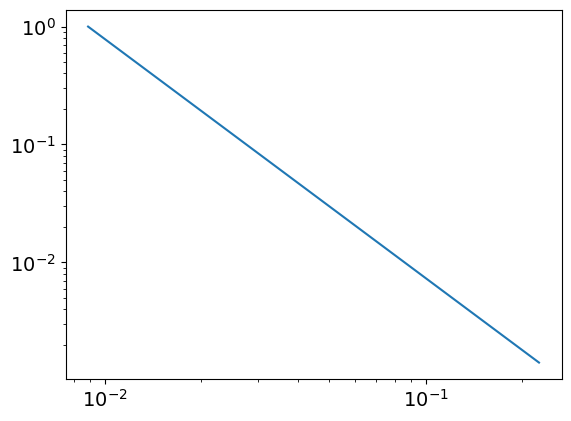

3.0291689761268863
0.00887691709333342
powerlaw KstestResult(statistic=0.9986296741675829, pvalue=0.0, statistic_location=0.11070111951929856, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22526524014797503, statistic_sign=1)
tensor(2.8326e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8090, device='cuda:0', grad_fn=<MeanBackward0>) tensor(47.2422, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
397
tensor(0.2457, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


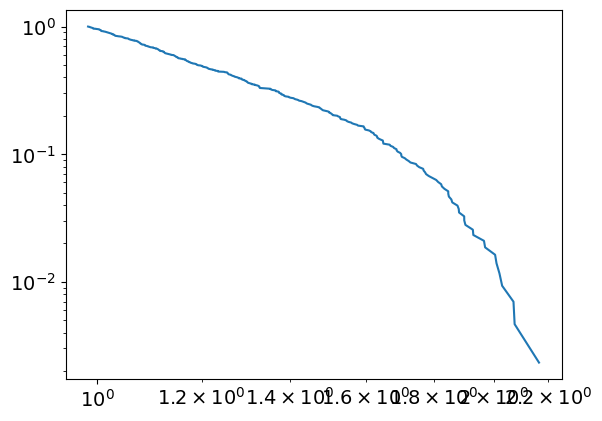

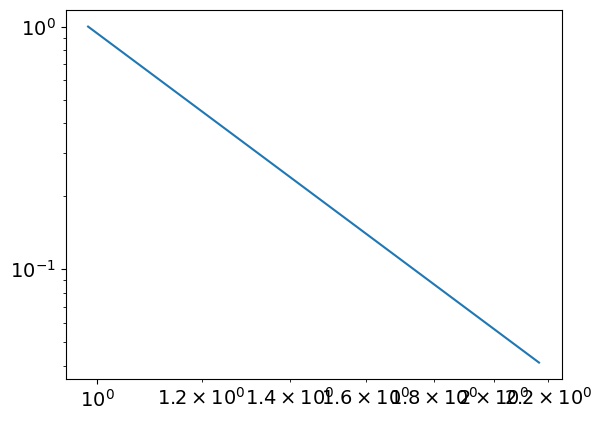

5.0481859456033
0.9840246870627535
powerlaw KstestResult(statistic=0.9776943397354004, pvalue=0.0, statistic_location=1.301371601113118, statistic_sign=1)
lognorm KstestResult(statistic=0.9769816157475667, pvalue=0.0, statistic_location=1.2569991338162558, statistic_sign=1)
tensor(0.0756, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2191, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5631, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8640, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
398
tensor(7.3256e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


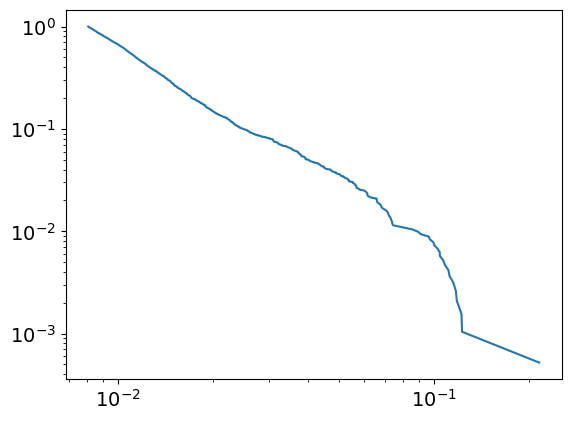

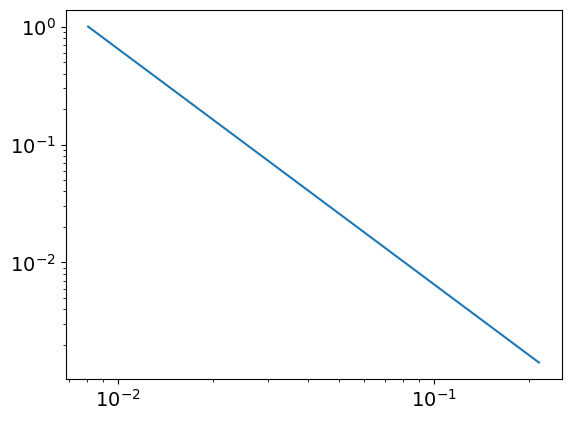

2.996216942426967
0.008058902856448854
powerlaw KstestResult(statistic=0.9983958477128314, pvalue=0.0, statistic_location=0.11824703524901987, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21540050551179063, statistic_sign=1)
tensor(3.4255e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9912, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.7218, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
398
tensor(0.2462, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


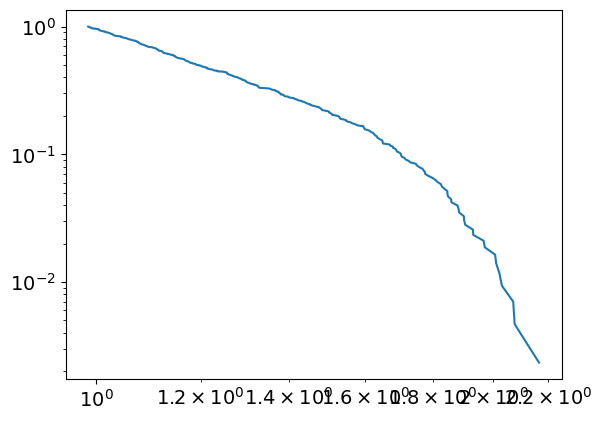

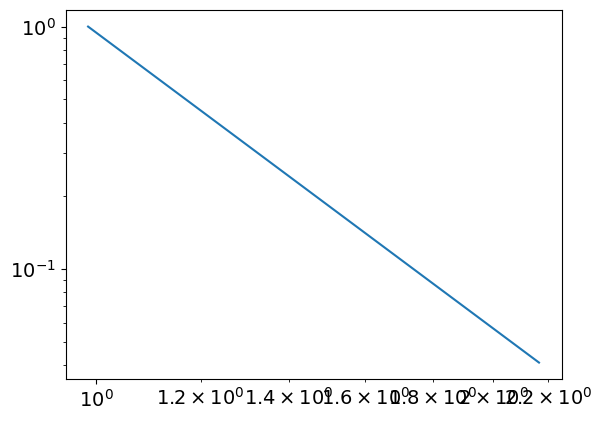

5.058998606795569
0.9861332164401154
powerlaw KstestResult(statistic=0.9777794382664245, pvalue=0.0, statistic_location=1.3076937761473264, statistic_sign=1)
lognorm KstestResult(statistic=0.9769373574069175, pvalue=0.0, statistic_location=1.236079871803837, statistic_sign=1)
tensor(0.0757, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2192, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5652, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8686, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


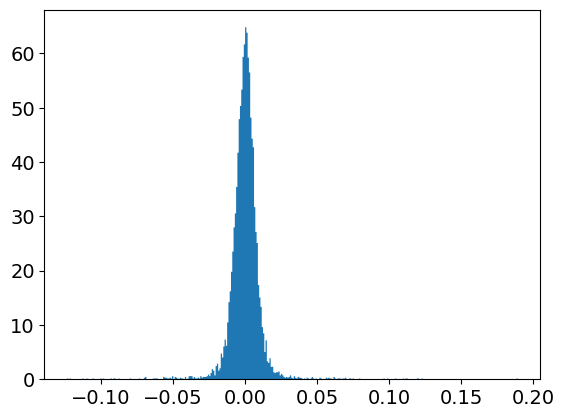

powerlaw
Calculating best minimal value for power law fit
8.824930705347597%
powerlaw KstestResult(statistic=0.9999999997944946, pvalue=0.0, statistic_location=0.18945016003932091, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18945016003932091, statistic_sign=1)



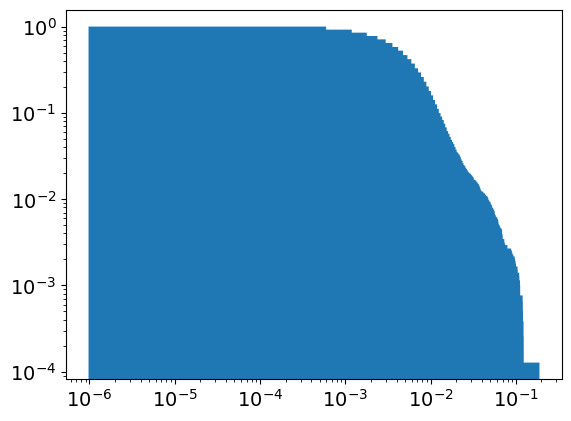

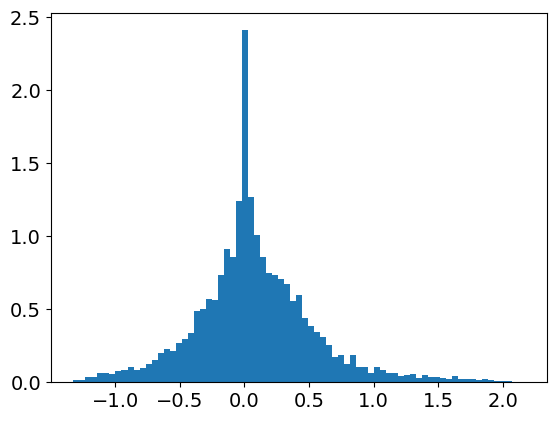

powerlaw
Calculating best minimal value for power law fit
2.978248106698743%
powerlaw KstestResult(statistic=0.9080434774737431, pvalue=0.0, statistic_location=0.6950193094589526, statistic_sign=1)
lognorm KstestResult(statistic=0.9768983751814886, pvalue=0.0, statistic_location=1.2375416053969115, statistic_sign=1)



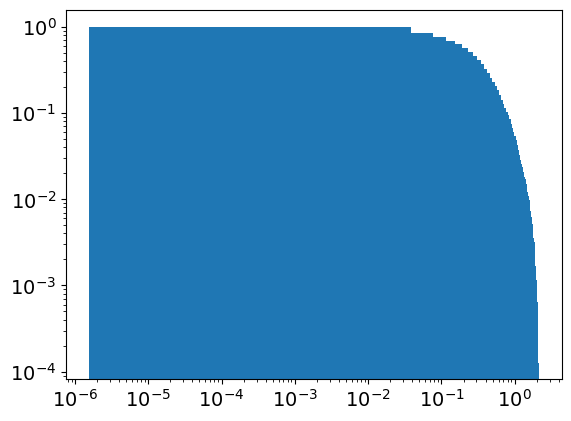

separation
epoch:
399
tensor(6.5344e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


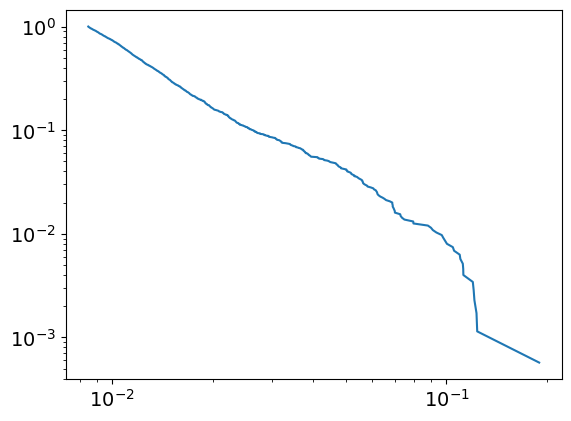

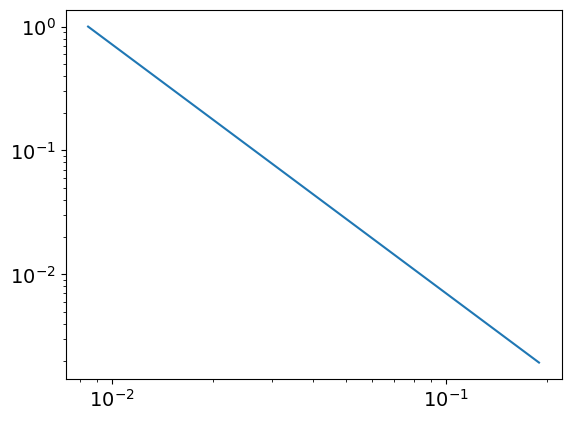

3.0107127805933414
0.008477926093012
powerlaw KstestResult(statistic=0.9984039308256675, pvalue=0.0, statistic_location=0.12302571999840729, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18945016003932091, statistic_sign=1)
tensor(2.2747e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6310, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.5174, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
399
tensor(0.2466, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


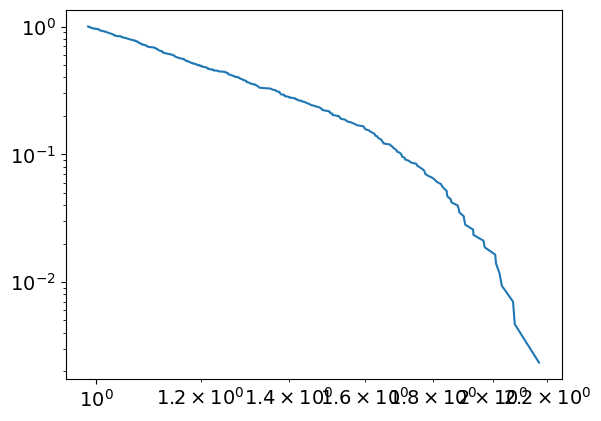

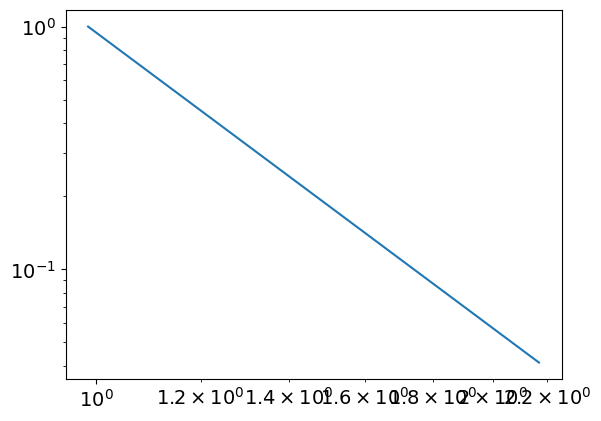

5.04283228844473
0.9854276764350963
powerlaw KstestResult(statistic=0.9776708185127824, pvalue=0.0, statistic_location=1.3079385141604927, statistic_sign=1)
lognorm KstestResult(statistic=0.9768983751814886, pvalue=0.0, statistic_location=1.2375416053969115, statistic_sign=1)
tensor(0.0758, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2192, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5673, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8732, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
400
tensor(7.5388e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


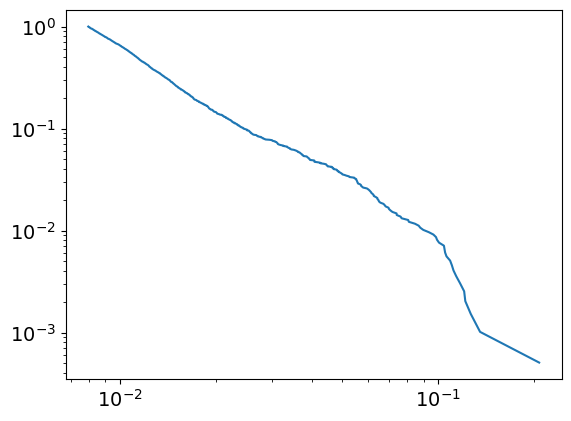

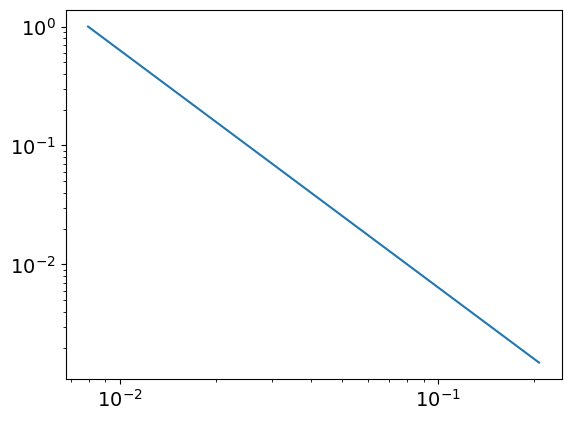

2.994628449098158
0.007947746706254418
powerlaw KstestResult(statistic=0.9983214086703712, pvalue=0.0, statistic_location=0.1045642966454345, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2074179787625718, statistic_sign=1)
tensor(3.0689e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8348, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.0628, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
400
tensor(0.2469, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


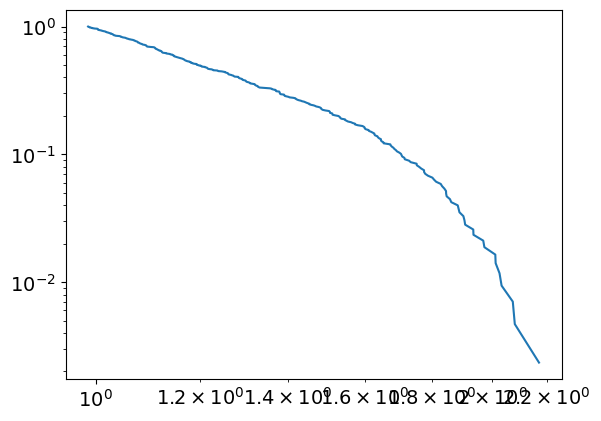

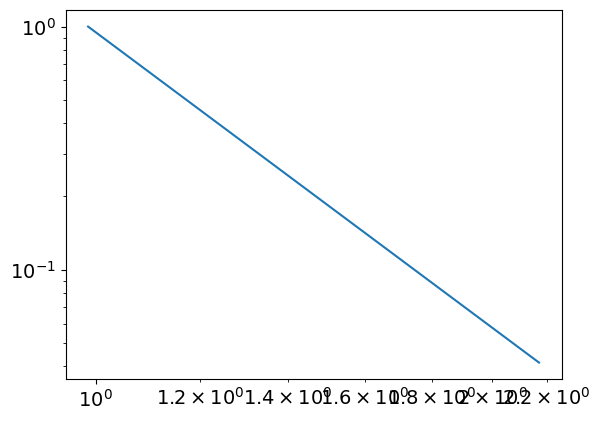

5.03807626246073
0.9865626124176171
powerlaw KstestResult(statistic=0.9776221347187904, pvalue=0.0, statistic_location=1.3096602025565753, statistic_sign=1)
lognorm KstestResult(statistic=0.9768561913432985, pvalue=0.0, statistic_location=1.2389838404376803, statistic_sign=1)
tensor(0.0759, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2193, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5695, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8777, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
401
tensor(6.6582e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


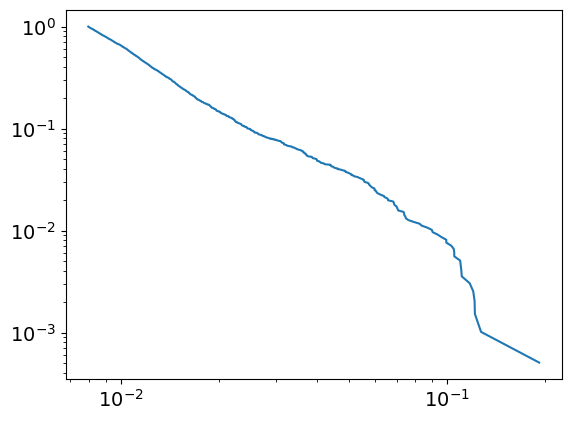

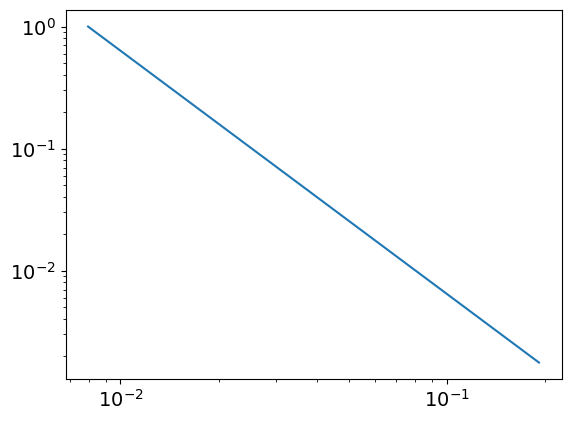

2.993605022628946
0.007957730204088957
powerlaw KstestResult(statistic=0.9984086719683374, pvalue=0.0, statistic_location=0.11009394022203677, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19141324630701026, statistic_sign=1)
tensor(3.8974e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.6302, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
401
tensor(0.2474, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


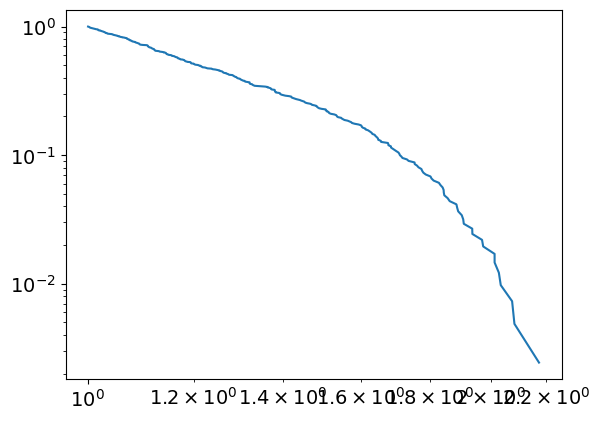

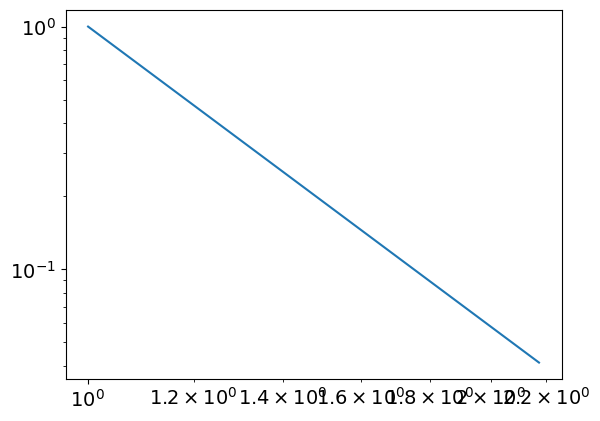

5.116344258087599
1.0009764350088939
powerlaw KstestResult(statistic=0.9784831079367561, pvalue=0.0, statistic_location=1.3326878130323934, statistic_sign=1)
lognorm KstestResult(statistic=0.9768083339697908, pvalue=0.0, statistic_location=1.2404781737763344, statistic_sign=1)
tensor(0.0760, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2193, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5717, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8824, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
402
tensor(6.2905e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


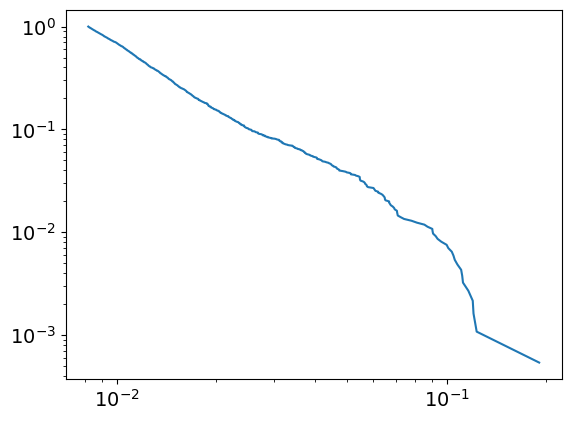

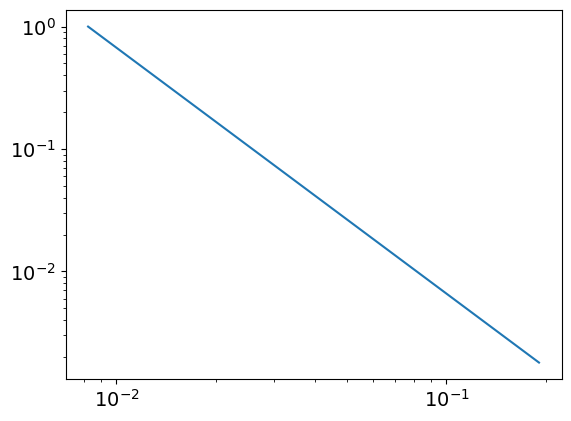

3.008807884764371
0.008204537771200131
powerlaw KstestResult(statistic=0.9985212195256112, pvalue=0.0, statistic_location=0.10781818860753263, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19069435426346346, statistic_sign=1)
tensor(4.9453e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7162, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.5802, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
402
tensor(0.2477, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


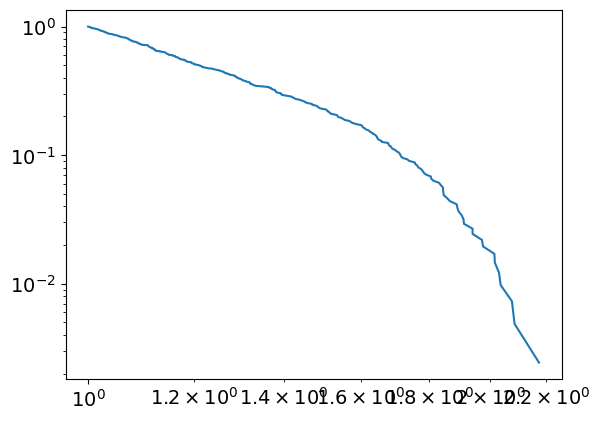

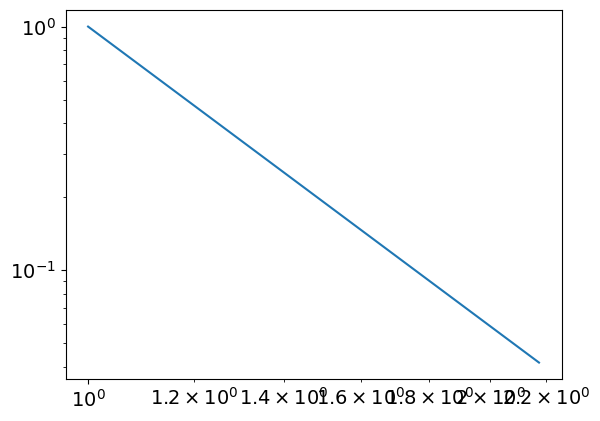

5.088467640830779
0.9996140250834195
powerlaw KstestResult(statistic=0.978303803026036, pvalue=0.0, statistic_location=1.3061081869973332, statistic_sign=1)
lognorm KstestResult(statistic=0.9767776257731395, pvalue=0.0, statistic_location=1.2450106712406181, statistic_sign=1)
tensor(0.0761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2194, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5738, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8869, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
403
tensor(5.6836e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


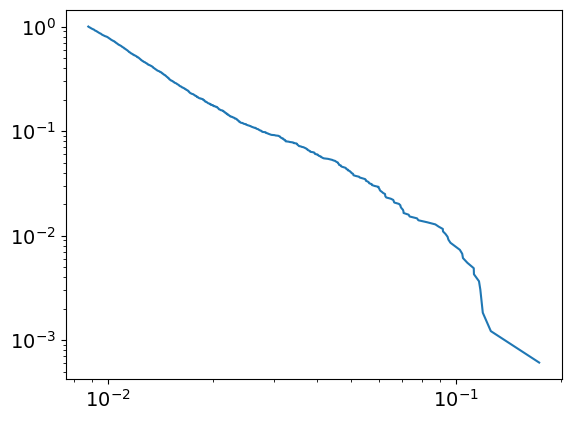

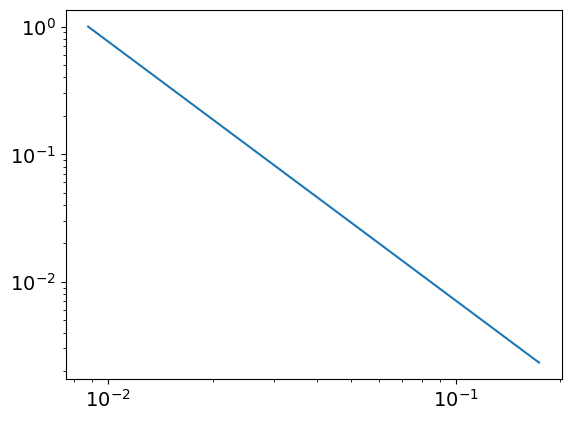

3.032384599712455
0.00877748252973821
powerlaw KstestResult(statistic=0.9985423208404909, pvalue=0.0, statistic_location=0.10477155401461656, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1734718994932184, statistic_sign=1)
tensor(5.3684e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6902, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.0299, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
403
tensor(0.2481, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


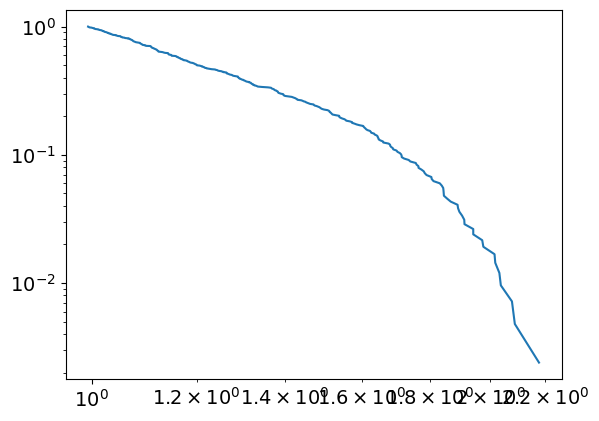

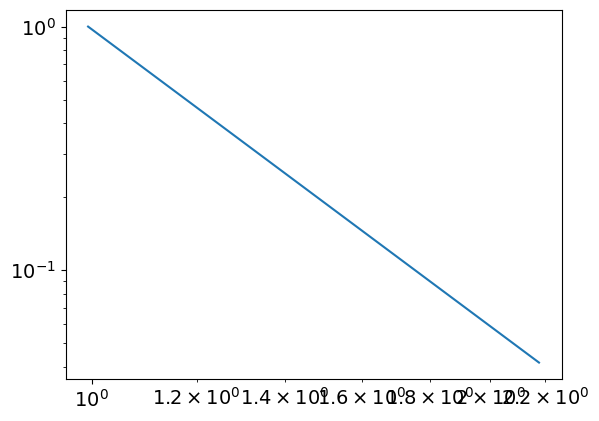

5.053298391982427
0.9936017366324357
powerlaw KstestResult(statistic=0.9778702688808816, pvalue=0.0, statistic_location=1.307598148504852, statistic_sign=1)
lognorm KstestResult(statistic=0.9767942542624788, pvalue=0.0, statistic_location=1.244354969245651, statistic_sign=1)
tensor(0.0762, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2194, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5761, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8918, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
404
tensor(6.9952e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


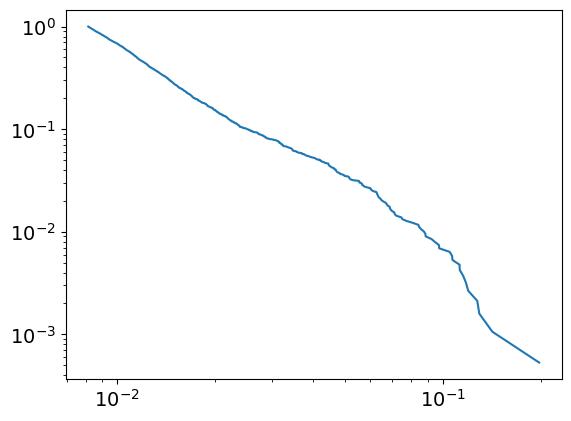

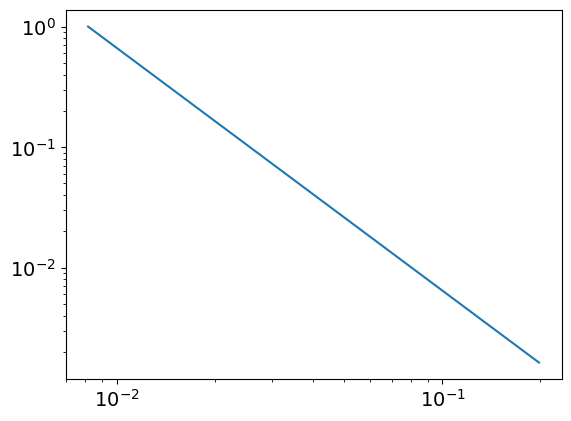

3.0119797486391287
0.008156138816701797
powerlaw KstestResult(statistic=0.9984784864806779, pvalue=0.0, statistic_location=0.09466270432772728, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1979306956195093, statistic_sign=1)
tensor(6.5568e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8434, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.5400, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
404
tensor(0.2485, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


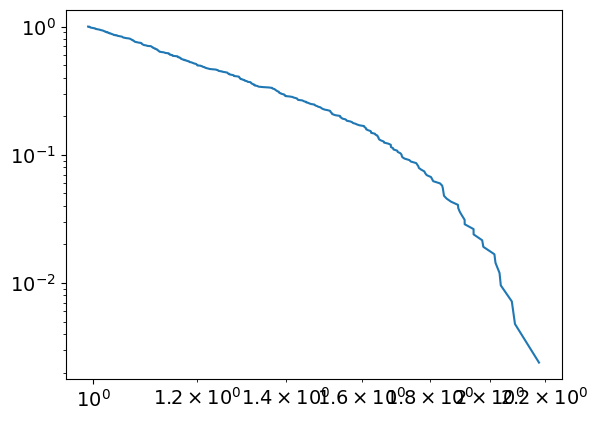

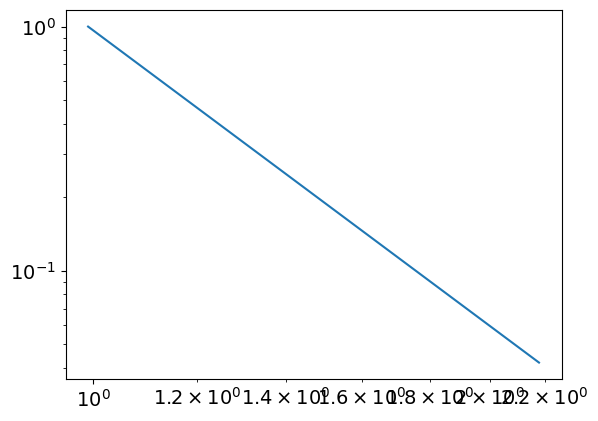

5.024625976213061
0.9915500236501235
powerlaw KstestResult(statistic=0.9775986000968327, pvalue=0.0, statistic_location=1.3091440886522947, statistic_sign=1)
lognorm KstestResult(statistic=0.9767703432325211, pvalue=0.0, statistic_location=1.2447824330309736, statistic_sign=1)
tensor(0.0763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2195, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5782, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.8964, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
405
tensor(6.4678e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


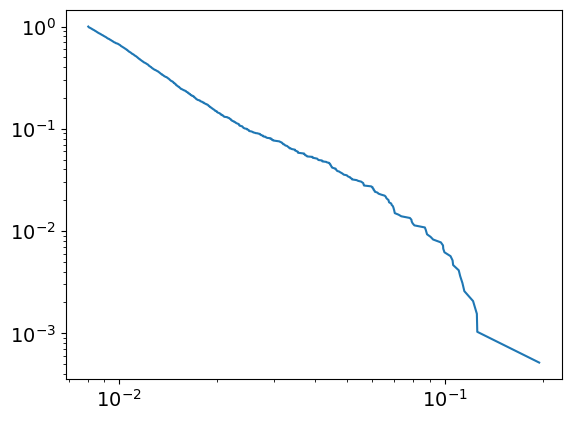

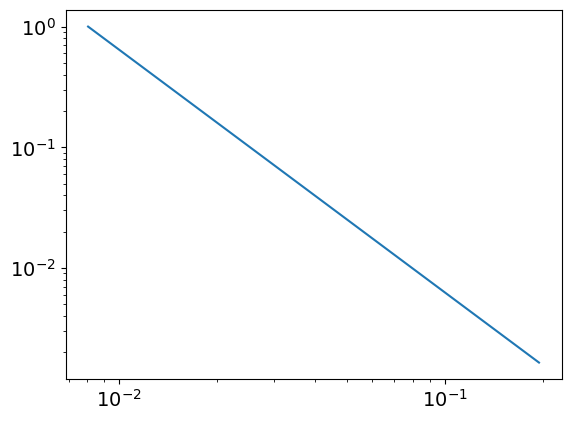

3.010828179070675
0.00803829076246569
powerlaw KstestResult(statistic=0.998453348460512, pvalue=0.0, statistic_location=0.10572098111010479, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19505104884167163, statistic_sign=1)
tensor(4.8187e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8098, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.7552, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
405
tensor(0.2489, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


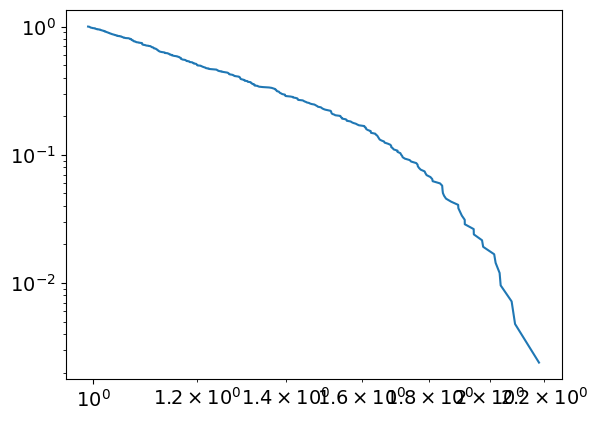

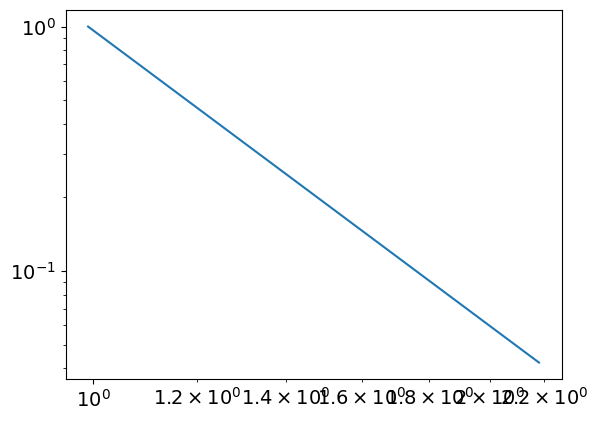

5.016196248712395
0.9913539522161303
powerlaw KstestResult(statistic=0.9775728306817639, pvalue=0.0, statistic_location=1.3035818649536821, statistic_sign=1)
lognorm KstestResult(statistic=0.9767021240439503, pvalue=0.0, statistic_location=1.2462876282496227, statistic_sign=1)
tensor(0.0764, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2195, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5804, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9010, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
406
tensor(6.6236e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


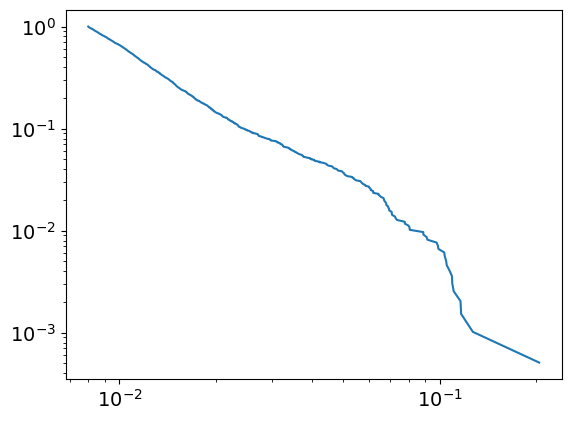

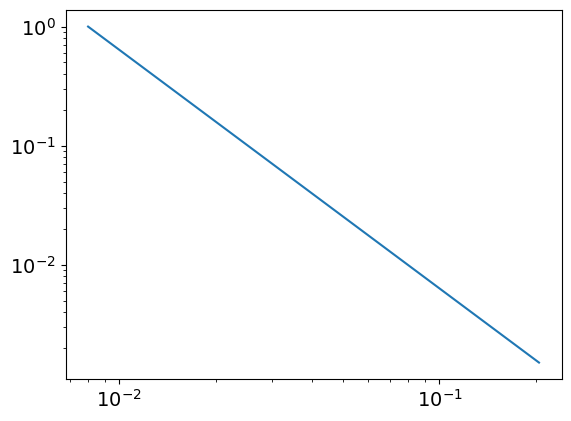

3.001875139308936
0.007989371683927384
powerlaw KstestResult(statistic=0.9986093928640155, pvalue=0.0, statistic_location=0.07991101230030019, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20460141046967367, statistic_sign=1)
tensor(1.0038e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5119, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.6889, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
406
tensor(0.2493, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


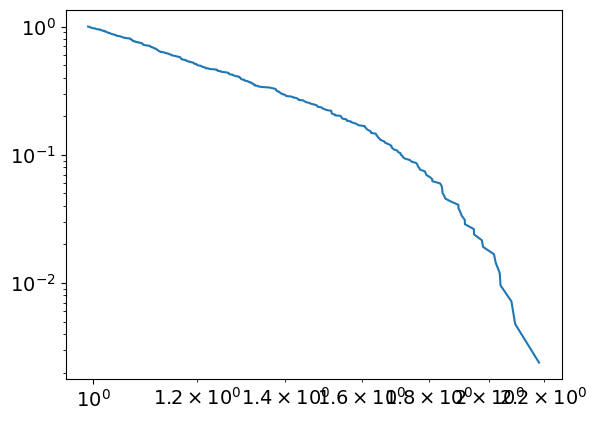

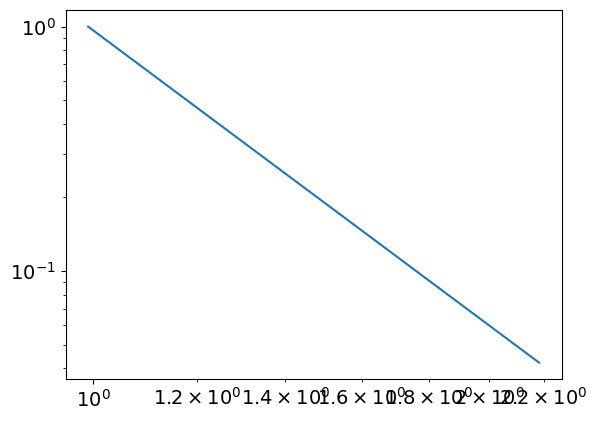

5.007985957130909
0.9911314782196204
powerlaw KstestResult(statistic=0.9774935935532569, pvalue=0.0, statistic_location=1.304439292187243, statistic_sign=1)
lognorm KstestResult(statistic=0.9767047349330531, pvalue=0.0, statistic_location=1.2426649780936545, statistic_sign=1)
tensor(0.0765, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2196, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5826, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9057, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
407
tensor(7.3438e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


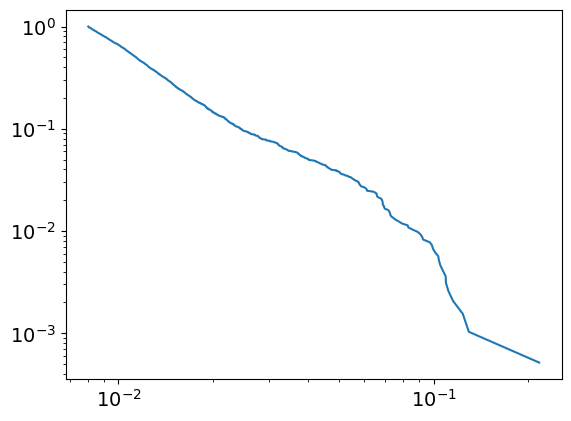

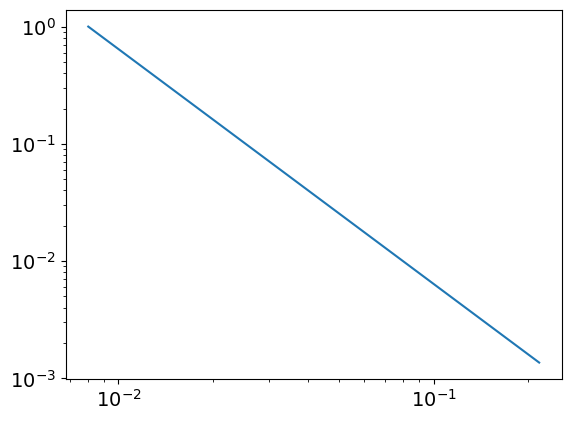

3.003533557390846
0.008024140990744208
powerlaw KstestResult(statistic=0.9985864760736951, pvalue=0.0, statistic_location=0.10495773174540671, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21621037656711856, statistic_sign=1)
tensor(1.8386e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7826, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.2507, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
407
tensor(0.2497, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


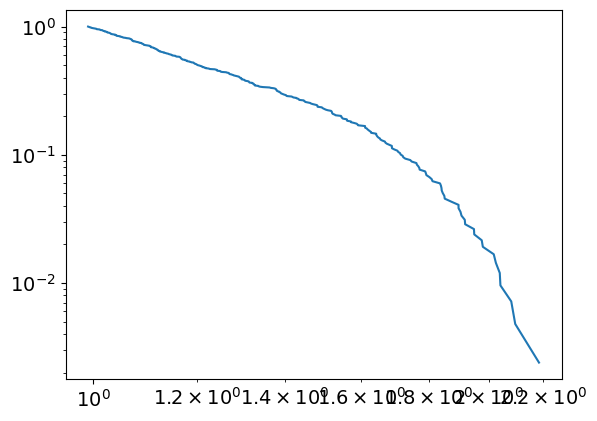

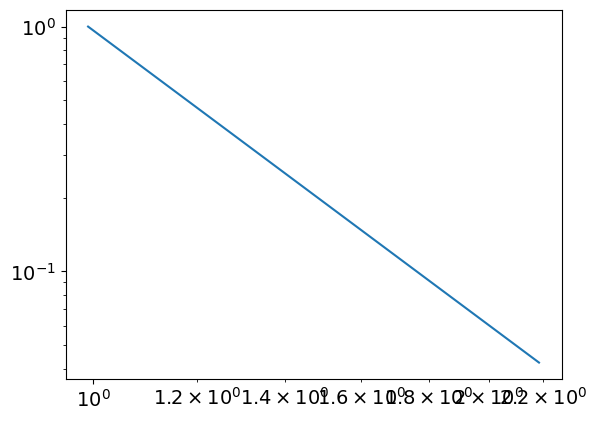

4.99944877051955
0.9908504231267025
powerlaw KstestResult(statistic=0.9774097266001737, pvalue=0.0, statistic_location=1.3052722614457541, statistic_sign=1)
lognorm KstestResult(statistic=0.9766683221163185, pvalue=0.0, statistic_location=1.24347787013972, statistic_sign=1)
tensor(0.0766, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2196, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5848, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9104, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
408
tensor(6.5060e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


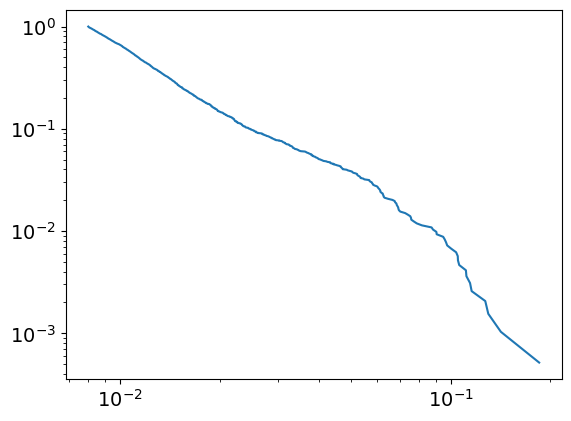

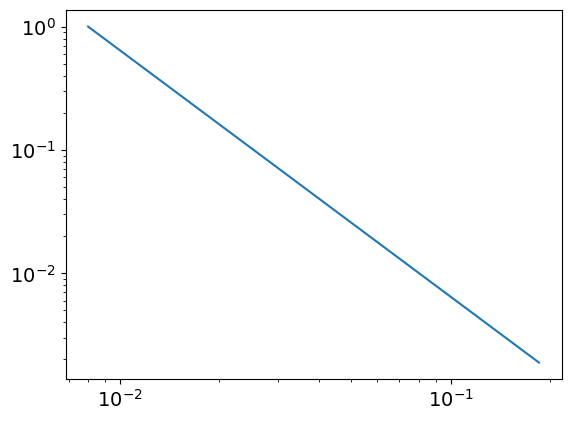

2.9997323294468328
0.008019999752733785
powerlaw KstestResult(statistic=0.9984218896855794, pvalue=0.0, statistic_location=0.10597064160359797, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18483403161532339, statistic_sign=1)
tensor(4.9651e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8170, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.0566, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
408
tensor(0.2501, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


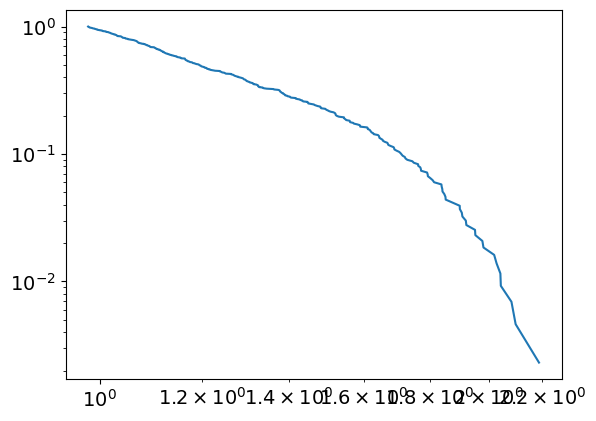

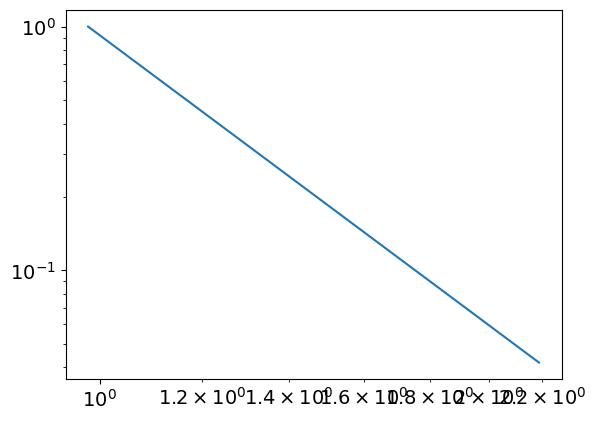

4.955355489591689
0.9795774144024967
powerlaw KstestResult(statistic=0.9765805532953228, pvalue=0.0, statistic_location=1.306139178587974, statistic_sign=1)
lognorm KstestResult(statistic=0.9766302331769716, pvalue=0.0, statistic_location=1.244284792953946, statistic_sign=1)
tensor(0.0767, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2197, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5870, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9151, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
409
tensor(5.5190e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


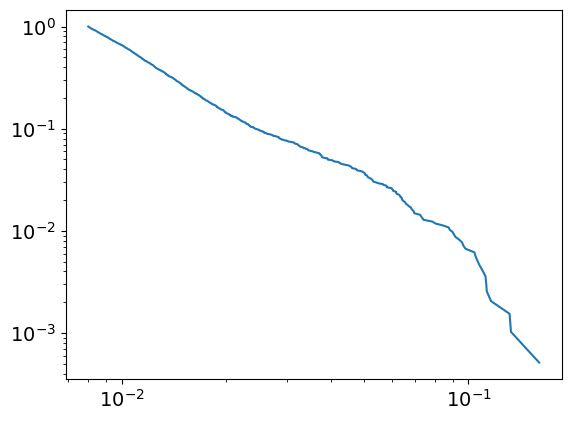

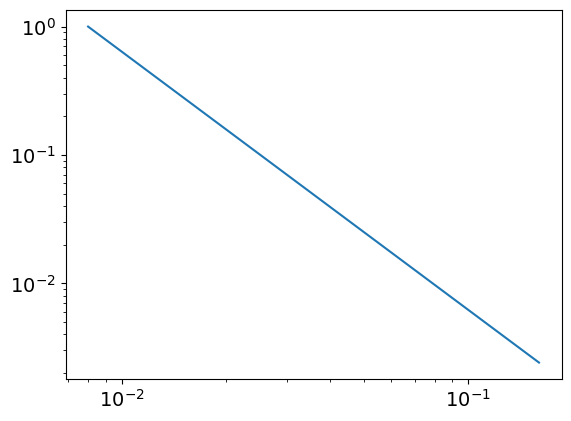

3.0117126237239082
0.008000457787586415
powerlaw KstestResult(statistic=0.99851256463893, pvalue=0.0, statistic_location=0.11614737397915316, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15995899911892159, statistic_sign=1)
tensor(2.9381e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4322, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.7853, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
409
tensor(0.2505, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


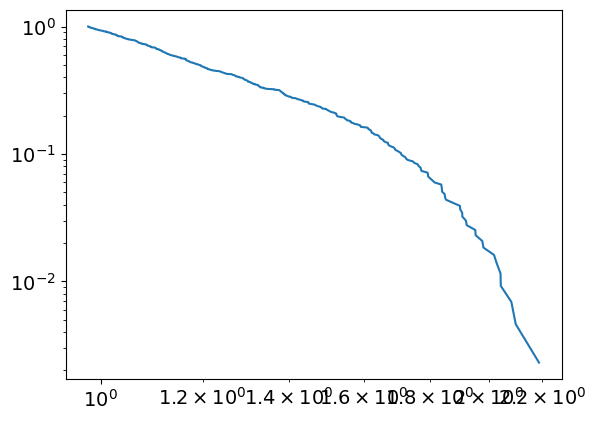

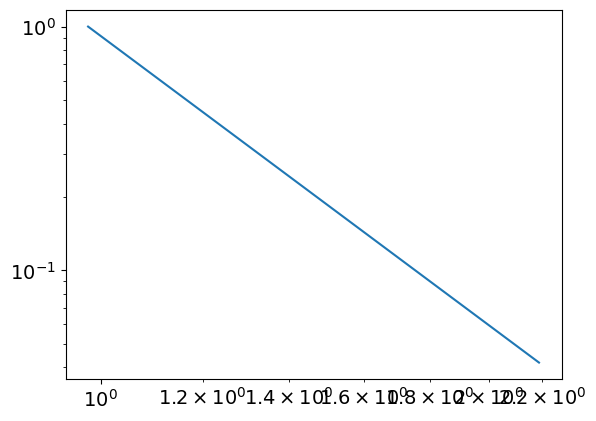

4.941931997228773
0.9778685963409274
powerlaw KstestResult(statistic=0.9763448520578603, pvalue=0.0, statistic_location=1.3009213902076133, statistic_sign=1)
lognorm KstestResult(statistic=0.9765879508993323, pvalue=0.0, statistic_location=1.2451384196837325, statistic_sign=1)
tensor(0.0768, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2197, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5892, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9199, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
410
tensor(5.3001e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


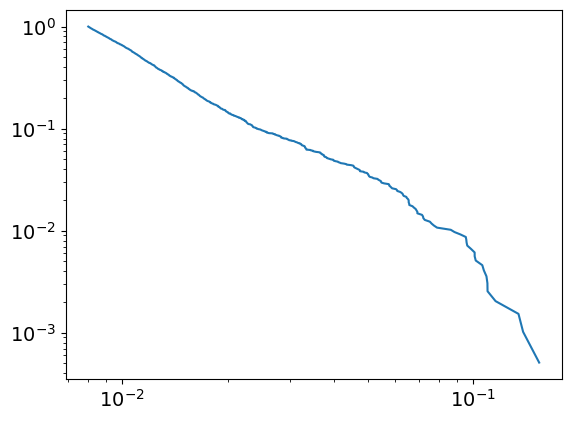

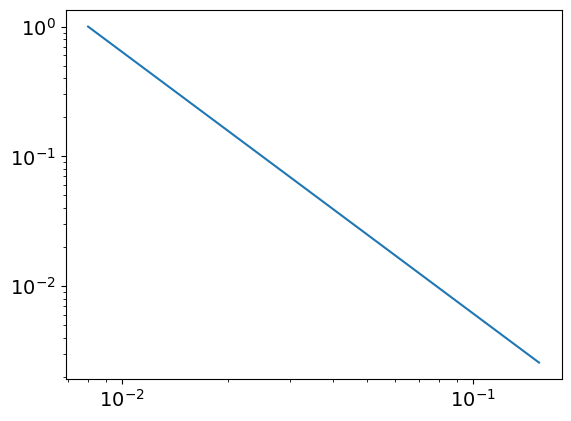

3.0169387590173136
0.00799867192623445
powerlaw KstestResult(statistic=0.998602883555873, pvalue=0.0, statistic_location=0.10978317771212817, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15402642489646226, statistic_sign=1)
tensor(1.4752e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2109, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.8501, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
410
tensor(0.2509, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


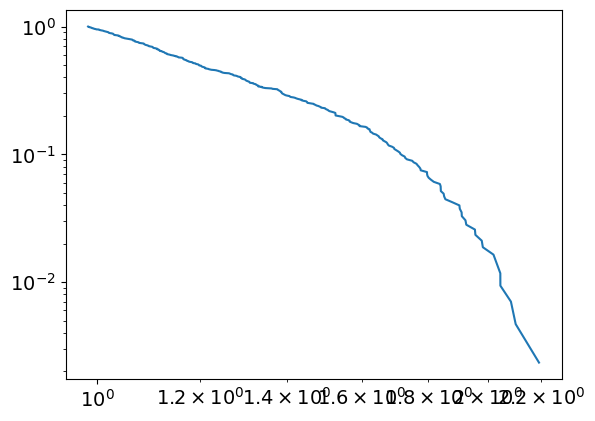

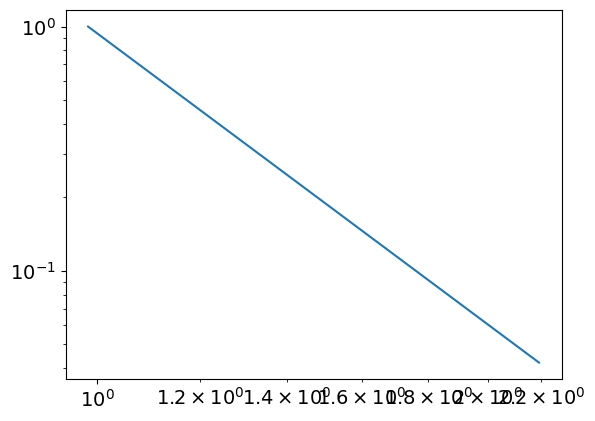

4.9554090603290675
0.9836120875844122
powerlaw KstestResult(statistic=0.9766382994237233, pvalue=0.0, statistic_location=1.309197257819791, statistic_sign=1)
lognorm KstestResult(statistic=0.9765761774103274, pvalue=0.0, statistic_location=1.248077826759555, statistic_sign=1)
tensor(0.0769, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2198, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5914, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9246, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
411
tensor(5.0919e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


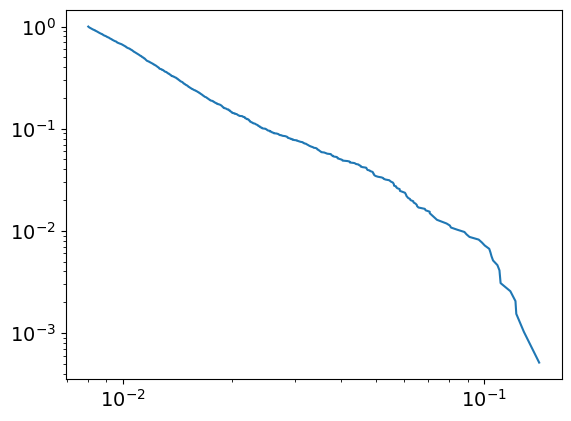

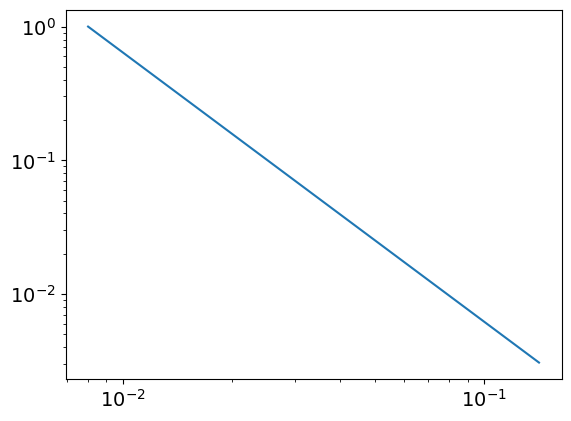

3.0138032636491494
0.008014747781694434
powerlaw KstestResult(statistic=0.9985862876402565, pvalue=0.0, statistic_location=0.10572902051014757, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14185366298676436, statistic_sign=1)
tensor(1.1727e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1303, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.5901, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
411
tensor(0.2513, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


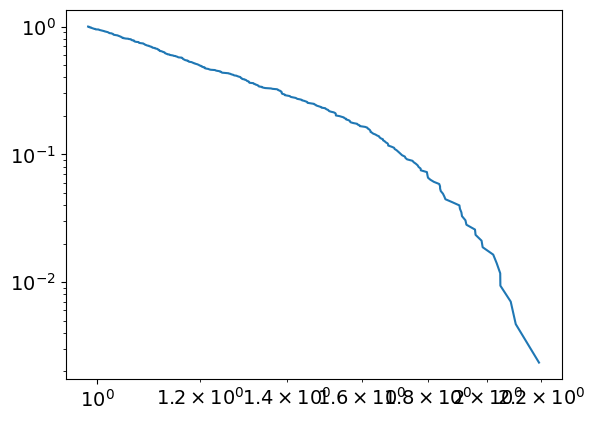

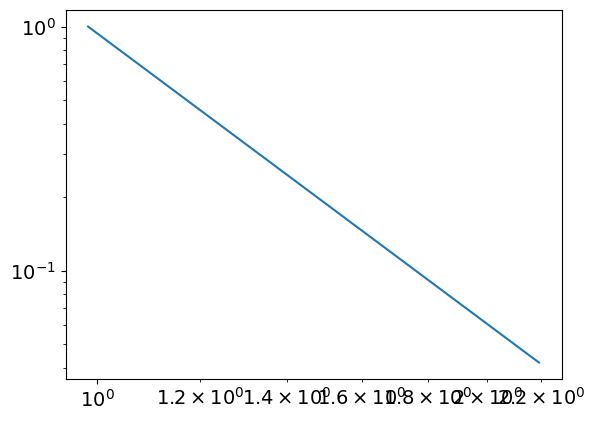

4.955519874463756
0.9839125743715148
powerlaw KstestResult(statistic=0.976612929831818, pvalue=0.0, statistic_location=1.3054846436624286, statistic_sign=1)
lognorm KstestResult(statistic=0.9765975217333378, pvalue=0.0, statistic_location=1.2474157471247174, statistic_sign=1)
tensor(0.0770, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2198, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5936, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9294, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
412
tensor(4.8533e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


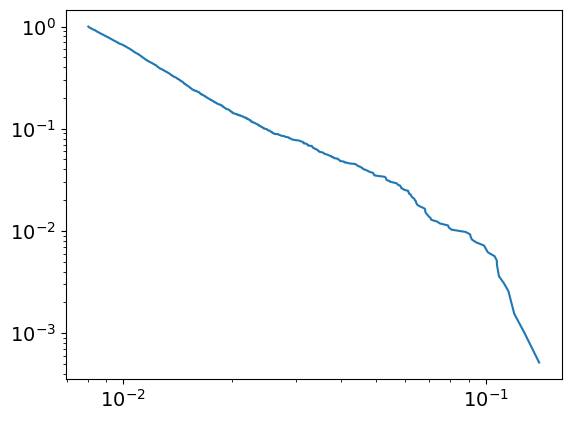

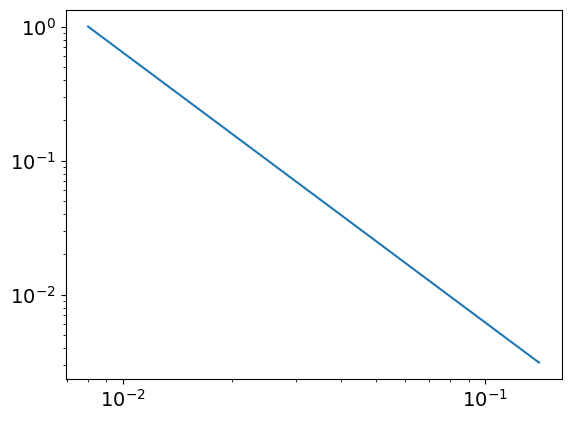

3.015457511880729
0.008016557935965788
powerlaw KstestResult(statistic=0.9986028140561409, pvalue=0.0, statistic_location=0.11754037115605145, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1405534430823164, statistic_sign=1)
tensor(3.3992e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1485, device='cuda:0', grad_fn=<MeanBackward0>) tensor(30.7751, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
412
tensor(0.2517, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


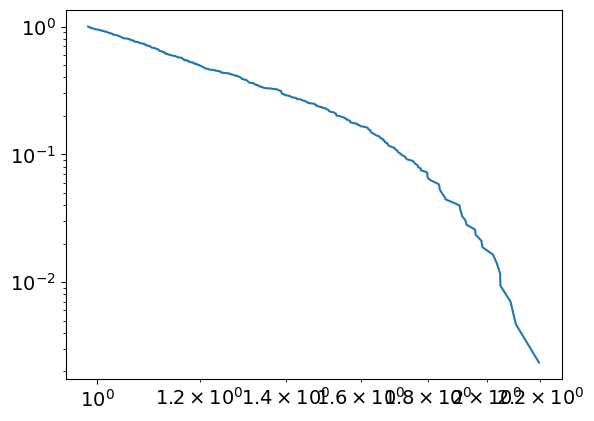

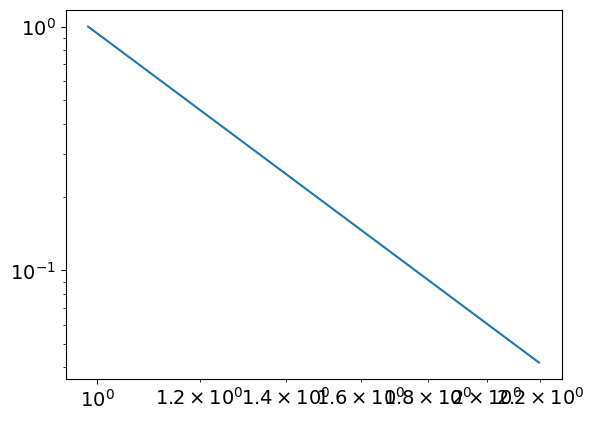

4.956460165108323
0.9842636320982615
powerlaw KstestResult(statistic=0.9765662270097372, pvalue=0.0, statistic_location=1.3067386191261474, statistic_sign=1)
lognorm KstestResult(statistic=0.9765788968318191, pvalue=0.0, statistic_location=1.2476036437145062, statistic_sign=1)
tensor(0.0771, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2199, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5959, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9342, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
413
tensor(5.1835e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


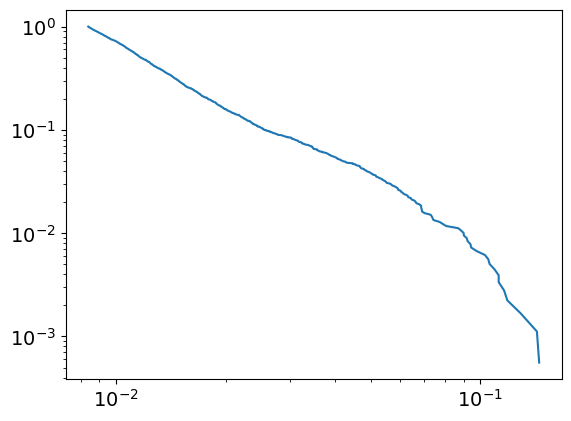

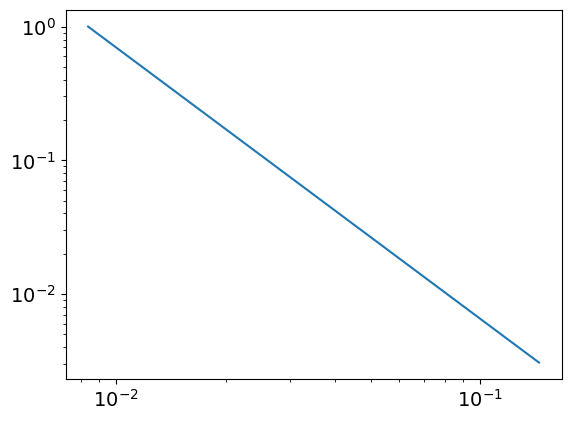

3.029570790005939
0.008383243400385031
powerlaw KstestResult(statistic=0.9986427408799156, pvalue=0.0, statistic_location=0.09440282797351374, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1450975988735395, statistic_sign=1)
tensor(1.5496e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1919, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.5265, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
413
tensor(0.2521, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


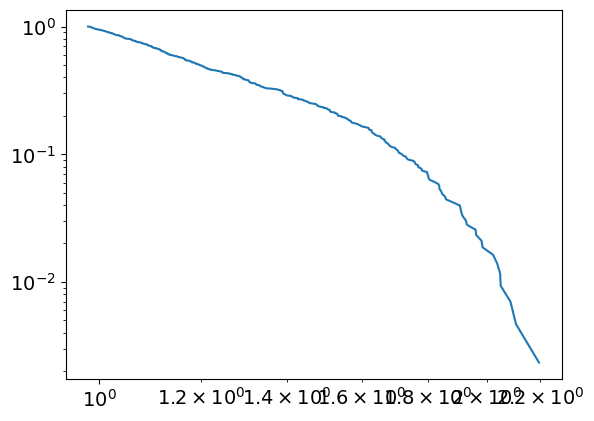

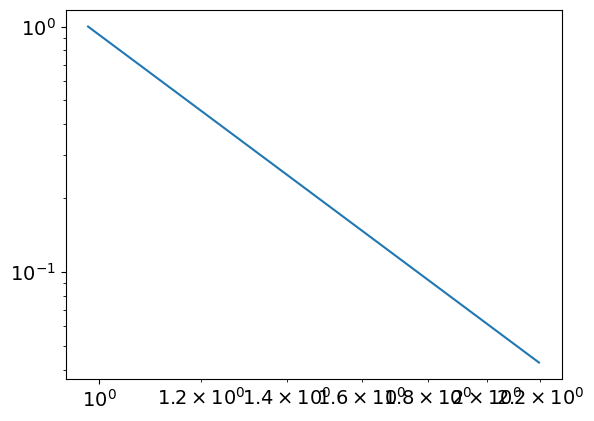

4.906954989930271
0.9802344807503472
powerlaw KstestResult(statistic=0.9760491151395072, pvalue=0.0, statistic_location=1.2945228145601366, statistic_sign=1)
lognorm KstestResult(statistic=0.9765279735765992, pvalue=0.0, statistic_location=1.2484332194549526, statistic_sign=1)
tensor(0.0772, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2199, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5981, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9390, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
414
tensor(5.4722e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


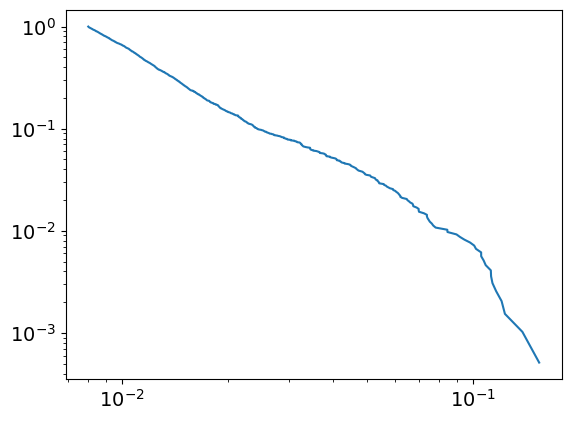

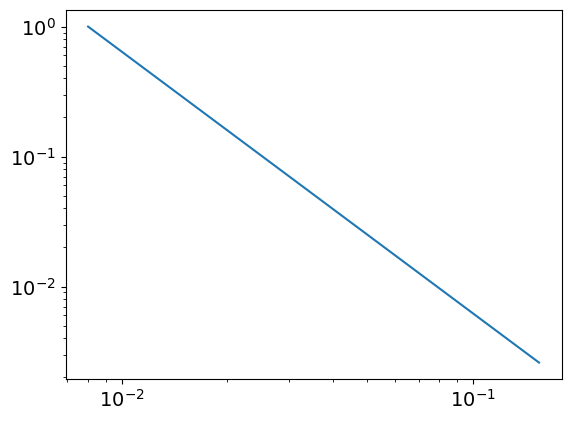

3.0131385259770664
0.008020127296067306
powerlaw KstestResult(statistic=0.9985439799010964, pvalue=0.0, statistic_location=0.10717889737210685, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15424000159627946, statistic_sign=1)
tensor(1.1610e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3134, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2620, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
414
tensor(0.2525, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


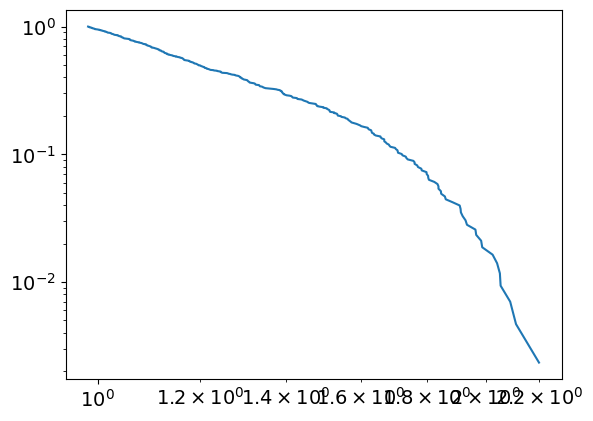

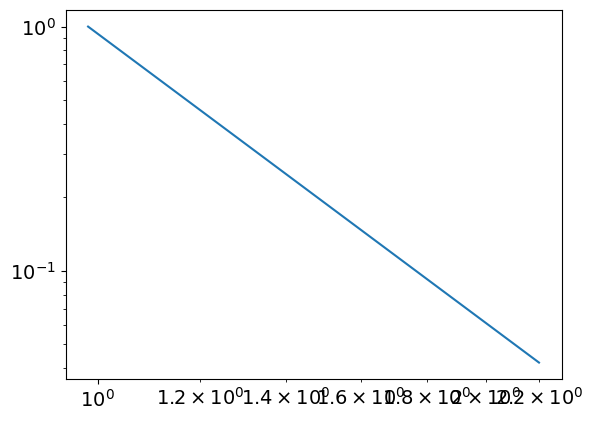

4.9327465888042195
0.9827365799367659
powerlaw KstestResult(statistic=0.9762455221009803, pvalue=0.0, statistic_location=1.297629799036702, statistic_sign=1)
lognorm KstestResult(statistic=0.9764777457801795, pvalue=0.0, statistic_location=1.2492036793750994, statistic_sign=1)
tensor(0.0773, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2200, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6002, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9436, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
415
tensor(5.7046e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


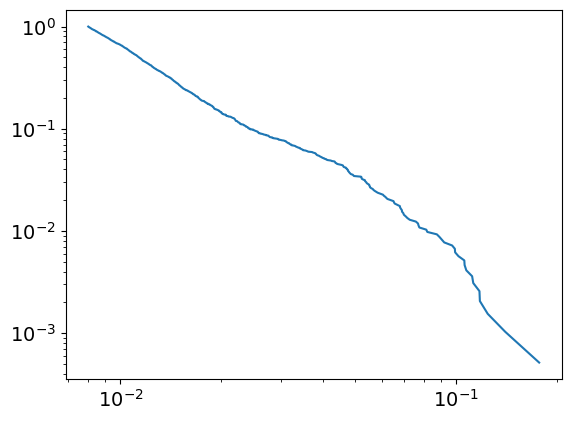

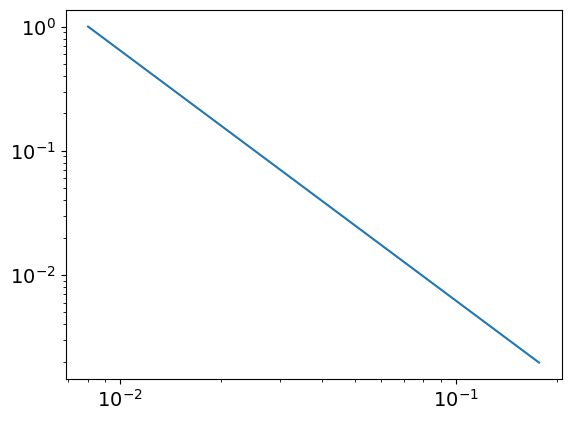

3.0146391105985533
0.008023292414363847
powerlaw KstestResult(statistic=0.9985891769690043, pvalue=0.0, statistic_location=0.08204503543668304, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17669033526719113, statistic_sign=1)
tensor(1.9566e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5139, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.5739, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
415
tensor(0.2529, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


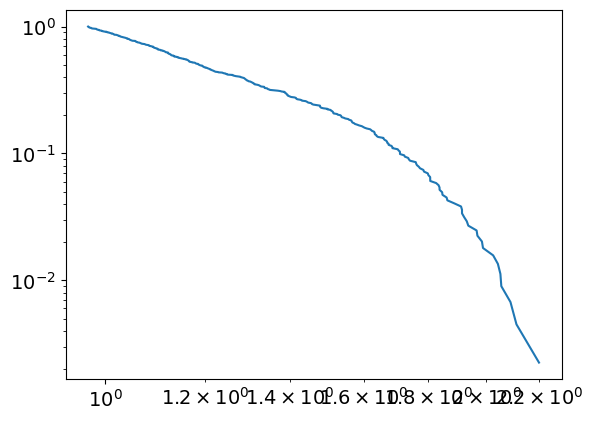

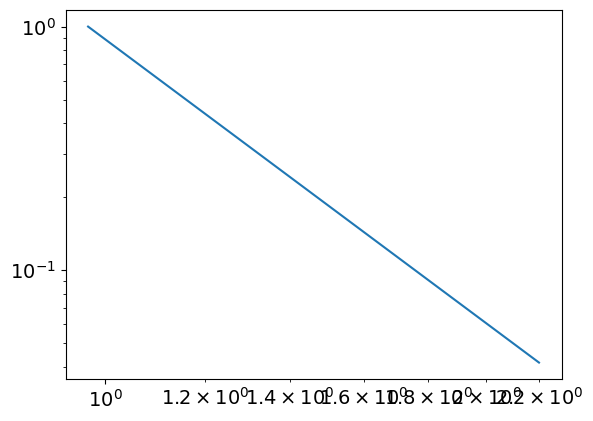

4.8757402822600735
0.9695025482757527
powerlaw KstestResult(statistic=0.9754297730341099, pvalue=0.0, statistic_location=1.2224506601085545, statistic_sign=1)
lognorm KstestResult(statistic=0.9764659776684684, pvalue=0.0, statistic_location=1.2224506601085545, statistic_sign=1)
tensor(0.0774, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2200, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6025, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9484, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
416
tensor(5.8721e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


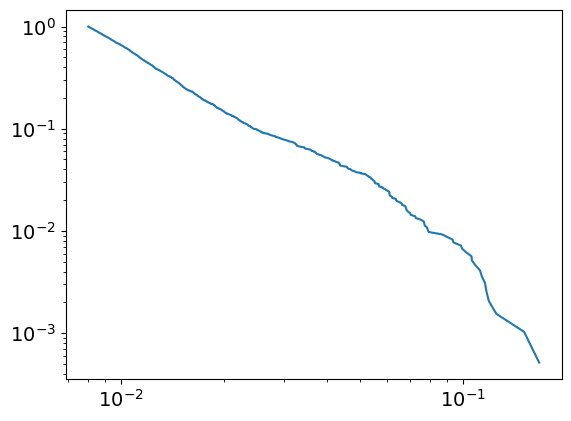

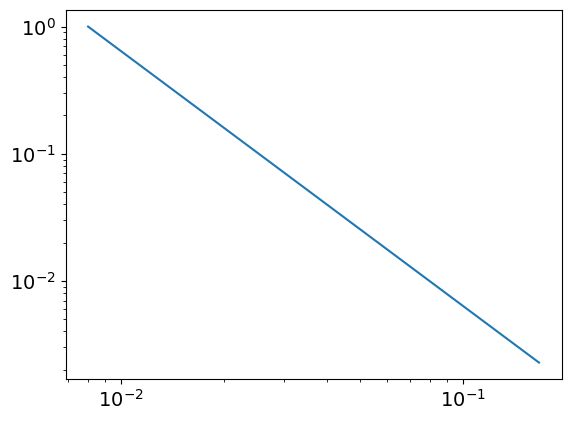

3.003498987854557
0.008019942153356552
powerlaw KstestResult(statistic=0.998626515370655, pvalue=0.0, statistic_location=0.07891731364804752, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16719862418149636, statistic_sign=1)
tensor(1.7516e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4119, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.4538, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
416
tensor(0.2533, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


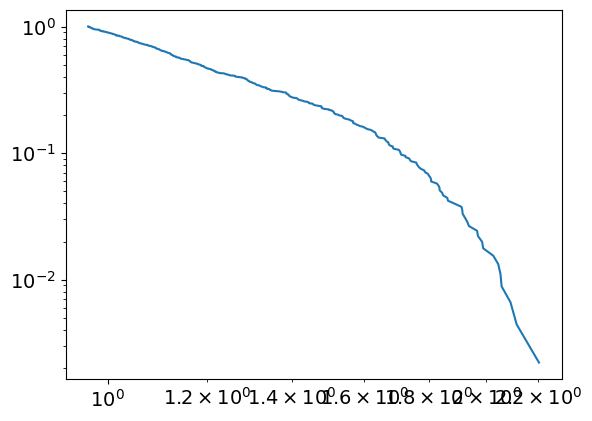

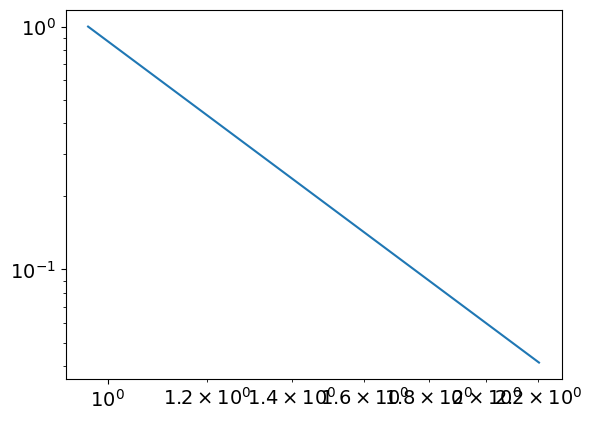

4.858509316929351
0.9646625183816067
powerlaw KstestResult(statistic=0.9752916169239728, pvalue=0.0, statistic_location=1.2219635128608792, statistic_sign=1)
lognorm KstestResult(statistic=0.9764692186435668, pvalue=0.0, statistic_location=1.2219635128608792, statistic_sign=1)
tensor(0.0774, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2200, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6047, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9533, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
417
tensor(6.8012e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


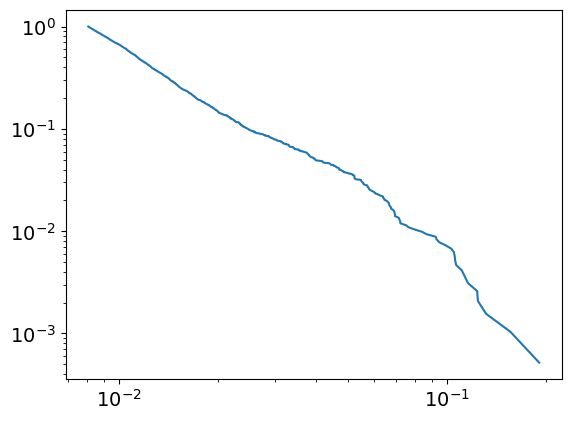

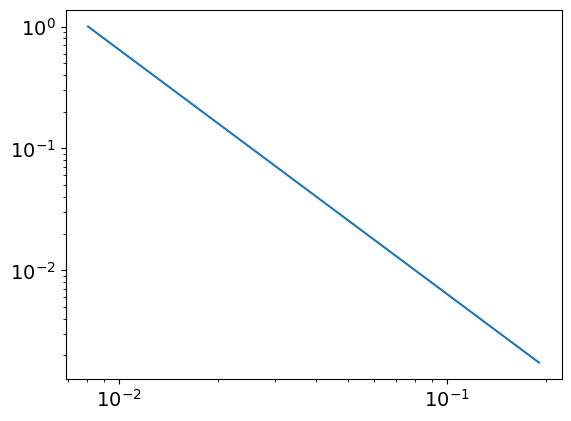

3.0068219807338252
0.008062933602874757
powerlaw KstestResult(statistic=0.9985568721040435, pvalue=0.0, statistic_location=0.07505546400402392, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19104123762583342, statistic_sign=1)
tensor(4.3411e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5036, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.7537, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
417
tensor(0.2537, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


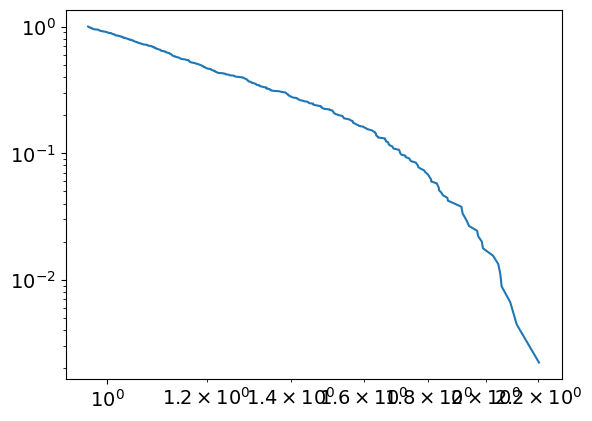

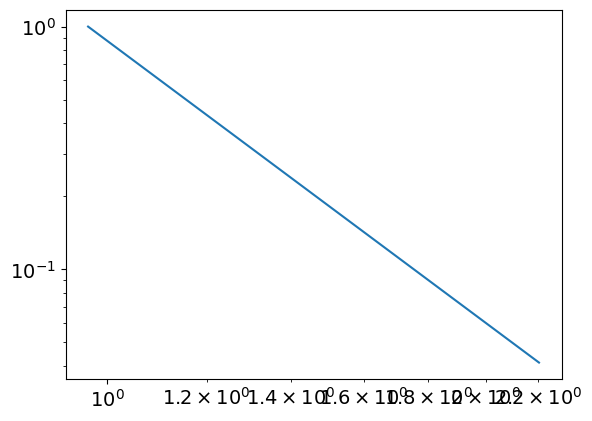

4.861466184407991
0.9657146558948694
powerlaw KstestResult(statistic=0.9753218478730435, pvalue=0.0, statistic_location=1.2220459323247297, statistic_sign=1)
lognorm KstestResult(statistic=0.976465221798158, pvalue=0.0, statistic_location=1.2220459323247297, statistic_sign=1)
tensor(0.0776, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2201, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6069, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9580, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
418
tensor(7.5696e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


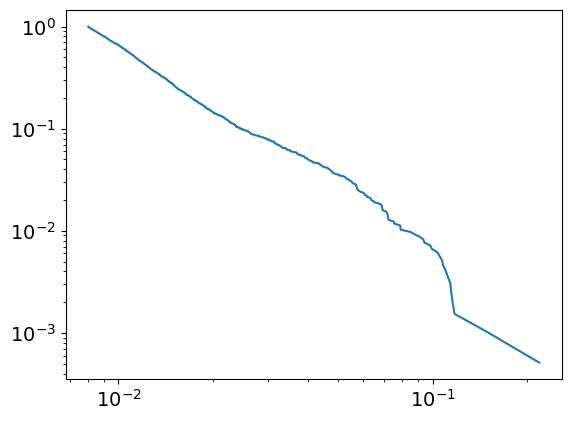

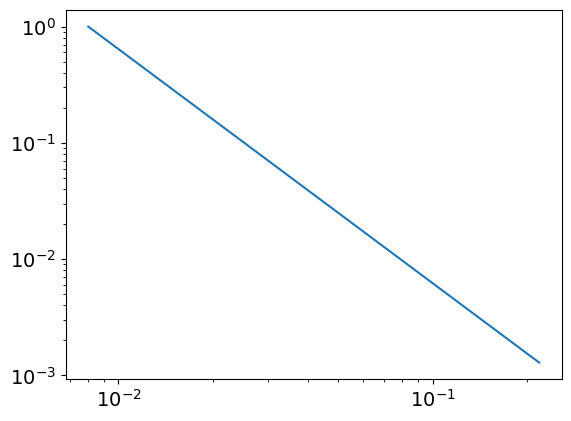

3.014846053011168
0.008016418944872167
powerlaw KstestResult(statistic=0.9985954415397503, pvalue=0.0, statistic_location=0.10988629230571957, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21827823572422853, statistic_sign=1)
tensor(3.1265e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9006, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.5056, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
418
tensor(0.2542, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


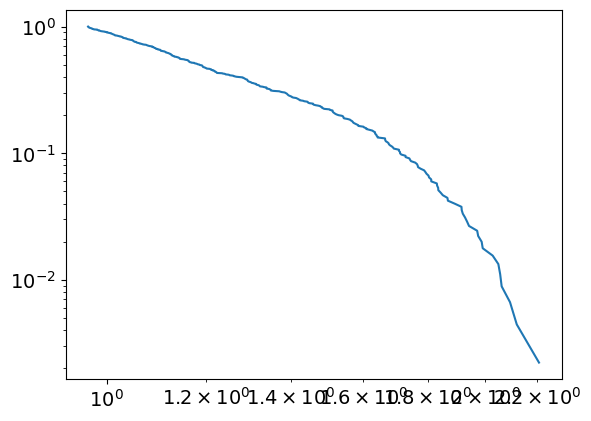

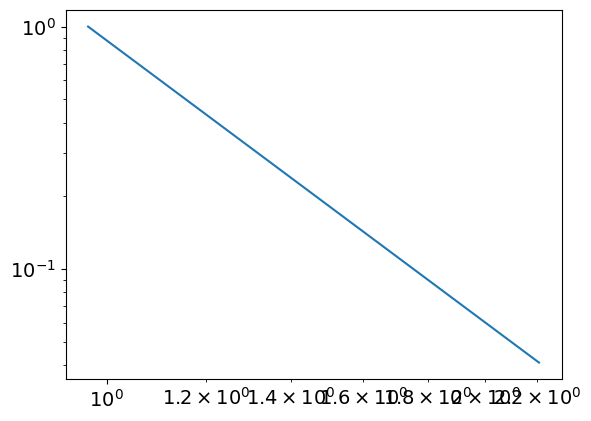

4.869249679294626
0.9664824633406065
powerlaw KstestResult(statistic=0.9753435315447743, pvalue=0.0, statistic_location=1.2225104857187064, statistic_sign=1)
lognorm KstestResult(statistic=0.9764563018662622, pvalue=0.0, statistic_location=1.2225104857187064, statistic_sign=1)
tensor(0.0777, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2202, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6091, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9629, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
419
tensor(6.5206e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


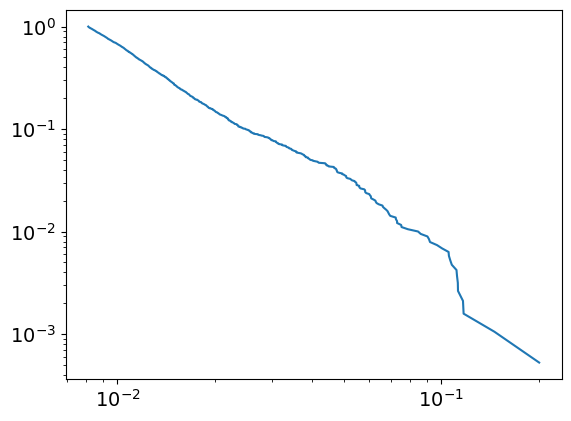

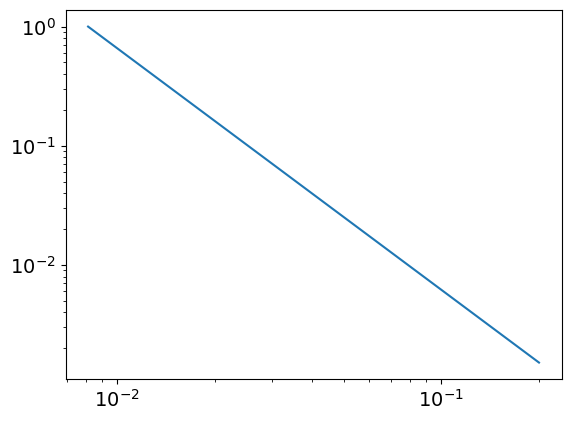

3.0247514090588195
0.008128317720956792
powerlaw KstestResult(statistic=0.9985908697332367, pvalue=0.0, statistic_location=0.10650311678692803, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2004710323511644, statistic_sign=1)
tensor(3.0109e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7424, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.1589, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
419
tensor(0.2546, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


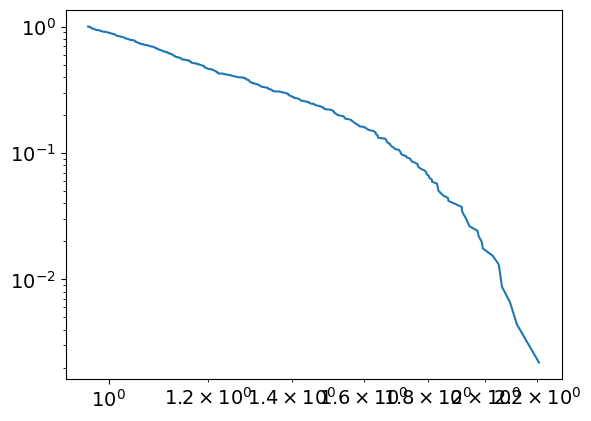

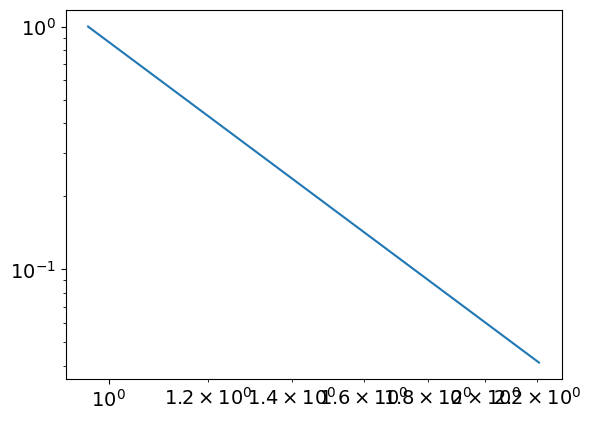

4.83937373582006
0.9625568402395513
powerlaw KstestResult(statistic=0.9751631636179322, pvalue=0.0, statistic_location=1.2232758006230142, statistic_sign=1)
lognorm KstestResult(statistic=0.9764431331264941, pvalue=0.0, statistic_location=1.2232758006230142, statistic_sign=1)
tensor(0.0778, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2202, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6114, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9677, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
420
tensor(5.6768e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


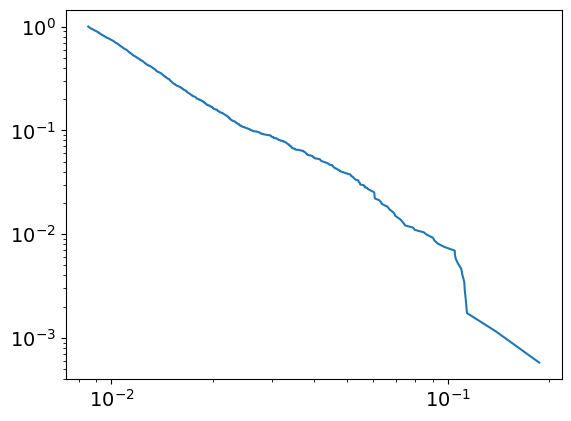

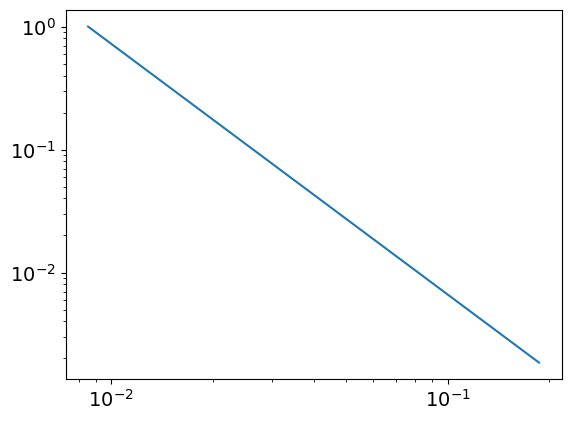

3.039860156482043
0.008537952213236555
powerlaw KstestResult(statistic=0.9987043882556729, pvalue=0.0, statistic_location=0.11295846662545991, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18657358352311637, statistic_sign=1)
tensor(2.1519e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5690, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.0173, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
420
tensor(0.2550, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


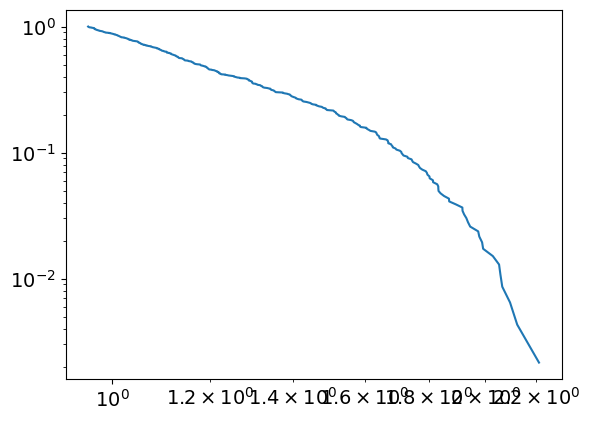

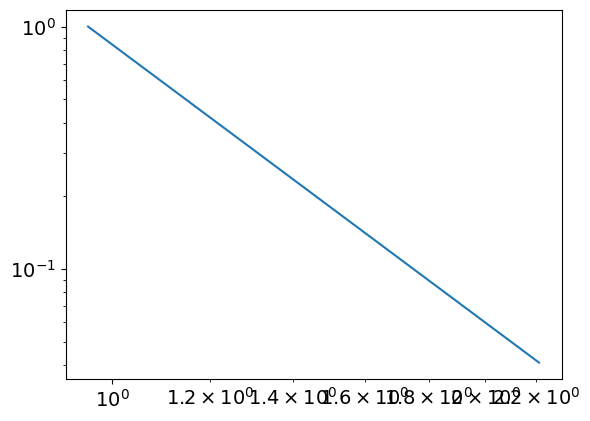

4.8116609002490485
0.9560376319430333
powerlaw KstestResult(statistic=0.974860417055454, pvalue=0.0, statistic_location=1.2248532330737867, statistic_sign=1)
lognorm KstestResult(statistic=0.976416863986931, pvalue=0.0, statistic_location=1.2248532330737867, statistic_sign=1)
tensor(0.0779, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2202, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6136, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9727, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
421
tensor(5.3365e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


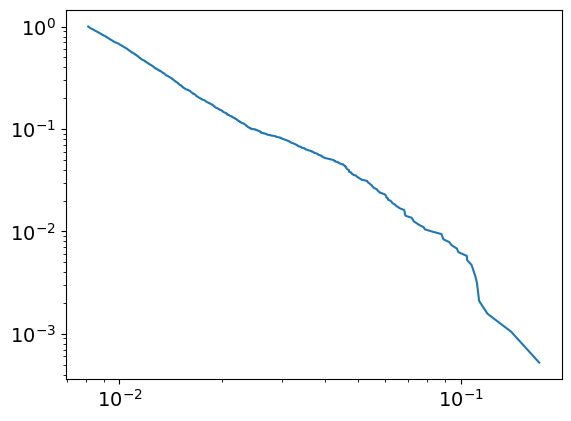

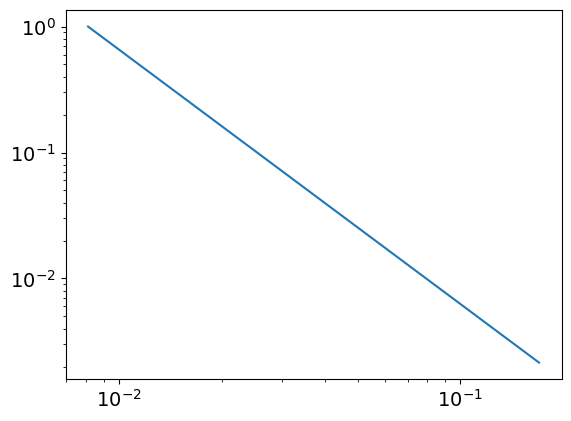

3.0177757803612253
0.008102157261797752
powerlaw KstestResult(statistic=0.9986539362340567, pvalue=0.0, statistic_location=0.07799508267628685, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17006117994025377, statistic_sign=1)
tensor(1.0812e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3724, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.0377, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
421
tensor(0.2554, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


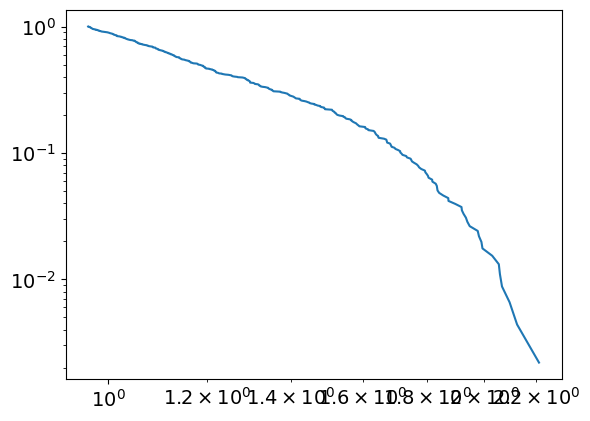

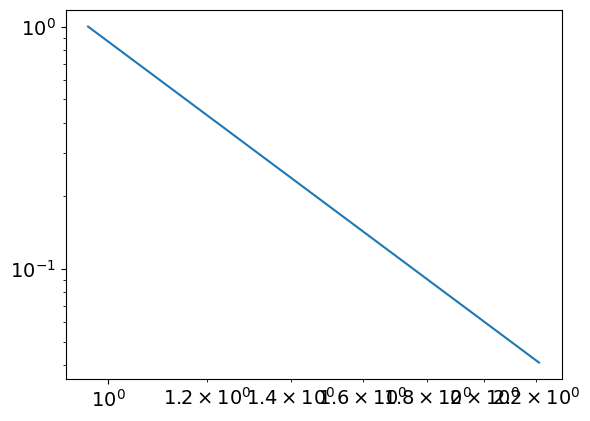

4.842098038729381
0.9632079766605179
powerlaw KstestResult(statistic=0.9750982673622893, pvalue=0.0, statistic_location=1.2264240223724168, statistic_sign=1)
lognorm KstestResult(statistic=0.9763880032362762, pvalue=0.0, statistic_location=1.2264240223724168, statistic_sign=1)
tensor(0.0780, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2203, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6159, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9775, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
422
tensor(5.0087e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


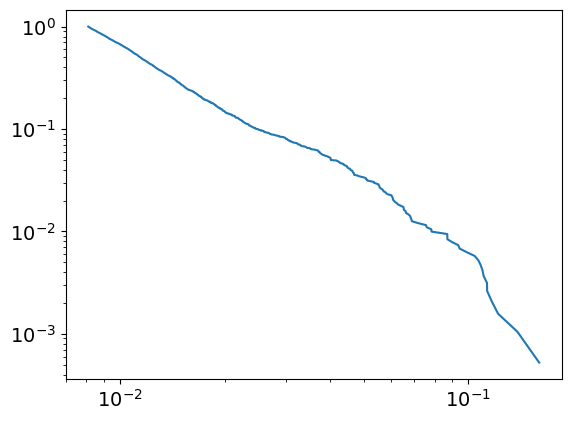

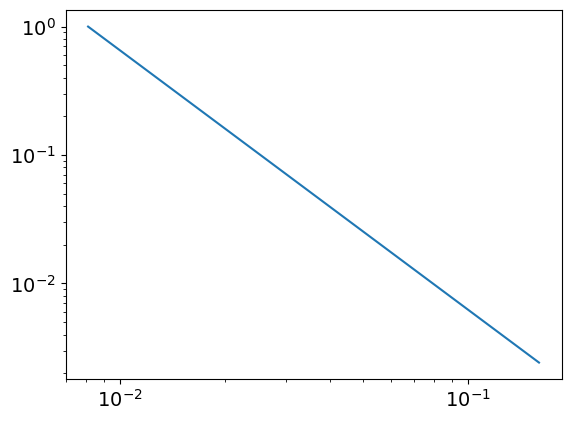

3.02053805179089
0.008098868256387092
powerlaw KstestResult(statistic=0.9986505534415601, pvalue=0.0, statistic_location=0.07840218528369905, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15970131242669902, statistic_sign=1)
tensor(3.3643e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2451, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.7979, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
422
tensor(0.2558, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


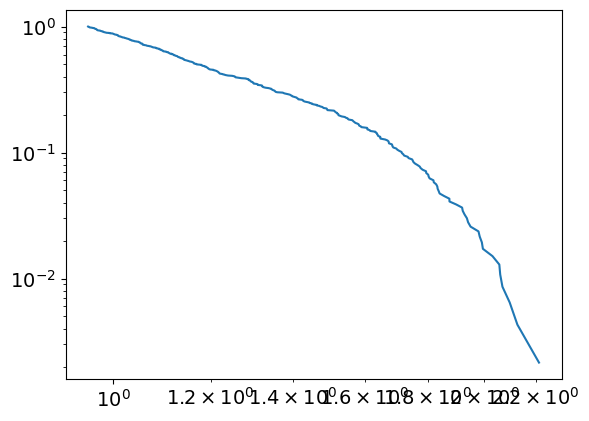

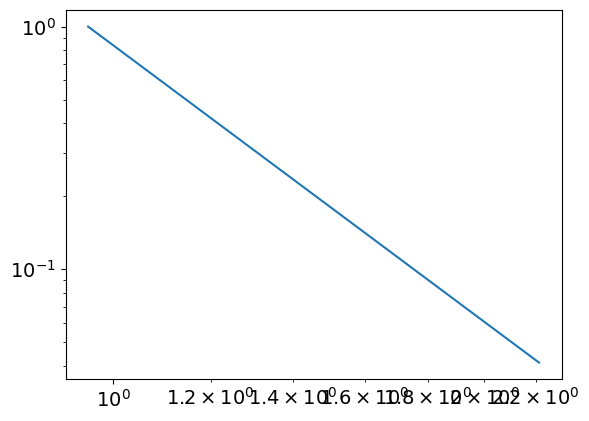

4.792065129944144
0.9546682586358491
powerlaw KstestResult(statistic=0.9746585641590526, pvalue=0.0, statistic_location=1.2280473920882373, statistic_sign=1)
lognorm KstestResult(statistic=0.9763822058635443, pvalue=0.0, statistic_location=1.2327408752525093, statistic_sign=1)
tensor(0.0781, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2203, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6181, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9822, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
423
tensor(5.0861e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


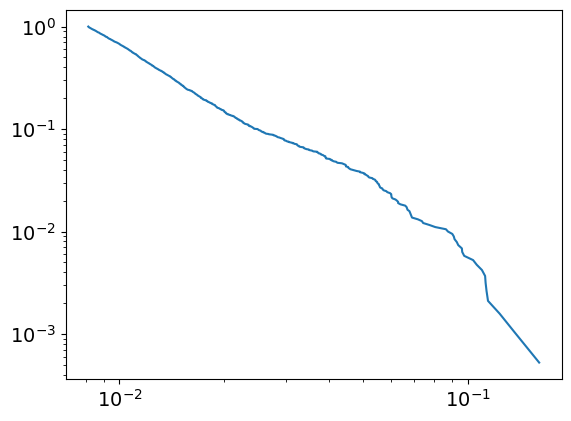

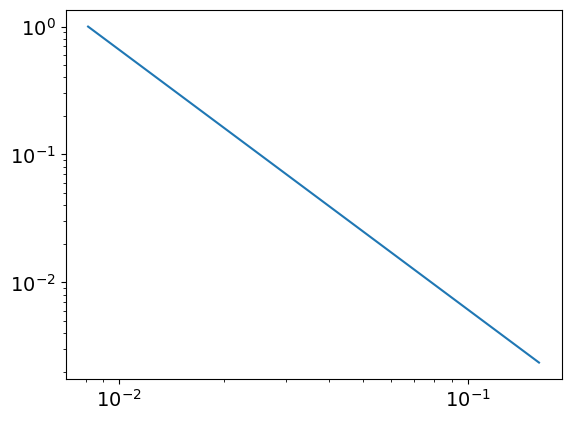

3.031742180671045
0.00813676455320938
powerlaw KstestResult(statistic=0.9986729835022564, pvalue=0.0, statistic_location=0.1129504676554022, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.159907283878505, statistic_sign=1)
tensor(1.4800e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2658, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.7901, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
423
tensor(0.2562, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


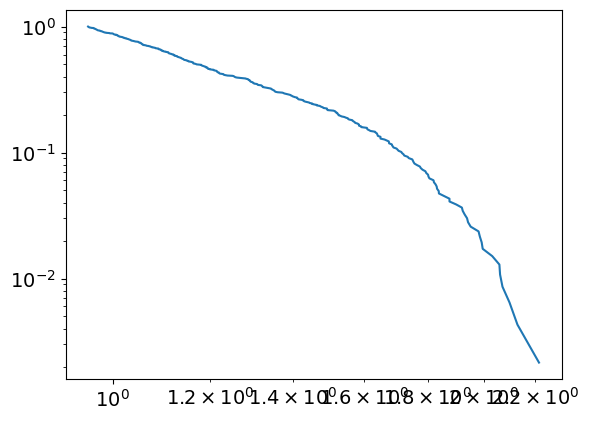

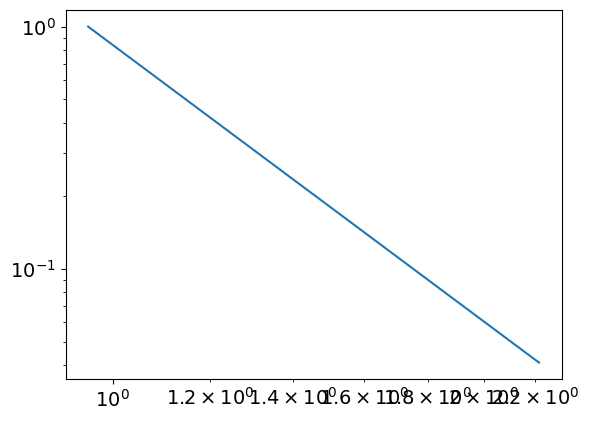

4.796076486210817
0.9551567168354481
powerlaw KstestResult(statistic=0.9746694701198947, pvalue=0.0, statistic_location=1.2320869664639995, statistic_sign=1)
lognorm KstestResult(statistic=0.9763926903399562, pvalue=0.0, statistic_location=1.2320869664639995, statistic_sign=1)
tensor(0.0782, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2204, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6203, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9872, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
424
tensor(4.7746e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


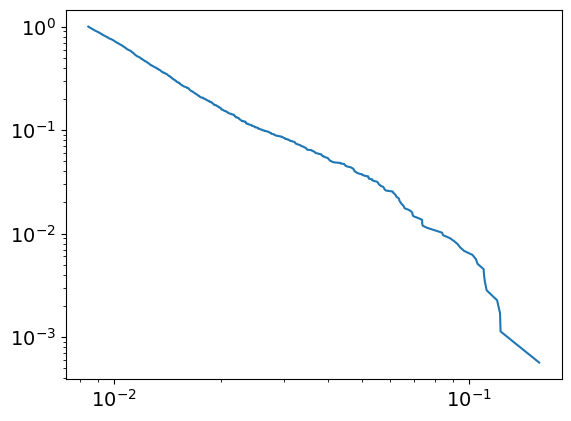

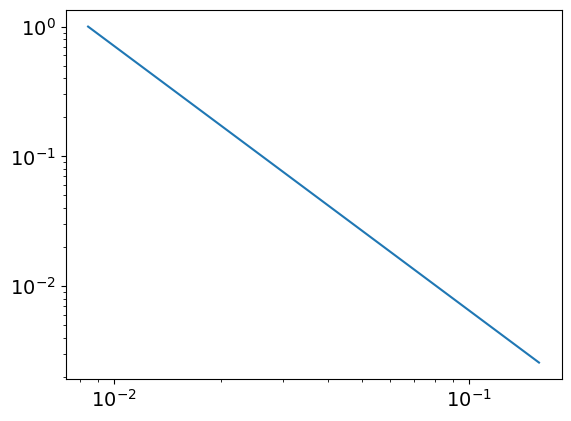

3.0380925194631385
0.008446523078823077
powerlaw KstestResult(statistic=0.9987603323947457, pvalue=0.0, statistic_location=0.11085001093283596, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1576055208577509, statistic_sign=1)
tensor(2.4837e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1691, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.5811, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
424
tensor(0.2566, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


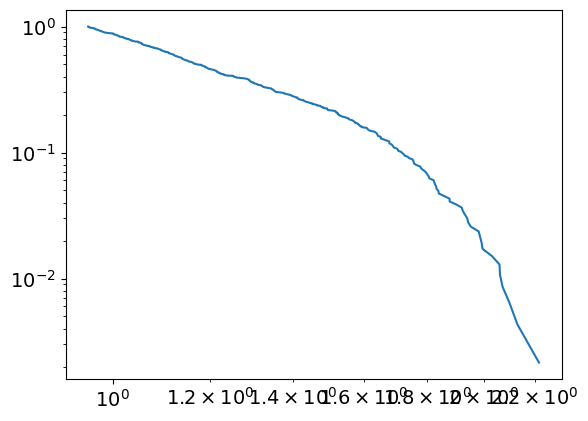

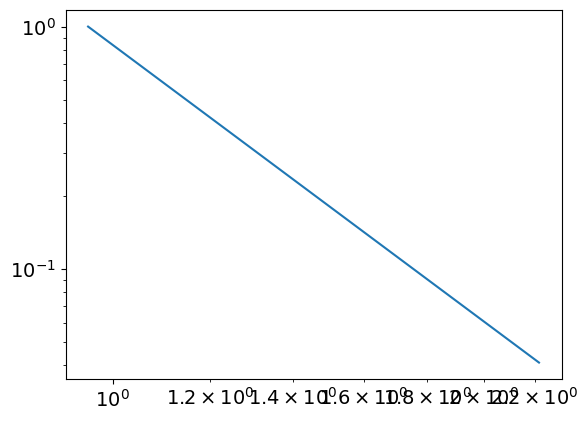

4.787868255700587
0.954865773995286
powerlaw KstestResult(statistic=0.9746542931462956, pvalue=0.0, statistic_location=1.2315998292607966, statistic_sign=1)
lognorm KstestResult(statistic=0.9763988691950284, pvalue=0.0, statistic_location=1.2315998292607966, statistic_sign=1)
tensor(0.0783, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2204, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6226, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9920, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
425
tensor(6.0460e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


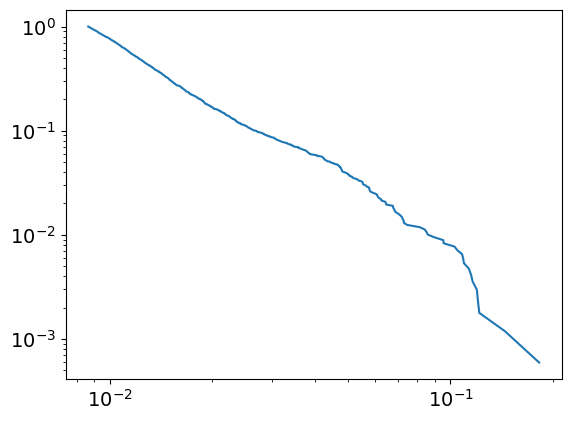

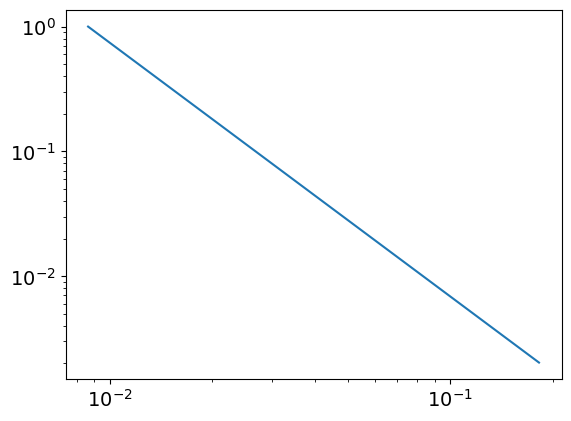

3.03463906662616
0.008649520667500505
powerlaw KstestResult(statistic=0.9987180047709905, pvalue=0.0, statistic_location=0.07464322888572329, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.182175280324107, statistic_sign=1)
tensor(1.4802e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0585, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.1290, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
425
tensor(0.2571, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


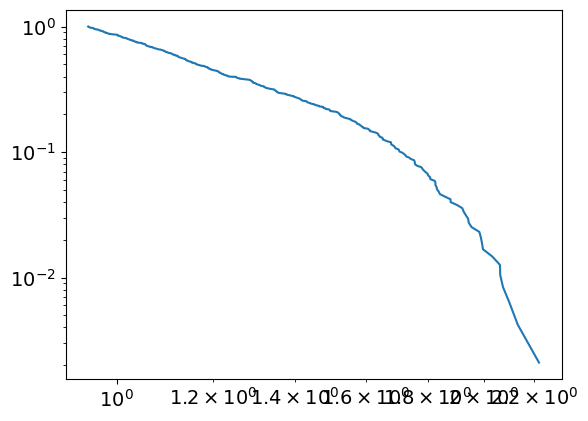

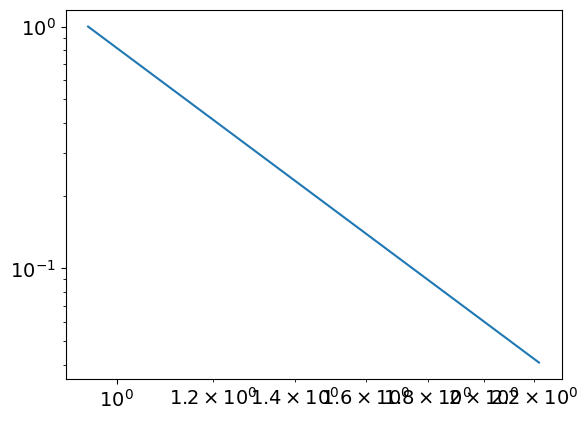

4.756259543827277
0.9470817178103983
powerlaw KstestResult(statistic=0.9741600796449923, pvalue=0.0, statistic_location=1.2337607613304595, statistic_sign=1)
lognorm KstestResult(statistic=0.9763563902145924, pvalue=0.0, statistic_location=1.2375347430185057, statistic_sign=1)
tensor(0.0784, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2205, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6248, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.9968, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
426
tensor(5.3052e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


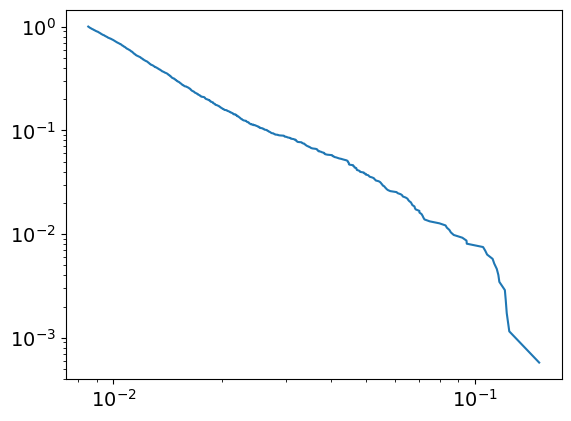

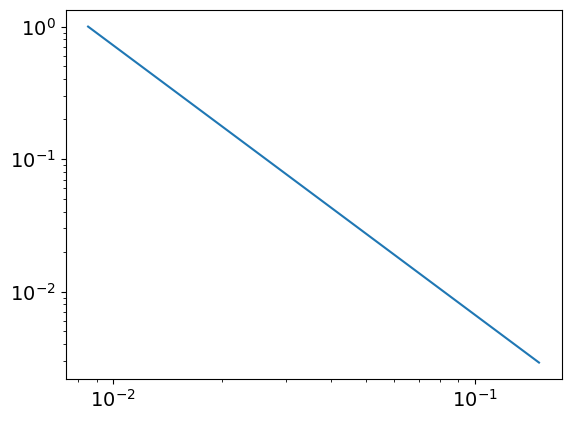

3.032761625643295
0.008517269145239032
powerlaw KstestResult(statistic=0.9986222060852894, pvalue=0.0, statistic_location=0.11502352487857159, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1506878915582715, statistic_sign=1)
tensor(2.5910e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.1081, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2489, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
426
tensor(0.2574, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


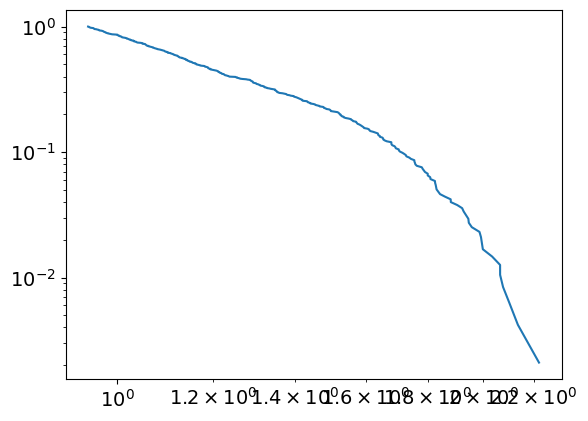

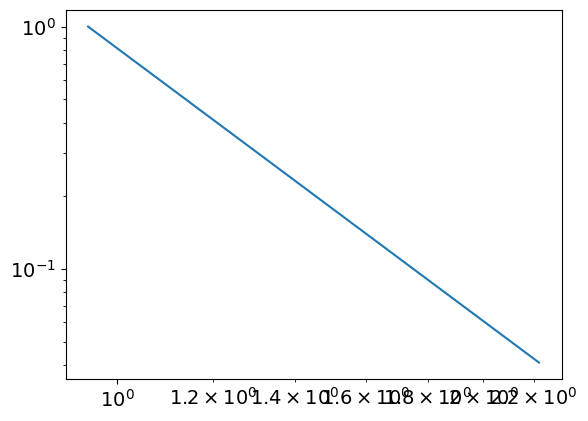

4.745085786807091
0.946470768479786
powerlaw KstestResult(statistic=0.9740897616166694, pvalue=0.0, statistic_location=1.2367179829593065, statistic_sign=1)
lognorm KstestResult(statistic=0.9763757442131041, pvalue=0.0, statistic_location=1.2367179829593065, statistic_sign=1)
tensor(0.0785, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2205, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6271, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0017, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
427
tensor(5.1670e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


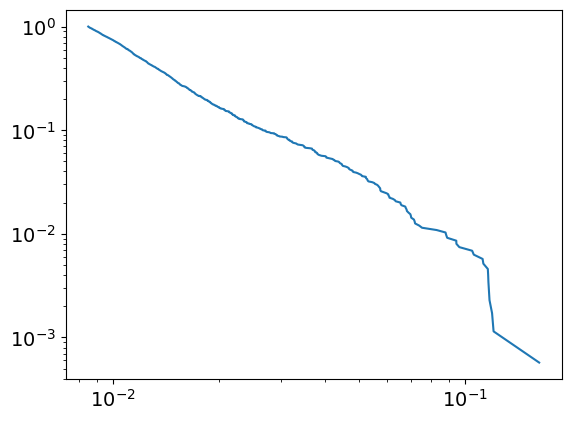

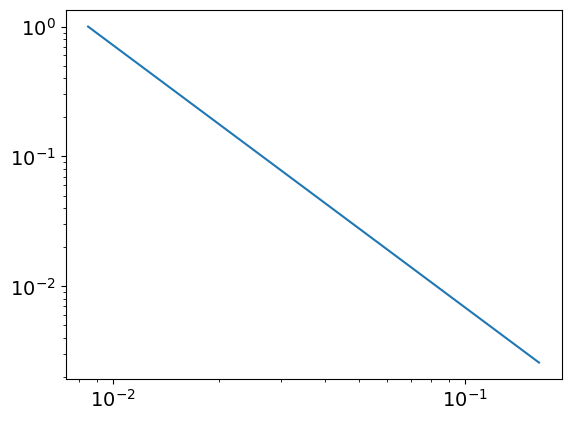

3.0217285401629606
0.008511392562180165
powerlaw KstestResult(statistic=0.9987405310448759, pvalue=0.0, statistic_location=0.07182784151241342, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16206951144620163, statistic_sign=1)
tensor(1.2580e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0579, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.9531, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
427
tensor(0.2578, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


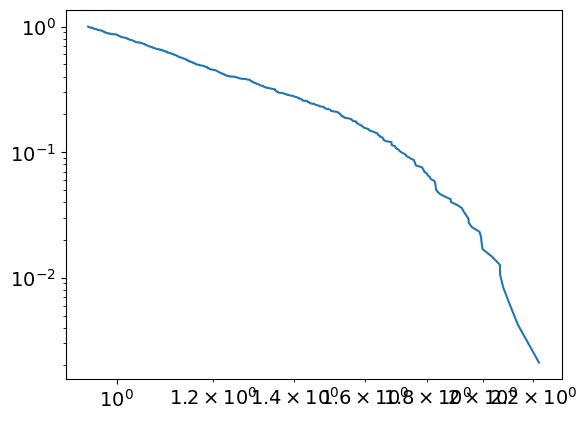

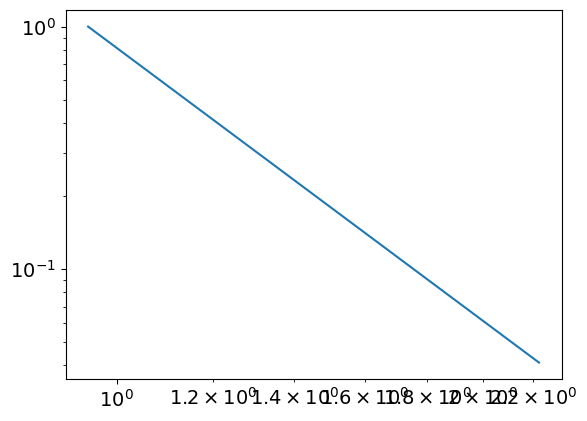

4.741158648959093
0.9475079299339385
powerlaw KstestResult(statistic=0.9740702222747447, pvalue=0.0, statistic_location=1.2378799626395771, statistic_sign=1)
lognorm KstestResult(statistic=0.9763303749232904, pvalue=0.0, statistic_location=1.2378799626395771, statistic_sign=1)
tensor(0.0786, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2206, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6293, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0068, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
428
tensor(5.8192e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


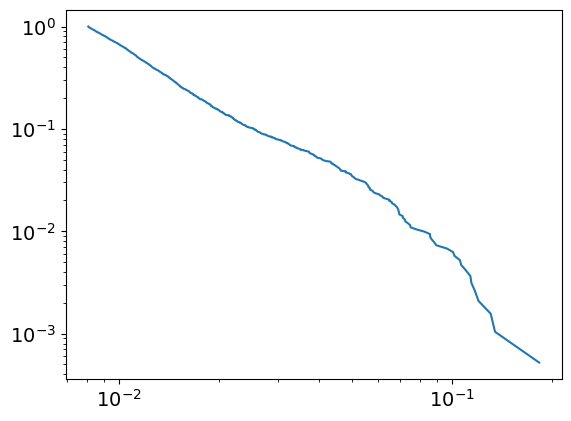

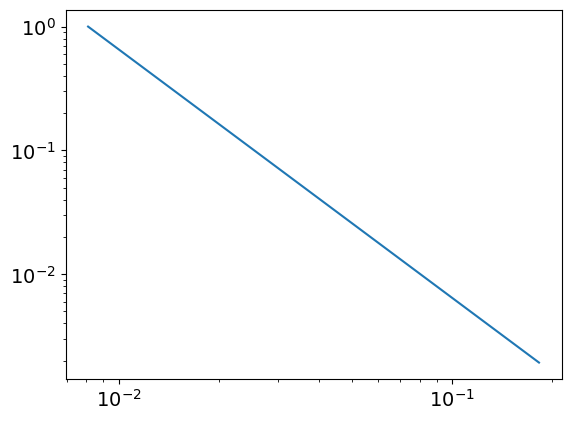

3.006205552435474
0.00809570687154568
powerlaw KstestResult(statistic=0.9987025928293132, pvalue=0.0, statistic_location=0.07365092590915069, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13058625440931973, statistic_sign=-1)
tensor(-4.5136e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2030, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.2497, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
428
tensor(0.2583, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


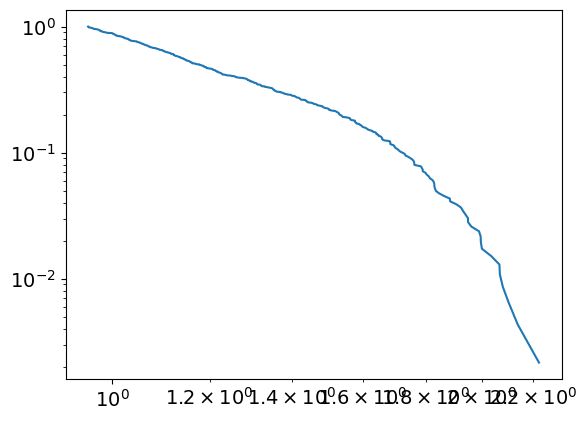

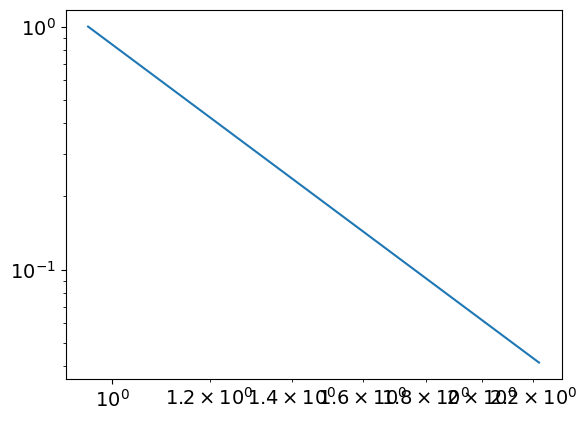

4.764373611568818
0.9552998590055202
powerlaw KstestResult(statistic=0.9744496910566709, pvalue=0.0, statistic_location=1.2289057915043438, statistic_sign=1)
lognorm KstestResult(statistic=0.9762469590796545, pvalue=0.0, statistic_location=1.2399852292011828, statistic_sign=1)
tensor(0.0787, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2206, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6316, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0117, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
429
tensor(6.3894e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


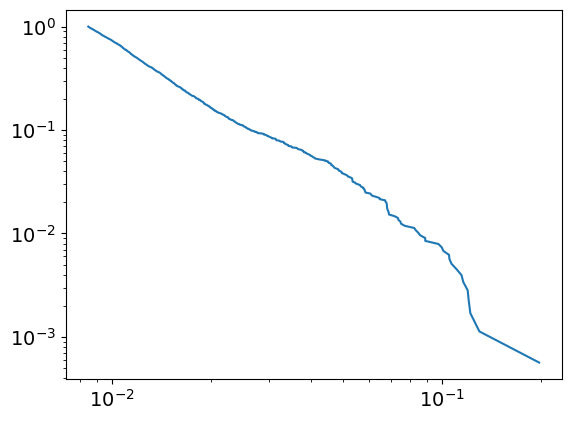

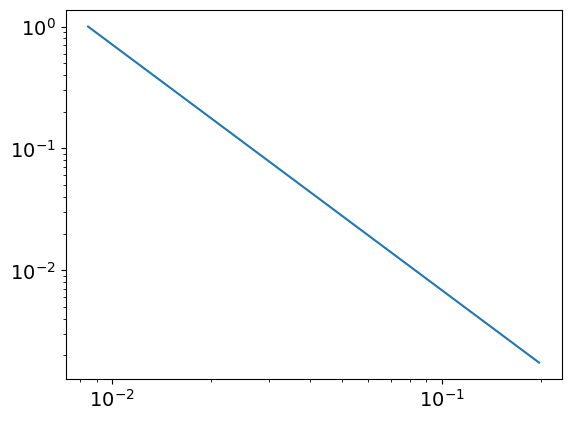

3.0153919776205647
0.008453098405080009
powerlaw KstestResult(statistic=0.9986019344809414, pvalue=0.0, statistic_location=0.08913309278356742, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19758307756247082, statistic_sign=1)
tensor(1.6314e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4617, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.0947, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
429
tensor(0.2587, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


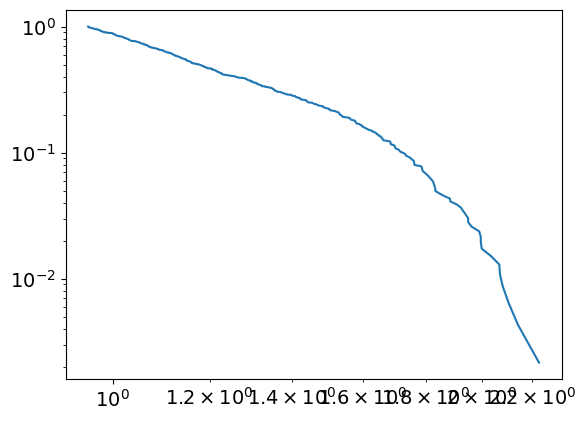

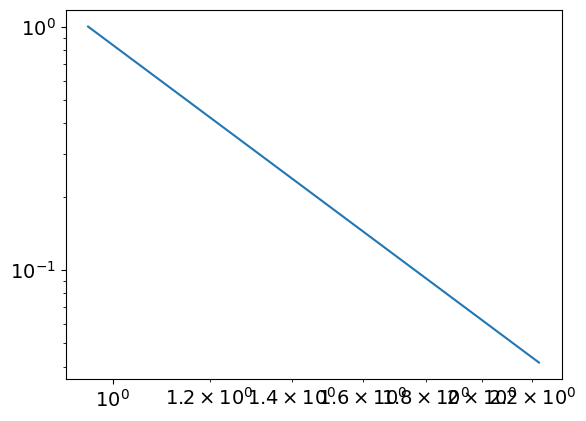

4.756560578178426
0.9549782034321057
powerlaw KstestResult(statistic=0.9743752068180035, pvalue=0.0, statistic_location=1.230028392713273, statistic_sign=1)
lognorm KstestResult(statistic=0.9761655595905017, pvalue=0.0, statistic_location=1.234532919598247, statistic_sign=1)
tensor(0.0788, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2207, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6338, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0166, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
430
tensor(6.7724e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


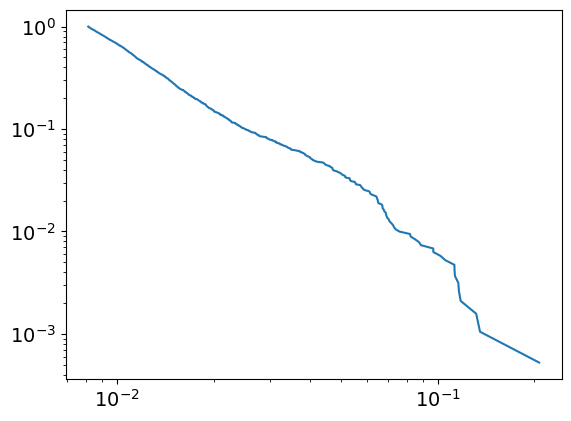

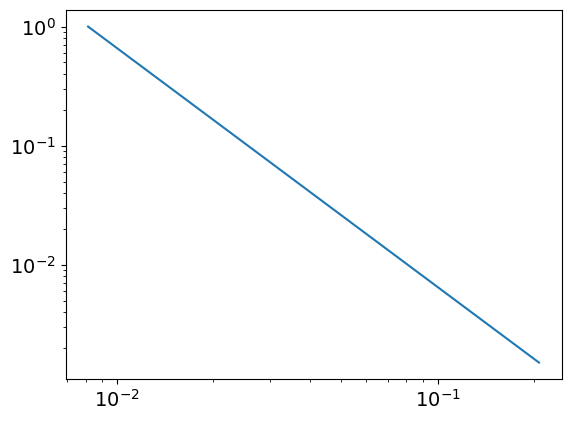

3.0054865394230186
0.00812636898759522
powerlaw KstestResult(statistic=0.9987189923996931, pvalue=0.0, statistic_location=0.08868893790922203, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20729869013317567, statistic_sign=1)
tensor(4.2365e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6504, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.6475, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
430
tensor(0.2591, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


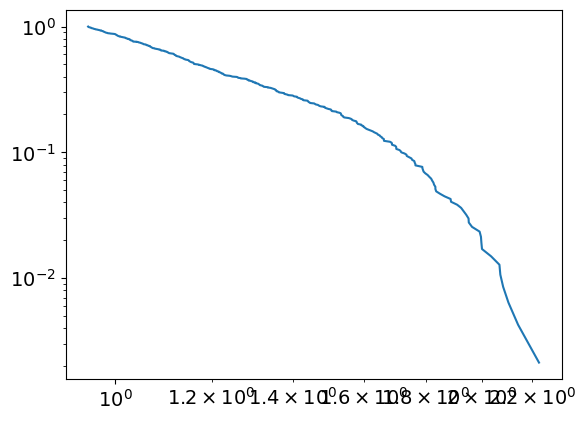

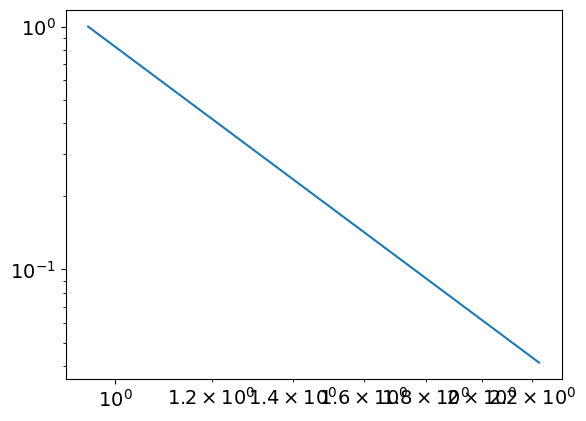

4.732273596085388
0.9496873243248058
powerlaw KstestResult(statistic=0.974069110835334, pvalue=0.0, statistic_location=1.2337133086525613, statistic_sign=1)
lognorm KstestResult(statistic=0.9761824787675101, pvalue=0.0, statistic_location=1.2337133086525613, statistic_sign=1)
tensor(0.0789, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2207, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6361, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0216, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
431
tensor(9.4417e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


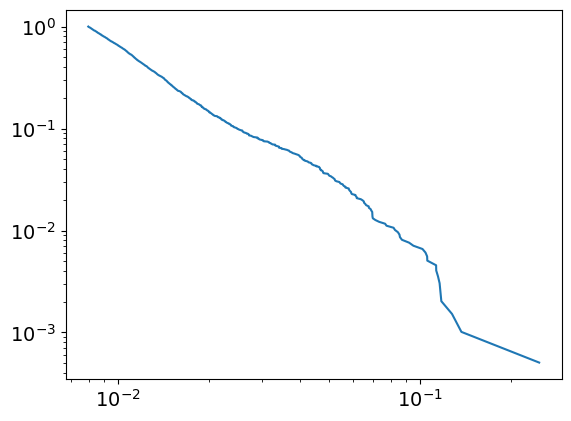

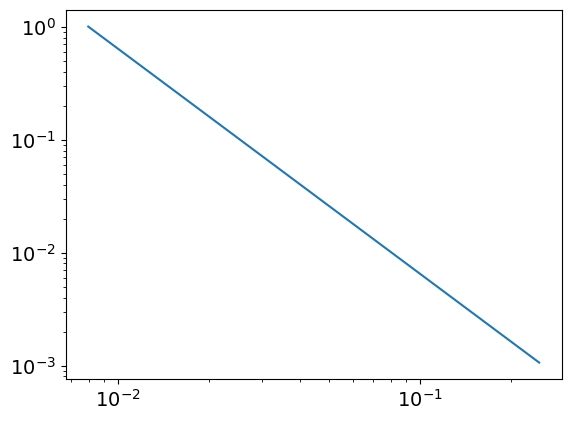

2.992577982526168
0.007971794192216778
powerlaw KstestResult(statistic=0.9985044701501664, pvalue=0.0, statistic_location=0.09192395718193777, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.24777780103873867, statistic_sign=1)
tensor(7.0875e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3004, device='cuda:0', grad_fn=<MeanBackward0>) tensor(55.2569, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
431
tensor(0.2595, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


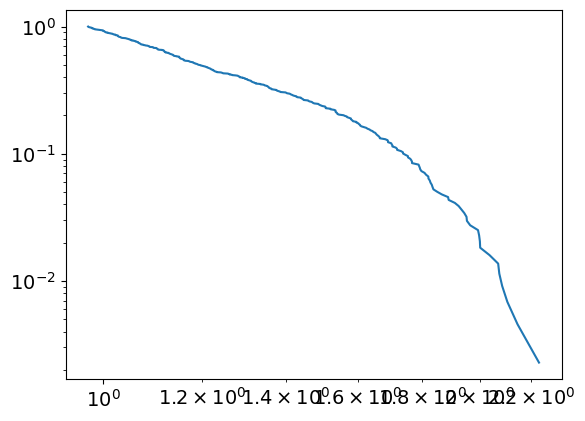

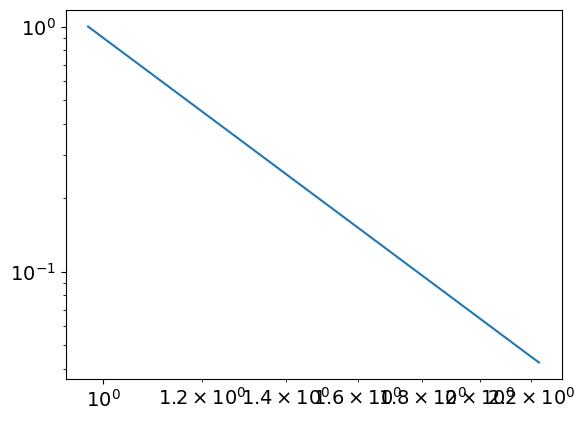

4.802358875170875
0.9728313752488242
powerlaw KstestResult(statistic=0.9750911330057512, pvalue=0.0, statistic_location=1.233403619344303, statistic_sign=1)
lognorm KstestResult(statistic=0.9761848553807939, pvalue=0.0, statistic_location=1.233403619344303, statistic_sign=1)
tensor(0.0790, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2208, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6383, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0266, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
432
tensor(9.9963e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


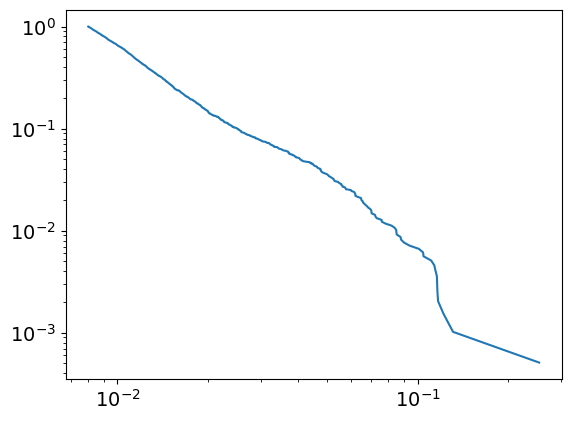

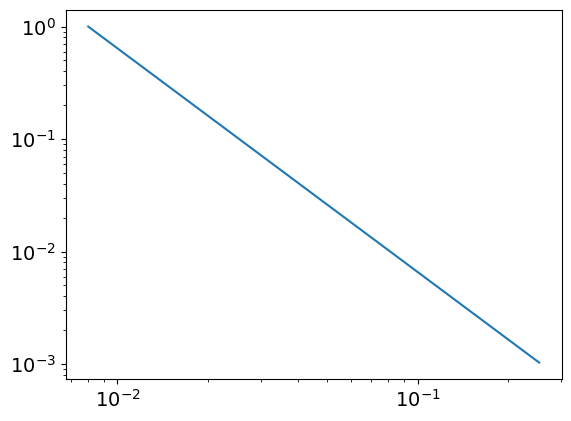

2.9878670310766564
0.007996288941585638
powerlaw KstestResult(statistic=0.99853559662045, pvalue=0.0, statistic_location=0.09015006433870519, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.25431856189710744, statistic_sign=1)
tensor(6.0983e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3919, device='cuda:0', grad_fn=<MeanBackward0>) tensor(57.5452, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
432
tensor(0.2599, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


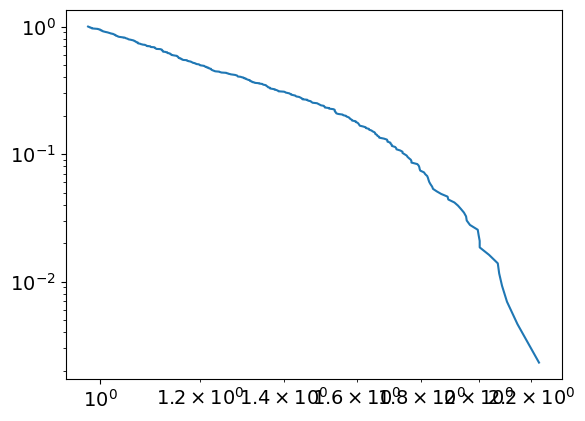

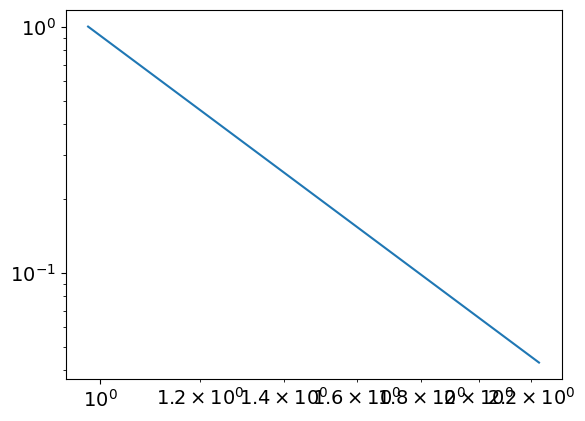

4.806616432285715
0.9775115575137748
powerlaw KstestResult(statistic=0.9751847844044335, pvalue=0.0, statistic_location=1.235071053967414, statistic_sign=1)
lognorm KstestResult(statistic=0.9761293157234296, pvalue=0.0, statistic_location=1.235071053967414, statistic_sign=1)
tensor(0.0791, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2208, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6406, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0316, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
433
tensor(7.7322e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


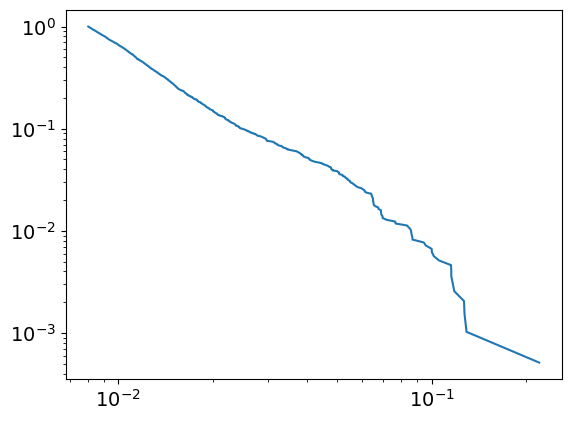

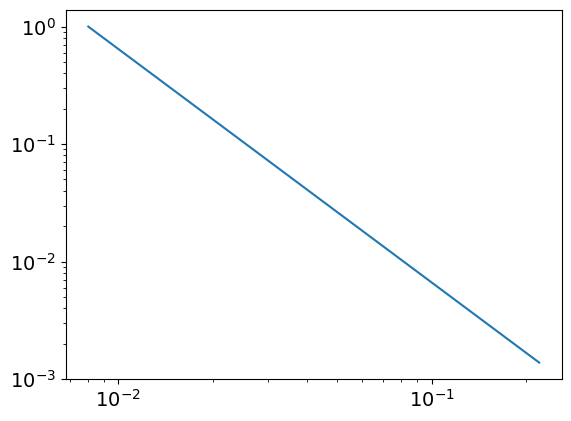

2.9880183312554127
0.008017644706558297
powerlaw KstestResult(statistic=0.9984758399085331, pvalue=0.0, statistic_location=0.08678222713740516, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22007927021839438, statistic_sign=1)
tensor(6.0638e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0412, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.0530, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
433
tensor(0.2603, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


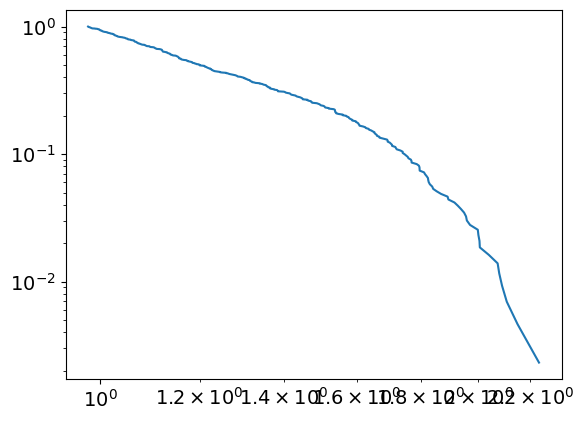

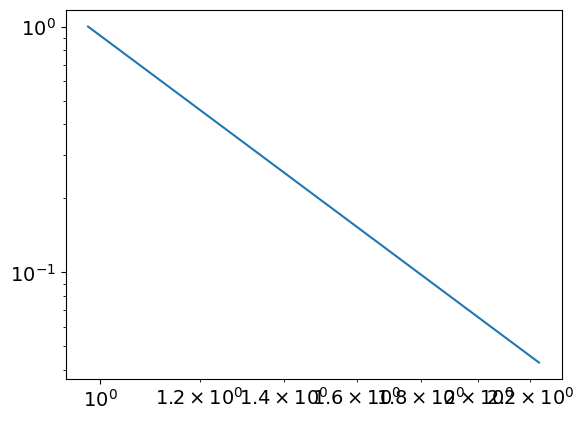

4.809209749745635
0.9779753962408615
powerlaw KstestResult(statistic=0.9751563137969483, pvalue=0.0, statistic_location=1.2367511546029752, statistic_sign=1)
lognorm KstestResult(statistic=0.9760719042556436, pvalue=0.0, statistic_location=1.232396497317752, statistic_sign=1)
tensor(0.0792, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2208, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6429, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0365, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
434
tensor(6.6453e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


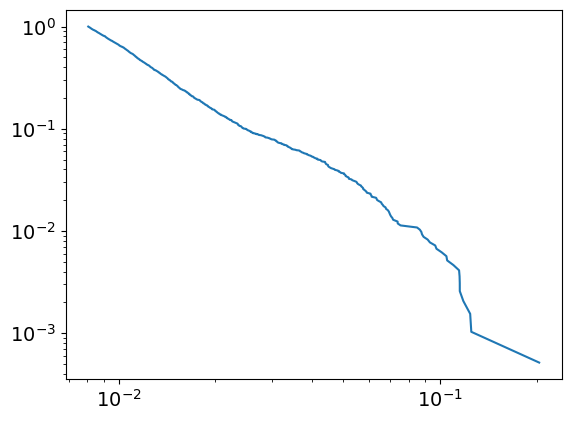

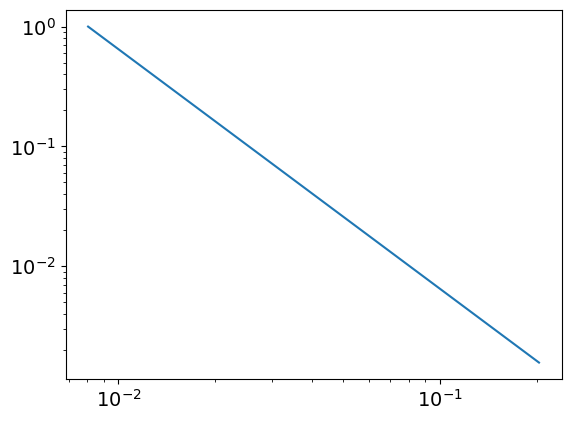

3.000725679726862
0.00804451574618559
powerlaw KstestResult(statistic=0.9985192524708014, pvalue=0.0, statistic_location=0.11511990662977854, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2033001480092577, statistic_sign=1)
tensor(5.3269e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7382, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.0203, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
434
tensor(0.2608, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


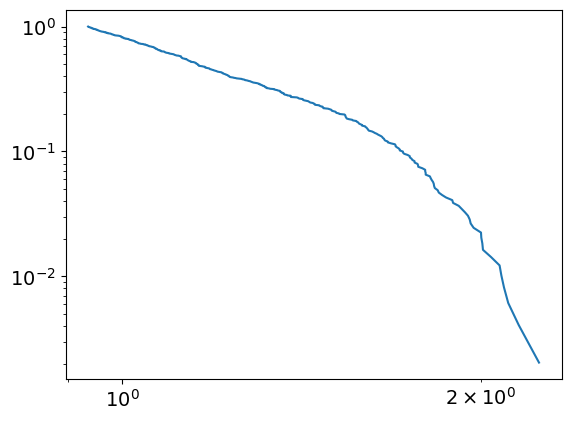

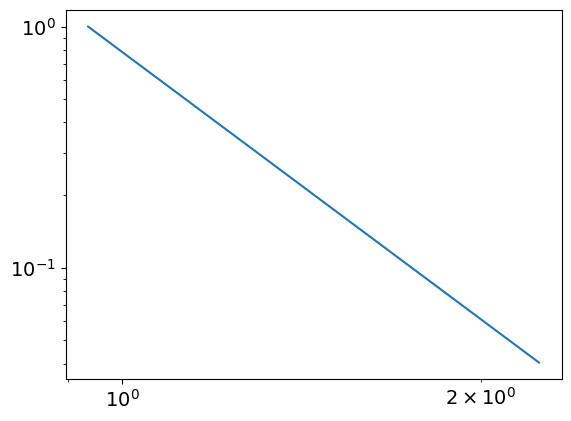

4.683939938551537
0.9360358833559846
powerlaw KstestResult(statistic=0.9731303297220478, pvalue=0.0, statistic_location=1.2307796308210095, statistic_sign=1)
lognorm KstestResult(statistic=0.9760308617842718, pvalue=0.0, statistic_location=1.2336344037888516, statistic_sign=1)
tensor(0.0793, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2209, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6451, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0415, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
435
tensor(7.1084e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


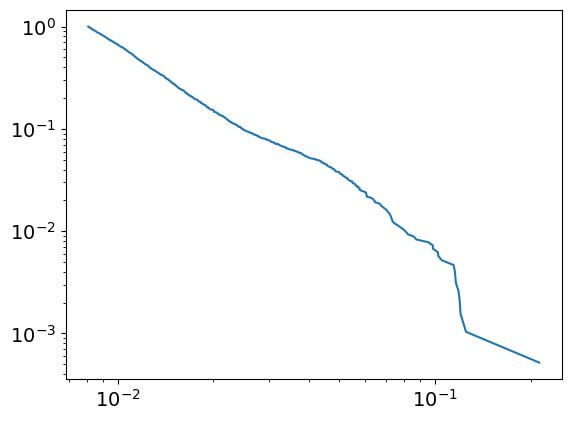

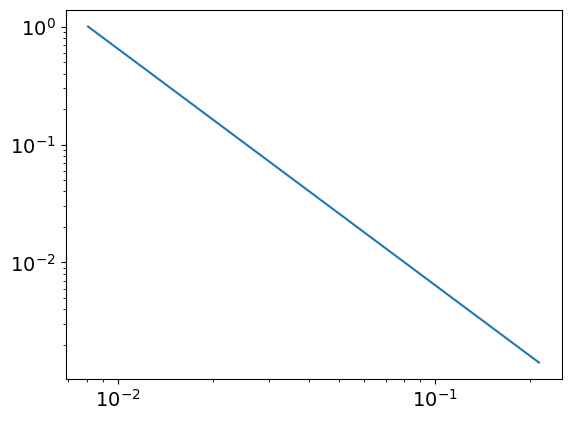

3.0045947315170247
0.008076454598267023
powerlaw KstestResult(statistic=0.9985790577193272, pvalue=0.0, statistic_location=0.08208439063361635, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21292915656132083, statistic_sign=1)
tensor(3.9006e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8347, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.6653, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
435
tensor(0.2612, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


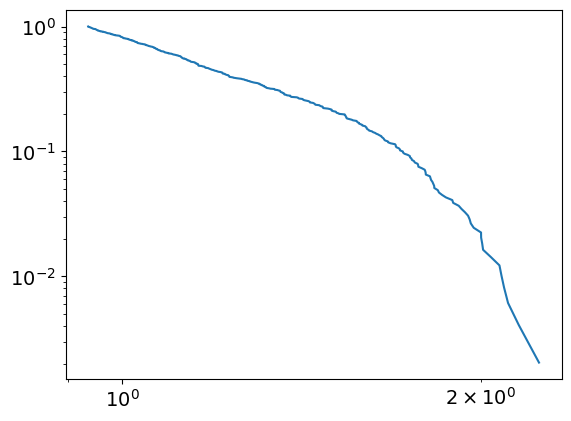

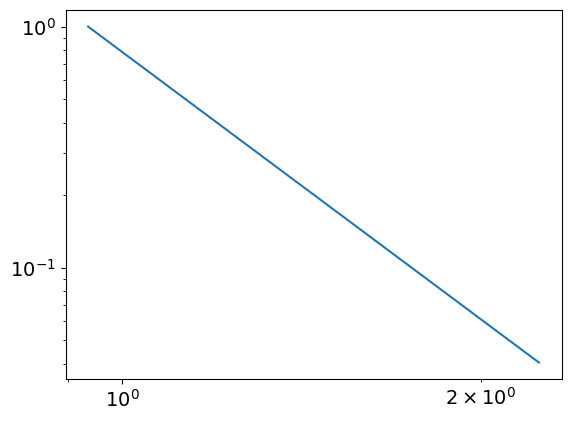

4.679997503020244
0.9365283261453298
powerlaw KstestResult(statistic=0.9731424698944947, pvalue=0.0, statistic_location=1.2307351807045102, statistic_sign=1)
lognorm KstestResult(statistic=0.975986590233816, pvalue=0.0, statistic_location=1.23487041321147, statistic_sign=1)
tensor(0.0794, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2210, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6474, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0465, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
436
tensor(6.7603e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


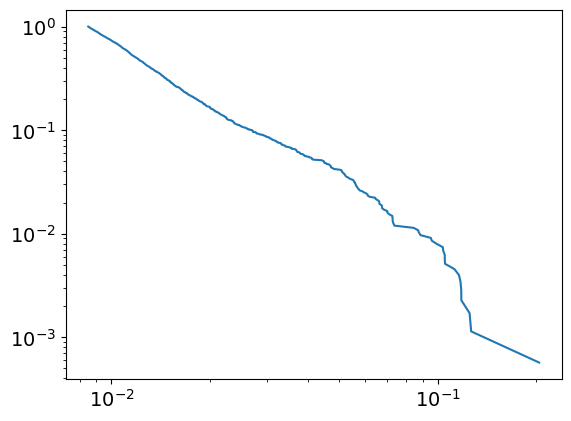

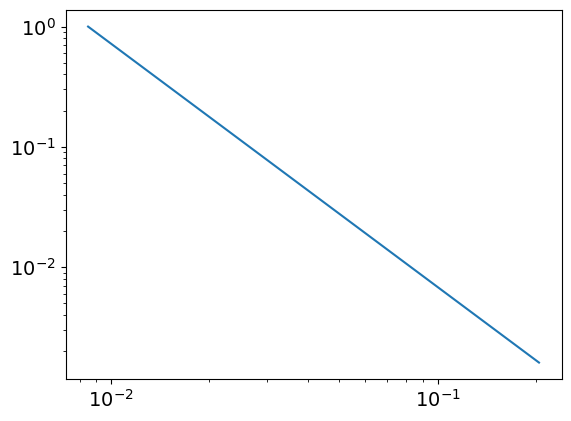

3.0218246612696946
0.008493586153564422
powerlaw KstestResult(statistic=0.9984997468504775, pvalue=0.0, statistic_location=0.10531313275764863, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20467300637552682, statistic_sign=1)
tensor(4.4151e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6875, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.1273, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
436
tensor(0.2616, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


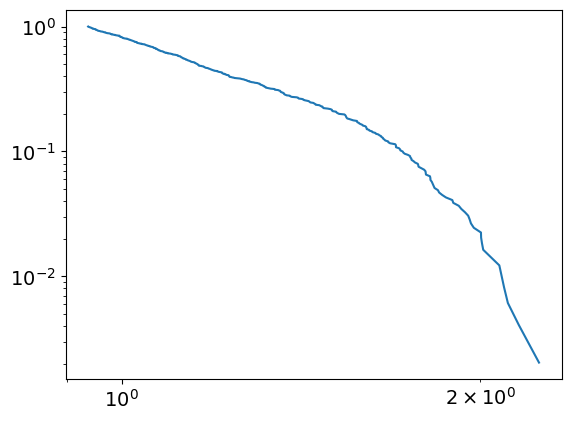

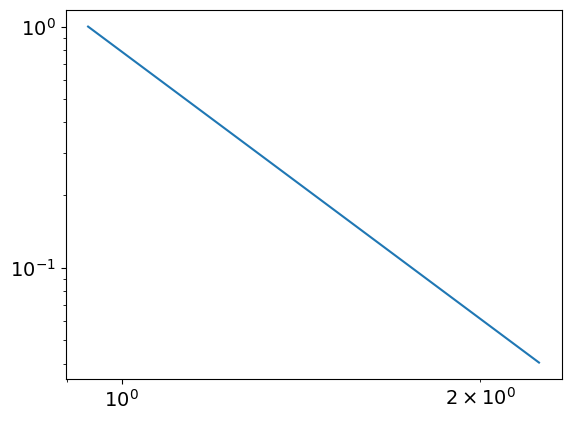

4.6805594654117275
0.9367486461431027
powerlaw KstestResult(statistic=0.9731060749840431, pvalue=0.0, statistic_location=1.2316973805489728, statistic_sign=1)
lognorm KstestResult(statistic=0.9759445622365881, pvalue=0.0, statistic_location=1.2316973805489728, statistic_sign=1)
tensor(0.0795, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2210, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6497, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0516, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
437
tensor(6.1974e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


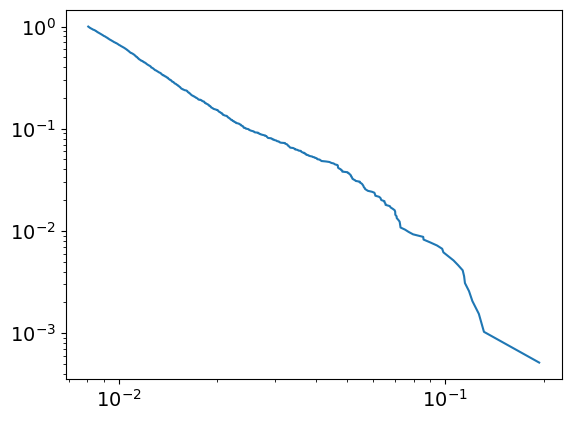

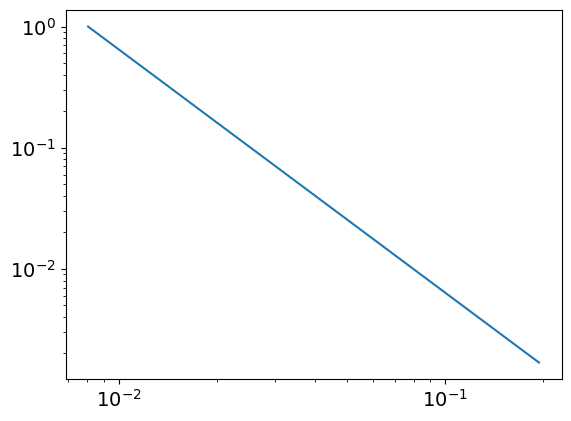

3.007289531584049
0.008044422188660848
powerlaw KstestResult(statistic=0.9986555183730347, pvalue=0.0, statistic_location=0.07717982595634465, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19386765615940832, statistic_sign=1)
tensor(4.8869e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6054, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.1167, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
437
tensor(0.2621, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


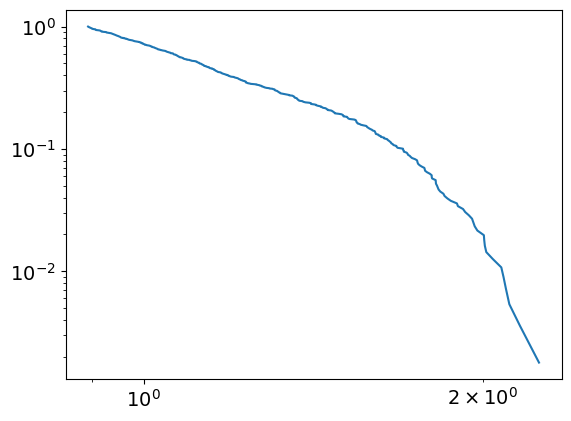

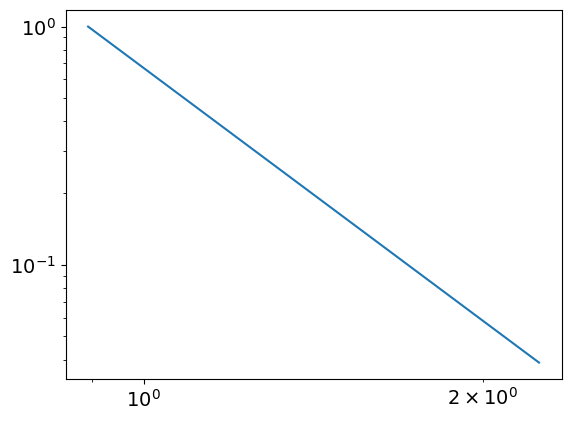

4.524882398592224
0.8924561223391886
powerlaw KstestResult(statistic=0.969884312380079, pvalue=0.0, statistic_location=1.189153795640177, statistic_sign=1)
lognorm KstestResult(statistic=0.9758896836537608, pvalue=0.0, statistic_location=1.2372785797761667, statistic_sign=1)
tensor(0.0796, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2211, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6519, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0567, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
438
tensor(7.5595e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


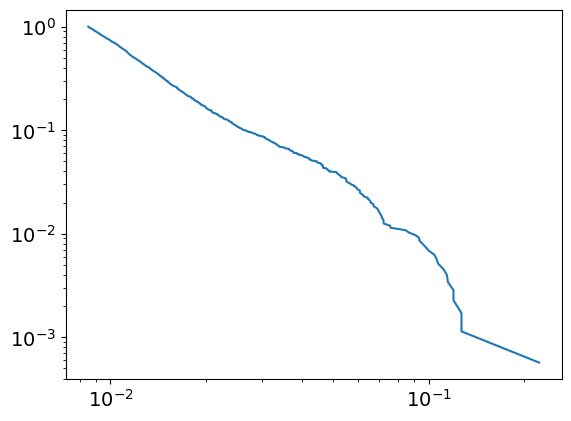

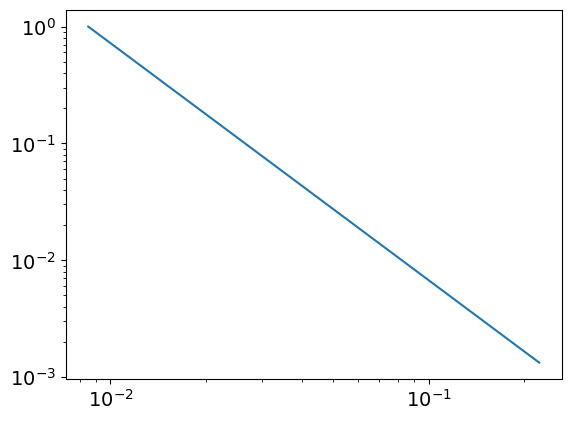

3.0300554405191913
0.00851677262574673
powerlaw KstestResult(statistic=0.9986180912535254, pvalue=0.0, statistic_location=0.1149386248722525, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22245817687586933, statistic_sign=1)
tensor(4.4504e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9588, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.8515, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
438
tensor(0.2625, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


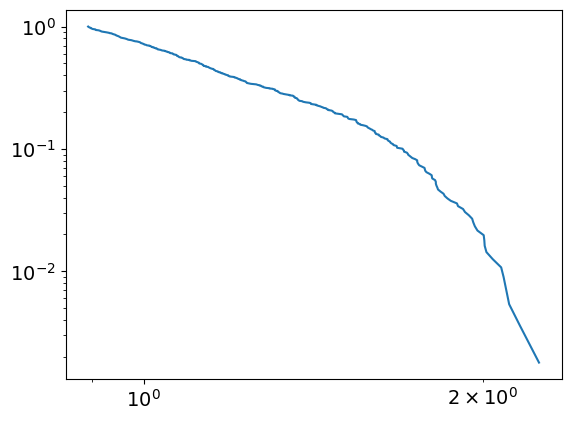

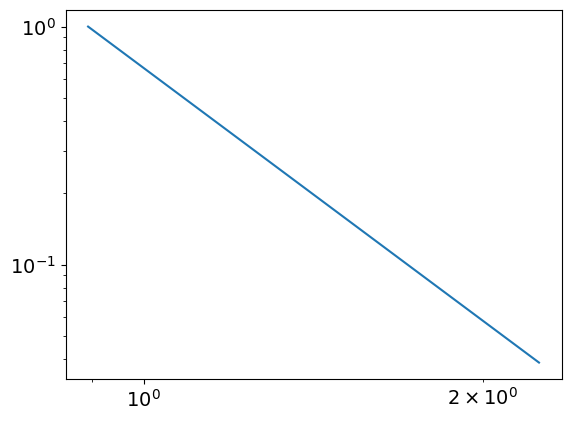

4.525329053223086
0.8926886797706717
powerlaw KstestResult(statistic=0.969855275680777, pvalue=0.0, statistic_location=1.1857218097993898, statistic_sign=1)
lognorm KstestResult(statistic=0.9758336902219529, pvalue=0.0, statistic_location=1.238531898584047, statistic_sign=1)
tensor(0.0797, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2211, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6541, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0616, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
439
tensor(7.7417e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


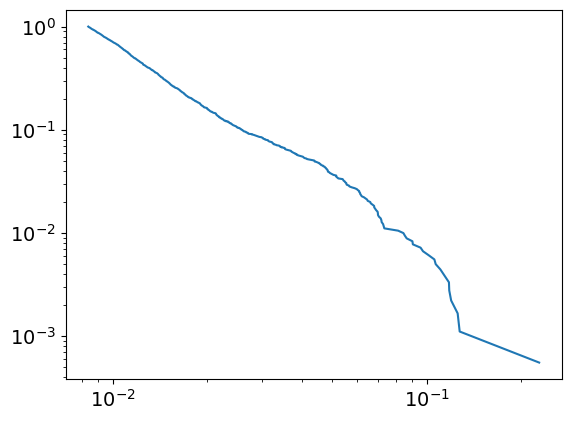

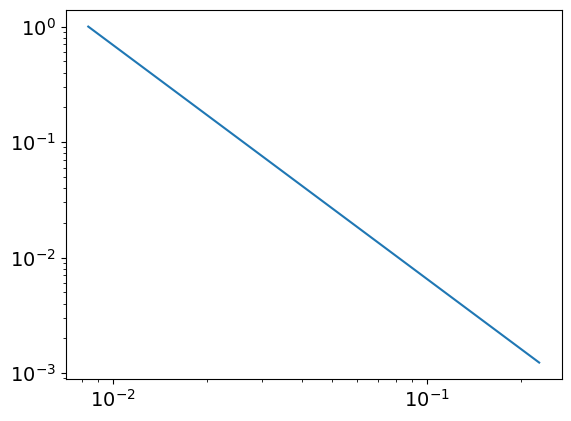

3.02618458983619
0.008367684409169735
powerlaw KstestResult(statistic=0.9985964513139126, pvalue=0.0, statistic_location=0.07336206227568626, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22828395301476828, statistic_sign=1)
tensor(4.8426e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0787, device='cuda:0', grad_fn=<MeanBackward0>) tensor(47.7025, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
439
tensor(0.2629, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


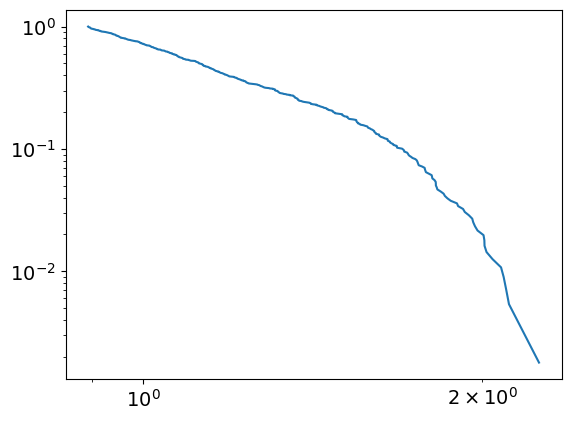

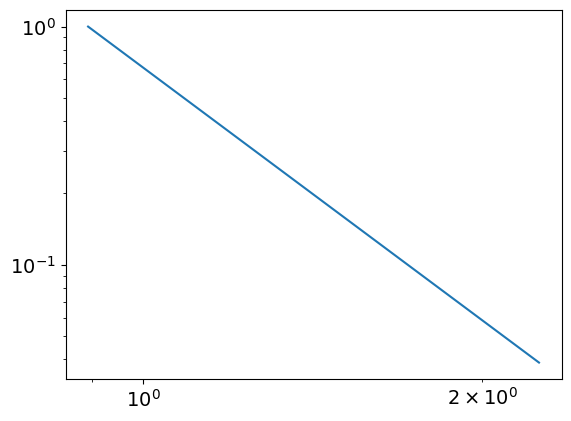

4.522793510656838
0.8930631226693163
powerlaw KstestResult(statistic=0.9698877128758547, pvalue=0.0, statistic_location=1.1809373931067084, statistic_sign=1)
lognorm KstestResult(statistic=0.9757793934333502, pvalue=0.0, statistic_location=1.2396560424216911, statistic_sign=1)
tensor(0.0798, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2211, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6564, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0668, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
440
tensor(7.8783e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


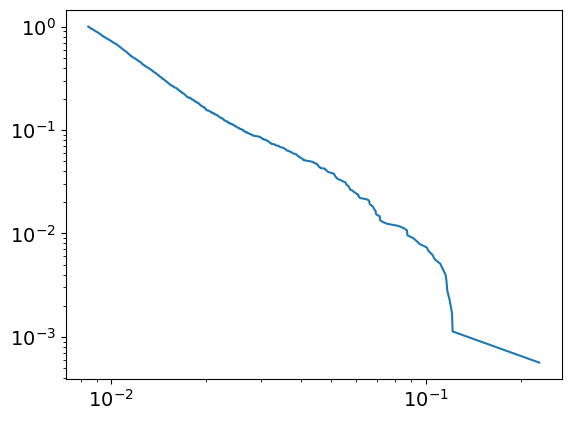

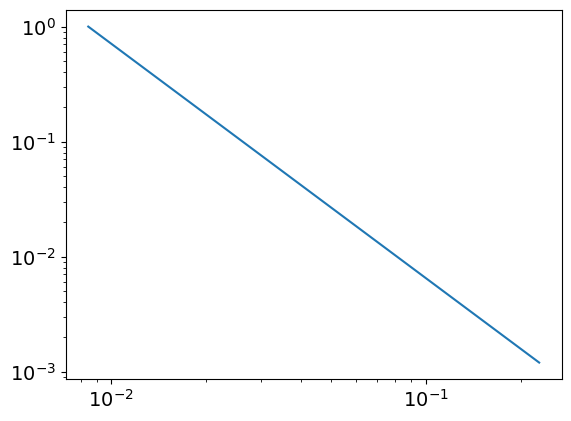

3.0400539274530938
0.008461051398107594
powerlaw KstestResult(statistic=0.9985456748642995, pvalue=0.0, statistic_location=0.1215886141020324, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22902447341441468, statistic_sign=1)
tensor(5.1391e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1206, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.4965, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
440
tensor(0.2633, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


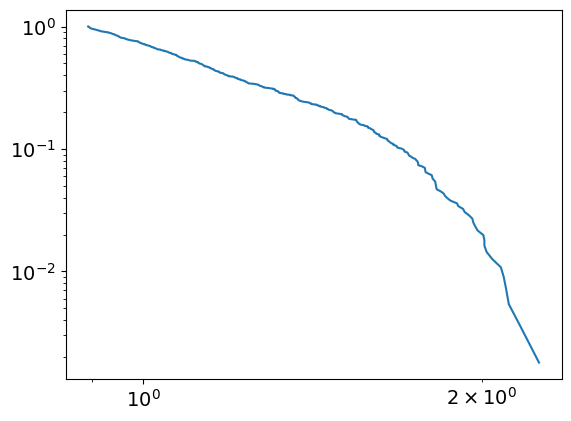

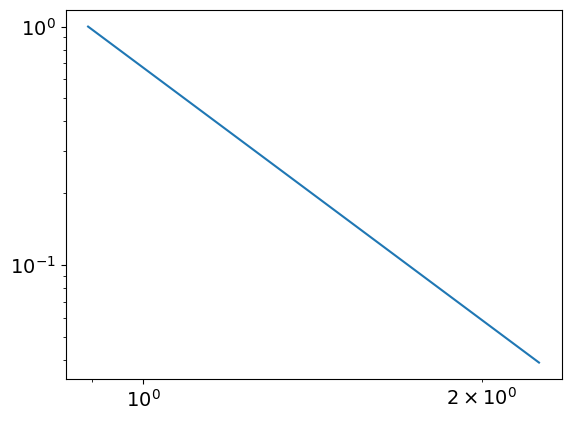

4.518339414028559
0.8933468722783261
powerlaw KstestResult(statistic=0.96991772314167, pvalue=0.0, statistic_location=1.180333057299993, statistic_sign=1)
lognorm KstestResult(statistic=0.9757184118015747, pvalue=0.0, statistic_location=1.2408461299223064, statistic_sign=1)
tensor(0.0799, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2212, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6587, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0720, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
441
tensor(7.3705e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


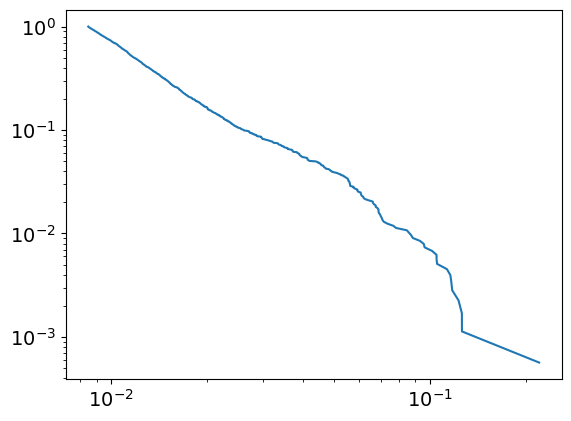

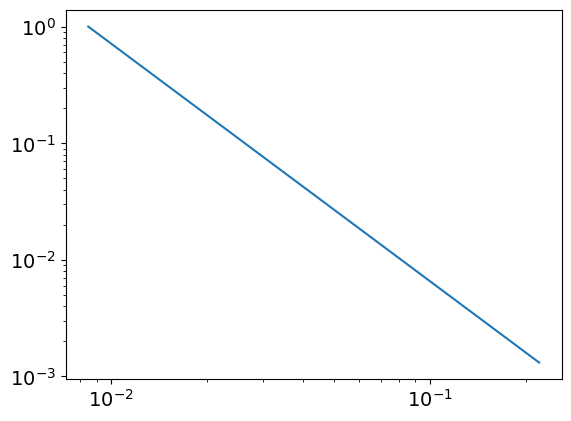

3.0373221879858425
0.0084769750517863
powerlaw KstestResult(statistic=0.9986851508930894, pvalue=0.0, statistic_location=0.08590960134073407, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21992033649969575, statistic_sign=1)
tensor(2.1036e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8898, device='cuda:0', grad_fn=<MeanBackward0>) tensor(45.3659, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
441
tensor(0.2637, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


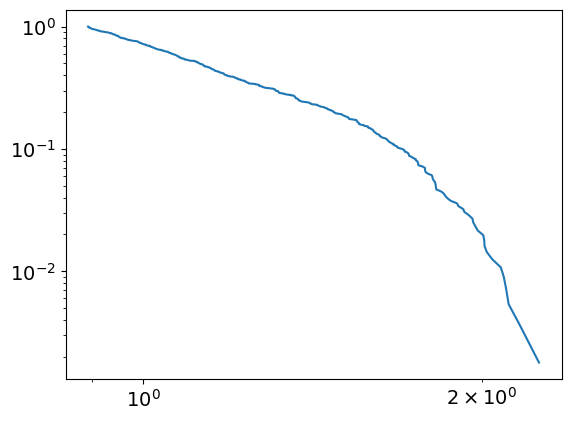

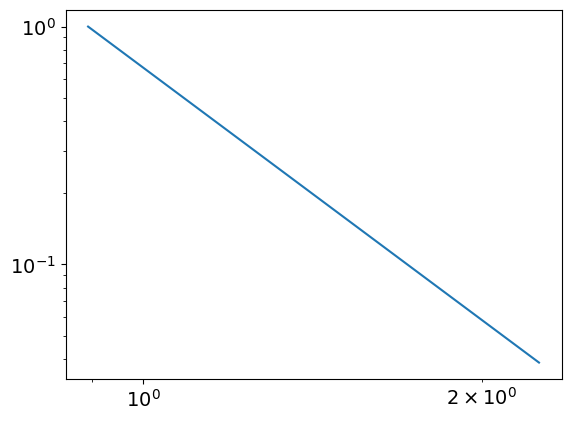

4.520169472943575
0.8932159037361129
powerlaw KstestResult(statistic=0.9699301314535267, pvalue=0.0, statistic_location=1.1823810114735445, statistic_sign=1)
lognorm KstestResult(statistic=0.9756497097178691, pvalue=0.0, statistic_location=1.242094751382045, statistic_sign=1)
tensor(0.0800, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2212, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6610, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0770, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
442
tensor(7.4530e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


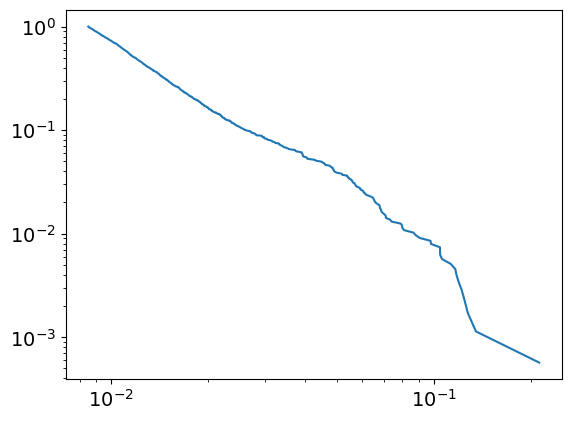

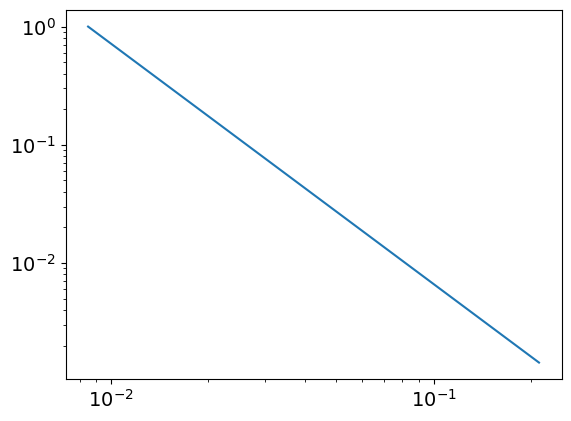

3.03436643019473
0.008503322935629876
powerlaw KstestResult(statistic=0.9986305558009709, pvalue=0.0, statistic_location=0.08105959059771417, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2122717519637009, statistic_sign=1)
tensor(1.5329e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7300, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.3376, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
442
tensor(0.2642, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


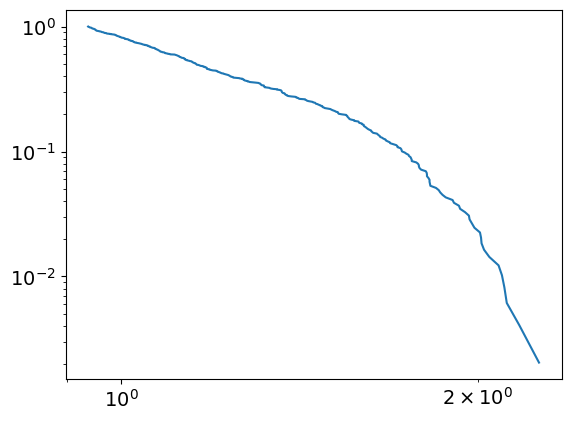

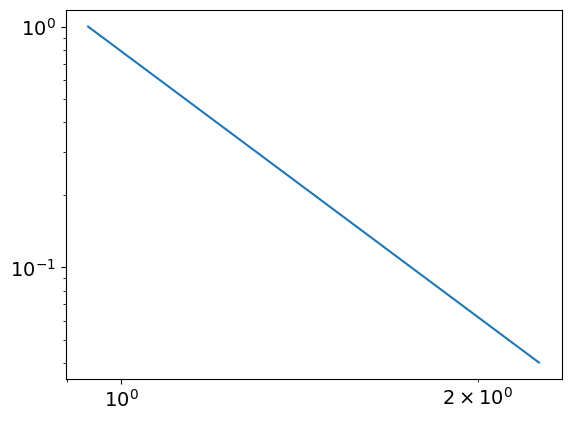

4.670913337696922
0.9378638394644728
powerlaw KstestResult(statistic=0.9726057160485974, pvalue=0.0, statistic_location=1.2432578597913155, statistic_sign=1)
lognorm KstestResult(statistic=0.975580933189347, pvalue=0.0, statistic_location=1.2432578597913155, statistic_sign=1)
tensor(0.0801, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2213, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6632, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0820, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
443
tensor(5.6053e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


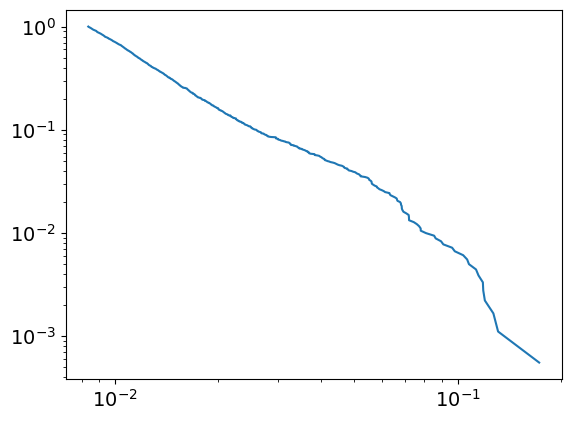

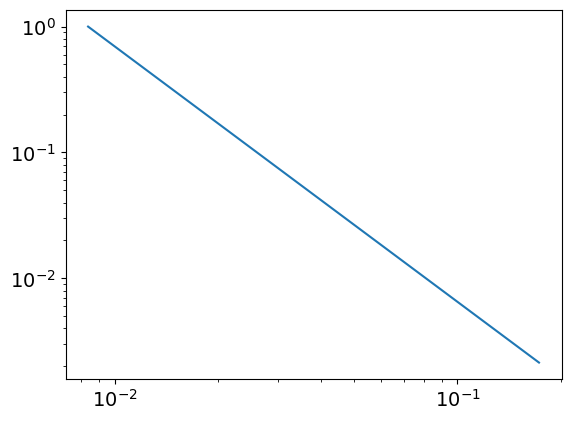

3.0293645379906673
0.008365805436443169
powerlaw KstestResult(statistic=0.9986269451361993, pvalue=0.0, statistic_location=0.08085431406995623, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17293617904878447, statistic_sign=1)
tensor(2.5290e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3955, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.8866, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
443
tensor(0.2646, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


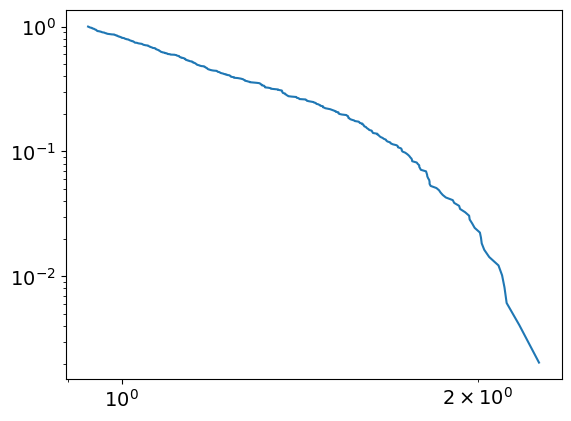

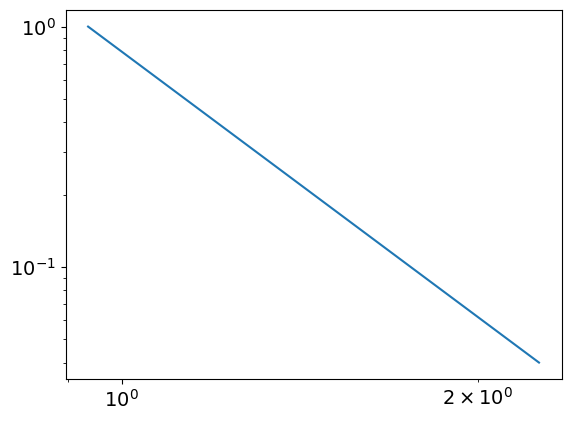

4.665682581749115
0.9366610559048767
powerlaw KstestResult(statistic=0.9724177581745506, pvalue=0.0, statistic_location=1.2447223667953171, statistic_sign=1)
lognorm KstestResult(statistic=0.9754906371615072, pvalue=0.0, statistic_location=1.2447223667953171, statistic_sign=1)
tensor(0.0802, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2213, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6655, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0873, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
444
tensor(5.3154e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


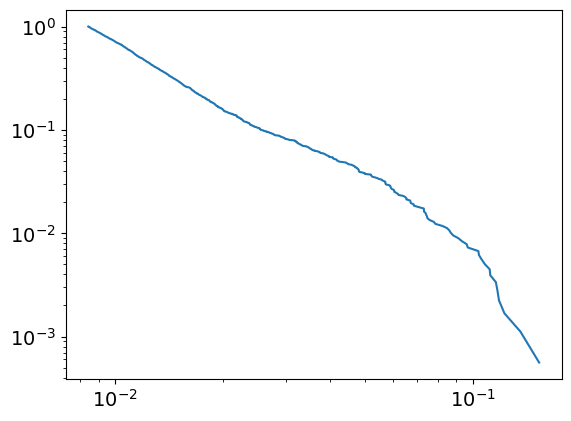

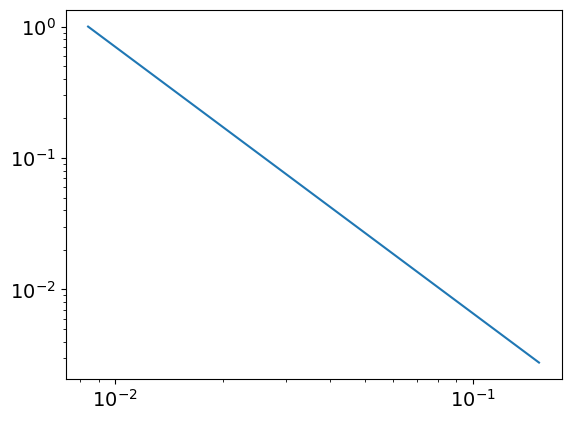

3.0275947773853398
0.008413290956348726
powerlaw KstestResult(statistic=0.9985741996918459, pvalue=0.0, statistic_location=0.1119689629290352, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15339268422311603, statistic_sign=1)
tensor(4.7457e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4680, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.7273, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
444
tensor(0.2650, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


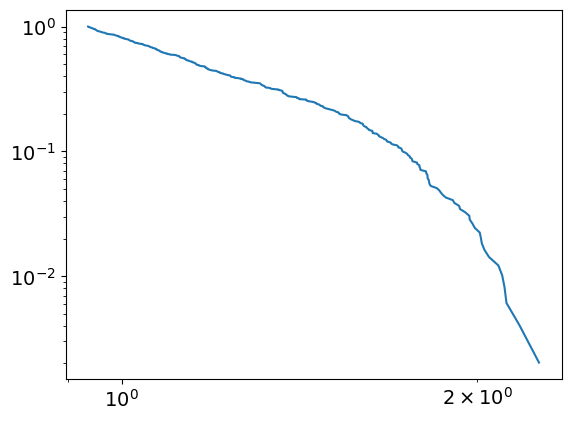

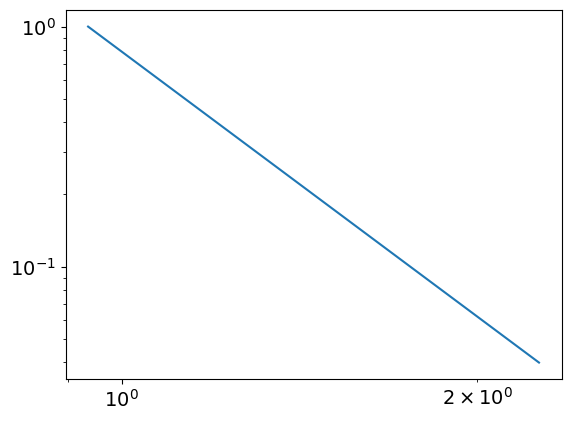

4.664254908457199
0.9362611907644225
powerlaw KstestResult(statistic=0.9723547850309308, pvalue=0.0, statistic_location=1.210382024621052, statistic_sign=1)
lognorm KstestResult(statistic=0.9753537829942227, pvalue=0.0, statistic_location=1.246832817265996, statistic_sign=1)
tensor(0.0803, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2214, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6678, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0922, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
445
tensor(5.5398e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


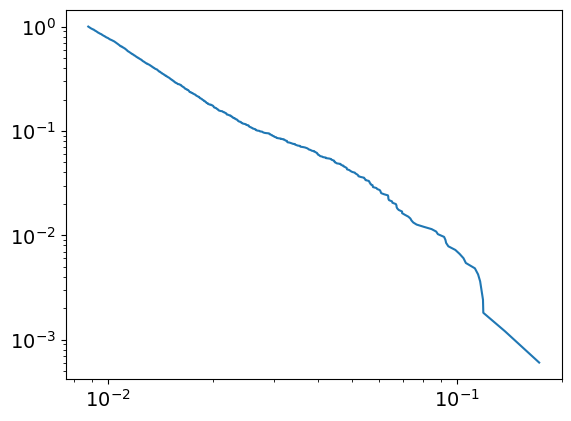

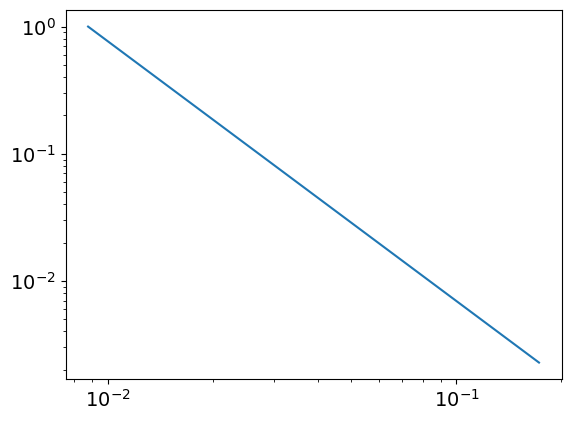

3.0444742313600397
0.008785095093874883
powerlaw KstestResult(statistic=0.9985752158215462, pvalue=0.0, statistic_location=0.09283949854355383, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17241429579734682, statistic_sign=1)
tensor(4.1982e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5512, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7356, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
445
tensor(0.2655, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


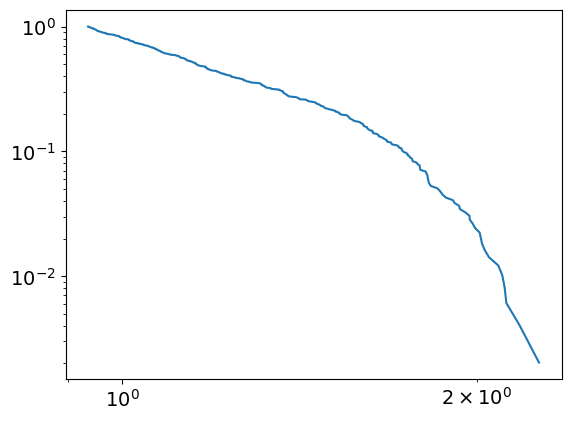

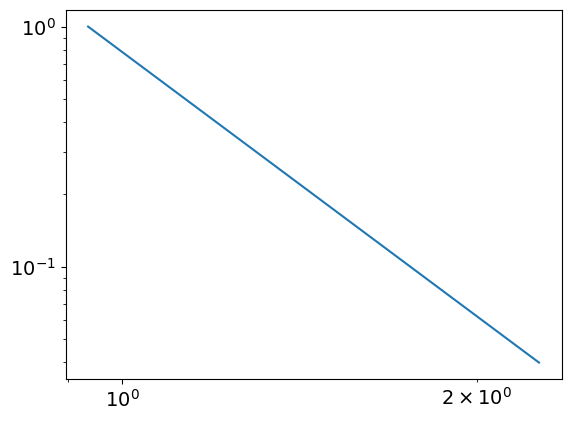

4.659932564162503
0.9356519928260963
powerlaw KstestResult(statistic=0.9722734636661747, pvalue=0.0, statistic_location=1.211416846470691, statistic_sign=1)
lognorm KstestResult(statistic=0.9752742870811695, pvalue=0.0, statistic_location=1.2381833236916617, statistic_sign=1)
tensor(0.0804, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2214, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6701, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.0974, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
446
tensor(5.8403e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


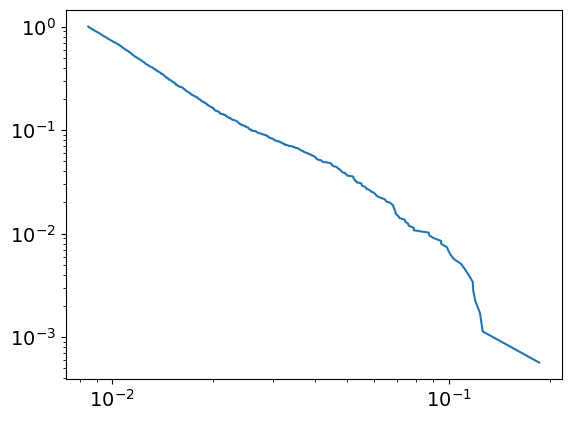

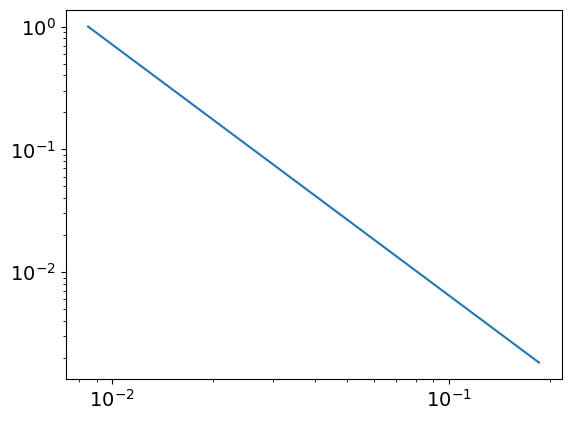

3.04365154071847
0.008492895933641383
powerlaw KstestResult(statistic=0.9985837343002129, pvalue=0.0, statistic_location=0.10368841307893675, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1857237983541327, statistic_sign=1)
tensor(3.2232e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6401, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.0485, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
446
tensor(0.2659, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


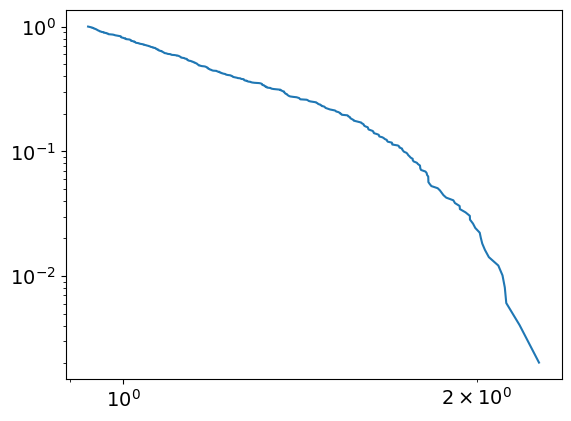

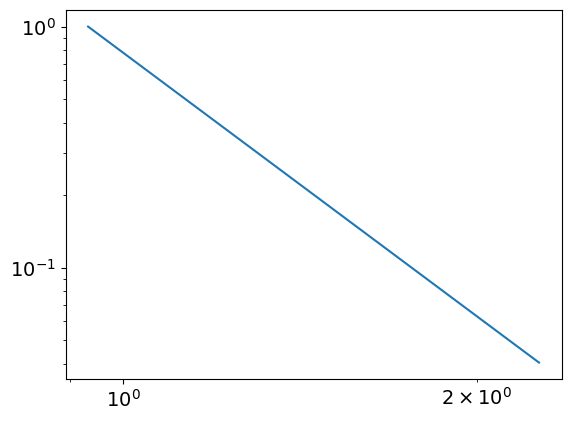

4.626277822854211
0.9330124051891218
powerlaw KstestResult(statistic=0.9720216875017859, pvalue=0.0, statistic_location=1.1890355010113163, statistic_sign=1)
lognorm KstestResult(statistic=0.9751923434860126, pvalue=0.0, statistic_location=1.2398598353148376, statistic_sign=1)
tensor(0.0805, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2215, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6723, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1024, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
447
tensor(5.3910e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


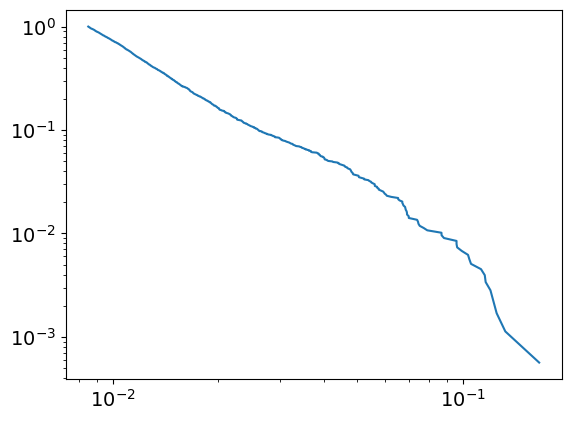

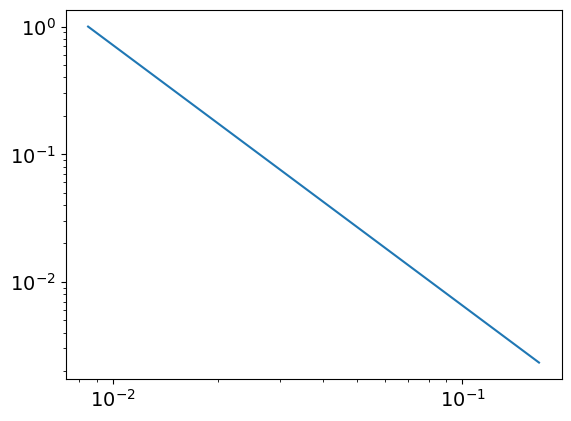

3.039893317439023
0.008477726632432183
powerlaw KstestResult(statistic=0.9985555658342873, pvalue=0.0, statistic_location=0.10451319398369022, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16562809749641452, statistic_sign=1)
tensor(3.0848e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5016, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.2602, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
447
tensor(0.2663, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


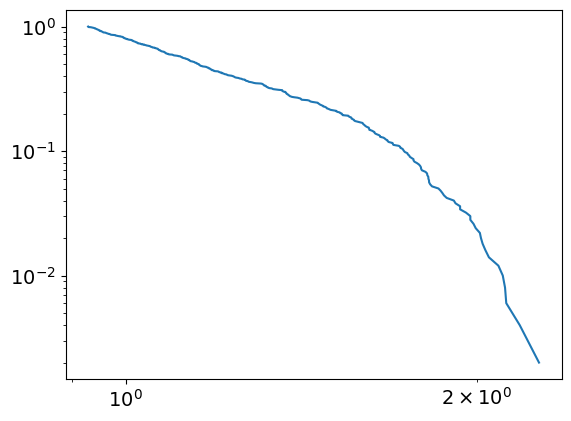

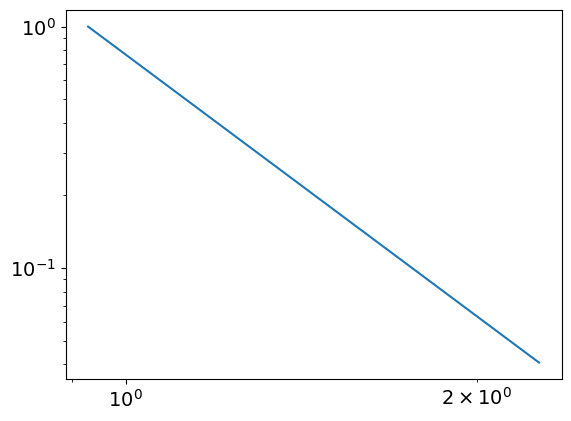

4.600374817724402
0.9287488516104682
powerlaw KstestResult(statistic=0.9717671158942673, pvalue=0.0, statistic_location=1.1901100147061157, statistic_sign=1)
lognorm KstestResult(statistic=0.975097060944184, pvalue=0.0, statistic_location=1.2416371626245517, statistic_sign=1)
tensor(0.0806, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2215, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6746, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1076, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
448
tensor(5.3969e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


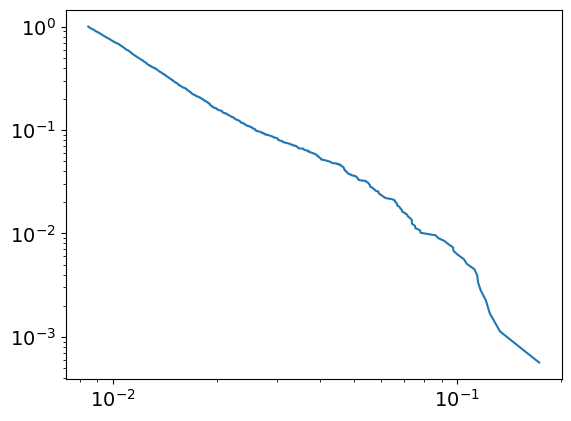

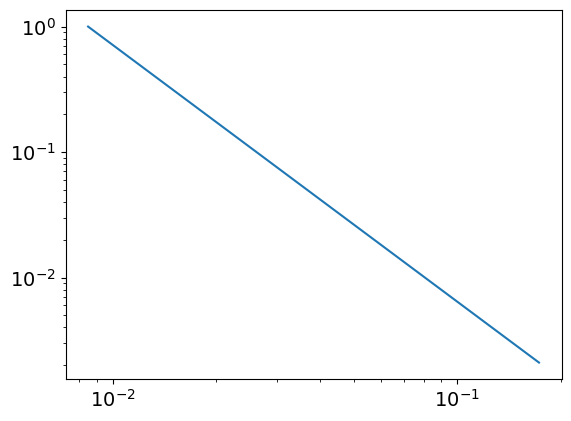

3.045408023676161
0.008475482753493838
powerlaw KstestResult(statistic=0.9986793470148225, pvalue=0.0, statistic_location=0.07819148957953538, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17277363520064282, statistic_sign=1)
tensor(1.1174e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4483, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7430, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
448
tensor(0.2668, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


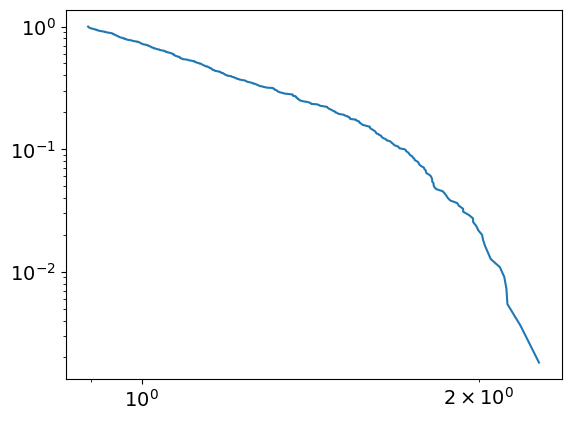

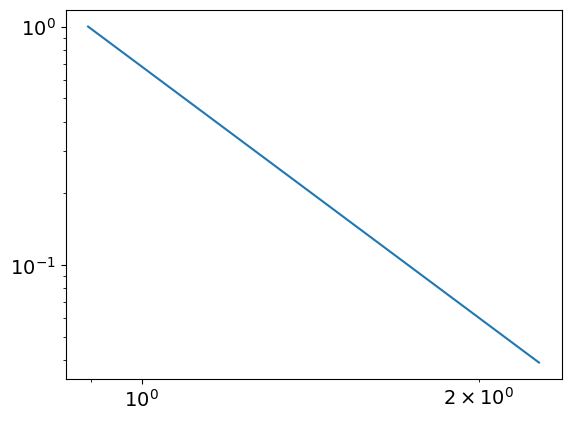

4.496219663514284
0.895452152958646
powerlaw KstestResult(statistic=0.9696930384967668, pvalue=0.0, statistic_location=1.1867434352699175, statistic_sign=1)
lognorm KstestResult(statistic=0.9749934977664335, pvalue=0.0, statistic_location=1.2434066970563757, statistic_sign=1)
tensor(0.0807, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2216, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6769, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1127, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


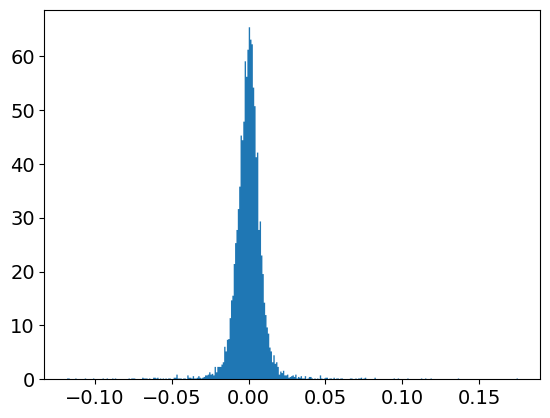

powerlaw
Calculating best minimal value for power law fit
8.054399498189294%
powerlaw KstestResult(statistic=0.99999999979918, pvalue=0.0, statistic_location=0.17512735687445588, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17512735687445588, statistic_sign=1)



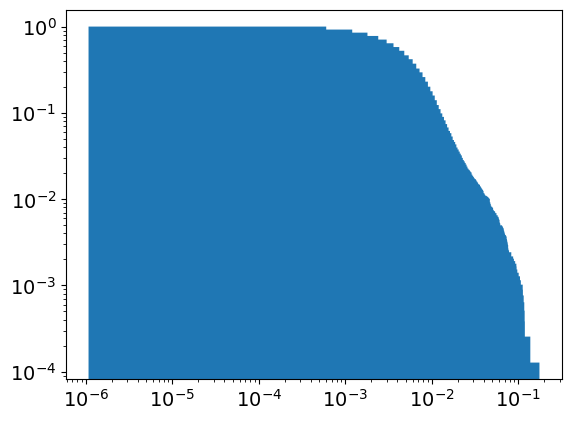

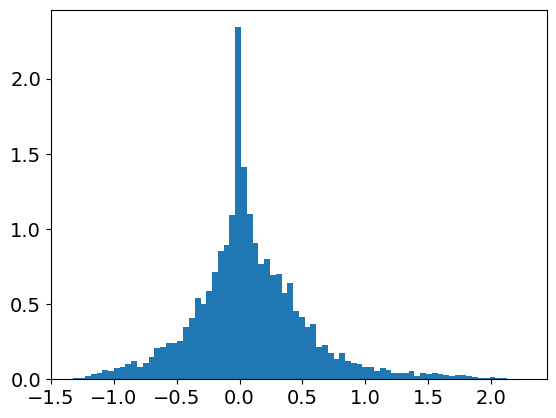

powerlaw
Calculating best minimal value for power law fit
2.9445283042586077
powerlaw KstestResult(statistic=0.9073922862482431, pvalue=0.0, statistic_location=0.6997471405678898, statistic_sign=1)
lognorm KstestResult(statistic=0.9749163937679334, pvalue=0.0, statistic_location=1.242243102695845, statistic_sign=1)



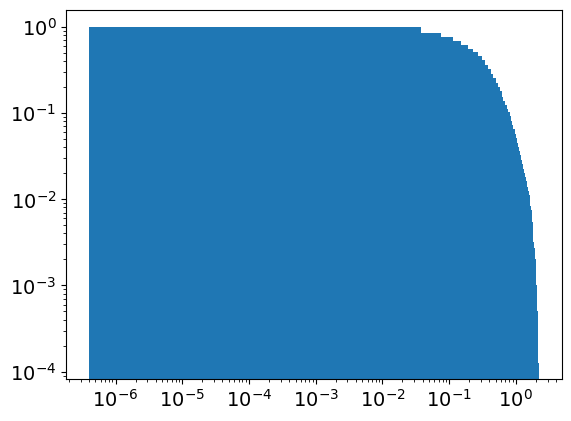

separation
epoch:
449
tensor(5.4949e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


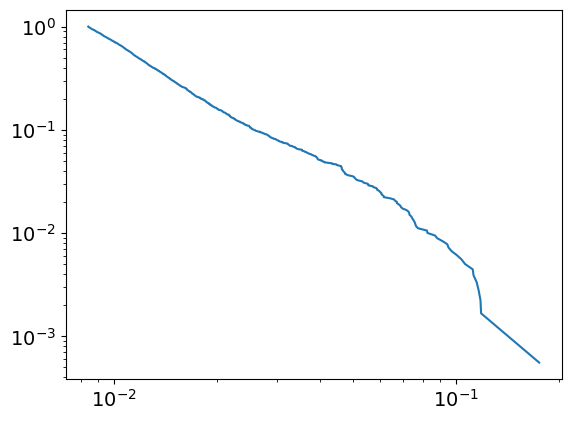

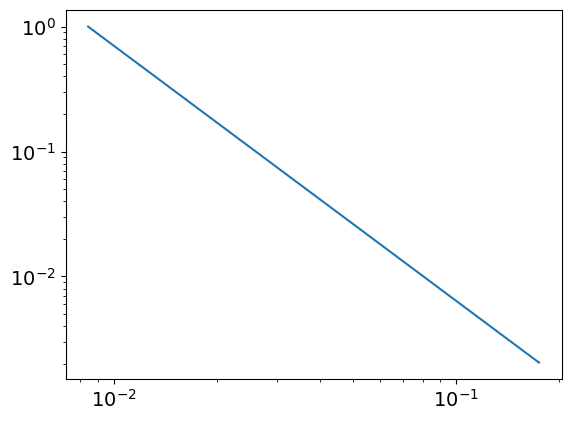

3.040599249926835
0.008426634061878867
powerlaw KstestResult(statistic=0.9986126967785488, pvalue=0.0, statistic_location=0.08258118454128746, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17512735687445588, statistic_sign=1)
tensor(3.3894e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5901, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.1000, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
449
tensor(0.2672, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


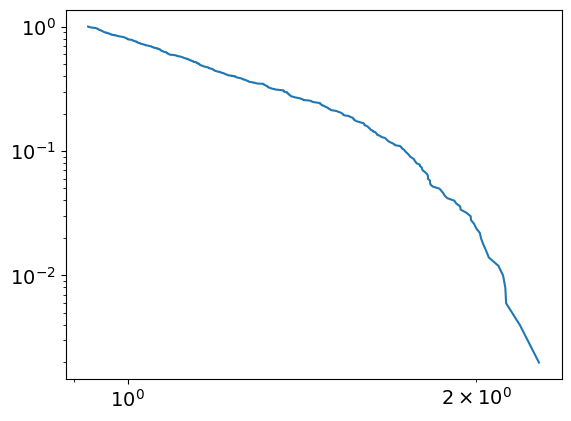

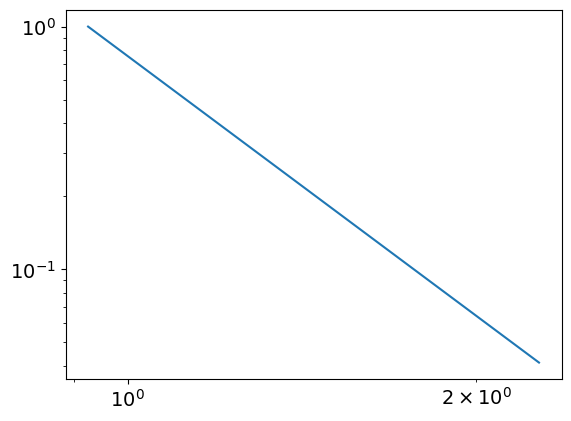

4.560084406707521
0.9246681670472672
powerlaw KstestResult(statistic=0.9713560707053349, pvalue=0.0, statistic_location=1.1902718081976884, statistic_sign=1)
lognorm KstestResult(statistic=0.9749163937679334, pvalue=0.0, statistic_location=1.242243102695845, statistic_sign=1)
tensor(0.0808, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2216, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6791, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1179, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
450
tensor(5.3733e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


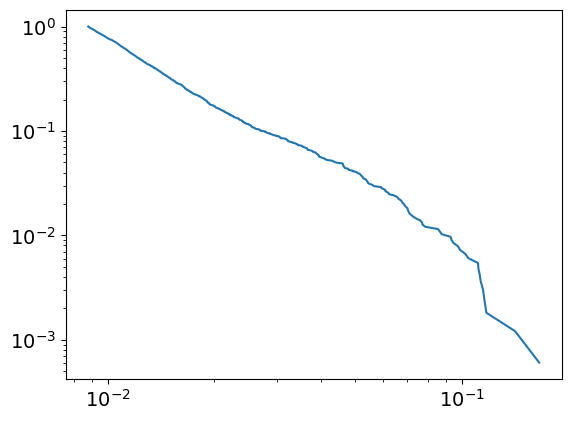

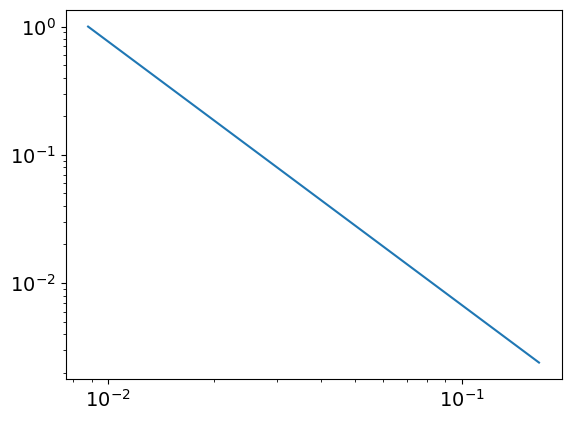

3.056230592157352
0.008800262014659593
powerlaw KstestResult(statistic=0.998664334587004, pvalue=0.0, statistic_location=0.11580648838436035, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1653947426324402, statistic_sign=1)
tensor(4.3681e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5390, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.9490, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
450
tensor(0.2676, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


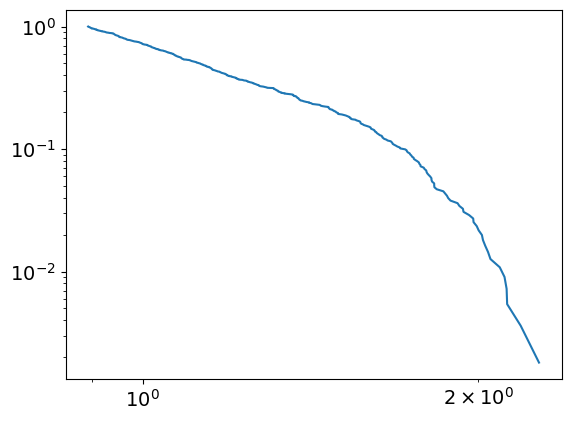

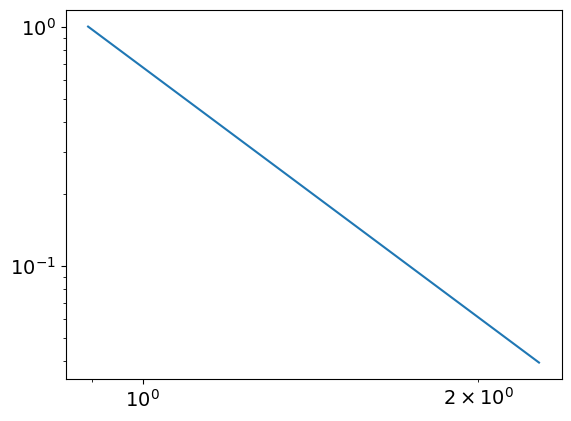

4.477571601668138
0.8935287998924635
powerlaw KstestResult(statistic=0.96935339914873, pvalue=0.0, statistic_location=1.1907366738467655, statistic_sign=1)
lognorm KstestResult(statistic=0.9748467545179611, pvalue=0.0, statistic_location=1.2433105235150939, statistic_sign=1)
tensor(0.0810, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2217, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6814, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1230, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
451
tensor(5.4067e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


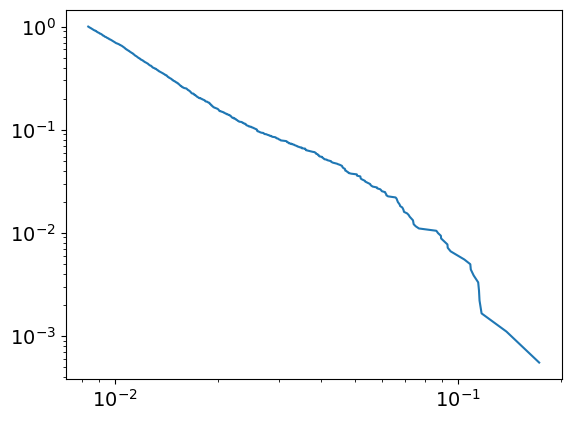

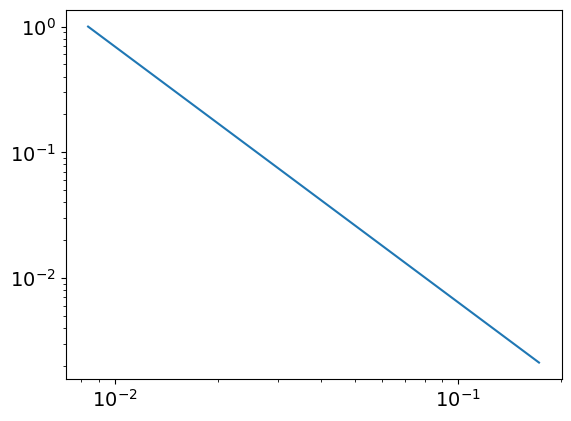

3.034911585803267
0.00836313607211927
powerlaw KstestResult(statistic=0.9986061069405127, pvalue=0.0, statistic_location=0.1155401307983544, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17240404214754756, statistic_sign=1)
tensor(3.6430e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5639, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.0641, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
451
tensor(0.2681, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


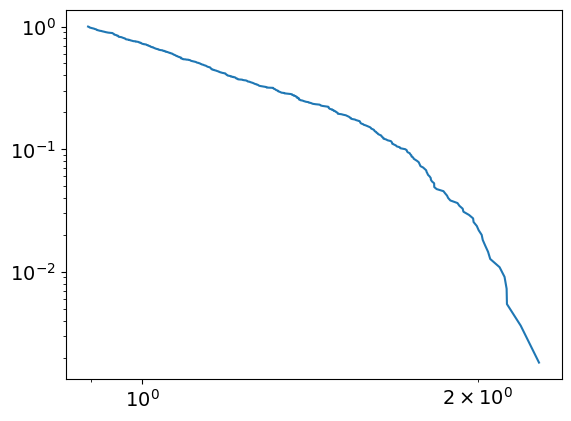

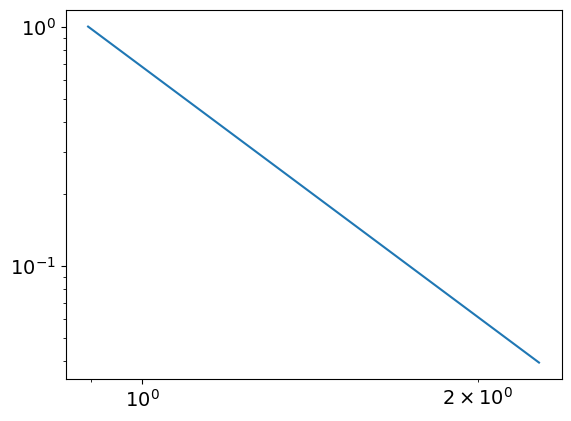

4.472382845625937
0.8947132609017823
powerlaw KstestResult(statistic=0.9692835041439866, pvalue=0.0, statistic_location=1.1925576577791968, statistic_sign=1)
lognorm KstestResult(statistic=0.974776128856496, pvalue=0.0, statistic_location=1.244330664589498, statistic_sign=1)
tensor(0.0811, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2217, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6837, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1282, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
452
tensor(5.3925e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


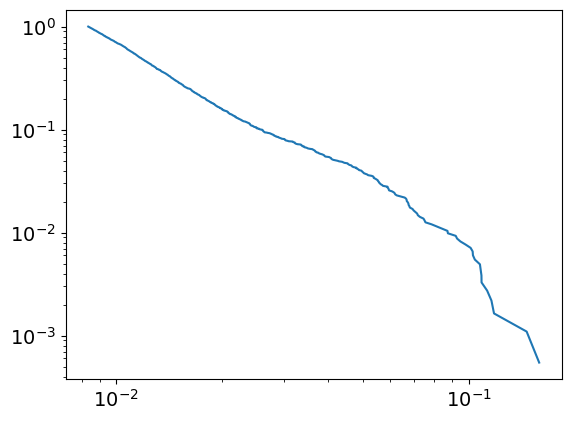

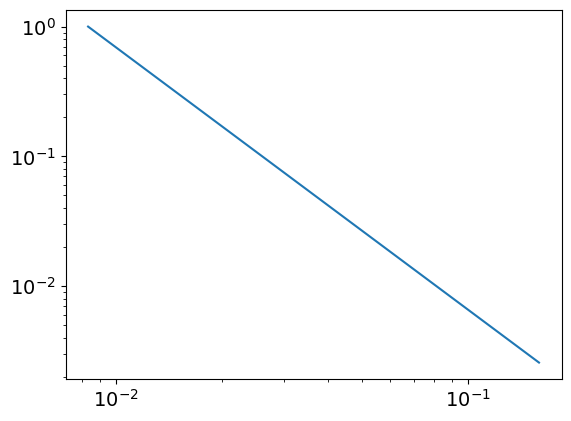

3.0227622371599225
0.008323645922507525
powerlaw KstestResult(statistic=0.9985576452668956, pvalue=0.0, statistic_location=0.10773490452296004, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15867634395016508, statistic_sign=1)
tensor(2.2564e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4462, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.0205, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
452
tensor(0.2685, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


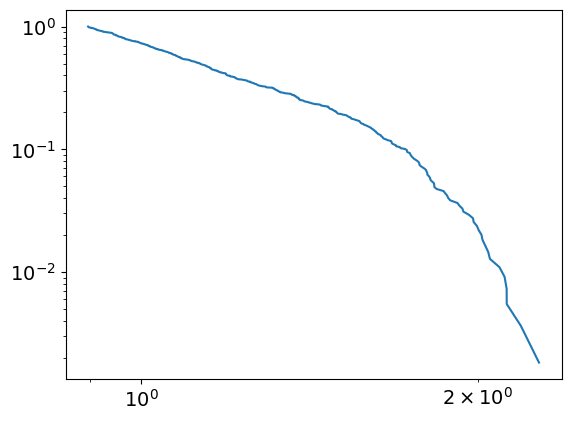

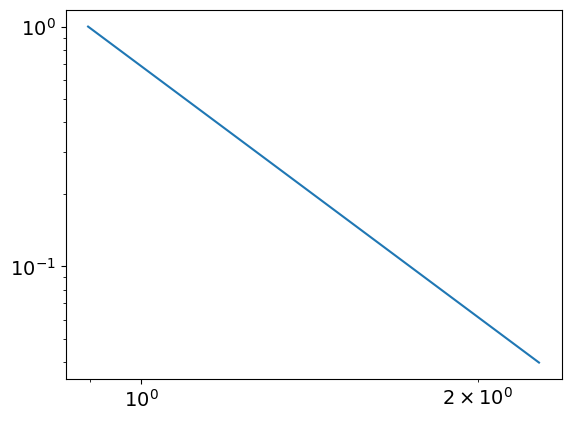

4.470486765525623
0.8957289870059707
powerlaw KstestResult(statistic=0.9692768678647474, pvalue=0.0, statistic_location=1.1915878870722059, statistic_sign=1)
lognorm KstestResult(statistic=0.9747362967772025, pvalue=0.0, statistic_location=1.218624494932065, statistic_sign=1)
tensor(0.0812, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2218, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6859, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1333, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
453
tensor(5.3924e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


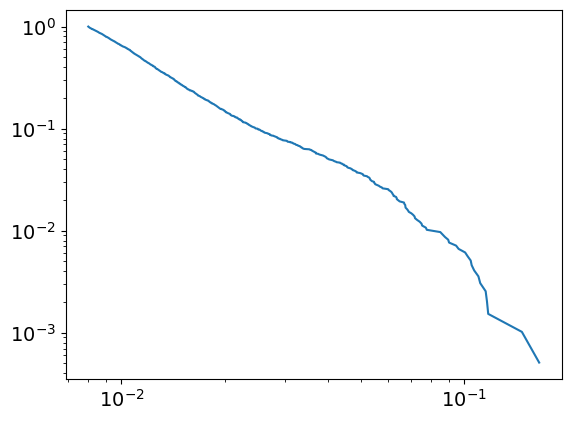

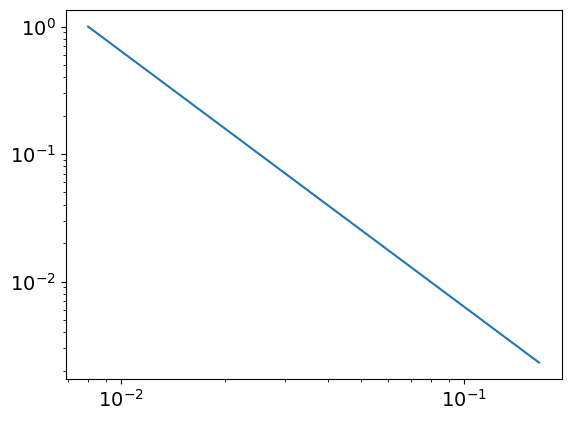

3.0044689484705485
0.008002702822152154
powerlaw KstestResult(statistic=0.9985574818532978, pvalue=0.0, statistic_location=0.09022342236981047, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16521050397015433, statistic_sign=1)
tensor(2.0978e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5231, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3346, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
453
tensor(0.2690, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


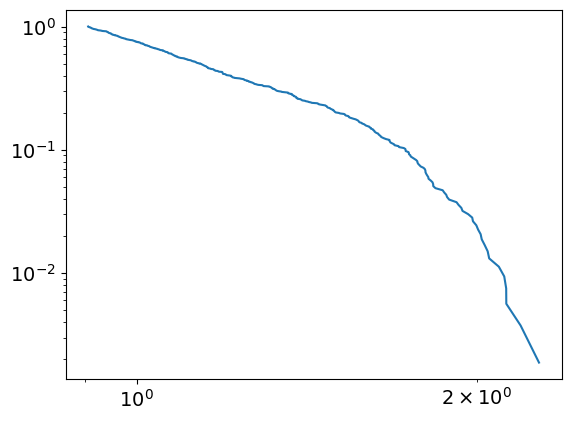

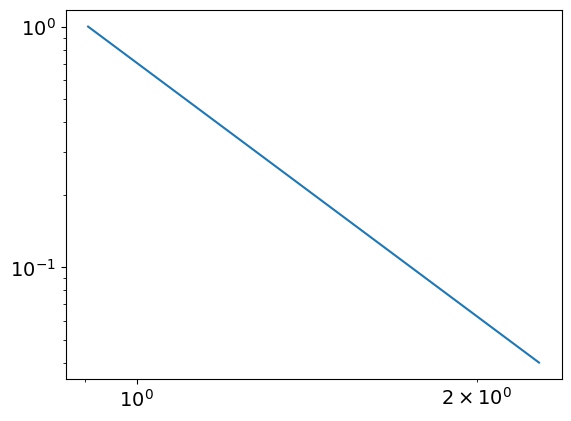

4.497165021109851
0.9056222548827437
powerlaw KstestResult(statistic=0.9699711477740305, pvalue=0.0, statistic_location=1.2007548845858227, statistic_sign=1)
lognorm KstestResult(statistic=0.974715322182038, pvalue=0.0, statistic_location=1.2196471482387985, statistic_sign=1)
tensor(0.0813, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2218, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6882, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1385, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
454
tensor(5.5790e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


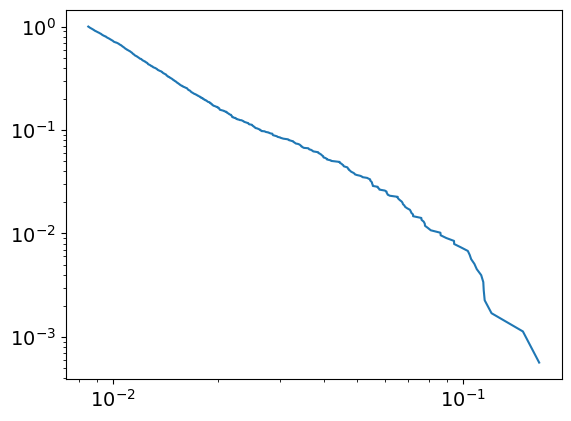

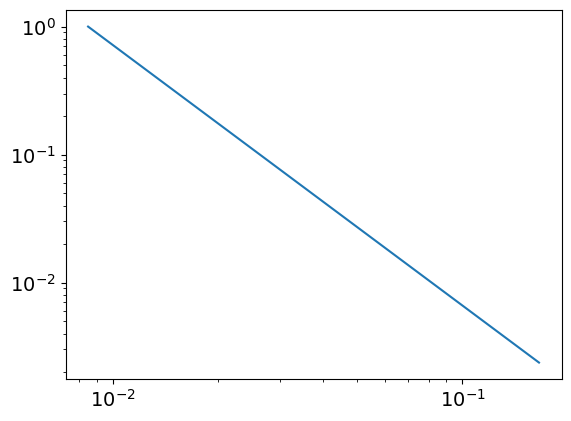

3.0347763987097665
0.00849025769669453
powerlaw KstestResult(statistic=0.998630314847915, pvalue=0.0, statistic_location=0.08108875030424147, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.16559530898733366, statistic_sign=1)
tensor(1.5422e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4131, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.4635, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
454
tensor(0.2694, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


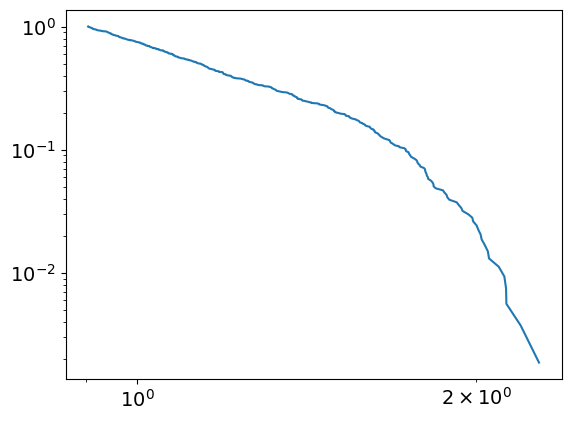

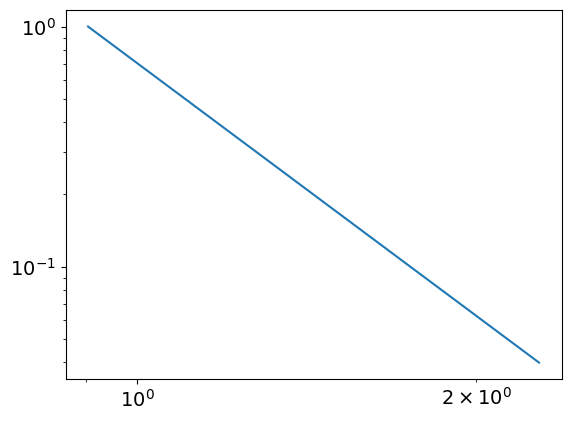

4.4958447558186085
0.9046853739551324
powerlaw KstestResult(statistic=0.9698079213438578, pvalue=0.0, statistic_location=1.2022631929787, statistic_sign=1)
lognorm KstestResult(statistic=0.9746952217172601, pvalue=0.0, statistic_location=1.2205517543339846, statistic_sign=1)
tensor(0.0814, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2218, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6905, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1439, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
455
tensor(5.4786e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


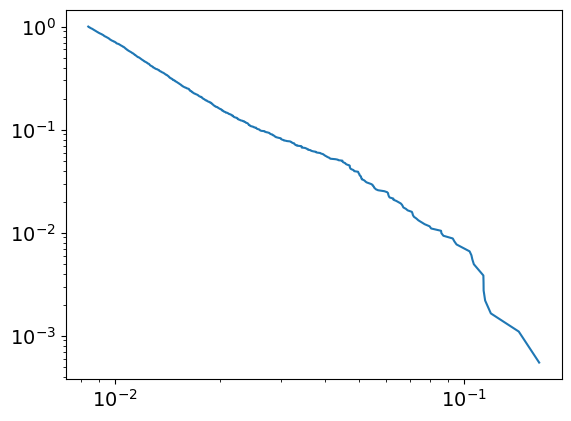

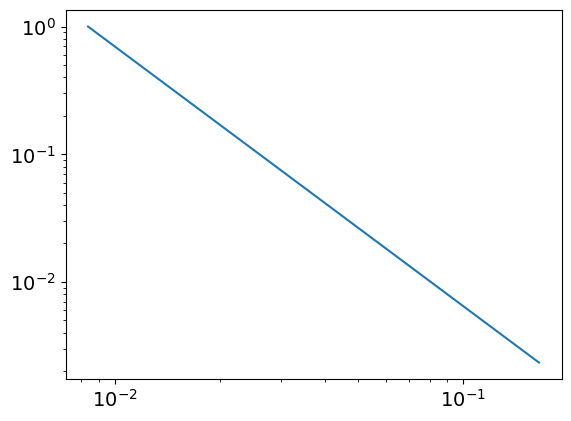

3.033960963290909
0.0083744141735005
powerlaw KstestResult(statistic=0.9986326376498486, pvalue=0.0, statistic_location=0.08076237138015668, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1648752625284932, statistic_sign=1)
tensor(1.4807e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3565, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.9457, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
455
tensor(0.2698, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


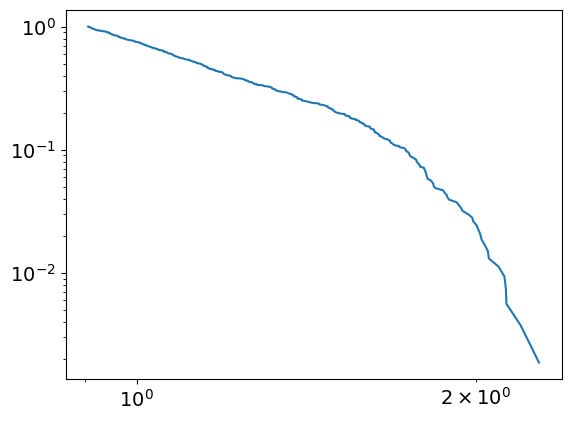

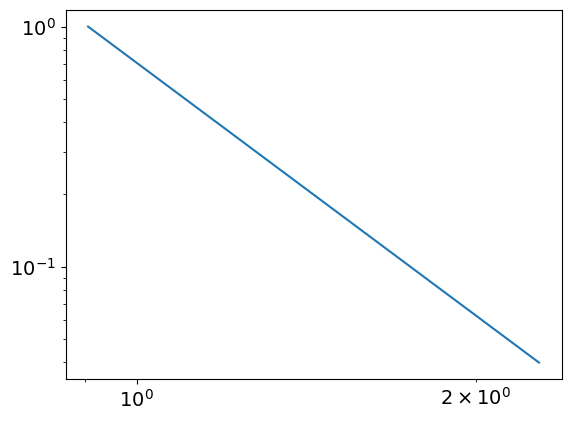

4.498932465754351
0.905617604470916
powerlaw KstestResult(statistic=0.9698443582011022, pvalue=0.0, statistic_location=1.2008796759164315, statistic_sign=1)
lognorm KstestResult(statistic=0.9746706736290572, pvalue=0.0, statistic_location=1.2216165766154283, statistic_sign=1)
tensor(0.0815, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2219, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6927, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1489, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
456
tensor(5.5063e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


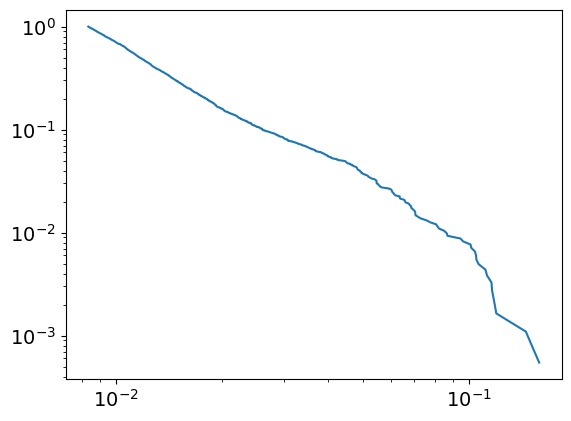

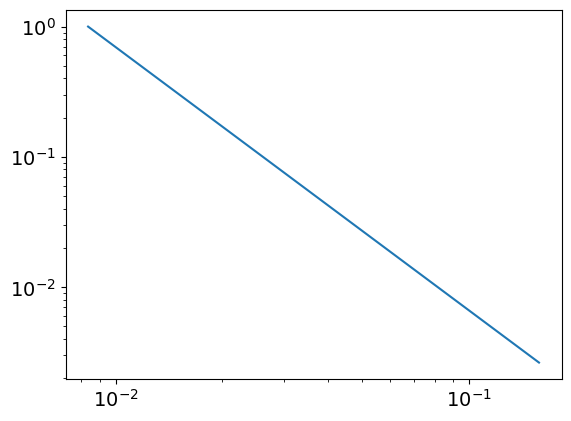

3.0196425953459554
0.008352926048324062
powerlaw KstestResult(statistic=0.9985571859871857, pvalue=0.0, statistic_location=0.11581288112928625, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15806403959875548, statistic_sign=1)
tensor(4.0210e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3947, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2472, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
456
tensor(0.2703, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


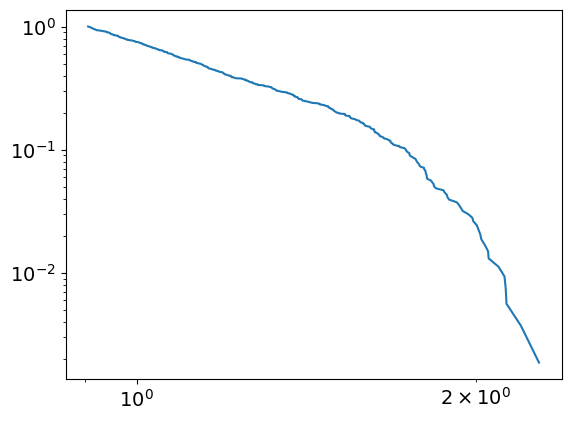

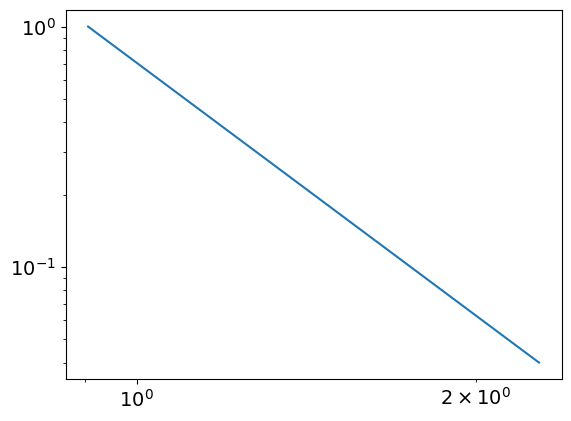

4.489957803595205
0.9051510357847238
powerlaw KstestResult(statistic=0.969700251277986, pvalue=0.0, statistic_location=1.2058021243081287, statistic_sign=1)
lognorm KstestResult(statistic=0.974645704851809, pvalue=0.0, statistic_location=1.2226178115193567, statistic_sign=1)
tensor(0.0816, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2220, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6950, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1541, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
457
tensor(5.7132e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


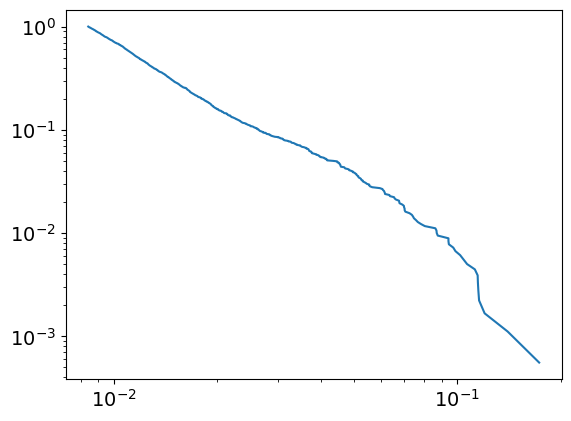

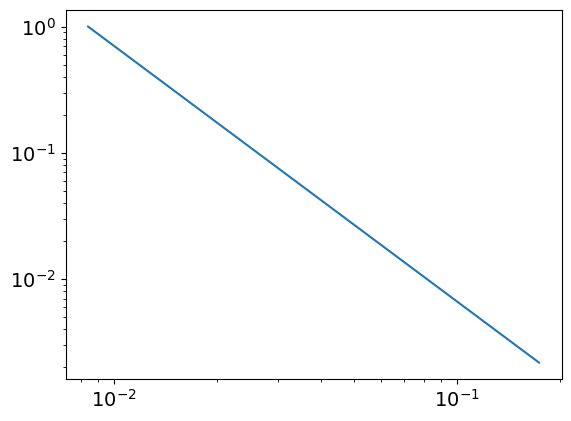

3.0259938449939447
0.008407560489258798
powerlaw KstestResult(statistic=0.9986075437407826, pvalue=0.0, statistic_location=0.1148370666551193, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.173238952454095, statistic_sign=1)
tensor(4.4504e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4929, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.7005, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
457
tensor(0.2707, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


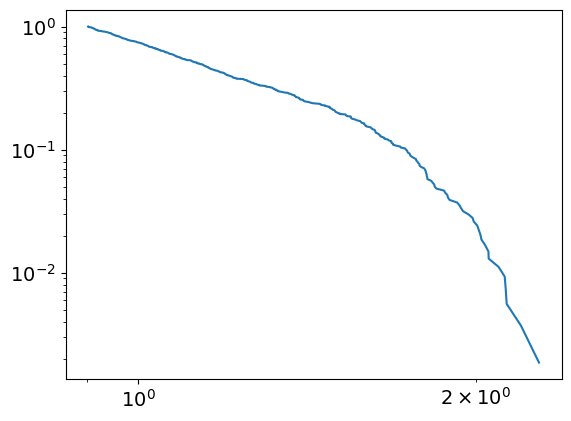

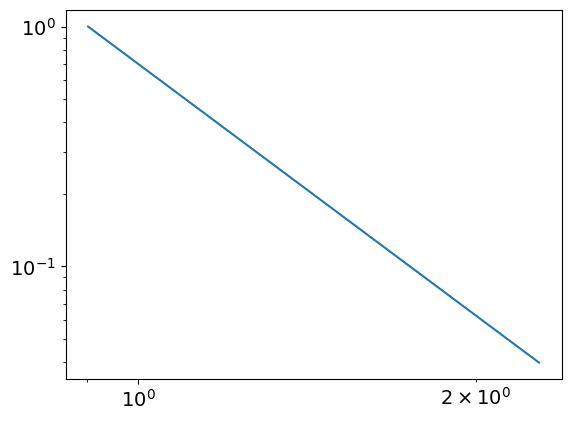

4.478261603393776
0.90154124733375
powerlaw KstestResult(statistic=0.9694155520619001, pvalue=0.0, statistic_location=1.199792101647101, statistic_sign=1)
lognorm KstestResult(statistic=0.9746197745098695, pvalue=0.0, statistic_location=1.2235864856702048, statistic_sign=1)
tensor(0.0817, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2220, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6972, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1594, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
458
tensor(6.1923e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


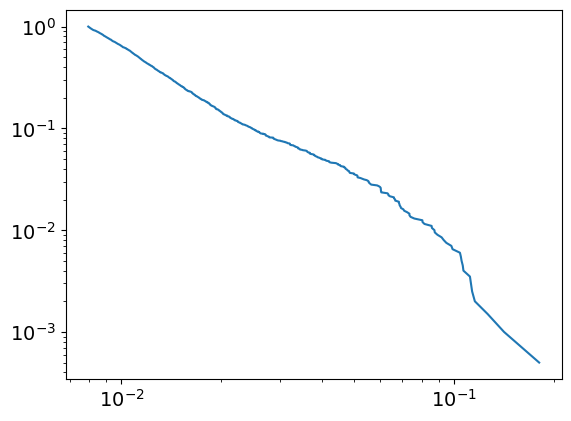

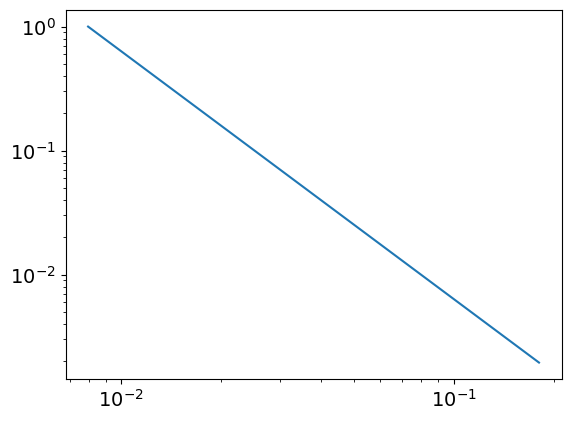

2.9983357368628276
0.007949550165076424
powerlaw KstestResult(statistic=0.9985962915098984, pvalue=0.0, statistic_location=0.1125450872023917, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18053814052089268, statistic_sign=1)
tensor(4.0949e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5089, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.9087, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
458
tensor(0.2711, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


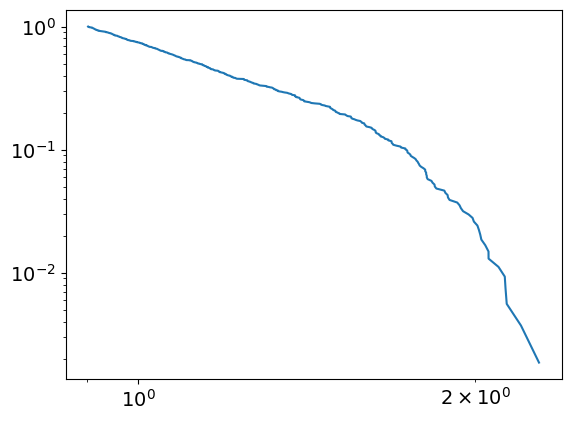

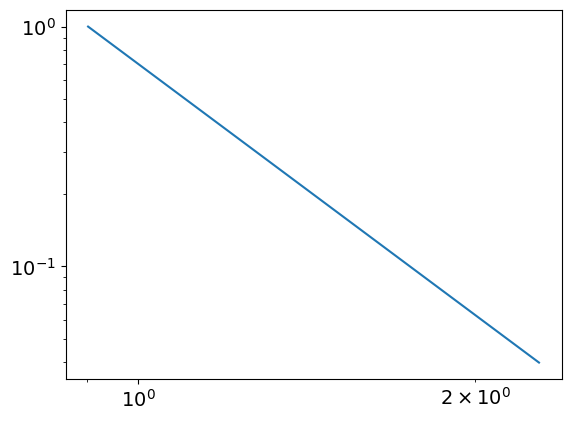

4.475618077777349
0.9014991799252144
powerlaw KstestResult(statistic=0.9693277077095068, pvalue=0.0, statistic_location=1.1818970538489906, statistic_sign=1)
lognorm KstestResult(statistic=0.9745924574346716, pvalue=0.0, statistic_location=1.224550219214839, statistic_sign=1)
tensor(0.0818, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2220, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6995, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1647, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
459
tensor(7.2977e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


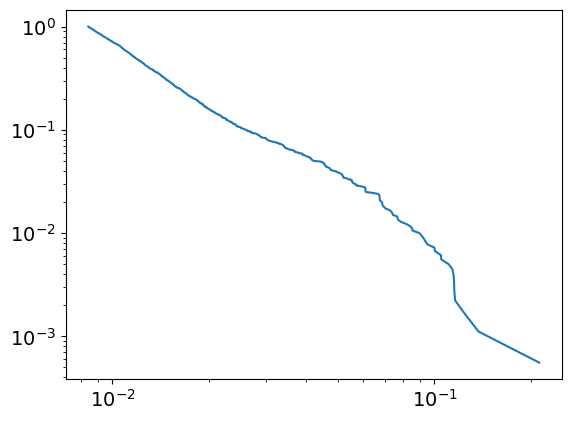

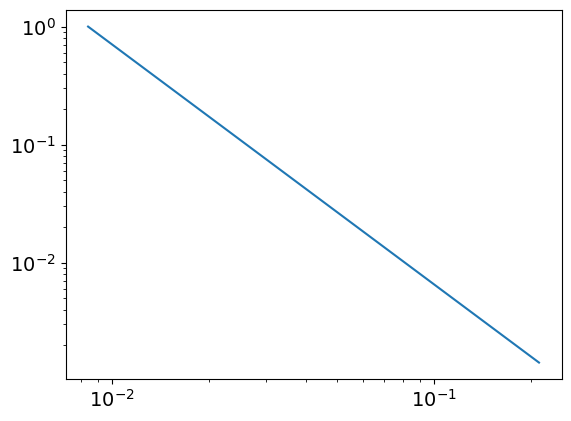

3.0323136002793287
0.008408807613425351
powerlaw KstestResult(statistic=0.9986884743424636, pvalue=0.0, statistic_location=0.08531412241836259, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21145003807578835, statistic_sign=1)
tensor(2.3471e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5763, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.8426, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
459
tensor(0.2716, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


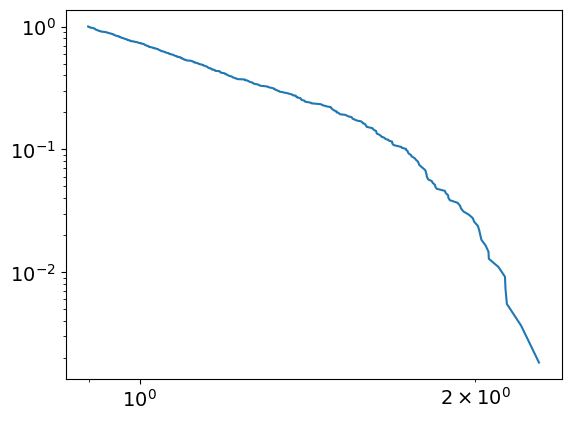

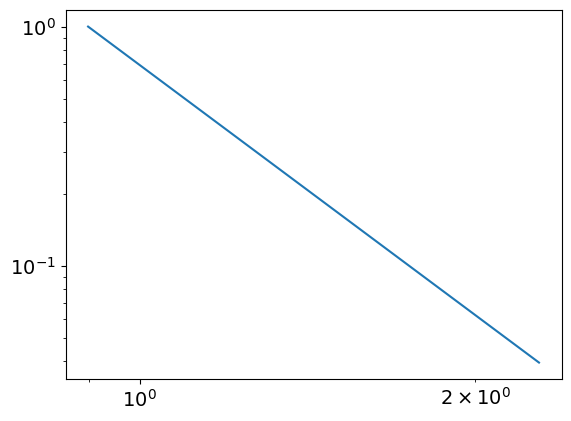

4.470995706502726
0.8989316182101212
powerlaw KstestResult(statistic=0.9691450396562484, pvalue=0.0, statistic_location=1.1822806924058493, statistic_sign=1)
lognorm KstestResult(statistic=0.9745631502332575, pvalue=0.0, statistic_location=1.2255252893318758, statistic_sign=1)
tensor(0.0819, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2221, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7017, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1698, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
460
tensor(8.0047e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


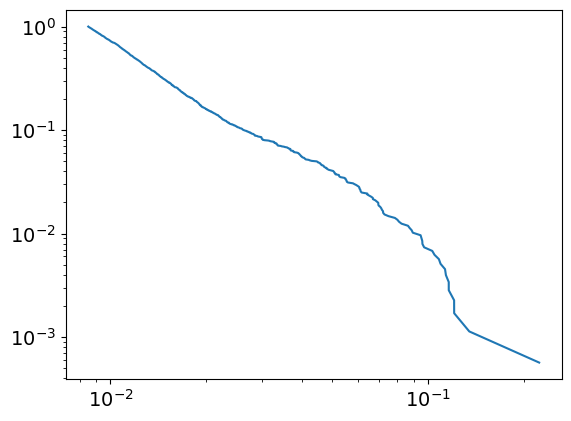

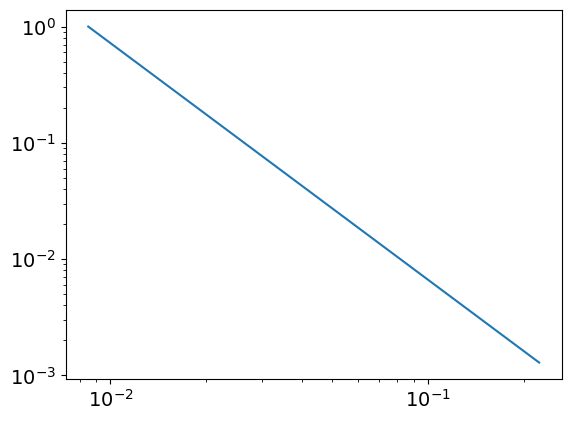

3.0366318442478257
0.008515619130884475
powerlaw KstestResult(statistic=0.998635715098056, pvalue=0.0, statistic_location=0.08877853441485653, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2236519771989795, statistic_sign=1)
tensor(2.8126e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7479, device='cuda:0', grad_fn=<MeanBackward0>) tensor(46.2805, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
460
tensor(0.2720, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


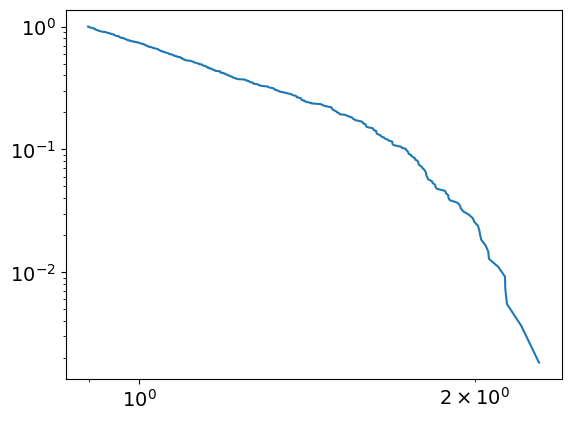

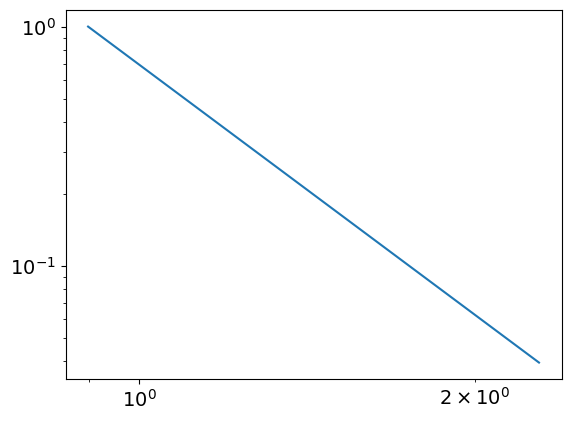

4.472058303855138
0.8992221588338568
powerlaw KstestResult(statistic=0.9691391838238512, pvalue=0.0, statistic_location=1.1827603621966167, statistic_sign=1)
lognorm KstestResult(statistic=0.9745304466296644, pvalue=0.0, statistic_location=1.2265543528350438, statistic_sign=1)
tensor(0.0820, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2221, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7040, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1750, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
461
tensor(6.5112e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


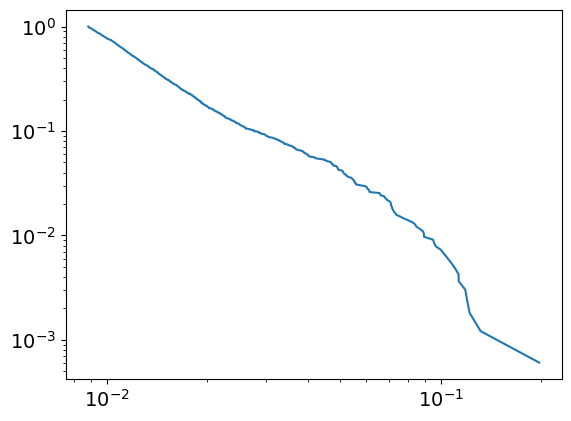

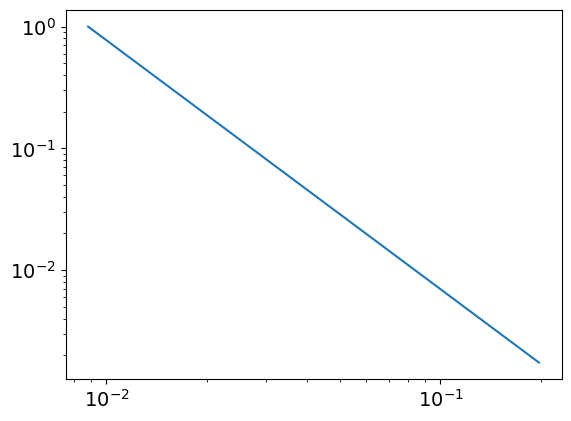

3.044501699279377
0.008816208688916149
powerlaw KstestResult(statistic=0.9987130590784057, pvalue=0.0, statistic_location=0.113309412673017, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19726332536230615, statistic_sign=1)
tensor(3.3281e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4787, device='cuda:0', grad_fn=<MeanBackward0>) tensor(38.9224, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
461
tensor(0.2725, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


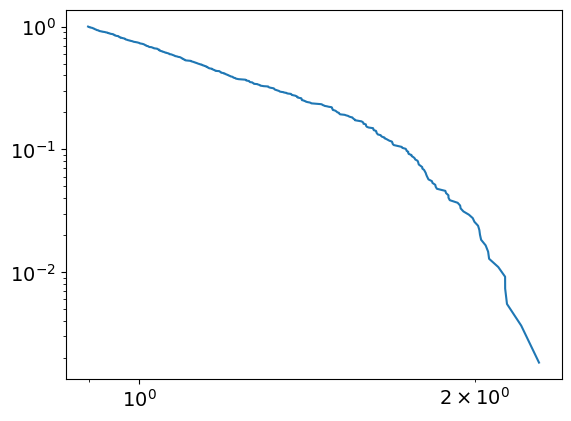

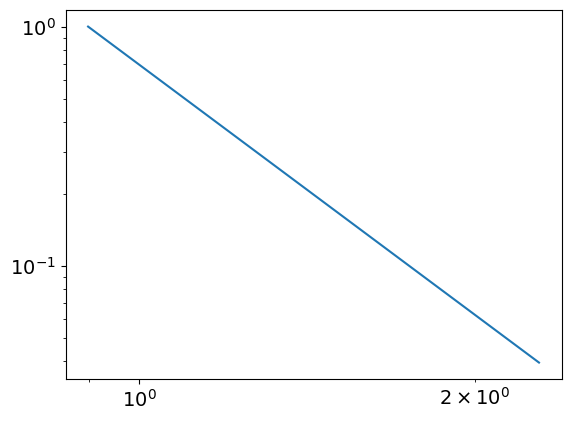

4.468431424642405
0.8991039581747381
powerlaw KstestResult(statistic=0.9690129932249963, pvalue=0.0, statistic_location=1.1845658866898283, statistic_sign=1)
lognorm KstestResult(statistic=0.9744975865003446, pvalue=0.0, statistic_location=1.2275134142385398, statistic_sign=1)
tensor(0.0821, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2222, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7062, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1804, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
462
tensor(6.2376e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


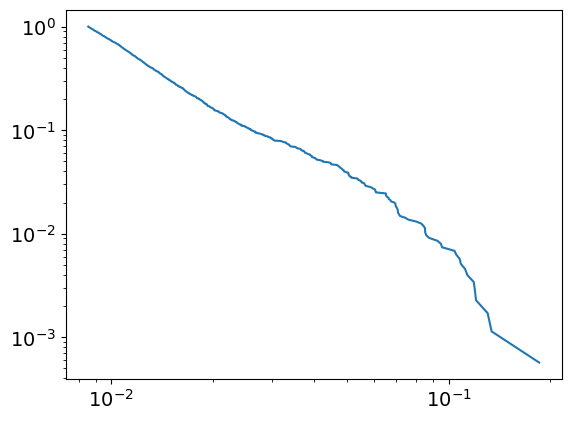

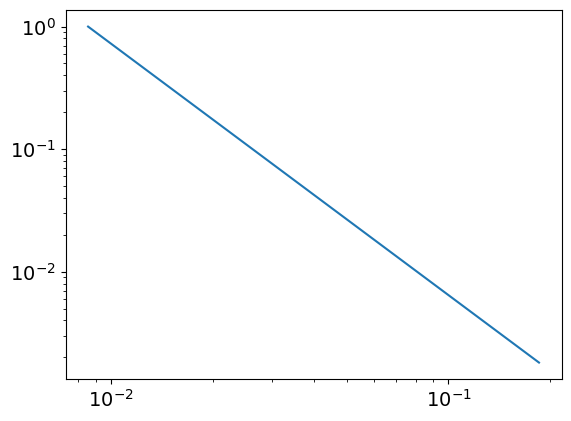

3.0515551261369875
0.00854916807191669
powerlaw KstestResult(statistic=0.9987117776270245, pvalue=0.0, statistic_location=0.11363205209032615, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18555071933339976, statistic_sign=1)
tensor(3.9341e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3358, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.8423, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
462
tensor(0.2730, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


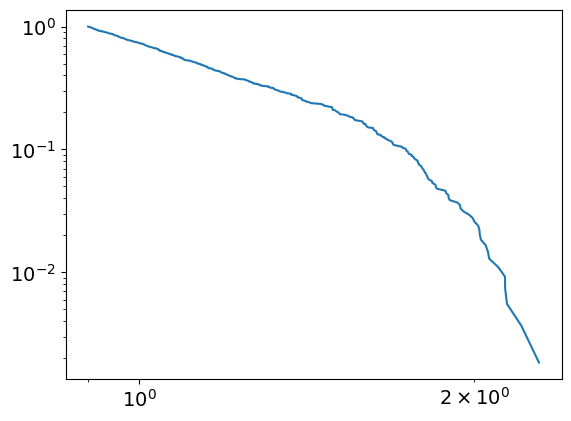

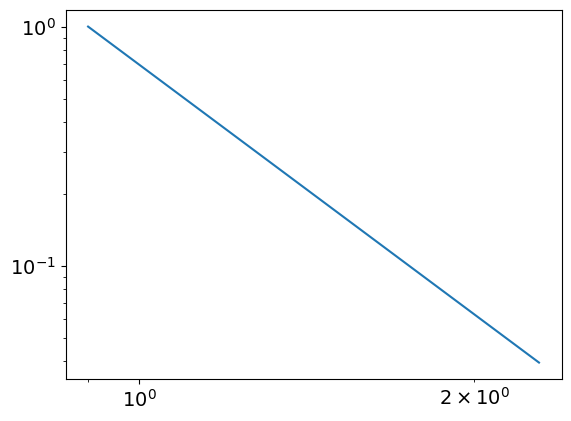

4.462143157611637
0.8998160542674956
powerlaw KstestResult(statistic=0.9689137576870288, pvalue=0.0, statistic_location=1.1864733955586533, statistic_sign=1)
lognorm KstestResult(statistic=0.9744607101656585, pvalue=0.0, statistic_location=1.2285375449209335, statistic_sign=1)
tensor(0.0822, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2223, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7085, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1856, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
463
tensor(6.3713e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


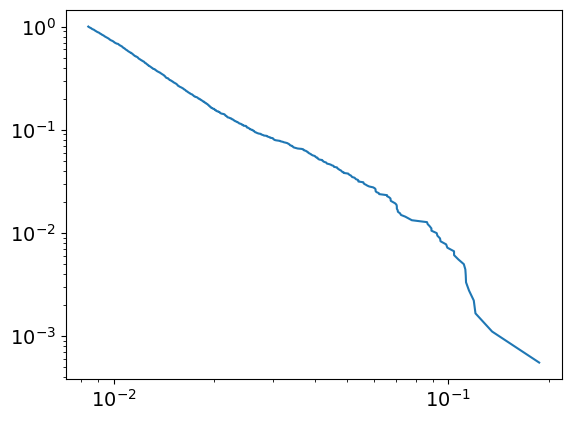

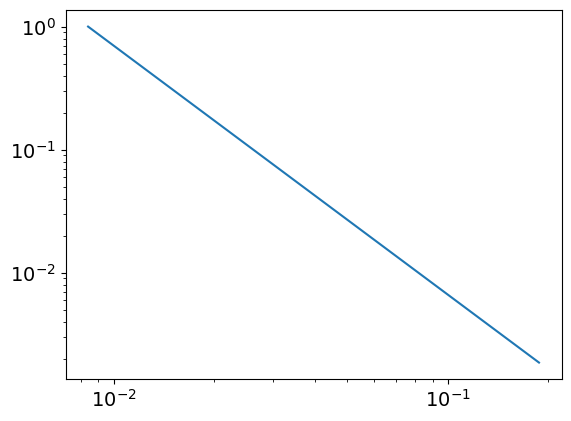

3.0239005288157967
0.008387936475726759
powerlaw KstestResult(statistic=0.9985791452548884, pvalue=0.0, statistic_location=0.11552272950167314, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18733440728880554, statistic_sign=1)
tensor(4.0820e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4200, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.6517, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
463
tensor(0.2734, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


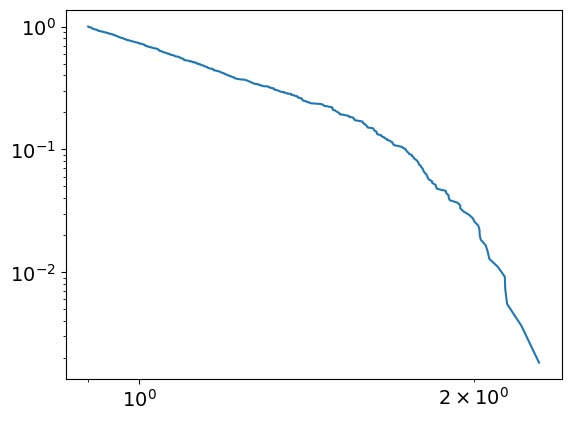

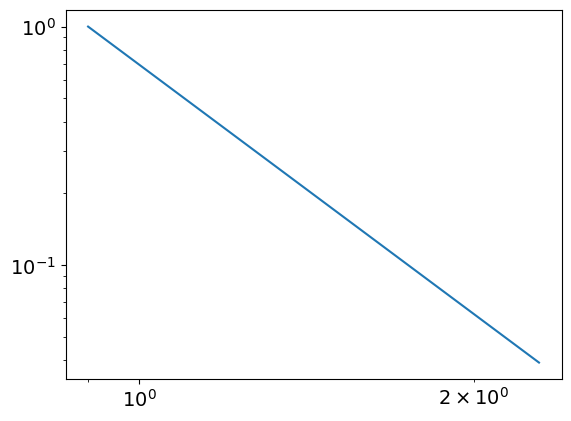

4.471776816324541
0.8997379863432842
powerlaw KstestResult(statistic=0.9688924037681479, pvalue=0.0, statistic_location=1.201397561914188, statistic_sign=1)
lognorm KstestResult(statistic=0.9744252292868315, pvalue=0.0, statistic_location=1.2294365651521741, statistic_sign=1)
tensor(0.0823, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2223, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7108, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1910, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
464
tensor(6.8660e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


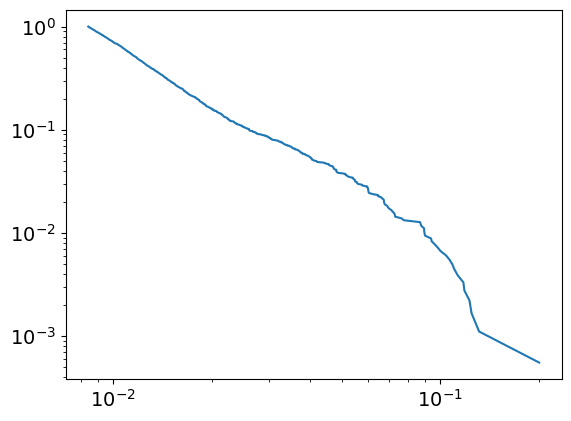

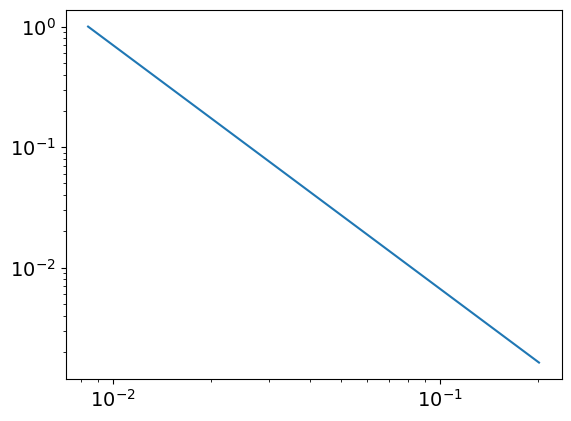

3.0215719629042943
0.008396718913005603
powerlaw KstestResult(statistic=0.9985186552027249, pvalue=0.0, statistic_location=0.11327059718527273, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20091637452073954, statistic_sign=1)
tensor(2.2699e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5369, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.1954, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
464
tensor(0.2738, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


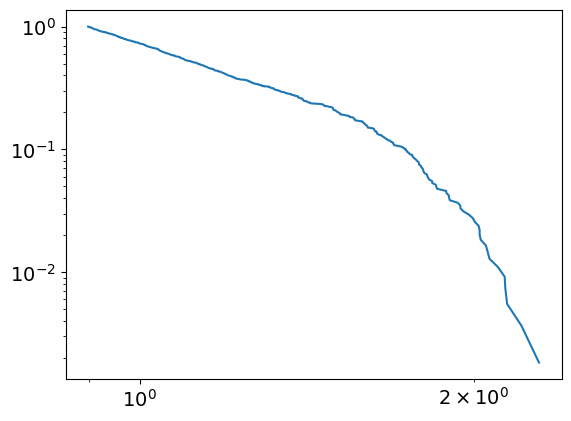

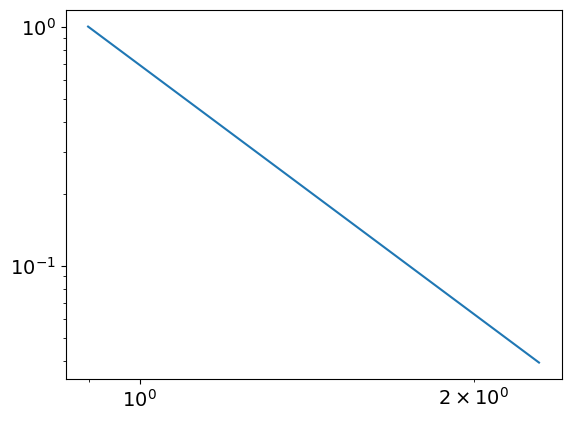

4.45912608189918
0.8985034604382541
powerlaw KstestResult(statistic=0.9686940706190849, pvalue=0.0, statistic_location=1.1700742968335411, statistic_sign=1)
lognorm KstestResult(statistic=0.9743859810117933, pvalue=0.0, statistic_location=1.2304029301841184, statistic_sign=1)
tensor(0.0824, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2223, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7130, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.1963, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
465
tensor(7.2487e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


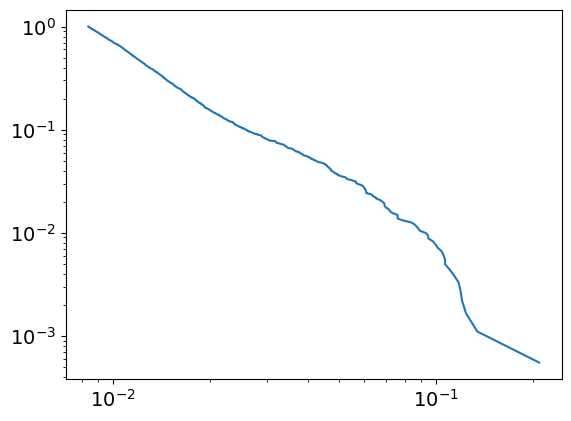

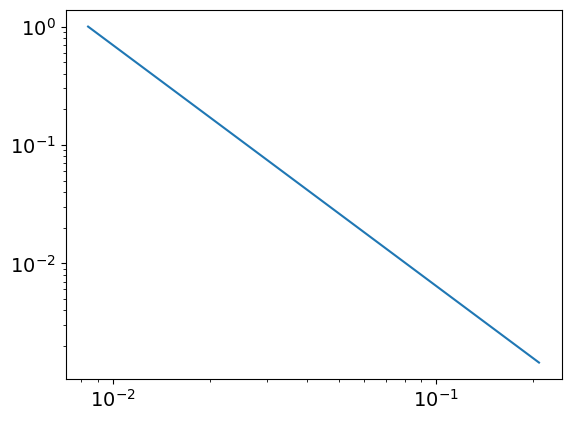

3.03549111741369
0.0083864904183041
powerlaw KstestResult(statistic=0.9985439617529185, pvalue=0.0, statistic_location=0.11354006763594916, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2082447846247756, statistic_sign=1)
tensor(2.1242e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6631, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.4619, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
465
tensor(0.2743, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


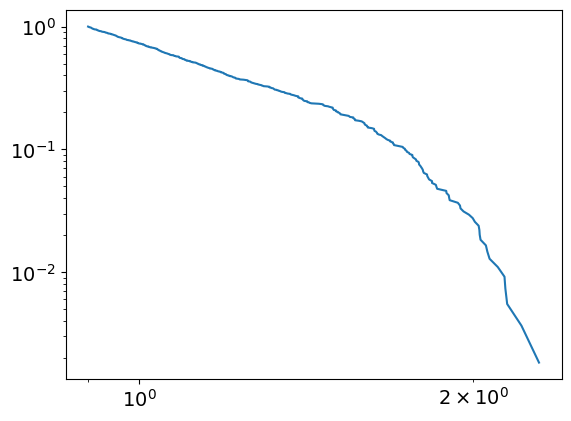

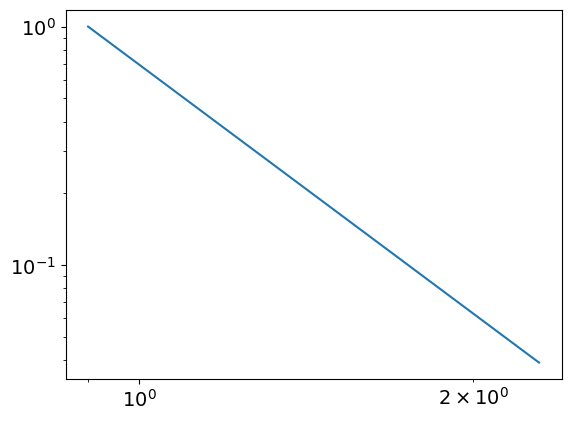

4.464969009238114
0.8996097613405754
powerlaw KstestResult(statistic=0.968812172508542, pvalue=0.0, statistic_location=1.2000376389087188, statistic_sign=1)
lognorm KstestResult(statistic=0.9743448659945336, pvalue=0.0, statistic_location=1.231358370526429, statistic_sign=1)
tensor(0.0825, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2224, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7153, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2014, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
466
tensor(7.8931e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


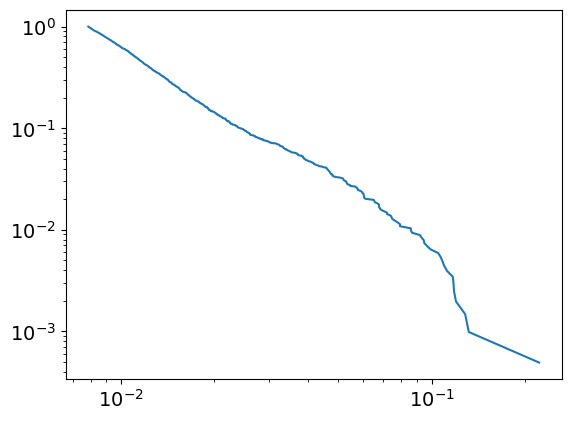

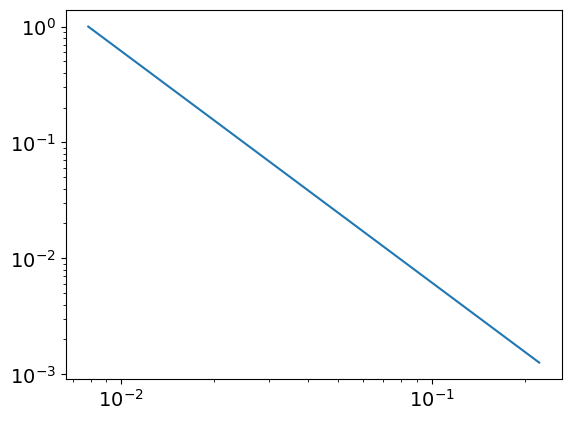

2.9989757705169193
0.007866061687335356
powerlaw KstestResult(statistic=0.9985062326730738, pvalue=0.0, statistic_location=0.08573275988442267, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2218073484329096, statistic_sign=1)
tensor(1.6572e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6344, device='cuda:0', grad_fn=<MeanBackward0>) tensor(46.3058, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
466
tensor(0.2748, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


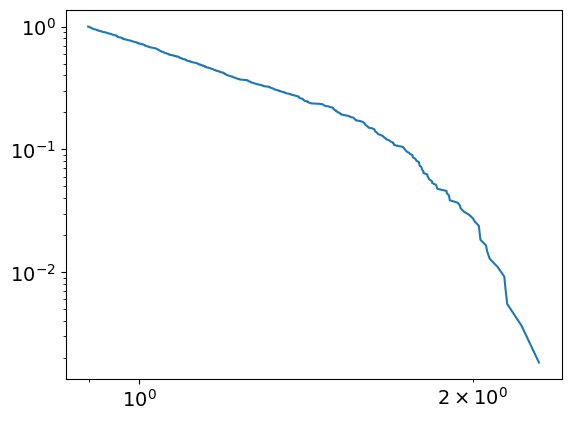

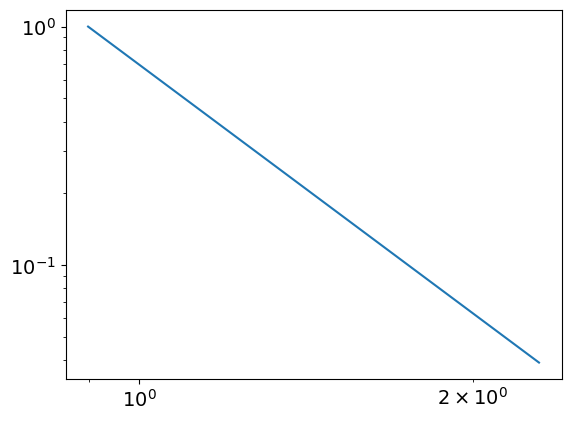

4.459696428533805
0.8989207753424483
powerlaw KstestResult(statistic=0.9687183244481671, pvalue=0.0, statistic_location=1.200266908168597, statistic_sign=1)
lognorm KstestResult(statistic=0.97430118187149, pvalue=0.0, statistic_location=1.2323121388430103, statistic_sign=1)
tensor(0.0826, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2224, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7175, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2067, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
467
tensor(8.8390e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


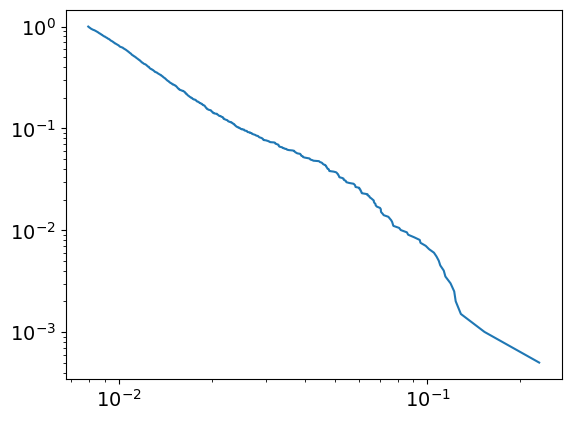

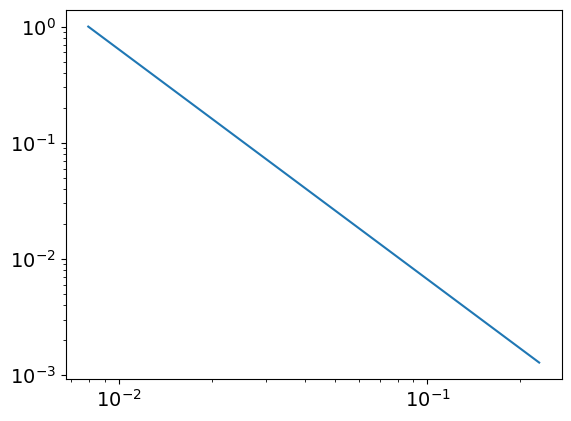

2.980917819940448
0.007968875721437733
powerlaw KstestResult(statistic=0.9985539286306877, pvalue=0.0, statistic_location=0.08195706890374965, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2299491280932649, statistic_sign=1)
tensor(2.1624e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5568, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.7066, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
467
tensor(0.2752, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


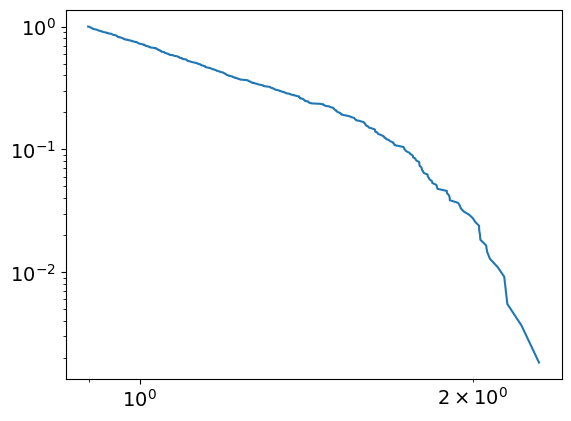

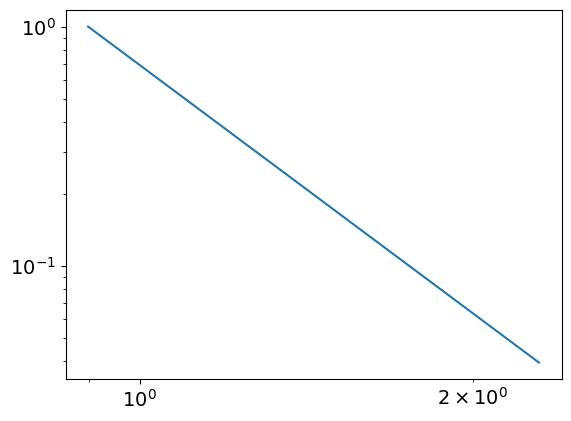

4.448426297044053
0.898235707940075
powerlaw KstestResult(statistic=0.968610680086231, pvalue=0.0, statistic_location=1.205374178472844, statistic_sign=1)
lognorm KstestResult(statistic=0.9742576293597632, pvalue=0.0, statistic_location=1.2332176448412522, statistic_sign=1)
tensor(0.0827, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2225, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7197, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2120, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
468
tensor(7.4428e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


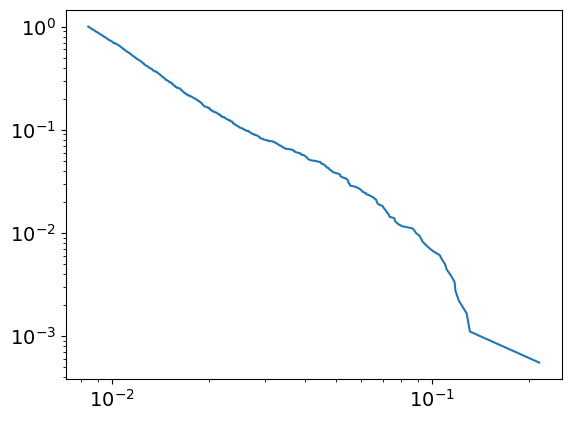

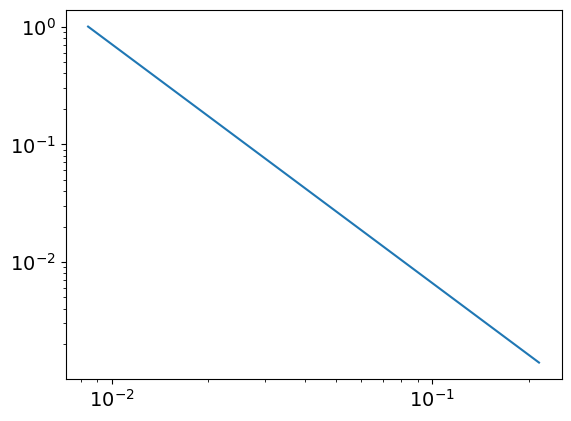

3.026701621188771
0.0084146530050496
powerlaw KstestResult(statistic=0.9986268897376074, pvalue=0.0, statistic_location=0.11429805611983301, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21565083376245658, statistic_sign=1)
tensor(1.5927e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6237, device='cuda:0', grad_fn=<MeanBackward0>) tensor(43.8487, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
468
tensor(0.2756, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


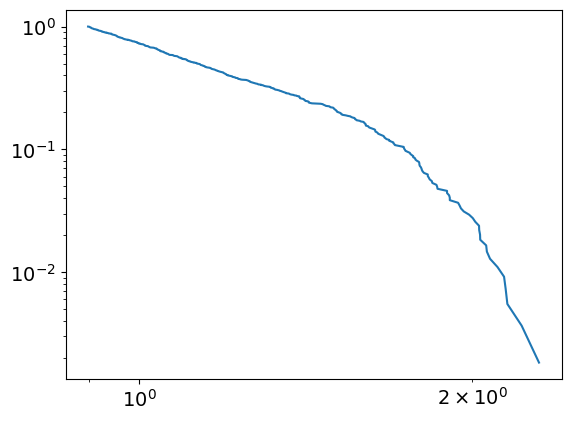

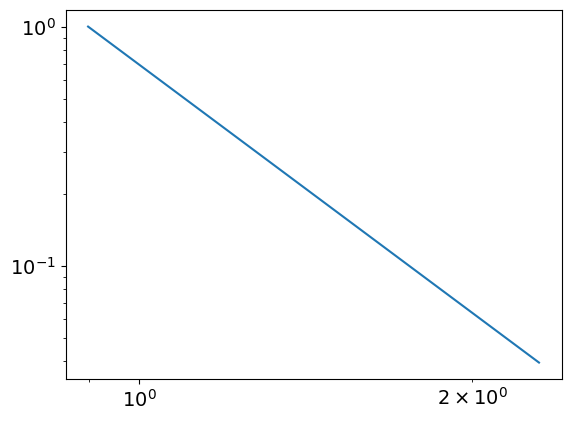

4.443626502780775
0.8985260386775767
powerlaw KstestResult(statistic=0.9686153156559115, pvalue=0.0, statistic_location=1.201784606659652, statistic_sign=1)
lognorm KstestResult(statistic=0.9742089410837202, pvalue=0.0, statistic_location=1.234179710567463, statistic_sign=1)
tensor(0.0828, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2225, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7220, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2172, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
469
tensor(7.6472e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


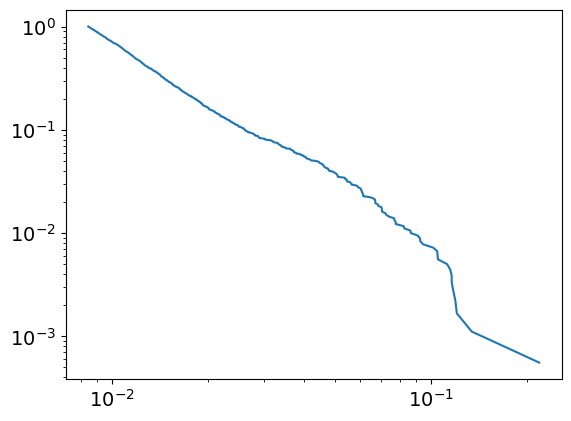

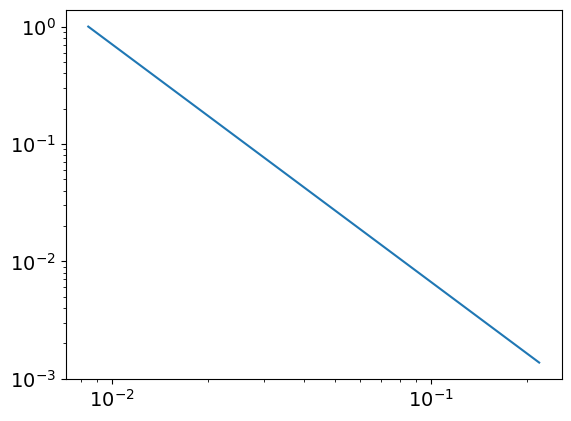

3.024746416708284
0.008439304167394242
powerlaw KstestResult(statistic=0.9984746028436835, pvalue=0.0, statistic_location=0.08227796930196991, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21897619979494665, statistic_sign=1)
tensor(1.0737e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8840, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.7125, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
469
tensor(0.2761, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


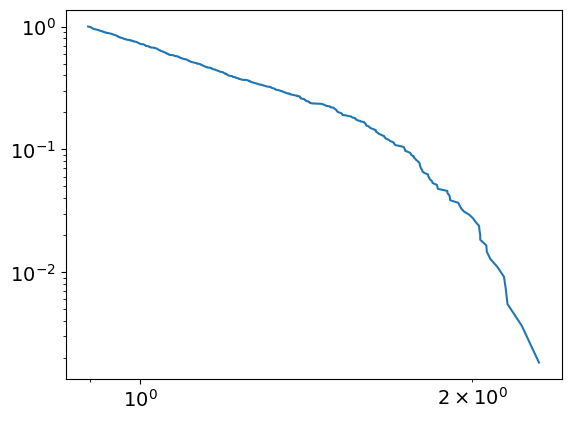

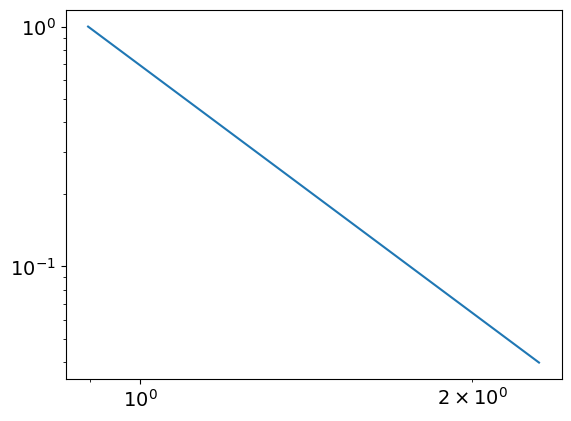

4.427712350875292
0.897006719449038
powerlaw KstestResult(statistic=0.968383574075316, pvalue=0.0, statistic_location=1.203754488820212, statistic_sign=1)
lognorm KstestResult(statistic=0.9741576608986493, pvalue=0.0, statistic_location=1.2351345328956658, statistic_sign=1)
tensor(0.0829, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2226, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7242, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2226, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
470
tensor(8.7770e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


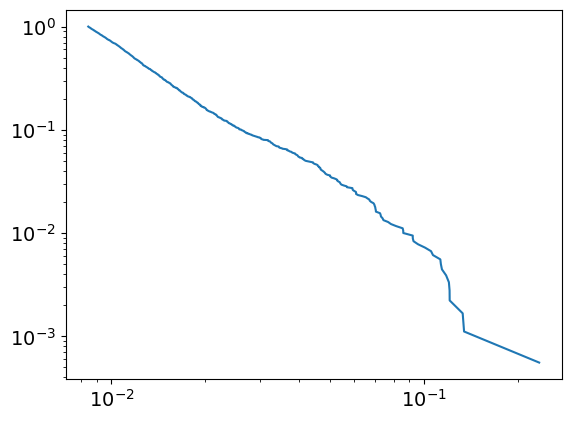

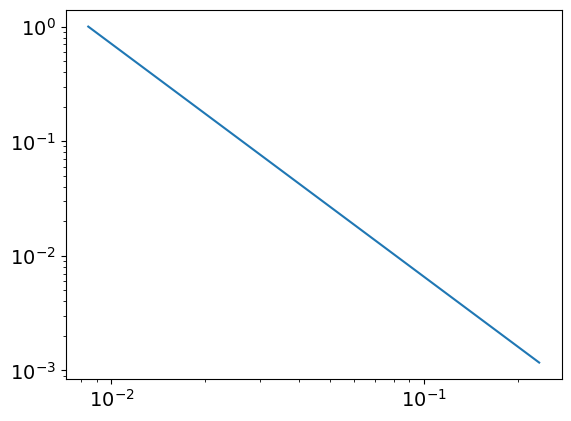

3.030939008934765
0.008434965450738479
powerlaw KstestResult(statistic=0.9985566990268104, pvalue=0.0, statistic_location=0.0768972874627152, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12102903793741743, statistic_sign=-1)
tensor(-9.4463e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.0067, device='cuda:0', grad_fn=<MeanBackward0>) tensor(51.1630, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
470
tensor(0.2765, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


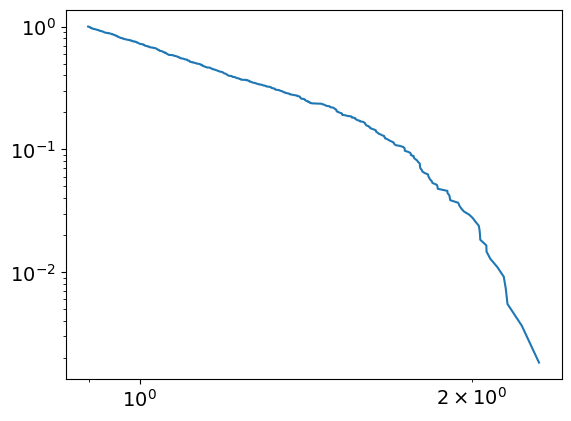

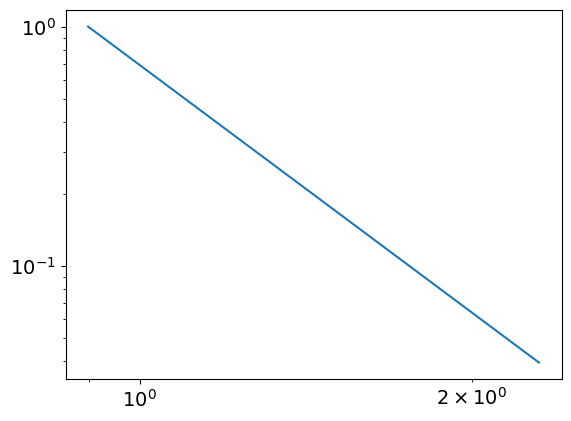

4.4341184104741345
0.8981458040264109
powerlaw KstestResult(statistic=0.9685424644005574, pvalue=0.0, statistic_location=1.2033319787070007, statistic_sign=1)
lognorm KstestResult(statistic=0.9741048003350186, pvalue=0.0, statistic_location=1.236061142264334, statistic_sign=1)
tensor(0.0830, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2226, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7265, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2281, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
471
tensor(9.1378e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


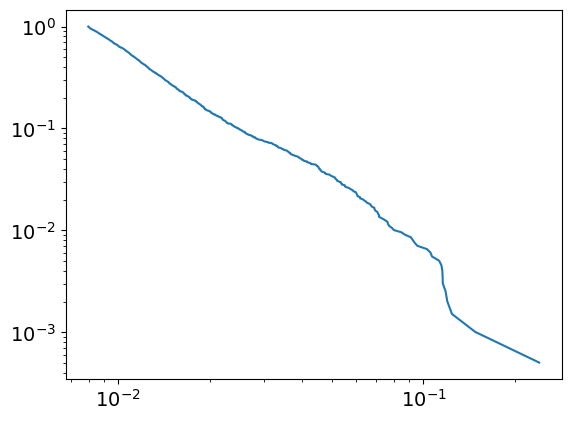

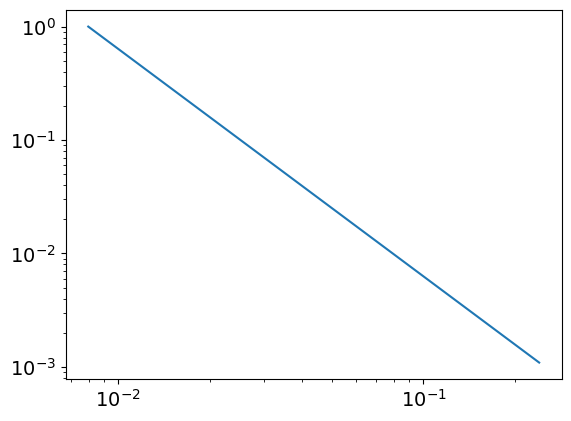

3.0054386303036975
0.007979022402391647
powerlaw KstestResult(statistic=0.9985088770029408, pvalue=0.0, statistic_location=0.11573202090666564, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2394684610710395, statistic_sign=1)
tensor(2.9462e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1475, device='cuda:0', grad_fn=<MeanBackward0>) tensor(53.1237, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
471
tensor(0.2770, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


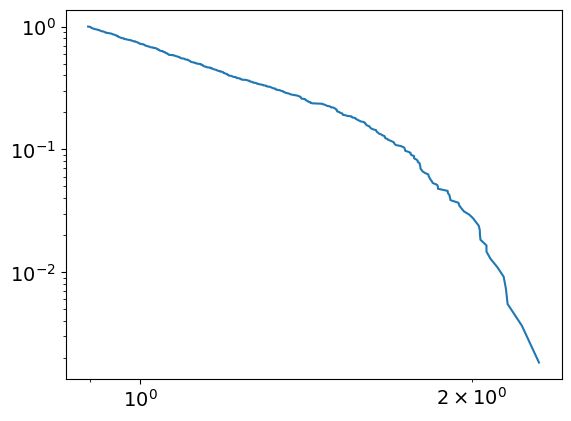

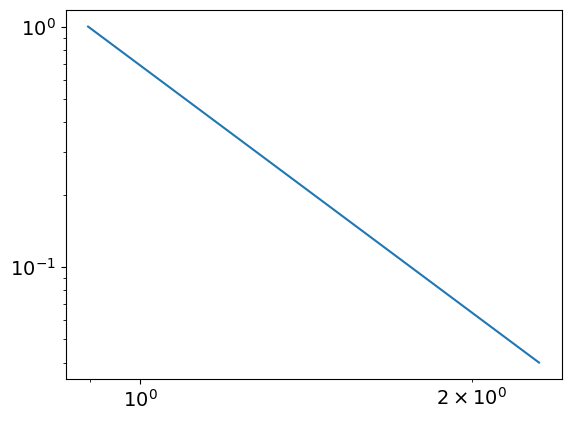

4.414695449188629
0.8968441872518195
powerlaw KstestResult(statistic=0.9682610203572278, pvalue=0.0, statistic_location=1.2040999134887895, statistic_sign=1)
lognorm KstestResult(statistic=0.9740482394694737, pvalue=0.0, statistic_location=1.2370149648553515, statistic_sign=1)
tensor(0.0831, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2227, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7287, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2334, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
472
tensor(1.0285e-06, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


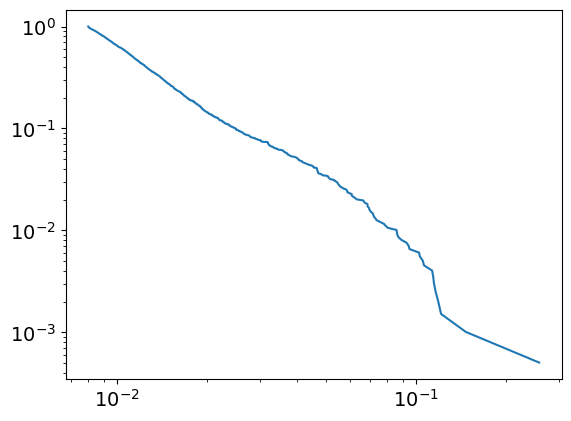

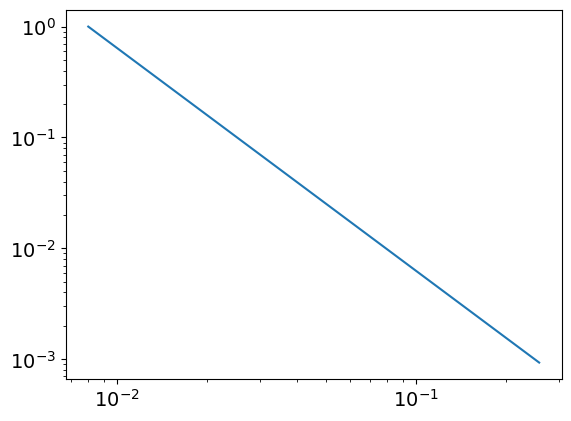

3.0094840362604893
0.007999181092529537
powerlaw KstestResult(statistic=0.9985585034429695, pvalue=0.0, statistic_location=0.11461372455560125, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.25768703714015767, statistic_sign=1)
tensor(7.0461e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.3732, device='cuda:0', grad_fn=<MeanBackward0>) tensor(59.7667, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
472
tensor(0.2775, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


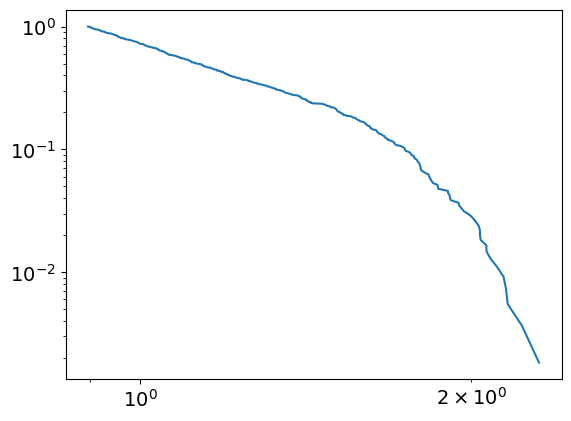

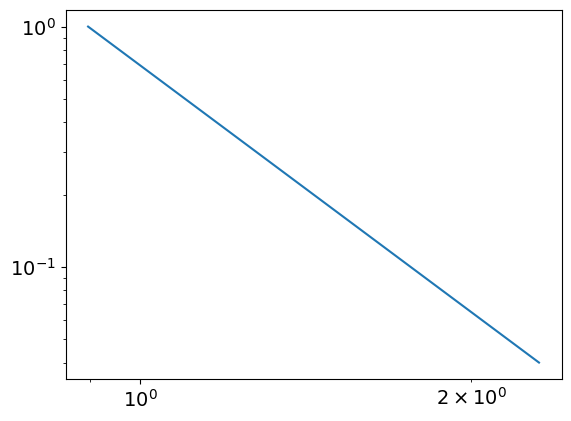

4.407760414967746
0.8965060449952609
powerlaw KstestResult(statistic=0.968123147076103, pvalue=0.0, statistic_location=1.2049307927194481, statistic_sign=1)
lognorm KstestResult(statistic=0.9739881994047808, pvalue=0.0, statistic_location=1.2379727993537732, statistic_sign=1)
tensor(0.0832, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2227, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7309, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2385, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
473
tensor(1.1338e-06, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


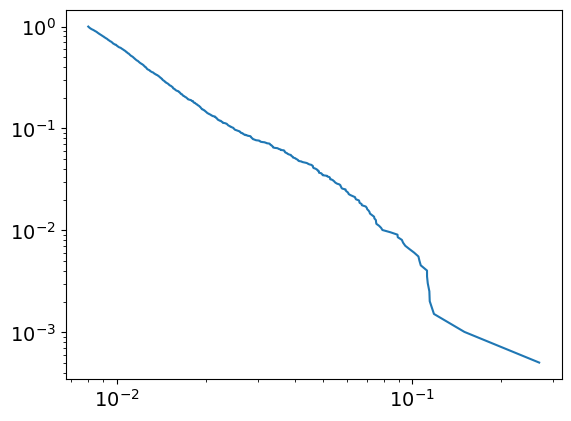

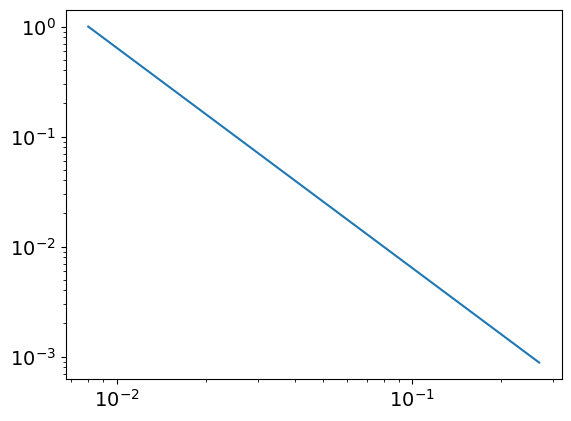

3.0016673065235486
0.007998755759121028
powerlaw KstestResult(statistic=0.9985478302786248, pvalue=0.0, statistic_location=0.07535469607007583, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2686221802717942, statistic_sign=1)
tensor(1.4590e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.6075, device='cuda:0', grad_fn=<MeanBackward0>) tensor(64.2524, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
473
tensor(0.2780, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


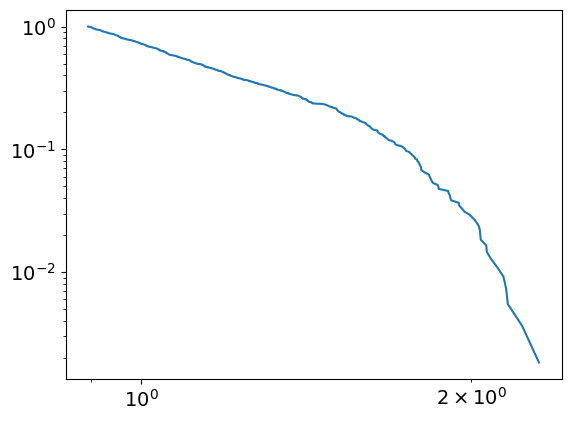

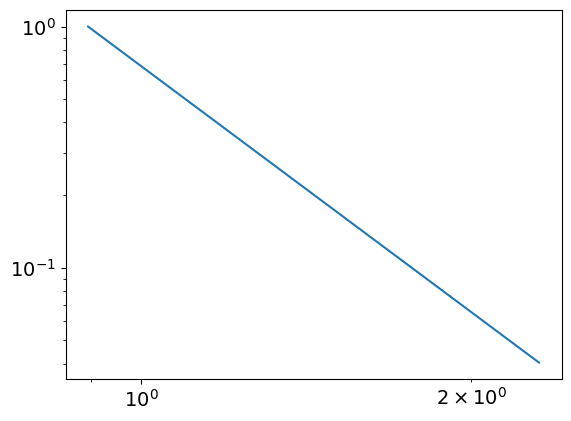

4.388939531779801
0.8942677798742228
powerlaw KstestResult(statistic=0.967749173895081, pvalue=0.0, statistic_location=1.1752930836625193, statistic_sign=1)
lognorm KstestResult(statistic=0.9739251415340757, pvalue=0.0, statistic_location=1.2389334904467224, statistic_sign=1)
tensor(0.0833, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2228, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7331, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2439, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
474
tensor(8.7852e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


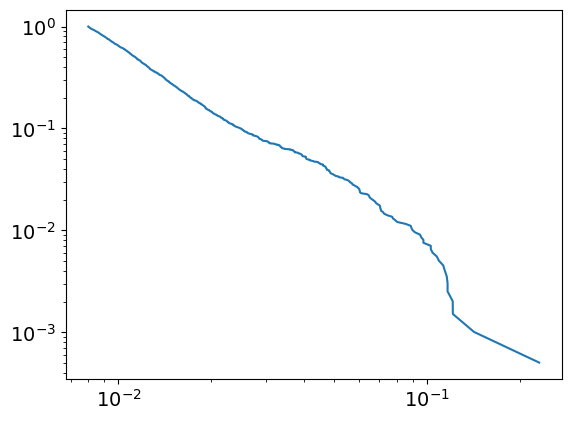

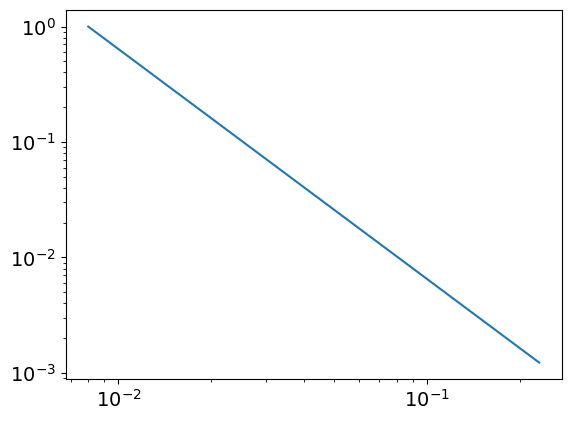

2.994878180823025
0.007988145639548017
powerlaw KstestResult(statistic=0.9983661366470529, pvalue=0.0, statistic_location=0.07869683883971072, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.23015924277119604, statistic_sign=1)
tensor(7.7759e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8944, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.1407, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
474
tensor(0.2784, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


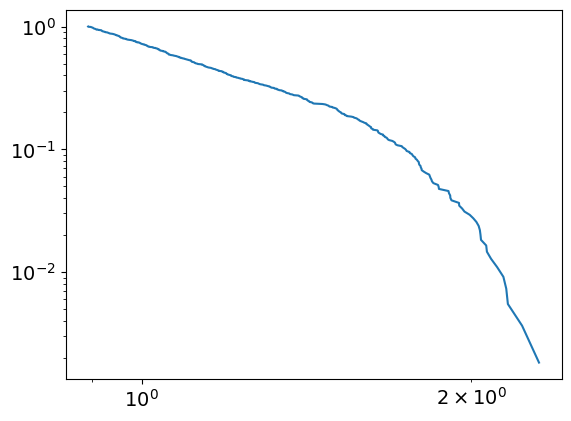

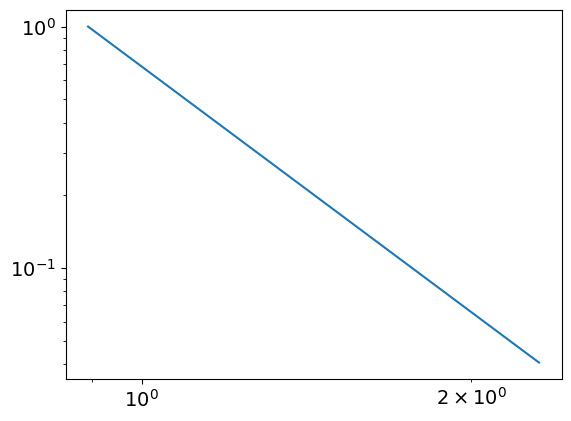

4.375958020163495
0.8929203314744432
powerlaw KstestResult(statistic=0.9675633430941663, pvalue=0.0, statistic_location=1.175955306382363, statistic_sign=1)
lognorm KstestResult(statistic=0.9738545091549556, pvalue=0.0, statistic_location=1.2399559555812203, statistic_sign=1)
tensor(0.0834, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2228, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7354, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2494, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
475
tensor(9.9379e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


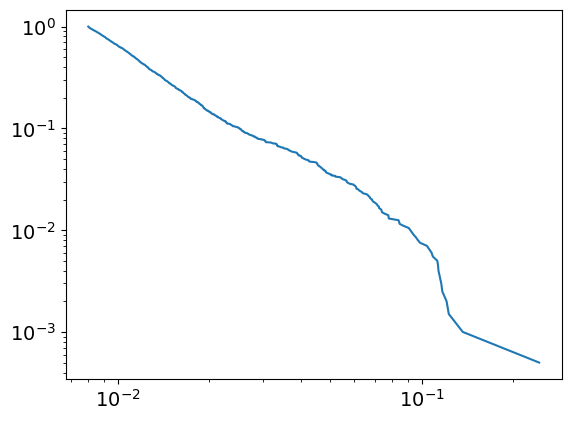

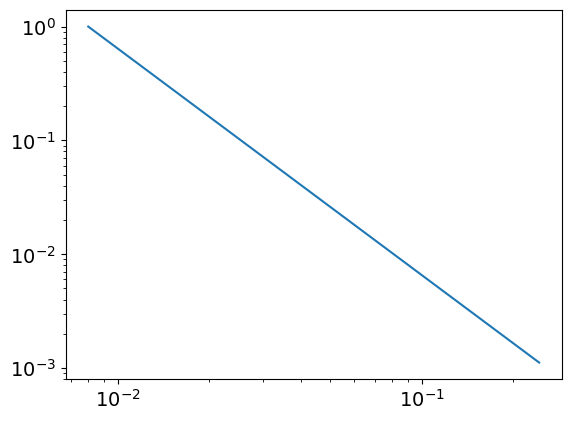

2.9879189474928514
0.00798570381649128
powerlaw KstestResult(statistic=0.9985250381136986, pvalue=0.0, statistic_location=0.09064791579989503, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12292582945768078, statistic_sign=-1)
tensor(-1.3968e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7301, device='cuda:0', grad_fn=<MeanBackward0>) tensor(52.0347, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
475
tensor(0.2789, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


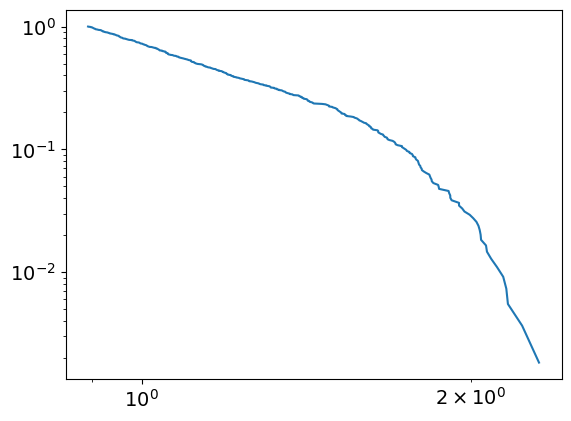

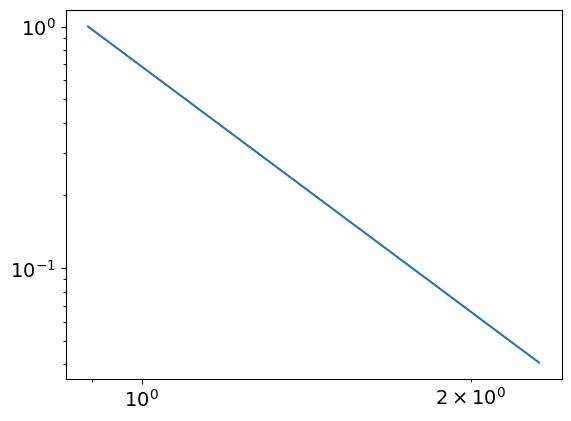

4.372118586702737
0.8933222472389671
powerlaw KstestResult(statistic=0.9675074227378238, pvalue=0.0, statistic_location=1.1769444795490922, statistic_sign=1)
lognorm KstestResult(statistic=0.9737105410494452, pvalue=0.0, statistic_location=1.242064961290868, statistic_sign=1)
tensor(0.0836, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2229, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7376, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2547, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
476
tensor(9.1907e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


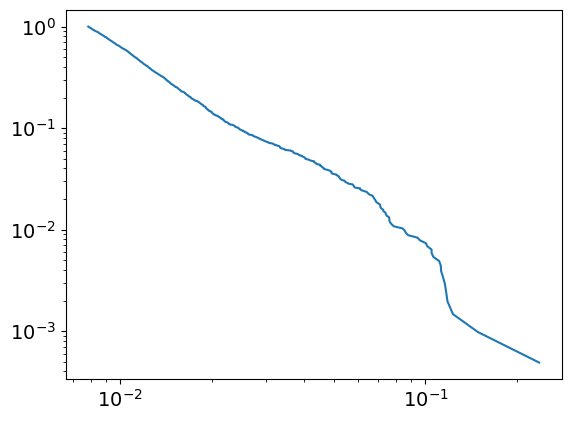

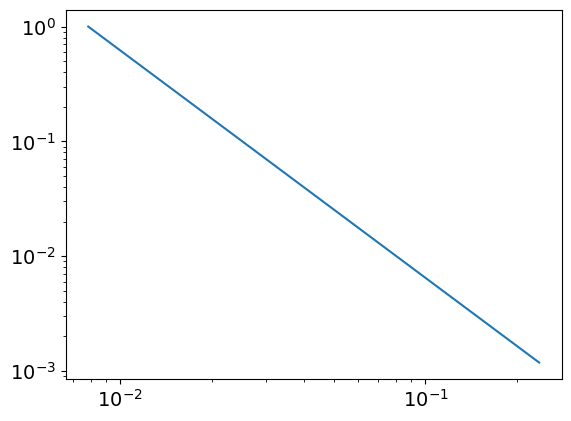

2.9813209824455287
0.007850809873591953
powerlaw KstestResult(statistic=0.9984952767094235, pvalue=0.0, statistic_location=0.11406834884097236, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.23586210871272065, statistic_sign=1)
tensor(5.0849e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8334, device='cuda:0', grad_fn=<MeanBackward0>) tensor(50.0769, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
476
tensor(0.2794, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


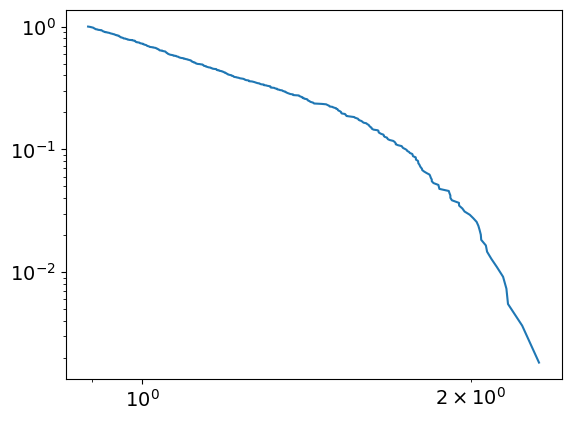

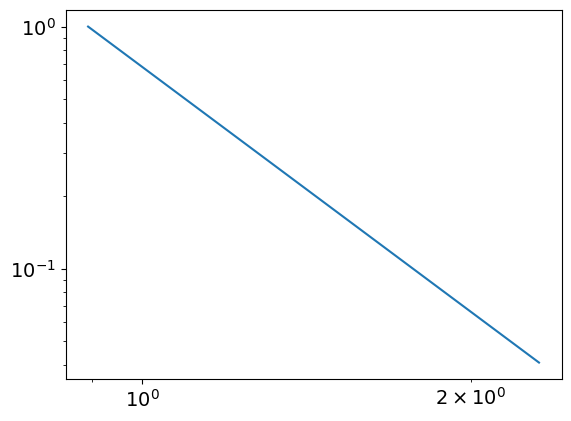

4.361154698659773
0.8926373464769347
powerlaw KstestResult(statistic=0.9673487551650364, pvalue=0.0, statistic_location=1.177865604187382, statistic_sign=1)
lognorm KstestResult(statistic=0.9735713248301023, pvalue=0.0, statistic_location=1.2140417750624137, statistic_sign=1)
tensor(0.0837, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2230, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7398, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2600, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
477
tensor(9.6530e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


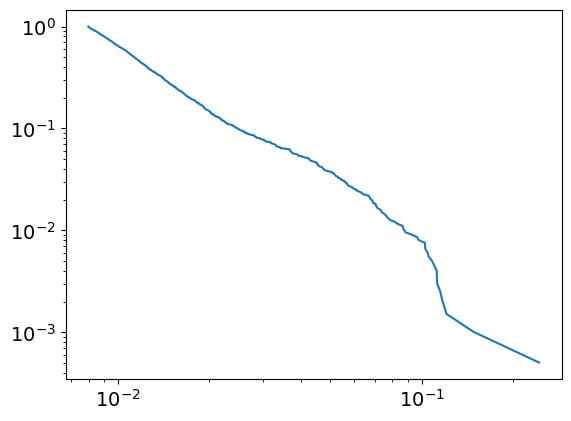

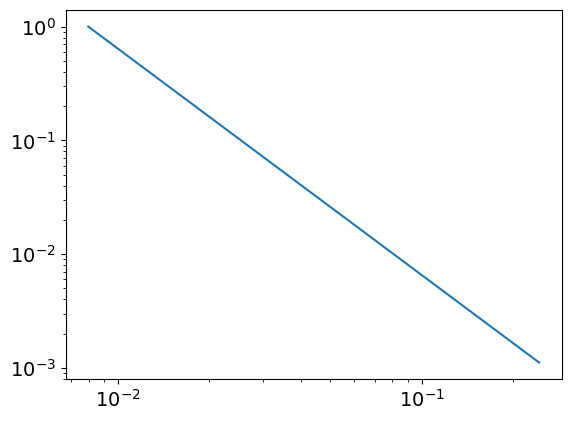

2.990930705008362
0.007985020394572277
powerlaw KstestResult(statistic=0.9985011178738505, pvalue=0.0, statistic_location=0.11480308306548372, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.24306151692547814, statistic_sign=1)
tensor(2.9965e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(1.1053, device='cuda:0', grad_fn=<MeanBackward0>) tensor(52.0769, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
477
tensor(0.2798, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


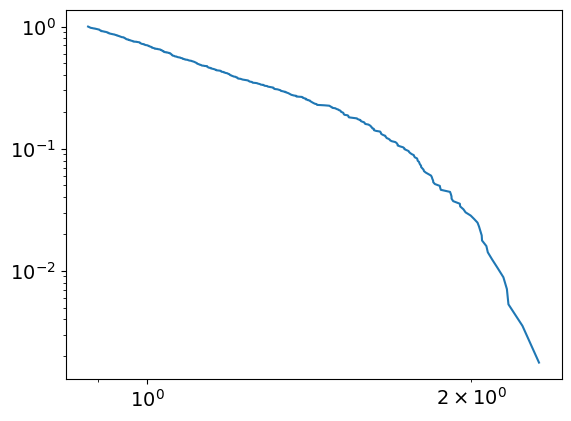

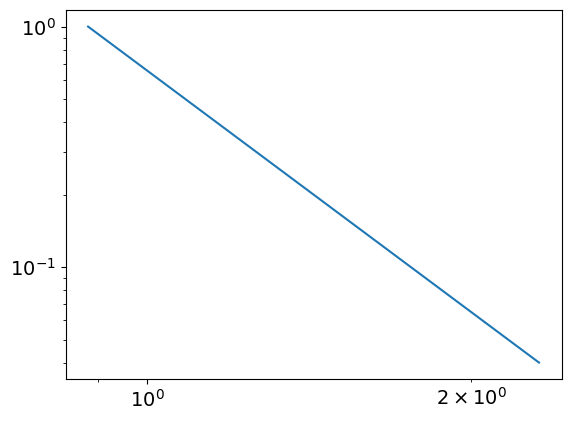

4.335533178211282
0.8816443823357013
powerlaw KstestResult(statistic=0.9665206444825573, pvalue=0.0, statistic_location=1.1596495105649613, statistic_sign=1)
lognorm KstestResult(statistic=0.9735508789699797, pvalue=0.0, statistic_location=1.2150167094543458, statistic_sign=1)
tensor(0.0838, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2230, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7420, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2654, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
478
tensor(8.6673e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


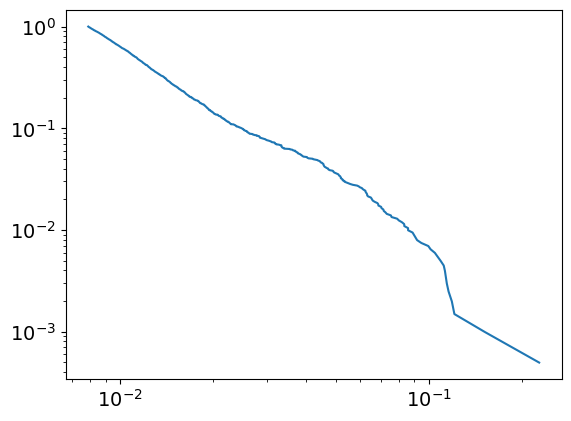

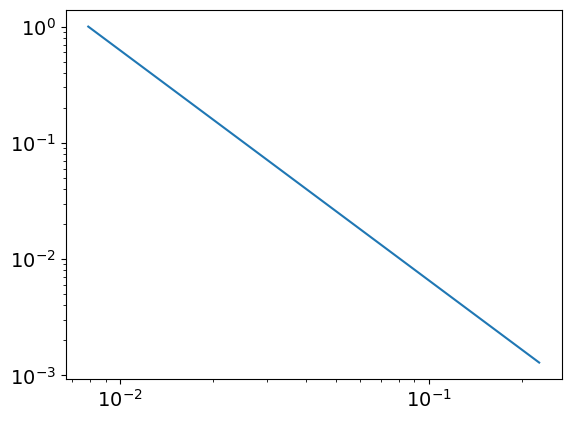

2.9807016500745283
0.007911678773397076
powerlaw KstestResult(statistic=0.9985325150119272, pvalue=0.0, statistic_location=0.08972082222185579, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22810951602236448, statistic_sign=1)
tensor(2.7013e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8936, device='cuda:0', grad_fn=<MeanBackward0>) tensor(47.5000, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
478
tensor(0.2803, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


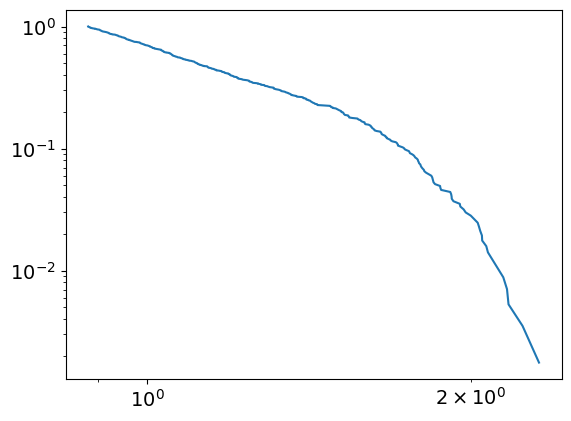

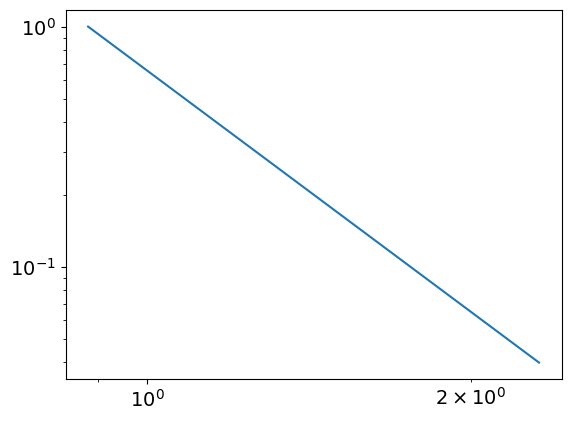

4.332508329197287
0.8806365811623326
powerlaw KstestResult(statistic=0.9664806539867541, pvalue=0.0, statistic_location=1.1590502533548952, statistic_sign=1)
lognorm KstestResult(statistic=0.9735296459853923, pvalue=0.0, statistic_location=1.2159631725922548, statistic_sign=1)
tensor(0.0839, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2231, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7442, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2706, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
479
tensor(7.7915e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


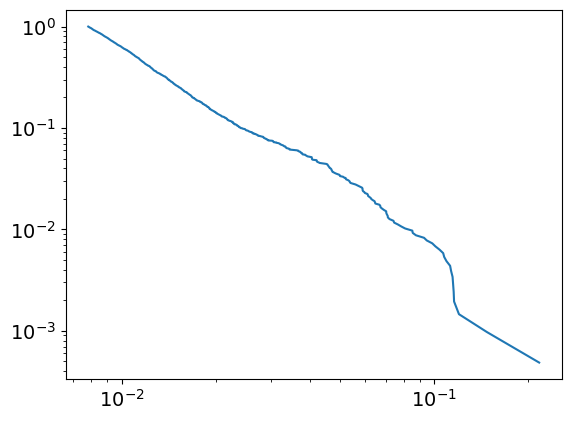

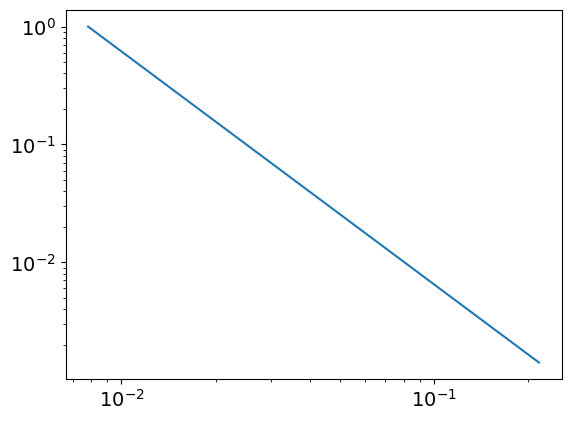

2.9763616232362793
0.007819619140322625
powerlaw KstestResult(statistic=0.9984759687709625, pvalue=0.0, statistic_location=0.07850949869632246, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21696328039415397, statistic_sign=1)
tensor(1.7719e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8440, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.3091, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
479
tensor(0.2808, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


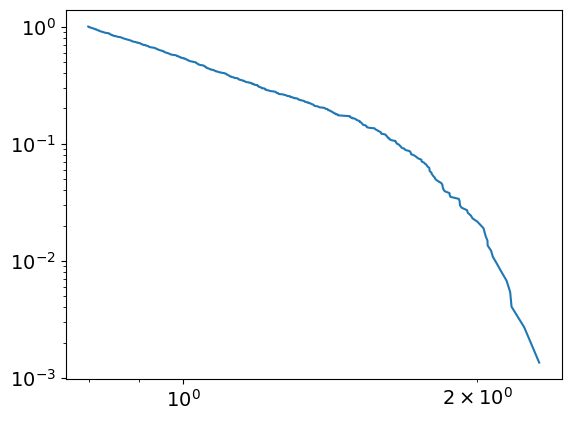

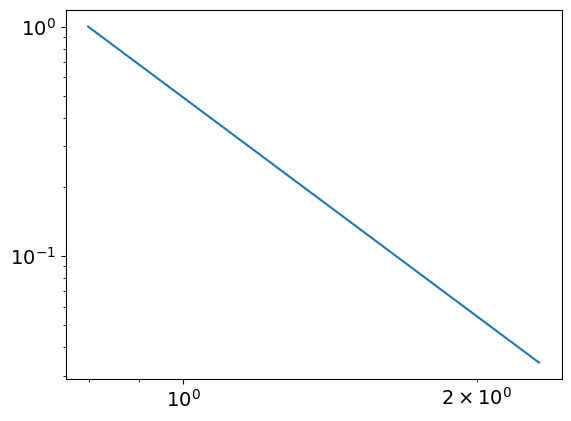

4.170573887782373
0.79871891119806
powerlaw KstestResult(statistic=0.960992749751666, pvalue=0.0, statistic_location=1.0677249964429845, statistic_sign=1)
lognorm KstestResult(statistic=0.9734947569340036, pvalue=0.0, statistic_location=1.2175040807423154, statistic_sign=1)
tensor(0.0840, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2231, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7464, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2761, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
480
tensor(7.3964e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


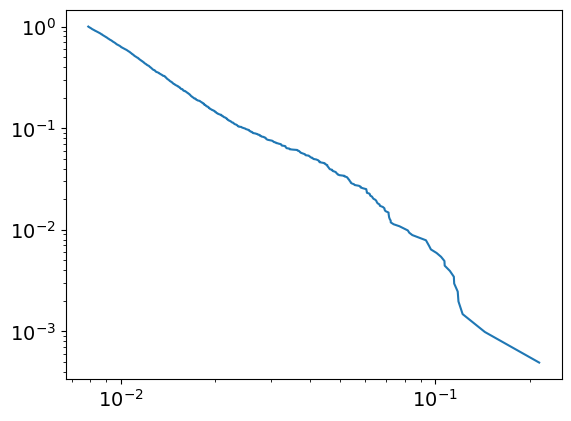

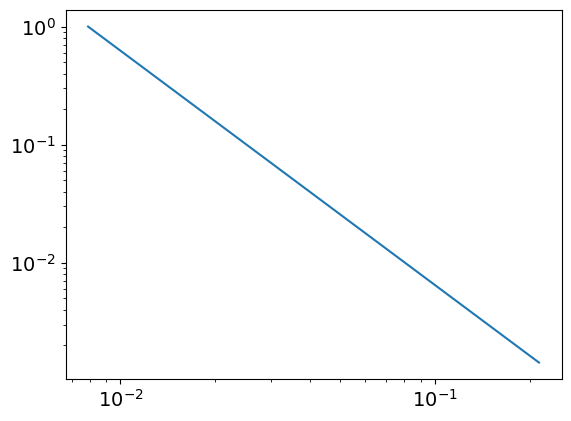

2.9844366479624984
0.00788825974966381
powerlaw KstestResult(statistic=0.9985431388675705, pvalue=0.0, statistic_location=0.08272906025076024, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2141893722010246, statistic_sign=1)
tensor(3.4078e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9035, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.8073, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
480
tensor(0.2812, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


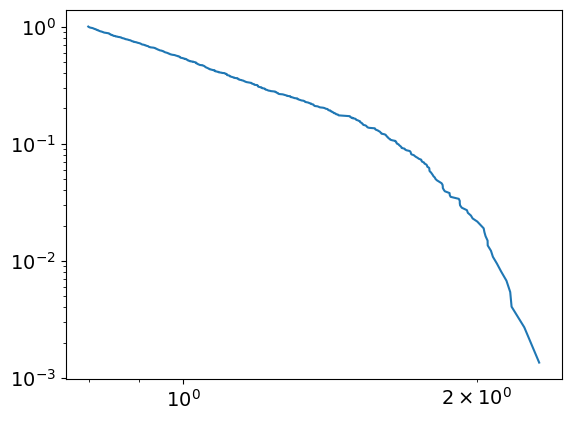

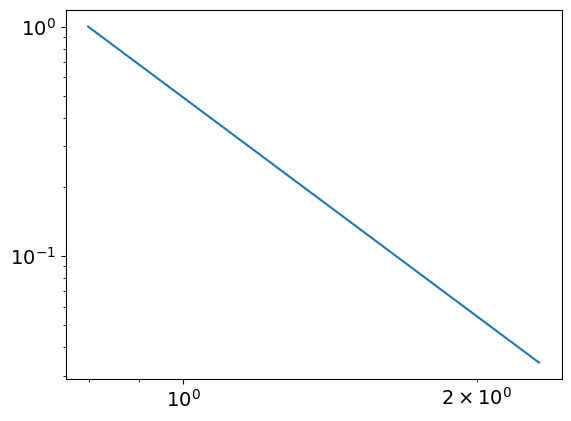

4.170098010806749
0.7987676297168753
powerlaw KstestResult(statistic=0.9609366503378604, pvalue=0.0, statistic_location=1.068593468668537, statistic_sign=1)
lognorm KstestResult(statistic=0.9734506184060372, pvalue=0.0, statistic_location=1.2193185173515055, statistic_sign=1)
tensor(0.0841, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2232, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7486, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2816, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
481
tensor(7.2507e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


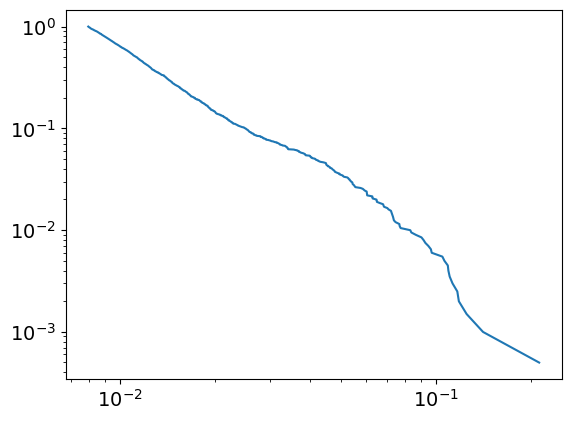

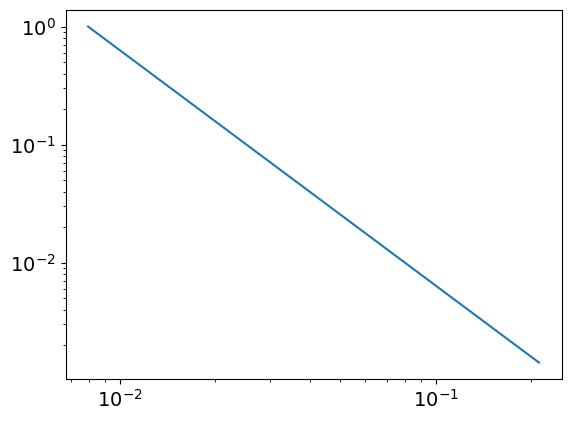

2.994453859052725
0.007953764014505257
powerlaw KstestResult(statistic=0.9986391380319684, pvalue=0.0, statistic_location=0.07743673214016085, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.2125344253880906, statistic_sign=1)
tensor(2.2594e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7476, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.2216, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
481
tensor(0.2817, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


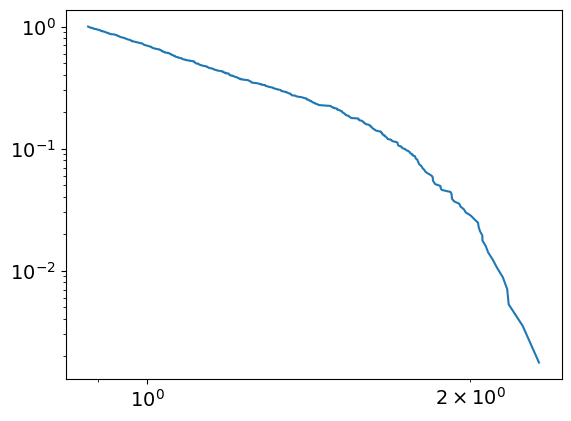

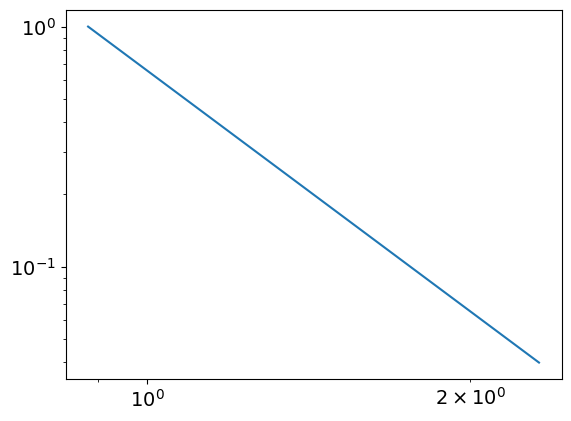

4.326869180313143
0.8806968113938828
powerlaw KstestResult(statistic=0.966356981185147, pvalue=0.0, statistic_location=1.1542992848214502, statistic_sign=1)
lognorm KstestResult(statistic=0.9734029661443439, pvalue=0.0, statistic_location=1.2210945008510854, statistic_sign=1)
tensor(0.0842, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2232, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7508, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2870, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
482
tensor(6.9775e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


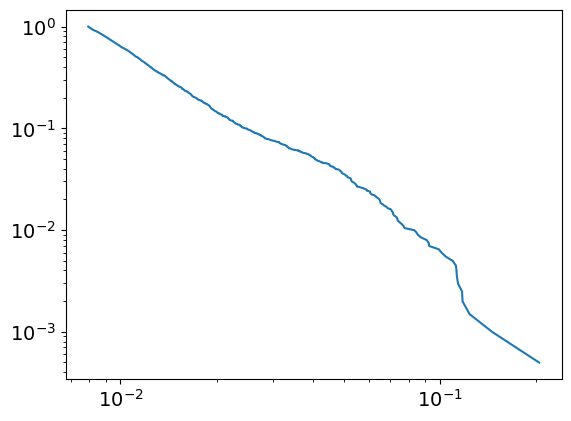

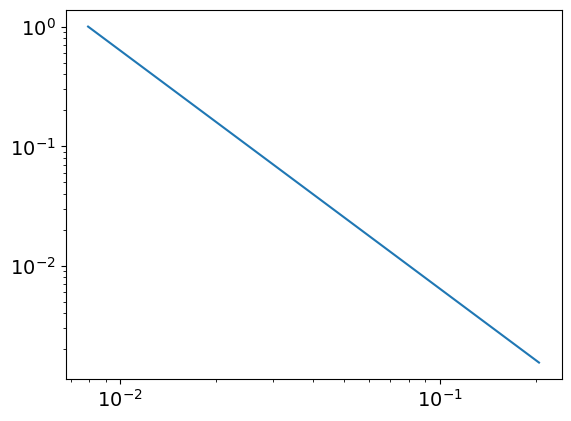

2.9910224796545144
0.007929411550501694
powerlaw KstestResult(statistic=0.9985222048553964, pvalue=0.0, statistic_location=0.09094037438551314, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20438362144353084, statistic_sign=1)
tensor(1.4977e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6624, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.8210, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
482
tensor(0.2821, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


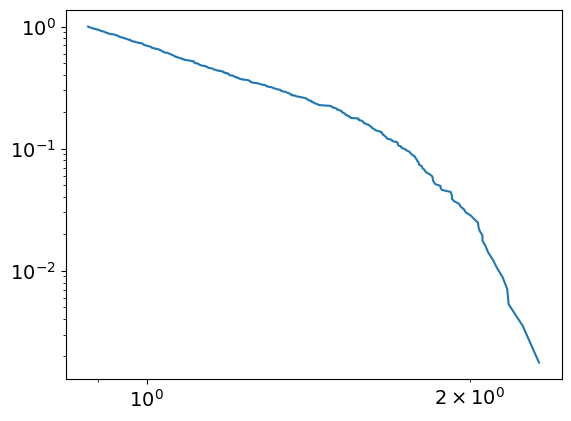

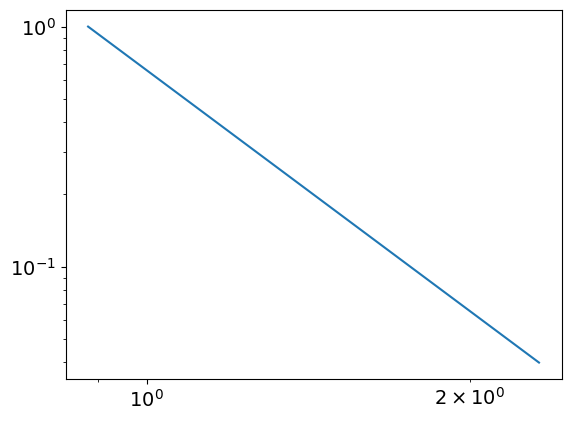

4.32894747142396
0.8814801524450492
powerlaw KstestResult(statistic=0.9664014916721948, pvalue=0.0, statistic_location=1.156672177253262, statistic_sign=1)
lognorm KstestResult(statistic=0.9733674625039196, pvalue=0.0, statistic_location=1.2299774985405556, statistic_sign=1)
tensor(0.0843, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2233, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7531, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2925, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
483
tensor(6.9952e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


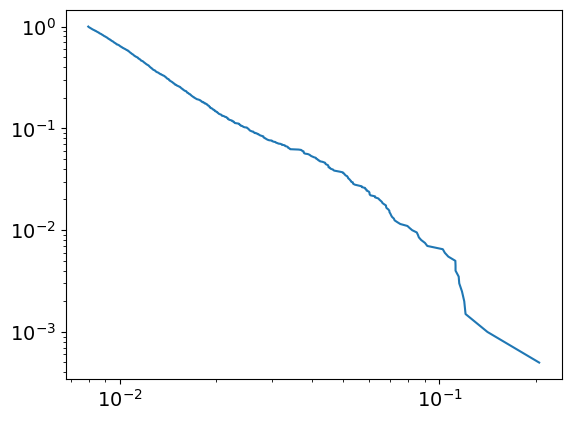

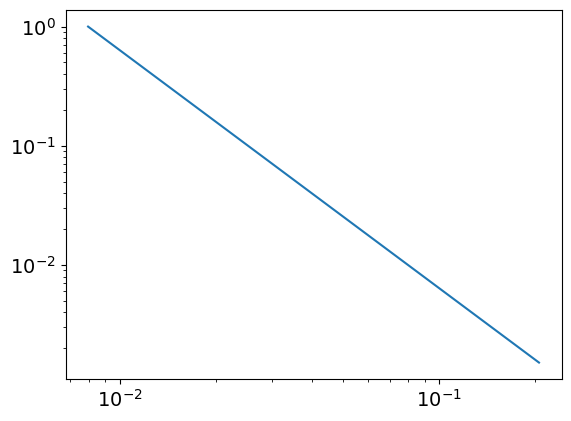

2.9968478839165655
0.007954856698626191
powerlaw KstestResult(statistic=0.998567486383937, pvalue=0.0, statistic_location=0.08216831394322473, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20522102651090518, statistic_sign=1)
tensor(1.1307e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6208, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.9503, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
483
tensor(0.2826, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


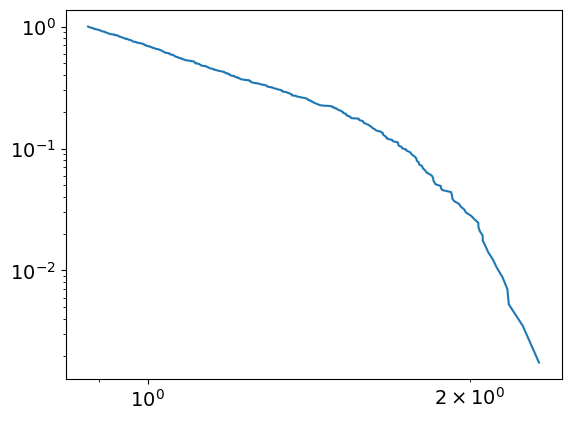

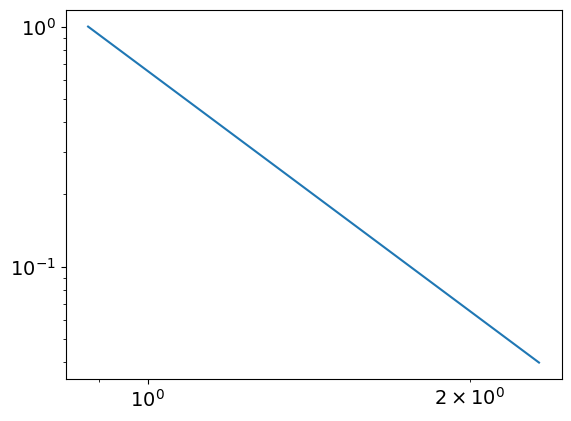

4.319447252127227
0.8794914592335399
powerlaw KstestResult(statistic=0.9662699973436575, pvalue=0.0, statistic_location=1.15610098763502, statistic_sign=1)
lognorm KstestResult(statistic=0.9733079039097201, pvalue=0.0, statistic_location=1.2312172235571752, statistic_sign=1)
tensor(0.0844, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2233, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7552, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.2978, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
484
tensor(6.3631e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


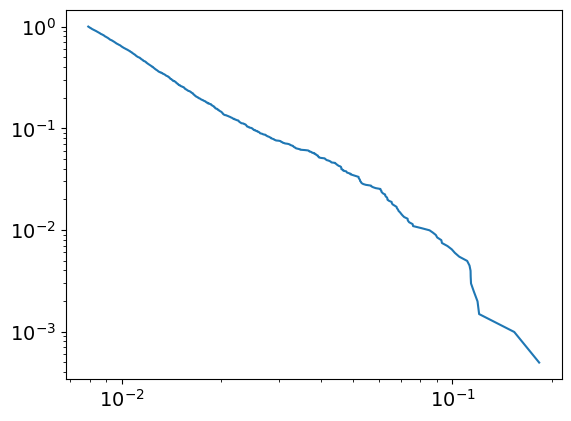

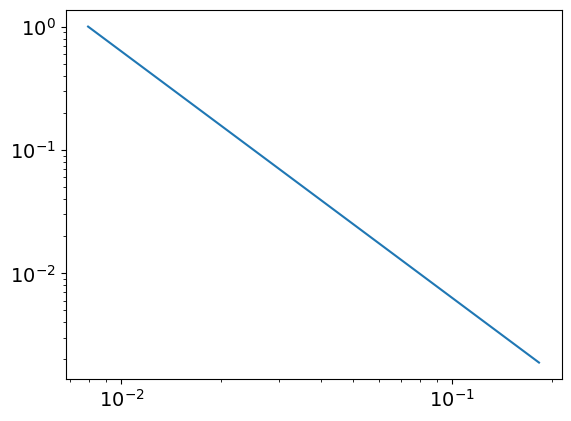

2.999371726992152
0.007930192209158016
powerlaw KstestResult(statistic=0.9984801999180575, pvalue=0.0, statistic_location=0.11602212140722343, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18279081381377588, statistic_sign=1)
tensor(2.2243e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5892, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.3051, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
484
tensor(0.2831, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


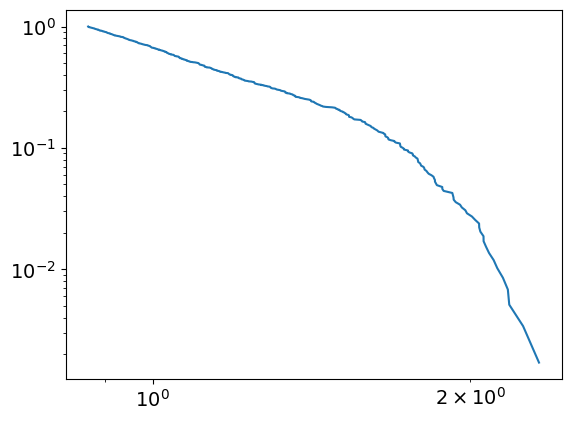

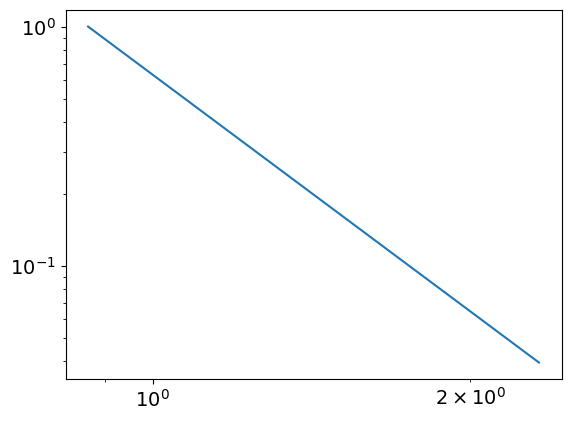

4.284409571277966
0.8681075021870426
powerlaw KstestResult(statistic=0.9653934870858856, pvalue=0.0, statistic_location=1.1253021422049956, statistic_sign=1)
lognorm KstestResult(statistic=0.973240942392239, pvalue=0.0, statistic_location=1.2325314110485157, statistic_sign=1)
tensor(0.0845, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2234, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7575, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3033, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
485
tensor(6.9281e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


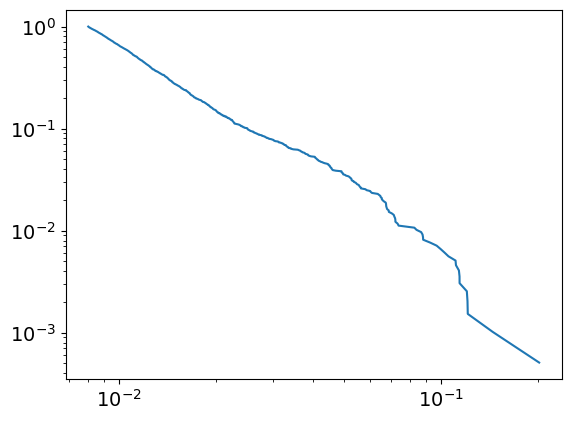

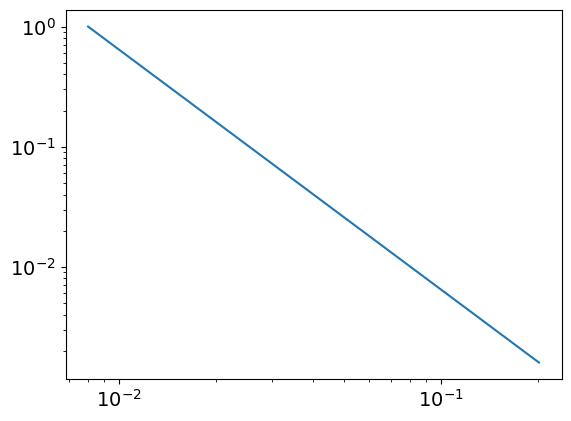

2.9971428158871785
0.008026051201707504
powerlaw KstestResult(statistic=0.9985911730381668, pvalue=0.0, statistic_location=0.08803958995017512, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20180485322243796, statistic_sign=1)
tensor(1.1134e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6124, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.6437, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
485
tensor(0.2835, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


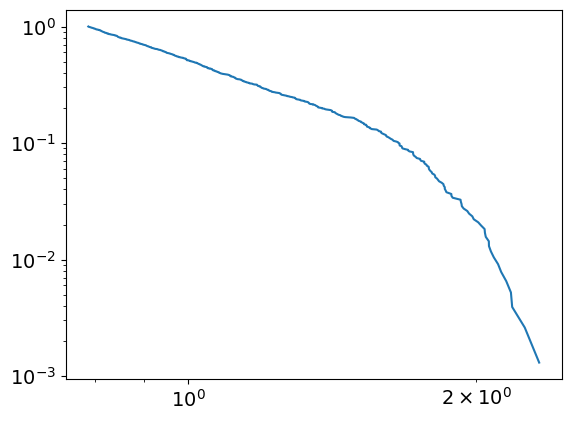

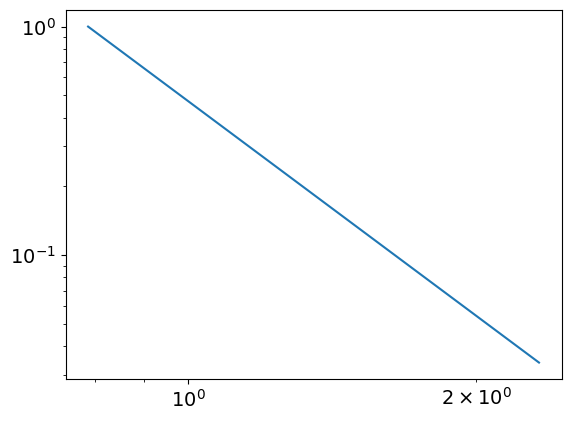

4.121470290662152
0.7862349438427393
powerlaw KstestResult(statistic=0.9596239165900655, pvalue=0.0, statistic_location=1.0666671775383783, statistic_sign=1)
lognorm KstestResult(statistic=0.973208964574702, pvalue=0.0, statistic_location=1.2227028037411112, statistic_sign=1)
tensor(0.0846, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2234, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7596, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3086, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
486
tensor(7.2011e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


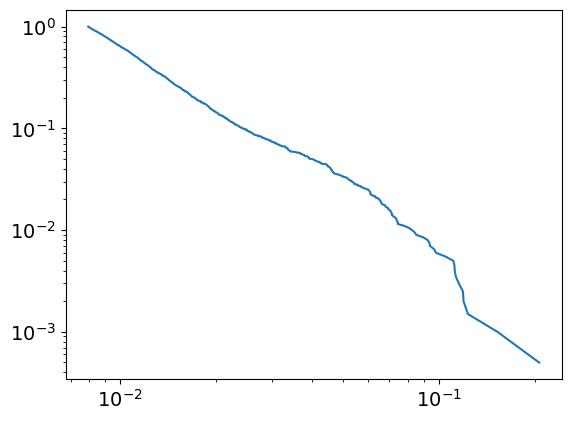

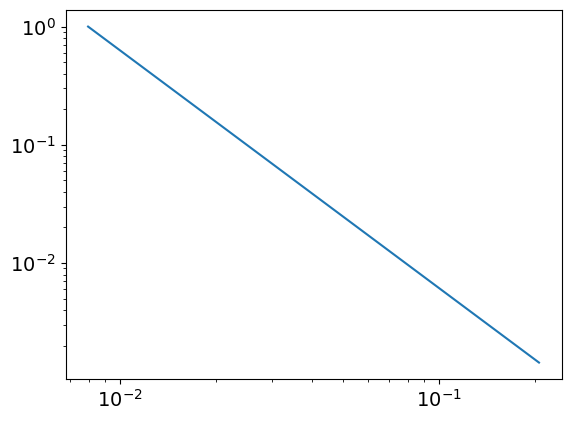

3.0093026180024
0.007951810249642154
powerlaw KstestResult(statistic=0.9985492554571006, pvalue=0.0, statistic_location=0.08405531234594847, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20632408143506017, statistic_sign=1)
tensor(3.7699e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7696, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.7076, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
486
tensor(0.2840, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


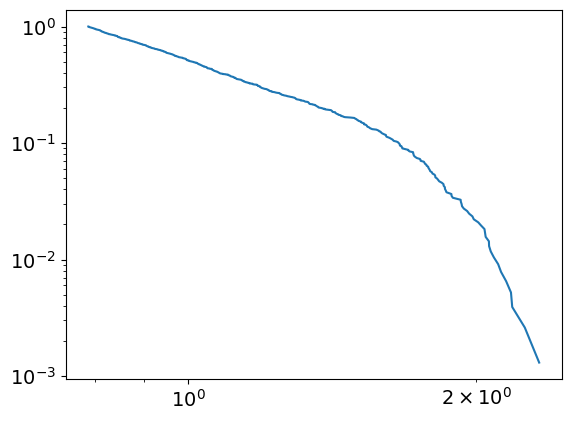

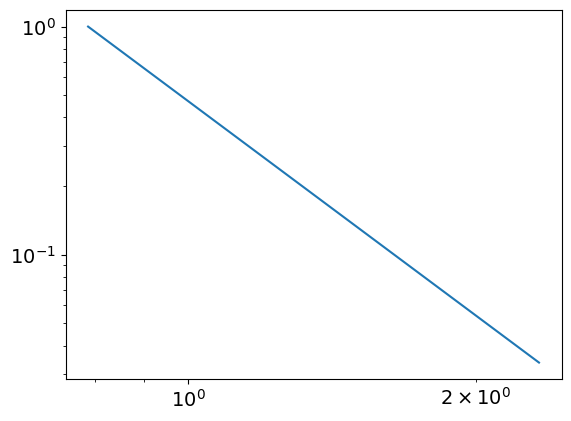

4.1244102161134375
0.7862384440871596
powerlaw KstestResult(statistic=0.9595629208773049, pvalue=0.0, statistic_location=1.0643969588089388, statistic_sign=1)
lognorm KstestResult(statistic=0.973162293512896, pvalue=0.0, statistic_location=1.2240653189528319, statistic_sign=1)
tensor(0.0847, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2235, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7618, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3141, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
487
tensor(8.3458e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


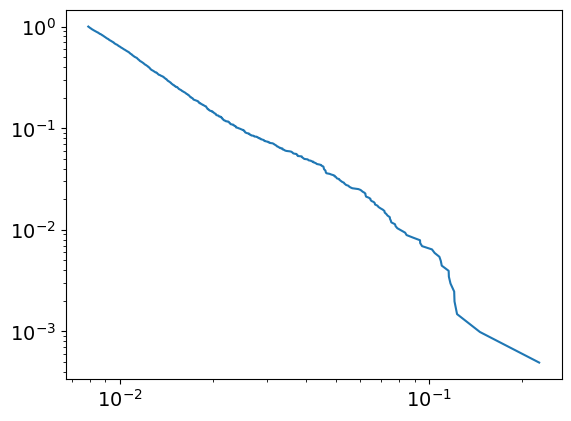

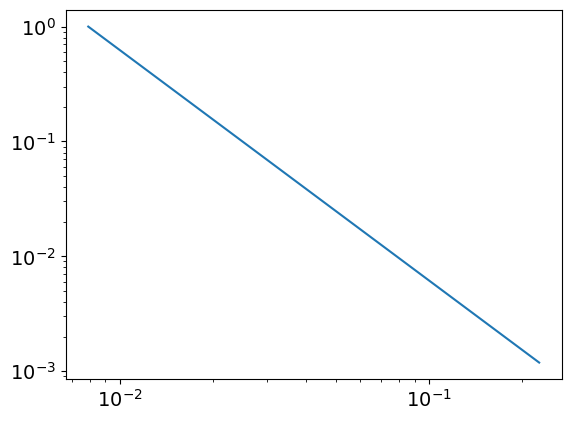

3.0077446285681972
0.007920731779371892
powerlaw KstestResult(statistic=0.9986647264994807, pvalue=0.0, statistic_location=0.08462554267129191, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.22704463600078317, statistic_sign=1)
tensor(2.1282e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.9024, device='cuda:0', grad_fn=<MeanBackward0>) tensor(48.2359, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
487
tensor(0.2845, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


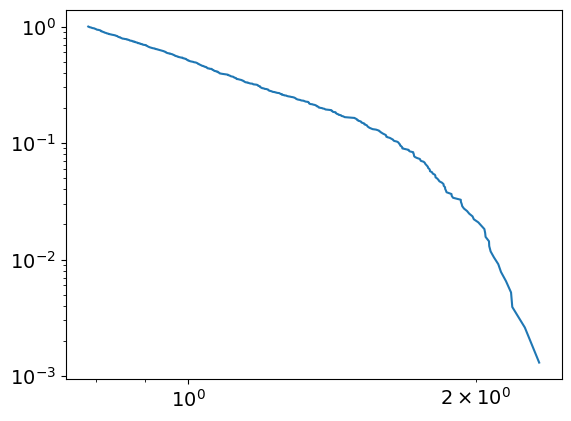

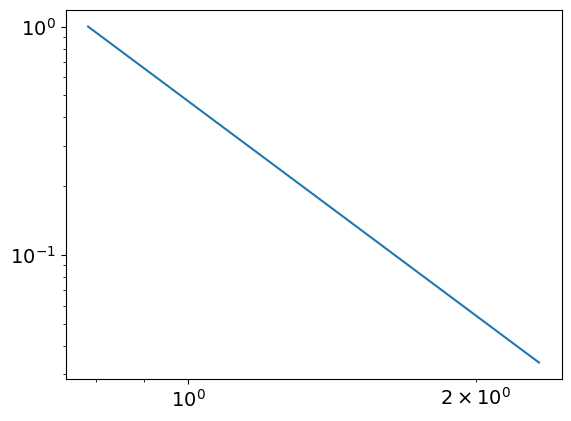

4.118030726648078
0.7858121830845738
powerlaw KstestResult(statistic=0.9595137473757867, pvalue=0.0, statistic_location=1.0640668008582197, statistic_sign=1)
lognorm KstestResult(statistic=0.973105494703403, pvalue=0.0, statistic_location=1.2256222003593926, statistic_sign=1)
tensor(0.0848, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2235, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7639, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3195, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
488
tensor(7.6647e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


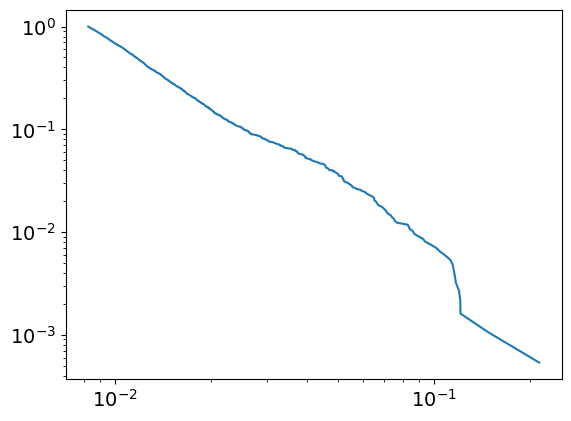

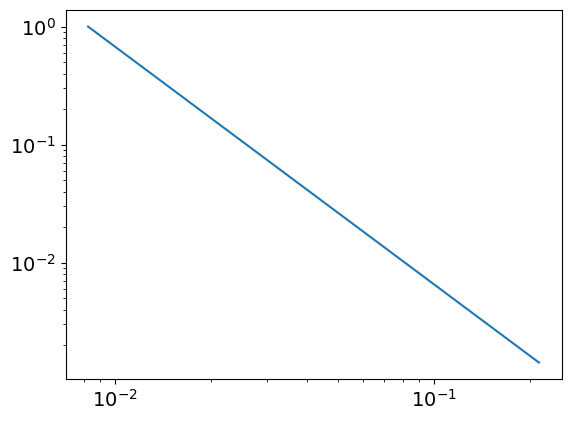

3.014350129221663
0.008260615459634012
powerlaw KstestResult(statistic=0.9985945357894517, pvalue=0.0, statistic_location=0.08926017703633146, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.21371696201472082, statistic_sign=1)
tensor(2.4289e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6907, device='cuda:0', grad_fn=<MeanBackward0>) tensor(44.8769, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
488
tensor(0.2850, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


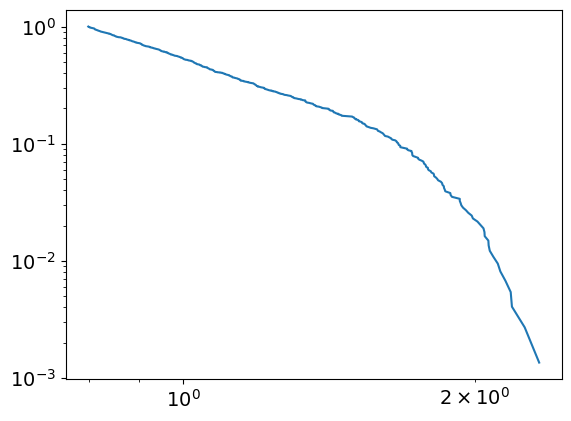

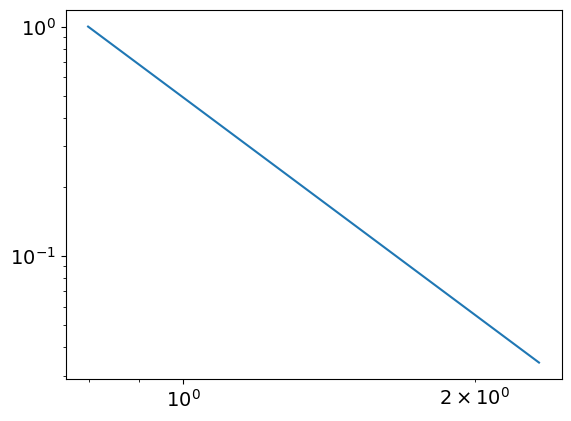

4.1488078724784625
0.7978124462974585
powerlaw KstestResult(statistic=0.9606187436131116, pvalue=0.0, statistic_location=1.0776020835107096, statistic_sign=1)
lognorm KstestResult(statistic=0.9730501737590523, pvalue=0.0, statistic_location=1.2378067454026358, statistic_sign=1)
tensor(0.0849, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2236, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7661, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3249, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
489
tensor(7.1739e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


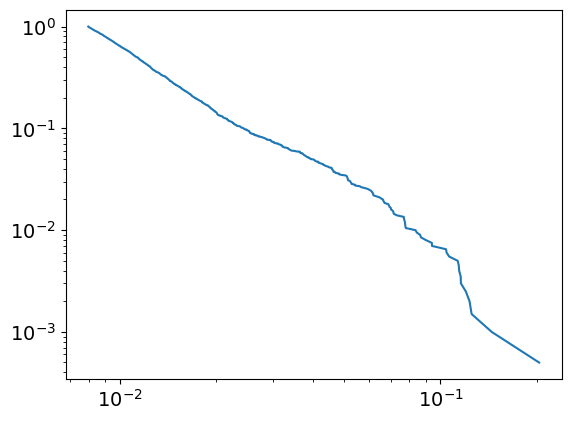

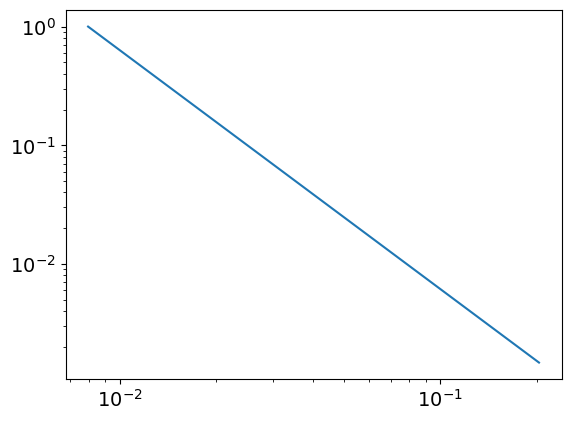

3.0127640764428976
0.007961732675539342
powerlaw KstestResult(statistic=0.9985250712692377, pvalue=0.0, statistic_location=0.11582680478701676, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.20321190185040955, statistic_sign=1)
tensor(6.1389e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7350, device='cuda:0', grad_fn=<MeanBackward0>) tensor(42.1567, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
489
tensor(0.2854, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


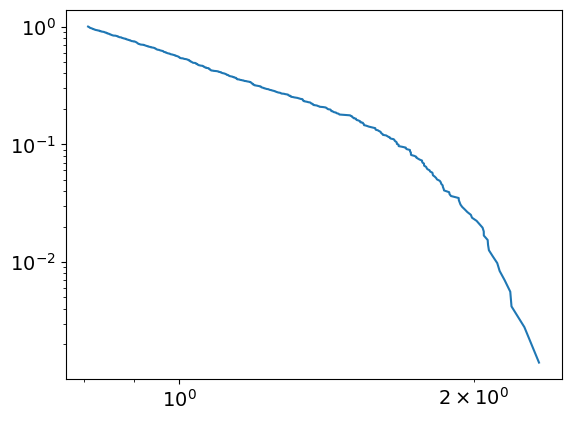

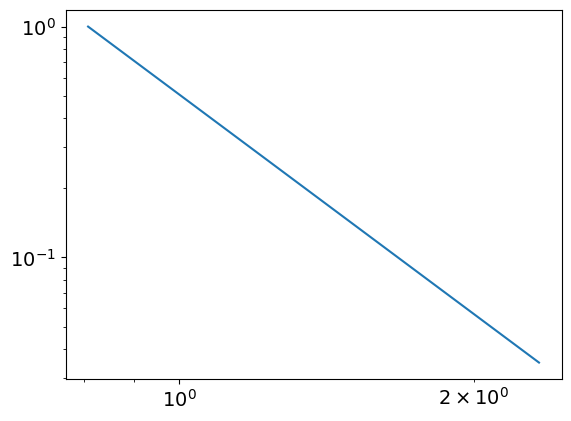

4.162646521351711
0.8074833385399598
powerlaw KstestResult(statistic=0.9613120984426893, pvalue=0.0, statistic_location=1.0787072256402115, statistic_sign=1)
lognorm KstestResult(statistic=0.9729740500903473, pvalue=0.0, statistic_location=1.2288158092904584, statistic_sign=1)
tensor(0.0850, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2236, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7683, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3303, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
490
tensor(6.6362e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


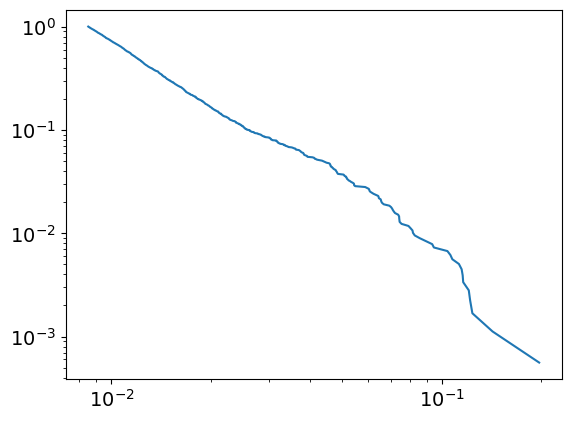

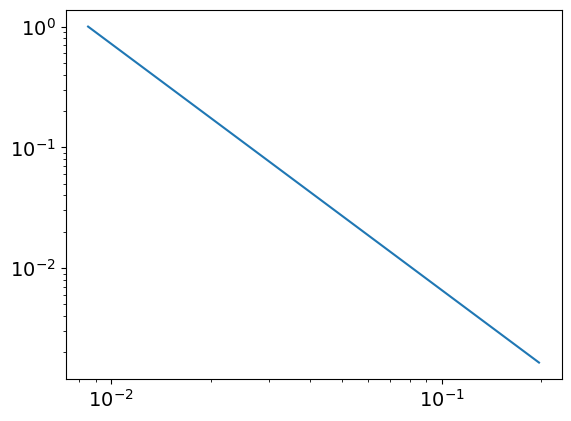

3.0381352925866323
0.008506258633886807
powerlaw KstestResult(statistic=0.9986883515667018, pvalue=0.0, statistic_location=0.08579798448090396, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19734104589380594, statistic_sign=1)
tensor(5.2487e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7003, device='cuda:0', grad_fn=<MeanBackward0>) tensor(40.0052, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
490
tensor(0.2859, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


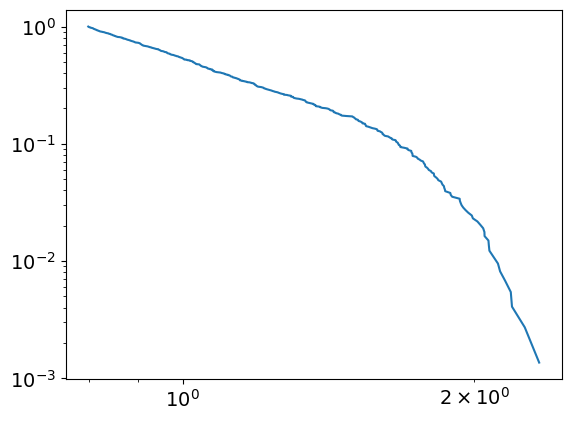

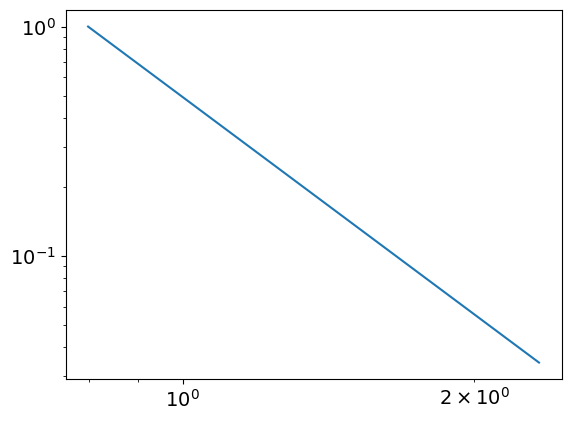

4.146913148414637
0.7989174480520247
powerlaw KstestResult(statistic=0.9605912208521725, pvalue=0.0, statistic_location=1.0772038801563673, statistic_sign=1)
lognorm KstestResult(statistic=0.9729359970157607, pvalue=0.0, statistic_location=1.2372014471088344, statistic_sign=1)
tensor(0.0851, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2237, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7705, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3357, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
491
tensor(6.3737e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


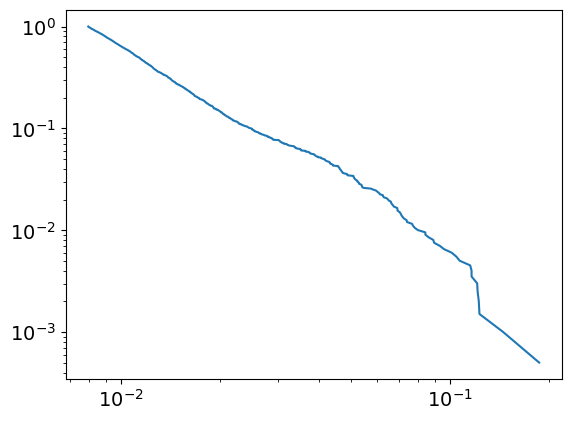

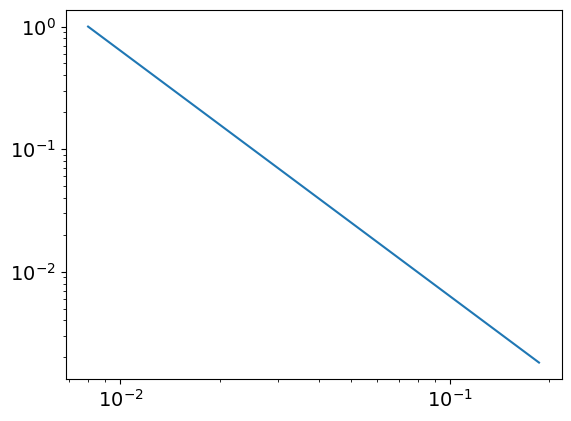

3.0033220087964954
0.007977375905450773
powerlaw KstestResult(statistic=0.9985695732491079, pvalue=0.0, statistic_location=0.08951356396900086, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18644208944882906, statistic_sign=1)
tensor(4.9581e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7048, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.9861, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
491
tensor(0.2864, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.145114666527412
0.7988677267597255
powerlaw KstestResult(statistic=0.9604790381757091, pvalue=0.0, statistic_location=1.0785015082495781, statistic_sign=1)
lognorm KstestResult(statistic=0.9729042665842146, pvalue=0.0, statistic_location=1.243111191309516, statistic_sign=1)
tensor(0.0852, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2238, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7726, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3412, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
492
tensor(7.0301e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.009725159906369
0.00841521196983121
powerlaw KstestResult(statistic=0.9984781202528168, pvalue=0.0, statistic_location=0.08107339165833591, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19918911137613915, statistic_sign=1)
tensor(4.8679e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8796, device='cuda:0', grad_fn=<MeanBackward0>) tensor(41.0266, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
492
tensor(0.2869, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.134818387799482
0.7923323095220405
powerlaw KstestResult(statistic=0.9598171556085962, pvalue=0.0, statistic_location=1.0625391336284156, statistic_sign=1)
lognorm KstestResult(statistic=0.9728963775773718, pvalue=0.0, statistic_location=1.2430352452020361, statistic_sign=1)
tensor(0.0853, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2238, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7747, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3466, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
493
tensor(6.5482e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.03078495961713
0.008470353191698674
powerlaw KstestResult(statistic=0.9985980639716365, pvalue=0.0, statistic_location=0.08295779287290368, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.19303061401149663, statistic_sign=1)
tensor(4.7732e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7270, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.1167, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
493
tensor(0.2874, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.131632754883385
0.7925058939337796
powerlaw KstestResult(statistic=0.959773891256731, pvalue=0.0, statistic_location=1.0630704783222324, statistic_sign=1)
lognorm KstestResult(statistic=0.9728276323704611, pvalue=0.0, statistic_location=1.23632791833625, statistic_sign=1)
tensor(0.0853, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2239, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7768, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3520, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
494
tensor(6.7220e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0022684084372377
0.0082909795861239
powerlaw KstestResult(statistic=0.998497718693331, pvalue=0.0, statistic_location=0.08684100450865051, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1960334889174263, statistic_sign=1)
tensor(4.3544e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7789, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.0919, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
494
tensor(0.2878, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.19633264358612
0.8374040793672716
powerlaw KstestResult(statistic=0.9629966226871817, pvalue=0.0, statistic_location=1.08422105609787, statistic_sign=1)
lognorm KstestResult(statistic=0.9727863395307191, pvalue=0.0, statistic_location=1.2368394458704683, statistic_sign=1)
tensor(0.0854, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2239, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7790, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3576, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
495
tensor(6.1225e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0031412008050027
0.008315789922233816
powerlaw KstestResult(statistic=0.9985561727116059, pvalue=0.0, statistic_location=0.08361081074593586, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17695967603883186, statistic_sign=1)
tensor(3.3237e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5952, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.1576, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
495
tensor(0.2883, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.126162683926868
0.7925733550193443
powerlaw KstestResult(statistic=0.959728544602014, pvalue=0.0, statistic_location=1.0536108441736012, statistic_sign=1)
lognorm KstestResult(statistic=0.9728094031048828, pvalue=0.0, statistic_location=1.2402195030516108, statistic_sign=1)
tensor(0.0855, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2240, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7811, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3629, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
496
tensor(6.0931e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0085792438629104
0.008348016900519947
powerlaw KstestResult(statistic=0.9986524510388546, pvalue=0.0, statistic_location=0.08580893797420047, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18064216301153152, statistic_sign=1)
tensor(3.4502e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6035, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.1439, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
496
tensor(0.2888, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.188633184205262
0.8370554077880984
powerlaw KstestResult(statistic=0.9628400865074648, pvalue=0.0, statistic_location=1.086434500694413, statistic_sign=1)
lognorm KstestResult(statistic=0.9728290639043768, pvalue=0.0, statistic_location=1.2397617369935858, statistic_sign=1)
tensor(0.0856, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2240, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7832, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3684, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
497
tensor(6.2381e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.016988429682509
0.00841780093564592
powerlaw KstestResult(statistic=0.9985201070593471, pvalue=0.0, statistic_location=0.08670460080684671, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.18865198649682968, statistic_sign=1)
tensor(3.3772e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6471, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.2389, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
497
tensor(0.2893, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.119853598546854
0.792250898395287
powerlaw KstestResult(statistic=0.9597181696542757, pvalue=0.0, statistic_location=1.0588651246477303, statistic_sign=1)
lognorm KstestResult(statistic=0.9727547566671936, pvalue=0.0, statistic_location=1.2388022107723369, statistic_sign=1)
tensor(0.0857, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2241, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7854, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3739, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
498
tensor(6.0005e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.018166297925613
0.008362271120077307
powerlaw KstestResult(statistic=0.9986685960844784, pvalue=0.0, statistic_location=0.08552528669865868, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1813680930214784, statistic_sign=1)
tensor(2.6858e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.6413, device='cuda:0', grad_fn=<MeanBackward0>) tensor(36.5218, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
498
tensor(0.2897, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.1190601709409345
0.7919466932605823
powerlaw KstestResult(statistic=0.9596554976367327, pvalue=0.0, statistic_location=1.059428333526293, statistic_sign=1)
lognorm KstestResult(statistic=0.9727221054474658, pvalue=0.0, statistic_location=1.2391028006710076, statistic_sign=1)
tensor(0.0858, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2241, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7875, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3794, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10


powerlaw
Calculating best minimal value for power law fit
7.376418193411754%
powerlaw KstestResult(statistic=0.9999999985975581, pvalue=0.0, statistic_location=0.168612657109546, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.168612657109546, statistic_sign=1)



powerlaw
Calculating best minimal value for power law fit
2.860766187261121%
powerlaw KstestResult(statistic=0.9013008464176763, pvalue=0.0, statistic_location=0.6924733799794277, statistic_sign=1)
lognorm KstestResult(statistic=0.9726694206978075, pvalue=0.0, statistic_location=1.2396773044193616, statistic_sign=1)



separation
epoch:
499
tensor(5.6365e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0207738125423074
0.008377362266682788
powerlaw KstestResult(statistic=0.9986327163735507, pvalue=0.0, statistic_location=0.08775087832211173, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.168612657109546, statistic_sign=1)
tensor(3.9584e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5795, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6706, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
499
tensor(0.2902, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.112359429678547
0.7915104650412773
powerlaw KstestResult(statistic=0.95956656114437, pvalue=0.0, statistic_location=1.0578432198806058, statistic_sign=1)
lognorm KstestResult(statistic=0.9726694206978075, pvalue=0.0, statistic_location=1.2396773044193616, statistic_sign=1)
tensor(0.0859, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2242, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7896, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3849, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
500
tensor(5.2792e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.053429972427791
0.008647811559110494
powerlaw KstestResult(statistic=0.9986678763771109, pvalue=0.0, statistic_location=0.07972069302883862, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15482329791564034, statistic_sign=1)
tensor(1.6268e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3902, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.2638, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
500
tensor(0.2907, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.1035248654899705
0.7898551990425458
powerlaw KstestResult(statistic=0.9593990820666527, pvalue=0.0, statistic_location=1.0578942204632953, statistic_sign=1)
lognorm KstestResult(statistic=0.9726184662379233, pvalue=0.0, statistic_location=1.2402038343371207, statistic_sign=1)
tensor(0.0860, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2242, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7917, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3904, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
501
tensor(5.1546e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0382221832865333
0.008399373010926386
powerlaw KstestResult(statistic=0.9985985584625827, pvalue=0.0, statistic_location=0.08332988032903609, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15168421938509583, statistic_sign=1)
tensor(3.0323e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3906, device='cuda:0', grad_fn=<MeanBackward0>) tensor(32.7971, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
501
tensor(0.2912, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.100183071141291
0.789643773921479
powerlaw KstestResult(statistic=0.9592921576023334, pvalue=0.0, statistic_location=1.058931872527277, statistic_sign=1)
lognorm KstestResult(statistic=0.9725196852460694, pvalue=0.0, statistic_location=1.24135060363801, statistic_sign=1)
tensor(0.0861, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2243, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7939, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.3960, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
502
tensor(5.3871e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.016828885923678
0.008257923846865592
powerlaw KstestResult(statistic=0.9986220990607623, pvalue=0.0, statistic_location=0.08795142877288951, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.15822188514563737, statistic_sign=1)
tensor(1.6448e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4875, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.6783, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
502
tensor(0.2917, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.087245497240412
0.7869960837856323
powerlaw KstestResult(statistic=0.9590146411232923, pvalue=0.0, statistic_location=1.0572764303219873, statistic_sign=1)
lognorm KstestResult(statistic=0.9724112620480716, pvalue=0.0, statistic_location=1.244060132051713, statistic_sign=1)
tensor(0.0862, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2243, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7960, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4014, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
503
tensor(6.0294e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.00034555014579
0.00799180852926057
powerlaw KstestResult(statistic=0.9986047109045179, pvalue=0.0, statistic_location=0.08751352201923707, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11675042189617338, statistic_sign=-1)
tensor(-1.4137e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4325, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.1273, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
503
tensor(0.2922, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.083314881471193
0.7871068978519657
powerlaw KstestResult(statistic=0.9590041314201456, pvalue=0.0, statistic_location=1.0571928888144633, statistic_sign=1)
lognorm KstestResult(statistic=0.972350554531511, pvalue=0.0, statistic_location=1.2288458991756692, statistic_sign=1)
tensor(0.0863, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2244, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.7980, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4068, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
504
tensor(5.8906e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.002412386321026
0.007989167160950631
powerlaw KstestResult(statistic=0.9984676037642591, pvalue=0.0, statistic_location=0.08815106035136844, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11666558947231337, statistic_sign=-1)
tensor(-7.0977e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2920, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.5879, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
504
tensor(0.2926, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.086442643242177
0.7871084651555975
powerlaw KstestResult(statistic=0.9590327323524931, pvalue=0.0, statistic_location=1.0570677177579404, statistic_sign=1)
lognorm KstestResult(statistic=0.9723518547103119, pvalue=0.0, statistic_location=1.2337265698639104, statistic_sign=1)
tensor(0.0864, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2244, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4123, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
505
tensor(5.5958e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.012545943325657
0.007998449650367202
powerlaw KstestResult(statistic=0.9986200913378708, pvalue=0.0, statistic_location=0.07989054972883118, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11522115207044706, statistic_sign=-1)
tensor(-1.6150e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2320, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.3125, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
505
tensor(0.2931, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.105680502170582
0.7988391230381422
powerlaw KstestResult(statistic=0.9599553125474535, pvalue=0.0, statistic_location=1.0585887347500178, statistic_sign=1)
lognorm KstestResult(statistic=0.9723810789101475, pvalue=0.0, statistic_location=1.2330207260739303, statistic_sign=1)
tensor(0.0865, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2245, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8022, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4179, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
506
tensor(6.2607e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0227657278680127
0.00835794556340749
powerlaw KstestResult(statistic=0.9986462102074002, pvalue=0.0, statistic_location=0.07910520495912828, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.11619788040209941, statistic_sign=-1)
tensor(-6.9173e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5374, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.3479, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
506
tensor(0.2936, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.079721236606293
0.7867510873452516
powerlaw KstestResult(statistic=0.9589715692076498, pvalue=0.0, statistic_location=1.0587172521034456, statistic_sign=1)
lognorm KstestResult(statistic=0.9724117002670931, pvalue=0.0, statistic_location=1.2322843682516187, statistic_sign=1)
tensor(0.0866, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2246, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8043, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4234, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
507
tensor(5.8078e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0109716691158677
0.007991819492460885
powerlaw KstestResult(statistic=0.998639349927665, pvalue=0.0, statistic_location=0.08634606704636781, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1602885105819276, statistic_sign=1)
tensor(1.3073e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4369, device='cuda:0', grad_fn=<MeanBackward0>) tensor(34.6601, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
507
tensor(0.2941, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.077780499603996
0.7866857195308659
powerlaw KstestResult(statistic=0.9588994576708084, pvalue=0.0, statistic_location=1.0611417274925004, statistic_sign=1)
lognorm KstestResult(statistic=0.9723630372162246, pvalue=0.0, statistic_location=1.2330079859568657, statistic_sign=1)
tensor(0.0867, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2246, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8063, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4288, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
508
tensor(5.2811e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.022243207543093
0.008389531075855864
powerlaw KstestResult(statistic=0.998584666981198, pvalue=0.0, statistic_location=0.09043858477058078, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.14988568644499725, statistic_sign=1)
tensor(1.4395e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3058, device='cuda:0', grad_fn=<MeanBackward0>) tensor(31.9884, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
508
tensor(0.2945, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.098665507037611
0.801042995810623
powerlaw KstestResult(statistic=0.9600500583863166, pvalue=0.0, statistic_location=1.0607177755901858, statistic_sign=1)
lognorm KstestResult(statistic=0.97229603712637, pvalue=0.0, statistic_location=1.2340134863437595, statistic_sign=1)
tensor(0.0867, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2247, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8084, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4344, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
509
tensor(5.4157e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0257681413386686
0.008350342149232746
powerlaw KstestResult(statistic=0.9986121127345974, pvalue=0.0, statistic_location=0.08918426137428985, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.1584150183350638, statistic_sign=1)
tensor(7.4365e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.3311, device='cuda:0', grad_fn=<MeanBackward0>) tensor(33.0273, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
509
tensor(0.2950, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.12632176422105
0.8206916782173723
powerlaw KstestResult(statistic=0.9612124555202154, pvalue=0.0, statistic_location=1.0616865233481585, statistic_sign=1)
lognorm KstestResult(statistic=0.9722292679322265, pvalue=0.0, statistic_location=1.2327854757052361, statistic_sign=1)
tensor(0.0868, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2247, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8104, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4399, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
510
tensor(5.8490e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.024803463449474
0.008284655529778027
powerlaw KstestResult(statistic=0.9986333221165019, pvalue=0.0, statistic_location=0.08789289838933607, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17742856879480368, statistic_sign=1)
tensor(2.1809e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.5297, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.7913, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
510
tensor(0.2955, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.0973224806276685
0.8011499572024955
powerlaw KstestResult(statistic=0.9598917514290013, pvalue=0.0, statistic_location=1.0631923675223225, statistic_sign=1)
lognorm KstestResult(statistic=0.9721771359593638, pvalue=0.0, statistic_location=1.233529617304808, statistic_sign=1)
tensor(0.0869, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2248, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8125, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4454, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
511
tensor(5.8774e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.040139551588409
0.008519225248443167
powerlaw KstestResult(statistic=0.9986583460257753, pvalue=0.0, statistic_location=0.08772395913540496, statistic_sign=1)
lognorm KstestResult(statistic=1.0, pvalue=0.0, statistic_location=0.17707933625924763, statistic_sign=1)
tensor(2.4650e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4972, device='cuda:0', grad_fn=<MeanBackward0>) tensor(35.7375, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
511
tensor(0.2960, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.096133701294919
0.8008160562828229
powerlaw KstestResult(statistic=0.9597508487365606, pvalue=0.0, statistic_location=1.0649062150934743, statistic_sign=1)
lognorm KstestResult(statistic=0.9721221001604464, pvalue=0.0, statistic_location=1.2342936775805715, statistic_sign=1)
tensor(0.0870, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2248, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8145, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4509, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
512
tensor(6.9780e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


2.9967107389753527
0.00827216296659409
powerlaw KstestResult(statistic=0.9986843984682833, pvalue=0.0, statistic_location=0.08311062458317087, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.12680646374165405, statistic_sign=-1)
tensor(-3.0869e-07, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4860, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.3884, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
512
tensor(0.2965, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.090596629327743
0.7987003619556358
powerlaw KstestResult(statistic=0.9594670246958044, pvalue=0.0, statistic_location=1.0646363377096282, statistic_sign=1)
lognorm KstestResult(statistic=0.9720718287067462, pvalue=0.0, statistic_location=1.2278238875063159, statistic_sign=1)
tensor(0.0871, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2249, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8165, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4563, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
513
tensor(6.4636e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


3.0053978940933863
0.007992761237537378
powerlaw KstestResult(statistic=0.9986619239329834, pvalue=0.0, statistic_location=0.08470494277454765, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.1234366776272223, statistic_sign=-1)
tensor(-9.2442e-06, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.4010, device='cuda:0', grad_fn=<MeanBackward0>) tensor(37.2636, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
513
tensor(0.2970, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.122541419942328
0.8201124924594634
powerlaw KstestResult(statistic=0.9609393671594033, pvalue=0.0, statistic_location=1.0755458335016597, statistic_sign=1)
lognorm KstestResult(statistic=0.9720992715154562, pvalue=0.0, statistic_location=1.2270361137396815, statistic_sign=1)
tensor(0.0872, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2249, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8186, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4620, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
514
tensor(6.9314e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


2.9975163178516913
0.007966302345124448
powerlaw KstestResult(statistic=0.9985454775608552, pvalue=0.0, statistic_location=0.09030324897336967, statistic_sign=1)
lognorm KstestResult(statistic=nan, pvalue=nan, statistic_location=-0.13527795767477419, statistic_sign=-1)
tensor(-3.1192e-05, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.0001, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2105, device='cuda:0', grad_fn=<MeanBackward0>) tensor(39.1887, device='cuda:0', grad_fn=<SubBackward0>)
epoch:
514
tensor(0.2975, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


4.118901152601646
0.8203463464453556
powerlaw KstestResult(statistic=0.9608972919459504, pvalue=0.0, statistic_location=1.0761922287829389, statistic_sign=1)
lognorm KstestResult(statistic=0.9720857343066488, pvalue=0.0, statistic_location=1.2271750520061078, statistic_sign=1)
tensor(0.0873, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.2250, device='cuda:0', grad_fn=<MeanBackward0>) tensor(0.8206, device='cuda:0', grad_fn=<MeanBackward0>) tensor(2.4675, device='cuda:0', grad_fn=<SubBackward0>)
fan_in
784
fan_in
10
epoch:
515
tensor(6.9103e-07, device='cuda:0', grad_fn=<MeanBackward0>)
Calculating best minimal value for power law fit


In [ ]:
interval=50
no_of_repetition=100
asymptotic_repetition=50
criterion = nn.MSELoss()
noise_strength=10**-3
perturbation_strength=10**-6
import numpy as np  
import matplotlib.pyplot as plt
import torch
import powerlaw as pl
no_of_images=20
means=[]
vars=[]
skews=[]
kurtosises=[]
current_file=5
import os
from scipy.stats import kstest
#print(os.getcwd())
file=["relu-1-adam-no-bias","relu-2.5-adam-no-bias","tanh-1-adam-no-bias","tanh-2.5-adam-no-bias","relu-1-adam-1-layer","tanh-1-adam-1-layer","relu-2.5-adam-1-layer","tanh-2.5-adam-1-layer"]
#list of file to work on 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("running")
path="/raid/home/sichen/phd-project/new runs/"
#current working directory
validation_loss=[]
training_loss=[]
asymptotic_dist=[]
epochs=1000
inits=0
moment=["mean","variance","skewness","kurtosis"]
layer=["first","second","third","fourth","fifth"]

for epoch in range(epochs+1):
    model = AE_1(input_size,output_size,hidden_state_size,no_of_layer).to(device)
    PATH=path+file[current_file]+"/epoch:"+str(epoch)+".pt"
    if epoch==0:
        print(PATH)
    model.load_state_dict(torch.load(PATH))
#i=0
    #inits=0
    if epoch%interval==interval-1:
        for value in model.parameters():
    #match i:
            plots=torch.flatten(value).cpu().detach().numpy()
            plt.hist(plots, density=True, bins='auto', histtype='stepfilled')
            plt.show()
            plt.hist(np.abs(plots), density=True, bins='auto', histtype='stepfilled',cumulative=-1)
            plt.xscale("log")
            plt.yscale("log")
            print("powerlaw")
            result=pl.Fit(np.abs(plots[plots>0.1]))
            
            alpha = result.power_law.alpha
            xmin  = result.power_law.xmin
            print(alpha)
            print('powerlaw', kstest(plots, "powerlaw", args=(alpha, xmin), N=len(plots)))
            print('lognorm', kstest(plots, "lognorm", args=(np.mean(plots), np.std(plots)), N=len(plots)))
                          #plt.title("model "+str(key)+"plot")
            plt.savefig("model "+str(inits)+"plot.jpg")
            np.savetxt("fianl weight"+str(inits)+".txt",value.cpu().detach().numpy())
            print()
            plt.show()
            #print(stats(torch.Tensor(plots)))
            #print(len(plots))
            inits+=50
        print("separation")
    for value in model.parameters():
        print("epoch:")
        print(epoch)
        plots=torch.flatten(value).cpu().detach().numpy()
    # Call the function and print the results
        mean, var, skew, kurt = stats(value)
        result=pl.Fit(np.abs(plots))
            
        alpha = result.power_law.alpha
        xmin  = result.power_law.xmin
        result.plot_ccdf()
        result.power_law.plot_ccdf()
        plt.xscale("log")
        plt.yscale("log")
        plt.show()
        
        print(alpha)
        print(xmin)
        print('powerlaw', kstest(plots, "powerlaw", args=(alpha, xmin), N=len(plots)))
        print('lognorm', kstest(plots, "lognorm", args=(np.mean(plots), np.std(plots)), N=len(plots)))
        
        means.append(mean.cpu().detach().numpy())
        vars.append(var.cpu().detach().numpy())
        skews.append(skew.cpu().detach().numpy())
        kurtosises.append(kurt.cpu().detach().numpy())
        print(mean, var, skew, kurt)
        #print(f"Mean: {mean}")
        #print(f"Variance: {var}")
        #print(f"Skewness: {skew}")
        #print(f"Kurtosis: {kurt}")
        #print("end")

#means=np.resize(means,(10,1000))
x=np.arange(epochs+1)
print("weights")

fig, (ax1, ax2,ax3,ax4) = plt.subplots (nrows=1, ncols=4,figsize=(40,20))
repeats=2
for i in range(repeats):
    #if i%2==0:
        #print(int(i/2))
        ax1.plot(x,means[i::repeats],label=layer[int(i)]+" layer "+moment[0]+" weights")
        ax1.legend(loc="best")
        ax2.plot(x,vars[i::repeats],label=layer[int(i)]+" layer "+moment[1]+" weights")
        ax2.legend(loc="best")
        ax3.plot(x,skews[i::repeats],label=layer[int(i)]+" layer "+moment[2]+" weights")
        ax3.legend(loc="best")
        ax4.plot(x,kurtosises[i::repeats],label=layer[int(i)]+" layer "+moment[3]+" weights")
        ax4.legend(loc="best")
        #plt.show()
    #else:
     #   ax5.plot(x,means[i::10],label=layer[int(i/2)]+" layer "+moment[0]+" bias")
      #  ax5.legend(loc="best")
      #  ax6.plot(x,vars[i::10],label=layer[int(i/2)]+" layer "+moment[1]+" bias")
      #  ax6.legend(loc="best")
      #  ax7.plot(x,skews[i::10],label=layer[int(i/2)]+" layer "+moment[2]+" bias")
      #  ax7.legend(loc="best")
      #  ax8.plot(x,kurtosises[i::10],label=layer[int(i/2)]+" layer "+moment[3]+" bias")
      #  ax8.legend(loc="best")
fig.tight_layout()

plt.savefig(path+file[current_file]+"/"+"new weights(kurtosis-skew).jpg")
np.savetxt(path+file[current_file]+"mean.txt",means)
np.savetxt(path+file[current_file]+"variance.txt",vars)
np.savetxt(path+file[current_file]+"skewness.txt",skews)
np.savetxt(path+file[current_file]+"kurtosis.txt",kurtosises)

plt.show()



In [ ]:
train_set = torchvision.datasets.FashionMNIST("./data", download=True, transform=
                                                transforms.Compose([
    transforms.ToTensor()
]))
test_set = torchvision.datasets.FashionMNIST("./data", download=True, train=False, transform=
                                               transforms.Compose([
    transforms.ToTensor()
]))  
train_loader = torch.utils.data.DataLoader(train_set, 
                                           batch_size=batch_size,shuffle=False)
test_loader = torch.utils.data.DataLoader(test_set,
                                          batch_size=batch_size,shuffle=False)

In [ ]:
interval=50
no_of_repetition=100
asymptotic_repetition=50
criterion = nn.MSELoss()
noise_strength=10**-3
perturbation_strength=10**-6
import numpy as np  
import matplotlib.pyplot as plt
import torch
no_of_images=20
means=[]
vars=[]
skews=[]
kurtosises=[]
current_file=8
import os
#print(os.getcwd())
file=["relu-1-adam-done","relu-2.5-adam-done" ,"relu-1-sgd-done","relu-2.5-sgd-done","tanh-1-adam-done","tanh-2.5-adam-done","tanh-2.5-sgd-done","tanh-1-sgd-done","relu-2.5-sgd-5000","tanh-2.5-sgd-5000","relu-1-sgd-5000","tanh-1-sgd-5000"]
#list of file to work on 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("running")
path="/raid/home/sichen/phd-project/new runs/"
#current working directory
validation_loss=[]
training_loss=[]
asymptotic_dist=[]
average_jacobian=[]
spectral_radiuses=[]
init_compute=True
epochs=5000
for epoch in range(epochs):
    #model = AE(input_size,output_size,hidden_state_size,no_of_layer).to(device)
    PATH=path+file[current_file]+"/epoch:"+str(epoch)+".pt"
    if epoch==0:
        print(PATH)
    #model.load_state_dict(torch.load(PATH))

    #loss = 0
    print(epoch)
    #if init_compute==True:
     #   for batch_features, _ in train_loader:
        # reshape mini-batch data to [N, 784] matrix
        # load it to the active device
        
        #distance,hidden,chaos,divergent=asymptotic_iteration(model_clone,x_train,perturbed_inputs,no_of_repetition,no_of_images,perturbation_strength)
        #if init_compute==True:
      #      input_image =add_gaussian_noise(batch_features,noise_strength).view(batch_size, -1).to(device)
       #     init_compute=False
        #input_image =add_noise(batch_features,noise_strength).view(batch_size, -1).to(device)
        
        
        #input_image=batch_features.view(batch_size,-1).to(device)
      #  batch_feature=batch_features.view(batch_size,-1).to(device)
        # reset the gradients back to zero
        # PyTorch accumulates gradients on subsequent backward passes
 
       # optimizer.zero_grad()
        
        # compute reconstructions
        #outputs = model(batch_features.view(batch_size,-1).to(device))
        #outputs = model(input_image)
        
        # compute training reconstruction loss
        
 
        #train_loss = criterion(outputs,input_image)
        

        #loss += train_loss.item()
    # compute the epoch training loss
   # loss = loss / len(train_loader)
    #print(loss)
    #training_loss.append(loss)
    #with torch.no_grad():
     #   accuracy=validation(test_loader)
     #   validation_loss.append(accuracy)
    if (epoch)%interval==interval-1 or epoch==0:
        for batch_features, _ in train_loader:
        # reshape mini-batch data to [N, 784] matrix
        # load it to the active device
        
        #distance,hidden,chaos,divergent=asymptotic_iteration(model_clone,x_train,perturbed_inputs,no_of_repetition,no_of_images,perturbation_strength)
        #if init_compute==True:
            input_image =add_gaussian_noise(batch_features,noise_strength).view(batch_size, -1).to(device)
        
        model = AE(input_size,output_size,hidden_state_size,no_of_layer).to(device)
        PATH=path+file[current_file]+"/epoch:"+str(epoch)+".pt"
        if epoch==0:
            print(PATH)
        model.load_state_dict(torch.load(PATH))
        perturbed_input=add_gaussian_noise(input_image,perturbation_strength)
        cutoffs=[]
        for j in range(no_of_images):
            cutoffs.append(torch.norm(perturbed_input[j]-input_image[j]))
        print(cutoffs)
        x_train_perturbed,y_pred_perturbed,average_jacobian,spectral_radiuses,model_clone=calculation(model,no_of_images,no_of_repetition,average_jacobian,spectral_radiuses,perturbed_input,epoch)
        x_train_unperturbed,y_pred_unperturbed,average_jacobian,spectral_radiuses,model_clone=calculation(model,no_of_images,no_of_repetition,average_jacobian,spectral_radiuses,input_image,epoch)
        distance,hidden,chaos=asymptotic_iteration(model_clone,y_pred_unperturbed,y_pred_perturbed,no_of_repetition,no_of_images,cutoffs)
        print(distance)   
        asymptotic_dist.append(distance[-1])
       # dimension_vector=torch.ones(input_size).to(device)
        #xt,xtminus=poincare_plot(model_clone,x_train[0],dimension_vector,no_of_repetition,colour,epoch)
       
        print('here')
        #perturbed_inputs=add_gaussian_noise(input_image,perturbation_strength).view(batch_size, -1).to(device)
        #distance,hidden,chaos,divergent=asymptotic_iteration(model_clone,x_train,perturbed_inputs,no_of_repetition,no_of_images,perturbation_strength*input_size)
        #print("percentage of chaos:",chaos)
        #asymptotic_dist.append(distance[-1])
        #print(distance[-1])
        #print("initial distance")
        #print(distance[0])
        #chao.append(chaos)
        #print(torch.norm(perturbed_inputs[0]-input_image[0]))
        #print(perturbation_strength*input_size)


        print("done"+str(epoch))
        
x=np.arange(1,epochs/interval+1)
plt.scatter(x,y=asymptotic_dist,label="asymptotic distance")

#labels="noise:"+str(noise_strength)+", perturbation:"+str(perturbation_strength)
plt.ylabel("asymptotic distance")
plt.xlabel("epoch/"+str(interval))
plt.yscale("log")
#plt.set_label("noise:{:.f},perturbation:{:.f}".format(noise_strength,perturbation_strength))
plt.legend(loc="best")
plt.savefig(path+file[current_file]+"/"+"asymptotic distance test2.jpg")
np.savetxt(path+file[current_file]+"/"+"asymptotic distance test2.txt",asymptotic_dist)
plt.show()    